In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from scipy.stats import zscore
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer
from sklearn.metrics import mean_absolute_error

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b

#df_challenger
#category1=[]
#for i in range(len(df_challenger)):
    #if df_challenger['Leak-Check Pressure'].iloc[i]==50:
        #category1.append(0)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==100:
        #category1.append(1)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==200:
        #category1.append(2)
#df_challenger['category']=category1

#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

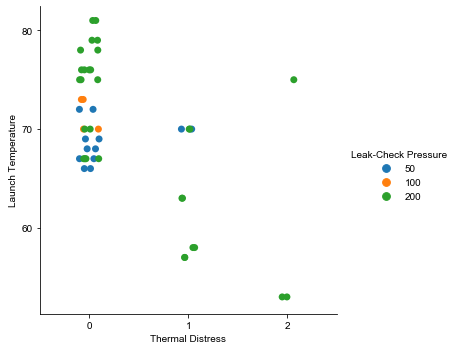

In [8]:
ax = sns.catplot(x='Thermal Distress', y='Launch Temperature', hue='Leak-Check Pressure', data=df_challenger, s=7)
sns.set(font_scale=2)

In [9]:
#Train and Test 17 datasets
#Airfoil
x_airfoil1 = df_airfoil.drop(['Frequency'], axis = 1)
y_airfoil1 = df_airfoil['Frequency']
y_airfoil1 = np.reshape(y_airfoil1.values, (-1,1))
x_airfoil2 = df_airfoil.drop(['Angle of Attack'], axis = 1)
y_airfoil2 = df_airfoil['Angle of Attack']
#x_airfoil2 = df_airfoil.drop(['Free-stream velocity','category'], axis = 1)
#y_airfoil2 = df_airfoil['category']
#y_airfoil2=to_categorical(y_airfoil2)
#Wdbc
#x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
#y_wdbc = df_wdbc['diagnosis']
#labelencoder_Y = LabelEncoder()
#y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile1 = df_automobile.drop(['bore','make','body-style'], axis = 1)
y_automobile1 = df_automobile['bore']
x_automobile2 = df_automobile.drop(['horsepower','make','body-style'], axis = 1)
y_automobile2 = df_automobile['horsepower']
y_automobile2 = np.reshape(y_automobile2.values, (-1,1))
#Autompg
x_autompg1 = df_autompg.drop(['Displacement','Car Name'], axis = 1)
y_autompg1 = df_autompg['Displacement']
y_autompg1 = np.reshape(y_autompg1.values, (-1,1))
x_autompg2 = df_autompg.drop(['Acceleration','Car Name'], axis = 1)
y_autompg2 = df_autompg['Acceleration']
#Challenger
x_challenger1 = df_challenger.drop(['Number of O-rings','Launch Temperature'], axis = 1)
y_challenger1 = df_challenger['Launch Temperature']
x_challenger2 = df_challenger.drop(['Number of O-rings','Leak-Check Pressure'], axis = 1)
y_challenger2 = df_challenger['Leak-Check Pressure']
#y_challenger2=to_categorical(y_challenger2)
#Combine
#x_combine = df_combine.drop(['PE'], axis = 1)
#y_combine = df_combine['PE']
#y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
#x_computer = df_computer.drop(['ERP'], axis = 1)
#y_computer = df_computer['ERP']
#y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
#x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
#y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
#y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
#x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
#y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
#x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
#y_concrete2 = df_concrete2['SLUMP(cm)']
#y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
#x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
#y_concrete3 = df_concrete3['FLOW(cm)']
#y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
#x_energy1 = df_energy1.drop(['Y1'], axis = 1)
#y_energy1 = df_energy1['Y1']
#Energy2
#x_energy2 = df_energy2.drop(['Y2'], axis = 1)
#y_energy2 = df_energy2['Y2']
#Fertility
#x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
#y_fertility = df_fertility['Diagnosis']
#Forest
#x_forest = df_forest.drop(['month','day','area'], axis = 1)
#y_forest = df_forest['area']
#y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
#x_housing = df_housing.drop(['MEDV'], axis = 1)
#y_housing = df_housing['MEDV']
#Istanbul
#x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
#y_istanbul = df_istanbul[['ISE1','ISE2']]
#y_istanbul['mean'] = y_istanbul.mean(axis=1)
#y_istanbul = y_istanbul['mean']

In [10]:
x_train_airfoil1, x_test_airfoil1, y_train_airfoil1, y_test_airfoil1 = train_test_split1(x_airfoil1, y_airfoil1)
x_train_airfoil2, x_test_airfoil2, y_train_airfoil2, y_test_airfoil2 = train_test_split1(x_airfoil2, y_airfoil2)
x_train_automobile1, x_test_automobile1, y_train_automobile1, y_test_automobile1 = train_test_split1(x_automobile1, y_automobile1)
x_train_automobile2, x_test_automobile2, y_train_automobile2, y_test_automobile2 = train_test_split1(x_automobile2, y_automobile2)
x_train_autompg1, x_test_autompg1, y_train_autompg1, y_test_autompg1 = train_test_split1(x_autompg1, y_autompg1)
x_train_autompg2, x_test_autompg2, y_train_autompg2, y_test_autompg2 = train_test_split1(x_autompg2, y_autompg2)
x_train_challenger1, x_test_challenger1, y_train_challenger1, y_test_challenger1 = train_test_split1(x_challenger1, y_challenger1)
x_train_challenger2, x_test_challenger2, y_train_challenger2, y_test_challenger2 = train_test_split1(x_challenger2, y_challenger2)
#x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
#x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
#x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
#x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
#x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
#x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
#x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
#x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
#x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
#x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
#x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
#x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
#x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [11]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [12]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [13]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max_x=MinMaxScaler()
    min_max_y=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max_x.fit(X_train)
    #X_scale_val=min_max_x.fit(X_val)
    #x_scale_test=min_max_x.fit(x_test)
    Y_scale_train=min_max_y.fit(Y_train)
    #Y_scale_val=min_max_y.fit(Y_val)
    #y_scale_test=min_max_y.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=Y_scale_train.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, Y_scale_train

In [14]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [15]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.001,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [16]:
def NN_model_structure_classification(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test, classes):
    model = Sequential()
    model.add(Dense(units = 5, kernel_initializer='uniform', input_dim = (X_train.shape[1])))
    model.add(Activation('relu'))
    model.add(Dense(units = 10, kernel_initializer='uniform'))
    model.add(Activation('relu'))
    model.add(Dense(units = 20, kernel_initializer='uniform'))
    model.add(Dense(units = classes, activation='softmax'))
    model.compile(optimizer = adam , loss = 'categorical_crossentropy', metrics=['acc'])
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [17]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [18]:
X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1 = train_val_split(x_train_airfoil1, y_train_airfoil1)
X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2 = train_val_split(x_train_airfoil2, y_train_airfoil2)
X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1 = train_val_split(x_train_automobile1, y_train_automobile1)
X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2 = train_val_split(x_train_automobile2, y_train_automobile2)
X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1 = train_val_split(x_train_autompg1, y_train_autompg1)
X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2 = train_val_split(x_train_autompg2, y_train_autompg2)
X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1 = train_val_split(x_train_challenger1, y_train_challenger1)
X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2 = train_val_split(x_train_challenger2, y_train_challenger2)
#X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
#X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
#X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
#X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
#X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
#X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
#X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
#X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
#X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
#X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
#X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [19]:
X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1, X_scale_train_airfoil1, Y_scale_train_airfoil1 =min_max_scaler(X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1)
X_train_airfoil2, X_val_airfoil2, x_test_airfoil2, X_scale_train_airfoil2=standard_scaler(X_train_airfoil2, X_val_airfoil2, x_test_airfoil2)
X_train_automobile1, X_val_automobile1, x_test_automobile1, X_scale_train_automobile1=standard_scaler(X_train_automobile1, X_val_automobile1, x_test_automobile1)
X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2, X_scale_train_automobile2, Y_scale_train_automobile2=min_max_scaler(X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2)
X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1, X_scale_train_autompg1, Y_scale_train_autompg1=min_max_scaler(X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1)
X_train_autompg2, X_val_autompg2, x_test_autompg2, X_scale_train_autompg2=standard_scaler(X_train_autompg2, X_val_autompg2, x_test_autompg2)
X_train_challenger1, X_val_challenger1, x_test_challenger1, X_scale_train_challenger1=standard_scaler(X_train_challenger1, X_val_challenger1, x_test_challenger1)
X_train_challenger2, X_val_challenger2, x_test_challenger2, X_scale_train_challenger2=standard_scaler(X_train_challenger2, X_val_challenger2, x_test_challenger2)
#X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
#X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
#X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
#X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
#X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
#X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
#X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
#X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
#X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
#X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [20]:
model_automobile2, history_automobile2, evaluate_automobile2=NN_model_structure_regression(X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2, adam2, 64, 100, x_test_automobile2, y_test_automobile2)
model_automobile2.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 115       
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 186
Trainable params: 186
Non-trainable params: 0
_________________________________________________________________

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 3ms/step - loss: 0

143/143 [==============================] - 0s 56us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 71/100
143/143 [==============================] - 0s 84us/step - loss: 0.0033 - val_loss: 0.0035
Epoch 72/100
143/143 [==============================] - 0s 63us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 75/100
143/143 [==============================] - 0s 63us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 76/100
143/143 [==============================] - 0s 77us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - 

[array([[-0.24826168,  0.23362628,  0.2089942 ,  0.28895482, -0.17616005],
        [-0.14669561, -0.02121083, -0.41223773,  0.08966611, -0.12952922],
        [ 0.15779498, -0.3074893 , -0.12192719,  0.23841514, -0.39686364],
        [ 0.05084436, -0.2581415 ,  0.6717623 , -0.35670915,  0.4810965 ],
        [ 0.3602857 , -0.08132733, -0.1130479 , -0.3908866 , -0.31774634],
        [-0.17876299,  0.05106822,  0.14638288,  0.25360045,  0.3762925 ],
        [-0.42010912,  0.18857954, -0.3843459 , -0.02243975,  0.251386  ],
        [-0.45248395,  0.04461906,  0.5148966 ,  0.23022428, -0.05305625],
        [ 0.15863802, -0.18810211, -0.10270359,  0.22429377,  0.2854402 ],
        [-0.11063146,  0.22880062,  0.16017182,  0.34121612, -0.09469975],
        [ 0.47124264, -0.3157633 , -0.31484258,  0.21519434, -0.2097948 ],
        [-0.05497116, -0.18891807, -0.47597834, -0.23628187, -0.31119555],
        [-0.00473298,  0.04057324, -0.24121545,  0.6604134 ,  0.08464488],
        [ 0.67325157, -0.

In [21]:
model_autompg1, history_autompg1, evaluate_autompg1=NN_model_structure_regression(X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1, adam2, 64, 100, x_test_autompg1, y_test_autompg1)
model_autompg1.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 5)                 40        
_________________________________________________________________
activation_3 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_4 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 11        
Total params: 111
Trainable params: 111
Non-trainable params: 0
_________________________________________________________________
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 557us/step - loss: 

274/274 [==============================] - 0s 51us/step - loss: 0.0039 - val_loss: 0.0033
Epoch 71/100
274/274 [==============================] - 0s 58us/step - loss: 0.0040 - val_loss: 0.0033
Epoch 72/100
274/274 [==============================] - 0s 62us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 73/100
274/274 [==============================] - 0s 55us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 74/100
274/274 [==============================] - 0s 55us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 75/100
274/274 [==============================] - 0s 58us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 76/100
274/274 [==============================] - 0s 55us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 77/100
274/274 [==============================] - 0s 58us/step - loss: 0.0038 - val_loss: 0.0031
Epoch 78/100
274/274 [==============================] - 0s 58us/step - loss: 0.0038 - val_loss: 0.0031
Epoch 79/100
274/274 [==============================] - 0s 58us/step - loss: 0.0038 - 

[array([[ 0.2336447 , -0.43017793,  0.79126227, -0.35688457,  0.5519729 ],
        [ 0.22756845, -0.42013782, -0.44758564, -0.3428505 ,  0.29200163],
        [ 0.03717618, -0.40563262, -0.1450777 ,  0.46829244,  0.32061103],
        [-0.29086077, -0.12767152, -0.60238314, -0.27648157,  0.43726924],
        [ 0.09436131, -0.25132275, -0.10172661, -0.4542043 , -0.5733639 ],
        [-0.25217265,  0.5558082 , -0.00732771,  0.36717847,  0.26326758],
        [-0.22156122,  0.7157285 ,  0.02931733, -0.08700011,  0.3433669 ]],
       dtype=float32),
 array([-0.03141817,  0.08626841,  0.28716052,  0.11577968, -0.23648919],
       dtype=float32),
 array([[-0.5097735 ,  0.30897716,  0.6635238 ,  0.26317805, -0.4928157 ,
          0.37348133,  0.23322228,  0.06786991, -0.05276554,  0.18972756],
        [ 0.49437946, -0.6064814 , -0.18632032, -0.11147889, -0.5604544 ,
         -0.4571811 ,  0.5933737 ,  0.43588102, -0.1957706 , -0.44687313],
        [-0.04252952, -0.23503816,  0.33816415, -0.03611

In [22]:
model_autompg2, history_autompg2, evaluate_autompg2=NN_model_structure_regression(X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2, adam2, 64, 100, x_test_autompg2, y_test_autompg2)
model_autompg2.get_weights()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 5)                 40        
_________________________________________________________________
activation_5 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_6 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 11        
Total params: 111
Trainable params: 111
Non-trainable params: 0
_________________________________________________________________
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 545us/step - loss: 

274/274 [==============================] - 0s 66us/step - loss: 1.9507 - val_loss: 3.5211
Epoch 71/100
274/274 [==============================] - 0s 58us/step - loss: 1.9438 - val_loss: 3.6775
Epoch 72/100
274/274 [==============================] - 0s 62us/step - loss: 1.9674 - val_loss: 3.5841
Epoch 73/100
274/274 [==============================] - 0s 58us/step - loss: 1.9399 - val_loss: 3.6486
Epoch 74/100
274/274 [==============================] - 0s 55us/step - loss: 1.9566 - val_loss: 3.6424
Epoch 75/100
274/274 [==============================] - 0s 58us/step - loss: 1.9102 - val_loss: 3.3984
Epoch 76/100
274/274 [==============================] - 0s 55us/step - loss: 2.0012 - val_loss: 3.4091
Epoch 77/100
274/274 [==============================] - 0s 55us/step - loss: 1.9137 - val_loss: 3.6265
Epoch 78/100
274/274 [==============================] - 0s 58us/step - loss: 1.9256 - val_loss: 3.4714
Epoch 79/100
274/274 [==============================] - 0s 55us/step - loss: 1.9111 - 

[array([[ 0.07085768, -0.3085505 ,  0.25177294,  0.24476044,  0.0871943 ],
        [-0.10947143, -0.03238937,  0.7006963 , -0.41193807,  0.08434576],
        [ 0.9703511 ,  0.33985037,  0.577885  ,  0.25397167,  0.17913759],
        [ 0.04019924, -1.2475463 , -0.52782017, -1.0733271 , -0.40025944],
        [-0.6841177 , -0.06930101,  0.2664783 ,  0.07795496,  0.49471056],
        [-0.05916845,  0.4667905 , -0.6446591 ,  0.39089146, -0.32409847],
        [-0.19785765, -0.12669307,  0.6167974 , -0.32998365, -0.08733214]],
       dtype=float32),
 array([-0.39552262, -0.45670113,  0.2787613 ,  0.36326525,  1.0195087 ],
       dtype=float32),
 array([[ 1.008338  , -0.06891426,  0.10578319,  0.7651862 ,  0.4430969 ,
         -0.2427199 ,  0.38780075,  0.45107827,  0.17872456, -0.54721534],
        [-0.21267626,  0.6785857 , -0.25334045, -0.2635429 ,  0.2856949 ,
          0.09194888, -0.5711566 , -0.82952785, -0.17496316,  0.09235629],
        [ 0.06598673,  0.31429392, -0.23259182, -0.48687

In [23]:
model_challenger1, history_challenger1, evaluate_challenger1=NN_model_structure_regression(X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1, adam2, 64, 100, x_test_challenger1, y_test_challenger1)
model_challenger1.get_weights()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 5)                 20        
_________________________________________________________________
activation_7 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_11 (Dense)             (None, 10)                60        
_________________________________________________________________
activation_8 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 11        
Total params: 91
Trainable params: 91
Non-trainable params: 0
_________________________________________________________________
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 4ms/step - loss: 4836.861

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 25.5476 - val_loss: 31.0073
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 25.4335 - val_loss: 31.3778
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 25.2807 - val_loss: 31.7420
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 25.1062 - val_loss: 32.1040
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 24.9290 - val_loss: 32.4630
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 24.7659 - val_loss: 32.8119
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 24.6285 - val_loss: 33.1380
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 24.5223 - val_loss: 33.4241
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 24.4459 - val_loss: 33.6508
Epoch 78/100
32/32 [==============================] - 0s 156us/s

[array([[-0.21934114,  1.8823969 ,  0.0836226 , -0.06124429,  0.32689378],
        [-0.40537018,  0.8255711 ,  0.3056726 , -0.30621845,  0.27209064],
        [-0.01180179,  0.01883071,  0.08474134,  0.42851624, -0.12925635]],
       dtype=float32),
 array([-1.4972347, -0.7429389,  1.6328722,  1.5644677,  1.639896 ],
       dtype=float32),
 array([[-0.70067513, -1.2292078 , -1.3397845 ,  0.25164378, -1.3119228 ,
         -0.5668883 , -1.2873614 , -0.55309117, -0.89498603, -1.4015754 ],
        [-0.24940526, -1.1393366 , -0.6389538 ,  0.30126476, -0.15053447,
         -0.16625263, -1.2804824 , -0.3791882 , -0.5105619 , -1.2927155 ],
        [ 1.1006664 ,  0.17361622,  0.83161044, -1.3914253 ,  1.0535785 ,
          0.62153816,  1.2297683 ,  1.5122079 ,  1.4539996 ,  0.88050777],
        [ 0.41215807,  1.2024114 ,  0.29222444, -1.3155202 ,  0.40384752,
          1.2961594 ,  0.28489527,  1.2227291 ,  1.1823738 ,  1.042113  ],
        [ 0.52746075,  1.6551518 ,  1.3932064 , -0.8661457 ,  1

In [24]:
model_challenger2, history_challenger2, evaluate_challenger2=NN_model_structure_regression(X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2, adam2, 64, 100, x_test_challenger2, y_test_challenger2)
model_challenger2.get_weights()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 5)                 20        
_________________________________________________________________
activation_9 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_14 (Dense)             (None, 10)                60        
_________________________________________________________________
activation_10 (Activation)   (None, 10)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 11        
Total params: 91
Trainable params: 91
Non-trainable params: 0
_________________________________________________________________
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 6ms/step - loss: 26839.01

Epoch 68/100
32/32 [==============================] - 0s 155us/step - loss: 150.4621 - val_loss: 136.5610
Epoch 69/100
32/32 [==============================] - 0s 187us/step - loss: 142.8552 - val_loss: 135.8426
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 135.6747 - val_loss: 135.3562
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 129.1328 - val_loss: 135.1364
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 123.3741 - val_loss: 135.1815
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 118.4781 - val_loss: 135.4565
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 114.4639 - val_loss: 135.8978
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 111.2990 - val_loss: 136.4225
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 108.9092 - val_loss: 136.9352
Epoch 77/100
32/32 [==========================

[array([[ 0.4939303 ,  0.18940507, -0.17966692, -0.7633834 , -0.84702617],
        [ 0.3435813 ,  0.38724703,  0.36150077, -0.08452158, -0.13399327],
        [-0.47813475, -0.10556246, -0.85307974, -1.6803297 , -1.9100785 ]],
       dtype=float32),
 array([-1.9084101, -1.8708702, -1.4888058, -1.1389121, -1.1045656],
       dtype=float32),
 array([[-1.7387534 , -2.0597749 , -2.2865114 ,  2.3695705 ,  1.6109726 ,
         -1.1890321 , -1.1951336 ,  1.9726416 ,  1.6062069 ,  1.9754752 ],
        [-1.5883659 , -1.2331364 , -1.2176731 ,  1.6032732 ,  2.0293114 ,
         -2.2802591 , -1.3417029 ,  2.0516744 ,  2.2671947 ,  1.6728972 ],
        [-1.2731938 , -0.99153656, -1.4604558 ,  2.1580794 ,  1.1724147 ,
         -1.89495   , -2.0442505 ,  2.1571434 ,  1.9307845 ,  1.2183022 ],
        [-1.0953617 , -1.950871  , -1.6119788 ,  1.6885076 ,  2.238917  ,
         -1.5655776 , -1.9782109 ,  1.1908184 ,  1.1098741 ,  1.3577278 ],
        [-1.9989816 , -1.637103  , -2.0018537 ,  1.4510008 ,  2

In [25]:
from random import seed
def initial_sol(particles, model, limit):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -limit, high = limit, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [26]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [27]:
def euclidean_distance(firefly_list1, firefly_list2):
    distance_list=[]
    for i in range(len(firefly_list1)):
        distance=np.linalg.norm(np.array(firefly_list2[i])-np.array(firefly_list1[i]))
        distance_list.append(distance)
    sum_distance=np.sum(distance)
    return sum_distance

In [28]:
def move_Xj_towards_Xk(model,a,βo, firefly_list1, firefly_list2, limit):
    rjk=euclidean_distance(firefly_list1, firefly_list2)
    γrjk=-(np.random.uniform(0.1,10))*(rjk**2)
    #exp(γ(rjk))=[np.exp(arr) for arr in γ(rjk)]
    β=βo*math.exp(γrjk)
    new_firefly=np.array(firefly_list1)+np.array(β*(np.array(firefly_list2)-np.array(firefly_list1)))+np.array(a*np.array([np.random.uniform(low = -0.5, high = 0.5, size=(w.shape)) for w in model.get_weights()]))
    for array in range(len(new_firefly)):
            new_firefly[array][new_firefly[array]<-limit]=-limit
            new_firefly[array][new_firefly[array]>limit]=limit
    return new_firefly

In [29]:
def fitness_of_new_firefly(model, new_firefly, X_train, Y_train, epoch, X_val, Y_val, x_test, y_test):
    firefly_list_result=[]
    
    model.set_weights(new_firefly)
    model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
    model_history= model_training.history
    train_list=list(model_history['loss'])
    firefly_list_result.append(train_list[epoch-1])
    val_list=list(model_history['val_loss'])
    firefly_list_result.append(val_list[epoch-1])
    model_evaluation=model.evaluate(x_test, y_test, verbose=0)
    firefly_list_result.append(model_evaluation)
    firefly_list = model.get_weights()
    
    return firefly_list, firefly_list_result

In [30]:
def FA_Algorithm(firefly_list, firefly_list_result, model, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test, limit):
    #FA Algorithm
    iteration=100
    a=1
    βo=1
    value=math.inf
    current_best_result=[value,value,value]
    
    current_best_result_list=[]
    
    for i in range(iteration):
        a=a*np.random.uniform(0.95,0.99)
        length=len(firefly_list_result)
        for j in range(length):
            for k in range(length):
                if firefly_list_result[k][1]<firefly_list_result[j][1]:
                    if firefly_list_result[k][2]<firefly_list_result[j][2]:
                        new_firefly=move_Xj_towards_Xk(model,a,βo, firefly_list[j], firefly_list[k], limit)
                        firefly_list[j], firefly_list_result[j]=fitness_of_new_firefly(model, new_firefly, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test)
    
        #Find the current_best_solution
        for i in range(len(firefly_list_result)):
            if firefly_list_result[i][1]<current_best_result[1]:
                if firefly_list_result[i][2]<current_best_result[2]:
                    current_best_result=firefly_list_result[i]
                    current_best_weights=firefly_list[i]
            
        current_best_result_list.append(current_best_result)
            
    return firefly_list, firefly_list_result, current_best_result, current_best_weights, current_best_result_list

In [31]:
#Automobile2
weights_automobile2=initial_sol(10, model_automobile2, 1)
firefly_list_automobile2, firefly_list_result_automobile2=particle_list_generate(10, model_automobile2, weights_automobile2, X_train_automobile2, Y_train_automobile2, X_val_automobile2, Y_val_automobile2, x_test_automobile2, y_test_automobile2, 100)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.8881 - val_loss: 0.1224
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1844 - val_loss: 0.0613
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1030 - val_loss: 0.0545
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0505 - val_loss: 0.0445
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0395 - val_loss: 0.0119
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0311 - val_loss: 0.0158
Epoch 7/100
143/143 [==============================] - 0s 125us/step - loss: 0.0294 - val_loss: 0.0226
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0294 - val_loss: 0.0122
Epoch 9/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0054
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0044
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0055
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0048
Epoch 84/100
143/143 [==============================] - 0s 110us/step - loss: 0.0054 - val_loss: 0.0052
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0040
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0093
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0093
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0094
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0094
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0087
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0094
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0086
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0084
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0093
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 132us/step - loss: 0.0158 - val_loss: 0.0183
Epoch 35/100
143/143 [==============================] - 0s 133us/step - loss: 0.0160 - val_loss: 0.0199
Epoch 36/100
143/143 [==============================] - 0s 129us/step - loss: 0.0152 - val_loss: 0.0174
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0153 - val_loss: 0.0180
Epoch 38/100
143/143 [==============================] - 0s 126us/step - loss: 0.0163 - val_loss: 0.0183
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0157 - val_loss: 0.0185
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0156 - val_loss: 0.0166
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0154 - val_loss: 0.0202
Epoch 42/100
143/143 [==============================] - 0s 126us/step - loss: 0.0162 - val_loss: 0.0169
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0095
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0090
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0127 - val_loss: 0.0093
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0078
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0120 - val_loss: 0.0103
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0071
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0098
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0069
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0107 - val_loss: 0.0087
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 91/100
143/143 [==============================] - 0s 106us/step - loss: 0.0044 - val_loss: 0.0025
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0023
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0022
Epoch 94/100
143/143 [==============================] - 0s 96us/step - loss: 0.0047 - val_loss: 0.0023
Epoch 95/100
143/143 [==============================] - 0s 108us/step - loss: 0.0044 - val_loss: 0.0025
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0023
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0022
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0022
Epoch 100/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0071
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss: 0.0140 - val_loss: 0.0083
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0069
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0070
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0087
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0064
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0078
Epoch 76/100
143/143 [==============================] - 0s 126us/step - loss: 0.0136 - val_loss: 0.0064
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0145 - val_loss: 0.0066
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0050
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0103
Epoch 49/100
143/143 [==============================] - 0s 133us/step - loss: 0.0096 - val_loss: 0.0061
Epoch 50/100
143/143 [==============================] - 0s 133us/step - loss: 0.0095 - val_loss: 0.0105
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0104 - val_loss: 0.0059
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0109 - val_loss: 0.0049
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0107 - val_loss: 0.0093
Epoch 54/100
143/143 [==============================] - 0s 126us/step - loss: 0.0100 - val_loss: 0.0045
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0092 - val_loss: 0.0045
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0086
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0128 - val_loss: 0.0084
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0078
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0075
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0122 - val_loss: 0.0082
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0060
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0066
Epoch 32/100
143/143 [==============================] - 0s 97us/step - loss: 0.0105 - val_loss: 0.0056
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0060
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.1608 - val_loss: 0.0190
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1135 - val_loss: 0.0617
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0654 - val_loss: 0.0134
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0433 - val_loss: 0.0333
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0378 - val_loss: 0.0148
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0395 - val_loss: 0.0265
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0321 - val_loss: 0.0121
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0300 - val_loss: 0.0180
Epoch 11/100
143/143 [==============================] - 0s 110us/step - loss: 0.0299 - val_loss: 0.0122
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.028

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0039
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0026
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0044
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0021
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 0.0069 - val_loss: 0.0023
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0026
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0022
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0039
Epoch 91/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 111us/step - loss: 0.0166 - val_loss: 0.0109
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0179 - val_loss: 0.0105
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0164 - val_loss: 0.0145
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0170 - val_loss: 0.0104
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0158 - val_loss: 0.0126
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0166 - val_loss: 0.0111
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0159 - val_loss: 0.0108
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0159 - val_loss: 0.0122
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0154 - val_loss: 0.0105
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0045
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0034
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0037
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0039
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0042
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0042
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0034
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.

In [32]:
#FA-MLP with Automobile2
updated_FA_automobile2, updated_FA_result_automobile2, best_FA_result_automobile2, best_FA_weights_automobile2, current_best_result_list_automobile2=FA_Algorithm(firefly_list_automobile2, firefly_list_result_automobile2, model_automobile2, X_train_automobile2, Y_train_automobile2, 100, X_val_automobile2, Y_val_automobile2, x_test_automobile2, y_test_automobile2, 1)

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 153us/step - loss: 0.3635 - val_loss: 0.3538
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1856 - val_loss: 0.1079
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.1245 - val_loss: 0.0152
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0356 - val_loss: 0.0691
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0440 - val_loss: 0.0059
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0239 - val_loss: 0.0162
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0171 - val_loss: 0.0059
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0141 - val_loss: 0.0087
Epoch 9/100
143/143 [==============================] - 0s 118us/step - loss: 0.0118 - val_loss: 0.0046
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0043
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0044
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0044
Epoch 82/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0044
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0043
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0042
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0042
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0043
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0043
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0050
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0051
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0045
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0048
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0049
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0050
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0048
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0048
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0048
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0082
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0080
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0081
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0084
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0078
Epoch 40/100
143/143 [==============================] - 0s 97us/step - loss: 0.0097 - val_loss: 0.0079
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0080
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0077
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0083
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0054
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0062
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0051
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0055
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0049
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0067
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0045
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0061
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0049
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 

Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0046
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0048
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0045
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0055
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 97/100
143/143 [==============================] - 0s 99us/step - loss: 0.0053 - val_loss: 0.0049
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0047
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0046
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0046
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143

143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0062
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0051
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0069
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0052
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0055
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0060
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0048
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0059
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0060
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0040
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0039
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0068 - val_loss: 0.0036
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0040
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0037
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0041
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0036
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0066 - val_loss: 0.0038
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0039
Epoch 57/100
143/143 [==============================] - 0s 115us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0042
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0048
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0046
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0046
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0042
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0052
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 0.0065 - val_loss: 0.0042
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0042
Epoch 34/100
143/143 [==============================] - 0s 102us/step - loss: 0.0063 - val_loss: 0.0051
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0146 - val_loss: 0.0087
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0132 - val_loss: 0.0082
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0058
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0055
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0058
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0049
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0046
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0069 - val_loss: 0.0048
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0068 - val_loss: 0.0044
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 

Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0036
Epoch 84/100
143/143 [==============================] - 0s 97us/step - loss: 0.0038 - val_loss: 0.0041
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0037
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0037
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0037
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0036
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0038
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0038
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0037
Epoch 92/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 118us/step - loss: 0.0071 - val_loss: 0.0037
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0035
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0039
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0042
Epoch 66/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 105us/step - loss: 0.0067 - val_loss: 0.0033
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0033
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0037
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0034
Epoch 70/100
143/143 [==============================] -

143/143 [==============================] - 0s 111us/step - loss: 0.0176 - val_loss: 0.0096
Epoch 40/100
143/143 [==============================] - 0s 106us/step - loss: 0.0169 - val_loss: 0.0085
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0085
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0117
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0211 - val_loss: 0.0107
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0207 - val_loss: 0.0174
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0208 - val_loss: 0.0114
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0215 - val_loss: 0.0169
Epoch 47/100
143/143 [==============================] - 0s 106us/step - loss: 0.0198 - val_loss: 0.0113
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0042
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0060 - val_loss: 0.0037
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0033
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0041
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0034
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0042
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0033
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0038
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0039
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0026
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0035
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 1.7949 - val_loss: 0.9278
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.4277 - val_loss: 0.5886
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.3472 - val_loss: 0.4339
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.2756 - val_loss: 0.0297
Epoch 5/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0039
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0046
Epoch 77/100
143/143 [==============================] - 0s 91us/step - loss: 0.0056 - val_loss: 0.0040
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0042
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0041
Epoch 80/100
143/143 [==============================] - 0s 100us/step - loss: 0.0055 - val_loss: 0.0042
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0040
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0040
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0175 - val_loss: 0.0090
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0174 - val_loss: 0.0109
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0173 - val_loss: 0.0089
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0175 - val_loss: 0.0092
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0168 - val_loss: 0.0101
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0172 - val_loss: 0.0096
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0161 - val_loss: 0.0088
Epoch 59/100
143/143 [==============================] - 0s 133us/step - loss: 0.0165 - val_loss: 0.0087
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 0.0164 - val_loss: 0.0090
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0064
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0063
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0056
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0128 - val_loss: 0.0054
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0127 - val_loss: 0.0066
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0060
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0061
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0060
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0059
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0167 - val_loss: 0.0155
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0162 - val_loss: 0.0113
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0154 - val_loss: 0.0107
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0110
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0100
Epoch 13/100
143/143 [==============================] - 0s 97us/step - loss: 0.0143 - val_loss: 0.0098
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0106
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0091
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0092
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0040
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss: 0.0054 - val_loss: 0.0043
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0048
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0045
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 94/100
143/143 [==============================] - 0s 110us/step - loss: 0.0049 - val_loss: 0.0038
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0041
Epoch 96/100
143/143 [==============================] - 0s 106us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0034
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0041
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0042
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0037
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0029
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0026
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0047
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0025
Epoch 74/100
143/143 [==============================] - 0s 101us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0045
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0042
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0043
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0038
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0039
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0042
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0043
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0037
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0042
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0037
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0045
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0036
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0038
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0033
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0035
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0032
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.4546 - val_loss: 0.3864
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1856 - val_loss: 0.0983
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1262 - val_loss: 0.0380
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0945 - val_loss: 0.0828
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0699 - val_loss: 0.0211
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0464 - val_loss: 0.0248
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0364 - val_loss: 0.0248
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0332 - val_loss: 0.0154
Epoch 9/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0062
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0064
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0046
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0098 - val_loss: 0.0059
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0048
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0058
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0064
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0044
Epoch 86/100
143/143 [==============================] - 0s 115us/step - loss: 0.0094 - val_loss: 0.0081
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 125us/step - loss: 0.0049 - val_loss: 0.0021
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0022
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0023
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0021
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0022
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0021
Epoch 62/100
143/143 [==============================] - 0s 95us/step - loss: 0.0047 - val_loss: 0.0024
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0021
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0021
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0104 - val_loss: 0.0068
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0065
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0061
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0050
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0054
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0047
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0052
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0052
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0055
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0270 - val_loss: 0.0178
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0267 - val_loss: 0.0157
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0254 - val_loss: 0.0135
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0240 - val_loss: 0.0163
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0233 - val_loss: 0.0124
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0132
Epoch 18/100
143/143 [==============================] - 0s 102us/step - loss: 0.0196 - val_loss: 0.0120
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0106
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0156 - val_loss: 0.0096
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0027
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0026
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 97/100
143/143 [==============================] - 0s 123us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0041 - val_loss: 0.0029
Epoch 99/100
143/143 [==============================] - 0s 126us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 100/100
143/143 [==============================] - 0s 112u

143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0023
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0019
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0021
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0020
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0021
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0018
Epoch 78/100
143/143 [==============================] - 0s 100us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0038
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0043
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0037
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0049
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0041
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0040
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0046
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0036
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0045
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0055
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0052
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0057
Epoch 28/100
143/143 [==============================] - 0s 102us/step - loss: 0.0046 - val_loss: 0.0056
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0054
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0061
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0054
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0059
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0055
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.1311 - val_loss: 0.0076
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0741 - val_loss: 0.0283
Epoch 5/100
143/143 [==============================] - 0s 133us/step - loss: 0.0291 - val_loss: 0.0703
Epoch 6/100
143/143 [==============================] - 0s 146us/step - loss: 0.0402 - val_loss: 0.0050
Epoch 7/100
143/143 [==============================] - 0s 153us/step - loss: 0.0207 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0268
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0136 - val_loss: 0.0062
Epoch 10/100
143/143 [==============================] - 0s 133us/step - loss: 0.0100 - val_loss: 0.0068
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0086 - val_loss: 0.0095
Epoch 12/100
143/143 [==============================] - 0s 109us/step - loss: 0.006

Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0035
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0035
Epoch 84/100
143/143 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0034
Epoch 85/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 98us/step - loss: 0.0026 - val_loss: 0.0036
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0034
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0034
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0039
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0033
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0039
Epoch 91/100
143/143 [===================

143/143 [==============================] - 0s 104us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0022
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0027
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0028
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0040 - val_loss: 0.0028
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0038
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0115 - val_loss: 0.0026
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0032
Epoch 19/100
143/143 [==============================] - 0s 178us/step - loss: 0.0094 - val_loss: 0.0038
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0087 - val_loss: 0.0024
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0029
Epoch 22/100
143/143 [==============================] - 0s 97us/step - loss: 0.0075 - val_loss: 0.0027
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0029
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0029
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0026
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0029
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.1041 - val_loss: 0.1284
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0868 - val_loss: 0.0391
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0515 - val_loss: 0.0056
Epoch 4/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0049
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0045
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0043
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0049
Epoch 77/100
143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0040
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0045
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0039
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0049
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0039
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0031
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0033
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0031
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0042
Epoch 60/100
143/143 [==============================] - 0s 108us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0045
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0045
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0044
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 0.0038 - val_loss: 0.0043
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0045
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0043
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0041
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0041
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0041
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 91us/step - loss: 0.0255 - val_loss: 0.0246
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0261 - val_loss: 0.0135
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0218 - val_loss: 0.0092
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0204 - val_loss: 0.0099
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0185 - val_loss: 0.0127
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0177 - val_loss: 0.0116
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0170 - val_loss: 0.0096
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0074
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0152 - val_loss: 0.0057
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.014

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 113us

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 44/100
143/143 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 46/100
143/143 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 50/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0093
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0091
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0086
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0063 - val_loss: 0.0096
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0070
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0078
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0100
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0083
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0095
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0035
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0042
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 96us/step - loss: 0.3028 - val_loss: 0.1471
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1182 - val_loss: 0.2258
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0932 - val_loss: 0.0392
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0365 - val_loss: 0.0428
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0274 - val_loss: 0.0448
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0246 - val_loss: 0.0164
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0162 - val_loss: 0.0024
Epoch 8/100
143/143 [=====

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0033
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0035
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0032
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0033
Epoch 81/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0029
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0010
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 174us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0033
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0037
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0031
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0033
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0031
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0033
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 99/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 73/100
143/143 [==============================] - 0s 107us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0043
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 53/100
143/143 [==============================] - 0s 100us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0027
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0023
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0022
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0023
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0091
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0212 - val_loss: 0.0143
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0302 - val_loss: 0.0180
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0308 - val_loss: 0.0117
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0182 - val_loss: 0.0128
Epoch 7/100
143/143 [==============================] - 0s 97us/step - loss: 0.0123 - val_loss: 0.0069
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0106 - val_loss: 0.0062
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0069
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0062
Epoch 11/100
143/143 [==============================] - 0s 118us/step - loss: 0.0077 

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0041
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 90/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 126us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 60/100
143/143 [==============================] - 0s 133us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 61/100
143/143 [==============================] - 0s 160us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 62/100
143/143 [==============================] - 0s 153us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 64/100
143/143 [==============================] - 0s 126us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 41/100
143/143 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0015
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0064
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0067
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0126 - val_loss: 0.0063
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0122 - val_loss: 0.0060
Epoch 19/100
143/143 [==============================] - 0s 97us/step - loss: 0.0122 - val_loss: 0.0060
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0121 - val_loss: 0.0061
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0054
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0116 - val_loss: 0.0054
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0055
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 98/100
143/143 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 100/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0027 - val_loss: 0.0022
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.4863 - val_loss: 0.3887
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.3030 - val_loss: 0.0184
Epoch 3/10

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0031
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 53/100
143/143 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0039
Epoch 57/100
143/143 [==============================] - 0s 118us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0309 - val_loss: 0.0188
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0314 - val_loss: 0.0172
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0306 - val_loss: 0.0188
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0313 - val_loss: 0.0160
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0324 - val_loss: 0.0248
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0331 - val_loss: 0.0145
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0332 - val_loss: 0.0235
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0304 - val_loss: 0.0155
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0345 - val_loss: 0.0266
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0110 - val_loss: 0.0079
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0061
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0056
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0057
Epoch 10/100
143/143 [==============================] - 0s 109us/step - loss: 0.0075 - val_loss: 0.0048
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0046
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0049
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0047
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0065
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0031
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0034
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0040
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0039
Epoch 94/100
143/143 [==============================] - 0s 98us/ste

143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0028
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 0.0047 - val_loss: 0.0033
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0030
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0028
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0030
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0032
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0034
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0029
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0023
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0040
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0022
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0026
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0030
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0028
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0024
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0029
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0025
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0029
Epoch 22/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 91us/step - loss: 0.0055 - val_loss: 0.0023
Epoch 23/100
143/143 [==============================] - ETA: 0s - loss: 0.007 - 0s 98us/step - loss: 0.0055 - val_loss: 0.0028
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0026
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0023
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0029
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0022
Epoch 28/100
143/143 [=============

Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0029
Epoch 99/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0028
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0839 - val_loss: 0.0304
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0340 - val_loss: 0.0095
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0222 - val_loss: 0.0291
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0240 - val_loss: 0.0095
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0203 - val_loss: 0.0072
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0144 - val_loss: 0.0100
Epoch 7/100
143/143 [=========

143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0041
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0031
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0036
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0037
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0042
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0018
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0021
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0022
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0024
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0023
Epoch 61/100
143/143 [==============================] - 0s 103us/step - loss: 0.0041 - val_loss: 0.0022
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0023
Epoch 63/100
143/143 [==============================] - 0s 111us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0026
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0027
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0025
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0028
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0035
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0036
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0031
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0026
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0029
Epoch 15/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0031
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0027
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0028
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 19/100
143/143 [==============================] - 0s 102us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 93/100
143/143 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 97/100
143/143 [==============================] - 0s 116us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0043
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0035
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0047
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0032
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0054
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0035
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0054
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0045
Epoch 54/100
143/143 [==============================] - 0s 102us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0036
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 1.1665 - val_loss: 0.1271
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.3045 - val_loss: 0.0658
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1920 - val_loss: 0.0383
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0925 - val_loss: 0.0104
Epoch 5/100
143/143 [==============================] - 0s 106us/step - loss: 0.0626 - val_loss: 0.0157
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0352 - val_loss: 0.0104
Epoch 7/100
143/143 [==============================] - 0s 97us/step - loss: 0.0287 - val_loss: 0.0241
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0254 - val_loss: 0.0082
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0193 - val_loss: 0.0196
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0184 - 

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0039
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0040
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0036
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0035
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0041
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0038
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0045
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0013
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0097
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0136 - val_loss: 0.0082
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0127 - val_loss: 0.0075
Epoch 17/100
143/143 [==============================] - ETA: 0s - loss: 0.018 - 0s 105us/step - loss: 0.0125 - val_loss: 0.0064
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0129 - val_loss: 0.0075
Epoch 19/100
143/143 [==============================] - 0s 110us/step - loss: 0.0121 - val_loss: 0.0063
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0112 - val_loss: 0.0074
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0109 - val_loss: 0.0075
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0078
Epoch 23/100
143/143 [====================

143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0016
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==========

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 52/100
143/143 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 28/100
143/143 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 34/100
143/143 [==============================] - 0s 117us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0377 - val_loss: 0.0207
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0283 - val_loss: 0.0231
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0210 - val_loss: 0.0063
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0178 - val_loss: 0.0087
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0170 - val_loss: 0.0089
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0159 - val_loss: 0.0095
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0058
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0048
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0055
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.013

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0037
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 87/100
143/143 [==============================] - 0s 97us/step - loss: 0.0036 - val_loss: 0.0029
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0031
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 91/100
143/143 [==============================] - 0s 107us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 92/100
143/143 [==============================] - 0s 113us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 40/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0012
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 97us/step - loss: 0.3762 - val_loss: 0.0592
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0995 - val_loss: 0.0537
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0506 - val_loss: 0.0933
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0468 - val_loss: 0.0071
Epoch 5/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 78/100
143/143 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.001

143/143 [==============================] - 0s 139us/step - loss: 0.0035 - val_loss: 0.0021
Epoch 31/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 32/100
143/143 [==============================] - 0s 126us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0019
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 37/100
143/143 [==============================] - 0s 120us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0205 - val_loss: 0.0086
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0055
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0031
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0058
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0026
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0037
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0037
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0027
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0044
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 

Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0038
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0036
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0035
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0030
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0030
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0039
Epoch 95/100
143/143 [==============================] - 0s 115us/step - loss: 0.0044 - val_loss: 0.0031
Epoch 96/100
143/143 [==============================] - 0s 126us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 69/100
143/143 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 70/100
143/143 [==============================] - 0s 101us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0028
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0033
Epoch 45/100
143/143 [==============================] - 0s 101us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0032
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 51/100
143/143 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0053
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0053
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0054
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0054
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0056
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0054
Epoch 27/100
143/143 [==============================] - 0s 109us/step - loss: 0.0088 - val_loss: 0.0053
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0088 - val_loss: 0.0054
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0054
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0038
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 1.5575 - val_loss: 0.3118
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1921 - val_loss: 0.2144
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1867 - val_loss: 0.0796
Epoch 4/100
143/143 [==============================] - 0s 108us/step - loss: 0.1236 - val_loss: 0.1506
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0681 - val_loss: 0.0214
Epoch 6/100
143/143 [==============================] - ETA: 0s - loss: 0.015 - 0s 105us/step - loss: 0.0661 - val_loss: 0.0269
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0502 - val_loss: 0.0177
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0322 - val_loss: 0.0392
Epo

143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 79/100
143/143 [==============================] - 0s 102us/step - loss: 0.0059 - val_loss: 0.0044
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0044
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0044
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0048
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0046
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0047
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0046
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0044
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0029
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0026
Epoch 58/100
143/143 [==============================] - 0s 97us/step - loss: 0.0062 - val_loss: 0.0028
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0061 - val_loss: 0.0028
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0026
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0026
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0027
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0027
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0028
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0045
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0037
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0043
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0040
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0037
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0039
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0030
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0047
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0034
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0024
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0033
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0021
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 17/100
143/143 [==============================] - 0s 113us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 96/100
143/143 [==============================] - 0s 100us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 73/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0032
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0030
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0035
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0036
Epoch 54/100
143/143 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0042
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0072
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0066
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0059
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0078
Epoch 29/100
143/143 [==============================] - 0s 111us/step - loss: 0.0071 - val_loss: 0.0059
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0064
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0063
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0056
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0067
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.1146 - val_loss: 0.0697
Epoch 4/100
143/143 [==============================] - 0s 97us/step - loss: 0.0838 - val_loss: 0.0043
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0314 - val_loss: 0.0357
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0174
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0032
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0031
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0037
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0044
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 113us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 86/100
143/143 [==============================] - 0s 97us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
143/143 [==============================] - 0s 116us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 69/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0030
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0032
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0074
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0071
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0064
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0063
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0056
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0052
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0052
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0050
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0032
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 99/100
143/143 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0028
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1995 - val_loss: 0.0825
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0742 - val_loss: 0.0262
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0365 - val_loss: 0.0415
Epoch 4/100
143/143 [===============

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0029
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0090
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0034
Epoch 9/100
143/143 [==============================] - 0s 106us/step - loss: 0.0072 - val_loss: 0.0020
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0022
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0017
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0028
Epoch 21/100
143/143 [==============================] - 0s 107us/step - loss: 0.0053 - val_loss: 0.0027
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0025
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0024
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0024
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 26/100
143/143 [==============================] - 0s 133us/step - loss: 0.0041 - val_loss: 0.0024
Epoch 27/100
143/143 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0023
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1654 - val_loss: 0.1678
Epoch 2/100
143/143 [==============================] - 0s 108us/step - loss: 0.0659 - val_loss: 0.0701
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0392 - val_loss: 0.0474
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0285 - val_loss: 0.0250
Epoch 5/100
143/143 [==============================] - 0s 107us/step - loss: 0.0189 - val_loss: 0.0118
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0116 - val_loss: 0.0020
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0019
Epoch 8/100
143/143 [==================

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 83/100
143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 84/100
143/143 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 135us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 35/100
143/143 [==============================] - 0s 126us/step - loss: 0.0040 - val_loss: 0.0027
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0025
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0025
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 102us/step - loss: 0.0054 - val_loss: 0.0033
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0029
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0026
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0033
Epoch 17/100
143/143 [==============================] - 0s 109us/step - loss: 0.0051 - val_loss: 0.0044
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0026
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0036
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0024
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0025
Epoch 96/100
143/143 [==============================] - 0s 115us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0026
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 48/100
143/143 [==============================] - 0s 202us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0035
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0039
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0034
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0039
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0034
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0037
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 167us/step - loss: 0.1499 - val_loss: 0.0982
Epoch 3/100
143/143 [==============================] - 0s 153us/step - loss: 0.0960 - val_loss: 0.0520
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0229 - val_loss: 0.0282
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0291 - val_loss: 0.0134
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0127 - val_loss: 0.0163
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0088
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0037
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0034
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0061 - val_loss: 0.0054
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0035
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0026
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0028
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0029
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0027
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0034
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0025
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0023
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0015
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.3586 - val_loss: 0.0444
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0780 - val_loss: 0.0570
Epoch 3/100
143/143 [===

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 74/100
143/143 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0028
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0027
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0040
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 57/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0030
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0031
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0045
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0031
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0031
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0028
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 94us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 94/100
143/143 [==============================] - 0s 100us/step - loss: 0.0

143/143 [==============================] - 0s 101us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 9.5298e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 91us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 42/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0024
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0032
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 28/100
143/143 [==============================] - 0s 99us/step - loss: 0

Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0012
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 97us/step - loss: 0.1804 - val_loss: 0.1416
Epoch 2/100
143/143 [==============================] - 0s 110us/step - loss: 0.1218 - val_loss: 0.0199
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0610 - val_loss: 0.0807
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0411 - val_loss: 0.0076
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0161
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0181
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 77/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 62/100
143/143 [==============================] - 0s 195us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0023
Epoch 33/100
143/143 [==============================] - 0s 97us/step - loss: 0.0053 - val_loss: 0.0024
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0023
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0024
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0022
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0023
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 97us/step - loss: 0.0048 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0277 - val_loss: 0.0123
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0239 - val_loss: 0.0184
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0214 - val_loss: 0.0113
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0177 - val_loss: 0.0088
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0092
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0114
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0138 - val_loss: 0.0108
Epoch 17/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 105us/step - loss: 0.0127 - val_loss: 0.0109
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0111
Epoch 19/100
143/143 [==============================] 

Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 92/100
143/143 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0028
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0028
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0028
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0027
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0027
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0027
Epoch 98/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 69/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 75/100
143/143 [==============================] - 0s 174us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] 

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0012
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0014
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0013
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0012
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0367 - val_loss: 0.0125
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0033
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0030
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0020
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0034
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0067
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0019
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0039
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 -

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.6418e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 9.3421e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 8.8277e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 89/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 58/100
143/143 [==============================] - 0s 133us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0027
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0028
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0030
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0028
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0017
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0s 116us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.8508e-04
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 110us/step - los

143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0255
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0166 - val_loss: 0.0073
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0083
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0096
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0040
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0032
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0018
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 90/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 9.3133e-04
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 112us/step - los

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0015
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0013
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 133us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 133us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 133us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 9.7822e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.2979 - val_loss: 0.1579
Epoch 2/100
143

143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0024
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0012
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0010
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0028
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0180 - val_loss: 0.0094
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0190 - val_loss: 0.0160
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0150 - val_loss: 0.0031
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0039
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0051
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 116us/step -

Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 92/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 9.2949e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.2021e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.5222e-04
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 9.9399e-04
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 9.1897e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.9716e-04
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 9.1060e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.6591e-04
Epoch 69/100
143/143 [=======================

Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0019
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0020
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0016
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0023
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0019
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0018
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 

143/143 [==============================] - 0s 101us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0023
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0786 - val_loss: 0.0234
Epoch 2/100
143/143 [===============

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 75/100
143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 113us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 55/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 30/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 32/100
143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0010
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 35/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 36/100
143/143 [==============================] - 0s 119us

Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0204 - val_loss: 0.0082
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0169
Epoch 7/100
143/143 [==============================] - 0s 115us/step - loss: 0.0116 - val_loss: 0.0045
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0070
Epoch 9/100
143/143 [==============================] - 0s 118us/step - loss: 0.0080 - val_loss: 0.0058
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0065
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0072
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0060
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 14/100
143/143 [==============================] - 0s 111us/step

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 43/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 111us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 48/100
143/143 [==============================] 

143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0033
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 22/100
143/143 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0030
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0016
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.6812 - val_loss: 0.5034
Epoch 2/100
143/143 [==============================] - 0s 95us/step - loss: 0.2849 - val_loss: 0.3841
Epoch 3/100
143/143 [==============================] - 0s 101us/step - loss: 0.1497 - val_loss: 0.0952
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.1197 - val_loss: 0.0313
Epoch 5/100
143/143 [=================

Epoch 75/100
143/143 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 84/100
143/143 [==============================] - 0s 104us/

143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 54/100
143/143 [==============================] - 0s 122us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 125us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 12/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 105us/st

Epoch 89/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 109us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 103us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 102us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 74/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.001

143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 54/100
143/143 [==============================] - 0s 118us/step - loss:

143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 9.1269e-04 - val_loss: 6.4657e-04
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 8.0644e-04 - val_loss: 6.3172e-04
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 7.9883e-04 - val_loss: 7.4206e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 0.1302 - val_loss: 0.0189
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0644 - val_loss: 0.0164
Epoch 3/100
143/143 [==============================] - 0s 107us/step - loss: 0.0355 - val_loss: 0.0207
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0188 - val_loss: 0.0063
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0073
Epoch 6/100
143/143 [==============================] - 0s 101us/step - loss: 0.0066 - val_loss: 0.0025
Epoch 7/100
143

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 77/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 101us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 59/100
143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 99us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 61/100
143/143 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 35/100
143/143 [==============================] - 0s 86us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 36/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 103us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 41/100
143/143 [==============================] - 0s 101us/step - loss: 0

Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0031
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 20/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 8.4977e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 113us/step - loss: 0.0011 - val_loss: 9.3100e-04
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 95/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 96/100
143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 9.3100e-04
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 105us/ste

143/143 [==============================] - 0s 110us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.9320e-04
Epoch 67/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 7.9331e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.8569e-04
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 7.7142e-04
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.0286e-04
Epoch 71/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 8.3197e-04
Epoch 72/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 6.9849e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.4470e-04
Epoch 74/100
143/143 [==========================

143/143 [==============================] - 0s 96us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0031
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.001

Epoch 20/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 103us/st

143/143 [==============================] - 0s 98us/step - loss: 9.7771e-04 - val_loss: 9.8797e-04
Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 9.5092e-04 - val_loss: 8.8220e-04
Epoch 100/100
143/143 [==============================] - 0s 95us/step - loss: 9.1970e-04 - val_loss: 0.0011
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0606 - val_loss: 0.0247
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0318 - val_loss: 0.0116
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0134 - val_loss: 0.0214
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0128
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0103
Epoch 6/100
143/143 [==

143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.9414e-04
Epoch 76/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 8.7179e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.1727e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.2222e-04
Epoch 79/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 8.7027e-04
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.9252e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.2929e-04
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.8555e-04
Epoch 83/100
143/143 [===========================

143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 52/100
143/143 [==============================] - 0s 133us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 57/100
143/143 [==============================] - 0s 132us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 60/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 99us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 36/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 37/100
143/143 [==============================] - 0s 107us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0040
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0032
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0021
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 118us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 14/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 15/100
143/143 [==============================] - 0s 133us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 9.9809e-04 - val_loss: 0.0012
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 9.8318e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 99us/step - loss: 9.9231e-04 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 99us/step - loss: 9.7902e-04 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 9.7999e-04 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 9.9663e-04 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 103us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 101us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 107us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 117us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 70/100
143/143 [==============================] - 0s 122us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 114us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0046
Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0106 - val_loss: 0.0049
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0096 - val_loss: 0.0046
Epoch 22/100
143/143 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0046
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0041
Epoch 24/100
143/143 [==============================] - 0s 103us/step - loss: 0.0077 - val_loss: 0.0037
Epoch 25/100
143/143 [==============================] - 0s 100us/step - loss: 0.0072 - val_loss: 0.0041
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0066 - val_loss: 0.0036
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0038
Epoch 28/100
143/143 [==============================] - 0s 113us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 100/100
143/143 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0022
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0246 - val_loss: 0.0231
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0157 - val_loss: 0.0060
Epoch 3/100
143/143 [==============================] - 0s 103us/step - loss: 0.0128 - val_loss: 0.0044
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0030
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0030
Epoch 6/100
143/143 [==============================] - 0s 97us/step - loss: 0.0071 - val_loss: 0.0035
Epoch 7/100
143/143 [===================

143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 78/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 83/100
143/143 [==============================] - 0s 91us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 84/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 85/100
143/143 [==============================] - 0s 92us/step - loss: 0.001

143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 9.8284e-04
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 9.6598e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.9428e-04
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 9.0850e-04
Epoch 58/100
143/143 [==============================] - 0s 113us/step - loss: 0.0011 - val_loss: 8.1985e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.0091e-04
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.3416e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.8769e-04
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.3218e-04
Epoch 63/100
143/143 [====================

143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 0s 195us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0011
Epoch 35/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0011
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0011
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0036
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0035
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0034
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0035
Epoch 11/100
143/143 [==============================] - 0s 100us/step - loss: 0.0058 - val_loss: 0.0031
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0053 - val_loss: 0.0040
Epoch 13/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0029
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0027
Epoch 15/100
143/143 [==============================] - 0s 99us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.002

143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 113us/step - loss: 0.

143/143 [==============================] - 0s 130us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 153us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 66/100
143/143 [==============================] - 0s 133us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 73/100
143/143 [==============================] - 0s 94us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0013
Epoch 51/100
143/143 [==============================] - 0s 100us/step - loss: 0.001

Epoch 21/100
143/143 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 24/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 29/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 112us/ste

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.2053 - val_loss: 0.0466
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0265 - val_loss: 0.0112
Epoch 3/100
143/143 [==============================] - 0s 188us/step - loss: 0.0308 - val_loss: 0.0273
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0342 - val_loss: 0.0211
Epoch 5/100
143/143 [==============================] - 0s 133us/step - loss: 0.0276 - val_loss: 0.0080
Epoch 6/100
143/143 [==============================] - 0s 99us/step - loss: 0.0209 - val_loss: 0.0087
Epoch 7/100
143/143 [==============================] - 0s 94us/step - loss: 0.0142 - val_loss: 0.0040
Epoch 8/100
143/143 [==============================] - 0s 99us/step - loss: 0.0110 - val_loss: 0.0039
Epoch 9/100
143/143 [=========

143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 80/100
143/143 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 81/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 87/100
143/143 [==============================] - 0s 100us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0030
Epoch 65/100
143/143 [==============================] - 0s 102us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 35/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 36/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 39/100
143/143 [==============================] - 0s 101us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 13/100
143/143 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0014
Epoch 14/100
143/143 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 101us/step - loss: 0.0021 - val_loss: 0.0011
Epoch 19/100
143/143 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0010
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 93/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 96/100
143/143 [==============================] - 0s 100us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 103us/step - loss:

143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 74/100
143/143 [==============================] - 0s 99us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 91us/step - loss: 0.001

143/143 [==============================] - 0s 107us/step - loss: 0.0550 - val_loss: 0.0773
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0212
Epoch 4/100
143/143 [==============================] - 0s 103us/step - loss: 0.0206 - val_loss: 0.0032
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0015
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0017
Epoch 8/100
143/143 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 99us/step - loss: 0.0033 - val_loss: 0.0015
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 -

143/143 [==============================] - 0s 101us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 85/100
143/143 [==============================] - 0s 84us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 86/100
143/143 [==============================] - 0s 93us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 66/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.3880e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 7.4436e-04
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.2347e-04
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 7.7401e-04
Epoch 41/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 7.9891e-04
Epoch 42/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0011 - val_loss: 7.3445e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.0525e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.6910e-04
Epoch 45/100
143/143 [==============================] - 0s 95us/step - loss: 0.0011 - val_loss: 7.1780e-04
Epoch 46/

Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 18/100
143/143 [==============================] - 0s 113us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 104us/

Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 94/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 94us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [=

143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 115us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.7414e-04
Epoch 48/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 8.2697e-04
Epoch 49/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 9.8063e-04
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.1407e-04
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.0332e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.7836e-04
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 7.3364e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.0030e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.0210e-04
Epoch 56/100
143/143 [=======================

143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 91us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 32/100
143/143 [==============================] - 0s 91us/step - loss: 0.00

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0731 - val_loss: 0.0179
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0168
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0061
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0055
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0025
Epoch 6/100
143/143 [==============================] - 0s 130us/step - loss: 0.0064 - val_loss: 0.0039
Epoch 7/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0031
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0047 - val_loss: 0.0051
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 9.9153e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 9.8110e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 64/100
143/143 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 37/100
143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0011
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 42/100
143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 13/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0032
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 100us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0063
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0025
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 91us/step - loss: 9.1449e-04 - val_loss: 0.0010
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 8.7011e-04 - val_loss: 9.8757e-04
Epoch 92/100
143/143 [==============================] - 0s 174us/step - loss: 8.9566e-04 - val_loss: 9.9178e-04
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 8.3656e-04 - val_loss: 9.9288e-04
Epoch 94/100
143/143 [==============================] - 0s 122us/step - loss: 8.3896e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 9.1449e-04 - val_loss: 0.0015
Epoch 96/100
143/143 [==============================] - 0s 97us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 9.1537e-04 - val_loss: 0.0015
Epoch 98/100
143/143 [==============================] - 0s 95us/step - loss: 9.1864e-04 - val_loss: 0.0011
Epoch 99/100
143/143 [=================

143/143 [==============================] - 0s 101us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 77/100
143/143 [==============================] - 0s 97us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 47/100
143/143 [==============================] - 0s 102us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 97us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0271 - val_loss: 0.0463
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0064
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0096 - val_loss: 0.0031
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0052
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0049
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022

143/143 [==============================] - 0s 119us/step - loss: 9.5884e-04 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 118us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 9.8375e-04 - val_loss: 0.0013
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 8.9148e-04 - val_loss: 0.0012
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 8.6274e-04 - val_loss: 0.0013
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 9.2352e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 8.4267e-04 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss: 8.8062e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [=============================

Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.9427e-04
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0030
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 66/100
143/143 [==============================] - 0s 95us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 10

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0025
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 9.6066e-04 - val_loss: 9.4390e-04
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 9.3561e-04 - val_loss: 9.0376e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 9.5095e-04 - val_loss: 9.0963e-04
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 9.2445e-04 - val_loss: 8.2472e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 9.7562e-04 - val_loss: 9.2997e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 9.4557e-04 - val_loss: 9.3310e-04
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 9.7206e-04 - val_loss: 9.8416e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 9.2201e-04 - val_loss: 8.5641e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.2807e-04 - val_loss: 8.3443e-04
Epoch 

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 9.9919e-04
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.6665e-04
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 9.8164e-04
Epoch 70/100
143/143 [==============================] - 0s 118us/step - loss: 0.0013 - val_loss: 9.9993e-04
Epoch 71/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 9.6619e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 9.7687e-04
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.8471e-04
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.1327e-04
Epoch 76/100
143/143 [========================

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 7.5450e-04
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 9.1158e-04
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.7395e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.2388e-04
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 7.6942e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.8988e-04
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 8.4995e-04
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 7.7014e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.2015e-04
Epoch 53/100
143/143 [===================

Epoch 19/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 133us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 125us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 119us

Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 8.3301e-04 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 9.2390e-04 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 9.3144e-04 - val_loss: 0.0010
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.0320 - val_loss: 0.0275
Epoch 2/100
143/143 [==============================] - 0s 95us/step - loss: 0.0212 - val_loss: 0.0195
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0106
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0070
Epoch 5/100


Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 8.6106e-04 - val_loss: 0.0016
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 9.7363e-04 - val_loss: 0.0013
Epoch 76/100
143/143 [==============================] - 0s 133us/step - loss: 8.5700e-04 - val_loss: 0.0014
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 9.3598e-04 - val_loss: 0.0018
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 83/100
143/143 [============================

Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 9.7392e-04 - val_loss: 9.3247e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.1310e-04
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.8373e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 9.3095e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.6649e-04
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 9.9288e-04 - val_loss: 0.0010
Epoch 61/100
143/143 [===============

Epoch 28/100
143/143 [==============================] - 0s 114us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 96us/step - loss: 0.0138 - val_loss: 0.0106
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0111 - val_loss: 0.0094
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0084
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0055
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0038
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0045
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0076
Epoch 13/100
143/143 [==============================] - 0s 101us/step - loss: 0.0066 - val_loss: 0.0040
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0035
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 9.8011e-04 - val_loss: 0.0010
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 9.4291e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.1770e-04 - val_loss: 9.7604e-04
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 9.3304e-04 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 9.9009e-04 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] 

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 118us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 49/100
143/143 [==============================] - 0s 98us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 9.8603e-04 - val_loss: 8.0021e-04
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 9.9184e-04 - val_loss: 8.1732e-04
Epoch 97/100
143/143 [==============================] - 0s 108us/step - loss: 9.7631e-04 - val_loss: 8.0017e-04
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 9.7146e-04 - val_loss: 8.1203e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.8592e-04 - val_loss: 8.2428e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.2779e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2126 - val_loss: 0.1679
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0917 - val_loss: 0.0697
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.047

143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 9.5140e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 9.7387e-04 - val_loss: 8.9420e-04
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 9.9935e-04 - val_loss: 9.5160e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 9.7559e-04 - val_loss: 9.6775e-04
Epoch 76/100
143/143 [==============================] - 0s 108us/step - loss: 9.7578e-04 - val_loss: 9.7018e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 9.6242e-04 - val_loss: 9.7880e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 9.5201e-04 - val_loss: 9.7849e-04
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 9.5201e-04 - val_loss: 9.7965e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 9.5999e-04 - val_loss: 9.5389e-04
Epoch 81/1

143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0034
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0038
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0059
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0035
Epoch 52/100
143/143 [==============================] - 0s 188us/step - loss: 0.0031 - val_loss: 0.0036
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0052
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0039
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0038
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0063
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0052
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0040
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0014
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0017
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026

143/143 [==============================] - 0s 105us/step - loss: 9.6007e-04 - val_loss: 9.1815e-04
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 9.5613e-04 - val_loss: 9.6647e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 9.0253e-04 - val_loss: 9.0150e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 9.1710e-04 - val_loss: 9.8909e-04
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 9.2947e-04 - val_loss: 8.9043e-04
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 8.8834e-04 - val_loss: 8.8793e-04
Epoch 87/100
143/143 [==============================] - 0s 118us/step - loss: 8.8352e-04 - val_loss: 8.2557e-04
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 8.6942e-04 - val_loss: 9.6167e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 9.3197e-04 - val_loss: 9.7373e-04
Epoch 

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 174us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 122us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 109us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 9.0056e-04
Epoch 14/100
143/143 [==============================] - 0s 133us/step - loss: 0.0016 - val_loss: 0.0010
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 9.5535e-04
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 9.2884e-04
Epoch 18/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 8.9642e-04
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 9.9930e-04
Epoch 21/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 6.7379e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 7.9338e-04
Epoch 90/100
143/143 [==============================] - 0s 110us/step - loss: 0.0010 - val_loss: 6.2731e-04
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 9.4823e-04 - val_loss: 6.7677e-04
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 9.7265e-04 - val_loss: 6.4077e-04
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 9.8757e-04 - val_loss: 7.0206e-04
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 6.5575e-04
Epoch 95/100
143/143 [==============================] - 0s 160us/step - loss: 9.4164e-04 - val_loss: 6.3004e-04
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 9.1862e-04 - val_loss: 6.4884e-04
Epoch 97/100
143/143 

Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0029
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 75/100
143/143 [==============================] - 0s 125us

143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 7.7898e-04
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 7.8032e-04
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 7.2145e-04
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 7.3271e-04
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 8.3262e-04
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 7.6543e-04
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 7.1713e-04
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 8.3030e-04
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 6.7262e-04
Epoch 52/100
143/143 [======================

143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 8.3823e-04
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.0480e-04
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.5829e-04
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.3496e-04
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.5809e-04
Epoch 25/100
143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 8.2007e-04
Epoch 26/100
143/143 [==============================] - 0s 100us/step - loss: 0.0010 - val_loss: 8.3622e-04
Epoch 27/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 8.0939e-04
Epoch 28/100
143/143 [===========================

Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 8.6901e-04 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.1601e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 8.6311e-04 - val_loss: 8.9307e-04
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 8.6722e-04 - val_loss: 7.1803e-04
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 8.7848e-04 - val_loss: 7.5042e-04
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 8.0793e-04 - val_loss: 7.7108e-04
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 9.4449e-04 - val_loss: 6.9390e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1984 - val_loss: 0.0166
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 80/100
143/143 [==============================] - 0s 100us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 146us/step - loss: 0.0012 - val_loss: 9.9529e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 9.4904e-04
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 9.9152e-04
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.8632e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.1312e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.7638e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 9.3865e-04
Epoch 59/100
143/143 [============================

143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 8.3510e-04
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 7.1499e-04
Epoch 28/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 8.5137e-04
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.0964e-04
Epoch 30/100
143/143 [==============================] - 0s 146us/step - loss: 0.0011 - val_loss: 7.0240e-04
Epoch 31/100
143/143 [==============================] - 0s 133us/step - loss: 0.0012 - val_loss: 6.5464e-04
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.2679e-04
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.4042e-04
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 7.5560e-04
Epoch 35/100
143/143 [====================

143/143 [==============================] - 0s 105us/step - loss: 8.5847e-04 - val_loss: 6.8625e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 90us/step - loss: 0.0237 - val_loss: 0.0039
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0049
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0044
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0042
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0018
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 9/100
143/143 [===============

Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 8.8508e-04
Epoch 79/100
143/143 [==============================] - 0s 97us/step - loss: 9.6177e-04 - val_loss: 8.6897e-04
Epoch 80/100
143/143 [==============================] - 0s 95us/step - loss: 9.6035e-04 - val_loss: 0.0011
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 9.6546e-04 - val_loss: 0.0012
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 9.3977e-04
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 8.9737e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 9.6771e-04 - val_loss: 0.0014
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.8118e-04
Epoch 87/100
143/143 [=========

143/143 [==============================] - 0s 108us/step - loss: 8.8666e-04 - val_loss: 5.3359e-04
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 8.8962e-04 - val_loss: 5.6570e-04
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 9.3783e-04 - val_loss: 5.1496e-04
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 9.6549e-04 - val_loss: 6.1727e-04
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 9.4662e-04 - val_loss: 6.1279e-04
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 8.6549e-04 - val_loss: 5.3152e-04
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 8.5904e-04 - val_loss: 5.9118e-04
Epoch 61/100
143/143 [==============================] - 0s 91us/step - loss: 8.6027e-04 - val_loss: 9.4371e-04
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 6.9622e-04
Epoch 63/100


Epoch 30/100
143/143 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 31/100
143/143 [==============================] - 0s 99us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 36/100
143/143 [==============================] - 0s 133us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 133us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 39/100
143/143 [==============================] - 0s 126us/st

143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0013
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 9.7399e-04
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 8.8109e-04
Epoch 17/100
143/143 [==============================] - 0s 105us/step - 

143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 8.8773e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 8.2145e-04
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 9.1933e-04 - val_loss: 7.3406e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 8.5392e-04 - val_loss: 7.7443e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 8.5307e-04 - val_loss: 6.8996e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 9.2471e-04 - val_loss: 7.2339e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.0661e-04 - val_loss: 7.2399e-04
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 8.7962e-04 - val_loss: 7.2300e-04
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 8.9600e-04 - val_loss: 7.1229e-04
Epoch 93/100
1

143/143 [==============================] - 0s 98us/step - loss: 9.5924e-04 - val_loss: 9.1105e-04
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 8.5252e-04 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 9.7354e-04 - val_loss: 7.6510e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 8.3277e-04 - val_loss: 0.0011
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 8.5741e-04 - val_loss: 9.5228e-04
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 7.5692e-04 - val_loss: 8.6885e-04
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 7.6787e-04 - val_loss: 8.3196e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 6.7674e-04 - val_loss: 8.6393e-04
Epoch 67/100
143/143 [==============================] - 0s 110us/step - loss: 6.5728e-04 - val_loss: 9.9400e-04
Epoch 68/100
143

Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0034
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0033
Epoch 37/100
143/143 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0033
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0034
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0034
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0033
Epoch 41/100
143/143 [==============================] - 0s 97us/step - loss: 0.0034 - val_loss: 0.0032
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0030
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0030
Epoch 44/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0026
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0017
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 123us/step - loss:

Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 9.5287e-04 - val_loss: 8.4041e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 9.4935e-04 - val_loss: 8.2228e-04
Epoch 93/100
143/143 [==============================] - 0s 116us/step - loss: 9.4441e-04 - val_loss: 8.3349e-04
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 9.2767e-04 - val_loss: 8.5324e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 9.3353e-04 - val_loss: 8.8932e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 9.2541e-04 - val_loss: 8.7000e-04
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 9.2692e-04 - val_loss: 8.5235e-04
Epoch 98/100
143/143 [==============================] - 0s 107us/step - loss: 9.1421e-04 - val_loss: 8.4753e-04
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 9.1813e-04 - val_loss: 8.5

Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 77/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0020
Epoch 48/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 50/100
143/143 [==============================] - 0s 118us/step - loss: 0.0035 - val_loss: 0.0023
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 56/100
143/143 [==============================] - 0s 91us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0029
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 30/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 107us/step - loss: 0.0322 - val_loss: 0.0110
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0212 - val_loss: 0.0271
Epoch 5/100
143/143 [==============================] - 0s 97us/step - loss: 0.0232 - val_loss: 0.0086
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0121 - val_loss: 0.0094
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0055
Epoch 9/100
143/143 [==============================] - 0s 106us/step - loss: 0.0061 - val_loss: 0.0044
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0041 - val_loss: 0.0035
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0037
Epoch 12/100
143/143 [==============================] - 0s 115us/step - loss: 0.0030 -

143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.8473e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.9033e-04
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 8.8981e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.9318e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.4150e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.5953e-04
Epoch 87/100
143/143 [==============================] - 0s 94us/step - loss: 0.0011 - val_loss: 8.4138e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.0694e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.9530e-04
Epoch 90/100
143/143 [======================

143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 8.0852e-04
Epoch 59/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 60/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 9.2360e-04
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.0118e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.3595e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 9.3771e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.9248e-04
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 8.2682e-04
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.6171e-04
Epoch 67/100
143/143 [========================

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0010
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 110us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 113us/step - loss: 

Epoch 12/100
143/143 [==============================] - 0s 116us/step - loss: 0.0055 - val_loss: 0.0024
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0029
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0027
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0029
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 17/100
143/143 [==============================] - 0s 108us/step - loss: 0.0048 - val_loss: 0.0028
Epoch 18/100
143/143 [==============================] - 0s 101us/step - loss: 0.0047 - val_loss: 0.0025
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss: 0.0047 - val_loss: 0.0026
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0024
Epoch 21/100
143/143 [==============================] - 0s 105us

Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.0699e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.7183e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.2494e-04
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.2156e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 7.9783e-04
Epoch 73/100
143/143 [==============================] - 0s 110us/step - loss: 0.0011 - val_loss: 8.2968e-04
Epoch 74/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 8.1694e-04
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 7.3688e-04
Epoch 76/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 7.0594e-04
Epoch 77/100
143/143 [======================

Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.2323e-04
Epoch 45/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 8.6093e-04
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.4066e-04
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 8.0322e-04
Epoch 49/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 9.2583e-04
Epoch 50/100
143/143 [==============================] - 0s 96us/step - loss: 0.0011 - val_loss: 9.3042e-04
Epoch 51/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 7.8786e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.9706e-04
Epoch 53/100
143/143 [=============

143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 9.3392e-04
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.7252e-04
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.0831e-04
Epoch 23/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.9257e-04
Epoch 25/100
143/143 [==============================] - 0s 102us/step - loss: 0.0013 - val_loss: 9.3630e-04
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.6812e-04
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.2582e-04
Epoch 28/100
143/143 [===========================

Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 7.7841e-04 - val_loss: 6.4747e-04
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 8.5033e-04 - val_loss: 6.0834e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 8.5811e-04 - val_loss: 7.0982e-04
Epoch 96/100
143/143 [==============================] - 0s 99us/step - loss: 9.0125e-04 - val_loss: 6.0135e-04
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 8.0722e-04 - val_loss: 6.8241e-04
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 7.2892e-04 - val_loss: 6.1795e-04
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 7.5704e-04 - val_loss: 7.3843e-04
Epoch 100/100
143/143 [==============================] - ETA: 0s - loss: 4.4697e-0 - 0s 98us/step - loss: 8.5454e-04 - val_loss: 6.3133e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============

143/143 [==============================] - 0s 98us/step - loss: 8.0247e-04 - val_loss: 8.1543e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 8.0796e-04 - val_loss: 8.4407e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 8.2233e-04 - val_loss: 8.0633e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 8.1401e-04 - val_loss: 8.2701e-04
Epoch 73/100
143/143 [==============================] - 0s 118us/step - loss: 8.0921e-04 - val_loss: 8.0004e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 8.8632e-04 - val_loss: 8.9209e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 9.2748e-04 - val_loss: 8.3428e-04
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 8.8939e-04 - val_loss: 7.8992e-04
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 7.7747e-04 - val_loss: 7.5289e-04
Epoch 

Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.4411e-04
Epoch 46/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 98us/step - loss: 0.0012 - val_loss: 8.8951e-04
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.4545e-04
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.2434e-04
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.1288e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.9165e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 7.9553e-04
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 7.7502e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.8809e-04
Epoch 54

143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 23/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0027
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 25/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 107us/step - loss: 0.0010 - val_loss: 9.8941e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.1326e-04 - val_loss: 8.3841e-04
Epoch 100/100
143/143 [==============================] - 0s 107us/step - loss: 8.4773e-04 - val_loss: 0.0011
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.5149 - val_loss: 0.0419
Epoch 2/100
143/143 [==============================] - 0s 113us/step - loss: 0.1087 - val_loss: 0.0463
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0892 - val_loss: 0.1295
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0598 - val_loss: 0.0233
Epoch 5/100
143/143 

143/143 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 78/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 79/100
143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 106us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 36/100
143/143 [==============================] - 0s 109us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 7/100
143/143 [==============================] - 0s 115us/step - loss: 0.0062 - val_loss: 0.0050
Epoch 8/100
143/143 [==============================] - 0s 117us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0028
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0038
Epoch 11/100
143/143 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0036
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0037
Epoch 13/100
143/143 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0038
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0034
Epoch 16/100
143/143 [==============================] - 0s 112us/st

143/143 [==============================] - 0s 119us/step - loss: 6.8248e-04 - val_loss: 8.3491e-04
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 6.9022e-04 - val_loss: 7.5172e-04
Epoch 84/100
143/143 [==============================] - 0s 118us/step - loss: 6.6564e-04 - val_loss: 7.7305e-04
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 6.7192e-04 - val_loss: 7.9157e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.7584e-04 - val_loss: 7.7042e-04
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 6.8342e-04 - val_loss: 7.5313e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 8.0558e-04 - val_loss: 7.7906e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.4462e-04 - val_loss: 8.0074e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.3368e-04 - val_loss: 7.4025e-04
Epoch

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.0756e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 8.0632e-04
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 61/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 7.8617e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 9.7668e-04 - val_loss: 8.9999e-04
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 7.4807e-04
Epoch 64/100
143/143 [==============================] - 0s 146us/step - loss: 9.7851e-04 - val_loss: 8.5929e-04
Epoch 65/100
143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 7.3375e-04
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 7.7503e-04
Epoch 67/100
143/143 [===============

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 125us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 118us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 21/100
143/143 [==============================] - 0s 105us

Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 7.8450e-04 - val_loss: 9.4375e-04
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 8.5420e-04 - val_loss: 7.4314e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 7.9473e-04 - val_loss: 7.5960e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.7251e-04 - val_loss: 8.0791e-04
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 7.6835e-04 - val_loss: 7.8263e-04
Epoch 92/100
143/143 [==============================] - 0s 111us/step - loss: 7.6217e-04 - val_loss: 7.9661e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 8.1491e-04 - val_loss: 7.2616e-04
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 8.4600e-04 - val_loss: 7.9767e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 8.6454e-04 - val_loss: 8.05

143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 70/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 119us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 73/100
143/143 [==============================]

143/143 [==============================] - 0s 117us/step - loss: 0.0042 - val_loss: 0.0035
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0022
Epoch 43/100
143/143 [==============================] - 0s 114us/step - loss: 0.0044 - val_loss: 0.0022
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0034
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0019
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0040 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 118us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 118us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 50/100
143/143 [==============================]

143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0023
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0038
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0023
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0024
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0043 - val_loss: 0.0030
Epoch 27/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 28/100
143/143 [==============================] - 0s 90us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 117us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0014
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 110us/step - loss: 0.1789 - val_loss: 0.0936
Epoch 2/100
143/143 [==============================] - 0s 102us/step - loss: 0.0389 - val_loss: 0.0695
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0290
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0175 - val_loss: 0.0084
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0078
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0051
Epoch 7/100
143/143 [================

143/143 [==============================] - 0s 112us/step - loss: 8.6472e-04 - val_loss: 9.9035e-04
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 8.2733e-04 - val_loss: 0.0012
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 8.5770e-04 - val_loss: 9.9477e-04
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 8.4132e-04 - val_loss: 0.0010
Epoch 79/100
143/143 [==============================] - 0s 118us/step - loss: 8.4865e-04 - val_loss: 0.0010
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 8.7164e-04 - val_loss: 0.0011
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 8.5099e-04 - val_loss: 9.6784e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 8.4205e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 8.4579e-04 - val_loss: 9.2559e-04
Epoch 84/100
143/143 [===

143/143 [==============================] - 0s 115us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 53/100
143/143 [==============================] - 0s 118us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 54/100
143/143 [==============================] - 0s 117us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 9.6957e-04 - val_loss: 0.0011
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 9.7584e-04 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 109us/step - loss: 9.6766e-04 - val_loss: 0.0011
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 9.5515e-04 - val_loss: 0.0011
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 9.5910e-04 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 118us/step - loss: 0.0055 - val_loss: 0.0041
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0038
Epoch 30/100
143/143 [==============================] - 0s 111us/step - loss: 0.0050 - val_loss: 0.0041
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0036
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 35/100
143/143 [==============================] - 0s 108us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 36/100
143/143 [==============================] - 0s 117us/step - loss: 0.0046 - val_loss: 0.0034
Epoch 37/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 96us/step - loss: 0.0053 - val_loss: 0.0047
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0067
Epoch 8/100
143/143 [==============================] - 0s 107us/step - loss: 0.0061 - val_loss: 0.0038
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0042
Epoch 10/100
143/143 [==============================] - 0s 91us/step - loss: 0.0042 - val_loss: 0.0030
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0041 - val_loss: 0.0031
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0028
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0032
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0028
Epoch 15/100
143/143 [==============================] - 0s 108us/step - loss: 0.00

Epoch 85/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 86/100
143/143 [==============================] - 0s 133us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 146us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 0s 112us/st

143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0040
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0033
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0037
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 68/100
143/143 [==============================] - 0s 101us/step - loss: 0.0033 - val_loss: 0.0034
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0034
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0038
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0032
Epoch 47/100
143/143 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 48/100
143/143 [==============================] - 0s 113us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 25/100
143/143 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 92us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0179 - val_loss: 0.0076
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0129 - val_loss: 0.0073
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0052
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0042
Epoch 5/100
143/143 [==============================] - 0s 107us/step - loss: 0.0056 - val_loss: 0.0028
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0021
Epoch 7/100
143/143 [=======================

143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 9.8977e-04
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.6029e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.4308e-04
Epoch 79/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 9.2006e-04
Epoch 80/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 9.8742e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.5669e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.3777e-04
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.3365e-04
Epoch 85/100
143/143 [==============================]

Epoch 54/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 9.6715e-04
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 9.4195e-04
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.2669e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.5536e-04
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 9.6213e-04
Epoch 60/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 9.3376e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.5835e-04
Epoch 62/100
143/143 [==============================] - 0s 95us/step - loss: 0.0013 - val_loss: 9.5547e-04
Epoch 63/100
143/143 [================

Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 37/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 98us/ste

143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 13/100
143/143 [==============================] - 0s 121us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0

Epoch 82/100
143/143 [==============================] - 0s 126us/step - loss: 7.2487e-04 - val_loss: 8.9387e-04
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 7.2087e-04 - val_loss: 9.2998e-04
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 8.0298e-04 - val_loss: 9.4822e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 8.7295e-04 - val_loss: 8.9308e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 9.6961e-04 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 109us/step - loss: 8.7896e-04 - val_loss: 8.7267e-04
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 7.7140e-04 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 102us/step - loss: 8.1233e-04 - val_loss: 8.8181e-04
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 8.0847e-04 - val_loss: 8.8285e-04
Ep

143/143 [==============================] - 0s 101us/step - loss: 7.7889e-04 - val_loss: 7.8270e-04
Epoch 57/100
143/143 [==============================] - 0s 106us/step - loss: 8.2771e-04 - val_loss: 8.6559e-04
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 7.7964e-04 - val_loss: 8.3355e-04
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 7.9462e-04 - val_loss: 8.3596e-04
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 7.5709e-04 - val_loss: 8.8618e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 7.8575e-04 - val_loss: 8.7041e-04
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 7.6591e-04 - val_loss: 8.3777e-04
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 7.6621e-04 - val_loss: 8.1374e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 7.4344e-04 - val_loss: 9.4124e-04
Epoch 

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 9/100
143/143 [==============================] - 0s 106us/step - loss: 0.0038 - val_loss: 0.0035
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0040 - val_loss: 0.0041
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 112us/ste

143/143 [==============================] - 0s 112us/step - loss: 8.4460e-04 - val_loss: 9.3509e-04
Epoch 87/100
143/143 [==============================] - 0s 110us/step - loss: 8.4861e-04 - val_loss: 0.0010
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 9.0561e-04 - val_loss: 9.2552e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 8.4924e-04 - val_loss: 9.1663e-04
Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 8.4927e-04 - val_loss: 9.3758e-04
Epoch 91/100
143/143 [==============================] - 0s 103us/step - loss: 8.1059e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 95us/step - loss: 9.4668e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 9.9502e-04 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 9.3364e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [====

Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 73/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 7.5184e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 8.4319e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.5731e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.2340e-04
Epoch 45/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 7.1406e-04
Epoch 46/100
143/143 [==============================] - 0s 114us/step - loss: 0.0013 - val_loss: 7.6245e-04
Epoch 47/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 8.1999e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.1990e-04
Epoch 49/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 7.3105e-04
Epoch 50/100
143/143 [===================

143/143 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0024
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0023
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 108us/step - loss: 0.0010 - val_loss: 0.0012
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1866 - val_loss: 0.1389
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0822 - val_loss: 0.0775
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0736 - val_loss: 0.0735
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0392 - val_loss: 0.0098
Epoch 5/100
143/143 [===============

143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 75/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.6967e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 53/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 103us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 97us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 107us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 115us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 38/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0029
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.001

143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 9.4347e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.5892e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.4788e-04
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss: 0.0010 - val_loss: 9.8956e-04
Epoch 89/100
143/143 [==============================] - 0s 94us/step - loss: 0.0010 - val_loss: 9.7395e-04
Epoch 90/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 9.6420e-04
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 9.5470e-04
Epoch 93/100
143/143 [==============================] - 0s 100us/step - loss: 0.0010 - val_loss: 9.3920e-04
Epoch 94/100
143/143 [=========================

Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 9.6701e-04 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 9.8431e-04 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 9.6063e-04 - val_loss: 0.0010
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 9.8690e-04 - val_loss: 0.0010
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 9.5539e-04 - val_loss: 0.0010
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 9.4210e-04 - val_loss: 0.0011
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 9.3409e-04 - val_loss: 0.0010
Epoch 72/100
143/143 [==============

143/143 [==============================] - 0s 99us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 41/100
143/143 [==============================] - 0s 110us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 9.0610e-04 - val_loss: 7.6063e-04
Epoch 94/100
143/143 [==============================] - 0s 115us/step - loss: 9.4147e-04 - val_loss: 7.5148e-04
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 9.4425e-04 - val_loss: 7.6505e-04
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 9.0745e-04 - val_loss: 6.7621e-04
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 8.5941e-04 - val_loss: 6.9698e-04
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 8.6074e-04 - val_loss: 7.0388e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.0137e-04 - val_loss: 6.9851e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.4347e-04 - val_loss: 7.2278e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - lo

143/143 [==============================] - 0s 111us/step - loss: 9.7934e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 9.6439e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 9.9603e-04 - val_loss: 0.0012
Epoch 74/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 9.8016e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 9.3943e-04 - val_loss: 0.0012
Epoch 77/100
143/143 [==============================] - 0s 95us/step - loss: 9.5774e-04 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 9.4623e-04 - val_loss: 0.0012
Epoch 79/100
143/143 [==============================] - 0s 111us/step - loss: 9.4224e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [========================

143/143 [==============================] - 0s 105us/step - loss: 9.1350e-04 - val_loss: 6.8998e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 8.5050e-04 - val_loss: 7.3476e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 8.2268e-04 - val_loss: 7.0241e-04
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 9.1072e-04 - val_loss: 7.1188e-04
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 8.3596e-04 - val_loss: 7.6605e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 8.7663e-04 - val_loss: 6.6404e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 8.1040e-04 - val_loss: 6.6842e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 8.0850e-04 - val_loss: 6.5033e-04
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 8.0074e-04 - val_loss: 6.8824e-04
Epoch 5

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 26/100
143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 126us/step - loss: 7.7477e-04 - val_loss: 8.9332e-04
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 7.8141e-04 - val_loss: 9.1811e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 8.3115e-04 - val_loss: 8.8376e-04
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 7.8228e-04 - val_loss: 0.0010
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1264 - val_loss: 0.0812
Epoch 2/100
143/143 [==============================] - 0s 118us/step - loss: 0.0614 - val_loss: 0.0231
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0316 - val_loss: 0.0317
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0209 - val_loss: 0.0072
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0090
Epoch 6/

143/143 [==============================] - 0s 102us/step - loss: 8.4838e-04 - val_loss: 8.1175e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 8.6132e-04 - val_loss: 6.1165e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 7.9525e-04 - val_loss: 6.1247e-04
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 7.1749e-04 - val_loss: 6.1396e-04
Epoch 77/100
143/143 [==============================] - 0s 116us/step - loss: 7.2676e-04 - val_loss: 6.6095e-04
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 7.3299e-04 - val_loss: 5.7800e-04
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 8.2470e-04 - val_loss: 5.8753e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 8.0251e-04 - val_loss: 7.9945e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 8.7659e-04 - val_loss: 7.1957e-04
Epoch

Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 9.1798e-04 - val_loss: 7.2511e-04
Epoch 49/100
143/143 [==============================] - 0s 102us/step - loss: 8.5293e-04 - val_loss: 6.7658e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 9.0275e-04 - val_loss: 8.4653e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 6.4635e-04
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 9.3437e-04 - val_loss: 6.4923e-04
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 8.5767e-04 - val_loss: 6.1717e-04
Epoch 54/100
143/143 [==============================] - 0s 100us/step - loss: 8.3109e-04 - val_loss: 6.0918e-04
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 8.1198e-04 - val_loss: 6.3739e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 8.4983e-04 - val_loss: 6.3895e

143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 27/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 31/100
143/143 [==============================] - 0s 115us/step - loss: 

143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 0.0011
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0599 - val_loss: 0.0068
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0287 - val_loss: 0.0300
Epoch 3/100
143/143 [==============================] - 0s 102us/step - loss: 0.0141 - val_loss: 0.0127
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0058
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0017
Epoch 6/100
143/143 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0012
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 8/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 9/100
143/143 [===================

143/143 [==============================] - 0s 146us/step - loss: 8.7431e-04 - val_loss: 7.7204e-04
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 9.3566e-04 - val_loss: 5.2772e-04
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 8.7695e-04 - val_loss: 5.9966e-04
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 8.3695e-04 - val_loss: 5.8800e-04
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 8.3487e-04 - val_loss: 5.7008e-04
Epoch 80/100
143/143 [==============================] - 0s 102us/step - loss: 8.4767e-04 - val_loss: 5.6446e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 8.1799e-04 - val_loss: 5.7119e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 9.1246e-04 - val_loss: 5.3325e-04
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 8.7797e-04 - val_loss: 6.9707e-04
Epoch 8

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 57/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 110us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 32/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 118us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 118us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 37/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 139us/step - loss: 0.0060 - val_loss: 0.0078
Epoch 5/100
143/143 [==============================] - 0s 107us/step - loss: 0.0048 - val_loss: 0.0063
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0042
Epoch 7/100
143/143 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0045
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0032
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0031
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - 

Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 86/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 104us/s

Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 9.0882e-04 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 8.8894e-04 - val_loss: 0.0010
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 8.6090e-04 - val_loss: 0.0012
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 8.3444e-04 - val_loss: 0.0010
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 8.6569e-04 - val_loss: 0.0010
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 8.7762e-04 - val_loss: 0.0010
Epoch 67/100
143/143 [==============================] - 0s 99us/step - loss: 8.1278e-04 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 8.2519e-04 - val_loss: 9.9807e-04
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 8.7753e-04 - val_loss: 0.0011
Epoch 70/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0012
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0011
Epoch 40/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 110us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 19/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 101us/step - loss: 8.7740e-04 - val_loss: 8.6955e-04
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 8.5494e-04 - val_loss: 9.3317e-04
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 8.4452e-04 - val_loss: 8.8483e-04
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 8.5028e-04 - val_loss: 8.9190e-04
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 8.5332e-04 - val_loss: 8.7074e-04
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 8.4016e-04 - val_loss: 9.1419e-04
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 9.0682e-04 - val_loss: 8.5208e-04
Epoch 97/100
143/143 [==============================] - 0s 118us/step - loss: 9.9863e-04 - val_loss: 8.8959e-04
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 9.3094e-04 - val_loss: 9.1589e-04
Epoch 

Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 68/100
143/143 [==============================] - 0s 109us/step - loss: 0.0011 - val_loss: 9.5529e-04
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 8.3296e-04
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.0501e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 9.5084e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.6658e-04
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.6218e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.6306e-04
Epoch 76/100
143/143 [=================

143/143 [==============================] - 0s 102us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 9.1559e-04
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 9.4110e-04
Epoch 47/100
143/143 [==============================] - 0s 116us/step - loss: 0.0012 - val_loss: 9.8732e-04
Epoch 48/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 9.4416e-04
Epoch 49/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 9.9999e-04
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 52/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 23/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 29/100
143/143 [==============================] - 0s 108us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 6.4879e-04 - val_loss: 8.7576e-04
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 6.7636e-04 - val_loss: 8.7643e-04
Epoch 97/100
143/143 [==============================] - 0s 106us/step - loss: 6.5235e-04 - val_loss: 8.3161e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 6.2520e-04 - val_loss: 8.7589e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 6.4031e-04 - val_loss: 8.3504e-04
Epoch 100/100
143/143 [==============================] - 0s 94us/step - loss: 6.4110e-04 - val_loss: 8.7099e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.2845 - val_loss: 0.1228
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0707 - val_loss: 0.0733
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0457 - val_

Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 100us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 77/100
143/143 [==============================] - 0s 113us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 82/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 9.7225e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0010
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 9.4640e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 9.6862e-04
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.6419e-04
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.8449e-04
Epoch 60/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 93us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 109us/step - loss: 0.0

143/143 [==============================] - 0s 101us/step - loss: 0.0169 - val_loss: 0.0047
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0054
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0048
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 8/100
143/143 [==============================] - 0s 100us/step - loss: 0.0040 - val_loss: 0.0011
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 101us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

Epoch 79/100
143/143 [==============================] - 0s 103us/step - loss: 7.0759e-04 - val_loss: 6.9599e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 7.6266e-04 - val_loss: 6.8863e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 7.1602e-04 - val_loss: 6.5036e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 6.7065e-04 - val_loss: 6.6287e-04
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 6.6818e-04 - val_loss: 5.9890e-04
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 6.6269e-04 - val_loss: 6.4056e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 6.5940e-04 - val_loss: 6.0767e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.5138e-04 - val_loss: 6.2906e-04
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 6.5791e-04 - val_loss: 6.1123e-0

143/143 [==============================] - 0s 117us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 57/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 97us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 42/100
143/143 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0014
Epoch 13/100
143/143 [==============================] - 0s 113us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 9.3404e-04 - val_loss: 8.7340e-04
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 9.4151e-04 - val_loss: 8.6263e-04
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 8.7454e-04
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 9.5694e-04 - val_loss: 9.4364e-04
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 8.8219e-04
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 9.9929e-04 - val_loss: 8.4344e-04
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 8.5687e-04
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 9.2286e-04 - val_loss: 9.3746e-04
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 9.7440e-04 - val_loss: 9.6419e-04
Epoch 98/100
143/

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.0986e-04
Epoch 67/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 7.9587e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.4431e-04
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 8.2067e-04
Epoch 70/100
143/143 [==============================] - 0s 109us/step - loss: 0.0010 - val_loss: 8.0119e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 9.8459e-04 - val_loss: 7.8488e-04
Epoch 72/100
143/143 [==============================] - 0s 103us/step - loss: 0.0010 - val_loss: 7.6115e-04
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 9.6833e-04 - val_loss: 7.2391e-04
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 9.7015e-04 - val_loss: 7.2010e-04
Epoch 75/100
143/143 [========

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 47/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0031
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0029
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0028
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0028
Epoch 22/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0026
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0026
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0025
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0025
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 101us/step - loss: 8.1398e-04 - val_loss: 9.9734e-04
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 8.1175e-04 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.0774e-04 - val_loss: 9.7848e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 8.3350e-04 - val_loss: 9.7997e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 7.9358e-04 - val_loss: 9.2734e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0482 - val_loss: 0.0213
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0181 - val_loss: 0.0055
Epoch 3/100
143/143 [==============================] - 0s 107us/step - loss: 0.0089 - val_loss: 0.0090
Epoch 4/100
143/143 [==============================] - 0s 102us/step - loss: 0.0073 - val_

143/143 [==============================] - 0s 119us/step - loss: 8.6570e-04 - val_loss: 8.7011e-04
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 8.2069e-04 - val_loss: 8.1721e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 7.9519e-04 - val_loss: 8.0398e-04
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 8.0191e-04 - val_loss: 8.1212e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 7.9668e-04 - val_loss: 7.8033e-04
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 7.9010e-04 - val_loss: 8.2505e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 7.9395e-04 - val_loss: 8.3183e-04
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 7.8367e-04 - val_loss: 7.9872e-04
Epoch 79/100
143/143 [==============================] - 0s 109us/step - loss: 7.9270e-04 - val_loss: 7.8364e-04
Epoch 

143/143 [==============================] - 0s 104us/step - loss: 9.1903e-04 - val_loss: 0.0010
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 9.3043e-04 - val_loss: 0.0011
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 9.7884e-04 - val_loss: 0.0011
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 9.2752e-04 - val_loss: 0.0010
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 8.7795e-04 - val_loss: 0.0011
Epoch 52/100
143/143 [==============================] - 0s 103us/step - loss: 9.9112e-04 - val_loss: 0.0010
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 9.9391e-04 - val_loss: 9.8975e-04
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 9.2582e-04 - val_loss: 9.9654e-04
Epoch 55/100
143/143 [==============================] - 0s 101us/step - loss: 8.7527e-04 - val_loss: 9.9186e-04
Epoch 56/100
143/143 [=======

Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0036
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0030
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0029
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0032
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0038
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0036
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 31/100
143/143 [==============================] - 0s 98us/s

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 106us/step - loss: 0.0236 - val_loss: 0.0031
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0062
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0045
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0022
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0045
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0024
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 10/100
143/143 [=======

Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 7.1193e-04 - val_loss: 7.8683e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 7.2010e-04 - val_loss: 7.5747e-04
Epoch 79/100
143/143 [==============================] - 0s 104us/step - loss: 7.7883e-04 - val_loss: 9.2843e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 7.7150e-04 - val_loss: 8.6284e-04
Epoch 81/100
143/143 [==============================] - 0s 95us/step - loss: 7.7068e-04 - val_loss: 9.2762e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 7.0814e-04 - val_loss: 8.2482e-04
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 7.2563e-04 - val_loss: 8.9995e-04
Epoch 84/100
143/143 [==============================] - 0s 95us/step - loss: 6.9795e-04 - val_loss: 9.5326e-04
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 8.8958e-04 - val_loss: 9.8353

143/143 [==============================] - 0s 98us/step - loss: 7.9818e-04 - val_loss: 6.1321e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 8.1709e-04 - val_loss: 8.2348e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 7.8659e-04 - val_loss: 6.4204e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.9158e-04 - val_loss: 6.5569e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 7.9253e-04 - val_loss: 7.7233e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 7.9780e-04 - val_loss: 5.8737e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 7.2668e-04 - val_loss: 7.2459e-04
Epoch 58/100
143/143 [==============================] - 0s 102us/step - loss: 7.9385e-04 - val_loss: 7.6586e-04
Epoch 59/100
143/143 [==============================] - 0s 97us/step - loss: 9.6386e-04 - val_loss: 7.8178e-04
Epoch 6

143/143 [==============================] - 0s 105us/step - loss: 9.4460e-04 - val_loss: 9.0152e-04
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 8.8795e-04 - val_loss: 8.7794e-04
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 9.8439e-04 - val_loss: 0.0011
Epoch 28/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 8.0131e-04
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 8.8153e-04 - val_loss: 8.6757e-04
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 8.0941e-04 - val_loss: 7.6728e-04
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 9.0653e-04 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 9.9137e-04 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 34/100
143/143 [=========

143/143 [==============================] - 0s 105us/step - loss: 6.8256e-04 - val_loss: 7.6198e-04
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 6.6357e-04 - val_loss: 7.9348e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 108us/step - loss: 0.0341 - val_loss: 0.0107
Epoch 2/100
143/143 [==============================] - 0s 101us/step - loss: 0.0143 - val_loss: 0.0190
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0147 - val_loss: 0.0051
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0042
Epoch 5/100
143/143 [==============================] - 0s 95us/step - loss: 0.0056 - val_loss: 0.0032
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0066
Epoch 7/100
143/143 [==============================] - 0s 96us/step - loss: 0.0043 - val_loss: 0.0018
Epoch 8/100
143/143 [====

Epoch 75/100
143/143 [==============================] - 0s 146us/step - loss: 8.3189e-04 - val_loss: 6.1452e-04
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 8.2238e-04 - val_loss: 5.9551e-04
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 8.6058e-04 - val_loss: 7.1146e-04
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 8.8589e-04 - val_loss: 6.1829e-04
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 80/100
143/143 [==============================] - 0s 125us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 5.9813e-04
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 9.3686e-04 - val_loss: 5.5700e-04
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 9.8789e-04 - val_loss: 4.7918e-04
Epoch 84/100

Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.8169e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.0626e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.4618e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.4242e-04
Epoch 56/100
143/143 [==============================] - 0s 108us/step - loss: 0.0011 - val_loss: 9.7958e-04
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.3852e-04
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.3148e-04
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 61/100
143/143 [===============

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 35/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 107us/step - loss: 0.0719 - val_loss: 0.0045
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0186 - val_loss: 0.0123
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0105
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0155
Epoch 5/100
143/143 [==============================] - 0s 106us/step - loss: 0.0099 - val_loss: 0.0083
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0109
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0056
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 

143/143 [==============================] - 0s 105us/step - loss: 7.2265e-04 - val_loss: 6.5942e-04
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 7.1454e-04 - val_loss: 6.4573e-04
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 7.1161e-04 - val_loss: 6.8122e-04
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 7.7027e-04 - val_loss: 7.0272e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 7.1959e-04 - val_loss: 6.6696e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 7.0345e-04 - val_loss: 7.4766e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 7.0450e-04 - val_loss: 7.5103e-04
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 8.4751e-04 - val_loss: 6.8026e-04
Epoch 85/100
143/143 [==============================] - 0s 102us/step - loss: 7.9166e-04 - val_loss: 9.5592e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 0.00

143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 9.7868e-04
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 9.5301e-04
Epoch 34/100
143/143 [==============================] - 0s 106us/step - loss: 0.0010 - val_loss: 9.5311e-04
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.4553e-04
Epoch 36/100
143/143 [==============================] - 0s 109us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 9.7248e-04 - val_loss: 0.0010
Epoch 38/100
143/143 [==============================] - 0s 109us/step - loss: 0.0010 - val_loss: 9.2275e-04
Epoch 39/100
143/143 [==============================] - 0s 109us/step - loss: 9.5758e-04 - val_loss: 9.6011e-04
Epoch 40/100
143/143 [=======================

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0028
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 7/100
143/143 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 109us/step - loss: 0.0018 - val_loss: 0.0014
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 11/100
143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.001

143/143 [==============================] - 0s 105us/step - loss: 7.1577e-04 - val_loss: 5.7634e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 6.9405e-04 - val_loss: 6.1850e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 7.0594e-04 - val_loss: 6.8843e-04
Epoch 83/100
143/143 [==============================] - 0s 110us/step - loss: 8.2648e-04 - val_loss: 6.1262e-04
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 9.0437e-04 - val_loss: 6.8428e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 8.6225e-04 - val_loss: 7.3662e-04
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 8.7014e-04 - val_loss: 8.2002e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 7.6692e-04 - val_loss: 7.0351e-04
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 7.6301e-04 - val_loss: 6.2064e-04
Epoch 89/

Epoch 57/100
143/143 [==============================] - 0s 107us/step - loss: 0.0045 - val_loss: 0.0025
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0030
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 103us/step - loss: 0.0041 - val_loss: 0.0024
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 62/100
143/143 [==============================] - 0s 126us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0029
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0028
Epoch 66/100
143/143 [==============================] - 0s 106us/s

143/143 [==============================] - 0s 112us/step - loss: 9.6097e-04 - val_loss: 9.6933e-04
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 9.5660e-04 - val_loss: 9.1753e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 9.4776e-04 - val_loss: 9.1697e-04
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 9.4739e-04 - val_loss: 9.3487e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 9.5398e-04 - val_loss: 9.0677e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 9.3053e-04 - val_loss: 9.9068e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 9.3375e-04 - val_loss: 9.0040e-04
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 9.0921e-04 - val_loss: 9.1557e-04
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 8.7508e-04 - val_loss: 8.9484e-04
Epoch 

143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0099
Epoch 9/100
143/143 [==============================] - 0s 99us/step - loss: 0.0108 - val_loss: 0.0063
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0074
Epoch 11/100
143/143 [==============================] - 0s 107us/step - loss: 0.0062 - val_loss: 0.0067
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0056
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0050
Epoch 14/100
143/143 [==============================] - 0s 113us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0049
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0041 - val_loss: 0.0040
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 89/100
143/143 [==============================] - 0s 97us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 92/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 93/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 126us/step - loss: 8.7283e-04 - val_loss: 0.0010
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 8.7796e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 8.8389e-04 - val_loss: 0.0016
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 125us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 9.2545e-04 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 118us/step - loss: 8.7447e-04 - val_loss: 0.0011
Epoch 73/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 114us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 96us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 24/100
143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 26/100
143/143 [==============================] - 0s 114us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 7.8219e-04 - val_loss: 8.6713e-04
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 8.4933e-04 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 8.8723e-04 - val_loss: 9.0206e-04
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 8.2868e-04 - val_loss: 8.4336e-04
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 7.0686e-04 - val_loss: 8.5577e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 7.8960e-04 - val_loss: 8.9837e-04
Epoch 99/100
143/143 [==============================] - 0s 107us/step - loss: 7.1254e-04 - val_loss: 8.5017e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.2490e-04 - val_loss: 9.3621e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 107us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 7.7884e-04 - val_loss: 6.1254e-04
Epoch 69/100
143/143 [==============================] - 0s 111us/step - loss: 6.8656e-04 - val_loss: 8.6393e-04
Epoch 70/100
143/143 [==============================] - 0s 109us/step - loss: 9.1842e-04 - val_loss: 9.1663e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 8.5728e-04 - val_loss: 9.2721e-04
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 9.5199e-04
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 7.4314e-04 - val_loss: 6.8376e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 6.2223e-04 - val_loss: 7.2569e-04
Epoch 75/100
143/143 [==============================] - 0s 121us/step - loss: 6.2698e-04 - val_loss: 6.3426e-04
Epoch 76/100
143/143 [==============================] - 0s 101us/step - loss: 5.9817e-04 - val_loss: 6.2093e-04
Epoch 77/

143/143 [==============================] - 0s 105us/step - loss: 8.6491e-04 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 108us/step - loss: 8.7067e-04 - val_loss: 8.4802e-04
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 8.6641e-04 - val_loss: 8.3317e-04
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 7.5704e-04 - val_loss: 9.6951e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 7.6693e-04 - val_loss: 9.0962e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 7.5542e-04 - val_loss: 8.4409e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 7.9056e-04 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.4075e-04
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 8.2510e-04 - val_loss: 9.1986e-04
Epoch 52/100
143/1

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 20/100
143/143 [==============================] - 0s 110us/step - loss: 0.0017 - val_loss: 0.0010
Epoch 21/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 8.5133e-04
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0010
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 26/100
143/143 [==============================] - 0s 101us/step - l

143/143 [==============================] - 0s 112us/step - loss: 7.2904e-04 - val_loss: 8.2375e-04
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 7.4861e-04 - val_loss: 7.1513e-04
Epoch 94/100
143/143 [==============================] - 0s 113us/step - loss: 7.2103e-04 - val_loss: 6.9189e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 7.0915e-04 - val_loss: 9.1201e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 7.1063e-04 - val_loss: 7.0924e-04
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 6.5739e-04 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.3651e-04 - val_loss: 8.2015e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 7.7236e-04 - val_loss: 6.9767e-04
Epoch 100/100
143/143 [==============================] - 0s 97us/step - loss: 7.8760e-04 - val_loss: 7.8259e-04
Train on 

Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 8.1150e-04 - val_loss: 6.3605e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 7.2285e-04 - val_loss: 5.9788e-04
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 7.4608e-04 - val_loss: 5.2337e-04
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 7.4765e-04 - val_loss: 5.3240e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 7.3105e-04 - val_loss: 5.5138e-04
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 7.6486e-04 - val_loss: 5.1314e-04
Epoch 73/100
143/143 [==============================] - 0s 97us/step - loss: 6.9785e-04 - val_loss: 4.8644e-04
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 7.5644e-04 - val_loss: 5.4484e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 8.3819e-04 - val_loss: 6.2880e-

143/143 [==============================] - 0s 105us/step - loss: 7.4592e-04 - val_loss: 8.1873e-04
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 7.2808e-04 - val_loss: 7.7253e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 7.5608e-04 - val_loss: 8.7162e-04
Epoch 44/100
143/143 [==============================] - 0s 102us/step - loss: 7.2088e-04 - val_loss: 7.5831e-04
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 7.1258e-04 - val_loss: 6.8194e-04
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 6.8518e-04 - val_loss: 7.5125e-04
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 7.1920e-04 - val_loss: 7.0299e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 7.2861e-04 - val_loss: 7.5038e-04
Epoch 49/100
143/143 [==============================] - 0s 109us/step - loss: 7.0853e-04 - val_loss: 8.9852e-04
Epoch 

Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0010
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 24/100
143/143 [==============================] - 0s 118us/

143/143 [==============================] - 0s 105us/step - loss: 7.4963e-04 - val_loss: 6.4382e-04
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 7.3343e-04 - val_loss: 6.3857e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 7.0176e-04 - val_loss: 6.3832e-04
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 7.1822e-04 - val_loss: 6.6181e-04
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 7.4145e-04 - val_loss: 7.3265e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 7.7638e-04 - val_loss: 6.0194e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 8.0802e-04 - val_loss: 8.6001e-04
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 8.6613e-04 - val_loss: 6.5091e-04
Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 8.6457e-04 - val_loss: 9.9289e-04
Epoch 9

143/143 [==============================] - 0s 109us/step - loss: 6.8399e-04 - val_loss: 7.4284e-04
Epoch 65/100
143/143 [==============================] - 0s 104us/step - loss: 7.5355e-04 - val_loss: 5.6479e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 7.4614e-04 - val_loss: 5.6447e-04
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 6.8964e-04 - val_loss: 7.0210e-04
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 7.1459e-04 - val_loss: 9.9794e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 5.4029e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 6.7479e-04 - val_loss: 7.9750e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 6.7376e-04 - val_loss: 6.7481e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 6.4372e-04 - val_loss: 5.6752e-04
Epoch 73/

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 8.3110e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.3121e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0029
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 5.8797e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 9.7506e-04
Epoch 44/100
143/143 [==============================] - 0s 101us/step - loss: 9.9463e-04 - val_loss: 6.6259e-04
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 7.3783e-04 - val_loss: 6.0699e-04
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 8.3460e-04 - val_loss: 6.1502e-04
Epoch 47/100
143/143 [===============

143/143 [==============================] - 0s 115us/step - loss: 0.0021 - val_loss: 0.0034
Epoch 13/100
143/143 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 97us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 8.7549e-04 - val_loss: 8.0316e-04
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 8.8663e-04 - val_loss: 5.4098e-04
Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 8.8918e-04 - val_loss: 7.2405e-04
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 7.8310e-04 - val_loss: 5.0000e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 8.4523e-04 - val_loss: 6.4881e-04
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 7.6061e-04 - val_loss: 9.0392e-04
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 9.0072e-04 - val_loss: 4.8501e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 7.6485e-04 - val_loss: 5.7831e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 9.0886e-04 - val_loss: 0.0012
Epoch 97/100


Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 9.1486e-04 - val_loss: 9.4878e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 6.2958e-04 - val_loss: 6.4481e-04
Epoch 65/100
143/143 [==============================] - 0s 116us/step - loss: 5.9729e-04 - val_loss: 7.5778e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 6.1239e-04 - val_loss: 7.0337e-04
Epoch 67/100
143/143 [==============================] - 0s 107us/step - loss: 6.0777e-04 - val_loss: 6.7165e-04
Epoch 68/100
143/143 [==============================] - 0s 91us/step - loss: 7.3291e-04 - val_loss: 7.2989e-04
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 6.6963e-04 - val_loss: 7.3084e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 6.3083e-04 - val_loss: 7.5537e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 6.2142e-04 - val_loss: 6.510

143/143 [==============================] - 0s 91us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 99us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 46/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012

143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 9.9512e-04 - val_loss: 0.0013
Epoch 24/100
143/143 [==============================] - 0s 104us/step - lo

143/143 [==============================] - 0s 112us/step - loss: 7.8195e-04 - val_loss: 9.8262e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 6.7131e-04 - val_loss: 9.6539e-04
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 6.4536e-04 - val_loss: 9.2524e-04
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 7.3449e-04 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 91us/step - loss: 7.5024e-04 - val_loss: 9.2167e-04
Epoch 96/100
143/143 [==============================] - 0s 101us/step - loss: 6.8153e-04 - val_loss: 9.4803e-04
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 7.1476e-04 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 7.7702e-04 - val_loss: 9.3913e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 6.9422e-04 - val_loss: 0.0011
Epoch 100/100
143/1

143/143 [==============================] - 0s 115us/step - loss: 9.9053e-04 - val_loss: 7.6484e-04
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 9.0538e-04 - val_loss: 8.6180e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 8.7002e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 9.6106e-04 - val_loss: 7.8011e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 9.6287e-04 - val_loss: 8.1351e-04
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 8.5920e-04 - val_loss: 9.1935e-04
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 8.6377e-04 - val_loss: 7.7417e-04
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 8.7504e-04 - val_loss: 7.2862e-04
Epoch 76/100
143/1

Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 9.3757e-04 - val_loss: 6.2450e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 9.3589e-04 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 9.4252e-04 - val_loss: 8.0482e-04
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 9.4780e-04 - val_loss: 6.2053e-04
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 8.5605e-04 - val_loss: 8.6595e-04
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 8.0713e-04 - val_loss: 7.4810e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 7.8262e-04 - val_loss: 6.7134e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 7.9285e-04 - val_loss: 0.0010
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 8.2640e-04 - val_loss: 8.1807e-04
E

143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 6.9035e-04
Epoch 18/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 7.9241e-04
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.2694e-04
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.5489e-04
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 9.6065e-04 - val_loss: 8.8479e-04
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 9.3911e-04 - val_loss: 9.9461e-04
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 9.1667e-04 - val_loss: 6.8342e-04
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 9.2361e-04 - val_loss: 7.7992e-04
Epoch 25/100
143/143 [==============================] - 0s 97us/step - loss: 9.8668e-04 - val_loss: 0.0012
Epoch 26/100
143/143 [======

Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 9.6202e-04 - val_loss: 5.3699e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 7.1648e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 7.6391e-04 - val_loss: 5.2787e-04
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 8.6627e-04 - val_loss: 7.7646e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 9.6838e-04 - val_loss: 5.7000e-04
Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 8.3422e-04 - val_loss: 5.0876e-04
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 7.0344e-04 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.7170e-04 - val_loss: 5.5653e-04
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 7.1474e-04 - val_loss: 4.6639e-04
Ep

Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 73/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 76/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 78/100
143/143 [==============================] - 0s 113us

Epoch 46/100
143/143 [==============================] - 0s 111us/step - loss: 9.0554e-04 - val_loss: 9.6297e-04
Epoch 47/100
143/143 [==============================] - 0s 108us/step - loss: 8.6637e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 9.1411e-04 - val_loss: 0.0010
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 8.8695e-04 - val_loss: 0.0011
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 8.6785e-04 - val_loss: 9.4793e-04
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 8.3498e-04 - val_loss: 9.8017e-04
Epoch 52/100
143/143 [==============================] - 0s 100us/step - loss: 8.4499e-04 - val_loss: 0.0010
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 9.0894e-04 - val_loss: 9.6171e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 9.2011e-04 - val_loss: 0.0011
Epoch 55/100


Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.7510e-04
Epoch 23/100
143/143 [==============================] - 0s 108us/step - loss: 9.9071e-04 - val_loss: 9.3028e-04
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 8.9593e-04
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 9.7069e-04 - val_loss: 8.5100e-04
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 9.9588e-04
Epoch 27/100
143/143 [==============================] - 0s 107us/step - loss: 0.0011 - val_loss: 8.5182e-04
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 31/100
143/143 [===========

143/143 [==============================] - 0s 97us/step - loss: 8.5425e-04 - val_loss: 8.9036e-04
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 8.4443e-04 - val_loss: 8.5307e-04
Epoch 98/100
143/143 [==============================] - 0s 103us/step - loss: 9.2900e-04 - val_loss: 7.3971e-04
Epoch 99/100
143/143 [==============================] - 0s 91us/step - loss: 7.7382e-04 - val_loss: 6.5245e-04
Epoch 100/100
143/143 [==============================] - 0s 97us/step - loss: 7.4973e-04 - val_loss: 5.8686e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.0608 - val_loss: 0.0025
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0279 - val_loss: 0.0070
Epoch 3/100
143/143 [==============================] - 0s 91us/step - loss: 0.0207 - val_loss: 0.0097
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0022
Ep

Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 8.0429e-04 - val_loss: 5.3573e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 8.1510e-04 - val_loss: 4.9381e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 7.9173e-04 - val_loss: 5.1623e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 7.9265e-04 - val_loss: 5.2791e-04
Epoch 76/100
143/143 [==============================] - 0s 107us/step - loss: 8.0864e-04 - val_loss: 5.1061e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 7.8432e-04 - val_loss: 4.9876e-04
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 7.8462e-04 - val_loss: 5.2880e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 7.6512e-04 - val_loss: 5.2829e-04
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 7.6422e-04 - val_loss: 4.7

143/143 [==============================] - 0s 101us/step - loss: 8.4644e-04 - val_loss: 8.0159e-04
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 8.4433e-04 - val_loss: 8.4282e-04
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 7.7784e-04 - val_loss: 7.4470e-04
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 8.4478e-04 - val_loss: 7.9478e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 8.0840e-04 - val_loss: 8.0207e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 7.9344e-04 - val_loss: 7.7138e-04
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 7.5855e-04 - val_loss: 7.2444e-04
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 7.7300e-04 - val_loss: 7.3730e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.4412e-04 - val_loss: 7.2827e-04
Epoch 55

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 7.6805e-04 - val_loss: 5.1999e-04
Epoch 96/100
143/143 [==============================] - 0s 102us/step - loss: 7.2234e-04 - val_loss: 6.5686e-04
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 7.1099e-04 - val_loss: 5.8776e-04
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 6.9126e-04 - val_loss: 5.7396e-04
Epoch 99/100
143/143 [==============================] - 0s 113us/step - loss: 7.1215e-04 - val_loss: 6.1656e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 7.3327e-04 - val_loss: 7.2752e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0820 - val_loss: 0.0506
Epoch 2/100
143/143 [==============================] - 0s 97us/step - loss: 0.0286 - val_loss: 0.0090
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_

143/143 [==============================] - 0s 105us/step - loss: 9.0801e-04 - val_loss: 8.4771e-04
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 9.5523e-04 - val_loss: 9.1051e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 9.9555e-04 - val_loss: 9.1912e-04
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 8.7585e-04 - val_loss: 9.5021e-04
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 9.8176e-04 - val_loss: 8.2302e-04
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 9.8092e-04
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 9.7486e-04 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.4186e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.7151e-04
Epoch 80/100
143/143 [==

143/143 [==============================] - 0s 119us/step - loss: 8.5848e-04 - val_loss: 0.0012
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 8.9028e-04 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 8.9891e-04 - val_loss: 9.2164e-04
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 7.2044e-04 - val_loss: 9.8197e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 7.2378e-04 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 7.9865e-04 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.6574e-04 - val_loss: 9.8400e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 6.8426e-04 - val_loss: 0.0011
Epoch 56/100
143/143 [===========

143/143 [==============================] - 0s 111us/step - loss: 9.3662e-04 - val_loss: 5.9581e-04
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 9.6772e-04 - val_loss: 5.7273e-04
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 8.8040e-04 - val_loss: 6.5689e-04
Epoch 25/100
143/143 [==============================] - ETA: 0s - loss: 7.7173e-0 - 0s 112us/step - loss: 8.7310e-04 - val_loss: 6.3796e-04
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 9.2046e-04 - val_loss: 5.6409e-04
Epoch 27/100
143/143 [==============================] - 0s 109us/step - loss: 8.6524e-04 - val_loss: 9.8135e-04
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 9.7899e-04 - val_loss: 6.8571e-04
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 8.1243e-04 - val_loss: 5.3004e-04
Epoch 30/100
143/143 [==============================] - 0s 113us/step - loss: 7.9286e-04 

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 5.9521e-04 - val_loss: 7.7414e-04
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 9.4893e-04 - val_loss: 6.5248e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 9.1354e-04 - val_loss: 5.9251e-04
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 8.1763e-04 - val_loss: 8.7872e-04
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 8.1661e-04 - val_loss: 9.9948e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0539 - val_loss: 0.0211
Epoch 2/100
143/143 [==============================] - 0s 109us/step - loss: 0.0197 - val_loss: 0.0224
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0127 - val_loss: 0.0071
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 -

Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 7.8104e-04 - val_loss: 8.7260e-04
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 7.1894e-04 - val_loss: 9.9542e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 6.9041e-04 - val_loss: 8.9656e-04
Epoch 75/100
143/143 [==============================] - 0s 94us/step - loss: 7.3500e-04 - val_loss: 9.8839e-04
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 7.0360e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 8.4761e-04 - val_loss: 8.6590e-04
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 7.2914e-04 - val_loss: 9.0519e-04
Epoch 79/100
143/143 [==============================] - 0s 108us/step - loss: 7.2073e-04 - val_loss: 9.5473e-04
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 6.9967e-04 - val_loss: 9.3924e-0

143/143 [==============================] - 0s 105us/step - loss: 8.9641e-04 - val_loss: 8.3964e-04
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 8.8920e-04 - val_loss: 7.8933e-04
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 8.7067e-04 - val_loss: 7.9883e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 8.5805e-04 - val_loss: 8.2436e-04
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 8.5560e-04 - val_loss: 8.2318e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 9.2497e-04 - val_loss: 7.9579e-04
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 9.0046e-04 - val_loss: 8.4051e-04
Epoch 53/100
143/143 [==============================] - 0s 108us/step - loss: 8.4958e-04 - val_loss: 8.5955e-04
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 8.4073e-04 - val_loss: 8.4541e-04
Epoch 

143/143 [==============================] - 0s 133us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 24/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 25/100
143/143 [==============================] - 0s 133us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 29/100
143/143 [==============================] - 0s 97us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 9.6363e-04 - val_loss: 9.6959e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.8617e-04 - val_loss: 9.5533e-04
Epoch 99/100
143/143 [==============================] - 0s 106us/step - loss: 8.6510e-04 - val_loss: 0.0010
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.6451e-04 - val_loss: 9.8504e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0350 - val_loss: 0.0035
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0183
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0194 - val_loss: 0.0052
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0081
Epoch 5

143/143 [==============================] - 0s 98us/step - loss: 8.0790e-04 - val_loss: 7.2025e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 8.2679e-04 - val_loss: 8.2924e-04
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 8.7205e-04 - val_loss: 7.5583e-04
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 8.8081e-04 - val_loss: 7.0326e-04
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 9.3808e-04 - val_loss: 6.6184e-04
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 9.3838e-04 - val_loss: 6.8857e-04
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 9.8002e-04 - val_loss: 8.5487e-04
Epoch 80/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 49/100
143/143 [==============================] - 0s 97us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 52/100
143/143 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 115us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 27/100
143/143 [==============================] - 0s 100us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 28/100
143/143 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 107us/step - loss: 0.0599 - val_loss: 0.0317
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0410 - val_loss: 0.0146
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0225 - val_loss: 0.0026
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0025
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0057
Epoch 8/100
143/143 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0055
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0043
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 -

143/143 [==============================] - 0s 112us/step - loss: 6.2069e-04 - val_loss: 8.7660e-04
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 6.2313e-04 - val_loss: 8.4131e-04
Epoch 81/100
143/143 [==============================] - 0s 101us/step - loss: 6.1586e-04 - val_loss: 8.3019e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 6.0977e-04 - val_loss: 8.6247e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 6.2057e-04 - val_loss: 8.5969e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 6.1113e-04 - val_loss: 8.7115e-04
Epoch 85/100
143/143 [==============================] - 0s 103us/step - loss: 6.3432e-04 - val_loss: 8.6401e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.2525e-04 - val_loss: 8.7729e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 6.0875e-04 - val_loss: 8.8642e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 8.3243e-04 - val_loss: 6.3638e-04
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 9.0181e-04 - val_loss: 6.8314e-04
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 8.3497e-04 - val_loss: 6.5986e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 7.9772e-04 - val_loss: 6.7491e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 8.6477e-04 - val_loss: 6.9743e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 9.5574e-04 - val_loss: 7.8988e-04
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 9.8590e-04 - val_loss: 6.6436e-04
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 9.1891e-04 - val_loss: 8.3266e-04
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 9.3351e-04 - val_loss: 8.2023e-04
Epoch 

Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 9.0764e-04 - val_loss: 0.0010
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 8.8406e-04 - val_loss: 9.9141e-04
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 8.6774e-04 - val_loss: 0.0010
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 8.9522e-04 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 8.7120e-04 - val_loss: 0.0010
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 8.8452e-04 - val_loss: 0.0010
Epoch 35/100
143/143 [==============================] - 0s 102us/step - loss: 9.0387e-04 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 9.7155e-04 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 9.4674e-04 - val_loss: 0.0012
Epoch 38/100
143/143 [===

Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0477 - val_loss: 0.0238
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0420 - val_loss: 0.0406
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0327 - val_loss: 0.0121
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0205 - val_loss: 0.0065
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0129
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0132 - val_loss: 0.0087
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0074
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0083
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0046
Epoch 12/100
143/143 [==============================] - 0s 112us/step - 

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 90/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.5425e-04
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 9.7499e-04 - val_loss: 9.0056e-04
Epoch 61/100
143/143 [==============================] - 0s 110us/step - loss: 9.7693e-04 - val_loss: 9.1179e-04
Epoch 62/100
143/143 [==============================] - 0s 110us/step - loss: 9.7130e-04 - val_loss: 9.1126e-04
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 9.6694e-04 - val_loss: 9.4223e-04
Epoch 64/100
143/143 [==============================] - 0s 109us/step - loss: 9.7213e-04 - val_loss: 9.1496e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 9.3895e-04 - val_loss: 9.4098e-04
Epoch 66/100
143/143 [==============================] - 0s 106us/step - loss: 9.4330e-04 - val_loss: 9.8553e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 9.2002e-04 - val_loss: 9.8737e-04
Epoch 68/

Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 8.1516e-04
Epoch 35/100
143/143 [==============================] - 0s 110us/step - loss: 0.0011 - val_loss: 9.1469e-04
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.0184e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 7.7700e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 8.7725e-04
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.7814e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.7339e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.8696e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.4638e-04
Epoch 43/100
143/143 [======

143/143 [==============================] - 0s 126us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 11/100
143/143 [==============================] - 0s 91us/step - loss: 0.0015 - val_loss: 0.0022
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

Epoch 82/100
143/143 [==============================] - 0s 110us/step - loss: 5.7820e-04 - val_loss: 7.7843e-04
Epoch 83/100
143/143 [==============================] - 0s 101us/step - loss: 5.9381e-04 - val_loss: 8.0076e-04
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 5.6756e-04 - val_loss: 0.0010
Epoch 85/100
143/143 [==============================] - 0s 117us/step - loss: 6.6456e-04 - val_loss: 9.3538e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.5761e-04 - val_loss: 7.6834e-04
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 6.6942e-04 - val_loss: 9.2492e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 6.6720e-04 - val_loss: 7.5457e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 5.9182e-04 - val_loss: 7.5499e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 5.7988e-04 - val_loss: 8.2997e

143/143 [==============================] - 0s 125us/step - loss: 8.4004e-04 - val_loss: 7.0235e-04
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 8.8699e-04 - val_loss: 7.0870e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 8.2855e-04 - val_loss: 7.3708e-04
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 8.1853e-04 - val_loss: 7.3145e-04
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 8.2021e-04 - val_loss: 7.5369e-04
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 8.3482e-04 - val_loss: 7.4958e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 8.0399e-04 - val_loss: 7.3001e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 8.1725e-04 - val_loss: 6.8518e-04
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 8.2377e-04 - val_loss: 6.8578e-04
Epoch

143/143 [==============================] - 0s 109us/step - loss: 8.1511e-04 - val_loss: 6.3520e-04
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 8.2618e-04 - val_loss: 7.9927e-04
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 8.0771e-04 - val_loss: 5.5437e-04
Epoch 33/100
143/143 [==============================] - 0s 106us/step - loss: 7.8987e-04 - val_loss: 9.1125e-04
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 8.8151e-04 - val_loss: 7.2622e-04
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 8.0197e-04 - val_loss: 6.6650e-04
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 8.2704e-04 - val_loss: 6.5967e-04
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 8.0671e-04 - val_loss: 6.7635e-04
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 8.0379e-04 - val_loss: 6.7083e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0017
Epoch 4/100
143/143 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.001

143/143 [==============================] - 0s 112us/step - loss: 7.2423e-04 - val_loss: 9.0269e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 8.4819e-04 - val_loss: 9.8877e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 7.9775e-04 - val_loss: 9.6866e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 7.5956e-04 - val_loss: 9.1487e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 6.7195e-04 - val_loss: 9.8305e-04
Epoch 84/100
143/143 [==============================] - 0s 102us/step - loss: 6.7973e-04 - val_loss: 9.3387e-04
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 7.0330e-04 - val_loss: 8.4685e-04
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 7.3281e-04 - val_loss: 7.8646e-04
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 6.7677e-04 - val_loss: 7.9509e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 6.3579e-04 - val_loss: 7.5195e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 6.1145e-04 - val_loss: 7.3878e-04
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 6.3416e-04 - val_loss: 7.1737e-04
Epoch 56/100
143/143 [==============================] - 0s 103us/step - loss: 6.6649e-04 - val_loss: 0.0011
Epoch 57/100
143/143 [==============================] - 0s 117us/step - loss: 8.5743e-04 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 7.4367e-04 - val_loss: 7.2628e-04
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 6.2300e-04 - val_loss: 8.4273e-04
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 6.9725e-04 - val_loss: 7.8292e-04
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 5.7892e-04 - val_loss: 8.0499e-04
Epoch 62/100
14

Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0030
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0031
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0028
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 0.0037 - val_loss: 0.0037
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0038
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0037
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0031
Epoch 37/100
143/143 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 38/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 99us/step - loss: 0.0036 - val_loss: 0.0037
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0039
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 13/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0030
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 16/100
143/143 [==============================] - 0s 113us/step - loss: 0.0

Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 112us/

Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 8.3555e-04 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 8.5138e-04 - val_loss: 9.5262e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 7.7649e-04 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 9.1667e-04 - val_loss: 9.4086e-04
Epoch 68/100
143/143 [==============================] - 0s 111us/step - loss: 7.5519e-04 - val_loss: 9.4308e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 7.3432e-04 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 7.7778e-04 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 7.9761e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 7.3913e-04 - val_loss: 0.0011
Epoch 73/100
143/

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 7.5524e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 6.7941e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 9.5963e-04 - val_loss: 6.9281e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 9.1163e-04 - val_loss: 6.9516e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 8.8443e-04 - val_loss: 6.4037e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 9.6954e-04 - val_loss: 6.7400e-04
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 9.0280e-04 - val_loss: 8.1951e-04
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 9.3817e-04 - val_loss: 8.0425e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 8.9827e-04 - val_loss: 8.7379e-04
Epoch 48/100


143/143 [==============================] - 0s 105us/step - loss: 9.5506e-04 - val_loss: 8.3483e-04
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 9.2322e-04 - val_loss: 7.9216e-04
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 8.8602e-04 - val_loss: 9.3347e-04
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 8.8484e-04 - val_loss: 8.1605e-04
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 8.7841e-04 - val_loss: 0.0011
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 9.5415e-04 - val_loss: 7.7994e-04
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 8.3546e-04 - val_loss: 8.3293e-04
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 8.5013e-04 - val_loss: 9.2065e-04
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 8.5877e-04 - val_loss: 8.4401e-04
Epoch 22/1

143/143 [==============================] - 0s 112us/step - loss: 6.1169e-04 - val_loss: 7.7872e-04
Epoch 87/100
143/143 [==============================] - 0s 108us/step - loss: 7.7214e-04 - val_loss: 7.6081e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 5.9192e-04 - val_loss: 8.6627e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 5.8291e-04 - val_loss: 7.1294e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 6.4708e-04 - val_loss: 7.5942e-04
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 6.3632e-04 - val_loss: 7.9376e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 5.6405e-04 - val_loss: 6.8199e-04
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 5.7439e-04 - val_loss: 6.7758e-04
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 6.0036e-04 - val_loss: 7.8129e-04
Epoch

143/143 [==============================] - 0s 119us/step - loss: 8.6367e-04 - val_loss: 8.7971e-04
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 8.7645e-04 - val_loss: 9.4601e-04
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 8.1639e-04 - val_loss: 8.7816e-04
Epoch 65/100
143/143 [==============================] - 0s 126us/step - loss: 7.8641e-04 - val_loss: 8.4867e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 7.8395e-04 - val_loss: 8.3694e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 7.7666e-04 - val_loss: 7.6475e-04
Epoch 68/100
143/143 [==============================] - 0s 111us/step - loss: 7.7308e-04 - val_loss: 8.1208e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 8.6330e-04 - val_loss: 8.5651e-04
Epoch 70/100
143/143 [==============================] - 0s 107us/step - loss: 8.0723e-04 - val_loss: 7.8510e-04
Epoch

143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 44/100
143/143 [==============================] - 0s 167us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 45/100
143/143 [==============================] - 0s 153us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss:

143/143 [==============================] - 0s 94us/step - loss: 0.0013 - val_loss: 7.8920e-04
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.4049e-04
Epoch 17/100
143/143 [==============================] - 0s 93us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.0360e-04
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 8.3597e-04
Epoch 21/100
143/143 [==============================] - 0s 118us/step - loss: 0.0010 - val_loss: 8.0093e-04
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 9.7130e-04 - val_loss: 8.6583e-04
Epoch 23/100
143/143 [==============================] - 0s 120us/step - loss: 9.4395e-04 - val_loss: 6.9554e-04
Epoch 24/100
143/143 [======================

143/143 [==============================] - 0s 109us/step - loss: 6.3720e-04 - val_loss: 8.0254e-04
Epoch 90/100
143/143 [==============================] - 0s 106us/step - loss: 6.5715e-04 - val_loss: 6.8410e-04
Epoch 91/100
143/143 [==============================] - 0s 107us/step - loss: 6.5409e-04 - val_loss: 6.4332e-04
Epoch 92/100
143/143 [==============================] - 0s 103us/step - loss: 6.3486e-04 - val_loss: 6.6239e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 6.3425e-04 - val_loss: 6.7196e-04
Epoch 94/100
143/143 [==============================] - 0s 101us/step - loss: 7.2228e-04 - val_loss: 8.5083e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 6.3561e-04 - val_loss: 6.3443e-04
Epoch 96/100
143/143 [==============================] - 0s 110us/step - loss: 6.7187e-04 - val_loss: 6.1896e-04
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 6.9844e-04 - val_loss: 0.0012
Epoch 98/

143/143 [==============================] - 0s 98us/step - loss: 7.8077e-04 - val_loss: 8.4822e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 7.7230e-04 - val_loss: 7.7244e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 8.0621e-04 - val_loss: 8.5030e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 7.7022e-04 - val_loss: 8.1804e-04
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 8.0057e-04 - val_loss: 8.4245e-04
Epoch 69/100
143/143 [==============================] - 0s 100us/step - loss: 7.6690e-04 - val_loss: 8.4023e-04
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 7.6439e-04 - val_loss: 8.2689e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 7.7682e-04 - val_loss: 7.8200e-04
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 8.3056e-04 - val_loss: 8.4896e-04
Epoch 73/1

Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 9.4700e-04 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 96us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 43/100
143/143 [==============================] - 0s 101us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 9.3611e-04 - val_loss: 0.0010
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 49/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 8.5892e-04 - val_loss: 9.0292e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 9.5499e-04 - val_loss: 7.4091e-04
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 8.2803e-04 - val_loss: 8.8461e-04
Epoch 94/100
143/143 [==============================] - 0s 97us/step - loss: 8.3164e-04 - val_loss: 7.2710e-04
Epoch 95/100
143/143 [==============================] - 0s 91us/step - loss: 8.5843e-04 - val_loss: 9.2876e-04
Epoch 96/100
143/143 [==============================] - 0s 90us/step - loss: 8.8094e-04 - val_loss: 7.2831e-04
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 8.0282e-04 - val_loss: 7.5080e-04
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 7.1952e-04 - val_loss: 7.1428e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 7.0368e-04 - val_loss: 7.2958e-04
Epoch 100/

143/143 [==============================] - 0s 112us/step - loss: 7.1374e-04 - val_loss: 5.9885e-04
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 7.4383e-04 - val_loss: 5.8433e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 8.5628e-04 - val_loss: 7.2154e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 8.6700e-04 - val_loss: 5.9170e-04
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 7.8188e-04 - val_loss: 6.3768e-04
Epoch 71/100
143/143 [==============================] - 0s 119us/step - loss: 7.5538e-04 - val_loss: 6.0302e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 7.0014e-04 - val_loss: 6.3336e-04
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 7.1416e-04 - val_loss: 5.8199e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 7.0242e-04 - val_loss: 5.9126e-04
Epoch

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 45/100
143/143 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0029
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 47/100
143/143 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 7.7658e-04
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 5.9134e-04
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 6.9434e-04
Epoch 24/100
143/143 [==============================] - 0s 188us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 25/100
143/143 [==============================] - 0s 167us/step - loss: 0.0013 - val_loss: 8.3616e-04
Epoch 26/100
143/143 [==============================] - 0s 174us/step - loss: 0.0012 - val_loss: 9.7762e-04
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 6.8849e-04
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.3675e-04
Epoch 29/100
143/143 [===========================

143/143 [==============================] - 0s 126us/step - loss: 8.3979e-04 - val_loss: 5.2066e-04
Epoch 95/100
143/143 [==============================] - 0s 126us/step - loss: 7.5834e-04 - val_loss: 3.8920e-04
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 7.4035e-04 - val_loss: 4.9959e-04
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 8.9413e-04 - val_loss: 5.3949e-04
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 4.1761e-04
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 8.9453e-04 - val_loss: 6.2732e-04
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 8.4109e-04 - val_loss: 3.4842e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1490 - val_loss: 0.0571
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0537 -

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 107us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 74/100
143/143 [==============================] - 0s 94us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 100us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 78/100
143/143 [==============================] - 0s 99us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 160us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 80/100
143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 81/100
143/143 [==============================] - 0s 133us/step - loss: 0.

143/143 [==============================] - 0s 126us/step - loss: 8.8644e-04 - val_loss: 8.0579e-04
Epoch 51/100
143/143 [==============================] - 0s 132us/step - loss: 8.7652e-04 - val_loss: 8.1896e-04
Epoch 52/100
143/143 [==============================] - 0s 126us/step - loss: 8.6046e-04 - val_loss: 7.8238e-04
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 8.7383e-04 - val_loss: 7.9059e-04
Epoch 54/100
143/143 [==============================] - 0s 133us/step - loss: 9.0613e-04 - val_loss: 7.5733e-04
Epoch 55/100
143/143 [==============================] - 0s 132us/step - loss: 8.4482e-04 - val_loss: 8.3618e-04
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 8.6468e-04 - val_loss: 7.4319e-04
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 8.5527e-04 - val_loss: 7.8629e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 9.3680e-04 - val_loss: 7.6390e-04
Epoch

143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 114us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 7.7997e-04 - val_loss: 5.2646e-04
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 7.1433e-04 - val_loss: 5.1725e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.0435 - val_loss: 0.0113
Epoch 2/100
143/143 [==============================] - 0s 118us/step - loss: 0.0156 - val_loss: 0.0021
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0134 - val_loss: 0.0078
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0034
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0048 - val_loss: 0.0048
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0034
Epoch 8/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 8.3137e-04 - val_loss: 6.7702e-04
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 7.7426e-04 - val_loss: 6.8603e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 7.5617e-04 - val_loss: 6.4764e-04
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 7.6798e-04 - val_loss: 7.1797e-04
Epoch 77/100
143/143 [==============================] - 0s 102us/step - loss: 7.8471e-04 - val_loss: 6.4755e-04
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 7.5869e-04 - val_loss: 6.9966e-04
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 7.7572e-04 - val_loss: 6.3825e-04
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 9.2654e-04 - val_loss: 8.7030e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 6.5421e-04
Epoch 82/10

143/143 [==============================] - 0s 98us/step - loss: 8.9188e-04 - val_loss: 9.3074e-04
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 9.8391e-04 - val_loss: 5.8993e-04
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 5.1568e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 8.3140e-04 - val_loss: 5.7212e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 7.4924e-04 - val_loss: 5.4449e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 7.2570e-04 - val_loss: 5.3025e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.4006e-04 - val_loss: 5.8915e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 7.3757e-04 - val_loss: 5.3990e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 7.5357e-04 - val_loss: 5.1502e-04
Epoch 57/1

143/143 [==============================] - 0s 100us/step - loss: 0.0018 - val_loss: 0.0029
Epoch 23/100
143/143 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0029
Epoch 25/100
143/143 [==============================] - 0s 125us/step - loss: 0.0020 - val_loss: 0.0032
Epoch 26/100
143/143 [==============================] - 0s 99us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 28/100
143/143 [==============================] - 0s 101us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 8.6958e-04 - val_loss: 9.8979e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0744 - val_loss: 0.0248
Epoch 2/100
143/143 [==============================] - 0s 101us/step - loss: 0.0345 - val_loss: 0.0470
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0205 - val_loss: 0.0280
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0118 - val_loss: 0.0103
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0105
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0040
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0026
Epoch 8/100
143/143 [==============================] - 0s 101us/step - loss: 0.0039 - val_loss: 0.0015
Epoch 9/100
143/143

143/143 [==============================] - 0s 126us/step - loss: 7.2584e-04 - val_loss: 5.9343e-04
Epoch 75/100
143/143 [==============================] - 0s 119us/step - loss: 7.1204e-04 - val_loss: 5.9722e-04
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 7.2048e-04 - val_loss: 5.6398e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 7.1673e-04 - val_loss: 5.7140e-04
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 7.2482e-04 - val_loss: 5.8024e-04
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 7.6622e-04 - val_loss: 5.9499e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 7.4157e-04 - val_loss: 5.6940e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 7.2513e-04 - val_loss: 6.0953e-04
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 7.3109e-04 - val_loss: 5.6354e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.9067e-04
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 9.9823e-04
Epoch 54/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 9.4524e-04
Epoch 57/100
143/143 [==============================] - 0s 209us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 59/100
143/143 [==============================] - 0s 119us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0031
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0011
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0036
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0033
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0035
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0013
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0011
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 -

143/143 [==============================] - 0s 105us/step - loss: 7.1401e-04 - val_loss: 6.0028e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 7.6397e-04 - val_loss: 4.8636e-04
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 7.0741e-04 - val_loss: 6.9990e-04
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 7.3035e-04 - val_loss: 5.5117e-04
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 7.3691e-04 - val_loss: 6.6057e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 7.1728e-04 - val_loss: 5.3458e-04
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 7.0973e-04 - val_loss: 8.0346e-04
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 7.9320e-04 - val_loss: 4.8515e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 7.1049e-04 - val_loss: 5.4722e-04
Epoch

Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 8.6685e-04
Epoch 31/100
143/143 [==============================] - 0s 126us/step - loss: 9.6463e-04 - val_loss: 8.1708e-04
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 9.6009e-04 - val_loss: 7.7392e-04
Epoch 33/100
143/143 [==============================] - 0s 126us/step - loss: 9.4954e-04 - val_loss: 6.4166e-04
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 6.7928e-04
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 8.9479e-04 - val_loss: 7.4777e-04
Epoch 36/100
143/143 [==============================] - 0s 124us/step - loss: 9.2674e-04 - val_loss: 7.0638e-04
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 8.8825e-04 - val_loss: 7.6714e-04
Epoch 38/100
143/143 [==============================] - 0s 133us/step - loss: 9.4431e-04 - val_loss: 0.0015
Epoch 39/100
143/

143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 11/100
143/143 [==============================] - 0s 97us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 -

143/143 [==============================] - 0s 119us/step - loss: 6.4738e-04 - val_loss: 8.0219e-04
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 7.6403e-04 - val_loss: 0.0010
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 7.7353e-04 - val_loss: 9.7417e-04
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 7.1529e-04 - val_loss: 8.0051e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 6.7477e-04 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 7.3399e-04 - val_loss: 8.6754e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 7.8059e-04 - val_loss: 8.1187e-04
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 7.7270e-04 - val_loss: 0.0011
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 6.9809e-04 - val_loss: 8.0135e-04
Epoch 88/100
143/14

Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0030
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0032
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 65/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 39/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016

143/143 [==============================] - 0s 103us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 13/100
143/143 [==============================] - 0s 99us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 20/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 8.1089e-04 - val_loss: 0.0011
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 8.7082e-04 - val_loss: 9.0210e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.7538e-04 - val_loss: 0.0011
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 8.5228e-04 - val_loss: 8.0833e-04
Epoch 92/100
143/143 [==============================] - 0s 146us/step - loss: 7.4663e-04 - val_loss: 0.0011
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 8.3826e-04 - val_loss: 9.6412e-04
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 9.0824e-04 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 8.3373e-04 - val_loss: 8.3847e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 8.2815e-04 - val_loss: 9.5985e-04
Epoch 97/100
143/143 

143/143 [==============================] - 0s 104us/step - loss: 7.1974e-04 - val_loss: 5.6492e-04
Epoch 65/100
143/143 [==============================] - 0s 103us/step - loss: 9.2668e-04 - val_loss: 5.1840e-04
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 9.0155e-04 - val_loss: 4.8016e-04
Epoch 67/100
143/143 [==============================] - 0s 91us/step - loss: 9.5714e-04 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 105us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 6.7512e-04
Epoch 73/100
143/143 [===

143/143 [==============================] - 0s 104us/step - loss: 8.7556e-04 - val_loss: 8.4326e-04
Epoch 40/100
143/143 [==============================] - 0s 99us/step - loss: 9.7393e-04 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 6.1060e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 8.4723e-04 - val_loss: 5.9775e-04
Epoch 43/100
143/143 [==============================] - 0s 91us/step - loss: 7.5907e-04 - val_loss: 7.0502e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 8.5861e-04 - val_loss: 6.1139e-04
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 7.6038e-04 - val_loss: 6.1316e-04
Epoch 46/100
143/143 [==============================] - 0s 102us/step - loss: 7.3975e-04 - val_loss: 7.4874e-04
Epoch 47/100
143/143 [==============================] - 0s 102us/step - loss: 8.2128e-04 - val_loss: 6.1603e-04
Epoch 48/100
143

143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 15/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 19/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 9.6708e-04
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.1869e-04
Epoch 22/100
143/143 [==============================] - 0s 104us/step - l

143/143 [==============================] - 0s 105us/step - loss: 7.5598e-04 - val_loss: 6.7454e-04
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 7.4929e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 7.6716e-04
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 7.7015e-04 - val_loss: 7.8006e-04
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 6.5664e-04 - val_loss: 8.4379e-04
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 7.2696e-04 - val_loss: 7.1731e-04
Epoch 93/100
143/143 [==============================] - 0s 146us/step - loss: 7.4078e-04 - val_loss: 8.1996e-04
Epoch 94/100
143/143 [==============================] - 0s 122us/step - loss: 8.2438e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 121us/step - loss: 8.8040e-04 - val_loss: 8.2688e-04
Epoch 96/100
143/

143/143 [==============================] - 0s 90us/step - loss: 6.9946e-04 - val_loss: 6.3917e-04
Epoch 62/100
143/143 [==============================] - 0s 109us/step - loss: 7.9036e-04 - val_loss: 6.3839e-04
Epoch 63/100
143/143 [==============================] - 0s 113us/step - loss: 6.1673e-04 - val_loss: 6.1107e-04
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 5.8839e-04 - val_loss: 8.9441e-04
Epoch 65/100
143/143 [==============================] - 0s 106us/step - loss: 7.4028e-04 - val_loss: 6.9077e-04
Epoch 66/100
143/143 [==============================] - 0s 99us/step - loss: 8.1491e-04 - val_loss: 6.6809e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 8.6166e-04 - val_loss: 8.5835e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 7.3735e-04 - val_loss: 4.7695e-04
Epoch 69/100
143/143 [==============================] - 0s 103us/step - loss: 6.1765e-04 - val_loss: 6.0899e-04
Epoch 70

143/143 [==============================] - 0s 98us/step - loss: 8.6754e-04 - val_loss: 0.0010
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 9.4938e-04 - val_loss: 7.4819e-04
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 9.2586e-04 - val_loss: 8.0136e-04
Epoch 38/100
143/143 [==============================] - 0s 99us/step - loss: 7.8491e-04 - val_loss: 6.5808e-04
Epoch 39/100
143/143 [==============================] - 0s 101us/step - loss: 8.1180e-04 - val_loss: 5.9669e-04
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 7.5055e-04 - val_loss: 5.6372e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 8.3236e-04 - val_loss: 9.9697e-04
Epoch 42/100
143/143 [==============================] - 0s 107us/step - loss: 0.0010 - val_loss: 6.0301e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 9.5173e-04 - val_loss: 7.4588e-04
Epoch 44/100
143/

Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 6.8869e-04
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 7.5056e-04
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 6.2821e-04
Epoch 12/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 7.4444e-04
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 8.3625e-04
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 6.7530e-04
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 6.8652e-04
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 6.0920e-04
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 7.1581e-04
Epoch 18/100
143/143 [=======

Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 6.8116e-04 - val_loss: 4.1951e-04
Epoch 84/100
143/143 [==============================] - 0s 84us/step - loss: 6.5411e-04 - val_loss: 4.5232e-04
Epoch 85/100
143/143 [==============================] - 0s 93us/step - loss: 6.3851e-04 - val_loss: 4.9677e-04
Epoch 86/100
143/143 [==============================] - 0s 97us/step - loss: 6.6995e-04 - val_loss: 5.8593e-04
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 6.7599e-04 - val_loss: 5.5142e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 6.1601e-04 - val_loss: 6.6438e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.3644e-04 - val_loss: 5.8529e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 6.5549e-04 - val_loss: 4.5842e-04
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 6.6957e-04 - val_loss: 4.1527e

Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 9.3822e-04 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 9.7060e-04 - val_loss: 0.0013
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 9.5543e-04
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 8.1944e-04
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 8.9807e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 9.4090e-04 - val_loss: 9.2843e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0011 - val_loss: 9.5006e-04
Epoch 69/100


143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.2163e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.1858e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.2760e-04
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.9259e-04
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 9.0344e-04
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 7.7498e-04
Epoch 45/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0011
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 104us/step - loss: 7.5660e-04 - val_loss: 6.7264e-04
Epoch 87/100
143/143 [==============================] - 0s 103us/step - loss: 8.1139e-04 - val_loss: 5.9314e-04
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 7.0384e-04 - val_loss: 5.9125e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 8.1019e-04 - val_loss: 7.9767e-04
Epoch 90/100
143/143 [==============================] - 0s 114us/step - loss: 8.5691e-04 - val_loss: 8.6702e-04
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 9.9981e-04 - val_loss: 0.0017
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 5.6696e-04
Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 9.7418e-04 - val_loss: 0.0016
Epoch 94/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 5.8473e-04
Epoch 95/100
143/143 

143/143 [==============================] - 0s 109us/step - loss: 7.2897e-04 - val_loss: 6.3790e-04
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 7.9942e-04 - val_loss: 9.8082e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.3935e-04
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 65/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 9.6434e-04 - val_loss: 7.4511e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 8.3017e-04 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 8.7934e-04 - val_loss: 6.5430e-04
Epoch 69/100
143/143 [==============================] - 0s 111us/step - loss: 7.3407e-04 - val_loss: 6.5397e-04
Epoch 70/100
143/143 [==========

Epoch 36/100
143/143 [==============================] - 0s 109us/step - loss: 9.6242e-04 - val_loss: 7.3984e-04
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 9.1156e-04 - val_loss: 7.3529e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 8.8440e-04 - val_loss: 7.1085e-04
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 8.7069e-04 - val_loss: 7.4380e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 8.4402e-04 - val_loss: 6.8096e-04
Epoch 41/100
143/143 [==============================] - 0s 103us/step - loss: 8.5850e-04 - val_loss: 7.8081e-04
Epoch 42/100
143/143 [==============================] - 0s 107us/step - loss: 8.4480e-04 - val_loss: 6.8461e-04
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 8.5848e-04 - val_loss: 6.8397e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 8.7113e-04 - val_loss: 6.7

143/143 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0013
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 8.3374e-04
Epoch 12/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 9.4424e-04
Epoch 13/100
143/143 [==============================] - 0s 108us/step - loss: 0.0013 - val_loss: 7.7428e-04
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 6.3944e-04
Epoch 15/100
143/143 [==============================] - 0s 97us/step - loss: 0.0013 - val_loss: 8.3877e-04
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0011 - val_loss: 9.1194e-04
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 6.0490e-04
Epoch 18/100
143/143 [============================

143/143 [==============================] - 0s 101us/step - loss: 5.9875e-04 - val_loss: 5.1018e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 5.3858e-04 - val_loss: 4.6046e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 5.4165e-04 - val_loss: 4.1115e-04
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 5.9016e-04 - val_loss: 5.2043e-04
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 6.0103e-04 - val_loss: 7.2756e-04
Epoch 88/100
143/143 [==============================] - 0s 97us/step - loss: 6.5807e-04 - val_loss: 4.4379e-04
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 6.0290e-04 - val_loss: 4.6376e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 5.3879e-04 - val_loss: 5.7366e-04
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 5.8288e-04 - val_loss: 7.3497e-04
Epoch 92/

143/143 [==============================] - 0s 105us/step - loss: 9.4467e-04 - val_loss: 6.1325e-04
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 8.1069e-04 - val_loss: 8.1061e-04
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 8.9456e-04 - val_loss: 6.5670e-04
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 8.1605e-04 - val_loss: 6.9003e-04
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 9.0651e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 7.5180e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 9.3962e-04 - val_loss: 7.3153e-04
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 8.6329e-04 - val_loss: 7.4387e-04
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 8.4212e-04 - val_loss: 5.9386e-04
Epoch 67/100
143

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 36/100
143/143 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0028
Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 42/100
143/143 [==============================] - 0s 110us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 8.3833e-04
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 8.4927e-04
Epoch 14/100
143/143 [==============================] - 0s 100us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0011
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.8773e-04
Epoch 17/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 8.4766e-04
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 6.8283e-04
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 9.6547e-04 - val_loss: 7.4921e-04
Epoch 20/100
143/143 [============================

143/143 [==============================] - 0s 97us/step - loss: 7.5271e-04 - val_loss: 6.6096e-04
Epoch 86/100
143/143 [==============================] - 0s 100us/step - loss: 7.2060e-04 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 6.7653e-04
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 7.3691e-04
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 8.3062e-04 - val_loss: 0.0010
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 7.5229e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 7.8709e-04 - val_loss: 6.9988e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 7.7901e-04 - val_loss: 8.3341e-04
Epoch 94/100
143/143 [================

143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 7.9900e-04
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 9.7698e-04 - val_loss: 8.0789e-04
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 9.8137e-04 - val_loss: 8.1971e-04
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 8.2748e-04
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 9.9731e-04 - val_loss: 7.8693e-04
Epoch 66/100
143/143 [==============================] - 0s 111us/step - loss: 9.7475e-04 - val_loss: 8.1887e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 9.9462e-04 - val_loss: 8.5217e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 9.7771e-04 - val_loss: 8.9844e-04
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 8.338

143/143 [==============================] - 0s 113us/step - loss: 0.0011 - val_loss: 9.4536e-04
Epoch 38/100
143/143 [==============================] - 0s 100us/step - loss: 0.0010 - val_loss: 9.2505e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.6368e-04
Epoch 40/100
143/143 [==============================] - 0s 90us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 9.8744e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.9729e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.3170e-04
Epoch 44/100
143/143 [==============================] - 0s 103us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 9.2742e-04
Epoch 46/100
143/143 [=============================

Epoch 12/100
143/143 [==============================] - 0s 96us/step - loss: 0.0014 - val_loss: 9.8987e-04
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 8.0855e-04
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.5258e-04
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 8.6719e-04
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 7.1904e-04
Epoch 17/100
143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 6.0080e-04
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 9.8902e-04 - val_loss: 6.6081e-04
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 6.7859e-04
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 9.8850e-04 - val_loss: 6.1000e-04
Epoch 21/100
143/143 [

Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 7.3151e-04 - val_loss: 5.4514e-04
Epoch 87/100
143/143 [==============================] - 0s 109us/step - loss: 6.3469e-04 - val_loss: 7.6856e-04
Epoch 88/100
143/143 [==============================] - 0s 99us/step - loss: 8.2284e-04 - val_loss: 5.8183e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 8.2628e-04 - val_loss: 9.2094e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.5208e-04 - val_loss: 8.1021e-04
Epoch 91/100
143/143 [==============================] - 0s 109us/step - loss: 7.6792e-04 - val_loss: 7.5095e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 6.6821e-04 - val_loss: 5.9022e-04
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 6.7295e-04 - val_loss: 6.5855e-04
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 7.2375e-04 - val_loss: 7.54

143/143 [==============================] - 0s 105us/step - loss: 8.2539e-04 - val_loss: 5.5775e-04
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 7.6194e-04 - val_loss: 4.8348e-04
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 7.8759e-04 - val_loss: 5.6951e-04
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 8.0737e-04 - val_loss: 5.0811e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 7.4598e-04 - val_loss: 5.5425e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 7.4393e-04 - val_loss: 4.9869e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 7.0696e-04 - val_loss: 5.0065e-04
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 7.3147e-04 - val_loss: 5.6595e-04
Epoch 69/100
143/143 [==============================] - 0s 102us/step - loss: 7.3147e-04 - val_loss: 5.4178e-04
Epoch 70/

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 38/100
143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.001

143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0012
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 113us/step - loss: 6.7362e-04 - val_loss: 5.4793e-04
Epoch 88/100
143/143 [==============================] - 0s 106us/step - loss: 7.2217e-04 - val_loss: 5.6379e-04
Epoch 89/100
143/143 [==============================] - 0s 109us/step - loss: 6.9072e-04 - val_loss: 6.9333e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.7389e-04 - val_loss: 6.1376e-04
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 6.7906e-04 - val_loss: 7.3577e-04
Epoch 92/100
143/143 [==============================] - 0s 102us/step - loss: 8.7184e-04 - val_loss: 6.1003e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 6.7778e-04 - val_loss: 5.8709e-04
Epoch 94/100
143/143 [==============================] - 0s 96us/step - loss: 7.2562e-04 - val_loss: 5.5100e-04
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 7.0777e-04 - val_loss: 5.3929e-04
Epoch 

143/143 [==============================] - 0s 98us/step - loss: 8.2794e-04 - val_loss: 7.0903e-04
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 7.6410e-04 - val_loss: 7.0816e-04
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 7.3073e-04 - val_loss: 7.5144e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 7.0656e-04 - val_loss: 7.4163e-04
Epoch 65/100
143/143 [==============================] - 0s 91us/step - loss: 7.3597e-04 - val_loss: 8.1308e-04
Epoch 66/100
143/143 [==============================] - 0s 91us/step - loss: 8.5530e-04 - val_loss: 7.5454e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 7.7509e-04 - val_loss: 7.5066e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 6.8811e-04 - val_loss: 7.9096e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 7.4177e-04 - val_loss: 7.3747e-04
Epoch 70/1

Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 8.2893e-04 - val_loss: 9.2408e-04
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 7.5823e-04 - val_loss: 0.0010
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 7.6041e-04 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 102us/step - loss: 7.4808e-04 - val_loss: 9.5851e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 8.1280e-04 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 7.8191e-04 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 7.2866e-04 - val_loss: 8.7766e-04
Epoch 43/100
143/143 [==============================] - 0s 111us/step - loss: 7.7791e-04 - val_loss: 8.8535e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 9.4851e-04 - val_loss: 0.0013
Epoch 45/100
143

Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 14/100
143/143 [==============================] - 0s 97us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 16/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 20/100
143/143 [==============================] - 0s 107us/ste

Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 7.2006e-04 - val_loss: 6.7926e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 7.4114e-04 - val_loss: 6.8060e-04
Epoch 88/100
143/143 [==============================] - 0s 107us/step - loss: 7.6334e-04 - val_loss: 7.1361e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.0833e-04 - val_loss: 6.9813e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.3008e-04 - val_loss: 7.1242e-04
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 6.9714e-04 - val_loss: 6.5441e-04
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 7.1597e-04 - val_loss: 6.9725e-04
Epoch 93/100
143/143 [==============================] - 0s 104us/step - loss: 7.0918e-04 - val_loss: 6.7500e-04
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 7.0032e-04 - val_loss: 6.794

Epoch 61/100
143/143 [==============================] - 0s 102us/step - loss: 7.3185e-04 - val_loss: 6.6647e-04
Epoch 62/100
143/143 [==============================] - 0s 101us/step - loss: 7.2704e-04 - val_loss: 6.6250e-04
Epoch 63/100
143/143 [==============================] - 0s 102us/step - loss: 7.0710e-04 - val_loss: 6.2367e-04
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 7.1717e-04 - val_loss: 6.4934e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 7.0561e-04 - val_loss: 6.4596e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 7.1825e-04 - val_loss: 6.2564e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 6.9288e-04 - val_loss: 6.4682e-04
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 8.3923e-04 - val_loss: 6.1963e-04
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 6.9689e-04 - val_loss: 5.9

143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 5.7697e-04
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 6.9482e-04
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 8.9181e-04
Epoch 38/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 6.7679e-04
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 7.3928e-04
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 6.2572e-04
Epoch 41/100
143/143 [==============================] - 0s 125us/step - loss: 9.3842e-04 - val_loss: 6.2153e-04
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 9.5188e-04 - val_loss: 6.2855e-04
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 9.7951e-04 - val_loss: 9.0755e-04
Epoch 44/100
143/143 [=======

Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 11/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0030
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0028
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 18/100
143/143 [==============================] - 0s 112us/ste

143/143 [==============================] - 0s 115us/step - loss: 9.2107e-04 - val_loss: 0.0011
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 9.3828e-04 - val_loss: 0.0010
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 9.5836e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 9.3264e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 8.8436e-04 - val_loss: 0.0011
Epoch 94/100
143/143 [==============================] - 0s 118us/step - loss: 9.0086e-04 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 96/100
143/143 [==============================]

Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 7.0220e-04 - val_loss: 8.7062e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 7.0803e-04 - val_loss: 7.7781e-04
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 6.9342e-04 - val_loss: 7.2914e-04
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 6.6590e-04 - val_loss: 8.9439e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 8.4190e-04 - val_loss: 9.0760e-04
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 8.6580e-04 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 8.4963e-04
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 9.6492e-04
Epoch 71/100
1

143/143 [==============================] - 0s 105us/step - loss: 8.9908e-04 - val_loss: 9.3361e-04
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 5.6102e-04
Epoch 38/100
143/143 [==============================] - 0s 202us/step - loss: 8.5018e-04 - val_loss: 6.3198e-04
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 8.5232e-04 - val_loss: 7.1135e-04
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 8.5015e-04 - val_loss: 6.2073e-04
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 8.2907e-04 - val_loss: 6.1646e-04
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 8.7593e-04 - val_loss: 6.5650e-04
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 8.2661e-04 - val_loss: 6.1968e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 7.7459e-04 - val_loss: 6.1264e-04
Epoch 45/100
1

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0051
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0037
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0031
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0033
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 18/100
143/143 [==============================] - 0s 188us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 90us/step - loss: 7.4755e-04 - val_loss: 4.9347e-04
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 7.3157e-04 - val_loss: 8.0966e-04
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 7.4989e-04 - val_loss: 7.7332e-04
Epoch 89/100
143/143 [==============================] - 0s 115us/step - loss: 7.8661e-04 - val_loss: 7.3783e-04
Epoch 90/100
143/143 [==============================] - 0s 109us/step - loss: 9.0889e-04 - val_loss: 5.9329e-04
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 6.8747e-04 - val_loss: 5.4630e-04
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 7.8478e-04 - val_loss: 9.2912e-04
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 5.1100e-04
Epoch 94/100
143/143 [==============================] - 0s 115us/step - loss: 9.6416e-04 - val_loss: 7.4026e-04
Epoch 95/100

Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 7.4851e-04
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 7.2444e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 9.6435e-04 - val_loss: 8.2016e-04
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 9.5977e-04 - val_loss: 7.7513e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 9.6002e-04 - val_loss: 7.8478e-04
Epoch 68/100
143/143 [==============================] - 0s 90us/step - loss: 9.6192e-04 - val_loss: 7.0351e-04
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 9.3504e-04 - val_loss: 7.1242e-04
Epoch 70/100
143/143 [==============================] - 0s 90us/step - loss: 9.8499e-04 - val_loss: 7.2058e-04
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 7.9080e-04
Epoch 72/1

143/143 [==============================] - 0s 112us/step - loss: 8.9306e-04 - val_loss: 5.4768e-04
Epoch 38/100
143/143 [==============================] - 0s 103us/step - loss: 7.2850e-04 - val_loss: 7.2068e-04
Epoch 39/100
143/143 [==============================] - 0s 108us/step - loss: 8.9074e-04 - val_loss: 5.8439e-04
Epoch 40/100
143/143 [==============================] - 0s 100us/step - loss: 7.9401e-04 - val_loss: 5.8306e-04
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 8.9284e-04 - val_loss: 7.6387e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 9.6197e-04 - val_loss: 5.9535e-04
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 7.4575e-04 - val_loss: 8.9369e-04
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss: 8.5454e-04 - val_loss: 0.0011
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.4363e-04
Epoch 46/100


Epoch 11/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 107us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 19/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 20/100
143/143 [==============================] - 0s 98us/s

143/143 [==============================] - 0s 98us/step - loss: 6.3911e-04 - val_loss: 5.4438e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.3770e-04 - val_loss: 5.7040e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 6.6355e-04 - val_loss: 5.6597e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 6.5443e-04 - val_loss: 5.2228e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.4371e-04 - val_loss: 8.2427e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.8360e-04
Epoch 91/100
143/143 [==============================] - 0s 102us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 8.7944e-04 - val_loss: 9.6420e-04
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 6.0542e-04
Epoch 94/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 6.7915e-04 - val_loss: 5.5250e-04
Epoch 60/100
143/143 [==============================] - 0s 101us/step - loss: 6.6716e-04 - val_loss: 5.0445e-04
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 6.3021e-04 - val_loss: 5.1433e-04
Epoch 62/100
143/143 [==============================] - 0s 133us/step - loss: 6.1389e-04 - val_loss: 5.1691e-04
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 6.3700e-04 - val_loss: 4.8447e-04
Epoch 64/100
143/143 [==============================] - 0s 133us/step - loss: 6.1189e-04 - val_loss: 4.9106e-04
Epoch 65/100
143/143 [==============================] - 0s 100us/step - loss: 6.5448e-04 - val_loss: 5.4090e-04
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 7.3261e-04 - val_loss: 5.8255e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 7.0547e-04 - val_loss: 6.1472e-04
Epoch 6

143/143 [==============================] - 0s 112us/step - loss: 7.2967e-04 - val_loss: 5.9732e-04
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 7.1574e-04 - val_loss: 6.7836e-04
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 7.2528e-04 - val_loss: 7.2653e-04
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 7.6660e-04 - val_loss: 5.7430e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 7.0615e-04 - val_loss: 9.6114e-04
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 9.5609e-04 - val_loss: 7.6144e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 8.6811e-04 - val_loss: 6.4854e-04
Epoch 40/100
143/143 [==============================] - 0s 101us/step - loss: 6.7425e-04 - val_loss: 6.0931e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 6.7335e-04 - val_loss: 5.0777e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0121
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0071
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0026
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0064 - val_loss: 0.0036
Epoch 12/100
143/143 [==============================] - 0s 122us/step - loss: 0.0059 - val_loss: 0.0020
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0049 - val_loss: 0.0023
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0

143/143 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 90/100
143/143 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 100us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 7.7231e-04 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 8.3315e-04 - val_loss: 7.3763e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 8.2493e-04 - val_loss: 7.2748e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 7.3012e-04 - val_loss: 9.0519e-04
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 7.3740e-04 - val_loss: 7.0337e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 9.2209e-04 - val_loss: 7.8318e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 8.0632e-04 - val_loss: 8.3134e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 6.7864e-04 - val_loss: 7.0990e-04
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 7.6600e-04 - val_loss: 7.5548e-04
Epoch 70/10

Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 8.5452e-04 - val_loss: 9.8465e-04
Epoch 37/100
143/143 [==============================] - 0s 114us/step - loss: 8.9350e-04 - val_loss: 8.6574e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 8.3604e-04 - val_loss: 9.0816e-04
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 9.5537e-04 - val_loss: 0.0015
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 41/100
143/143 [==============================] - 0s 94us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 8.4377e-04 - val_loss: 8.9656e-04
Epoch 43/100
143/143 [==============================] - 0s 118us/step - loss: 8.5442e-04 - val_loss: 8.8780e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 7.7458e-04 - val_loss: 8.8800e-04
Epoch 45/100
14

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0011
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 8.8669e-04
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 8.0299e-04
Epoch 15/100
143/143 [==============================] - 0s 91us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 8.4434e-04
Epoch 18/100
143/143 [==============================] - 0s 118us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 108us/st

143/143 [==============================] - 0s 91us/step - loss: 6.1297e-04 - val_loss: 7.7386e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 6.5355e-04 - val_loss: 5.5905e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 5.5786e-04 - val_loss: 6.3385e-04
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 6.9118e-04 - val_loss: 0.0011
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 8.5227e-04 - val_loss: 6.6010e-04
Epoch 89/100
143/143 [==============================] - 0s 91us/step - loss: 7.5451e-04 - val_loss: 7.6024e-04
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 7.5314e-04 - val_loss: 9.0634e-04
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 6.1356e-04 - val_loss: 5.1788e-04
Epoch 92/100
143/143 [==============================] - 0s 91us/step - loss: 5.4018e-04 - val_loss: 4.5537e-04
Epoch 93/100
143/

143/143 [==============================] - 0s 105us/step - loss: 6.6907e-04 - val_loss: 5.6559e-04
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 5.4513e-04 - val_loss: 5.9515e-04
Epoch 60/100
143/143 [==============================] - 0s 118us/step - loss: 6.0551e-04 - val_loss: 5.7882e-04
Epoch 61/100
143/143 [==============================] - 0s 115us/step - loss: 5.6227e-04 - val_loss: 5.1127e-04
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 5.5709e-04 - val_loss: 5.3234e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 5.4202e-04 - val_loss: 5.3672e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 5.5146e-04 - val_loss: 5.3578e-04
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 5.3837e-04 - val_loss: 5.1921e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 5.5856e-04 - val_loss: 5.2764e-04
Epoch 

143/143 [==============================] - 0s 106us/step - loss: 9.5022e-04 - val_loss: 8.2712e-04
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 8.9830e-04 - val_loss: 0.0010
Epoch 34/100
143/143 [==============================] - 0s 109us/step - loss: 8.9473e-04 - val_loss: 6.5464e-04
Epoch 35/100
143/143 [==============================] - 0s 109us/step - loss: 7.1394e-04 - val_loss: 6.2357e-04
Epoch 36/100
143/143 [==============================] - 0s 99us/step - loss: 6.9896e-04 - val_loss: 7.2482e-04
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 7.6477e-04 - val_loss: 7.2184e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 7.7349e-04 - val_loss: 7.5204e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 7.0999e-04 - val_loss: 9.4926e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 9.6017e-04 - val_loss: 9.0317e-04
Epoch 41/1

Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0026
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0034 - val_loss: 0.0059
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 9/100
143/143 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0035
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 14/100
143/143 [==============================] - 0s 107us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 112us/step

143/143 [==============================] - 0s 112us/step - loss: 7.3320e-04 - val_loss: 7.8221e-04
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 7.1991e-04 - val_loss: 8.5265e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 7.4783e-04 - val_loss: 7.2926e-04
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 6.8377e-04 - val_loss: 7.0970e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 7.2071e-04 - val_loss: 7.6903e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.7012e-04 - val_loss: 7.3174e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 6.5022e-04 - val_loss: 7.8021e-04
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 6.7382e-04 - val_loss: 7.3350e-04
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 6.5473e-04 - val_loss: 7.8607e-04
Epoch 

Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 6.8875e-04 - val_loss: 7.3469e-04
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 7.2672e-04 - val_loss: 7.1557e-04
Epoch 59/100
143/143 [==============================] - 0s 91us/step - loss: 7.0308e-04 - val_loss: 7.0860e-04
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 6.9220e-04 - val_loss: 6.5756e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 7.1088e-04 - val_loss: 6.8223e-04
Epoch 62/100
143/143 [==============================] - 0s 99us/step - loss: 6.8608e-04 - val_loss: 8.5472e-04
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 7.1867e-04 - val_loss: 7.1765e-04
Epoch 64/100
143/143 [==============================] - 0s 97us/step - loss: 7.9966e-04 - val_loss: 7.6510e-04
Epoch 65/100
143/143 [==============================] - 0s 97us/step - loss: 7.4267e-04 - val_loss: 7.6470e-04


143/143 [==============================] - 0s 105us/step - loss: 7.7159e-04 - val_loss: 6.1353e-04
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 7.0760e-04 - val_loss: 6.6423e-04
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 6.9691e-04 - val_loss: 7.9534e-04
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 7.5522e-04 - val_loss: 8.2818e-04
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 6.7989e-04 - val_loss: 7.1128e-04
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 6.3589e-04 - val_loss: 9.7902e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 7.7913e-04 - val_loss: 0.0013
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 8.9484e-04
Epoch 39/100
143/143 [==============================] - 0s 115us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 40/100
143/143 [

Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0049
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0041
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0047
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0033
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0033
Epoch 11/100
143/143 [==============================] - 0s 125us/step - loss: 0.0046 - val_loss: 0.0028
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0031
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0043 - val_loss: 0.0025
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0025
Epoch 15/100
143/143 [==============================] - 0s 105us/step -

Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 87/100
143/143 [==============================] - 0s 125us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 98us/step - loss: 6.4391e-04 - val_loss: 4.8039e-04
Epoch 61/100
143/143 [==============================] - 0s 106us/step - loss: 6.5987e-04 - val_loss: 5.4564e-04
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 6.5189e-04 - val_loss: 5.4011e-04
Epoch 63/100
143/143 [==============================] - 0s 91us/step - loss: 7.1686e-04 - val_loss: 4.7330e-04
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 7.1227e-04 - val_loss: 4.4077e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 6.6742e-04 - val_loss: 7.3953e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 8.6090e-04 - val_loss: 4.5585e-04
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 7.4512e-04 - val_loss: 4.9135e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 7.6834e-04 - val_loss: 7.3220e-04
Epoch 69

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 9.7248e-04
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 8.7960e-04 - val_loss: 6.5352e-04
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 8.3113e-04 - val_loss: 8.7896e-04
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 8.1742e-04 - val_loss: 5.9160e-04
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 7.9200e-04 - val_loss: 7.9280e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 7.7791e-04 - val_loss: 6.0752e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 9.4093e-04 - val_loss: 5.4384e-04
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 8.4336e-04 - val_loss: 6.9939e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 7.5096e-04 - val_loss: 5.6242e-04
Epoch 43/100


143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 9.3831e-04
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 8.0781e-04
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 7.6058e-04
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0010
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 6.7059e-04
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 7.2516e-04
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 9.0744e-04
Epoch 16/100
143/143 [==============================] -

143/143 [==============================] - 0s 98us/step - loss: 6.9141e-04 - val_loss: 7.3341e-04
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 8.7956e-04 - val_loss: 5.8025e-04
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 8.7286e-04 - val_loss: 6.9506e-04
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 7.2005e-04
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 7.8012e-04 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 9.8022e-04 - val_loss: 6.9947e-04
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 8.7287e-04 - val_loss: 5.5595e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 7.4294e-04 - val_loss: 5.8981e-04
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 6.4869e-04 - val_loss: 5.4344e-04
Epoch 91/100
1

143/143 [==============================] - 0s 108us/step - loss: 6.5976e-04 - val_loss: 4.9539e-04
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 6.5770e-04 - val_loss: 7.5983e-04
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 7.6374e-04 - val_loss: 5.5066e-04
Epoch 59/100
143/143 [==============================] - 0s 125us/step - loss: 6.3566e-04 - val_loss: 5.4153e-04
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 6.9186e-04 - val_loss: 5.8397e-04
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 6.4356e-04 - val_loss: 5.8116e-04
Epoch 62/100
143/143 [==============================] - 0s 124us/step - loss: 6.4197e-04 - val_loss: 5.1425e-04
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 6.1911e-04 - val_loss: 5.6685e-04
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 6.3792e-04 - val_loss: 5.7410e-04
Epoch

143/143 [==============================] - 0s 111us/step - loss: 7.5319e-04 - val_loss: 7.5780e-04
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 7.7199e-04 - val_loss: 7.2246e-04
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 7.4303e-04 - val_loss: 8.3368e-04
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 6.9495e-04 - val_loss: 8.4750e-04
Epoch 34/100
143/143 [==============================] - 0s 126us/step - loss: 7.5268e-04 - val_loss: 6.9957e-04
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 7.2248e-04 - val_loss: 8.4024e-04
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 7.6551e-04 - val_loss: 6.4225e-04
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 7.0982e-04 - val_loss: 7.0033e-04
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 7.4278e-04 - val_loss: 0.0013
Epoch 39/1

143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0073
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0064
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0035
Epoch 6/100
143/143 [==============================] - 0s 100us/step - loss: 0.0029 - val_loss: 0.0038
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0013
Epoch 8/100
143/143 [==============================] - 0s 117us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 12/100
143/143 [==============================] - 0s 110us/step - loss: 0.0013 

143/143 [==============================] - 0s 98us/step - loss: 6.1728e-04 - val_loss: 7.0361e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 6.1669e-04 - val_loss: 8.5134e-04
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 6.9997e-04 - val_loss: 6.2542e-04
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 5.7020e-04 - val_loss: 9.0672e-04
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 6.3684e-04 - val_loss: 0.0010
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 7.3241e-04 - val_loss: 6.5696e-04
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 7.8687e-04 - val_loss: 8.3327e-04
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 7.1531e-04 - val_loss: 7.2539e-04
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 5.9992e-04 - val_loss: 7.2072e-04
Epoch 87/100

143/143 [==============================] - 0s 91us/step - loss: 8.4750e-04 - val_loss: 5.9555e-04
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 7.7435e-04 - val_loss: 8.1965e-04
Epoch 54/100
143/143 [==============================] - 0s 99us/step - loss: 8.3939e-04 - val_loss: 6.4614e-04
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 7.8535e-04 - val_loss: 0.0012
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 8.0500e-04 - val_loss: 7.5519e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 9.0141e-04 - val_loss: 9.4249e-04
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 8.8767e-04 - val_loss: 0.0012
Epoch 59/100
143/143 [==============================] - 0s 102us/step - loss: 8.5066e-04 - val_loss: 7.2324e-04
Epoch 60/100
143/143 [==============================] - 0s 106us/step - loss: 9.4709e-04 - val_loss: 0.0010
Epoch 61/100
143/143 

143/143 [==============================] - 0s 109us/step - loss: 8.7840e-04 - val_loss: 7.3552e-04
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 9.7166e-04 - val_loss: 8.0370e-04
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 7.0599e-04 - val_loss: 6.3188e-04
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 7.7345e-04 - val_loss: 8.7770e-04
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 6.9958e-04 - val_loss: 5.7968e-04
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 6.4307e-04 - val_loss: 5.9385e-04
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 7.0574e-04 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 7.8609e-04
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 8.5685e-04
Epoch 35/100
143/

143/143 [==============================] - 0s 104us/step - loss: 6.3163e-04 - val_loss: 9.0097e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0030
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0015
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 8.7835e-04
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0034
Epoch 9/100
143/143 [========

143/143 [==============================] - 0s 108us/step - loss: 7.6535e-04 - val_loss: 8.6300e-04
Epoch 75/100
143/143 [==============================] - 0s 99us/step - loss: 6.4295e-04 - val_loss: 5.8694e-04
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 6.0215e-04 - val_loss: 5.6245e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 5.7092e-04 - val_loss: 6.1253e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 5.3762e-04 - val_loss: 8.4668e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 6.0266e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 7.0311e-04 - val_loss: 7.1930e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 6.2184e-04 - val_loss: 6.6010e-04
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 5.8114e-04 - val_loss: 6.5833e-04
Epoch 83/10

143/143 [==============================] - 0s 105us/step - loss: 6.8169e-04 - val_loss: 7.2651e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 6.9649e-04 - val_loss: 7.5361e-04
Epoch 51/100
143/143 [==============================] - 0s 110us/step - loss: 6.7127e-04 - val_loss: 6.8461e-04
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 6.2696e-04 - val_loss: 7.1805e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 6.6572e-04 - val_loss: 7.4718e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 6.4057e-04 - val_loss: 7.9592e-04
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 6.5150e-04 - val_loss: 7.7861e-04
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 6.7864e-04 - val_loss: 7.9066e-04
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 6.4369e-04 - val_loss: 8.3181e-04
Epoch 

143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 24/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0024
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 102us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 96us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 31/100
143/143 [==============================] - 0s 109us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.001

143/143 [==============================] - 0s 99us/step - loss: 0.0439 - val_loss: 0.0190
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0203 - val_loss: 0.0102
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0153 - val_loss: 0.0038
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0039
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0018
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0014
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0012
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0010
Epoch 10/100
143/143 [==============================] - 0s 110us/step - loss: 0.0015 - v

Epoch 77/100
143/143 [==============================] - 0s 126us/step - loss: 8.5402e-04 - val_loss: 8.3585e-04
Epoch 78/100
143/143 [==============================] - 0s 133us/step - loss: 8.6517e-04 - val_loss: 8.1586e-04
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 8.5907e-04 - val_loss: 8.0826e-04
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 8.0968e-04 - val_loss: 7.8969e-04
Epoch 81/100
143/143 [==============================] - 0s 126us/step - loss: 8.2127e-04 - val_loss: 8.6186e-04
Epoch 82/100
143/143 [==============================] - 0s 133us/step - loss: 8.8612e-04 - val_loss: 8.0154e-04
Epoch 83/100
143/143 [==============================] - 0s 126us/step - loss: 8.1649e-04 - val_loss: 8.2889e-04
Epoch 84/100
143/143 [==============================] - 0s 126us/step - loss: 8.5247e-04 - val_loss: 8.6851e-04
Epoch 85/100
143/143 [==============================] - 0s 125us/step - loss: 8.8605e-04 - val_loss: 8.1

143/143 [==============================] - 0s 112us/step - loss: 7.8851e-04 - val_loss: 8.0016e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 7.8671e-04 - val_loss: 7.9588e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 7.6526e-04 - val_loss: 8.0092e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.8116e-04 - val_loss: 7.6822e-04
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 7.6945e-04 - val_loss: 7.3837e-04
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 7.6409e-04 - val_loss: 7.4313e-04
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 7.5477e-04 - val_loss: 7.8044e-04
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 7.6686e-04 - val_loss: 7.8375e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 7.5261e-04 - val_loss: 8.3934e-04
Epoch 

Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 8.5669e-04 - val_loss: 7.0460e-04
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 8.6351e-04 - val_loss: 7.8537e-04
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 8.6754e-04 - val_loss: 6.8787e-04
Epoch 28/100
143/143 [==============================] - 0s 91us/step - loss: 8.3600e-04 - val_loss: 7.2743e-04
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 8.2239e-04 - val_loss: 7.1402e-04
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 8.1646e-04 - val_loss: 7.0884e-04
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 8.2453e-04 - val_loss: 7.1789e-04
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 8.0902e-04 - val_loss: 7.1188e-04
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 7.8850e-04 - val_loss: 7.0792e-

143/143 [==============================] - 0s 105us/step - loss: 5.8534e-04 - val_loss: 5.9940e-04
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 5.5790e-04 - val_loss: 5.6470e-04
Epoch 100/100
143/143 [==============================] - 0s 132us/step - loss: 5.7506e-04 - val_loss: 6.1148e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1194 - val_loss: 0.0089
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0414 - val_loss: 0.0037
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0196 - val_loss: 0.0062
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0151 - val_loss: 0.0049
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0042
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0045 - val_loss: 0.0034
Epoch 7/100
1

Epoch 73/100
143/143 [==============================] - 0s 91us/step - loss: 6.4990e-04 - val_loss: 6.4962e-04
Epoch 74/100
143/143 [==============================] - 0s 95us/step - loss: 7.7195e-04 - val_loss: 6.2429e-04
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 7.0270e-04 - val_loss: 5.4254e-04
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 6.6442e-04 - val_loss: 5.5710e-04
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 6.4186e-04 - val_loss: 5.6257e-04
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 6.5586e-04 - val_loss: 6.0007e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 6.7684e-04 - val_loss: 5.6077e-04
Epoch 80/100
143/143 [==============================] - 0s 107us/step - loss: 6.5987e-04 - val_loss: 5.9433e-04
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 6.5030e-04 - val_loss: 5.6502

143/143 [==============================] - 0s 117us/step - loss: 7.4589e-04 - val_loss: 6.8742e-04
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 6.9589e-04 - val_loss: 7.7295e-04
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 6.7468e-04 - val_loss: 6.1841e-04
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 6.6065e-04 - val_loss: 6.2845e-04
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 6.6274e-04 - val_loss: 7.1891e-04
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 6.5279e-04 - val_loss: 6.3463e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 7.1708e-04 - val_loss: 7.4913e-04
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 7.2139e-04 - val_loss: 7.3549e-04
Epoch 54/100
143/143 [==============================] - 0s 126us/step - loss: 6.8702e-04 - val_loss: 8.2887e-04
Epoch

143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 24/100
143/143 [==============================] - 0s 108us/step - loss: 0.0010 - val_loss: 0.0011
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 9.4118e-04 - val_loss: 0.0011
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 9.3082e-04 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 9.0412e-04 - val_loss: 9.7814e-04
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 8.9387e-04 - val_loss: 0.0010
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 8.8412e-04 - val_loss: 0.0010
Epoch 30/100
143/143 [==============================] -

Epoch 95/100
143/143 [==============================] - 0s 126us/step - loss: 5.0940e-04 - val_loss: 6.4578e-04
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 5.2778e-04 - val_loss: 5.6273e-04
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 5.1168e-04 - val_loss: 6.2793e-04
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 5.1747e-04 - val_loss: 7.2644e-04
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 5.2366e-04 - val_loss: 6.0462e-04
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 5.2636e-04 - val_loss: 6.8262e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0184 - val_loss: 0.0029
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0088
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 5.3325e-04 - val_loss: 6.9208e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 5.2296e-04 - val_loss: 6.7509e-04
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 5.1982e-04 - val_loss: 8.1684e-04
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 5.2839e-04 - val_loss: 7.5656e-04
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 6.4723e-04 - val_loss: 9.2463e-04
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 6.6087e-04 - val_loss: 8.5724e-04
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 6.3291e-04 - val_loss: 8.9598e-04
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 6.5353e-04 - val_loss: 0.0012
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 5.9087e-04 - val_loss: 6.4516e-04
Epoch 78/

143/143 [==============================] - 0s 112us/step - loss: 6.3310e-04 - val_loss: 7.5703e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 6.4326e-04 - val_loss: 8.0251e-04
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 6.6091e-04 - val_loss: 6.6787e-04
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 6.8034e-04 - val_loss: 8.5155e-04
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 6.1267e-04 - val_loss: 7.2212e-04
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 6.3590e-04 - val_loss: 9.3856e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 6.1872e-04 - val_loss: 7.5571e-04
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 6.9745e-04 - val_loss: 9.3723e-04
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 6.9474e-04 - val_loss: 7.3690e-04
Epoch 52

Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 9.5350e-04 - val_loss: 9.4644e-04
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 7.3869e-04
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 8.6850e-04 - val_loss: 9.0240e-04
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 8.7522e-04 - val_loss: 7.5923e-04
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 7.1512e-04 - val_loss: 9.7567e-04
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 8.3713e-04 - val_loss: 6.0881e-04
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 9.3335e-04 - val_loss: 0.0011
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 9.9273e-04 - val_loss: 6.7528e-04
Epoch 26/10

143/143 [==============================] - 0s 126us/step - loss: 5.8970e-04 - val_loss: 6.8865e-04
Epoch 91/100
143/143 [==============================] - 0s 122us/step - loss: 6.7223e-04 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 133us/step - loss: 6.5938e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 7.7308e-04 - val_loss: 0.0011
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 7.3922e-04 - val_loss: 6.5605e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 6.9955e-04 - val_loss: 9.0351e-04
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 6.2640e-04 - val_loss: 6.9855e-04
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 6.1876e-04 - val_loss: 6.0479e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 7.1836e-04 - val_loss: 6.5636e-04
Epoch 99/100
143/14

143/143 [==============================] - 0s 105us/step - loss: 6.0403e-04 - val_loss: 7.5174e-04
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 6.9584e-04 - val_loss: 9.0693e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 7.7389e-04 - val_loss: 6.2784e-04
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 6.4092e-04 - val_loss: 7.6947e-04
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 6.5551e-04 - val_loss: 8.6494e-04
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 6.7831e-04 - val_loss: 6.6246e-04
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 5.7987e-04 - val_loss: 7.7218e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 6.9991e-04 - val_loss: 6.7095e-04
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 6.2859e-04 - val_loss: 6.7332e-04
Epoch 73

143/143 [==============================] - 0s 126us/step - loss: 8.3430e-04 - val_loss: 7.1437e-04
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 6.1932e-04 - val_loss: 7.4776e-04
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 7.1160e-04 - val_loss: 9.4736e-04
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 8.5613e-04 - val_loss: 0.0010
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 7.8573e-04 - val_loss: 7.4594e-04
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 6.7430e-04 - val_loss: 7.7052e-04
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 7.1688e-04 - val_loss: 7.7070e-04
Epoch 45/100
143/143 [==============================] - 0s 111us/step - loss: 6.4637e-04 - val_loss: 8.4373e-04
Epoch 46/100
143/143 [==============================] - 0s 110us/step - loss: 6.7986e-04 - val_loss: 6.6172e-04
Epoch 47/

143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0035
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0017
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0048
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0047
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0018
Epoch 19/100
143/143 [==============================] - 0s 133us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 9.8177e-04 - val_loss: 0.0015
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.0348e-04 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 8.9287e-04 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 8.7965e-04 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 9.3855e-04 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 8.3368e-04 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 8.1396e-04 - val_loss: 0.0013
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 8.1209e-04 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 8.2095e-04 - val_loss: 0.0013
Epoch 98/100
143/143 [======================

143/143 [==============================] - 0s 112us/step - loss: 6.7620e-04 - val_loss: 8.8690e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 6.6395e-04 - val_loss: 9.3025e-04
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 6.4809e-04 - val_loss: 9.7745e-04
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 6.6926e-04 - val_loss: 8.6132e-04
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 7.4397e-04 - val_loss: 9.8281e-04
Epoch 70/100
143/143 [==============================] - 0s 108us/step - loss: 6.7693e-04 - val_loss: 9.7661e-04
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 6.6049e-04 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 9.0154e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 9.0647e-04 - val_loss: 0.0012
Epoch 74/100
143/

143/143 [==============================] - 0s 105us/step - loss: 7.4657e-04 - val_loss: 9.4436e-04
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 6.9514e-04 - val_loss: 8.0483e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 6.7340e-04 - val_loss: 7.2474e-04
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 6.9495e-04 - val_loss: 7.6819e-04
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 6.7656e-04 - val_loss: 9.4021e-04
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 6.9211e-04 - val_loss: 9.4100e-04
Epoch 45/100
143/143 [==============================] - 0s 102us/step - loss: 7.7094e-04 - val_loss: 0.0011
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 8.3270e-04 - val_loss: 0.0011
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 9.5277e-04 - val_loss: 9.8380e-04
Epoch 48/100


143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0024
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 6.4562e-04 - val_loss: 6.0325e-04
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 6.5114e-04 - val_loss: 5.9506e-04
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 6.6688e-04 - val_loss: 5.5993e-04
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 6.7619e-04 - val_loss: 6.6426e-04
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 6.7580e-04 - val_loss: 5.6859e-04
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 6.7047e-04 - val_loss: 5.8428e-04
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 7.2803e-04 - val_loss: 7.2526e-04
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 6.2409e-04 - val_loss: 5.9660e-04
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 6.6482e-04 - val_loss: 6.5668

143/143 [==============================] - 0s 132us/step - loss: 6.2094e-04 - val_loss: 7.9228e-04
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 6.8132e-04 - val_loss: 9.1471e-04
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 9.6370e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 7.6110e-04
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 8.9803e-04
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 8.4773e-04 - val_loss: 9.5749e-04
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 7.7158e-04 - val_loss: 8.3741e-04
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 8.1500e-04 - val_loss: 9.6275e-04
Epoch 71/100
143/143 [====

143/143 [==============================] - 0s 112us/step - loss: 7.3917e-04 - val_loss: 5.4458e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 7.8230e-04 - val_loss: 6.0400e-04
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 6.7038e-04 - val_loss: 5.4788e-04
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 6.7691e-04 - val_loss: 5.6537e-04
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 6.7291e-04 - val_loss: 6.0933e-04
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 6.7201e-04 - val_loss: 6.4089e-04
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 6.5883e-04 - val_loss: 6.1950e-04
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 6.7418e-04 - val_loss: 6.0504e-04
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 6.6644e-04 - val_loss: 5.1056e-04
Epoch 4

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 9.7492e-04
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 9.2333e-04
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 9.9883e-04
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 8.4983e-04
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 5.2726e-04
Epoch 15/100
143/143 [==============================] - 0s 102us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 4.7391e-04
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 9.7735e-04 - val_loss: 4.2655e-04
Epoch 18/100
143/143 [=======================

Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 3.7172e-04
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 7.7447e-04 - val_loss: 4.7112e-04
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 7.2778e-04 - val_loss: 4.5546e-04
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 8.0372e-04 - val_loss: 4.7461e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 7.5614e-04 - val_loss: 4.7869e-04
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 7.3176e-04 - val_loss: 5.5534e-04
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.5483e-04 - val_loss: 5.7493e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 7.3800e-04 - val_loss: 4.5639e-04
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 6.8693e-04 - val_loss: 4.6356e-04


143/143 [==============================] - 0s 115us/step - loss: 7.5398e-04 - val_loss: 8.2045e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 8.1989e-04 - val_loss: 7.8576e-04
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 7.4118e-04 - val_loss: 7.2999e-04
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 7.4278e-04 - val_loss: 7.8331e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 7.7567e-04 - val_loss: 7.4536e-04
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 7.1770e-04 - val_loss: 6.9917e-04
Epoch 64/100
143/143 [==============================] - 0s 101us/step - loss: 7.1524e-04 - val_loss: 7.1952e-04
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 7.6108e-04 - val_loss: 8.8195e-04
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 7.3066e-04 - val_loss: 8.2115e-04
Epoch

143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0036
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0032
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0032
Epoch 38/100
143/143 [==============================] - 0s 100us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0036
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0033
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0032
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 8.9145e-04
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 18/100
143/143 [==============================] - 0s 126us/step - loss: 9.1806e-04 - val_loss: 8.9022e-04
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 8.8948e-04 - val_loss: 8.8521e-04
Epoch 20/100
143/143 [==============================] - 0s 

Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 6.2072e-04 - val_loss: 6.0805e-04
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 7.2997e-04 - val_loss: 8.4197e-04
Epoch 87/100
143/143 [==============================] - 0s 118us/step - loss: 7.7273e-04 - val_loss: 8.1630e-04
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 7.7573e-04 - val_loss: 5.8261e-04
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 6.1873e-04 - val_loss: 5.6082e-04
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 6.0645e-04 - val_loss: 6.0434e-04
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 6.4633e-04 - val_loss: 6.0744e-04
Epoch 92/100
143/143 [==============================] - ETA: 0s - loss: 3.7336e-0 - 0s 105us/step - loss: 6.5029e-04 - val_loss: 5.7701e-04
Epoch 93/100
143/143 [==============================] - 0s 91us/step - loss: 6

143/143 [==============================] - 0s 105us/step - loss: 6.2673e-04 - val_loss: 5.4454e-04
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 6.4554e-04 - val_loss: 0.0011
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 7.4853e-04 - val_loss: 6.4548e-04
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 7.3275e-04 - val_loss: 5.7676e-04
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 7.5261e-04 - val_loss: 8.7631e-04
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 6.4213e-04 - val_loss: 5.4432e-04
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 6.5976e-04 - val_loss: 6.8181e-04
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 6.0138e-04 - val_loss: 5.8485e-04
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 5.7113e-04 - val_loss: 5.8552e-04
Epoch 67/

143/143 [==============================] - 0s 105us/step - loss: 7.4861e-04 - val_loss: 9.5367e-04
Epoch 33/100
143/143 [==============================] - 0s 104us/step - loss: 7.1537e-04 - val_loss: 8.0838e-04
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 7.7915e-04 - val_loss: 6.9782e-04
Epoch 35/100
143/143 [==============================] - 0s 146us/step - loss: 6.3359e-04 - val_loss: 7.4755e-04
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 6.4810e-04 - val_loss: 6.3134e-04
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 6.7570e-04 - val_loss: 6.4002e-04
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 6.0262e-04 - val_loss: 9.4182e-04
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 7.4593e-04 - val_loss: 7.0640e-04
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 6.1207e-04 - val_loss: 6.2139e-04
Epoch

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0025
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0014
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 8/100
143/143 [==============================] - 0s 103us/step - loss: 0.0020 - val_loss: 0.0012
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 6.9210e-04
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0012
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 6.4318e-04 - val_loss: 4.8505e-04
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 7.3547e-04 - val_loss: 4.6596e-04
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 7.7182e-04 - val_loss: 9.3358e-04
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 8.7792e-04
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 9.0724e-04 - val_loss: 5.5059e-04
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 6.6893e-04 - val_loss: 5.4640e-04
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 8.2309e-04 - val_loss: 4.3597e-04
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 7.0158e-04 - val_loss: 7.4828e-04
Epoch

143/143 [==============================] - 0s 105us/step - loss: 7.6538e-04 - val_loss: 6.5655e-04
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 6.2508e-04 - val_loss: 0.0013
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 8.8817e-04 - val_loss: 6.2269e-04
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 9.3128e-04 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 8.1147e-04 - val_loss: 8.7371e-04
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 7.5275e-04 - val_loss: 6.1792e-04
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 6.1802e-04 - val_loss: 9.2681e-04
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 7.5915e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 9.2961e-04 - val_loss: 6.8264e-04
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 7.4591e-04 - val_loss: 5.5213e-04
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 8.6076e-04 - val_loss: 6.1423e-04
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 7.6584e-04 - val_loss: 8.7135e-04
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 8.4152e-04 - val_loss: 6.0545e-04
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 8.0553e-04 - val_loss: 5.9048e-04
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 7.4662e-04 - val_loss: 7.2710e-04
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 6.9539e-04 - val_loss: 5.2851e-04
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 7.5488e-04 - val_loss: 6.1561e-04
Epoch 36

143/143 [==============================] - 0s 112us/step - loss: 7.9221e-04 - val_loss: 7.8465e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.1809 - val_loss: 0.0339
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0359 - val_loss: 0.0082
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0264 - val_loss: 0.0314
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0140 - val_loss: 0.0153
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0143
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0040
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0074
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0018
Epoch 9/100
143/143 [================

Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 9.7897e-04 - val_loss: 8.3964e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 9.4409e-04 - val_loss: 8.6182e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 8.6709e-04 - val_loss: 8.4131e-04
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 8.5761e-04 - val_loss: 7.9275e-04
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 8.5103e-04 - val_loss: 7.8573e-04
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 8.3965e-04 - val_loss: 7.7028e-04
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 8.3246e-04 - val_loss: 8.0231e-04
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 8.3883e-04 - val_loss: 8.0968e-04
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 8.0998e-04 - val_loss: 8.061

143/143 [==============================] - 0s 105us/step - loss: 6.8866e-04 - val_loss: 8.2676e-04
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 6.6501e-04 - val_loss: 7.8756e-04
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 6.7440e-04 - val_loss: 8.5974e-04
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 6.4118e-04 - val_loss: 8.6093e-04
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 6.1577e-04 - val_loss: 7.7182e-04
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 6.5826e-04 - val_loss: 8.1378e-04
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 6.7593e-04 - val_loss: 8.5436e-04
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 7.6805e-04 - val_loss: 8.2900e-04
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 7.0533e-04 - val_loss: 7.6455e-04
Epoch 6

143/143 [==============================] - 0s 119us/step - loss: 8.2417e-04 - val_loss: 0.0011
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 8.2177e-04 - val_loss: 9.1011e-04
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 7.8668e-04 - val_loss: 9.2580e-04
Epoch 28/100
143/143 [==============================] - 0s 119us/step - loss: 7.5234e-04 - val_loss: 9.3456e-04
Epoch 29/100
143/143 [==============================] - 0s 133us/step - loss: 7.7525e-04 - val_loss: 0.0010
Epoch 30/100
143/143 [==============================] - 0s 119us/step - loss: 7.9749e-04 - val_loss: 9.1487e-04
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 7.0769e-04 - val_loss: 9.5198e-04
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 7.0453e-04 - val_loss: 9.2578e-04
Epoch 33/100
143/143 [==============================] - 0s 119us/step - loss: 7.0809e-04 - val_loss: 9.3433e-04
Epoch 34/100


143/143 [==============================] - 0s 112us/step - loss: 4.9430e-04 - val_loss: 9.4107e-04
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 5.0023e-04 - val_loss: 8.5769e-04
Epoch 100/100
143/143 [==============================] - 0s 97us/step - loss: 5.3412e-04 - val_loss: 8.1267e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0441 - val_loss: 0.0029
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0147 - val_loss: 0.0034
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0044
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0056
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0045
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0073
Epoch 7/100
143/

Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 5.4797e-04 - val_loss: 6.6704e-04
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 5.2599e-04 - val_loss: 7.0501e-04
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 5.2551e-04 - val_loss: 7.1642e-04
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 5.3468e-04 - val_loss: 7.0697e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 5.3514e-04 - val_loss: 7.0468e-04
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 5.1981e-04 - val_loss: 6.8494e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 5.2569e-04 - val_loss: 7.4205e-04
Epoch 80/100
143/143 [==============================] - 0s 119us/step - loss: 5.3669e-04 - val_loss: 7.2934e-04
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 5.1707e-04 - val_loss: 6.9

143/143 [==============================] - 0s 119us/step - loss: 6.1789e-04 - val_loss: 6.1765e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 6.1144e-04 - val_loss: 6.2771e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 6.0989e-04 - val_loss: 6.5061e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 6.1061e-04 - val_loss: 6.2836e-04
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 6.0708e-04 - val_loss: 6.1811e-04
Epoch 51/100
143/143 [==============================] - 0s 91us/step - loss: 5.9904e-04 - val_loss: 6.0819e-04
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 6.0452e-04 - val_loss: 6.4660e-04
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 6.2643e-04 - val_loss: 6.1539e-04
Epoch 54/100
143/143 [==============================] - 0s 91us/step - loss: 5.9227e-04 - val_loss: 6.2800e-04
Epoch 55/

143/143 [==============================] - 0s 105us/step - loss: 8.2851e-04 - val_loss: 7.4652e-04
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 8.1180e-04 - val_loss: 8.9494e-04
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 7.6720e-04 - val_loss: 7.6065e-04
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 7.4417e-04 - val_loss: 8.8702e-04
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 7.4829e-04 - val_loss: 6.9512e-04
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 7.4167e-04 - val_loss: 8.5391e-04
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 7.1897e-04 - val_loss: 7.3105e-04
Epoch 27/100
143/143 [==============================] - 0s 108us/step - loss: 7.0358e-04 - val_loss: 7.9256e-04
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 6.9765e-04 - val_loss: 7.1943e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 7.3699e-04 - val_loss: 7.0522e-04
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 6.8350e-04 - val_loss: 8.3064e-04
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 7.2858e-04 - val_loss: 6.1004e-04
Epoch 96/100
143/143 [==============================] - 0s 97us/step - loss: 5.7927e-04 - val_loss: 7.0806e-04
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 5.6401e-04 - val_loss: 6.2645e-04
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 5.8575e-04 - val_loss: 6.2512e-04
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 6.1386e-04 - val_loss: 8.0261e-04
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 6.2342e-04 - val_loss: 6.4628e-04
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - lo

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.5777e-04
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 9.9416e-04
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 9.2043e-04
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 80/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 98us/step - loss: 7.9766e-04 - val_loss: 3.5381e-04
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 7.2725e-04 - val_loss: 3.8889e-04
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 7.5459e-04 - val_loss: 4.0048e-04
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 6.5482e-04 - val_loss: 4.7073e-04
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 6.4505e-04 - val_loss: 4.5539e-04
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 7.1359e-04 - val_loss: 3.4766e-04
Epoch 52/100
143/143 [==============================] - 0s 133us/step - loss: 6.9316e-04 - val_loss: 3.8294e-04
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 6.8216e-04 - val_loss: 4.2894e-04
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 7.2159e-04 - val_loss: 4.8038e-04
Epoch 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 5.7922e-04
Epoch 21/100
143/143 [==============================] - 0s 118us/step - loss: 0.0011 - val_loss: 5.5195e-04
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 5.0580e-04
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 9.8980e-04 - val_loss: 4.6879e-04
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 9.6288e-04 - val_loss: 4.9834e-04
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 9.6487e-04 - val_loss: 4.7929e-04
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 9.6568e-04 - val_loss: 4.6598e-04
Epoch 27/100
143/143 [==============================] - 0s 107us/step - loss: 9.4421e-04 - val_loss: 4.6734e-04
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 9.8310e-04 - val_loss: 4.2475e-04
Epoch 29/100
143/14

143/143 [==============================] - 0s 105us/step - loss: 5.9636e-04 - val_loss: 3.1432e-04
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 5.9621e-04 - val_loss: 2.7049e-04
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 6.0012e-04 - val_loss: 3.5537e-04
Epoch 96/100
143/143 [==============================] - 0s 118us/step - loss: 6.8349e-04 - val_loss: 3.1646e-04
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 6.9220e-04 - val_loss: 4.9233e-04
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.5624e-04 - val_loss: 6.8627e-04
Epoch 99/100
143/143 [==============================] - 0s 126us/step - loss: 6.7736e-04 - val_loss: 3.2948e-04
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 6.5426e-04 - val_loss: 3.9701e-04


In [33]:
print(best_FA_weights_automobile2)
print(best_FA_result_automobile2)

[array([[ 0.3315266 , -0.24439768,  0.2398468 ,  0.290632  , -0.15946324],
       [-0.9111123 ,  0.04941054, -0.6765727 , -0.08929792, -0.644487  ],
       [-0.09228038,  0.06762742, -0.30507857, -0.06391655, -0.45194703],
       [ 0.17233148, -0.41755006,  0.42105043,  0.0292717 ,  0.22050299],
       [ 0.28977183,  0.00808341,  0.04238796,  0.02211082,  0.35440338],
       [-0.486317  ,  0.3542058 ,  0.44832587, -0.20851932,  0.08666915],
       [-0.89978015, -0.7697115 , -0.7419411 ,  0.9047249 , -0.94571936],
       [-0.54103464, -1.0342578 , -0.3244386 ,  0.35135484, -0.78982675],
       [-0.42205864,  0.4319225 , -1.2522331 , -0.1963421 ,  0.9387333 ],
       [-0.8425234 ,  0.5992689 , -1.1113708 ,  0.1219709 ,  0.67458683],
       [-0.19032468,  0.64879966, -0.6377291 , -0.7060715 ,  0.3352667 ],
       [-0.73197913, -0.6761369 , -1.2232149 ,  0.09699245, -0.90519565],
       [ 0.5590239 , -0.9897131 ,  0.41368487, -0.19521137,  0.5740129 ],
       [-0.82652235, -1.1847734 , -1.

In [34]:
model_automobile2.set_weights(best_FA_weights_automobile2)
validating=model_automobile2.evaluate(X_val_automobile2, Y_val_automobile2, verbose=0)
testing=model_automobile2.evaluate(x_test_automobile2, y_test_automobile2, verbose=0)
print(validating)
print(testing)

0.0004113919276278466
0.0006318300729617476


In [35]:
#Automobile2_train
prediction_train = model_automobile2.predict(X_train_automobile2)
prediction_train_inverse = Y_scale_train_automobile2.inverse_transform(prediction_train.reshape(-1,1))
Y_train_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(Y_train_automobile2)
Y_train_list=list(Y_train_automobile2_inverse)
X_train_automobile2_inverse=X_scale_train_automobile2.inverse_transform(X_train_automobile2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 137.5785 actual [145.]
predict 61.094185 actual [62.]
predict 73.92093 actual [76.]
predict 104.124435 actual [116.]
predict 74.02247 actual [76.]
predict 110.273384 actual [116.]
predict 175.59357 actual [184.]
predict 88.3638 actual [100.]
predict 96.64017 actual [97.]
predict 177.1774 actual [176.]
predict 93.14233 actual [101.]
predict 105.774925 actual [101.]
predict 147.39934 actual [134.]
predict 99.65997 actual [102.]
predict 85.070854 actual [97.]
predict 67.48599 actual [70.]
predict 110.51184 actual [115.]
predict 74.85077 actual [82.]
predict 104.63261 actual [101.]
predict 286.28085 actual [288.]
predict 105.64144 actual [106.]
predict 92.823944 actual [90.]
predict 70.916145 actual [70.]
predict 73.238205 actual [76.]
predict 111.94418 actual [116.]
predict 87.69553 actual [92.]
predict 124.77566 actual [135.]
predict 92.60132 actual [95.]
predict 154.79623 actual [162.]
predict 85.73345 actual [100.]
predict 96.347015 actual [95.]
predict 81.13464 actual [88.]
pr

In [36]:
mae=mean_absolute_error(Y_train_automobile2, prediction_train)
print(mae)

0.017130897927371845


In [37]:
df_prediction=pd.DataFrame(prediction_train, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_train_result_automobile2_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_automobile2_FA.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_train.to_csv('X_train_automobile2_FA.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_automobile2, columns=['Horsepower'])
df_Y_train.to_csv('Y_train_automobile2_FA.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_automobile2_inverse, columns=['Horsepower'])
df_Y_train_inverse.to_csv('Y_train_automobile2_inverse_FA.csv', sep = ',')

In [38]:
#Automobile2_val
prediction_val = model_automobile2.predict(X_val_automobile2)
prediction_val_inverse = Y_scale_train_automobile2.inverse_transform(prediction_val.reshape(-1,1))
Y_val_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(Y_val_automobile2)
Y_val_list=list(Y_val_automobile2_inverse)
X_val_automobile2_inverse=X_scale_train_automobile2.inverse_transform(X_val_automobile2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 66.24956 actual [68.]
predict 178.56198 actual [176.]
predict 84.99868 actual [88.]
predict 124.83469 actual [121.]
predict 67.27433 actual [68.]
predict 68.02855 actual [68.]
predict 66.15007 actual [68.]
predict 70.06106 actual [68.]
predict 132.19643 actual [140.]
predict 73.93082 actual [68.]
predict 101.81238 actual [110.]
predict 69.40948 actual [76.]
predict 103.65321 actual [101.]
predict 113.46789 actual [114.]
predict 92.57504 actual [92.]
predict 77.58957 actual [82.]
predict 83.746895 actual [85.]
predict 102.59958 actual [90.]
predict 112.65275 actual [110.]
predict 109.73387 actual [111.]
predict 63.671684 actual [64.]
predict 66.16544 actual [70.]
predict 86.21815 actual [84.]
predict 79.874405 actual [82.]
predict 76.57972 actual [68.]
predict 71.67257 actual [73.]
predict 91.375946 actual [102.]
predict 64.520134 actual [70.]
predict 71.08607 actual [73.]
predict 65.14292 actual [68.]
predict 163.43576 actual [160.]


In [39]:
mae=mean_absolute_error(Y_val_automobile2, prediction_val)
print(mae)

0.015444639668952183


In [40]:
df_prediction=pd.DataFrame(prediction_val, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_val_result_automobile2_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_automobile2_FA.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_val.to_csv('X_val_automobile2_FA.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_automobile2, columns=['Horsepower'])
df_Y_val.to_csv('Y_val_automobile2_FA.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_automobile2_inverse, columns=['Horsepower'])
df_Y_val_inverse.to_csv('Y_val_automobile2_inverse_FA.csv', sep = ',')

In [41]:
#Automobile2_test
prediction_test = model_automobile2.predict(x_test_automobile2)
prediction_test_inverse = Y_scale_train_automobile2.inverse_transform(prediction_test.reshape(-1,1))
y_test_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(y_test_automobile2)
y_test_list=list(y_test_automobile2_inverse)
x_test_automobile2_inverse=X_scale_train_automobile2.inverse_transform(x_test_automobile2)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 173.05354 actual [182.]
predict 165.31372 actual [160.]
predict 85.11498 actual [97.]
predict 103.89487 actual [110.]
predict 115.62341 actual [123.]
predict 71.65133 actual [69.]
predict 54.200104 actual [56.]
predict 72.198845 actual [70.]
predict 92.38465 actual [94.]
predict 48.928257 actual [52.]
predict 110.87604 actual [110.]
predict 70.9465 actual [70.]
predict 112.36591 actual [120.]
predict 91.67791 actual [92.]
predict 161.62024 actual [184.]
predict 63.227093 actual [62.]
predict 50.266968 actual [48.]
predict 142.66524 actual [145.]
predict 87.97675 actual [88.]
predict 90.20247 actual [94.]
predict 83.48716 actual [84.]
predict 150.23174 actual [152.]
predict 70.16151 actual [69.]
predict 56.83655 actual [58.]
predict 70.22813 actual [68.]
predict 185.38388 actual [182.]
predict 109.97145 actual [116.]
predict 118.07869 actual [114.]
predict 72.61072 actual [69.]
predict 116.61238 actual [114.]
predict 116.693504 actual [123.]


In [42]:
mae=mean_absolute_error(y_test_automobile2, prediction_test)
print(mae)

0.017171547574512034


In [44]:
model_automobile2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_automobile_weights_second_step2.h5')
model_automobile2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_automobile_model_second_step2.h5')
np.savetxt("automobile_global_best_list_FA_second_step2.csv", current_best_result_list_automobile2, delimiter=",") #haven't finished
df_prediction=pd.DataFrame(prediction_test, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_test_result_automobile2_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_automobile2_FA.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_x_test.to_csv('x_test_automobile2_FA.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_automobile2, columns=['Horsepower'])
df_y_test.to_csv('y_test_automobile2_FA.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_automobile2_inverse, columns=['Horsepower'])
df_y_test_inverse.to_csv('y_test_automobile2_inverse_FA.csv', sep = ',')

In [45]:
#Autompg1
weights_autompg1=initial_sol(10, model_autompg1, 1)
firefly_list_autompg1, firefly_list_result_autompg1=particle_list_generate(10, model_autompg1, weights_autompg1, X_train_autompg1, Y_train_autompg1, X_val_autompg1, Y_val_autompg1, x_test_autompg1, y_test_autompg1, 100)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 106us/step - loss: 0.2450 - val_loss: 0.1528
Epoch 2/100
274/274 [==============================] - 0s 87us/step - loss: 0.0740 - val_loss: 0.0651
Epoch 3/100
274/274 [==============================] - 0s 106us/step - loss: 0.0470 - val_loss: 0.0325
Epoch 4/100
274/274 [==============================] - 0s 102us/step - loss: 0.0284 - val_loss: 0.0139
Epoch 5/100
274/274 [==============================] - 0s 91us/step - loss: 0.0150 - val_loss: 0.0154
Epoch 6/100
274/274 [==============================] - 0s 102us/step - loss: 0.0129 - val_loss: 0.0074
Epoch 7/100
274/274 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0055
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0048
Epoch 9/100
274/274 [===

Epoch 79/100
274/274 [==============================] - 0s 102us/step - loss: 0.0036 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0045 - val_loss: 0.0025
Epoch 83/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0024
Epoch 86/100
274/274 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 98us/step 

Epoch 58/100
274/274 [==============================] - 0s 106us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 59/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 106us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 60/100
274/274 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 63/100
274/274 [==============================] - 0s 108us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 64/100
274/274 [==============================] - 0s 102us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0024
Epoch 67/100
274/274 [==================

274/274 [==============================] - 0s 95us/step - loss: 0.0050 - val_loss: 0.0045
Epoch 37/100
274/274 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 39/100
274/274 [==============================] - 0s 102us/step - loss: 0.0048 - val_loss: 0.0038
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 42/100
274/274 [==============================] - 0s 96us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0046 - val_loss: 0.0034
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 0.0045 -

274/274 [==============================] - 0s 95us/step - loss: 0.0072 - val_loss: 0.0054
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0059
Epoch 17/100
274/274 [==============================] - 0s 102us/step - loss: 0.0075 - val_loss: 0.0056
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0070 - val_loss: 0.0053
Epoch 19/100
274/274 [==============================] - 0s 106us/step - loss: 0.0069 - val_loss: 0.0054
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0068 - val_loss: 0.0053
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0068 - val_loss: 0.0054
Epoch 22/100
274/274 [==============================] - 0s 96us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 24/100
274/274 [==============================] - 0s 91us/step - loss: 0.0064 

274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0024
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 98/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0024
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0024
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0023
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 3.4475 - val_loss: 1.1473
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.6599 - val_loss: 0.4918
Epoch 3/100
274/274 [====================

274/274 [==============================] - 0s 91us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0050 - val_loss: 0.0035
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0039
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 80/100
274/274 [==============================] - 0s 100us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0037
Epoch 82/100
274/274 [==============================] - 0s 91us/step - loss: 0.0051 -

274/274 [==============================] - 0s 91us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 53/100
274/274 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0035
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0034
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 57/100
274/274 [==============================] - 0s 87us/step - loss: 0.0049 - val_loss: 0.0034
Epoch 58/100
274/274 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 59/100
274/274 [==============================] - 0s 92us/step - loss: 0.0047 - val_loss: 0.0033
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0047 -

274/274 [==============================] - 0s 99us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 102us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0022
Epoch 40/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 

Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0063
Epoch 11/100
274/274 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0063
Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0058
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0072 - val_loss: 0.0057
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0055
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 16/100
274/274 [==============================] - 0s 87us/step - loss: 0.0063 - val_loss: 0.0053
Epoch 17/100
274/274 [==============================] - 0s 95us/step - loss: 0.0061 - val_loss: 0.0057
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 0.0065 - val_loss: 0.0053
Epoch 19/100
274/274 [==============================] - 0s 96us/step - lo

274/274 [==============================] - 0s 95us/step - loss: 0.0046 - val_loss: 0.0027
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0048 - val_loss: 0.0030
Epoch 91/100
274/274 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0028
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0030
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0030
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0047 - val_loss: 0.0027
Epoch 96/100
274/274 [==============================] - 0s 95us/step - loss: 0.0044 - val_loss: 0.0026
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0045 - val_loss: 0.0028
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0045 - 

274/274 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0020
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 72/100
274/274 [==============================] - 0s 99us/step - loss: 0.0037 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 97us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0022
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 76/100
274/274 [==============================] - 0s 93us/step - loss: 0.0039 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 

274/274 [==============================] - 0s 91us/step - loss: 0.0056 - val_loss: 0.0036
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 0.0058 - val_loss: 0.0035
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0041
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0056 - val_loss: 0.0036
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0054 - val_loss: 0.0036
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0058 - val_loss: 0.0036
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0039
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0033
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0052 - 

In [46]:
#FA-MLP with Autompg1
updated_FA_autompg1, updated_FA_result_autompg1, best_FA_result_autompg1, best_FA_weights_autompg1, current_best_result_list_autompg1=FA_Algorithm(firefly_list_autompg1, firefly_list_result_autompg1, model_autompg1, X_train_autompg1, Y_train_autompg1, 100, X_val_autompg1, Y_val_autompg1, x_test_autompg1, y_test_autompg1, 1)

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 98us/step - loss: 0.9987 - val_loss: 0.0423
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.2189 - val_loss: 0.0348
Epoch 3/100
274/274 [==============================] - 0s 87us/step - loss: 0.0818 - val_loss: 0.0786
Epoch 4/100
274/274 [==============================] - 0s 102us/step - loss: 0.0336 - val_loss: 0.0293
Epoch 5/100
274/274 [==============================] - 0s 102us/step - loss: 0.0220 - val_loss: 0.0058
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0081
Epoch 7/100
274/274 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0068
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0065 - val_loss: 0.0051
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 0.0056 - val_loss: 0.0051
Epoch 10/100
274/274 [============

274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 80/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 83/100
274/274 [==============================] - 0s 102us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 86/100
274/274 [==============================] - 0s 99us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 87/100
274/274 [==============================] - 0s 97us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 

274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0033
Epoch 59/100
274/274 [==============================] - 0s 96us/step - loss: 0.0041 - val_loss: 0.0035
Epoch 60/100
274/274 [==============================] - 0s 106us/step - loss: 0.0042 - val_loss: 0.0035
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0034
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0030
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 0.0040 - val_loss: 0.0031
Epoch 64/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 65/100
274/274 [==============================] - 0s 97us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 

274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0031
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0030
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0030
Epoch 40/100
274/274 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0030
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0029
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 0.0042 - val_loss: 0.0029
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0028
Epoch 44/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0028
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0028
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039

Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 17/100
274/274 [==============================] - 0s 106us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0031
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 20/100
274/274 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 21/100
274/274 [==============================] - 0s 106us/step - loss: 0.0037 - val_loss: 0.0033
Epoch 22/100
274/274 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0039 - val_loss: 0.0040
Epoch 24/100
274/274 [==============================] - 0s 124us/step - loss: 0.0039 - val_loss: 0.0025
Epoch 25/100
274/274 [==============================] - 0s 109us/

274/274 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0035
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0022
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.0041 - val_loss: 0.0035
Epoch 98/100
274/274 [==============================] - 0s 87us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0028
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.1866 - val_loss: 0.0269
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0342 - val_loss: 0.0376
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 0.0176 - val_loss: 0.0165
Epoch 4/100
274/274 [=====================

Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 76/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 80/100
274/274 [==============================] - 0s 93us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0033
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 83/100
274/274 [==============================] - 0s 98us/step - l

Epoch 53/100
274/274 [==============================] - 0s 120us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 56/100
274/274 [==============================] - 0s 93us/step - loss: 0.0037 - val_loss: 0.0033
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0024
Epoch 59/100
274/274 [==============================] - 0s 93us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 60/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0024
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0037
Epoch 62/100
274/274 [==============================] - 0s 91us/step - 

274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0032
Epoch 34/100
274/274 [==============================] - 0s 100us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 37/100
274/274 [==============================] - 0s 92us/step - loss: 0.0028 - val_loss: 0.0033
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0042
Epoch 40/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0034
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 -

274/274 [==============================] - 0s 91us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 12/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0027
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 0.0042 - val_loss: 0.0028
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 17/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0028
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0027
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 0.0041 - 

274/274 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 91/100
274/274 [==============================] - 0s 116us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 92/100
274/274 [==============================] - 0s 87us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 93/100
274/274 [==============================] - 0s 84us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 94/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 95/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 96/100
274/274 [==============================] - 0s 84us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 97/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 99/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 

274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - 

Epoch 48/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0025
Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 54/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 55/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0031
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 57/100
274/274 [==============================] - 0s 95us/step - lo

274/274 [==============================] - 0s 97us/step - loss: 0.0046 - val_loss: 0.0035
Epoch 28/100
274/274 [==============================] - 0s 87us/step - loss: 0.0042 - val_loss: 0.0047
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0055 - val_loss: 0.0038
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0035
Epoch 31/100
274/274 [==============================] - 0s 91us/step - loss: 0.0041 - val_loss: 0.0029
Epoch 32/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0034
Epoch 33/100
274/274 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0038
Epoch 34/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0031
Epoch 35/100
274/274 [==============================] - 0s 97us/step - loss: 0.0041 - val_loss: 0.0031
Epoch 36/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 -

274/274 [==============================] - 0s 96us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 0.0045 - val_loss: 0.0039
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0036
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 0.0041 - val_loss: 0.0035
Epoch 12/100
274/274 [==============================] - 0s 96us/step - loss: 0.0041 - val_loss: 0.0034
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0033
Epoch 14/100
274/274 [==============================] - 0s 135us/step - loss: 0.0039 - val_loss: 0.0033
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0040 - 

274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 88/100
274/274 [==============================] - 0s 102us/step - loss: 0.0040 - val_loss: 0.0032
Epoch 89/100
274/274 [==============================] - 0s 94us/step - loss: 0.0043 - val_loss: 0.0035
Epoch 90/100
274/274 [==============================] - 0s 99us/step - loss: 0.0041 - val_loss: 0.0028
Epoch 91/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0035
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0036
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 -

274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 68/100
274/274 [==============================] - 0s 87us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 -

274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0022
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 49/100
274/274 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 -

274/274 [==============================] - 0s 95us/step - loss: 0.0047 - val_loss: 0.0032
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0030
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 0.0045 - val_loss: 0.0037
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0046 - val_loss: 0.0035
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0030
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0026
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 29/100
274/274 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0026
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 31/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - 

274/274 [==============================] - 0s 91us/step - loss: 0.2086 - val_loss: 0.0132
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0798 - val_loss: 0.0358
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0439 - val_loss: 0.0063
Epoch 4/100
274/274 [==============================] - 0s 87us/step - loss: 0.0178 - val_loss: 0.0107
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0127
Epoch 6/100
274/274 [==============================] - 0s 102us/step - loss: 0.0077 - val_loss: 0.0041
Epoch 7/100
274/274 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0038
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0046 - val_loss: 0.0033
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 0.0041 - val_los

274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0031
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0035
Epoch 87/100
274/274 [==============================] - 0s 84us/step - loss: 0.0036 - val_loss: 0.0028
Epoch 88/100
274/274 [==============================] - 0s 99us/step - loss: 0.0039 - val_loss: 0.0021
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 -

274/274 [==============================] - 0s 102us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 60/100
274/274 [==============================] - 0s 93us/step - loss: 0.0039 - val_loss: 0.0028
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0027
Epoch 62/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0033
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 64/100
274/274 [==============================] - 0s 97us/step - loss: 0.0040 - val_loss: 0.0028
Epoch 65/100
274/274 [==============================] - 0s 142us/step - loss: 0.0038 - val_loss: 0.0030
Epoch 66/100
274/274 [==============================] - 0s 102us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 0.003

Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0034
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0025
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0025
Epoch 44/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0028
Epoch 46/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 47/100
274/274 [==============================] - 0s 95us/step - lo

274/274 [==============================] - 0s 95us/step - loss: 0.0048 - val_loss: 0.0033
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 0.0047 - val_loss: 0.0032
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0033
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0032
Epoch 24/100
274/274 [==============================] - 0s 92us/step - loss: 0.0045 - val_loss: 0.0031
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0048 - val_loss: 0.0032
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0046 -

274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0031
Epoch 97/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 100/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0023
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 0.0210 - val_loss: 0.0206
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 0.0109 - val_loss: 0.0086
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0077 - val_loss: 0.0047
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0057 - val_loss: 0.0034
Epoch 5/100
274/274 [=======================

274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0024
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 78/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 83/100
274/274 [==============================] - 0s 96us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 -

274/274 [==============================] - 0s 116us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 55/100
274/274 [==============================] - 0s 113us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 56/100
274/274 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 57/100
274/274 [==============================] - 0s 120us/step - loss: 0.0040 - val_loss: 0.0027
Epoch 58/100
274/274 [==============================] - 0s 113us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0034
Epoch 60/100
274/274 [==============================] - 0s 113us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 61/100
274/274 [==============================] - 0s 116us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 138us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 116us/step - loss:

Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0020
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0039
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0036
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 95us/step - l

274/274 [==============================] - 0s 94us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 13/100
274/274 [==============================] - 0s 96us/step - loss: 0.0038 - val_loss: 0.0025
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 0.0041 - val_loss: 0.0031
Epoch 15/100
274/274 [==============================] - 0s 97us/step - loss: 0.0042 - val_loss: 0.0029
Epoch 16/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0034
Epoch 17/100
274/274 [==============================] - 0s 96us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 -

274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0046
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0027
Epoch 93/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 94/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 95/100
274/274 [==============================] - 0s 96us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 96/100
274/274 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0033
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 

274/274 [==============================] - 0s 100us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 100us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029

274/274 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 52/100
274/274 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 54/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 58/100
274/274 [==============================] - 0s 104us/step - loss: 0.0026 -

274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0040
Epoch 30/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 33/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 34/100
274/274 [==============================] - 0s 87us/step - loss: 0.0037 - val_loss: 0.0048
Epoch 35/100
274/274 [==============================] - 0s 95us/step - loss: 0.0045 - val_loss: 0.0028
Epoch 36/100
274/274 [==============================] - 0s 104us/step - loss: 0.0040 - val_loss: 0.0027
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 -

274/274 [==============================] - 0s 102us/step - loss: 0.0042 - val_loss: 0.0033
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0045
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0030
Epoch 10/100
274/274 [==============================] - 0s 93us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 12/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0029
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0035
Epoch 14/100
274/274 [==============================] - 0s 94us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 15/100
274/274 [==============================] - 0s 93us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 16/100
274/274 [==============================] - 0s 93us/step - loss: 0.0033 - v

274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 96us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - 

274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 -

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 48/100
274/274 [==============================] - 0s 93us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 50/100
274/274 [==============================] - 0s 96us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 52/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 -

274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 100us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 

274/274 [==============================] - 0s 95us/step - loss: 0.1748 - val_loss: 0.0669
Epoch 2/100
274/274 [==============================] - 0s 102us/step - loss: 0.0381 - val_loss: 0.0447
Epoch 3/100
274/274 [==============================] - 0s 102us/step - loss: 0.0220 - val_loss: 0.0118
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0155 - val_loss: 0.0103
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0083 - val_loss: 0.0091
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 0.0067 - val_loss: 0.0026
Epoch 7/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0029
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_

274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 82/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 85/100
274/274 [==============================] - 0s 96us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 

274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0033
Epoch 63/100
274/274 [==============================] - 0s 93us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 65/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 66/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 67/100
274/274 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - 

274/274 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0029
Epoch 39/100
274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 113us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 43/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 116us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 124us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 

274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 18/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0037
Epoch 20/100
274/274 [==============================] - 0s 102us/step - loss: 0.0035 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 22/100
274/274 [==============================] - 0s 94us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 

274/274 [==============================] - 0s 101us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 100us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0021
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 98us/step - loss: 0.1279 - val_loss: 0.0345
Epoch 2/100
274/274 [==============================] - 0s 102us/step - loss: 0.0308 - val_loss: 0.0339
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 0.0222 - val_loss: 0.0070
Epoch 4/100
274/274 [==============================] - 0s 90us/step - loss: 0.0125 - val_loss: 0.0118
Epoch 5/100
274/274 [===================

274/274 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 96us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - 

274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 37/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 

274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 -

274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 92/100
274/274 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 113us/step - loss: 0.00

Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 73/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 93us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0045
Epoch 76/100
274/274 [==============================] - 0s 91us/step - loss: 0.0042 - val_loss: 0.0029
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 78/100
274/274 [==============================] - 0s 106us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 106us/step 

274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0033
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0028
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0022
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 57/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 -

Epoch 28/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 29/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 0.0038 - val_loss: 0.0027
Epoch 31/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 34/100
274/274 [==============================] - 0s 97us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 35/100
274/274 [==============================] - 0s 93us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 37/100
274/274 [==============================] - 0s 95us/step - l

Epoch 7/100
274/274 [==============================] - 0s 102us/step - loss: 0.0061 - val_loss: 0.0041
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0032
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0050 - val_loss: 0.0031
Epoch 10/100
274/274 [==============================] - 0s 106us/step - loss: 0.0048 - val_loss: 0.0030
Epoch 11/100
274/274 [==============================] - 0s 106us/step - loss: 0.0047 - val_loss: 0.0031
Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0028
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0028
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 0.0045 - val_loss: 0.0028
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0029
Epoch 16/100
274/274 [==============================] - 0s 98us/step - l

274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 0.0035 - val_loss: 0.0023
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0021
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 -

274/274 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 68/100
274/274 [==============================] - 0s 96us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 69/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 -

274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 46/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 48/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 -

Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0026
Epoch 24/100
274/274 [==============================] - 0s 87us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 25/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 27/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 28/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 29/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 32/100
274/274 [==============================] - 0s 91us/step - lo

274/274 [==============================] - 0s 98us/step - loss: 0.0565 - val_loss: 0.0131
Epoch 3/100
274/274 [==============================] - 0s 96us/step - loss: 0.0270 - val_loss: 0.0099
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0105 - val_loss: 0.0083
Epoch 5/100
274/274 [==============================] - 0s 102us/step - loss: 0.0066 - val_loss: 0.0046
Epoch 6/100
274/274 [==============================] - 0s 96us/step - loss: 0.0041 - val_loss: 0.0044
Epoch 7/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0031
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0031
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 11/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 - val_l

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 93us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - 

Epoch 60/100
274/274 [==============================] - 0s 99us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0021
Epoch 64/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 95us/step - lo

274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 -

274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0032
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 20/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0029
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 22/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 23/100
274/274 [==============================] - 0s 89us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 25/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 -

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.1190 - val_loss: 0.1257
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 0.0630 - val_loss: 0.0184
Epoch 3/100
274/274 [==============================] - 0s 99us/step - loss: 0.0119 - val_loss: 0.0064
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0073 - val_loss: 0.0033
Epoch 5/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 - val_loss: 0.0021
Epoch 6/100
274/274 [=======================

Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 120us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 120us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 98us/

274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 63/100
274/274 [==============================] - 0s 106us/step - loss: 0.002

Epoch 33/100
274/274 [==============================] - 0s 87us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 102us/step - l

Epoch 12/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 15/100
274/274 [==============================] - 0s 99us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 16/100
274/274 [==============================] - 0s 94us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 19/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 21/100
274/274 [==============================] - 0s 93us/step - 

274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 93/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 94/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 0.002

Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 74/100
274/274 [==============================] - 0s 92us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 79/100
274/274 [==============================] - 0s 91us/step - l

274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 127us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 98us/step - loss: 0.00

274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 116us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 113us/step - loss: 0.0

Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 95us/step - loss

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 -

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 0.00

Epoch 44/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 46/100
274/274 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 47/100
274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 53/100
274/274 [==============================] - 0s 106us/

Epoch 23/100
274/274 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 89us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 106us/step

274/274 [==============================] - 0s 91us/step - loss: 0.0488 - val_loss: 0.0233
Epoch 2/100
274/274 [==============================] - 0s 106us/step - loss: 0.0146 - val_loss: 0.0107
Epoch 3/100
274/274 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0093
Epoch 4/100
274/274 [==============================] - 0s 87us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_l

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 87/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 89/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - 

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 65/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 67/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 -

274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - 

Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 17/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 20/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 90us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 25/100
274/274 [==============================] - 0s 102us/ste

274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0031
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.0668 - val_loss: 0.0391
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0269 - val_loss: 0.0189
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0141 - val_loss: 0.0030
Epoch 4/100
274/274 [=====================

274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 97us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 -

274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 

274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 35/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 90us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - 

Epoch 11/100
274/274 [==============================] - 0s 106us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 12/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 13/100
274/274 [==============================] - 0s 97us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0028
Epoch 17/100
274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 20/100
274/274 [==============================] - 0s 87us/step 

274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 96/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.002

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 

274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0030 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 102us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 93us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 -

274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 93us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 96us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - 

274/274 [==============================] - 0s 95us/step - loss: 0.0056 - val_loss: 0.0038
Epoch 7/100
274/274 [==============================] - 0s 97us/step - loss: 0.0043 - val_loss: 0.0037
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0031
Epoch 9/100
274/274 [==============================] - 0s 103us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 10/100
274/274 [==============================] - 0s 87us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 11/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 12/100
274/274 [==============================] - 0s 96us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - v

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 96us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 94/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - 

274/274 [==============================] - 0s 113us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 65/100
274/274 [==============================] - 0s 113us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 67/100
274/274 [==============================] - 0s 113us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 70/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 106us/step - loss: 

Epoch 43/100
274/274 [==============================] - 0s 106us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 44/100
274/274 [==============================] - 0s 94us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 47/100
274/274 [==============================] - 0s 135us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 48/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 90us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 104us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 -

274/274 [==============================] - 0s 91us/step - loss: 0.0426 - val_loss: 0.0111
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0186 - val_loss: 0.0041
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0030
Epoch 4/100
274/274 [==============================] - 0s 102us/step - loss: 0.0046 - val_loss: 0.0032
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0027
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 0.0039 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 9/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 - val_lo

274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 96us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 -

Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 97us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 65/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 0.0047 - val_loss: 0.0064
Epoch 67/100
274/274 [==============================] - 0s 94us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 68/100
274/274 [==============================] - 0s 91us/step - lo

274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 96us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - 

274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0024
Epoch 18/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0045
Epoch 22/100
274/274 [==============================] - 0s 95us/step - loss: 0.0044 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 0.0043 - val_loss: 0.0026
Epoch 24/100
274/274 [==============================] - 0s 94us/step - loss: 0.0034 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0036
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0042 -

274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0021
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 0.0890 - val_loss: 0.0083
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 0.0322 - val_loss: 0.0137
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0123 - val_loss: 0.0064
Epoch 4/100
274/274 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0057
Epoch 5/100
274/274 [======================

274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 -

274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 62/100
274/274 [==============================] - 0s 100us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 

274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 35/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - 

274/274 [==============================] - 0s 100us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0032
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0029
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0033 - val_loss: 0.0029
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 19/100
274/274 [==============================] - 0s 97us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 -

274/274 [==============================] - 0s 153us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 92/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 93/100
274/274 [==============================] - 0s 120us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 94/100
274/274 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 95/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 96/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 98/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.

274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0029
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 93us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - 

274/274 [==============================] - 0s 109us/step - loss: 0.0040 - val_loss: 0.0030
Epoch 50/100
274/274 [==============================] - 0s 113us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0022
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0022
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 57/100
274/274 [==============================] - 0s 106us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036

Epoch 28/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 29/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 33/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 35/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 94us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 37/100
274/274 [==============================] - 0s 95us/step - 

274/274 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - 

274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 93/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 94/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025

274/274 [==============================] - 0s 96us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 66/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 67/100
274/274 [==============================] - 0s 89us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 72/100
274/274 [==============================] - 0s 96us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 0.00

274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 94us/step - loss: 0.0030 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 -

274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 27/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 28/100
274/274 [==============================] - 0s 94us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 29/100
274/274 [==============================] - 0s 97us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 -

274/274 [==============================] - 0s 109us/step - loss: 0.0331 - val_loss: 0.0292
Epoch 3/100
274/274 [==============================] - 0s 113us/step - loss: 0.0134 - val_loss: 0.0085
Epoch 4/100
274/274 [==============================] - 0s 106us/step - loss: 0.0059 - val_loss: 0.0036
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0045 - val_loss: 0.0026
Epoch 6/100
274/274 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0035
Epoch 7/100
274/274 [==============================] - 0s 106us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 8/100
274/274 [==============================] - 0s 106us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 10/100
274/274 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0035
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 -

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022

274/274 [==============================] - 0s 99us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 

274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026

274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 99us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 94us/step - loss: 0.0338 - val_loss: 0.0153
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0042
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0060 - val_loss: 0.0044
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 6/100
274/274 [=======================

Epoch 76/100
274/274 [==============================] - 0s 113us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 135us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 79/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 84us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 84us/st

274/274 [==============================] - 0s 97us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 -

Epoch 33/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 34/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 37/100
274/274 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 94us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 87us/step - loss: 0.0030 - val_loss: 0.0015
Epoch 41/100
274/274 [==============================] - 0s 97us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 42/100
274/274 [==============================] - 0s 98us/step 

Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0034
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0034
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0033
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0034
Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0032
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0032
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 20/100
274/274 [==============================] - 0s 102us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 21/100
274/274 [==============================] - 0s 102us/step -

274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 94/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 96/100
274/274 [==============================] - 0s 138us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 99/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 100/100
274/274 [==============================] - 0s 106us/step - loss: 0.0

Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 95us/step - 

274/274 [==============================] - 0s 101us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 87us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 99us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 -

274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 106us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 30/100
274/274 [==============================] - 0s 93us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 32/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 94us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 100us/step - loss: 0.0026 

274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 11/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 100us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - 

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - 

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 87us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 277us/step - loss: 0.0023 

274/274 [==============================] - 0s 87us/step - loss: 0.0040 - val_loss: 0.0023
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0022
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0029
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0030
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0021
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 0.0035 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 -

274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 24/100
274/274 [==============================] - 0s 113us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 26/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 29/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 30/100
274/274 [==============================] - 0s 97us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 31/100
274/274 [==============================] - 0s 94us/step - loss: 0.0030 -

274/274 [==============================] - 0s 102us/step - loss: 0.0606 - val_loss: 0.0276
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 0.0184 - val_loss: 0.0094
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0068
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0028
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_los

274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0033
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0032
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0030
Epoch 89/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - 

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 62/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0029
Epoch 64/100
274/274 [==============================] - 0s 102us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.002

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 113us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 113us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 116us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 0.

274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 -

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0015
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.0362 - val_loss: 0.0050
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 0.0146 - val_loss: 0.0036
Epoch 3/100
274/274 [==============================] - 0s 106us/step - loss: 0.0057 - val_loss: 0.0053
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 0.0038 - val_loss: 0.0037
Epoch 5/100
274/274 [======================

Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 98us/step - l

274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 -

274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 36/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 -

274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0030
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 17/100
274/274 [==============================] - 0s 93us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 19/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 -

274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 98us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 116us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 93us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 72/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 75/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 87us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 -

274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 99us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 

274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 87us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.002

274/274 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0056
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0056 - val_loss: 0.0037
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0028
Epoch 9/100
274/274 [==============================] - 0s 120us/step - loss: 0.0042 - val_loss: 0.0027
Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 0.0039 - val_loss: 0.0030
Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0031
Epoch 13/100
274/274 [==============================] - 0s 106us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 106us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 0.0032

274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0014
Epoch 86/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 88/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 90/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 92/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 120us/step - loss: 0.

Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 116us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 116us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 91us/step

274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 88us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 97us/step - loss: 0.0026 -

274/274 [==============================] - 0s 116us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 22/100
274/274 [==============================] - 0s 96us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 26/100
274/274 [==============================] - 0s 90us/step - loss: 0.0041 - val_loss: 0.0044
Epoch 27/100
274/274 [==============================] - 0s 113us/step - loss: 0.0042 - val_loss: 0.0039
Epoch 28/100
274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 29/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 30/100
274/274 [==============================] - 0s 89us/step - loss: 0.0

274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0019
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 0.0396 - val_loss: 0.0087
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 0.0147 - val_loss: 0.0118
Epoch 3/100
274/274 [==============================] - 0s 102us/step - loss: 0.0065 - val_loss: 0.0028
Epoch 4/100
274/274 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0020
Epoch 6/100
274/274 [==============================] - 0s 97us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 89us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 9/100
274/274 [==========================

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0028
Epoch 84/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 90us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 144us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 91us/step - loss: 0.0

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 65/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 67/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 42/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 147us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 142us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 103us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 44us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 132us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0517 - val_loss: 0.0077
Epoch 2/100
274/274 [===

274/274 [==============================] - 0s 113us/step - loss: 0.0033 - val_loss: 0.0035
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 79us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 44us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 120us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 68us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 121us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 99us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 32/100
274/274 [==============================] - 0s 55us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 57us/step -

Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 156us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 72/100
274/274 [==============================] - 0s 58us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 88us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 83us/step - loss: 0.0132 - val_loss: 0.0087
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 0.0088 - val_loss: 0.0051
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0043 - val_loss: 0.0027
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 9/100
274/274 [========================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 115us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.2271 - val_loss: 0.0785
Epoch 2/100
274/274 [===============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 136us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 56/100
274/274 [==============================] - 0s 69us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0031
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0035 - val_loss: 0.0030
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 8/100
274/274 [==============================] - 0s 118us/step - loss: 0.0033 - val_loss: 0.0031
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0032
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.002

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 57us/ste

Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 53/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.2248 - val_loss: 0.1541
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0473 - val_loss: 0.0100
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0135 - val_loss: 0.0075
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0081 - val_loss: 0.0066
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0056 - val_loss: 0.0044
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0042 - val_loss: 0.0036
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0027
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - va

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0471 - val_loss: 0.0228
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 0.0152 - val_loss: 0.0080
Epoch 3/100
274/274 [================

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 82/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 33/100
274/274 [==============================] - 0s 120us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 66us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0120 - val_loss: 0.0091
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0067 - val_loss: 0.0043
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0035 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0038 - val_loss: 0.0027
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 37/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.002

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.2773 - val_loss: 0.1051
Epoch 2/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 73/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 171us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0023
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.1912 - val_loss: 0.1596
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0673 - val_loss: 0.0106
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0182 - val_loss: 0.0145
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0113 - val_loss: 0.0121
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 0.0073 - val_loss: 0.0043
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 9/100
274/274 [=======================

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 21/100
274/274 [==============================] - 0s 129us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 22/100
274/274 [==============================] - 0s 66us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 23/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 128us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0182 - val_loss: 0.0072
Epoch 2/100
274/274 [==============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 76/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 53/100
274/274 [==============================] - 0s 121us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 54/100
274/274 [==============================] - 0s 66us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 131us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 66us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 38/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 86us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 

274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.002

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0396 - val_loss: 0.0106
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0123 - val_loss: 0.0078
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0068 - val_loss: 0.0064
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0052 - val_loss: 0.0026
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0040 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0035 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0016
Epoch 9/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0015
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0015
Epoch 39/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 57us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 79/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - v

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0034 - val_loss: 0.0022
Epoch 28/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0551 - val_loss: 0.0400
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 0.0183 - val_loss: 0.0145
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0094 - val_loss: 0.0057
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0046 - val_loss: 0.0042
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 6/100
274/274 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 7/100
274/274 [====================

Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 129us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 67us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 86/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 79us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0015
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0034
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0015
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.

Epoch 70/100
274/274 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 66us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0048 - val_loss: 0.0038
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0038 - val_loss: 0.0028
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 114us/step - l

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0538 - val_loss: 0.0217
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0185 - val_loss: 0.0097
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0101 - val_loss: 0.0046
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0046 - val_loss: 0.0023
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/s

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0033
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.002

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0014
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 37/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 129us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 65us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 71us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 142us/step - loss: 0.0022 - val_loss: 0.0015
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0190 - val_loss: 0.0135
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0072 - val_loss: 0.0060
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0038 - val_loss: 0.0045
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0034
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 9/100
274/274 

274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 171us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0542 - val_loss: 0.0265
Epoch 2/100
274/274 [=============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 38/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0027
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0028
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.002

Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - ETA: 0s - loss: 0.001 - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 30/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0672 - val_loss: 0.0360
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0218 - val_loss: 0.0058
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0097 - val_loss: 0.0055
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0050 - val_loss: 0.0029
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 9/100
274/274 [=======================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 88us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 115us/step - loss: 0.0

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 20/100
274/274 [==============================] - 0s 122us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 21/100
274/274 [==============================] - 0s 68us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 94/100
274/274 [==============================] - 0s 117us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.1849 - val_loss: 0.1294
Epoch 2/100
274/274 [==============

Epoch 72/100
274/274 [==============================] - 0s 132us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 68us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.002

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0420 - val_loss: 0.0067
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0161 - val_loss: 0.0117
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0080 - val_loss: 0.0047
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0044 - val_loss: 0.0035
Epoch 5/100
274/274 [==============================] - ETA: 0s - loss: 0.005 - 0s 114us/step - loss: 0.0039 - val_loss: 0.0026
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 10/100
274/274 [==============================] - 0s 114us

Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0032 - val_loss: 0.0021
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0028
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.1150 - val_loss: 0.0811
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0352 - val_loss: 0.0053
Epoch 3/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 149us/step - loss: 0

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 11/100
274/274 [==============================] - 0s 87us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 88/100
274/274 [==============================] - 0s 89us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.1279 - val_loss: 0.0807
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0382 - val_loss: 0.0325
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0176 - val_loss: 0.0064
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0085 - val_loss: 0.0022
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0041 - val_loss: 0.0025
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - v

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 25/100
274/274 [==============================] - 0s 57us/s

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0369 - val_loss: 0.0307
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0129 - val_loss: 0.0045
Epoch 3/100
274/274 [============

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 171us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 171us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 125us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0297 - val_loss: 0.0161
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0110 - val_loss: 0.0065
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0075 - val_loss: 0.0032
Epoch 4/100
274/274 [==============================] - 0s 134us/step - loss: 0.0043 - val_loss: 0.0036
Epoch 5/100
274/274 [==============================] - 0s 70us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 9/100
274/274 [======================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 57us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 23/100
274/274 [=======================

274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0015
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============

Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0029
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 30/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0022
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.2451 - val_loss: 0.1494
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0786 - val_loss: 0.0262
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0219 - val_loss: 0.0130
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0143 - val_loss: 0.0065
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0088 - val_loss: 0.0066
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0070 - val_loss: 0.0046
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0058 - val_loss: 0.0044
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 9/100
274/274 [=======================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 68us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - ETA: 0s - loss: 0.004 - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 133us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0

Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 96/100
274/274 [==============================] - 0s 137us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 90us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0911 - val_loss: 0.0727
Epoch 2/100
274/274 [=

274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 67us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [===========

274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0035 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 114us/ste

Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.1409 - val_loss: 0.0986
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0405 - val_loss: 0.0444
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0173 - val_loss: 0.0106
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0092 - val_loss: 0.0046
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0037 - val_loss: 0.0031
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 9/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 131us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0025
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.

Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 141us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 55/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 83us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/s

Epoch 28/100
274/274 [==============================] - 0s 113us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 33/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 102us/st

Epoch 7/100
274/274 [==============================] - 0s 102us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 87us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 16/100
274/274 [==============================] - 0s 95us/step - lo

274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 102us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 

274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 72/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 74/100
274/274 [==============================] - 0s 102us/step - loss: 0.0029 -

274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - 

Epoch 23/100
274/274 [==============================] - 0s 103us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 90us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 124us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0289 - val_loss: 0.0050
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0107 - val_loss: 0.0039
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0042 - val_loss: 0.0035
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - v

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 127us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 49us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 136us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 91us/step - loss: 0.0

Epoch 59/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 67us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 107us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 106us/step

274/274 [==============================] - 0s 77us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 108us/step - loss: 0.0

274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 100us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 68us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 124us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s

Epoch 94/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 116us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 97/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 100/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0024
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0038
Epoch 2/100
274/274 [==============================] - 0s 116us/step - loss: 0.0045 - val_loss: 0.0038
Epoch 3/100
274/274 

274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 116us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 113us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 113us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 120us/step - loss: 0.0

Epoch 51/100
274/274 [==============================] - 0s 64us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 60/100
274/274 [==============================] - 0s 136us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 72/100
274/274 [==============================] - ETA: 0s - loss: 0.001 - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 94us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 24/100
274/274 [==============================] - 0s 79us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.002

274/274 [==============================] - 0s 77us/step - loss: 0.0024 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0165 - val_loss: 0.0089
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0089 - val_loss: 0.0039
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0040 - val_loss: 0.0022
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 9/100
274/274 [=======================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0014
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 114us/step -

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0484 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0099 - val_loss: 0.0038
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0071 - val_loss: 0.0051
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0050 - val_loss: 0.0023
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 8/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - ETA: 0s - loss: 0.001 - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 117us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 137us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 86us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 21/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 99us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 120us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 122us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 72/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0047 - val_loss: 0.0029
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 0.0038 - val_loss: 0.0030
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0040 - val_loss: 0.0032
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 29/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0023
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0316 - val_loss: 0.0146
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0126 - val_loss: 0.0131
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0079 - val_loss: 0.0020
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0044 - val_loss: 0.0047
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0046 - val_loss: 0.0024
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 8/100
274/274 [=====================

Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0014
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 120us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 71us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 89us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 171us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 89us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 

274/274 [==============================] - 0s 150us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 62us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 64/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0133 - val_loss: 0.0071
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 0.0055 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 9/100
274/274 [=======================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - ETA: 0s - loss: 9.1598e-0 - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0206 - val_loss: 0.0043
Epoch 

274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0039 - val_loss: 0.0039
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0039 - val_loss: 0.0021
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 114us/step -

274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 94us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 29/100
274/274 [==============================] - 0s 89us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0021
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0701 - val_loss: 0.0245
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0255 - val_loss: 0.0085
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0105 - val_loss: 0.0028
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0054 - val_loss: 0.0027
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0042 - val_loss: 0.0023
Epoch 6/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 57us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 81us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 9/100
274/274 [=

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 90us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 89us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0014
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 38/100
274/274 [==============================] - 0s 79us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.00

274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 15/100
274/274 [==============================] - 0s 101us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0022
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [===============

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 58/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 114us/step - loss: 0.0041 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0035 - val_loss: 0.0036
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0033
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 72/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0041 - val_loss: 0.0026
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 0.0032 - val_loss: 0.0029
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 0.0034 - val_loss: 0.0029
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 8/100
274/274 [=====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0018
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0

Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 54/100
274/274 [==============================] - 0s 118us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 58/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 127us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

274/274 [==============================] - 0s 114us/step - loss: 0.0037 - val_loss: 0.0036
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0030 - val_loss: 0.0026
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 -

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 141us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 66us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 72/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 114us/ste

Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0020
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 0.0144 - val_loss: 0.0087
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 0.0063 - val_loss: 0.0032
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 0.0042 - val_loss: 0.0019
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 8/100
274/274 [========

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0030
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0016
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 80/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 0.0

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 135us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 71us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - ETA: 0s - lo

274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 0.0026

274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 130us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 0.

274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 0.00

In [47]:
print(best_FA_weights_autompg1)
print(best_FA_result_autompg1)

[array([[ 0.20469347, -0.46830997, -0.8875524 ,  0.37425792,  0.54132164],
       [ 0.54150224, -0.22960545,  0.12130465, -0.33074003, -1.0132483 ],
       [-0.87803525, -0.19638829,  0.9924245 , -0.63453305,  0.05080085],
       [ 0.26162687, -0.4268434 ,  0.1922931 ,  0.6091625 , -1.035696  ],
       [ 0.0864186 , -0.29939806, -1.573033  , -0.63878196,  0.2735186 ],
       [ 0.1086973 ,  0.28806138,  0.3009596 ,  0.05033535, -0.10483935],
       [ 0.1347708 ,  1.06236   , -1.5164535 ,  0.14752218, -0.7123402 ]],
      dtype=float32), array([-0.36807358,  0.4672023 , -0.93432623,  0.38220194,  0.21799363],
      dtype=float32), array([[-0.6611498 , -0.51199347, -0.5591049 ,  0.25161025,  0.09302719,
         0.4409423 , -0.12438889, -0.41329584, -0.33844805,  0.03372372],
       [-0.11506247,  0.14520532,  0.20708086,  0.1407154 , -0.5152419 ,
        -0.18855736, -0.3066045 ,  0.9133984 ,  0.84643406, -0.55860907],
       [-0.1622145 , -0.2718222 ,  0.01014456,  0.24248315, -0.784613

In [48]:
model_autompg1.set_weights(best_FA_weights_autompg1)
validating=model_autompg1.evaluate(X_val_autompg1, Y_val_autompg1, verbose=0)
testing=model_autompg1.evaluate(x_test_autompg1, y_test_autompg1, verbose=0)
print(validating)
print(testing)

0.0015198238375517777
0.001397914059807436


In [49]:
#Autompg1_train
prediction_train = model_autompg1.predict(X_train_autompg1)
prediction_train_inverse = Y_scale_train_autompg1.inverse_transform(prediction_train.reshape(-1,1))
Y_train_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(Y_train_autompg1)
Y_train_list=list(Y_train_autompg1_inverse)
X_train_autompg1_inverse=X_scale_train_autompg1.inverse_transform(X_train_autompg1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 96.35166 actual [97.]
predict 232.34245 actual [225.]
predict 134.13452 actual [140.]
predict 110.08249 actual [98.]
predict 214.97394 actual [173.]
predict 109.6693 actual [108.]
predict 99.77979 actual [98.]
predict 202.18767 actual [200.]
predict 113.86799 actual [111.]
predict 93.49227 actual [85.]
predict 90.71803 actual [79.]
predict 331.802 actual [350.]
predict 94.36629 actual [86.]
predict 76.3984 actual [79.]
predict 130.6116 actual [119.]
predict 317.20984 actual [304.]
predict 122.96546 actual [134.]
predict 242.01869 actual [225.]
predict 227.54254 actual [250.]
predict 334.50946 actual [305.]
predict 341.49878 actual [350.]
predict 116.280975 actual [90.]
predict 377.8971 actual [400.]
predict 323.48206 actual [318.]
predict 150.4832 actual [156.]
predict 218.21455 actual [200.]
predict 217.39775 actual [200.]
predict 147.82709 actual [140.]
predict 124.23184 actual [134.]
predict 98.41307 actual [101.]
predict 344.13434 actual [307.]
predict 303.81992 actual [305

In [50]:
mae=mean_absolute_error(Y_train_autompg1, prediction_train)
print(mae)

0.03391562667415316


In [51]:
df_prediction=pd.DataFrame(prediction_train, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_train_result_autompg1_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_autompg1_FA.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_X_train.to_csv('X_train_autompg1_FA.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_autompg1, columns=['Displacement'])
df_Y_train.to_csv('Y_train_autompg1_FA.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_autompg1_inverse, columns=['Displacement'])
df_Y_train_inverse.to_csv('Y_train_autompg1_inverse_FA.csv', sep = ',')

In [52]:
#Autompg1_val
prediction_val = model_autompg1.predict(X_val_autompg1)
prediction_val_inverse = Y_scale_train_autompg1.inverse_transform(prediction_val.reshape(-1,1))
Y_val_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(Y_val_autompg1)
Y_val_list=list(Y_val_autompg1_inverse)
X_val_autompg1_inverse=X_scale_train_autompg1.inverse_transform(X_val_autompg1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 379.0031 actual [400.]
predict 88.79582 actual [89.]
predict 128.74048 actual [121.]
predict 252.26396 actual [250.]
predict 314.18808 actual [318.]
predict 226.61687 actual [232.]
predict 103.19135 actual [80.]
predict 98.124825 actual [90.]
predict 219.05971 actual [173.]
predict 239.58887 actual [250.]
predict 330.3278 actual [305.]
predict 277.6161 actual [260.]
predict 220.42035 actual [250.]
predict 372.97717 actual [350.]
predict 395.43427 actual [400.]
predict 114.20792 actual [112.]
predict 103.82112 actual [121.]
predict 88.27642 actual [91.]
predict 98.08017 actual [98.]
predict 141.49164 actual [130.]
predict 92.70576 actual [83.]
predict 318.47928 actual [302.]
predict 90.20184 actual [79.]
predict 100.49295 actual [90.]
predict 116.651276 actual [134.]
predict 137.41553 actual [141.]
predict 137.82333 actual [151.]
predict 94.77464 actual [98.]
predict 143.57062 actual [140.]
predict 156.75763 actual [168.]
predict 331.85223 actual [318.]
predict 97.13185 actual [

In [53]:
mae=mean_absolute_error(Y_val_autompg1, prediction_val)
print(mae)

0.029218817557528656


In [54]:
df_prediction=pd.DataFrame(prediction_val, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_val_result_autompg1_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_autompg1_FA.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_X_val.to_csv('X_val_autompg1_FA.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_autompg1, columns=['Displacement'])
df_Y_val.to_csv('Y_val_autompg1_FA.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_autompg1_inverse, columns=['Displacement'])
df_Y_val_inverse.to_csv('Y_val_autompg1_inverse_FA.csv', sep = ',')

In [55]:
#Autompg1_test
prediction_test = model_autompg1.predict(x_test_autompg1)
prediction_test_inverse = Y_scale_train_autompg1.inverse_transform(prediction_test.reshape(-1,1))
y_test_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(y_test_autompg1)
y_test_list=list(y_test_autompg1_inverse)
x_test_autompg1_inverse=X_scale_train_autompg1.inverse_transform(x_test_autompg1)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 98.38854 actual [96.]
predict 121.34593 actual [121.]
predict 88.677 actual [91.]
predict 100.012085 actual [91.]
predict 144.6114 actual [140.]
predict 102.99729 actual [97.]
predict 379.3319 actual [400.]
predict 104.747856 actual [97.]
predict 232.2916 actual [225.]
predict 82.03728 actual [68.]
predict 410.969 actual [390.]
predict 152.2015 actual [156.]
predict 327.44354 actual [350.]
predict 103.87104 actual [97.]
predict 181.9578 actual [163.]
predict 122.24785 actual [112.]
predict 223.48543 actual [198.]
predict 110.32471 actual [108.]
predict 141.99709 actual [121.]
predict 110.48309 actual [122.]
predict 216.19571 actual [198.]
predict 83.03843 actual [97.]
predict 98.01337 actual [91.]
predict 311.75964 actual [307.]
predict 89.69061 actual [79.]
predict 101.68845 actual [98.]
predict 134.35335 actual [120.]
predict 245.39906 actual [225.]
predict 84.94662 actual [97.]
predict 114.18865 actual [121.]
predict 335.27304 actual [350.]
predict 223.11205 actual [232.]
pr

In [56]:
mae=mean_absolute_error(y_test_autompg1, prediction_test)
print(mae)

0.03153488418616677


In [57]:
model_autompg1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_autompg_weights_second_step1.h5')
model_autompg1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_autompg_model_second_step1.h5')
np.savetxt("autompg_global_best_list_FA_second_step1.csv", current_best_result_list_autompg1, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_test_result_autompg1_FA.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_autompg1_FA.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_x_test.to_csv('x_test_autompg1_FA.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_autompg1, columns=['Displacement'])
df_y_test.to_csv('y_test_autompg1_FA.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_autompg1_inverse, columns=['Displacement'])
df_y_test_inverse.to_csv('y_test_autompg1_inverse_FA.csv', sep = ',')

In [58]:
#Autompg2
weights_autompg2=initial_sol(10, model_autompg2, 2)
firefly_list_autompg2, firefly_list_result_autompg2=particle_list_generate(10, model_autompg2, weights_autompg2, X_train_autompg2, Y_train_autompg2, X_val_autompg2, Y_val_autompg2, x_test_autompg2, y_test_autompg2, 100)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 82us/step - loss: 266.0933 - val_loss: 98.6097
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 42.9658 - val_loss: 14.9256
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 13.2514 - val_loss: 18.7113
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 11.0393 - val_loss: 9.7803
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 5.7528 - val_loss: 9.9447
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 5.5870 - val_loss: 7.9358
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 4.8455 - val_loss: 6.6612
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 4.6108 - val_loss: 6.6412
Epoch 9/100
274/27

274/274 [==============================] - 0s 57us/step - loss: 2.1484 - val_loss: 3.8395
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 2.1472 - val_loss: 3.8397
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 2.1614 - val_loss: 3.7945
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 2.1650 - val_loss: 3.8277
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 2.1859 - val_loss: 3.8302
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 2.1510 - val_loss: 3.7860
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 2.1318 - val_loss: 3.8329
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 2.2244 - val_loss: 3.7713
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 2.1903 - val_loss: 3.8230
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 2.1

274/274 [==============================] - 0s 114us/step - loss: 3.3166 - val_loss: 5.3224
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 3.2616 - val_loss: 5.4586
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 3.2420 - val_loss: 5.3540
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 3.2356 - val_loss: 5.3649
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 3.1450 - val_loss: 5.5864
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 3.1618 - val_loss: 5.4083
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 3.1221 - val_loss: 5.2997
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 3.0795 - val_loss: 5.4466
Epoch 64/100
274/274 [==============================] - 0s 130us/step - loss: 3.0617 - val_loss: 5.3475
Epoch 65/100
274/274 [==============================] - 0s 89us/step - loss: 3.0

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 3.7582 - val_loss: 6.4043
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 3.6787 - val_loss: 6.3157
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 3.6593 - val_loss: 6.2688
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 3.6155 - val_loss: 6.2772
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 3.5636 - val_loss: 6.0380
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 3.5212 - val_loss: 6.0789
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 3.4635 - val_loss: 5.9646
Epoch 42/100
274/274 [==============================] - 0s 101us/step - loss: 3.4126 - val_loss: 5.9228
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 3.4204 - val_loss: 5.8944
Epoch 44/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 4.3093 - val_loss: 5.5128
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 4.2046 - val_loss: 5.5488
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 4.1822 - val_loss: 5.4837
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 4.1273 - val_loss: 5.5211
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 4.0956 - val_loss: 5.4411
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 4.1126 - val_loss: 5.4210
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 4.1687 - val_loss: 5.5634
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 4.1588 - val_loss: 5.3946
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 4.0786 - val_loss: 5.5091
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 4.0

274/274 [==============================] - 0s 114us/step - loss: 3.4908 - val_loss: 5.5290
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 3.4971 - val_loss: 5.5679
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 3.4312 - val_loss: 5.5122
Epoch 95/100
274/274 [==============================] - 0s 121us/step - loss: 3.4215 - val_loss: 5.6407
Epoch 96/100
274/274 [==============================] - 0s 65us/step - loss: 3.4151 - val_loss: 5.5879
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 3.4165 - val_loss: 5.5557
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 3.4219 - val_loss: 5.6337
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 3.3760 - val_loss: 5.6031
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 3.4137 - val_loss: 5.5792
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

274/274 [==============================] - 0s 57us/step - loss: 2.7765 - val_loss: 4.0886
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 2.7715 - val_loss: 4.1238
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 2.7497 - val_loss: 4.1758
Epoch 73/100
274/274 [==============================] - 0s 133us/step - loss: 2.7559 - val_loss: 4.1234
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 2.7429 - val_loss: 4.0784
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 2.7435 - val_loss: 4.0772
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 2.7252 - val_loss: 4.1191
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 2.7396 - val_loss: 4.0992
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 2.7295 - val_loss: 4.0436
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 2.7

274/274 [==============================] - 0s 114us/step - loss: 3.3395 - val_loss: 4.9212
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 3.2813 - val_loss: 4.8661
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 3.2848 - val_loss: 4.8471
Epoch 51/100
274/274 [==============================] - 0s 121us/step - loss: 3.2776 - val_loss: 4.7850
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 3.2637 - val_loss: 4.8438
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 3.2141 - val_loss: 4.9033
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 3.2492 - val_loss: 4.8385
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 3.2312 - val_loss: 4.7806
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 3.2084 - val_loss: 4.8205
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 3.

Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 3.2620 - val_loss: 6.0502
Epoch 28/100
274/274 [==============================] - 0s 131us/step - loss: 3.2430 - val_loss: 6.0160
Epoch 29/100
274/274 [==============================] - 0s 67us/step - loss: 3.2583 - val_loss: 5.9250
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 3.2147 - val_loss: 5.9648
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 3.2016 - val_loss: 5.8770
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 3.1806 - val_loss: 5.8606
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 3.1723 - val_loss: 5.8527
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 3.1629 - val_loss: 5.8275
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 3.1657 - val_loss: 5.8264
Epoch 36/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 116us/step - loss: 9.0494 - val_loss: 11.0225
Epoch 6/100
274/274 [==============================] - 0s 89us/step - loss: 7.7034 - val_loss: 8.4617
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 6.9868 - val_loss: 8.3625
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 6.5777 - val_loss: 8.5585
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 6.3301 - val_loss: 7.9224
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 6.1545 - val_loss: 7.5383
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 6.0486 - val_loss: 7.6277
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 5.8798 - val_loss: 7.4675
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 5.6953 - val_loss: 7.3755
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 5.5994

274/274 [==============================] - 0s 57us/step - loss: 3.2626 - val_loss: 5.4149
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 3.2384 - val_loss: 5.5445
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 3.2055 - val_loss: 5.4818
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 3.1979 - val_loss: 5.5084
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 3.1911 - val_loss: 5.4733
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 3.1760 - val_loss: 5.4798
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 3.1732 - val_loss: 5.4507
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 3.1913 - val_loss: 5.5200
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 3.1535 - val_loss: 5.4141
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 3.15

274/274 [==============================] - 0s 114us/step - loss: 2.1160 - val_loss: 4.5591
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 2.1183 - val_loss: 4.3884
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 2.1455 - val_loss: 4.5795
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 2.1041 - val_loss: 4.3457
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 2.0437 - val_loss: 4.4138
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 2.0603 - val_loss: 4.4265
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 2.0394 - val_loss: 4.2609
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 2.0184 - val_loss: 4.3307
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.9731 - val_loss: 4.1302
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 2.00

274/274 [==============================] - 0s 114us/step - loss: 3.8720 - val_loss: 6.5099
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 3.8752 - val_loss: 6.4908
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 3.8862 - val_loss: 6.3771
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 3.8665 - val_loss: 6.4498
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 3.8548 - val_loss: 6.3590
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 3.8716 - val_loss: 6.4507
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 3.8559 - val_loss: 6.3516
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 3.8375 - val_loss: 6.3963
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 3.8129 - val_loss: 6.3893
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 3.82

In [59]:
#FA-MLP with Autompg2
updated_FA_autompg2, updated_FA_result_autompg2, best_FA_result_autompg2, best_FA_weights_autompg2, current_best_result_list_autompg2=FA_Algorithm(firefly_list_autompg2, firefly_list_result_autompg2, model_autompg2, X_train_autompg2, Y_train_autompg2, 100, X_val_autompg2, Y_val_autompg2, x_test_autompg2, y_test_autompg2, 2)

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 94us/step - loss: 14.0764 - val_loss: 7.8753
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 4.3097 - val_loss: 5.0678
Epoch 3/100
274/274 [==============================] - 0s 66us/step - loss: 3.4465 - val_loss: 4.3121
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 2.8225 - val_loss: 4.6667
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 2.5942 - val_loss: 4.3826
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 2.4241 - val_loss: 4.3175
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 2.3600 - val_loss: 4.3198
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 2.3346 - val_loss: 4.2848
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 2.2835 - val_loss: 4.2544
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 2.0555 - val_loss: 3.9538
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 2.0807 - val_loss: 3.9932
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 2.0596 - val_loss: 3.8978
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 2.0744 - val_loss: 3.9107
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 2.1016 - val_loss: 3.9252
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 2.0872 - val_loss: 3.8675
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 2.0780 - val_loss: 3.9296
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 2.0526 - val_loss: 3.8530
Epoch 87/100
274/274 [==============================] - 0s 78us/step - loss: 2.0604 - val_loss: 3.8969
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 2.02

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.9299 - val_loss: 3.7716
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.8826 - val_loss: 3.5647
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.8541 - val_loss: 3.6891
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.8569 - val_loss: 3.5693
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.8328 - val_loss: 3.6729
Epoch 63/100
274/274 [==============================] - 0s 141us/step - loss: 1.8180 - val_loss: 3.5832
Epoch 64/100
274/274 [==============================] - 0s 64us/step - loss: 1.8055 - val_loss: 3.5813
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.8490 - val_loss: 3.6090
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.8070 - val_loss: 3.5040
Epoch 67/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 2.0213 - val_loss: 3.5898
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.9902 - val_loss: 3.5867
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.9428 - val_loss: 3.5569
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.9789 - val_loss: 3.5693
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 2.0160 - val_loss: 3.5926
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 2.0148 - val_loss: 3.5501
Epoch 42/100
274/274 [==============================] - 0s 108us/step - loss: 1.9830 - val_loss: 3.5817
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.9522 - val_loss: 3.5364
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.9727 - val_loss: 3.5021
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 2.5036 - val_loss: 3.8177
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 2.4707 - val_loss: 3.9059
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 2.4581 - val_loss: 3.8364
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 2.4595 - val_loss: 3.7264
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 2.4829 - val_loss: 3.8512
Epoch 19/100
274/274 [==============================] - 0s 90us/step - loss: 2.4451 - val_loss: 3.8018
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 2.4028 - val_loss: 3.7584
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 2.5180 - val_loss: 3.8170
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 2.5664 - val_loss: 3.7687
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 2.4

274/274 [==============================] - 0s 57us/step - loss: 1.8925 - val_loss: 3.0164
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.8986 - val_loss: 3.0380
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.8798 - val_loss: 2.9947
Epoch 96/100
274/274 [==============================] - 0s 107us/step - loss: 1.8370 - val_loss: 3.0379
Epoch 97/100
274/274 [==============================] - 0s 84us/step - loss: 1.8722 - val_loss: 3.0074
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.8543 - val_loss: 3.1390
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.8828 - val_loss: 3.0711
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.9368 - val_loss: 3.0151
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 16.0470 - val_loss: 9.0333
Epoch 2/100
274/274 [==============

Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.8370 - val_loss: 3.1663
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.8797 - val_loss: 3.5986
Epoch 74/100
274/274 [==============================] - 0s 94us/step - loss: 1.8928 - val_loss: 3.1687
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.8943 - val_loss: 3.2549
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.7783 - val_loss: 3.3434
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.9195 - val_loss: 3.2025
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.9052 - val_loss: 3.5718
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.9137 - val_loss: 3.2519
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.8189 - val_loss: 3.2997
Epoch 81/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.6317 - val_loss: 3.0108
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.6864 - val_loss: 2.8724
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.7262 - val_loss: 2.8960
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.7264 - val_loss: 3.1036
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.6987 - val_loss: 2.8693
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.6585 - val_loss: 2.9659
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.6257 - val_loss: 2.8878
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.6375 - val_loss: 2.8915
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.6165 - val_loss: 2.8624
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.9090 - val_loss: 3.2149
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.8662 - val_loss: 3.2833
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.8898 - val_loss: 3.2667
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.9044 - val_loss: 3.3500
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.8907 - val_loss: 3.2499
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.8961 - val_loss: 3.3140
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.8845 - val_loss: 3.2481
Epoch 36/100
274/274 [==============================] - ETA: 0s - loss: 1.771 - 0s 114us/step - loss: 1.8507 - val_loss: 3.2822
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.8606 - val_loss: 3.3048
Epoch 38/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 2.0335 - val_loss: 3.3299
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 2.0040 - val_loss: 3.5434
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.9164 - val_loss: 3.2874
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.8492 - val_loss: 3.2883
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.8040 - val_loss: 3.2470
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.8056 - val_loss: 3.2396
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.7976 - val_loss: 3.2365
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.7857 - val_loss: 3.2617
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.7817 - val_loss: 3.2735
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.7812

Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.6816 - val_loss: 3.3439
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.6308 - val_loss: 3.2108
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.6488 - val_loss: 3.2160
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.6179 - val_loss: 3.2201
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.6187 - val_loss: 3.1684
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.6143 - val_loss: 3.2270
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.6442 - val_loss: 3.3098
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.7015 - val_loss: 3.2215
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.6145 - val_loss: 3.2720
Epoch 95/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.6417 - val_loss: 3.1360
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.5937 - val_loss: 3.2055
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.6205 - val_loss: 3.1296
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.5948 - val_loss: 3.2440
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.6592 - val_loss: 3.1173
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.6257 - val_loss: 3.2348
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.6269 - val_loss: 3.1160
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.6307 - val_loss: 3.2151
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.6125 - val_loss: 3.1216
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.7286 - val_loss: 3.1704
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.7115 - val_loss: 3.2793
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.6789 - val_loss: 3.1698
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.6998 - val_loss: 3.2586
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.6745 - val_loss: 3.2130
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.6947 - val_loss: 3.2014
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.6749 - val_loss: 3.2321
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.6980 - val_loss: 3.3305
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.8514 - val_loss: 3.2459
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.9

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 2.3354 - val_loss: 4.3240
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 2.2619 - val_loss: 4.1835
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 2.1258 - val_loss: 3.9982
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 2.0395 - val_loss: 4.0213
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 2.0175 - val_loss: 3.7819
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.9326 - val_loss: 3.8307
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.9072 - val_loss: 3.7658
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.8596 - val_loss: 3.6315
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.9962 - val_loss: 3.6510
Epoch 30/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.5978 - val_loss: 3.5027
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 19.3401 - val_loss: 13.7988
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 9.7555 - val_loss: 7.3323
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 6.4985 - val_loss: 6.3243
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 4.4484 - val_loss: 5.4728
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 3.8528 - val_loss: 5.8258
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 3.5394 - val_loss: 4.8997
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 3.2375 - val_loss: 4.7001
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 2.9416 - val_loss: 4.7173
Epoch 9/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.4991 - val_loss: 3.2325
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.5156 - val_loss: 3.1309
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.4573 - val_loss: 3.3241
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.4622 - val_loss: 3.1357
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.4622 - val_loss: 3.3279
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.4594 - val_loss: 3.3200
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.4832 - val_loss: 3.0981
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.4190 - val_loss: 3.5138
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.4614 - val_loss: 3.1700
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.4

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.3431 - val_loss: 3.2577
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.3098 - val_loss: 3.2140
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.3119 - val_loss: 3.3483
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.3259 - val_loss: 3.3753
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.2976 - val_loss: 3.3398
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.3089 - val_loss: 3.3488
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.2730 - val_loss: 3.2007
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.3365 - val_loss: 3.2336
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.3028 - val_loss: 3.3638
Epoch 66/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.9496 - val_loss: 3.8601
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.8964 - val_loss: 3.6905
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.9151 - val_loss: 3.6340
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 2.1244 - val_loss: 4.0213
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.9944 - val_loss: 3.7533
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.9287 - val_loss: 3.7008
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.8746 - val_loss: 3.7482
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.8268 - val_loss: 3.6132
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.8117 - val_loss: 3.9956
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 2.0

Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 2.9951 - val_loss: 4.7345
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 2.8389 - val_loss: 4.8140
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 2.8532 - val_loss: 4.6693
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 2.7441 - val_loss: 4.6603
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 2.6836 - val_loss: 4.5114
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 2.7461 - val_loss: 4.5063
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 2.6532 - val_loss: 4.5048
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 2.5864 - val_loss: 4.3744
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 2.6121 - val_loss: 4.3520
Epoch 23/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.8284 - val_loss: 3.5598
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.8054 - val_loss: 3.4056
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.8118 - val_loss: 3.5946
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.8302 - val_loss: 3.4167
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.7778 - val_loss: 3.5749
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.8068 - val_loss: 3.4046
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.7873 - val_loss: 3.8089
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.7862 - val_loss: 3.3785
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 10.1506 - val_loss: 6.3998
Epoch 2/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 1.6411 - val_loss: 3.2530
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.6053 - val_loss: 3.3136
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.6620 - val_loss: 3.1170
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.8179 - val_loss: 3.7871
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.7200 - val_loss: 3.1728
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.6058 - val_loss: 3.2783
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.6140 - val_loss: 3.3494
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.6265 - val_loss: 3.1901
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.6273 - val_loss: 3.4193
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.7626 - val_loss: 3.1376
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.7355 - val_loss: 3.2441
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.7245 - val_loss: 3.1292
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.7676 - val_loss: 3.1361
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.7148 - val_loss: 3.1164
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.7933 - val_loss: 3.1616
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.7452 - val_loss: 3.0676
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.7172 - val_loss: 3.0704
Epoch 58/100
274/274 [==============================] - 0s 87us/step - loss: 1.6779 - val_loss: 3.1733
Epoch 59/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.7410 - val_loss: 3.2706
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.7845 - val_loss: 3.2813
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.7688 - val_loss: 3.3315
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.7455 - val_loss: 3.4283
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 1.7892 - val_loss: 3.3749
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.8685 - val_loss: 3.6358
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.7881 - val_loss: 3.2953
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.7280 - val_loss: 3.2707
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.7697 - val_loss: 3.3727
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.7

Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.8634 - val_loss: 3.5286
Epoch 8/100
274/274 [==============================] - 0s 118us/step - loss: 1.7373 - val_loss: 3.3211
Epoch 9/100
274/274 [==============================] - 0s 66us/step - loss: 1.6555 - val_loss: 3.4131
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.6861 - val_loss: 3.3101
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.6277 - val_loss: 3.5310
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.6865 - val_loss: 3.3686
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.6486 - val_loss: 3.4163
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.6340 - val_loss: 3.4853
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.6393 - val_loss: 3.3099
Epoch 16/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 103us/step - loss: 1.4715 - val_loss: 3.2825
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.5459 - val_loss: 3.2396
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.5016 - val_loss: 3.4700
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.4888 - val_loss: 3.2250
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.4996 - val_loss: 3.4956
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.5181 - val_loss: 3.2121
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.4909 - val_loss: 3.4735
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.4753 - val_loss: 3.2772
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.4544 - val_loss: 3.3875
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.4

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.4657 - val_loss: 3.4435
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.5065 - val_loss: 3.4470
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.4806 - val_loss: 3.4279
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.4794 - val_loss: 3.3830
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.5015 - val_loss: 3.4161
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.4545 - val_loss: 3.3800
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.4724 - val_loss: 3.4057
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.4567 - val_loss: 3.3700
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.4604 - val_loss: 3.3363
Epoch 74/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 3.1607 - val_loss: 5.6477
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 3.1271 - val_loss: 5.4937
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 3.1030 - val_loss: 5.5671
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 3.0839 - val_loss: 5.4307
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 3.1055 - val_loss: 5.6266
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 3.0627 - val_loss: 5.5362
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 3.0015 - val_loss: 5.4810
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 3.0097 - val_loss: 5.5108
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 3.1095 - val_loss: 5.3920
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 3.03

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.9793 - val_loss: 3.8444
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 2.0092 - val_loss: 3.9141
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.9643 - val_loss: 3.7769
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.9667 - val_loss: 3.8525
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.9248 - val_loss: 3.7394
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.9057 - val_loss: 3.8454
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.9290 - val_loss: 3.7279
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.8946 - val_loss: 3.6991
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.8959 - val_loss: 3.6723
Epoch 31/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 64.7460 - val_loss: 10.0848
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 14.9652 - val_loss: 6.0520
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 7.0701 - val_loss: 12.2996
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 5.6079 - val_loss: 5.5785
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 4.6021 - val_loss: 5.8848
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 4.0801 - val_loss: 5.3923
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 4.0576 - val_loss: 5.3651
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 3.6152 - val_loss: 5.5434
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 3.5792 - val_loss: 5.0548
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 3.4740 

274/274 [==============================] - 0s 57us/step - loss: 2.3452 - val_loss: 3.5851
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 2.3313 - val_loss: 3.7219
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 2.4188 - val_loss: 3.5199
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 2.3296 - val_loss: 3.6241
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 2.3898 - val_loss: 3.5169
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 2.2903 - val_loss: 3.5764
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 2.2920 - val_loss: 3.4599
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 2.2991 - val_loss: 3.6311
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 2.2878 - val_loss: 3.4351
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 2.33

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.8281 - val_loss: 3.1333
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.8735 - val_loss: 3.4299
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.7504 - val_loss: 3.1446
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.7417 - val_loss: 3.2218
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.6800 - val_loss: 3.1004
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.6795 - val_loss: 3.1910
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.6713 - val_loss: 3.1298
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.6868 - val_loss: 3.1703
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.7054 - val_loss: 3.1178
Epoch 68/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.9858 - val_loss: 3.7574
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.9972 - val_loss: 3.7211
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 2.1392 - val_loss: 3.8691
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 2.0365 - val_loss: 3.7716
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.9909 - val_loss: 3.7987
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.9580 - val_loss: 3.7165
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.9358 - val_loss: 3.6854
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 2.0167 - val_loss: 3.7471
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.9729 - val_loss: 3.6230
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.9

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.7684 - val_loss: 3.1413
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.7680 - val_loss: 3.1539
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.7839 - val_loss: 3.2332
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.7449 - val_loss: 3.1312
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.7144 - val_loss: 3.2884
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.7144 - val_loss: 3.1329
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.7167 - val_loss: 3.1958
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.6754 - val_loss: 3.1720
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.7328 - val_loss: 3.1786
Epoch 25/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.5910 - val_loss: 3.3640
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.5609 - val_loss: 3.3448
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.5410 - val_loss: 3.1956
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.5374 - val_loss: 3.2832
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.5410 - val_loss: 3.2530
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.5350 - val_loss: 3.2379
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 5.6252 - val_loss: 4.2812
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 3.0856 - val_loss: 3.5137
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.7112 - val_loss: 3.2480
Epoch 4/100
274/274 [================

274/274 [==============================] - 0s 114us/step - loss: 1.6112 - val_loss: 3.0347
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.6476 - val_loss: 3.1673
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.5373 - val_loss: 2.9575
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.5866 - val_loss: 3.2863
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.5691 - val_loss: 3.1100
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.6084 - val_loss: 2.9936
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.5555 - val_loss: 3.0034
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.5224 - val_loss: 3.0409
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.5570 - val_loss: 2.9682
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.9063 - val_loss: 2.8950
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.9268 - val_loss: 2.9510
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.7596 - val_loss: 2.8943
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.7969 - val_loss: 2.9450
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.9070 - val_loss: 2.8446
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.7806 - val_loss: 3.0867
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.7548 - val_loss: 2.8379
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.8011 - val_loss: 2.8057
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.7642 - val_loss: 2.9360
Epoch 61/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.5971 - val_loss: 3.1293
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.6727 - val_loss: 3.2709
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.6318 - val_loss: 3.1803
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.6148 - val_loss: 3.2274
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.5551 - val_loss: 3.1338
Epoch 35/100
274/274 [==============================] - ETA: 0s - loss: 1.292 - 0s 57us/step - loss: 1.6068 - val_loss: 3.1405
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.5779 - val_loss: 3.0945
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.6264 - val_loss: 3.2120
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.6419 - val_loss: 3.1534
Epoch 39/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 3.1018 - val_loss: 4.1151
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 3.0863 - val_loss: 4.0105
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 2.9759 - val_loss: 3.7732
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 2.8147 - val_loss: 3.9766
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 2.8422 - val_loss: 3.8080
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 2.8347 - val_loss: 3.7161
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 2.7311 - val_loss: 3.8309
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 2.6797 - val_loss: 3.7274
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 2.6420 - val_loss: 3.7353
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 2.6

274/274 [==============================] - 0s 114us/step - loss: 1.5218 - val_loss: 3.2208
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.5004 - val_loss: 3.4141
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.4420 - val_loss: 3.2335
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.4395 - val_loss: 3.4416
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.4711 - val_loss: 3.2783
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.5297 - val_loss: 3.3423
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.4480 - val_loss: 3.4377
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.5062 - val_loss: 3.1889
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.5984 - val_loss: 3.7122
Epoch 96/100
274/274 [==============================] - 0s 106us/step - loss: 1.

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.4212 - val_loss: 3.3504
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.3976 - val_loss: 3.3606
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.4230 - val_loss: 3.3501
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.3871 - val_loss: 3.3155
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.4208 - val_loss: 3.5479
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.4222 - val_loss: 3.3593
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.4617 - val_loss: 3.3714
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.5355 - val_loss: 3.9823
Epoch 74/100
274/274 [==============================] - 0s 82us/step - loss: 1.5679 - val_loss: 3.2787
Epoch 75/100
274/274 [==============================] - 0s 57us/step 

Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.4475 - val_loss: 2.7464
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.3876 - val_loss: 2.6699
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.3453 - val_loss: 2.7238
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.3387 - val_loss: 2.6482
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.3113 - val_loss: 2.6898
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.3346 - val_loss: 2.6112
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.3692 - val_loss: 2.7603
Epoch 52/100
274/274 [==============================] - 0s 152us/step - loss: 1.3343 - val_loss: 2.6767
Epoch 53/100
274/274 [==============================] - 0s 131us/step - loss: 1.3111 - val_loss: 2.7210
Epoch 54/100
274/274 [==============================] - 0s 106us/st

274/274 [==============================] - 0s 57us/step - loss: 1.8504 - val_loss: 3.2173
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.8503 - val_loss: 3.0534
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.8327 - val_loss: 3.1065
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.8649 - val_loss: 3.0886
Epoch 27/100
274/274 [==============================] - 0s 128us/step - loss: 1.8380 - val_loss: 3.0132
Epoch 28/100
274/274 [==============================] - 0s 79us/step - loss: 1.8604 - val_loss: 2.9806
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.9159 - val_loss: 3.0401
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.8762 - val_loss: 2.9427
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 2.0207 - val_loss: 3.4236
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.95

274/274 [==============================] - 0s 114us/step - loss: 15.2275 - val_loss: 14.0178
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 7.5809 - val_loss: 5.6324
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 3.8287 - val_loss: 4.7836
Epoch 4/100
274/274 [==============================] - 0s 132us/step - loss: 2.6892 - val_loss: 3.5190
Epoch 5/100
274/274 [==============================] - 0s 78us/step - loss: 2.2068 - val_loss: 3.9079
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 2.0958 - val_loss: 3.4022
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.8811 - val_loss: 3.4861
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.8813 - val_loss: 3.3941
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.7898 - val_loss: 3.1864
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.7638 - 

274/274 [==============================] - 0s 57us/step - loss: 1.2548 - val_loss: 2.4699
Epoch 81/100
274/274 [==============================] - 0s 96us/step - loss: 1.2573 - val_loss: 2.6243
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.2626 - val_loss: 2.5880
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2513 - val_loss: 2.4640
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2212 - val_loss: 2.5214
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.2175 - val_loss: 2.5821
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.2258 - val_loss: 2.4382
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.2725 - val_loss: 2.7158
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.2245 - val_loss: 2.4304
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.20

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.8686 - val_loss: 3.4987
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.8139 - val_loss: 3.5374
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.8424 - val_loss: 3.5738
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.8499 - val_loss: 3.4802
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.8525 - val_loss: 3.7094
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.8233 - val_loss: 3.5397
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.8710 - val_loss: 3.5119
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.8310 - val_loss: 3.6431
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.8239 - val_loss: 3.4418
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.8243 - val_loss: 3.2234
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.8352 - val_loss: 3.3089
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.8267 - val_loss: 3.2547
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.8755 - val_loss: 3.3344
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.8117 - val_loss: 3.2548
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.8072 - val_loss: 3.2554
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.8194 - val_loss: 3.2293
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.8261 - val_loss: 3.3809
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.8958 - val_loss: 3.3259
Epoch 46/100
274/274 [==============================] - 0s 171us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.6263 - val_loss: 3.1381
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.7010 - val_loss: 3.0342
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.6444 - val_loss: 3.0391
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.5904 - val_loss: 2.9867
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.5864 - val_loss: 3.0181
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.6019 - val_loss: 2.9643
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.5858 - val_loss: 2.9839
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.5532 - val_loss: 2.9554
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.5613 - val_loss: 3.0395
Epoch 25/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2801 - val_loss: 2.5642
Epoch 96/100
274/274 [==============================] - ETA: 0s - loss: 1.441 - 0s 57us/step - loss: 1.2927 - val_loss: 2.6364
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2549 - val_loss: 2.5927
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2300 - val_loss: 2.6039
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.2227 - val_loss: 2.6394
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2279 - val_loss: 2.6417
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 7.8708 - val_loss: 7.0263
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 4.5346 - val_loss: 5.4004
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 3.4146 - val_loss: 4.7918
Epoch 4/100
27

274/274 [==============================] - 0s 114us/step - loss: 1.5608 - val_loss: 3.3674
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.5658 - val_loss: 3.3485
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.5656 - val_loss: 3.2819
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.5264 - val_loss: 3.3574
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.5624 - val_loss: 3.3263
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.6152 - val_loss: 3.4230
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.6562 - val_loss: 3.2939
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.5722 - val_loss: 3.2774
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.6069 - val_loss: 3.2745
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.2049 - val_loss: 2.6317
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2492 - val_loss: 2.6035
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2527 - val_loss: 2.4998
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.2362 - val_loss: 2.5945
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2299 - val_loss: 2.5117
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.2590 - val_loss: 2.4692
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.3000 - val_loss: 2.5927
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1885 - val_loss: 2.5518
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1956 - val_loss: 2.4981
Epoch 61/100
274/274 [==============================] - 0s 57us/step 

Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.5902 - val_loss: 3.0664
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.5469 - val_loss: 2.9134
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.4928 - val_loss: 2.9828
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.5316 - val_loss: 2.7899
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.4957 - val_loss: 2.9559
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.4822 - val_loss: 2.9197
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.5646 - val_loss: 2.8518
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.5917 - val_loss: 2.8866
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.4699 - val_loss: 2.8241
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.5523 - val_loss: 2.3733
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.4767 - val_loss: 2.2430
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.4186 - val_loss: 2.3290
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.4201 - val_loss: 2.3088
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.3776 - val_loss: 2.2326
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.3717 - val_loss: 2.2561
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.3527 - val_loss: 2.5359
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.3810 - val_loss: 2.2867
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.3177 - val_loss: 2.4157
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1919 - val_loss: 2.4717
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1841 - val_loss: 2.4568
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.2162 - val_loss: 2.4301
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.3041 - val_loss: 2.6830
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.2758 - val_loss: 2.4088
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.2449 - val_loss: 2.4871
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1907 - val_loss: 2.5073
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1935 - val_loss: 2.5554
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1961 - val_loss: 2.3983
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.4666 - val_loss: 3.4888
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.4500 - val_loss: 3.3500
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.4622 - val_loss: 3.4731
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.4804 - val_loss: 3.4518
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.5017 - val_loss: 3.3833
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.4852 - val_loss: 3.5806
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.4618 - val_loss: 3.3513
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.4481 - val_loss: 3.4713
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.4598 - val_loss: 3.4029
Epoch 76/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.4710 - val_loss: 3.5688
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.5937 - val_loss: 3.3368
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.6591 - val_loss: 3.6653
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.4834 - val_loss: 3.3403
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.5090 - val_loss: 3.4921
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.4682 - val_loss: 3.4068
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.4476 - val_loss: 3.4703
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.5114 - val_loss: 3.3500
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.4612 - val_loss: 3.3864
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.4

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2833 - val_loss: 2.6494
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2929 - val_loss: 2.4918
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.3009 - val_loss: 2.6261
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.3121 - val_loss: 2.6944
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2777 - val_loss: 2.5069
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2494 - val_loss: 2.6705
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2562 - val_loss: 2.5045
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2653 - val_loss: 2.5618
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2512 - val_loss: 2.5276
Epoch 33/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 2.2306 - val_loss: 3.6767
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.8143 - val_loss: 3.4237
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.7199 - val_loss: 3.2675
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.5997 - val_loss: 3.1180
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.5598 - val_loss: 3.3834
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.5674 - val_loss: 3.1206
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.4888 - val_loss: 3.2589
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.4937 - val_loss: 3.1577
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.4816 - val_loss: 2.9440
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.4990 - 

274/274 [==============================] - 0s 114us/step - loss: 1.2350 - val_loss: 2.7252
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.3045 - val_loss: 2.5341
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1792 - val_loss: 2.6531
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2315 - val_loss: 2.4853
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.2044 - val_loss: 2.7486
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.2420 - val_loss: 2.5066
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.2407 - val_loss: 2.6912
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.2102 - val_loss: 2.5700
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1784 - val_loss: 2.5600
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.5942 - val_loss: 3.3485
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.5707 - val_loss: 2.9720
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.6040 - val_loss: 3.5358
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.6212 - val_loss: 3.0188
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.5702 - val_loss: 2.9587
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.5344 - val_loss: 3.3697
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.6119 - val_loss: 3.0726
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.5487 - val_loss: 2.9709
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.5964 - val_loss: 3.2703
Epoch 69/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 2.0114 - val_loss: 3.4219
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 2.0284 - val_loss: 3.4351
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.9946 - val_loss: 3.4211
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 2.0095 - val_loss: 3.4212
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 2.0137 - val_loss: 3.3912
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 2.0021 - val_loss: 3.3848
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 2.0279 - val_loss: 3.3752
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 2.0093 - val_loss: 3.3834
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 2.0121 - val_loss: 3.3334
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 2.

274/274 [==============================] - 0s 57us/step - loss: 1.3665 - val_loss: 3.0512
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.3010 - val_loss: 3.1809
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.3212 - val_loss: 3.1255
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.3263 - val_loss: 3.1634
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2863 - val_loss: 3.2027
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.3068 - val_loss: 3.1191
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2705 - val_loss: 3.2033
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2655 - val_loss: 3.0565
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2881 - val_loss: 3.0962
Epoch 25/100
274/274 [==============================] - 0s 113us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2152 - val_loss: 3.0241
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1864 - val_loss: 2.9070
Epoch 97/100
274/274 [==============================] - ETA: 0s - loss: 1.432 - 0s 57us/step - loss: 1.2334 - val_loss: 2.9222
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.2407 - val_loss: 2.9947
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.9335
Epoch 100/100
274/274 [==============================] - 0s 136us/step - loss: 1.2103 - val_loss: 2.9428
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 8.0334 - val_loss: 6.8981
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 3.6323 - val_loss: 4.6861
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.4889 - val_loss: 3.5016
Epoch 4/100
27

274/274 [==============================] - 0s 114us/step - loss: 1.1914 - val_loss: 2.6676
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1908 - val_loss: 2.6126
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2267 - val_loss: 2.6959
Epoch 76/100
274/274 [==============================] - 0s 108us/step - loss: 1.2147 - val_loss: 2.5470
Epoch 77/100
274/274 [==============================] - 0s 96us/step - loss: 1.2344 - val_loss: 2.6110
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1987 - val_loss: 2.5652
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1991 - val_loss: 2.6436
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1976 - val_loss: 2.6228
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1779 - val_loss: 2.5899
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.2065 - val_loss: 2.6483
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.4244
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2066 - val_loss: 2.6809
Epoch 54/100
274/274 [==============================] - 0s 83us/step - loss: 1.2024 - val_loss: 2.4471
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1641 - val_loss: 2.5262
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2208 - val_loss: 2.4808
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.4844
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1811 - val_loss: 2.4521
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1521 - val_loss: 2.5563
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.6124 - val_loss: 3.1643
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.5933 - val_loss: 3.2707
Epoch 31/100
274/274 [==============================] - 0s 129us/step - loss: 1.6559 - val_loss: 3.2369
Epoch 32/100
274/274 [==============================] - 0s 66us/step - loss: 1.6159 - val_loss: 3.1802
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.6248 - val_loss: 3.1752
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.5822 - val_loss: 3.3357
Epoch 35/100
274/274 [==============================] - ETA: 0s - loss: 2.233 - 0s 114us/step - loss: 1.5976 - val_loss: 3.3029
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.6330 - val_loss: 3.1974
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.7033 - val_loss: 3.6681
Epoch 38/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.3044 - val_loss: 2.3013
Epoch 8/100
274/274 [==============================] - 0s 125us/step - loss: 1.3079 - val_loss: 2.2568
Epoch 9/100
274/274 [==============================] - 0s 69us/step - loss: 1.3553 - val_loss: 2.4649
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2908 - val_loss: 2.1979
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.3242 - val_loss: 2.5125
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.3169 - val_loss: 2.1896
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.3000 - val_loss: 2.5464
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2797 - val_loss: 2.2846
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.3246 - val_loss: 2.5305
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.3365

274/274 [==============================] - 0s 68us/step - loss: 1.1902 - val_loss: 2.4300
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1877 - val_loss: 2.3447
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.2244 - val_loss: 2.4281
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.2004 - val_loss: 2.4521
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.2096 - val_loss: 2.3235
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.2789 - val_loss: 2.4495
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2416 - val_loss: 2.3691
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.2207 - val_loss: 2.3710
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.2006 - val_loss: 2.5021
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.2169 - val_loss: 2.5019
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1989 - val_loss: 2.5647
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2029 - val_loss: 2.4867
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2810 - val_loss: 2.4733
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2126 - val_loss: 2.7371
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2128 - val_loss: 2.5248
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.2805 - val_loss: 2.7099
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1810 - val_loss: 2.4832
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2324 - val_loss: 2.5309
Epoch 74/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.5888
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.2262 - val_loss: 2.4471
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2771 - val_loss: 2.3642
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.3706 - val_loss: 2.8605
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.3129 - val_loss: 2.3355
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.5156
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1559 - val_loss: 2.2948
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1523 - val_loss: 2.6640
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1847 - val_loss: 2.3345
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.16

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.7226 - val_loss: 3.2444
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.7141 - val_loss: 3.4138
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.6482 - val_loss: 3.2714
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.5870 - val_loss: 3.3508
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.6304 - val_loss: 3.3749
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.6951 - val_loss: 3.3927
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.6648 - val_loss: 3.3414
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.6389 - val_loss: 3.2535
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.7001 - val_loss: 3.1491
Epoch 31/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 6.8829 - val_loss: 5.1728
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 3.4266 - val_loss: 4.2091
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 2.8898 - val_loss: 3.7710
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 2.3199 - val_loss: 3.7224
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 2.2318 - val_loss: 3.3866
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 2.0846 - val_loss: 4.2178
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 2.0385 - val_loss: 3.2049
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.9263 - val_loss: 3.2380
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.8324 - val_loss: 3.0655
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.8689 - val

274/274 [==============================] - 0s 114us/step - loss: 1.6180 - val_loss: 2.5186
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.5944 - val_loss: 2.7042
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.6167 - val_loss: 2.5240
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.6011 - val_loss: 2.6834
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.6170 - val_loss: 2.4975
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.6280 - val_loss: 2.6630
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.6287 - val_loss: 2.5971
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.5613 - val_loss: 2.7307
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.6746 - val_loss: 2.4889
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1895 - val_loss: 2.5161
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1933 - val_loss: 2.5511
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.2035 - val_loss: 2.5238
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2685 - val_loss: 2.8868
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.6261
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2512 - val_loss: 2.7581
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.2147 - val_loss: 2.5593
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2114 - val_loss: 2.5331
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1987 - val_loss: 2.6279
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2435 - val_loss: 2.6696
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.3176 - val_loss: 3.1544
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.3598 - val_loss: 2.6784
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2185 - val_loss: 2.7569
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1725 - val_loss: 2.6728
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1732 - val_loss: 2.6672
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.6900
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1758 - val_loss: 2.6075
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2670 - val_loss: 3.0135
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.4833
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1424 - val_loss: 2.5526
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.5308
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.5672
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.4508
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.5181
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.5472
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.6273
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.4126
Epoch 25/100
274/274 [==============================] - 0s 57us/ste

Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1091 - val_loss: 2.3430
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.4558
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.3833
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.4503
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.5055
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.4230
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 11.6178 - val_loss: 7.6228
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 4.3879 - val_loss: 5.6354
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.8418 - val_loss: 4.0545
Epoch 4/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1590 - val_loss: 2.4486
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.4237
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4774
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1735 - val_loss: 2.3092
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1726 - val_loss: 2.7035
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1468 - val_loss: 2.3649
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1410 - val_loss: 2.5552
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.3686
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1566 - val_loss: 2.3273
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1677 - val_loss: 2.8060
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1493 - val_loss: 2.5012
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.6186
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.5393
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1091 - val_loss: 2.5511
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.4967
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.7063
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.5713
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1636 - val_loss: 2.4518
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2772 - val_loss: 2.7206
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.3322 - val_loss: 2.6470
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.2371 - val_loss: 2.6777
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2465 - val_loss: 2.6004
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2076 - val_loss: 2.5092
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.3163 - val_loss: 2.7594
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2770 - val_loss: 2.5449
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2295 - val_loss: 2.5283
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1950 - val_loss: 2.5422
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2956 - val_loss: 2.6714
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2849 - val_loss: 2.7537
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2644 - val_loss: 2.7611
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2494 - val_loss: 2.8571
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.2770 - val_loss: 2.8546
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2704 - val_loss: 2.7262
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2508 - val_loss: 2.7379
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2492 - val_loss: 2.7385
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2275 - val_loss: 2.7428
Epoch 18/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.4652
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1569 - val_loss: 2.7199
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.4883
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1734 - val_loss: 2.5984
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1637 - val_loss: 2.6105
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.4375
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1933 - val_loss: 2.5102
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1673 - val_loss: 2.7117
Epoch 96/100
274/274 [==============================] - ETA: 0s - loss: 1.196 - 0s 114us/step - loss: 1.2103 - val_loss: 2.5012
Epoch 97/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1771 - val_loss: 2.7023
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1769 - val_loss: 2.5247
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.7133
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2249 - val_loss: 2.6355
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.3404 - val_loss: 2.8417
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.2049 - val_loss: 2.5185
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2031 - val_loss: 2.7010
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1760 - val_loss: 2.7167
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1470 - val_loss: 2.6309
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.3

274/274 [==============================] - 0s 114us/step - loss: 1.2361 - val_loss: 2.7103
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2087 - val_loss: 2.5595
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.3777 - val_loss: 3.0819
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2916 - val_loss: 2.6153
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2087 - val_loss: 2.5950
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.2179 - val_loss: 2.7949
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1980 - val_loss: 2.6735
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2217 - val_loss: 2.5728
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1990 - val_loss: 2.9199
Epoch 53/100
274/274 [==============================] - 0s 141us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.3078 - val_loss: 2.4467
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2874 - val_loss: 2.7402
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.3509 - val_loss: 2.4620
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2729 - val_loss: 2.6713
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2526 - val_loss: 2.5031
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.2388 - val_loss: 2.5268
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2132 - val_loss: 2.4458
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2111 - val_loss: 2.4491
Epoch 31/100
274/274 [==============================] - 0s 83us/step - loss: 1.2269 - val_loss: 2.5998
Epoch 32/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 22.6672 - val_loss: 14.1293
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 6.4202 - val_loss: 9.1408
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 4.7386 - val_loss: 4.2520
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 3.1614 - val_loss: 3.5758
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 2.2450 - val_loss: 4.1225
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.9341 - val_loss: 3.3584
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.7359 - val_loss: 3.1310
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 1.6337 - val_loss: 3.1303
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.5682 - val_loss: 3.1230
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.5859 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4825
Epoch 81/100
274/274 [==============================] - 0s 100us/step - loss: 1.1188 - val_loss: 2.4722
Epoch 82/100
274/274 [==============================] - 0s 89us/step - loss: 1.1154 - val_loss: 2.4285
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0988 - val_loss: 2.4392
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.4111
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.4462
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.3994
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4801
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.4396
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 102us/step - loss: 1.1863 - val_loss: 2.6229
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1753 - val_loss: 2.3436
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.5741
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.3664
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1932 - val_loss: 2.5022
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.4171
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.5154
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1423 - val_loss: 2.3757
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.5353
Epoch 68/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 102us/step - loss: 1.1814 - val_loss: 2.5168
Epoch 38/100
274/274 [==============================] - 0s 90us/step - loss: 1.1594 - val_loss: 2.4504
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1408 - val_loss: 2.5781
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.4811
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1948 - val_loss: 2.6163
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.2054 - val_loss: 2.4972
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1978 - val_loss: 2.4565
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.4808
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.5584
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.3036 - val_loss: 2.5859
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2535 - val_loss: 2.5989
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2641 - val_loss: 2.6890
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2870 - val_loss: 2.4840
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.3603 - val_loss: 2.8361
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.3503 - val_loss: 2.5600
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.3647 - val_loss: 2.4719
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.3571 - val_loss: 2.6751
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.3003 - val_loss: 2.4820
Epoch 25/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.3036 - val_loss: 2.6041
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.2507 - val_loss: 2.6775
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2040 - val_loss: 2.5487
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2060 - val_loss: 2.4888
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1877 - val_loss: 2.5543
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1874 - val_loss: 2.6841
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 7.1803 - val_loss: 6.2870
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 4.1299 - val_loss: 4.6010
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 3.0618 - val_loss: 3.6415
Epoch 4/100
274/274 [=================

Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1673 - val_loss: 2.5492
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2105 - val_loss: 2.4836
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1834 - val_loss: 2.5083
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.2120 - val_loss: 2.5503
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.5202
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1991 - val_loss: 2.7802
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2895 - val_loss: 2.6183
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.3465 - val_loss: 2.7463
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.2472 - val_loss: 2.5512
Epoch 83/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.3860
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.4488
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3820
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.3658
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.4596
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.3735
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.3846
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.4048
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0777 - val_loss: 2.3512
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1603 - val_loss: 2.4195
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1762 - val_loss: 2.4002
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2008 - val_loss: 2.5452
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1943 - val_loss: 2.4884
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.3819
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2218 - val_loss: 2.3820
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2085 - val_loss: 2.7180
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2484 - val_loss: 2.4332
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.6301
Epoch 40/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.3487 - val_loss: 3.1791
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.4343 - val_loss: 2.6771
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2893 - val_loss: 2.6465
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2185 - val_loss: 2.6569
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2145 - val_loss: 2.5921
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1693 - val_loss: 2.5873
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1670 - val_loss: 2.6311
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1732 - val_loss: 2.6170
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.5321
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.4925
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.3873
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1325 - val_loss: 2.4156
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.4525
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3298
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.4953
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3097
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.3468
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1140 - val_loss: 2.3607
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2326 - val_loss: 2.2720
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.2005 - val_loss: 2.4479
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2253 - val_loss: 2.2254
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2511 - val_loss: 2.8731
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.4027 - val_loss: 2.2051
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2019 - val_loss: 2.3011
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2305 - val_loss: 2.4748
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.2980 - val_loss: 2.3180
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1564 - val_loss: 2.2014
Epoch 76/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.3241
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.4093
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.4666
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0919 - val_loss: 2.3186
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.5000
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1669 - val_loss: 2.3602
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.3563
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.4113
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3745
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.139

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.7286
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1716 - val_loss: 2.6772
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.6873
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2300 - val_loss: 2.4697
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.2374 - val_loss: 2.8582
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2133 - val_loss: 2.5369
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1976 - val_loss: 2.7153
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1383 - val_loss: 2.5999
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.6359
Epoch 33/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 2.8772 - val_loss: 4.7228
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.1216 - val_loss: 3.1439
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.6435 - val_loss: 2.9066
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.4347 - val_loss: 2.8270
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.3598 - val_loss: 2.8833
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2644 - val_loss: 2.6660
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2553 - val_loss: 2.7544
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2256 - val_loss: 2.5071
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2785 - val_loss: 3.1534
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.3653 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.4192
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.4461
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.3346
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.3533
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1488 - val_loss: 2.6523
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.2837
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1666 - val_loss: 2.4648
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.3482
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3769
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.4632
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4818
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.6071
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1710 - val_loss: 2.4140
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.5500
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.3720
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.4758
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.4398
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3140
Epoch 69/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.4619
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3333
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.4617
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.3403
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1893 - val_loss: 2.6174
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.3277
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.6649
Epoch 45/100
274/274 [==============================] - ETA: 0s - loss: 1.055 - 0s 57us/step - loss: 1.1145 - val_loss: 2.3444
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.6592
Epoch 47/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 57us/step - loss: 1.1902 - val_loss: 2.3094
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2175 - val_loss: 2.5296
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.3256
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.4413
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3829
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2643
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1569 - val_loss: 2.3837
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.2987
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3920
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.4338
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1306 - val_loss: 2.1959
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3038
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.3530
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.2990
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0915 - val_loss: 2.2772
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 5.7923 - val_loss: 6.8031
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.8811 - val_loss: 3.2906
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.2467 - val_loss: 2.9150
Epoch 4/100
274/274 [================

Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1268 - val_loss: 2.3563
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1619 - val_loss: 2.3858
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.4636
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.4127
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1499 - val_loss: 2.3988
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5378
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1572 - val_loss: 2.3623
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.6133
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1411 - val_loss: 2.3608
Epoch 83/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1548 - val_loss: 2.4681
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2178 - val_loss: 2.3391
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.3753
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3602
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.3356
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.4651
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3547
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.4113
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1535 - val_loss: 2.3712
Epoch 61/100
274/274 [==============================] - 0s 96us/step - loss: 1.1

Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1766 - val_loss: 2.4128
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1786 - val_loss: 2.2886
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1408 - val_loss: 2.3059
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.3744
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.2802
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1276 - val_loss: 2.4082
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1771 - val_loss: 2.2582
Epoch 38/100
274/274 [==============================] - 0s 115us/step - loss: 1.2041 - val_loss: 2.4607
Epoch 39/100
274/274 [==============================] - 0s 64us/step - loss: 1.1420 - val_loss: 2.3125
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.3073 - val_loss: 2.7756
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1873 - val_loss: 2.5460
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.7589
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.6075
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1715 - val_loss: 2.7559
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.5003
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.7129
Epoch 16/100
274/274 [==============================] - 0s 97us/step - loss: 1.1949 - val_loss: 2.6246
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2355 - val_loss: 2.5339
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4679
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0824 - val_loss: 2.3975
Epoch 90/100
274/274 [==============================] - 0s 122us/step - loss: 1.0857 - val_loss: 2.3784
Epoch 91/100
274/274 [==============================] - 0s 66us/step - loss: 1.0926 - val_loss: 2.3490
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.6508
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.4142
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.4333
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.3967
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.4066
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1

274/274 [==============================] - 0s 79us/step - loss: 1.1437 - val_loss: 2.2862
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.5383
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.3362
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.4098
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0952 - val_loss: 2.3907
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.3145
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.4165
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.3431
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.4731
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.16

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2910
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.3538
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.5688
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.2624
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1269 - val_loss: 2.7568
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.2001 - val_loss: 2.2991
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1752 - val_loss: 2.5120
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.2818
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.2737 - val_loss: 2.4609
Epoch 54/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1618 - val_loss: 2.6205
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2142 - val_loss: 2.2623
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1542 - val_loss: 2.3684
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.3773
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.2511
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.4421
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.2946
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.5422
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.3077
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.2667 - val_loss: 3.1848
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4769 - val_loss: 2.3555
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4608 - val_loss: 2.6975
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.3732 - val_loss: 2.2720
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2812 - val_loss: 2.3816
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2530 - val_loss: 2.4003
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2609 - val_loss: 2.3426
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2584 - val_loss: 2.2934
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2108 - val_loss: 2.5044
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss:

274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.3072
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.3372
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.2575
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.2688
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3266
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3496
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.2647
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.3255 - val_loss: 2.7950
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.2797 - val_loss: 2.1728
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1733 - val_loss: 2.3181
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1894 - val_loss: 2.3084
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1673 - val_loss: 2.3873
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.2628
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.3605
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.2761
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.3157
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.3302
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.2666
Epoch 69/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1511 - val_loss: 2.3291
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.5961
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.3047
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.3538
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1563 - val_loss: 2.5878
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2269 - val_loss: 2.3607
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.2218 - val_loss: 2.4104
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1998 - val_loss: 2.3046
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1952 - val_loss: 2.4866
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 114us/step - loss: 1.1992 - val_loss: 2.5716
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2091 - val_loss: 2.6112
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1899 - val_loss: 2.4473
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.6318
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1998 - val_loss: 2.5416
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.4428
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.2374 - val_loss: 2.7945
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1816 - val_loss: 2.4381
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2416 - val_loss: 2.4988
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.2864 - val_loss: 2.2607
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1798 - val_loss: 2.3752
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1761 - val_loss: 2.3512
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.3088
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.6393
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.2523
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 4.4744 - val_loss: 6.7221
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.5979 - val_loss: 3.6879
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.0386 - val_loss: 3.6379
Epoch 4/100
274/274 [====

274/274 [==============================] - 0s 57us/step - loss: 1.1436 - val_loss: 2.3200
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.2266 - val_loss: 2.3169
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.2231 - val_loss: 2.3986
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1815 - val_loss: 2.4891
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1720 - val_loss: 2.3220
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.2159 - val_loss: 2.6555
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2470 - val_loss: 2.3368
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.3548
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.2287
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2202 - val_loss: 2.2807
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1688 - val_loss: 2.3303
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0944 - val_loss: 2.3556
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3539
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0964 - val_loss: 2.3989
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.2768
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.4228
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0831 - val_loss: 2.3246
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.3558
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1676 - val_loss: 2.4067
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1935 - val_loss: 2.2798
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.4805
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1272 - val_loss: 2.2681
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.3541
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3399
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.3900
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.3180
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.3488
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2681 - val_loss: 2.5181
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1948 - val_loss: 2.4981
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1912 - val_loss: 2.5963
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.4596
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1890 - val_loss: 2.4631
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1780 - val_loss: 2.5353
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2716 - val_loss: 2.3677
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1885 - val_loss: 2.7891
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1672 - val_loss: 2.3416
Epoch 18/100
274/274 [==============================] - 0s 114us/step 

Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.2711
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3354
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0860 - val_loss: 2.3549
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.6105
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1955 - val_loss: 2.2951
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.4763
Epoch 94/100
274/274 [==============================] - 0s 83us/step - loss: 1.1774 - val_loss: 2.2483
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.3908
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1497 - val_loss: 2.3311
Epoch 97/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.4714
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.2545
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.3721
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.4895
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1591 - val_loss: 2.3944
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3269
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.3739
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4411
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.4119
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.3861
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1407 - val_loss: 2.3815
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.4494
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1630 - val_loss: 2.3364
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.4736
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.3138
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.5653
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1625 - val_loss: 2.3095
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.4581
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.4254
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3639
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.5574
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2187 - val_loss: 2.3428
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1776 - val_loss: 2.3217
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1604 - val_loss: 2.6960
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.2576
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.5479
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1590 - val_loss: 2.3971
Epoch 32/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 2.5627 - val_loss: 2.6448
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.9849 - val_loss: 2.5743
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4200 - val_loss: 2.7047
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3825 - val_loss: 2.4098
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2773 - val_loss: 2.5712
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2265 - val_loss: 2.5341
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2332 - val_loss: 2.3169
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2416 - val_loss: 2.4133
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2046 - val_loss: 2.3527
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val

274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.2087
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.3335
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.2851
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.3888
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0945 - val_loss: 2.4173
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3004
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.4997
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.3991
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.3666
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.3803
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.4350
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.3505
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.6669
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.3504
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1642 - val_loss: 2.3889
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.6983
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.3104
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.6257
Epoch 68/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.3209
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.2768
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.3126
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3162
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.3496
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.2359
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.2657
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.2733
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.4618
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1818 - val_loss: 2.3596
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2105 - val_loss: 2.5778
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.3616
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2204 - val_loss: 2.3133
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1921 - val_loss: 2.4817
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.4047
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1997 - val_loss: 2.3878
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.4950
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2499 - val_loss: 2.4390
Epoch 25/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1966 - val_loss: 2.3781
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.2019 - val_loss: 2.4660
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.3807
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.5672
Epoch 99/100
274/274 [==============================] - ETA: 0s - loss: 1.109 - 0s 57us/step - loss: 1.1502 - val_loss: 2.3988
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.3429
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.5284 - val_loss: 3.9581
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8831 - val_loss: 2.5671
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.5562 - val_loss: 2.6430
Epoch 4/100
2

274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.3789
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1290 - val_loss: 2.3065
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.5757
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1663 - val_loss: 2.2922
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1559 - val_loss: 2.6558
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.2413 - val_loss: 2.3402
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2240 - val_loss: 2.3199
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1786 - val_loss: 2.4466
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1664 - val_loss: 2.4198
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1404 - val_loss: 2.4895
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.4779
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3967
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1555 - val_loss: 2.6561
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.3451
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.5958
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.4032
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.5339
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3383
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.2767
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1397 - val_loss: 2.4442
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.2540
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1099 - val_loss: 2.3528
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.2885
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.2582
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3629
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1686 - val_loss: 2.3203
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1476 - val_loss: 2.2668
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2332 - val_loss: 2.7146
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2120 - val_loss: 2.3573
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.3448 - val_loss: 2.7574
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2270 - val_loss: 2.2672
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - val_loss: 2.5020
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1807 - val_loss: 2.4889
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.2549
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1562 - val_loss: 2.5486
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.2908
Epoch 17/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1503 - val_loss: 2.4867
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0758 - val_loss: 2.3071
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.4714
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.3273
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.4416
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.3000
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1012 - val_loss: 2.4980
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3588
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.3099
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2723 - val_loss: 2.8374
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2406 - val_loss: 2.3282
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1382 - val_loss: 2.4053
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.5167
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1319 - val_loss: 2.3691
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.3708
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3516
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.4510
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.4594
Epoch 75/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.4092
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.4068
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0961 - val_loss: 2.3887
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.4334
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.4696
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3249
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4508
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.4473
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.4136
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.5215
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.5007
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1246 - val_loss: 2.4706
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.5006
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4360
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.5659
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.3616
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.5389
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.3580
Epoch 32/100
274/274 [==============================] - 0s 145us/ste

274/274 [==============================] - 0s 57us/step - loss: 2.9291 - val_loss: 3.4400
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.9811 - val_loss: 3.0686
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.7102 - val_loss: 2.9149
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4897 - val_loss: 2.5098
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2863 - val_loss: 2.5718
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2417 - val_loss: 2.4302
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1771 - val_loss: 2.5154
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2345 - val_loss: 2.5063
Epoch 9/100
274/274 [==============================] - 0s 96us/step - loss: 1.2647 - val_loss: 2.3425
Epoch 10/100
274/274 [==============================] - 0s 69us/step - loss: 1.2922 - val

274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.3591
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.4075
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3073
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.6037
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2027 - val_loss: 2.3208
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.4452
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4011
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0616 - val_loss: 2.5440
Epoch 88/100
274/274 [==============================] - 0s 120us/step - loss: 1.1411 - val_loss: 2.3625
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.4008
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1333 - val_loss: 2.6964
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.3452
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.2080 - val_loss: 2.5889
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.3371
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.3919
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.5282
Epoch 65/100
274/274 [==============================] - 0s 106us/step - loss: 1.1016 - val_loss: 2.3268
Epoch 66/100
274/274 [==============================] - 0s 66us/step - loss: 1.0967 - val_loss: 2.5410
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.4852
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.4857
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.4090
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.4992
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3556
Epoch 42/100
274/274 [==============================] - 0s 118us/step - loss: 1.1010 - val_loss: 2.4528
Epoch 43/100
274/274 [==============================] - 0s 65us/step - loss: 1.1212 - val_loss: 2.5285
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.3539
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0964 - val_loss: 2.5844
Epoch 46/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.3726
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.2561
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1351 - val_loss: 2.3776
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1564 - val_loss: 2.3292
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.3147
Epoch 20/100
274/274 [==============================] - 0s 101us/step - loss: 1.1728 - val_loss: 2.5861
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.2296 - val_loss: 2.2596
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1446 - val_loss: 2.4306
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3184
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.3831
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1663 - val_loss: 2.4665
Epoch 96/100
274/274 [==============================] - 0s 99us/step - loss: 1.0900 - val_loss: 2.3628
Epoch 97/100
274/274 [==============================] - 0s 86us/step - loss: 1.0829 - val_loss: 2.4286
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0745 - val_loss: 2.2989
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.3908
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.2905
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.3029 - val_loss: 2.6329
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4499 - val_loss: 3.0810
Epoch 3/100
274/274 [================

Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.4335
Epoch 74/100
274/274 [==============================] - 0s 81us/step - loss: 1.0785 - val_loss: 2.5553
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.3256
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.4058
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.5494
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0889 - val_loss: 2.3824
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.4126
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.4632
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.5672
Epoch 82/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2245 - val_loss: 2.4580
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.4366
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.3376
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.4861
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.3716
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.4053
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.5100
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3926
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1626 - val_loss: 2.3256
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1495 - val_loss: 2.2375
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.3570
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.3480
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.3022
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.2448
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.4495
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.3490
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.4194
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.3621
Epoch 39/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.2025 - val_loss: 2.5881
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.4101
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1499 - val_loss: 2.4949
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.4504
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.5250
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1908 - val_loss: 2.4984
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.4290
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.7133
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1922 - val_loss: 2.3805
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 57us/step - loss: 1.1420 - val_loss: 2.4176
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.4679
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0821 - val_loss: 2.3809
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1661 - val_loss: 2.5018
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3496
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.6025
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.3516
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.4080
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.5186
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1990 - val_loss: 2.6876
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1761 - val_loss: 2.3409
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1908 - val_loss: 2.3350
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1226 - val_loss: 2.4201
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.3409
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3691
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3514
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.4443
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3342
Epoch 75/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.4212
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4157
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.2957
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.5253
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1272 - val_loss: 2.2922
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.3892
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3455
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.4437
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.2949
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.5851 - val_loss: 2.6860
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.5429 - val_loss: 2.5947
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.5601 - val_loss: 2.6925
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.5588 - val_loss: 2.7822
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.5443 - val_loss: 2.5676
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.5669 - val_loss: 2.7841
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.6250 - val_loss: 2.6272
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.5328 - val_loss: 2.6028
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.5874 - val_loss: 2.8785
Epoch 32/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 66.6735 - val_loss: 12.6072
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 16.6954 - val_loss: 7.4288
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 8.4312 - val_loss: 12.2530
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 6.1703 - val_loss: 6.4239
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 4.9743 - val_loss: 6.2304
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 4.0965 - val_loss: 6.0042
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 3.6569 - val_loss: 5.2454
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 3.3733 - val_loss: 5.2751
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 3.2228 - val_loss: 5.0875
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 3.1947 

274/274 [==============================] - 0s 57us/step - loss: 1.9147 - val_loss: 4.0758
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.9134 - val_loss: 4.2514
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.9294 - val_loss: 4.0313
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.9082 - val_loss: 4.0398
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.9149 - val_loss: 4.1822
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 2.1765 - val_loss: 3.9074
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 2.0758 - val_loss: 4.2550
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.9797 - val_loss: 4.0797
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.8975 - val_loss: 4.0296
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.8

Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.4326
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.7330
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1785 - val_loss: 2.4441
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1586 - val_loss: 2.5194
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.6260
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.5334
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.4984
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.6699
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1868 - val_loss: 2.6063
Epoch 68/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2846
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.1687
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.2152
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.2091
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.3236
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.1520
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3483
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1221 - val_loss: 2.1997
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1266 - val_loss: 2.3418
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.07

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.4633
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4668
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.3750
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.5346
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3553
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1326 - val_loss: 2.4936
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1085 - val_loss: 2.3894
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.5157
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.2501
Epoch 25/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.4084
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.3348
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1815 - val_loss: 2.4063
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.3564 - val_loss: 2.6860
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.2321 - val_loss: 2.3073
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.4549
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.8658 - val_loss: 3.1104
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.9262 - val_loss: 3.0566
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.6203 - val_loss: 2.8425
Epoch 4/100
274/274 [================

274/274 [==============================] - 0s 57us/step - loss: 1.1648 - val_loss: 2.5617
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1679 - val_loss: 2.6114
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.5632
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.5998
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.4812
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.7048
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1725 - val_loss: 2.5473
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1790 - val_loss: 2.4595
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2433 - val_loss: 2.8124
Epoch 82/100
274/274 [==============================] - 0s 68us/step - loss: 1.18

274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3590
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3855
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3766
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1916 - val_loss: 2.3986
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.4114
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.3411
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0860 - val_loss: 2.4033
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1118 - val_loss: 2.3304
Epoch 59/100
274/274 [==============================] - 0s 79us/step - loss: 1.1182 - val_loss: 2.4006
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.4891
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.3703
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.3980
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.3665
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.4773
Epoch 35/100
274/274 [==============================] - 0s 116us/step - loss: 1.1655 - val_loss: 2.3710
Epoch 36/100
274/274 [==============================] - 0s 88us/step - loss: 1.2132 - val_loss: 2.3024
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.6663
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.3691
Epoch 39/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.2739 - val_loss: 2.5526
Epoch 9/100
274/274 [==============================] - 0s 125us/step - loss: 1.1711 - val_loss: 2.3944
Epoch 10/100
274/274 [==============================] - 0s 65us/step - loss: 1.1739 - val_loss: 2.4327
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.3654
Epoch 12/100
274/274 [==============================] - ETA: 0s - loss: 0.986 - 0s 57us/step - loss: 1.1522 - val_loss: 2.3843
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.3415
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1468 - val_loss: 2.3959
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.4636
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2141 - val_loss: 2.3609
Epoch 17/100
274/274 [==============================] - 0s

Epoch 87/100
274/274 [==============================] - 0s 78us/step - loss: 1.0696 - val_loss: 2.4205
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.3324
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.4225
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.4462
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.3248
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3918
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.5142
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1333 - val_loss: 2.3284
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3567
Epoch 96/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1531 - val_loss: 2.6004
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.3846
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0721 - val_loss: 2.6457
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1565 - val_loss: 2.3329
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.5029
Epoch 70/100
274/274 [==============================] - ETA: 0s - loss: 1.019 - 0s 57us/step - loss: 1.0897 - val_loss: 2.4051
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1234 - val_loss: 2.3343
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.5341
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.4017
Epoch 74/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3227
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1283 - val_loss: 2.2871
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1531 - val_loss: 2.4994
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.2291
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.4510
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3060
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.3993
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1463 - val_loss: 2.5049
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.2724
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1665 - val_loss: 2.3802
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.4069
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1946 - val_loss: 2.3874
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1754 - val_loss: 2.4692
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1736 - val_loss: 2.3576
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.3775
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.4196
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.3530
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.3797
Epoch 31/100
274/274 [==============================] - 0s 57us/step

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.7764 - val_loss: 3.8178
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.1972 - val_loss: 2.6592
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.5867 - val_loss: 3.0783
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3900 - val_loss: 2.5130
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2560 - val_loss: 2.6372
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2293 - val_loss: 2.5367
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2709 - val_loss: 2.5324
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2124 - val_loss: 2.4659
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1793 - val_loss: 2.5795
Epoch 10/100
274/274 [==========

274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.5693
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0848 - val_loss: 2.3624
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.4694
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1409 - val_loss: 2.4362
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.3788
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3327
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.5257
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.4558
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.3744
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.4594
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0757 - val_loss: 2.3519
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.5382
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1816 - val_loss: 2.2715
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.6732
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1803 - val_loss: 2.2840
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1408 - val_loss: 2.5506
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3545
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.3816
Epoch 67/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3523
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.4453
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.4805
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.3685
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.4863
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.4364
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1358 - val_loss: 2.3541
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4824
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1011 - val_loss: 2.4131
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3570
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.6155
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2025 - val_loss: 2.3648
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.5464
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1560 - val_loss: 2.3450
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1557 - val_loss: 2.3685
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1673 - val_loss: 2.4381
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.3365
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1590 - val_loss: 2.4840
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.4017
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.2730
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.6266
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.2858
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.3737
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.3489
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.2852
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3937
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.8513 - val_loss: 2.7665
Epoch 2/100
274/274 [==============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0722 - val_loss: 2.3360
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.4219
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.4634
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.5056
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3957
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.4137
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0743 - val_loss: 2.3668
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.4645
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3872
Epoch 81/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.4745
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.4011
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.5239
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.4468
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.2981
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3487
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.4438
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.3410
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.5647
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1638 - val_loss: 2.3811
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1950 - val_loss: 2.5286
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1877 - val_loss: 2.4489
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4534
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.4884
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1539 - val_loss: 2.3971
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.2813
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1976 - val_loss: 2.5418
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1916 - val_loss: 2.4728
Epoch 38/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2649 - val_loss: 2.2597
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1706 - val_loss: 2.4455
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1707 - val_loss: 2.2826
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2316 - val_loss: 2.3177
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1489 - val_loss: 2.4104
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1814 - val_loss: 2.2418
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.3102 - val_loss: 2.6418
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1775 - val_loss: 2.2935
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.3639
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.155

274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3453
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3967
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0721 - val_loss: 2.3906
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.3042
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.4156
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1578 - val_loss: 2.3599
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.3723
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.4025
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.3548
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3702
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.2878
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1879 - val_loss: 2.5888
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2145 - val_loss: 2.3615
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.4850
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.3325
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.4420
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0713 - val_loss: 2.3038
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0901 - val_loss: 2.3946
Epoch 74/100
274/274 [==============================] - 0s 128us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.3610
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.3676
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.3765
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.3683
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1859 - val_loss: 2.6222
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2592 - val_loss: 2.3617
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.2962 - val_loss: 2.4945
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1723 - val_loss: 2.4901
Epoch 51/100
274/274 [==============================] - 0s 128us/step - loss: 1.1724 - val_loss: 2.3941
Epoch 52/100
274/274 [==============================] - 0s 70us/step - loss: 1.125

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1626 - val_loss: 2.3419
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1427 - val_loss: 2.4062
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1409 - val_loss: 2.4211
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3506
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.3526
Epoch 27/100
274/274 [==============================] - 0s 137us/step - loss: 1.1053 - val_loss: 2.4425
Epoch 28/100
274/274 [==============================] - 0s 68us/step - loss: 1.1439 - val_loss: 2.3133
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.5503
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2144 - val_loss: 2.3683
Epoch 31/100
274/274 [==============================] - 0s 114us/ste

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 4.5360 - val_loss: 3.5445
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.2377 - val_loss: 2.6794
Epoch 3/100
274/274 [==============================] - 0s 116us/step - loss: 1.7426 - val_loss: 2.5689
Epoch 4/100
274/274 [==============================] - 0s 67us/step - loss: 1.3414 - val_loss: 2.3326
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2876 - val_loss: 2.3755
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2310 - val_loss: 2.3186
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1897 - val_loss: 2.4431
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1916 - val_loss: 2.2770
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.2869
Epoch 10/100
274/274 [==========

274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.3147
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.3286
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 1.1075 - val_loss: 2.4671
Epoch 82/100
274/274 [==============================] - 0s 67us/step - loss: 1.1010 - val_loss: 2.2788
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.3612
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1012 - val_loss: 2.3648
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.3919
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4096
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.3195
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.3281
Epoch 58/100
274/274 [==============================] - 0s 141us/step - loss: 1.1233 - val_loss: 2.4155
Epoch 59/100
274/274 [==============================] - 0s 67us/step - loss: 1.1115 - val_loss: 2.4172
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.5592
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.4065
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2163 - val_loss: 2.4266
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.4403
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.3529
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.4698
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 36/100
274/274 [==============================] - 0s 67us/step - loss: 1.1122 - val_loss: 2.3418
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3609
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.4399
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3681
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3186
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1561 - val_loss: 2.3492
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3821
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1699 - val_loss: 2.3595
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.6602
Epoch 45/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.2932
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.3827
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.4798
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.4405
Epoch 18/100
274/274 [==============================] - ETA: 0s - loss: 1.325 - 0s 57us/step - loss: 1.1178 - val_loss: 2.3650
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.3508
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.4516
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.4327
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3954
Epoch 23/100
274/274 [==============================] - 0

Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3911
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.4511
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3322
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1057 - val_loss: 2.3259
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1647 - val_loss: 2.5910
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.3121
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0913 - val_loss: 2.4680
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3642
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.9461 - val_loss: 2.7362
Epoch 2/100
274/274 [=

274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3411
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.4862
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3267
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0730 - val_loss: 2.3733
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3345
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1753 - val_loss: 2.7498
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.2984
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.4668
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.2842
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1806 - val_loss: 2.5871
Epoch 50/100
274/274 [==============================] - ETA: 0s - loss: 0.855 - 0s 57us/step - loss: 1.1347 - val_loss: 2.3589
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.3505
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4929
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.3840
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.2748
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3249
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1092 - val_loss: 2.4616
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2603 - val_loss: 2.3691
Epoch 58/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.4120
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.7514
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.3615
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1890 - val_loss: 2.5416
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.4245
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1377 - val_loss: 2.4555
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1849 - val_loss: 2.6520
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.3728
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.5241
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.3462 - val_loss: 2.5026
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2383 - val_loss: 2.3553
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2226 - val_loss: 2.4371
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2643 - val_loss: 2.4393
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2748 - val_loss: 2.3269
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.3058 - val_loss: 2.5368
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1894 - val_loss: 2.2972
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.3300
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.3541
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1606 

274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3818
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.3153
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.4147
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3835
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1266 - val_loss: 2.2909
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0825 - val_loss: 2.3230
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.4729
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.3379
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.3929
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.2805
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1959 - val_loss: 2.4650
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.3129
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0880 - val_loss: 2.3042
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.4520
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3176
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.2933
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3071
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.4920
Epoch 72/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1618 - val_loss: 2.4980
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.4024
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1659 - val_loss: 2.5477
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1366 - val_loss: 2.3945
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.4151
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.3985
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.5048
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2960
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.4613
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3349
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1461 - val_loss: 2.3144
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1615 - val_loss: 2.5390
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1757 - val_loss: 2.3704
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1519 - val_loss: 2.3635
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.4990
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.3545
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1536 - val_loss: 2.3724
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3961
Epoch 29/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1895 - val_loss: 2.3773
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1664 - val_loss: 2.4935
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3059
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 4.6225 - val_loss: 3.8393
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.9019 - val_loss: 3.2042
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.6253 - val_loss: 2.9031
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4378 - val_loss: 2.6459
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2677 - val_loss: 2.6902
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2273 - val_loss: 2.7333
Epoch 7/100
274/274 [===================

Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.3658
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.6015
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1747 - val_loss: 2.3976
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.4469
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.4770
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.4179
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.3757
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4419
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1442 - val_loss: 2.3519
Epoch 86/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.4069
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.5114
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.2915
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.5246
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.3015
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0746 - val_loss: 2.6003
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.3245
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.6516
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0981 - val_loss: 2.3113
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1310 - val_loss: 2.3294
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4598
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3597
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1062 - val_loss: 2.3921
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.3203
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.4210
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1014 - val_loss: 2.2785
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.3471
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.3456
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.2628
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.2204
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.1484
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.2454
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.1869
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.2139
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.1724
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1336 - val_loss: 2.3750
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.2340
Epoch 21/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1118 - val_loss: 2.4320
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.4587
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0717 - val_loss: 2.3394
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0823 - val_loss: 2.3803
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0787 - val_loss: 2.4397
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.4080
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.4110
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.4439
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.4538
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.3345
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.3738
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3801
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.5259
Epoch 74/100
274/274 [==============================] - 0s 134us/step - loss: 1.1390 - val_loss: 2.3219
Epoch 75/100
274/274 [==============================] - 0s 85us/step - loss: 1.0854 - val_loss: 2.3895
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0720 - val_loss: 2.4768
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3181
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.5630
Epoch 79/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3578
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.3338
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1294 - val_loss: 2.2752
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.3436
Epoch 52/100
274/274 [==============================] - 0s 102us/step - loss: 1.1188 - val_loss: 2.3836
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.2853
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.3147
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3035
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0944 - val_loss: 2.3833
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.4521
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.3270
Epoch 29/100
274/274 [==============================] - 0s 130us/step - loss: 1.1423 - val_loss: 2.4772
Epoch 30/100
274/274 [==============================] - 0s 68us/step - loss: 1.1148 - val_loss: 2.4054
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1774 - val_loss: 2.5929
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.3464
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4488
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.3637
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.5437
Epoch 36/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.2151 - val_loss: 2.8207
Epoch 6/100
274/274 [==============================] - 0s 146us/step - loss: 1.1956 - val_loss: 2.5819
Epoch 7/100
274/274 [==============================] - 0s 70us/step - loss: 1.1694 - val_loss: 2.5374
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1641 - val_loss: 2.5350
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1709 - val_loss: 2.5002
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.4495
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1992 - val_loss: 2.6042
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1821 - val_loss: 2.5010
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.4443
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 

274/274 [==============================] - 0s 66us/step - loss: 1.1050 - val_loss: 2.3504
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.4030
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.3847
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.4017
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.3306
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1481 - val_loss: 2.4204
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.4034
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.4567
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.3430
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.5822
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3619
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.3905
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.4035
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0875 - val_loss: 2.4344
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0745 - val_loss: 2.3583
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4086
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0711 - val_loss: 2.4301
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.3847
Epoch 72/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.2469
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.5315
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1344 - val_loss: 2.2632
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1931 - val_loss: 2.4429
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1849 - val_loss: 2.4181
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.3141
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.2829
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.5254
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.2594
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1399 - val_loss: 2.4675
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1625 - val_loss: 2.5712
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.3735
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1587 - val_loss: 2.3829
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.5018
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1813 - val_loss: 2.3706
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.4891
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.4850
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.4081
Epoch 29/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.3940
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.3041
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2415 - val_loss: 2.4664
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.8579 - val_loss: 2.2880
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4489 - val_loss: 2.5216
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3091 - val_loss: 2.3295
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2526 - val_loss: 2.2504
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2633 - val_loss: 2.5921
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.3095 - val_loss: 2.3330
Epoch 8/100
274/274 [======================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.3779
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1453 - val_loss: 2.5028
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.4620
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2348 - val_loss: 2.2871
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.5334
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0641 - val_loss: 2.2787
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.5063
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3312
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1595 - val_loss: 2.4788
Epoch 87/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0814 - val_loss: 2.4437
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0764 - val_loss: 2.4917
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.4064
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0766 - val_loss: 2.3885
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0672 - val_loss: 2.3797
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.4348
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4206
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.2673
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.4361
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1997 - val_loss: 2.4880
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1363 - val_loss: 2.5318
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.3834
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.3976
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.4438
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.4813
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.3176
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.5965
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1294 - val_loss: 2.4569
Epoch 44/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.5619
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.4559
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.4221
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1945 - val_loss: 2.5547
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2017 - val_loss: 2.3502
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1844 - val_loss: 2.4525
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1384 - val_loss: 2.4936
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.4455
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.4237
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.3484
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0788 - val_loss: 2.3610
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.4314
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.2998
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.3898
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0995 - val_loss: 2.3282
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.4448
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.4181
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.2609
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [===============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0790 - val_loss: 2.3345
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.5080
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.2701
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4970
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.4057
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3710
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3726
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.4502
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.4671
Epoch 80/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.5369
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.4229
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0838 - val_loss: 2.4352
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.4660
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.3600
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.4319
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.4058
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.5551
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0993 - val_loss: 2.3970
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.4768
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1809 - val_loss: 2.4057
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3997
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1618 - val_loss: 2.4381
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.4708
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1070 - val_loss: 2.3725
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.5356
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.3757
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.6114
Epoch 36/100
274/274 [==============================] - 0s 79us/step - loss: 1.134

Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.4859
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.3232
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2391 - val_loss: 2.7532
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1579 - val_loss: 2.3266
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1766 - val_loss: 2.6793
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2221 - val_loss: 2.3224
Epoch 12/100
274/274 [==============================] - 0s 81us/step - loss: 1.1901 - val_loss: 2.6885
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1784 - val_loss: 2.3770
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2137 - val_loss: 2.6763
Epoch 15/100
274/274 [==============================] - 0s 114us/step - 

Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0776 - val_loss: 2.4584
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4743
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0766 - val_loss: 2.4203
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0761 - val_loss: 2.5620
Epoch 89/100
274/274 [==============================] - 0s 130us/step - loss: 1.1319 - val_loss: 2.3775
Epoch 90/100
274/274 [==============================] - 0s 68us/step - loss: 1.1379 - val_loss: 2.4020
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.5080
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1116 - val_loss: 2.4378
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.3754
Epoch 94/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.4449
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1404 - val_loss: 2.3493
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3174
Epoch 66/100
274/274 [==============================] - 0s 92us/step - loss: 1.0945 - val_loss: 2.4448
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.3055
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4139
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.2545
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.4334
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.3994
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

Epoch 42/100
274/274 [==============================] - 0s 111us/step - loss: 1.0841 - val_loss: 2.3751
Epoch 43/100
274/274 [==============================] - 0s 87us/step - loss: 1.1094 - val_loss: 2.5252
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.4471
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0809 - val_loss: 2.4316
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.3758
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - val_loss: 2.4891
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3701
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.4094
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.3963
Epoch 51/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 83us/step - loss: 1.1457 - val_loss: 2.3574
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.3468
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.2890
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.4440
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1825 - val_loss: 2.4998
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1580 - val_loss: 2.2661
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1723 - val_loss: 2.6656
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2640 - val_loss: 2.3258
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.3412
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.107

274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4254
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.3275
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0793 - val_loss: 2.1021
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5053 - val_loss: 2.2183
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2657 - val_loss: 2.1890
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1915 - val_loss: 2.4814
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1742 - val_loss: 2.1219
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1728 - val_loss: 2.2073
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.0837
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5256
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.2657
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.4918
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.3062
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0710 - val_loss: 2.2869
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0786 - val_loss: 2.3350
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.3045
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1932 - val_loss: 2.5123
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1707 - val_loss: 2.2906
Epoch 87/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.2620
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1804 - val_loss: 2.2850
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.2382
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1156 - val_loss: 2.3816
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1212 - val_loss: 2.3115
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.4727
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.2797
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.2912
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.4663
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.2974
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.2998
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.3158
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3119
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1572 - val_loss: 2.2903
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.3918
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1103 - val_loss: 2.2941
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.3586
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.3656
Epoch 44/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1735 - val_loss: 2.4650
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.5075
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1736 - val_loss: 2.5933
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.3227 - val_loss: 2.4176
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2002 - val_loss: 2.5615
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.4208
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.5047
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.4267
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.5106
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0754 - val_loss: 2.5186
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.3585
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.3805
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.4259
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.4220
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.4888
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.3407
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.4536
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3523
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0805 - val_loss: 2.3753
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3692
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3029
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1523 - val_loss: 2.5008
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1819 - val_loss: 2.3065
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1578 - val_loss: 2.4966
Epoch 77/100
274/274 [==============================] - ETA: 0s - loss: 0.952 - 0s 114us/step - loss: 1.0990 - val_loss: 2.3670
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0834 - val_loss: 2.3746
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.3494
Epoch 80/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.3888
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.4494
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3817
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3634
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.4448
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.3549
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.6077
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3331
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.5247
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

274/274 [==============================] - 0s 114us/step - loss: 1.1852 - val_loss: 2.6710
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.3922
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.4471
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.5596
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.4866
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.4965
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.4123
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.5523
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1305 - val_loss: 2.5288
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.4281 - val_loss: 2.5223
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2451 - val_loss: 2.4710
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1879 - val_loss: 2.3148
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.3078
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1897 - val_loss: 2.3424
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.2323
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.4498
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.1740
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.2641
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 

274/274 [==============================] - 0s 57us/step - loss: 1.0796 - val_loss: 2.3323
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.2911
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.2713
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.3505
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0795 - val_loss: 2.3592
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.2947
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.5150
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0814 - val_loss: 2.2228
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.5236
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.15

274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.6935
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1852 - val_loss: 2.2196
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1542 - val_loss: 2.3215
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.3214
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.3293
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1533 - val_loss: 2.3281
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.4100
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.2507
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.3761
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.3559
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.3133
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.4373
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.5848
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1779 - val_loss: 2.3092
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.5921
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.3564
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.4394
Epoch 48/100
274/274 [==============================] - ETA: 0s - loss: 1.110 - 0s 114us/step - loss: 1.1277 - val_loss: 2.4192
Epoch 49/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.3506
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1454 - val_loss: 2.5403
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2052 - val_loss: 2.5934
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1577 - val_loss: 2.4173
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1363 - val_loss: 2.4540
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1564 - val_loss: 2.3640
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1576 - val_loss: 2.4944
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.4276
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1454 - val_loss: 2.3742
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.5016
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.3059
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1735 - val_loss: 2.4736
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0833 - val_loss: 2.3706
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.2889 - val_loss: 4.2218
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.7917 - val_loss: 3.7988
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.6480 - val_loss: 2.8972
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4430 - val_loss: 2.8275
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2650 - val_loss: 2.8314
Epoch 6/100
274/274 [==================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.4807
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3176
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.5428
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1459 - val_loss: 2.2217
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.5319
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.3449
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0729 - val_loss: 2.3528
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.3920
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.5002
Epoch 85/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3547
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1639 - val_loss: 2.5371
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.2926
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.4267
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0823 - val_loss: 2.4137
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3893
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1311 - val_loss: 2.4239
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3596
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0817 - val_loss: 2.3740
Epoch 63/100
274/274 [==============================] - 0s 116us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1431 - val_loss: 2.3825
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.4009
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3252
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.4823
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1604 - val_loss: 2.3005
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3895
Epoch 38/100
274/274 [==============================] - 0s 83us/step - loss: 1.1187 - val_loss: 2.2914
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.4207
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3112
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.3497
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3319
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1225 - val_loss: 2.4680
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.3542
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.3602
Epoch 16/100
274/274 [==============================] - 0s 85us/step - loss: 1.1075 - val_loss: 2.3460
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1537 - val_loss: 2.3952
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1360 - val_loss: 2.4555
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.4159
Epoch 20/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.2877
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.4949
Epoch 92/100
274/274 [==============================] - 0s 132us/step - loss: 1.1143 - val_loss: 2.3679
Epoch 93/100
274/274 [==============================] - 0s 69us/step - loss: 1.0828 - val_loss: 2.4193
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.4009
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.3611
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.4596
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.4462
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.3791
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0773 - val_loss: 2.3431
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.4379
Epoch 70/100
274/274 [==============================] - 0s 113us/step - loss: 1.0641 - val_loss: 2.3259
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.3363
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3949
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.4346
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.3011
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.5613
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.2389 - val_loss: 2.2872
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.16

274/274 [==============================] - 0s 57us/step - loss: 1.1558 - val_loss: 2.4039
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.7450
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.3356
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1545 - val_loss: 2.5087
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.4456
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.4148
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1407 - val_loss: 2.6546
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1571 - val_loss: 2.3509
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1861 - val_loss: 2.3698
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

274/274 [==============================] - 0s 67us/step - loss: 1.1569 - val_loss: 2.4022
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2931 - val_loss: 2.5855
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1745 - val_loss: 2.3645
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.3785
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.4534
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1482 - val_loss: 2.4452
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.4183
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.2004 - val_loss: 2.5264
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.3573
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 2.0543 - val_loss: 2.3426
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.6010 - val_loss: 2.4916
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3996 - val_loss: 2.4125
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2699 - val_loss: 2.4315
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1896 - val_loss: 2.5038
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.5453
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2033 - val_loss: 2.3897
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.5215
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1441 - val_loss: 2.3572
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2101 - v

274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.5222
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.3296
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1692 - val_loss: 2.4313
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1080 - val_loss: 2.4716
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.4122
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1917 - val_loss: 2.7370
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1829 - val_loss: 2.3716
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1695 - val_loss: 2.7283
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1659 - val_loss: 2.2689
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.188

Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.5078
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.3604
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.3516
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1075 - val_loss: 2.5216
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0837 - val_loss: 2.3624
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.4439
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0774 - val_loss: 2.3525
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.5413
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.3748
Epoch 69/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3528
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1483 - val_loss: 2.3588
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.2973
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.3320
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3441
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.2547
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.3798
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1594 - val_loss: 2.5262
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2100 - val_loss: 2.3081
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.4002
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1939 - val_loss: 2.3366
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.2910
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3991
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1671 - val_loss: 2.2818
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.4751
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.2818
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.3259
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3142
Epoch 26/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.3061
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.2344
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.2884
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.2780
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1001 - val_loss: 2.3176
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2963 - val_loss: 3.6447
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.7473 - val_loss: 2.9536
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.5789 - val_loss: 2.6974
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.4860 - val_loss: 2.8644
Epoch 5/100
274/274 [=================

Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1435 - val_loss: 2.5519
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1920 - val_loss: 2.3149
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1845 - val_loss: 2.4208
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.2082 - val_loss: 2.6594
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.3263 - val_loss: 2.2886
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.6738
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.2527
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.3742
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.3589
Epoch 84/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3868
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.3917
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1798 - val_loss: 2.3432
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.4893
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.3457
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.4397
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3685
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3246
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.4360
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0761 - val_loss: 2.4056
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.3295
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1534 - val_loss: 2.3859
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.3068
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1767 - val_loss: 2.7778
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1728 - val_loss: 2.3254
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.5365
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3460
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.5487
Epoch 41/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.2572
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.6385
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.3439
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2394 - val_loss: 2.5450
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1913 - val_loss: 2.3844
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.3417
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1558 - val_loss: 2.5380
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2164 - val_loss: 2.3570
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2417 - val_loss: 2.3333
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3503
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.4550
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0754 - val_loss: 2.3737
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.5729
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1253 - val_loss: 2.4048
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.5196
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.4321
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.3623
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.4045
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3471
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.3623
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.4445
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3078
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.3318
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.3427
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.5468
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.2799
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.4853
Epoch 77/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.4963
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.3883
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.3482
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.4328
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1153 - val_loss: 2.4032
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.4310
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.4154
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.5180
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1512 - val_loss: 2.3853
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1542 - val_loss: 2.4754
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.4560
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.4671
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0924 - val_loss: 2.4853
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3173
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.4817
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.3853
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.4749
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.4105
Epoch 34/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.4384 - val_loss: 2.4839
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3306 - val_loss: 2.4534
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2659 - val_loss: 2.4730
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2453 - val_loss: 2.4235
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.3124 - val_loss: 2.4577
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1833 - val_loss: 2.4165
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1752 - val_loss: 2.4447
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.2838
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1978 - val_loss: 2.3704
Epoch 12/100
274/274 [==============================] - 0s 138us/step - loss: 1.1492 - v

274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.2907
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.5407
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.3813
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.4446
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.4203
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3407
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3118
Epoch 89/100
274/274 [==============================] - 0s 101us/step - loss: 1.0875 - val_loss: 2.4286
Epoch 90/100
274/274 [==============================] - 0s 85us/step - loss: 1.1305 - val_loss: 2.3992
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3686
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.4401
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.3751
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1409 - val_loss: 2.5456
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1368 - val_loss: 2.3703
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.5309
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3798
Epoch 67/100
274/274 [==============================] - 0s 89us/step - loss: 1.1041 - val_loss: 2.6671
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1377 - val_loss: 2.4019
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1441 - val_loss: 2.5550
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1896 - val_loss: 2.3912
Epoch 41/100
274/274 [==============================] - 0s 132us/step - loss: 1.0919 - val_loss: 2.6049
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 1.0947 - val_loss: 2.3584
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1729 - val_loss: 2.6411
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.2268 - val_loss: 2.5448
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.4722
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1339 - val_loss: 2.4379
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.5067
Epoch 48/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 116us/step - loss: 1.0944 - val_loss: 2.4517
Epoch 18/100
274/274 [==============================] - 0s 94us/step - loss: 1.1053 - val_loss: 2.5017
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.4936
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.4030
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.5139
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.4161
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.3839
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.5060
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.4075
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.15

274/274 [==============================] - 0s 57us/step - loss: 1.1158 - val_loss: 2.5289
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1759 - val_loss: 2.3125
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2312 - val_loss: 2.9448
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1949 - val_loss: 2.3884
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.6438
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.4853 - val_loss: 2.7220
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4804 - val_loss: 2.4759
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.3084 - val_loss: 2.7670
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2221 - val_loss: 2.5087
Epoch 5/100
274/274 [==================

274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.5182
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.2130
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1441 - val_loss: 2.4623
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3575
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.3241
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3914
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.3141
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.3581
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.4599
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3035
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4563
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.3150
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.3431
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.5178
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.3257
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.4279
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3698
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1099 - val_loss: 2.4223
Epoch 62/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.4606 - val_loss: 3.1405
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.3703 - val_loss: 2.9963
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.3667 - val_loss: 3.1688
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.3942 - val_loss: 3.1225
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.3895 - val_loss: 3.0727
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.3595 - val_loss: 3.0997
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.3693 - val_loss: 3.0632
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.3519 - val_loss: 3.0672
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.3267 - val_loss: 3.0136
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.3

Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1351 - val_loss: 2.3206
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3833
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.3534
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.4340
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.3871
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.3395
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1305 - val_loss: 2.4347
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.2941
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.3821
Epoch 19/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.3420
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.2464
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4743
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3884
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0782 - val_loss: 2.2827
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3245
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.4629
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.3157
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3386
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1038 - val_loss: 2.4884
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.3454
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0776 - val_loss: 2.4368
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0814 - val_loss: 2.3175
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.3770
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.4819
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1338 - val_loss: 2.4043
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1636 - val_loss: 2.5506
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.3191
Epoch 76/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.3356 - val_loss: 2.4188
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.2944
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.3175
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3151
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.3755
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1692 - val_loss: 2.1556
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.5335
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1634 - val_loss: 2.1832
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.2908
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.4490
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1674 - val_loss: 2.3773
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.6284
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3007
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.4490
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0917 - val_loss: 2.3483
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.4670
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1368 - val_loss: 2.3187
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.4569
Epoch 33/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 2.8694 - val_loss: 3.3932
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.0952 - val_loss: 2.6271
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.5496 - val_loss: 2.7837
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2782 - val_loss: 2.4571
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2259 - val_loss: 2.5081
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1936 - val_loss: 2.4772
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1924 - val_loss: 2.3693
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.3375 - val_loss: 2.4103
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2701 - val_loss: 2.5581
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1891 - 

274/274 [==============================] - 0s 57us/step - loss: 1.1232 - val_loss: 2.4339
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3774
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.4887
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.3454
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.4601
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1442 - val_loss: 2.4997
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.4024
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.3671
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1727 - val_loss: 2.6234
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.07

274/274 [==============================] - 0s 57us/step - loss: 1.0811 - val_loss: 2.4463
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3618
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.4100
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1546 - val_loss: 2.2862
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.5296
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3378
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1275 - val_loss: 2.4137
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.3843
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.3108
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.4074
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0693 - val_loss: 2.3620
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.4410
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.4664
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.3783
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.3881
Epoch 43/100
274/274 [==============================] - ETA: 0s - loss: 0.995 - 0s 114us/step - loss: 1.0953 - val_loss: 2.4819
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.4577
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1169 - val_loss: 2.3623
Epoch 46/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.0806 - val_loss: 2.4263
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.5357
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0775 - val_loss: 2.4135
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0758 - val_loss: 2.5393
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.4259
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.5080
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4698
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.3956
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.5883
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0712 - val_loss: 2.4812
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3287
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1516 - val_loss: 2.5461
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1924 - val_loss: 2.3087
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.6122
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.4695
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.4847
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 71us/step - loss: 2.9661 - val_loss: 3.6145
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8619 - val_loss: 2.2601
Epoch 3/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.7054
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.3363
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.2133 - val_loss: 2.3669
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.4542
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.4430
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1186 - val_loss: 2.3940
Epoch 78/100
274/274 [==============================] - 0s 135us/step - loss: 1.1153 - val_loss: 2.4948
Epoch 79/100
274/274 [==============================] - 0s 70us/step - loss: 1.0922 - val_loss: 2.5307
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.3200
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.3290
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2078 - val_loss: 2.5988
Epoch 53/100
274/274 [==============================] - ETA: 0s - loss: 1.248 - 0s 57us/step - loss: 1.1491 - val_loss: 2.3443
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.5580
Epoch 55/100
274/274 [==============================] - 0s 136us/step - loss: 1.0868 - val_loss: 2.3198
Epoch 56/100
274/274 [==============================] - 0s 62us/step - loss: 1.0821 - val_loss: 2.5907
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1793 - val_loss: 2.3133
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.6411
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3764
Epoch 60/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.3029
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3477
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.3065
Epoch 32/100
274/274 [==============================] - 0s 104us/step - loss: 1.1124 - val_loss: 2.4480
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.2789
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3047
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3944
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.3760
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.3938
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1824 - val_loss: 2.3902
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.2071
Epoch 10/100
274/274 [==============================] - 0s 106us/step - loss: 1.1959 - val_loss: 2.2871
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1821 - val_loss: 2.2879
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.3192
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1562 - val_loss: 2.2964
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1244 - val_loss: 2.4305
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1718 - val_loss: 2.2119
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1480 - val_loss: 2.4238
Epoch 17/100
274/274 [==============================] - 0s 114us/step -

Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0744 - val_loss: 2.4024
Epoch 88/100
274/274 [==============================] - 0s 97us/step - loss: 1.0715 - val_loss: 2.2980
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3802
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3171
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.4193
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.3199
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.6369
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.3170
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1697 - val_loss: 2.7730
Epoch 96/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 87us/step - loss: 1.0917 - val_loss: 2.4692
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1604 - val_loss: 2.3258
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2725 - val_loss: 2.5628
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1126 - val_loss: 2.3182
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.4641
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.4227
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3981
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.4741
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.3523
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0721

274/274 [==============================] - 0s 57us/step - loss: 1.0924 - val_loss: 2.3184
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.4631
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.2779
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0896 - val_loss: 2.4476
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.3031
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.3619
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.3208
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1905 - val_loss: 2.5515
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.2417
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.4624
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.4097
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1492 - val_loss: 2.4143
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.3417
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.5318
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1097 - val_loss: 2.4105
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.4526
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3964
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.3556
Epoch 31/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 3.4321 - val_loss: 2.3363
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.9421 - val_loss: 2.4158
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.5348 - val_loss: 2.6932
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3238 - val_loss: 2.3515
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.3699
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1928 - val_loss: 2.2728
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1926 - val_loss: 2.1978
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1850 - val_loss: 2.3638
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1534 - val_loss: 2.2195
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - va

274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.2888
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.4128
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0792 - val_loss: 2.3302
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.3406
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.3849
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0887 - val_loss: 2.3192
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.4581
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3052
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.4214
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.5571
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1742 - val_loss: 2.3208
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0915 - val_loss: 2.6377
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.3334
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.4051
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.6207
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.4128
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.5553
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.4662
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.6051
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0828 - val_loss: 2.2792
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.4457
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.4193
Epoch 40/100
274/274 [==============================] - ETA: 0s - loss: 1.041 - 0s 57us/step - loss: 1.0943 - val_loss: 2.3161
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0785 - val_loss: 2.4705
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.4051
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.3604
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.5590
Epoch 45/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.4625
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.3243
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1423 - val_loss: 2.3968
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3667
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.5032
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1556 - val_loss: 2.5013
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4044
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.5162
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.2823
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.4329
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.4907
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.3151
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1712 - val_loss: 2.4840
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.4791
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.5218
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.3543
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.4753
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 4.5692 - val_loss: 3.9415
Epoch 2/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.4019
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.2627
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.3314
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3442
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0925 - val_loss: 2.3000
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.3953
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3529
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.2786
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3344
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3522
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.4131
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.2872
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.4525
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1099 - val_loss: 2.3283
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0848 - val_loss: 2.3979
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.2834
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1682 - val_loss: 2.5780
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1694 - val_loss: 2.3682
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3603
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.3040
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4005
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3273
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.3389
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.4080
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1004 - val_loss: 2.3103
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.3749
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.4221
Epoch 37/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.5612 - val_loss: 3.4021
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.3802 - val_loss: 2.8377
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.4429 - val_loss: 3.5309
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.4685 - val_loss: 2.8843
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.3378 - val_loss: 3.1737
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.3779 - val_loss: 2.8384
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.4115 - val_loss: 3.2366
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.4403 - val_loss: 3.0356
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.3238 - val_loss: 3.1072
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.3436

274/274 [==============================] - 0s 114us/step - loss: 1.2372 - val_loss: 3.1484
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2451 - val_loss: 2.9804
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.2689 - val_loss: 3.0576
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.2587 - val_loss: 3.0745
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.2494 - val_loss: 3.1201
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.2699 - val_loss: 3.0645
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.2982 - val_loss: 3.0022
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.3005 - val_loss: 2.9233
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.3051 - val_loss: 3.3002
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2409 - val_loss: 2.8593
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.2348 - val_loss: 3.0303
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2008 - val_loss: 2.8810
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1899 - val_loss: 3.0342
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2191 - val_loss: 2.9034
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2427 - val_loss: 2.8540
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.2263 - val_loss: 2.9342
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2381 - val_loss: 2.9832
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.2061 - val_loss: 3.0771
Epoch 73/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1605 - val_loss: 2.6960
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.2061 - val_loss: 2.7462
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1805 - val_loss: 2.7182
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1793 - val_loss: 2.9223
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1877 - val_loss: 2.8053
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.7538
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.7750
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1698 - val_loss: 2.7208
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2151 - val_loss: 2.7683
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.17

274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.5755
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1684 - val_loss: 2.8802
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1613 - val_loss: 2.5728
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.6230
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1744 - val_loss: 2.9036
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2371 - val_loss: 2.5872
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.6015
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.6366
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1710 - val_loss: 2.5436
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1603 - val_loss: 2.7974
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.4501
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.6494 - val_loss: 3.5319
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.2258 - val_loss: 2.9702
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4067 - val_loss: 3.2179
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2992 - val_loss: 2.5797
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2153 - val_loss: 2.3315
Epoch 6/100
274/274 [==============================] - 0s 152us/step - loss: 1.1890 - val_loss: 2.5473
Epoch 7/100
274/274 [==============================] - 0s 69us/step - loss: 1.1322 - val_loss: 2.3808
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1721 - val_loss: 2.2855
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2044 - val_loss: 2.4162
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0887 - val_loss: 2.3668
Epoch 81/100
274/274 [==============================] - 0s 128us/step - loss: 1.0992 - val_loss: 2.3952
Epoch 82/100
274/274 [==============================] - 0s 66us/step - loss: 1.1057 - val_loss: 2.3212
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3407
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.3910
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.2574
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.4902
Epoch 87/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1192 - val_loss: 2.3336
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.3447
Epoch 58/100
274/274 [==============================] - 0s 112us/step - loss: 1.0943 - val_loss: 2.3301
Epoch 59/100
274/274 [==============================] - 0s 69us/step - loss: 1.0895 - val_loss: 2.2708
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.6472
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1489 - val_loss: 2.2979
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.5953
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.2862
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0833 - val_loss: 2.3896
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 35/100
274/274 [==============================] - 0s 94us/step - loss: 1.1062 - val_loss: 2.3424
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.2936
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.3548
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.2661
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0791 - val_loss: 2.3433
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.3354
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.3735
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.3952
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.3401
Epoch 44/100
274/274 [==============================] - 0s 114us/step -

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.4907
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.3012
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.6976
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3753
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1477 - val_loss: 2.4908
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.4849
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.4865
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.6291
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.3718
Epoch 23/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0710 - val_loss: 2.4442
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1186 - val_loss: 2.3134
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.5365
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0671 - val_loss: 2.3523
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2376 - val_loss: 2.4570
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.4259
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0943 - val_loss: 2.3412
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.5551
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.7730 - val_loss: 3.3737
Epoch 2/100
274/274 [===============

Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0847 - val_loss: 2.4366
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.2861
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.4598
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0641 - val_loss: 2.2428
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.5736
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.2564
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.5183
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.2618
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1666 - val_loss: 2.6181
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0697 - val_loss: 2.3726
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1103 - val_loss: 2.4596
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3862
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.4830
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216 - val_loss: 2.4090
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.4294
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.3930
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.4191
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4978
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.07

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.6850
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2095 - val_loss: 2.3309
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3890
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3570
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.2864
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.8024
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.3014 - val_loss: 2.2913
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.5465
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.2799
Epoch 38/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.3189
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1779 - val_loss: 2.4794
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1644 - val_loss: 2.4018
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.4500
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1471 - val_loss: 2.3780
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.4318
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1548 - val_loss: 2.3178
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.7090
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.2995
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543

274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3176
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.4270
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.5864
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2936
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1564 - val_loss: 2.6111
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.3527
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3326
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1268 - val_loss: 2.5695
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3173
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1796 - val_loss: 2.3691
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.6060
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.3039
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.5423
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3368
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.4948
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.3548
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.5686
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1751 - val_loss: 2.3864
Epoch 74/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.2667
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.6669
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1071 - val_loss: 2.3521
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.5312
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.3561
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.4533
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1048 - val_loss: 2.3082
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0821 - val_loss: 2.6850
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3551
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.5315
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.4877
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.5593
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.5011
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.4806
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.5987
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.5048
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.4844
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.4998
Epoch 31/100
274/274 [==============================] - ETA: 0s - l

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.5662 - val_loss: 2.9381
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.0699 - val_loss: 3.2028
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.5767 - val_loss: 2.1643
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3831 - val_loss: 2.3585
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2795 - val_loss: 2.2832
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2424 - val_loss: 2.0927
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2227 - val_loss: 2.3498
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1958 - val_loss: 2.2482
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1587 - val_loss: 2.2093
Epoch 10/100
274/274 [==========

Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1617 - val_loss: 2.2964
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.3912
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.3336
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.3238
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3654
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.5356
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.3592
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.4143
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.4777
Epoch 89/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0807 - val_loss: 2.3620
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0716 - val_loss: 2.4122
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.4532
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0727 - val_loss: 2.2801
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.4824
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.2984
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0838 - val_loss: 2.4166
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0738 - val_loss: 2.2989
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.3624
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.071

274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.4954
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.3737
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.4103
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.3623
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.3711
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.4533
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3273
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.4126
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.4028
Epoch 45/100
274/274 [==============================] - 0s 115us/step - loss: 1.

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.4200
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1491 - val_loss: 2.3885
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.4059
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1126 - val_loss: 2.3207
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1145 - val_loss: 2.3984
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3880
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.4220
Epoch 22/100
274/274 [==============================] - 0s 150us/step - loss: 1.1184 - val_loss: 2.4693
Epoch 23/100
274/274 [==============================] - 0s 66us/step - loss: 1.1025 - val_loss: 2.2980
Epoch 24/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3961
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0858 - val_loss: 2.4127
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.3154
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.4878
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.3974
Epoch 99/100
274/274 [==============================] - 0s 122us/step - loss: 1.1368 - val_loss: 2.3146
Epoch 100/100
274/274 [==============================] - 0s 93us/step - loss: 1.1269 - val_loss: 2.5681
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 6.4118 - val_loss: 6.2223
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.9424 - val_loss: 5.1972
Epoch 3/100
274/274 [================

274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.3550
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0677 - val_loss: 2.4223
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.3605
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.5902
Epoch 76/100
274/274 [==============================] - 0s 141us/step - loss: 1.1287 - val_loss: 2.3623
Epoch 77/100
274/274 [==============================] - 0s 66us/step - loss: 1.1194 - val_loss: 2.5513
Epoch 78/100
274/274 [==============================] - ETA: 0s - loss: 0.484 - 0s 57us/step - loss: 1.0976 - val_loss: 2.3930
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0889 - val_loss: 2.4451
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.5681
Epoch 81/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3870
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.3500
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.3492
Epoch 53/100
274/274 [==============================] - 0s 126us/step - loss: 1.0968 - val_loss: 2.3342
Epoch 54/100
274/274 [==============================] - 0s 70us/step - loss: 1.1174 - val_loss: 2.5171
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.2888
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0966 - val_loss: 2.3843
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0675 - val_loss: 2.3570
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1641 - val_loss: 2.4307
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.4996
Epoch 30/100
274/274 [==============================] - 0s 103us/step - loss: 1.0953 - val_loss: 2.3665
Epoch 31/100
274/274 [==============================] - 0s 69us/step - loss: 1.1426 - val_loss: 2.4969
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.3400
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.4501
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3604
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.4186
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.4526
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.4450
Epoch 38/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 85us/step - loss: 1.2122 - val_loss: 2.5529
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.4399
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.5039
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.5037
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1774 - val_loss: 2.3727
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.5821
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0950 - val_loss: 2.4003
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.5127
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.5469
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 

274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.5590
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3720
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0737 - val_loss: 2.7526
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3433
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.4831
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3718
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.6851
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1640 - val_loss: 2.3569
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.5820
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0702 - val_loss: 2.3468
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0786 - val_loss: 2.5479
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3556
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.4391
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3399
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.4143
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.3626
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4591
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.3597
Epoch 74/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.4885
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.4433
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.7460
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2019 - val_loss: 2.3639
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.2499 - val_loss: 2.6646
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.3966
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4651
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0928 - val_loss: 2.4483
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0848 - val_loss: 2.4113
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.4446
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.3483
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.5457
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1270 - val_loss: 2.3059
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1578 - val_loss: 2.2804
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2036 - val_loss: 2.5476
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2021 - val_loss: 2.6017
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2014 - val_loss: 2.3283
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1928 - val_loss: 2.5528
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.16

274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.3675
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.1418 - val_loss: 2.5504
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5158 - val_loss: 2.7015
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3758 - val_loss: 2.5272
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3453 - val_loss: 2.4748
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2610 - val_loss: 2.7861
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1714 - val_loss: 2.3895
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2195 - val_loss: 2.7615
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2492 - val_loss: 2.6720
Epoch 9/100
274/274 [======================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3372
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.4490
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.4375
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1089 - val_loss: 2.4562
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.4054
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.4739
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.3550
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.5710
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.3993
Epoch 88/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 116us/step - loss: 1.1467 - val_loss: 2.5809
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 1.1478 - val_loss: 2.3625
Epoch 59/100
274/274 [==============================] - 0s 52us/step - loss: 1.0893 - val_loss: 2.4170
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.4359
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.4150
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0929 - val_loss: 2.2981
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0690 - val_loss: 2.5396
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.3307
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4028
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.088

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.3401
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.3362
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1683 - val_loss: 2.6140
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.3513
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.5116
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3837
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.5456
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.3891
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0787 - val_loss: 2.5220
Epoch 45/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.2540
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.2999
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1594 - val_loss: 2.4653
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2760
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.4027
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.2753
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.3589
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.4179
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1348 - val_loss: 2.2455
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.2569
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.3439
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.3689
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.3092
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1517 - val_loss: 2.3657
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4354
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1788 - val_loss: 2.3086
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1371 - val_loss: 2.4989
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.3553 - val_loss: 2.8034
Epoch 2/100
274/274 [=============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.4226
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0698 - val_loss: 2.3413
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.3931
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0718 - val_loss: 2.3766
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0733 - val_loss: 2.3385
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.4998
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.3534
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.5871
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1825 - val_loss: 2.3887
Epoch 81/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.3398
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.5284
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.2733
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.4122
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.5006
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.4049
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.3158
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.4857
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.3408
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.2379 - val_loss: 2.6666
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2414 - val_loss: 2.7854
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.2686 - val_loss: 2.4855
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.3350 - val_loss: 2.7597
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2251 - val_loss: 2.5123
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.2816 - val_loss: 2.7598
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2378 - val_loss: 2.9092
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2995 - val_loss: 2.5533
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.4109 - val_loss: 2.7440
Epoch 38/100
274/274 [==============================] - 0s 138us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.2133 - val_loss: 2.1715
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2292 - val_loss: 2.3038
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.2218
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.2755
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.2186
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.4380
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.2288
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.5114
Epoch 15/100
274/274 [==============================] - 0s 105us/step - loss: 1.1304 - val_loss: 2.2061
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.105

274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.3317
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.2946
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.3389
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.4346
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3228
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.3836
Epoch 92/100
274/274 [==============================] - 0s 118us/step - loss: 1.1021 - val_loss: 2.3349
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0754 - val_loss: 2.3219
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3887
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.4957
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 1.1036 - val_loss: 2.3364
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3405
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.4530
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0844 - val_loss: 2.3633
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.5172
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.2829
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.5098
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.4270
Epoch 74/100
274/274 [==============================] - 0s 57us/s

274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.3729
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.4805
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.4672
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1560 - val_loss: 2.3806
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.5816
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3847
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.4527
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.7411
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1800 - val_loss: 2.3945
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.146

Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3464
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.5100
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.3642
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.3913
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.4358
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.4251
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.3434
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1832 - val_loss: 2.5096
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1389 - val_loss: 2.3672
Epoch 31/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 2.7704 - val_loss: 3.0078
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.7216 - val_loss: 2.7472
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3827 - val_loss: 2.3515
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2912 - val_loss: 2.3909
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1991 - val_loss: 2.3689
Epoch 6/100
274/274 [==============================] - 0s 131us/step - loss: 1.2174 - val_loss: 2.3863
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1491 - val_loss: 2.3419
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.3196
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.4100
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - v

274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.3562
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1252 - val_loss: 2.4138
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.5564
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.3549
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1230 - val_loss: 2.5098
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.3562
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.3635
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3950
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.4350
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.4838
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1093 - val_loss: 2.3959
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.3919
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1823 - val_loss: 2.6556
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1808 - val_loss: 2.2921
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.4172
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3710
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.4226
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.4830
Epoch 68/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1475 - val_loss: 2.2944
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.4830
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.3181
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.5369
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.3007
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.4650
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1501 - val_loss: 2.3512
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.3527
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3797
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1727 - val_loss: 2.5691
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1748 - val_loss: 2.4101
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1891 - val_loss: 2.3713
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.3865
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4409
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4512
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.5113
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.3093
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.7306
Epoch 25/100
274/274 [==============================] - 0s 114us/st

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.3151
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3544
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1513 - val_loss: 2.6243
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.3061
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.5034
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.5262
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0026 - val_loss: 2.5158
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5769 - val_loss: 2.4953
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4016 - val_loss: 2.4978
Epoch 4/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.4117
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.5302
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.6304
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1347 - val_loss: 2.3684
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.6859
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.3409
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0495 - val_loss: 2.6501
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.4293
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.4538
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.5798
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.4519
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3473
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.2886
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.5769
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3089
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.6773
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.3694
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4474
Epoch 61/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.4442
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.4576
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.4861
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.3083
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.5082
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.3421
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.5950
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0837 - val_loss: 2.3466
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1725 - val_loss: 2.3630
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1842 - val_loss: 2.2395
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.2162
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.3037
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1628 - val_loss: 2.2673
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1414 - val_loss: 2.2647
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.2348
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.3192
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1831 - val_loss: 2.2766
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1888 - val_loss: 2.2194
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.17

274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.4579
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.4234
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.3808
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3799
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3794
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0741 - val_loss: 2.4197
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3552
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.3325
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3413
Epoch 96/100
274/274 [==============================] - ETA: 0s - loss: 1.141 - 

274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.3664
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0773 - val_loss: 2.4519
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.3416
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.5325
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.5956
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3649
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.4765
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3966
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0775 - val_loss: 2.3614
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.3332
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0754 - val_loss: 2.3316
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.3231
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.3549
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3888
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.4530
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.2470
Epoch 51/100
274/274 [==============================] - 0s 127us/step - loss: 1.1619 - val_loss: 2.5237
Epoch 52/100
274/274 [==============================] - 0s 86us/step - loss: 1.0825 - val_loss: 2.2750
Epoch 53/100
274/274 [==============================] - 0s 57us/step -

274/274 [==============================] - 0s 114us/step - loss: 1.0945 - val_loss: 2.3581
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3487
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.4537
Epoch 25/100
274/274 [==============================] - 0s 108us/step - loss: 1.0912 - val_loss: 2.3565
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1592 - val_loss: 2.3046
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1723 - val_loss: 2.5042
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3401
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.4491
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.3117
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 33us/step - loss: 4.1559 - val_loss: 3.2903
Epoch 2/100
274/274 [==============================] - 0s 80us/step - loss: 2.2465 - val_loss: 2.5274
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.5001 - val_loss: 2.3885
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2615 - val_loss: 2.8302
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1969 - val_loss: 2.3646
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2597 - val_loss: 2.5563
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.4258
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1864 - val_loss: 2.4248
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1697 - val_loss: 2.4455
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_

274/274 [==============================] - 0s 68us/step - loss: 1.1358 - val_loss: 2.4960
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.3710
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3409
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.3829
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.3557
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3063
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0809 - val_loss: 2.4164
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.4190
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.3811
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.5261
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.2461
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.4211
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3809
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.3340
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.3505
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3643
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.2908
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.4889
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.6407
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1958 - val_loss: 2.3327
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.3412
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.4237
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3922
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1455 - val_loss: 2.4250
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.3392
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0775 - val_loss: 2.3952
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0945 - val_loss: 2.3773
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1212 - val_loss: 2.4847
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1890 - val_loss: 2.3291
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.4775
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1832 - val_loss: 2.3029
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.4852
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.3791
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3948
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.3040
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.4795
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.4681
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3849
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1889 - val_loss: 2.4745
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0807 - val_loss: 2.4154
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.2873
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0762 - val_loss: 2.3045
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3621
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - ETA: 0s - loss: 8.663 - 0s 57us/step - loss: 5.2236 - val_loss: 2.7459
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.8767 - val_loss: 2.9433
Epoch 3/100
27

274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.4429
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4299
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.5156
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.5140
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.4105
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.4440
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0701 - val_loss: 2.4458
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.4655
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4746
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.2701
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3701
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.2884
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.4395
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0912 - val_loss: 2.2905
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.2969
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.3932
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.4205
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.3028
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.5455
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.3825
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.3562
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.6939
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1898 - val_loss: 2.5488
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4097
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.4353
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0781 - val_loss: 2.3970
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3761
Epoch 38/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.3337
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.5480
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3002
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.5434
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1461 - val_loss: 2.3052
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.6043
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3100
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.4432
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1341 - val_loss: 2.5390
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3614
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1395 - val_loss: 2.6048
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.2344 - val_loss: 2.3790
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.4646
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.4069
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.4145
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.4622
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0784 - val_loss: 2.3683
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0868 - val_loss: 2.4016
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.3413
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.3569
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3967
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3265
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0655 - val_loss: 2.4507
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3489
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0888 - val_loss: 2.4000
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.2803
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.4452
Epoch 74/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.4874
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3780
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.3992
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.4054
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1347 - val_loss: 2.3147
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0889 - val_loss: 2.5121
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3051
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.3847
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.4715
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 57us/step - loss: 1.2034 - val_loss: 2.4851
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1567 - val_loss: 2.2967
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.6215
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.2470
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3635
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1676 - val_loss: 2.5158
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1343 - val_loss: 2.4240
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.2911
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.7174
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.3224
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0947 - val_loss: 2.7514
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4929 - val_loss: 2.6961
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.5091 - val_loss: 2.4587
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4090 - val_loss: 2.9163
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2646 - val_loss: 2.3983
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2132 - val_loss: 2.5336
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2514 - val_loss: 2.3696
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1821 - val_loss: 2.3126
Epoch 9/100
274/274 [======================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0731 - val_loss: 2.4741
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.2774
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3139
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0943 - val_loss: 2.4137
Epoch 83/100
274/274 [==============================] - ETA: 0s - loss: 1.241 - 0s 57us/step - loss: 1.1113 - val_loss: 2.3454
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4993
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.2895
Epoch 86/100
274/274 [==============================] - 0s 97us/step - loss: 1.1508 - val_loss: 2.3330
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1446 - val_loss: 2.6741
Epoch 88/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.4264
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1856 - val_loss: 2.6039
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.4204
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.3873
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.4411
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3972
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 1.1042 - val_loss: 2.4482
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.4408
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.5832
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.5002
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.5049
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1136 - val_loss: 2.4798
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0796 - val_loss: 2.5065
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1.0985 - val_loss: 2.5510
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.4794
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3989
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.5825
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.4289
Epoch 45/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.2028 - val_loss: 2.2329
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3755
Epoch 16/100
274/274 [==============================] - 0s 99us/step - loss: 1.1059 - val_loss: 2.3140
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.4059
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1742 - val_loss: 2.4128
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.3094
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1230 - val_loss: 2.4194
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.2921
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.3542
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 103us/step - loss: 1.1471 - val_loss: 2.2699
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.3771
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1555 - val_loss: 2.3763
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.2794
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3346
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.2844
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0763 - val_loss: 2.4664
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0869 - val_loss: 2.3161
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.8926 - val_loss: 2.6376
Epoch 2/100
274/274 [===============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0684 - val_loss: 2.4625
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.3388
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.3730
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.3941
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0952 - val_loss: 2.4477
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3280
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.4428
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3530
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0741 - val_loss: 2.4223
Epoch 81/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.2098 - val_loss: 2.3720
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2024 - val_loss: 2.3695
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2235 - val_loss: 2.6596
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1811 - val_loss: 2.3517
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.4071
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.5500
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.3248
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.3906
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.5177
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.13

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3940
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.4971
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1149 - val_loss: 2.3513
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2031 - val_loss: 2.8514
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.3133
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.4490
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4824
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.2996
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.5163
Epoch 38/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.2633
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1511 - val_loss: 2.4120
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1106 - val_loss: 2.3490
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4862
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.3567
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.5801
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1865 - val_loss: 2.3158
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.4437
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.4830
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.126

Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0620 - val_loss: 2.4254
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.3242
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0858 - val_loss: 2.5565
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0791 - val_loss: 2.3453
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1785 - val_loss: 2.5930
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.3455
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.5537
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1803 - val_loss: 2.4415
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.2975
Epoch 95/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.5066
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.3079
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.4948
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.2961
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0797 - val_loss: 2.4448
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3752
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0676 - val_loss: 2.3974
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0648 - val_loss: 2.3629
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3571
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.5050
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.4429
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.5774
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.4690
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0893 - val_loss: 2.6392
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1589 - val_loss: 2.3993
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4615
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0772 - val_loss: 2.3825
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.5895
Epoch 52/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.4613
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.4625
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.5474
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1645 - val_loss: 2.4859
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4664
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.4729
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4696
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.4327
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1404 - val_loss: 2.5134
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.4845
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.5340 - val_loss: 2.8035
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8643 - val_loss: 3.0145
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4350 - val_loss: 2.7390
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3009 - val_loss: 2.6498
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2528 - val_loss: 2.8588
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2355 - val_loss: 2.4095
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1666 - val_loss: 2.7779
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1908 - val_loss: 2.4614
Epoch 9/100
274/274 [=====================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.4874
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.3450
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.5159
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.5177
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.4511
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.4315
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.4378
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.5465
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.3685
Epoch 88/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.3950
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0700 - val_loss: 2.4072
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3479
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.5970
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.3756
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.4287
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.3240
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.5019
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.3626
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2980
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1533 - val_loss: 2.3732
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.5641
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.4115
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.3159
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.4982
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3452
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0682 - val_loss: 2.3869
Epoch 44/100
274/274 [==============================] - 0s 136us/step - loss: 1.0935 - val_loss: 2.3674
Epoch 45/100
274/274 [==============================] - 0s 66us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.4289
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.4737
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.4180
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.3532
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.5465
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.4676
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1350 - val_loss: 2.3760
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.5071
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.3396
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 106us/step - loss: 1.1646 - val_loss: 2.4976
Epoch 94/100
274/274 [==============================] - 0s 61us/step - loss: 1.1739 - val_loss: 2.3815
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1549 - val_loss: 2.6179
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.3615
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0722 - val_loss: 2.4225
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3857
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0672 - val_loss: 2.4063
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0710 - val_loss: 2.3729
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.1873 - val_loss: 3.4360
Epoch 2/100
274/274 [===============

274/274 [==============================] - 0s 146us/step - loss: 1.1195 - val_loss: 2.4364
Epoch 72/100
274/274 [==============================] - 0s 68us/step - loss: 1.0792 - val_loss: 2.4698
Epoch 73/100
274/274 [==============================] - ETA: 0s - loss: 0.988 - 0s 57us/step - loss: 1.0996 - val_loss: 2.4841
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1376 - val_loss: 2.3748
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.5882
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3569
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1528 - val_loss: 2.6582
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.3838
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0852 - val_loss: 2.4726
Epoch 80/100
274/274 [==============================] - 0s 

274/274 [==============================] - 0s 57us/step - loss: 1.1433 - val_loss: 2.3507
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.2507
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.3054
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0877 - val_loss: 2.3571
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3668
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4535
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1405 - val_loss: 2.2879
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2099 - val_loss: 2.6080
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1483 - val_loss: 2.3119
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1451 - val_loss: 2.4129
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.6124
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.4407
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.5707
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.4394
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1699 - val_loss: 2.4509
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.5669
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1558 - val_loss: 2.4189
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4680
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.2366 - val_loss: 2.5299
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2126 - val_loss: 2.5933
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2416 - val_loss: 2.3813
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2674 - val_loss: 2.5853
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1855 - val_loss: 2.4288
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1762 - val_loss: 2.4613
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.3371
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.4691
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.4057
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2290 -

Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0993 - val_loss: 2.4094
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3701
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0805 - val_loss: 2.3836
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0720 - val_loss: 2.4617
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.3670
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.4992
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.3897
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4586
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.3508
Epoch 93/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1190 - val_loss: 2.3829
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4352
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.4354
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.3666
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.4577
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.2651
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.5220
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.3359
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1599 - val_loss: 2.4112
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.5328
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1346 - val_loss: 2.2740
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1005 - val_loss: 2.4862
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.3117
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1389 - val_loss: 2.4074
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1071 - val_loss: 2.4172
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0816 - val_loss: 2.4170
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0857 - val_loss: 2.3350
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.2892
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4334
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.5297
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.3218
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.2040 - val_loss: 2.4120
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.3105
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.4303
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3772
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0805 - val_loss: 2.3655
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.5741
Epoch 28/100
274/274 [==============================] - 0s 57us/step

Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3816
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3626
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.3607
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 6.3807 - val_loss: 5.5299
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.7712 - val_loss: 4.4631
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 2.0422 - val_loss: 2.7615
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.7683 - val_loss: 2.9357
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.4651 - val_loss: 2.3070
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2721 - val_loss: 2.5111
Epoch 7/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.2614
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.3884
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.3138
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3648
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1593 - val_loss: 2.4735
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1815 - val_loss: 2.2786
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.5478
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.2836
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.3256
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0929 - val_loss: 2.4012
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3917
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1141 - val_loss: 2.5322
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1847 - val_loss: 2.3126
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1560 - val_loss: 2.5849
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0707 - val_loss: 2.3477
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0723 - val_loss: 2.5404
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3949
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.3492
Epoch 64/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.2669 - val_loss: 2.3407
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.2617 - val_loss: 2.3549
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.3108 - val_loss: 2.6774
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2606 - val_loss: 2.3092
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2689 - val_loss: 2.7098
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2928 - val_loss: 2.3967
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2987 - val_loss: 2.2881
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2921 - val_loss: 2.7576
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.3417 - val_loss: 2.3777
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.4246 - val_loss: 2.6689
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.3975 - val_loss: 2.7973
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.3601 - val_loss: 2.6242
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.4672 - val_loss: 2.7549
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.3050 - val_loss: 2.5463
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.3158 - val_loss: 2.6465
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.3245 - val_loss: 2.4948
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.3025 - val_loss: 2.5208
Epoch 20/100
274/274 [==============================] - ETA: 0s - loss: 0.916 - 0s 57us/step - loss: 1.3266 - val_loss: 2.5702
Epoch 21/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3182
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1377 - val_loss: 2.2690
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.3149
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1506 - val_loss: 2.3187
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.2162 - val_loss: 2.4994
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1687 - val_loss: 2.2307
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.4260
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.3768
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.2665
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4531
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3373
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.2985
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.4909
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.3395
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.3471
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.3748
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3048
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.5246
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1731 - val_loss: 2.4754
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.2877
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3872
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.3478
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.5561
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.2587
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.3093
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.3190
Epoch 54/100
274/274 [==============================] - 0s 100us/step - loss: 1.1087 - val_loss: 2.3957
Epoch 55/100
274/274 [==============================] - 0s 90us/step - loss: 1.1

Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3896
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.3085
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0719 - val_loss: 2.3681
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.3500
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3208
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3361
Epoch 31/100
274/274 [==============================] - 0s 93us/step - loss: 1.0794 - val_loss: 2.3235
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.3062
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1735 - val_loss: 2.3524
Epoch 34/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.5737 - val_loss: 2.7292
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2794 - val_loss: 2.3363
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.3566 - val_loss: 2.5353
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1870 - val_loss: 2.3122
Epoch 7/100
274/274 [==============================] - 0s 83us/step - loss: 1.1478 - val_loss: 2.4707
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1553 - val_loss: 2.3168
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.4586
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3693
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1553 - val_loss: 2.3846
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - v

274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4321
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3559
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0754 - val_loss: 2.3368
Epoch 85/100
274/274 [==============================] - 0s 113us/step - loss: 1.0836 - val_loss: 2.4164
Epoch 86/100
274/274 [==============================] - 0s 67us/step - loss: 1.1034 - val_loss: 2.3923
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.3841
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0964 - val_loss: 2.4354
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.4464
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1843 - val_loss: 2.3009
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.4016
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.3155
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1621 - val_loss: 2.6105
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3487
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0462 - val_loss: 2.5953
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3432
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.5203
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.3455
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2177 - val_loss: 2.3318
Epoch 70/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.6600 - val_loss: 2.9089
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.6861 - val_loss: 2.8134
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.6773 - val_loss: 2.9453
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.6469 - val_loss: 2.8213
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.6506 - val_loss: 2.8386
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.6441 - val_loss: 2.8174
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.6317 - val_loss: 2.8858
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.6378 - val_loss: 2.7441
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.6145 - val_loss: 2.8680
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.3988 - val_loss: 2.6266
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.3851 - val_loss: 2.6770
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.3816 - val_loss: 2.6044
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.3772 - val_loss: 2.6000
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.3755 - val_loss: 2.6048
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.4530 - val_loss: 2.7531
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.4314 - val_loss: 2.4725
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.4643 - val_loss: 2.7210
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.4375 - val_loss: 2.4940
Epoch 27/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.3447
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1605 - val_loss: 2.3165
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1565 - val_loss: 2.5190
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1817 - val_loss: 2.2662
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2455 - val_loss: 2.6367
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5944 - val_loss: 2.6675
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4297 - val_loss: 2.8026
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3564 - val_loss: 2.3606
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2404 - val_loss: 2.7347
Epoch 6/100
274/274 [===================

Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.3350
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0820 - val_loss: 2.4277
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0813 - val_loss: 2.3672
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0935 - val_loss: 2.3926
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.2561
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.5396
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3508
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3787
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0736 - val_loss: 2.4102
Epoch 85/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.3571 - val_loss: 2.8732
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.3898 - val_loss: 2.8454
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.4075 - val_loss: 2.9495
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.4478 - val_loss: 2.8259
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.4135 - val_loss: 2.9413
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.3810 - val_loss: 2.8092
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.3925 - val_loss: 2.8490
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.3866 - val_loss: 2.8977
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.3615 - val_loss: 2.9456
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4906
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.2536
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.4155
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.2902
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1708 - val_loss: 2.3036
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1106 - val_loss: 2.4154
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3009
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2117 - val_loss: 2.2332
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.2093 - val_loss: 2.7396
Epoch 42/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.3306
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.4103
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1535 - val_loss: 2.3201
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3802
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.4254
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.3469
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1379 - val_loss: 2.3463
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1643 - val_loss: 2.3894
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.4464
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.4625
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.3422
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.5285
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.3312
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.4072
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.3761
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0814 - val_loss: 2.3242
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.4635
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.2975
Epoch 99/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1705 - val_loss: 2.6052
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3732
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1075 - val_loss: 2.4251
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.4999
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1582 - val_loss: 2.3246
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1911 - val_loss: 2.4214
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.3436
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.4331
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.2646
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.141

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.5465
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3952
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.4582
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1502 - val_loss: 2.5461
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2027 - val_loss: 2.3750
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.4536
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.4494
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.3505
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.4311
Epoch 56/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.3484
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.3202
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.3036
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3908
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.3280
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.3593
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.3461
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.3340
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3087
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.7030 - val_loss: 2.5256
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.5390 - val_loss: 2.4177
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.4034 - val_loss: 2.7408
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.4621 - val_loss: 2.4109
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.4020 - val_loss: 2.5944
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2257 - val_loss: 2.4685
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1748 - val_loss: 2.5119
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1776 - val_loss: 2.3891
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.4117
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 -

274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.3755
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.3564
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0638 - val_loss: 2.3937
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0787 - val_loss: 2.3898
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.4271
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.4642
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3592
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.3493
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.4424
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.2293 - val_loss: 2.2525
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2500 - val_loss: 2.3279
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.5460
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1619 - val_loss: 2.3762
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.5254
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3649
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1867 - val_loss: 2.3392
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1722 - val_loss: 2.4300
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.4287
Epoch 70/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0717 - val_loss: 2.3885
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.5486
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3550
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.5134
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.3437
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4540
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0844 - val_loss: 2.3763
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.4858
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3778
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1814 - val_loss: 2.4047
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.5058
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.3589
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1558 - val_loss: 2.3755
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1703 - val_loss: 2.3830
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1961 - val_loss: 2.3603
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2170 - val_loss: 2.4827
Epoch 25/100
274/274 [==============================] - 0s 126us/step - loss: 1.1313 - val_loss: 2.4155
Epoch 26/100
274/274 [==============================] - 0s 65us/step - loss: 1.1213 - val_loss: 2.4402
Epoch 27/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.3473
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1259 - val_loss: 2.3225
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1759 - val_loss: 2.4578
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2113 - val_loss: 2.3459
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.7491 - val_loss: 2.9312
Epoch 2/100
274/274 [==============================] - 0s 94us/step - loss: 1.7204 - val_loss: 3.4826
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.5481 - val_loss: 2.6214
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2889 - val_loss: 2.5369
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2451 - val_loss: 2.5396
Epoch 6/100
274/274 [==================

Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.3053
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1593 - val_loss: 2.4955
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0729 - val_loss: 2.3386
Epoch 79/100
274/274 [==============================] - 0s 107us/step - loss: 1.1463 - val_loss: 2.3810
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0919 - val_loss: 2.3389
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1380 - val_loss: 2.3605
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.3773
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0914 - val_loss: 2.4563
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.4018
Epoch 85/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.3110
Epoch 55/100
274/274 [==============================] - 0s 106us/step - loss: 1.1025 - val_loss: 2.3351
Epoch 56/100
274/274 [==============================] - 0s 89us/step - loss: 1.1084 - val_loss: 2.3249
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.2661
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0716 - val_loss: 2.4332
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1832 - val_loss: 2.2449
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1559 - val_loss: 2.3894
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.4139
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2286 - val_loss: 2.2362
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 92us/step - loss: 1.0902 - val_loss: 2.4405
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.3928
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.4834
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.4877
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.4506
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4231
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.6335
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1728 - val_loss: 2.3829
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1899 - val_loss: 2.6688
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 2.1175 - val_loss: 3.8843
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 2.2270 - val_loss: 3.8392
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 2.1265 - val_loss: 3.7550
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 2.0747 - val_loss: 3.9958
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 2.0516 - val_loss: 3.6892
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.9615 - val_loss: 3.7452
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.9125 - val_loss: 3.7740
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.8710 - val_loss: 3.6718
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.9003 - val_loss: 3.7562
Epoch 20/100
274/274 [==============================] - 0s 57us/ste

Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.4918 - val_loss: 3.4650
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.5339 - val_loss: 3.2766
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.4985 - val_loss: 3.3476
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.4903 - val_loss: 3.4004
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.4682 - val_loss: 3.2752
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.4853 - val_loss: 3.3726
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.4993 - val_loss: 3.2961
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.5099 - val_loss: 3.3546
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.5311 - val_loss: 3.2315
Epoch 99/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3430
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2185 - val_loss: 2.5239
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3625
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3978
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.4998
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1494 - val_loss: 2.3279
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.6185
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1970 - val_loss: 2.3621
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.2128 - val_loss: 2.3168
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.4544
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.3079
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2128 - val_loss: 2.6123
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1667 - val_loss: 2.3874
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1891 - val_loss: 2.2435
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2492 - val_loss: 2.4567
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.3347
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1140 - val_loss: 2.3528
Epoch 55/100
274/274 [==============================] - ETA: 0s - loss: 1.227 - 0s 114us/step - loss: 1.1449 - val_loss: 2.2437
Epoch 56/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1905 - val_loss: 2.3976
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1967 - val_loss: 2.4995
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2084 - val_loss: 2.4892
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.4356
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1140 - val_loss: 2.4706
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.3301
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1847 - val_loss: 2.4510
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.3560
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.4259
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.151

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3175 - val_loss: 3.1582
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2847 - val_loss: 2.4798
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2339 - val_loss: 2.7583
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2223 - val_loss: 2.4124
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1866 - val_loss: 2.5806
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1685 - val_loss: 2.3796
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1813 - val_loss: 2.4363
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1521 - val_loss: 2.4918
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.5272
Epoch 13/100
274/274 [==============================] - 0s 114us/step - l

274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.4696
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3510
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0857 - val_loss: 2.4235
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.3749
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1839 - val_loss: 2.5715
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.2577 - val_loss: 2.3380
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1377 - val_loss: 2.3723
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.5236
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1214 - val_loss: 2.3557
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.3598
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1822 - val_loss: 2.3126
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2165 - val_loss: 2.4676
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.3402
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1333 - val_loss: 2.3198
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.5210
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2910
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.4463
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0845 - val_loss: 2.3699
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.4495
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.4250
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.3591
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.3545
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0705 - val_loss: 2.4653
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.2824
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.4380
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0829 - val_loss: 2.2964
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.5612
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1373 - val_loss: 2.4867
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1445 - val_loss: 2.4529
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.4315
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.2665
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1963 - val_loss: 2.7026
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.3101
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1477 - val_loss: 2.4850
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.3189
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.3754
Epoch 27/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 171us/step - loss: 1.0856 - val_loss: 2.2552
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0991 - val_loss: 2.5030
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3629
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.3835
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.6512 - val_loss: 4.1730
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8841 - val_loss: 2.5776
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4069 - val_loss: 2.6541
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2801 - val_loss: 2.2683
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2239 - val_loss: 2.2960
Epoch 6/100
274/274 [=================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1379 - val_loss: 2.5212
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.4297
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.4343
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.4911
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1669 - val_loss: 2.3077
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1701 - val_loss: 2.4883
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1861 - val_loss: 2.5142
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.3429
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.4751
Epoch 85/100
274/274 [==============================] - 0s 122us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2094 - val_loss: 2.7033
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1848 - val_loss: 2.3207
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.5900
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.4068
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3407
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.6038
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.2767
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 1.1944 - val_loss: 2.5528
Epoch 62/100
274/274 [==============================] - 0s 66us/step - loss: 1.1338 - val_loss: 2.3532
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.4206
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.6592
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.4695
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.5343
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.5329
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1253 - val_loss: 2.4610
Epoch 38/100
274/274 [==============================] - 0s 141us/step - loss: 1.1235 - val_loss: 2.5931
Epoch 39/100
274/274 [==============================] - 0s 68us/step - loss: 1.1291 - val_loss: 2.4111
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.6949
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.2326
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.5302
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.2422
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1489 - val_loss: 2.5342
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2203 - val_loss: 2.3128
Epoch 16/100
274/274 [==============================] - 0s 100us/step - loss: 1.1583 - val_loss: 2.3495
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.3719
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3071
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1632 - val_loss: 2.4123
Epoch 20/100
274/274 [==============================] - 0s 57us/ste

Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.3193
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3673
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0979 - val_loss: 2.5138
Epoch 93/100
274/274 [==============================] - 0s 143us/step - loss: 1.0948 - val_loss: 2.2733
Epoch 94/100
274/274 [==============================] - 0s 71us/step - loss: 1.1438 - val_loss: 2.6038
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1665 - val_loss: 2.4947
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0810 - val_loss: 2.3639
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0758 - val_loss: 2.5117
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0709 - val_loss: 2.3344
Epoch 99/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.4572
Epoch 69/100
274/274 [==============================] - 0s 122us/step - loss: 1.1204 - val_loss: 2.3855
Epoch 70/100
274/274 [==============================] - 0s 67us/step - loss: 1.1326 - val_loss: 2.5335
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1603 - val_loss: 2.3859
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.4681
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.4845
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.3897
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.3774
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.5159
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.3608
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0801 - val_loss: 2.3102
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0826 - val_loss: 2.4216
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0744 - val_loss: 2.3158
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1336 - val_loss: 2.5203
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.4132
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1133 - val_loss: 2.3201
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.3834
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.4799
Epoch 56/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.5754
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.5470
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4506
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.8025
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.2073 - val_loss: 2.3996
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.6885
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2159 - val_loss: 2.7325
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1648 - val_loss: 2.4201
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.5203
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2838 - val_loss: 2.3199
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2349 - val_loss: 2.2980
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.3772
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.3223
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1492 - val_loss: 2.4850
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.4003
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.3630
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.2696
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.4742
Epoch 13/100
274/274 [==============================] - 0s 114us/step - 

Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.2942
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.3602
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.3428
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.5503
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.2835
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1324 - val_loss: 2.4018
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.4634
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.3134
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.4320
Epoch 92/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3693
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3668
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3929
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.2787
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.5281
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.2179
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.4044
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1544 - val_loss: 2.4391
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3642
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.4473
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.5905
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.4286
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.4714
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.4114
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3557
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.4758
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0995 - val_loss: 2.4858
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.4260
Epoch 49/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.2392
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.3497
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3720
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.2596
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.3342
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.3377
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.3205 - val_loss: 2.3432
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.6857
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1536 - val_loss: 2.3349
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.3916
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.4059
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3003
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.4031
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.4575 - val_loss: 3.0199
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.7678 - val_loss: 3.2295
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.5450 - val_loss: 2.8063
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2473 - val_loss: 2.7070
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2020 - val_loss: 2.7355
Epoch 6/100
274/274 [======

274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3663
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.5515
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.3644
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4411
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1874 - val_loss: 2.3759
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.4886
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.3627
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0685 - val_loss: 2.4950
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.3644
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3512
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0729 - val_loss: 2.4497
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.3826
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.4219
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.3874
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3836
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.5041
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.5030
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3220
Epoch 63/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.2631
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.2820
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.2708
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.4801
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.2674
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.3337
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3273
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.4317
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.2276
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.5905
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.3078
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.2261 - val_loss: 2.6638
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.4145
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.4829
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4538
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.4241
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3708
Epoch 19/100
274/274 [==============================] - 0s 91us/step - loss: 1.1918 - val_loss: 2.6912
Epoch 20/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.3629
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0714 - val_loss: 2.3599
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3299
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.5403
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1653 - val_loss: 2.3178
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.4546
Epoch 96/100
274/274 [==============================] - 0s 104us/step - loss: 1.0746 - val_loss: 2.4735
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.4232
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0794 - val_loss: 2.4724
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.3406
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - val_loss: 2.2955
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3620
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3158
Epoch 72/100
274/274 [==============================] - 0s 134us/step - loss: 1.1101 - val_loss: 2.3573
Epoch 73/100
274/274 [==============================] - 0s 94us/step - loss: 1.0846 - val_loss: 2.4633
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0901 - val_loss: 2.2898
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.2605
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.5503
Epoch 77/100
274/274 [==============================] - ETA: 0s - loss: 1.379 - 0s 

274/274 [==============================] - 0s 114us/step - loss: 1.1780 - val_loss: 2.2747
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1868 - val_loss: 2.4243
Epoch 48/100
274/274 [==============================] - 0s 133us/step - loss: 1.1228 - val_loss: 2.2805
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 1.1537 - val_loss: 2.4203
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.4204
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2520 - val_loss: 2.2687
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.3406
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.3864
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.2704
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.5444
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.4312
Epoch 26/100
274/274 [==============================] - 0s 133us/step - loss: 1.1422 - val_loss: 2.4036
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.5747
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4316
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.5980
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0880 - val_loss: 2.3533
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1611 - val_loss: 2.8938
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2084 - val_loss: 2.3711
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 4.2517 - val_loss: 5.7161
Epoch 3/100
274/274 [==============================] - 0s 129us/step - loss: 2.9422 - val_loss: 3.6724
Epoch 4/100
274/274 [==============================] - 0s 68us/step - loss: 2.6221 - val_loss: 3.5257
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 2.2842 - val_loss: 3.3313
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 2.1246 - val_loss: 3.1237
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 2.0216 - val_loss: 3.2836
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.8907 - val_loss: 3.0647
Epoch 9/100
274/274 [==============================] - ETA: 0s - loss: 1.704 - 0s 57us/step - loss: 1.8223 - val_loss: 3.1966
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.7513 - val_loss: 3.1560
Epoch 11/100
274/274 [==============================] - 0s 114us

274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.2283
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1589 - val_loss: 2.1741
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2006 - val_loss: 2.1535
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.2185
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.2395
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1532 - val_loss: 2.1796
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1599 - val_loss: 2.2034
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1500 - val_loss: 2.2545
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1522 - val_loss: 2.2883
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.16

274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.3915
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.3545
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.4194
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0816 - val_loss: 2.4568
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0683 - val_loss: 2.4950
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.3339
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0950 - val_loss: 2.4696
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.4449
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3700
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4179
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3484
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.3110
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.3902
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.3833
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.2736
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.5778
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.2996
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.2309 - val_loss: 2.5158
Epoch 47/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2571 - val_loss: 2.5255
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2335 - val_loss: 2.2525
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.2308
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.5129
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1799 - val_loss: 2.2120
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.5286
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.2100
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1158 - val_loss: 2.4331
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.3325
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0678 - val_loss: 2.3168
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3604
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3800
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1941 - val_loss: 2.2797
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1582 - val_loss: 2.3755
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1662 - val_loss: 2.3944
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.8375 - val_loss: 2.7385
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.6340 - val_loss: 2.5797
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3769 - val_loss: 2.5687
Epoch 4/100
274/274 [=================

Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.3802
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.2918
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.4832
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0629 - val_loss: 2.2496
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.5905
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3242
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.5272
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.4133
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1306 - val_loss: 2.3629
Epoch 83/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.6667 - val_loss: 3.5862
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.6605 - val_loss: 3.5249
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.6645 - val_loss: 3.6044
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.6403 - val_loss: 3.5655
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.6139 - val_loss: 3.6301
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.6505 - val_loss: 3.6333
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.6231 - val_loss: 3.5281
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.6056 - val_loss: 3.6410
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.6545 - val_loss: 3.5671
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.2649 - val_loss: 2.4291
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.3034 - val_loss: 2.4497
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.3215 - val_loss: 2.5432
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2771 - val_loss: 2.5395
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2580 - val_loss: 2.3945
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2544 - val_loss: 2.5825
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2093 - val_loss: 2.4013
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.2800 - val_loss: 2.3638
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2976 - val_loss: 2.6129
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.4198
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.3148
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1415 - val_loss: 2.3921
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.2983
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.3713
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.3051
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.5561
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.3075
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1481 - val_loss: 2.4985
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.3142
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0981 - val_loss: 2.5207
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.3198
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0737 - val_loss: 2.4028
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.2663
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.4751
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.2921
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.4395
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.4352
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.4142
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.4102
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1271 - val_loss: 2.3176
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.6849
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1777 - val_loss: 2.2954
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.5397
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.3561
Epoch 74/100
274/274 [==============================] - ETA: 0s - loss: 1.252 - 0s 57us/step - loss: 1.1425 - val_loss: 2.2698
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.3869
Epoch 76/100
274/274 [======================

274/274 [==============================] - 0s 57us/step - loss: 1.2151 - val_loss: 2.5394
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2348 - val_loss: 2.3525
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.4082
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.3241
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.5116
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.3703
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.4679
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1978 - val_loss: 2.5236
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.3119 - val_loss: 2.3560
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.3

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.4198
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1053 - val_loss: 2.3957
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3228
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.3185
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.3573
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.2677
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0888 - val_loss: 2.5507
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.2840
Epoch 32/100
274/274 [==============================] - 0s 121us/step - loss: 1.1327 - val_loss: 2.4023
Epoch 33/100
274/274 [==============================] - 0s 63us/step

274/274 [==============================] - 0s 57us/step - loss: 2.0447 - val_loss: 2.9178
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.6092 - val_loss: 2.7456
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3739 - val_loss: 2.5270
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.3030 - val_loss: 2.6132
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2497 - val_loss: 2.3606
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2266 - val_loss: 2.4874
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1677 - val_loss: 2.6302
Epoch 9/100
274/274 [==============================] - 0s 125us/step - loss: 1.2233 - val_loss: 2.3922
Epoch 10/100
274/274 [==============================] - 0s 68us/step - loss: 1.1710 - val_loss: 2.6949
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1919 - va

274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.5723
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3267
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1393 - val_loss: 2.4106
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3215
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.5296
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1350 - val_loss: 2.2639
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0744 - val_loss: 2.4415
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.3626
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.3500
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.3055
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.3777
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 1.0829 - val_loss: 2.2664
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.5294
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1736 - val_loss: 2.2858
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.5281
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.3764
Epoch 66/100
274/274 [==============================] - ETA: 0s - loss: 0.920 - 0s 114us/step - loss: 1.1039 - val_loss: 2.3355
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3165
Epoch 68/100
274/274 [==============================] -

274/274 [==============================] - 0s 98us/step - loss: 1.1175 - val_loss: 2.3873
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.3958
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.4078
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.2680 - val_loss: 2.3127
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.2017 - val_loss: 2.3735
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.4084
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.3789
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.3991
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3023
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.130

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1744 - val_loss: 2.4374
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.3635
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.3394
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1606 - val_loss: 2.2881
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.3308
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1567 - val_loss: 2.3181
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1630 - val_loss: 2.3770
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1660 - val_loss: 2.3410
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1691 - val_loss: 2.2480
Epoch 25/100
274/274 [==============================] - 0s 57us/step 

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.3484
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3387
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3698
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.3804
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.3000
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1662 - val_loss: 2.3410
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.5204 - val_loss: 2.5719
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8359 - val_loss: 2.6382
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.5895 - val_loss: 2.5648
Epoch 4/100
274/274 [==

274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3083
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4397
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.2766
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3396
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3608
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3979
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.4505
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.2755
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1968 - val_loss: 2.4591
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1073 - val_loss: 2.3147
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.2876
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1862 - val_loss: 2.3939
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.2635
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.4420
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1053 - val_loss: 2.3914
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.2976
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3641
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.2816
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.5135
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1412 - val_loss: 2.3694
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0779 - val_loss: 2.5172
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.4311
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.3675
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.5721
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.3728
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.4461
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4091
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.3130
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1606 - val_loss: 2.3956
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3319
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.4378
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3439
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.4125
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.2868
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.4871
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0990 - val_loss: 2.2880
Epoch 18/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.3651
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.4121
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.3830
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.4615
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.3631
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.5200
Epoch 94/100
274/274 [==============================] - ETA: 0s - loss: 0.960 - 0s 57us/step - loss: 1.1352 - val_loss: 2.4226
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3290
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.4246
Epoch 97/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.2820
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.5759
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.3598
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.4236
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0988 - val_loss: 2.2323
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.4458
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0988 - val_loss: 2.2954
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3016
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4031
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.4331
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1251 - val_loss: 2.3430
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3318
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3530
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.3392
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3550
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0801 - val_loss: 2.3599
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.3529
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.3241
Epoch 54/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2343 - val_loss: 2.6205
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2420 - val_loss: 2.4735
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1762 - val_loss: 2.3870
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2621 - val_loss: 2.8432
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2599 - val_loss: 2.3633
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1749 - val_loss: 2.4331
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.5982
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1613 - val_loss: 2.3603
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.5627
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 4.9770 - val_loss: 3.0820
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 2.3668 - val_loss: 2.6616
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.7260 - val_loss: 2.4324
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.4439 - val_loss: 2.4291
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2592 - val_loss: 2.5390
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2105 - val_loss: 2.3237
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2234 - val_loss: 2.4584
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1754 - val_loss: 2.2951
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1946 - val_loss: 2.5294
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1940 - v

274/274 [==============================] - 0s 57us/step - loss: 1.1223 - val_loss: 2.2790
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3841
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.4048
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1487 - val_loss: 2.4319
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3451
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.4386
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.3907
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1577 - val_loss: 2.4488
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2920
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3820
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.4251
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3368
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.4052
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1288 - val_loss: 2.3307
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.3460
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.5579
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3215
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.3835
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.3860
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1103 - val_loss: 2.4087
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.4303
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0961 - val_loss: 2.4745
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3186
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.4654
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1169 - val_loss: 2.3473
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3979
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.3595
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.4748
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.3031
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1618 - val_loss: 2.4719
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1624 - val_loss: 2.2910
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1994 - val_loss: 2.2861
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.5118
Epoch 22/100
274/274 [==============================] - 0s 97us/step - loss: 1.1421 - val_loss: 2.2804
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 1.1450 - val_loss: 2.3666
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3006
Epoch 25/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.3771
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.3034
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4077
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.3597
Epoch 98/100
274/274 [==============================] - 0s 134us/step - loss: 1.1346 - val_loss: 2.2804
Epoch 99/100
274/274 [==============================] - 0s 69us/step - loss: 1.0943 - val_loss: 2.3434
Epoch 100/100
274/274 [==============================] - ETA: 0s - loss: 0.860 - 0s 57us/step - loss: 1.1238 - val_loss: 2.3869
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.3341 - val_loss: 2.8695
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.6562 - val_loss: 2.5866
Epoch 3/100
27

274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.3034
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.3478
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0828 - val_loss: 2.2867
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3038
Epoch 76/100
274/274 [==============================] - 0s 115us/step - loss: 1.1092 - val_loss: 2.3824
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.4566
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.3262
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.2678
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1222 - val_loss: 2.4447
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1598 - val_loss: 2.3530
Epoch 52/100
274/274 [==============================] - 0s 125us/step - loss: 1.1435 - val_loss: 2.6439
Epoch 53/100
274/274 [==============================] - 0s 93us/step - loss: 1.1469 - val_loss: 2.3436
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.5191
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.4336
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.5199
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1695 - val_loss: 2.5148
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3987
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.4022
Epoch 60/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 70us/step - loss: 1.1212 - val_loss: 2.3897
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.4648
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.4442
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.4992
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4955
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.4053
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.6052
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.3558
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.5897
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.3459 - val_loss: 2.2782
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.5244
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1668 - val_loss: 2.4539
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1905 - val_loss: 2.2978
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1843 - val_loss: 2.4462
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1915 - val_loss: 2.3989
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.2841
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1581 - val_loss: 2.3385
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.2820
Epoch 17/100
274/274 [==============================] - 0s 57us/step

Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.4447
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.3174
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4090
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1125 - val_loss: 2.4157
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3956
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1494 - val_loss: 2.2853
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.4726
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3232
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2886
Epoch 96/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.3653
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4548
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.4145
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.4057
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.4443
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.3801
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0784 - val_loss: 2.5202
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3696
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.5009
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.4308
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1186 - val_loss: 2.3578
Epoch 46/100
274/274 [==============================] - ETA: 0s - loss: 0.840 - 0s 114us/step - loss: 1.1056 - val_loss: 2.3453
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3832
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.2843
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3322
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3506
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.2875
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.5862
Epoch 53/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1558 - val_loss: 2.3595
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.4632
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.3855
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.4156
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.3738
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.6546
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1478 - val_loss: 2.3471
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.4005
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.4819
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 57us/step - loss: 6.8218 - val_loss: 6.0071
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 4.0663 - val_loss: 4.6911
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 2.5278 - val_loss: 3.3749
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 2.1058 - val_loss: 3.2340
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.7750 - val_loss: 2.7099
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.6438 - val_loss: 3.0048
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.6057 - val_loss: 2.7845
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.5670 - val_loss: 2.7990
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.5575 - val_loss: 2.7283
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.5365 - val_

274/274 [==============================] - 0s 57us/step - loss: 1.1504 - val_loss: 2.2661
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.3661
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1591 - val_loss: 2.4441
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1622 - val_loss: 2.2552
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2001 - val_loss: 2.5062
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1632 - val_loss: 2.3986
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.2950
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.3220
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1807 - val_loss: 2.3375
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1135 - val_loss: 2.6009
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3601
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.3546
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.4955
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3237
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1723 - val_loss: 2.5085
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1153 - val_loss: 2.3118
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3890
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.5412
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.158

Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.5146
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.2715
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1236 - val_loss: 2.4437
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.3300
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4468
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3331
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.4984
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.3353
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.3315
Epoch 46/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3121
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3279
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3375
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3623
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.2890
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.4252
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3208
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.3708
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.3954
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3647
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4546
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2771
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.6606
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3140
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0662 - val_loss: 2.5621
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.3462
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.4140
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 4.9284 - val_loss: 4.0007
Epoch 2/100
274/274 [============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.4463
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.3782
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.3666
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.4165
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.4136
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0762 - val_loss: 2.3717
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.4047
Epoch 79/100
274/274 [==============================] - 0s 99us/step - loss: 1.0635 - val_loss: 2.3801
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.4623
Epoch 81/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.4008
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3482
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.3702
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.3816
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.6588
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1778 - val_loss: 2.3946
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.2701
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.4119
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.2886
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.5067
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1623 - val_loss: 2.4290
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1333 - val_loss: 2.4102
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.4463
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3676
Epoch 34/100
274/274 [==============================] - 0s 100us/step - loss: 1.0778 - val_loss: 2.4974
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.4171
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1711 - val_loss: 2.7171
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.3352
Epoch 38/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1709 - val_loss: 2.5051
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.4413
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.5932
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2033 - val_loss: 2.3896
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2116 - val_loss: 2.4233
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2352 - val_loss: 2.5674
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1629 - val_loss: 2.3995
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.4331
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.5983
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.32

274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.4362
Epoch 87/100
274/274 [==============================] - 0s 84us/step - loss: 1.0886 - val_loss: 2.3629
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.4002
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.4176
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.4266
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0827 - val_loss: 2.3345
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3389
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.6696
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.2982
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.3850
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.3057
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.5129
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3392
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1327 - val_loss: 2.5984
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3355
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1505 - val_loss: 2.4477
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0783 - val_loss: 2.3533
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4500
Epoch 74/100
274/274 [==============================] - 0s 57us/step

Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1692 - val_loss: 2.2278
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1770 - val_loss: 2.4642
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2052 - val_loss: 2.2188
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1975 - val_loss: 2.2969
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1983 - val_loss: 2.3635
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2023 - val_loss: 2.2540
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2230 - val_loss: 2.3941
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1703 - val_loss: 2.3038
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2226 - val_loss: 2.4302
Epoch 53/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1350 - val_loss: 2.4230
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.2764
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.2375
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.3669
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.2402
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1566 - val_loss: 2.4723
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.2563
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1400 - val_loss: 2.3966
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1402 - val_loss: 2.3524
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.5264 - val_loss: 2.4124
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3673 - val_loss: 2.4448
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2930 - val_loss: 2.3748
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2200 - val_loss: 2.4642
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3745
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1720 - val_loss: 2.5499
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2234 - val_loss: 2.3543
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.3606
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.3888
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - v

274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.3982
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3821
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3358
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1361 - val_loss: 2.3703
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.5982
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.2004 - val_loss: 2.3143
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.4051
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.4698
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.2959
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2640 - val_loss: 2.2681
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3517
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.4064
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.3037
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3484
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.2973
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3967
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0814 - val_loss: 2.3139
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.4473
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.3161
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1584 - val_loss: 2.4424
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0820 - val_loss: 2.4376
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3990
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.5175
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4244
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0838 - val_loss: 2.4655
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0877 - val_loss: 2.3442
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.4385
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.4508
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1535 - val_loss: 2.4433
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.3569
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.4612
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.4246
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1703 - val_loss: 2.3091
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1951 - val_loss: 2.4360
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3761
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1704 - val_loss: 2.4193
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.3

274/274 [==============================] - 0s 57us/step - loss: 1.1341 - val_loss: 2.5138
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.4243
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3876
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.3656
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1212 - val_loss: 2.4048
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3292
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1144 - val_loss: 2.5326
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.2564 - val_loss: 3.2238
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.7765 - val_loss: 2.4246
Epoch 3/100
274/274 [==================

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4250
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3536
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0814 - val_loss: 2.4670
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3936
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.3324
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.4412
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.2897
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.3665
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.4395
Epoch 82/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.4562
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1435 - val_loss: 2.2546
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.4220
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.2870
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.5196
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.2699
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.3140
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0994 - val_loss: 2.3131
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.2544
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.3003
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0958 - val_loss: 2.3912
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2311
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.4688
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1414 - val_loss: 2.2618
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1404 - val_loss: 2.2688
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3295
Epoch 37/100
274/274 [==============================] - 0s 47us/step - loss: 1.0842 - val_loss: 2.3214
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4104
Epoch 39/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1891 - val_loss: 2.5200
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1755 - val_loss: 2.3727
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2062 - val_loss: 2.6258
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1744 - val_loss: 2.3061
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.4831
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1607 - val_loss: 2.3466
Epoch 14/100
274/274 [==============================] - 0s 120us/step - loss: 1.1673 - val_loss: 2.3646
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3302
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.4674
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1947 - val_loss: 2.3847
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.4187
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.2977
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1916 - val_loss: 2.2994
Epoch 91/100
274/274 [==============================] - 0s 135us/step - loss: 1.1777 - val_loss: 2.5494
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.2521 - val_loss: 2.3141
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1859 - val_loss: 2.4455
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.3060
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.4569
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3120
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1769 - val_loss: 2.6483
Epoch 68/100
274/274 [==============================] - 0s 142us/step - loss: 1.0794 - val_loss: 2.3227
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1741 - val_loss: 2.4396
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1772 - val_loss: 2.4546
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.3319
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 2.3354
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1636 - val_loss: 2.5867
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1727 - val_loss: 2.3665
Epoch 75/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 95us/step - loss: 1.1839 - val_loss: 2.3940
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 1.0884 - val_loss: 2.4772
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3580
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0813 - val_loss: 2.4017
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.5044
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.4005
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.3259
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1469 - val_loss: 2.5592
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.3425
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

274/274 [==============================] - 0s 109us/step - loss: 1.4746 - val_loss: 2.7005
Epoch 23/100
274/274 [==============================] - 0s 69us/step - loss: 1.4773 - val_loss: 2.5478
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.5664 - val_loss: 2.9668
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.5931 - val_loss: 2.5855
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.4913 - val_loss: 2.7830
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.4895 - val_loss: 2.5903
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.4838 - val_loss: 2.6597
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.4920 - val_loss: 2.6453
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.5433 - val_loss: 2.6757
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.5

274/274 [==============================] - 0s 114us/step - loss: 6.3392 - val_loss: 7.3434
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 4.1489 - val_loss: 5.0073
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 2.9645 - val_loss: 3.5806
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 2.2180 - val_loss: 3.0895
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.9934 - val_loss: 2.9597
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.8019 - val_loss: 2.8101
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.7129 - val_loss: 2.7010
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.6790 - val_loss: 2.6452
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.6407 - val_loss: 2.6999
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.6052 - v

Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2262 - val_loss: 2.2704
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2296 - val_loss: 2.1961
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2096 - val_loss: 2.3607
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.2264 - val_loss: 2.2009
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1799 - val_loss: 2.1989
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1989 - val_loss: 2.3410
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1635 - val_loss: 2.1626
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1973 - val_loss: 2.3687
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1674 - val_loss: 2.1561
Epoch 89/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0995 - val_loss: 2.3230
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.2591
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3102
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0905 - val_loss: 2.2737
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.2960
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.4009
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.3159
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.3615
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3803
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4879
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.4234
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.4166
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.2026 - val_loss: 2.3846
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.4327
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.4172
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.4869
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3774
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.5103
Epoch 46/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3000
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.3356
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.2643
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.4548
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.2762
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1991 - val_loss: 2.4816
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1454 - val_loss: 2.3076
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.3374
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.3509
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1854 - val_loss: 2.4024
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1967 - val_loss: 2.5477
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.3294
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.5136
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2139 - val_loss: 2.3693
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.2075 - val_loss: 2.3431
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.3928
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.0030 - val_loss: 2.2534
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4534 - val_loss: 2.2750
Epoch 3/100
274/274 [===============

Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.2236
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.3824
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.2108
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1211 - val_loss: 2.3700
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.2912
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.2478
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.3582
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2057 - val_loss: 2.4247
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1530 - val_loss: 2.2213
Epoch 82/100
274/274 [==============================] - 0s 57us/step

Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.3309
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0995 - val_loss: 2.3991
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.2614
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.4599
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.2688
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.4937
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3069
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0952 - val_loss: 2.3999
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.3477
Epoch 61/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1625 - val_loss: 2.3197
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.4507
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.3039
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1901 - val_loss: 2.4724
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3932
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3234
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.3566
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.3031
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.4392
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.4522
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.3913
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1419 - val_loss: 2.6015
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.4161
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1480 - val_loss: 2.5428
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1968 - val_loss: 2.4996
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1842 - val_loss: 2.3889
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1098 - val_loss: 2.5690
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.3712
Epoch 18/100
274/274 [==============================] - 0s 57us/step

Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.3318
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0979 - val_loss: 2.4325
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0705 - val_loss: 2.3828
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.4768
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1739 - val_loss: 2.3919
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.3738
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.4732
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.4775
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3380
Epoch 97/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.3324 - val_loss: 2.9038
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.4062 - val_loss: 2.6574
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.2894 - val_loss: 2.5890
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.3749 - val_loss: 3.1260
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.4009 - val_loss: 2.5450
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.3849 - val_loss: 2.9911
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.3079 - val_loss: 2.5338
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.3288 - val_loss: 2.7663
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.3195 - val_loss: 2.6881
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.2743
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - val_loss: 2.4586
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.3750
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3054
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.3609
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1708 - val_loss: 2.2765
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.4296
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3274
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 1.1034 - val_loss: 2.3146
Epoch 54/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.2128
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1897 - val_loss: 2.3882
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1484 - val_loss: 2.2798
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.3702
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1217 - val_loss: 2.3668
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.4324
Epoch 29/100
274/274 [==============================] - 0s 150us/step - loss: 1.1472 - val_loss: 2.3089
Epoch 30/100
274/274 [==============================] - 0s 71us/step - loss: 1.1416 - val_loss: 2.4001
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1263 - val_loss: 2.3090
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388

Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4777 - val_loss: 2.4139
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2730 - val_loss: 2.3461
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2729 - val_loss: 2.1797
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2750 - val_loss: 2.5200
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2604 - val_loss: 2.2378
Epoch 7/100
274/274 [==============================] - 0s 116us/step - loss: 1.1607 - val_loss: 2.6040
Epoch 8/100
274/274 [==============================] - 0s 98us/step - loss: 1.2413 - val_loss: 2.2668
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1840 - val_loss: 2.4239
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.2897
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss

274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.2254
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3698
Epoch 83/100
274/274 [==============================] - 0s 92us/step - loss: 1.1372 - val_loss: 2.2200
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.2570
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1410 - val_loss: 2.2149
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.2981
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.2662
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3691
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1285 - val_loss: 2.2568
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 60/100
274/274 [==============================] - ETA: 0s - loss: 0.828 - 0s 57us/step - loss: 1.0998 - val_loss: 2.3718
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.3315
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.5999
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1133 - val_loss: 2.3718
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0799 - val_loss: 2.4550
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3458
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1500 - val_loss: 2.4513
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1665 - val_loss: 2.4909
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1614 - val_loss: 2.3568
Epoch 69/100
274/274 [=====================

Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.6249
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.3741
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.5692
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1621 - val_loss: 2.3422
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.3521
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1813 - val_loss: 2.6523
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.4017
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.4280
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.4982
Epoch 47/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.3648
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2126 - val_loss: 2.5940
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2209 - val_loss: 2.3719
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2324 - val_loss: 2.3949
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2608 - val_loss: 2.5278
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3434
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.3463
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.3498
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3922
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.4010
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1467 - val_loss: 2.2828
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.3838
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3470
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.3879
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.3218
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7872 - val_loss: 2.0709
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4137 - val_loss: 2.2196
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2303 - val_loss: 2.2589
Epoch 4/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.3955
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.4244
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1116 - val_loss: 2.2738
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1675 - val_loss: 2.4608
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.4158
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.2697
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0838 - val_loss: 2.3714
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3554
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.3077
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.085

Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3686
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.4989
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.2555
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3868
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1672 - val_loss: 2.2855
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1685 - val_loss: 2.3422
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.5590
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3195
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4707
Epoch 61/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3455
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.2850
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.4932
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1372 - val_loss: 2.2463
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.2180
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.4296
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.2299
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1982 - val_loss: 2.3290
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.2484
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.4680
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.4007
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1823 - val_loss: 2.6858
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.3117
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.4733
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.4187
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.3528
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.8146
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2692 - val_loss: 2.3660
Epoch 18/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1648 - val_loss: 2.3105
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1611 - val_loss: 2.5259
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.4605
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3460
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2175 - val_loss: 2.7721
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.4085
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.5900
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.3496
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.5787
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1381 - val_loss: 2.2949
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1868 - val_loss: 2.3434
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1936 - val_loss: 2.4950
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.2966
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1948 - val_loss: 2.2748
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.3332
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.2492
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1929 - val_loss: 2.4931
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1934 - val_loss: 2.3301
Epoch 76/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.5305
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3710
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.5179
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.4817
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.3462
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.6269
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.3216
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.4603
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.5227
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1381 - val_loss: 2.4478
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3652
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.4947
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.3238
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2087 - val_loss: 2.4702
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1602 - val_loss: 2.4879
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.4510
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.3996
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1897 - val_loss: 2.4663
Epoch 32/100
274/274 [==============================] - 0s 145us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.7880 - val_loss: 2.1376
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3910 - val_loss: 2.5998
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3891 - val_loss: 2.1947
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2297 - val_loss: 2.1549
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1841 - val_loss: 2.5409
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.1444
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1795 - val_loss: 2.2296
Epoch 8/100
274/274 [==============================] - 0s 147us/step - loss: 1.1997 - val_loss: 2.2652
Epoch 9/100
274/274 [==============================] - 0s 69us/step - loss: 1.1819 - val_loss: 2.2297
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - va

Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0615 - val_loss: 2.3604
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3509
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.4289
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.3227
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.6629
Epoch 85/100
274/274 [==============================] - 0s 95us/step - loss: 1.1335 - val_loss: 2.2828
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0772 - val_loss: 2.4863
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.3495
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.3942
Epoch 89/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.5980
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.2832
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.5501
Epoch 61/100
274/274 [==============================] - 0s 139us/step - loss: 1.0988 - val_loss: 2.3687
Epoch 62/100
274/274 [==============================] - 0s 120us/step - loss: 1.1130 - val_loss: 2.3927
Epoch 63/100
274/274 [==============================] - 0s 116us/step - loss: 1.1114 - val_loss: 2.3920
Epoch 64/100
274/274 [==============================] - 0s 106us/step - loss: 1.0906 - val_loss: 2.3876
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.1102 - val_loss: 2.5469
Epoch 66/100
274/274 [==============================] - 0s 120us/step - loss: 1.1084 - val_loss: 2.3507
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.2582
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.2955
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.4664
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3857
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.3205
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.2718
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.4205
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.2436
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.2804
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.2258
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2025 - val_loss: 2.3142
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1913 - val_loss: 2.2139
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1446 - val_loss: 2.2375
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.3846
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1579 - val_loss: 2.2596
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.2273
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.2541
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1955 - val_loss: 2.1873
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.3098
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1790 - val_loss: 2.5040
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.2185
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.5357
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.2069
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3080
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.2191
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.4926 - val_loss: 2.6861
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.6822 - val_loss: 2.5169
Epoch 3/100
274/274 [===============

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3188
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.4023
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.3037
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.4817
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1205 - val_loss: 2.3237
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.5365
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.2672
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.3578
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3131
Epoch 82/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.3853
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.4982
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.4095
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.4693
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.4214
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.3784
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.2142 - val_loss: 2.6111
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.3170
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.6050
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.080

274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.3327
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3889
Epoch 31/100
274/274 [==============================] - ETA: 0s - loss: 0.866 - 0s 57us/step - loss: 1.1156 - val_loss: 2.3196
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.3924
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.4033
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.2667
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1594 - val_loss: 2.2655
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.4478
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.4188
Epoch 38/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.2378
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2177 - val_loss: 2.7602
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.3730 - val_loss: 2.4562
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.3827 - val_loss: 2.3602
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1887 - val_loss: 2.3572
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1416 - val_loss: 2.3259
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2389 - val_loss: 2.3733
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.2028
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1559 - val_loss: 2.3597
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.16

274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.2979
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.2781
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.4399
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1560 - val_loss: 2.2198
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1133 - val_loss: 2.4195
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3075
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.3507
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.2884
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.3875
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1943 - val_loss: 2.3885
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.2078 - val_loss: 2.4466
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.5031
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1960 - val_loss: 2.3677
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1795 - val_loss: 2.4973
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.3002
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.4610
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.3589
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.6583
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.3404
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.4220
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.3207
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.6798
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.2860
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.4922
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3213
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3676
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3387
Epoch 52/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1914 - val_loss: 2.2118
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3632
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.2146 - val_loss: 2.2254
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1708 - val_loss: 2.3805
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.2724
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1528 - val_loss: 2.2796
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3051
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1164 - val_loss: 2.3128
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.2082
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0993 - val_loss: 2.5202
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 3.5758 - val_loss: 3.4269
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.3754 - val_loss: 3.1772
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.7984 - val_loss: 2.4383
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2954 - val_loss: 2.3853
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1631 - val_loss: 2.3680
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1818 - val_loss: 2.3235
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.4088
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.3118
Epoch 9/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.3053
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.4623
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.3239
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.6511
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1393 - val_loss: 2.3561
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.3405
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.4679
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.3535
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.4394
Epoch 87/100
274/274 [==============================] - 0s 106us/step - loss: 1.

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.3991
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.4522
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.3185
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1640 - val_loss: 2.6725
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1493 - val_loss: 2.2994
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.6474
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3057
Epoch 64/100
274/274 [==============================] - 0s 84us/step - loss: 1.1285 - val_loss: 2.6743
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1669 - val_loss: 2.3484
Epoch 66/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.4166
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.2993
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.4408
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1411 - val_loss: 2.2446
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3573
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.5336
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.2800
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.3120
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3836
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.3081
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2236 - val_loss: 2.2253
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2157 - val_loss: 2.4726
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2207 - val_loss: 2.2305
Epoch 17/100
274/274 [==============================] - 0s 119us/step - loss: 1.2077 - val_loss: 2.2251
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2572 - val_loss: 2.4858
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1806 - val_loss: 2.2021
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1562 - val_loss: 2.3246
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.2490
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.2707
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.4539
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.2566
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.3439
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1921 - val_loss: 2.2495
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.2018 - val_loss: 2.2412
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1310 - val_loss: 2.3874
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.2976
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1476 - val_loss: 2.5973
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [===========

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.3796
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1695 - val_loss: 2.2526
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.4494
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.4350
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.2962
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.2963
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.4146
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3109
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1855 - val_loss: 2.4462
Epoch 80/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.3171
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.4262
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.4356
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.3308
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.6049
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.2820
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.5366
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.4515
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.3027
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.5172
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.4345
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.3871
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.5530
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.3735
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.5124
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.5899
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3872
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1997 - val_loss: 2.4115
Epoch 37/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1835 - val_loss: 2.3415
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.5028
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1718 - val_loss: 2.3063
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1693 - val_loss: 2.5144
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.2713
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1838 - val_loss: 2.2706
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.3771
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.2707
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1564 - val_loss: 2.3268
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1787 -

Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1285 - val_loss: 2.3909
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.2197
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1704 - val_loss: 2.5151
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1860 - val_loss: 2.2918
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.2522
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.6154
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1653 - val_loss: 2.2259
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.3109
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.2843
Epoch 94/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.6237
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1847 - val_loss: 2.3820
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1599 - val_loss: 2.2791
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.5754
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.2701
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.4894
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0970 - val_loss: 2.3595
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.3427
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.4411
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.2662 - val_loss: 2.6145
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2252 - val_loss: 2.2927
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1416 - val_loss: 2.2469
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.3441
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.2026
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.6058
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2684 - val_loss: 2.2346
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2487 - val_loss: 2.2192
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1585 - val_loss: 2.2898
Epoch 51/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2515 - val_loss: 2.4365
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1694 - val_loss: 2.2024
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1302 - val_loss: 2.1829
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.2699
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.1797
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1932 - val_loss: 2.1667
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.6579
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2467 - val_loss: 2.2342
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1603 - val_loss: 2.2034
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.2855
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.3922
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.8749 - val_loss: 2.8639
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4702 - val_loss: 2.3978
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2152 - val_loss: 2.3078
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2309 - val_loss: 2.4534
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1883 - val_loss: 2.2300
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2100 - val_loss: 2.6483
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2444 - val_loss: 2.2451
Epoch 8/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.3041
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.5246
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.3293
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.4570
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.3837
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.2984
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0965 - val_loss: 2.3846
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1599 - val_loss: 2.5282
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.2874
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.1773
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.2787
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1503 - val_loss: 2.3366
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.2096
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2468 - val_loss: 2.5104
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.2262
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.2009 - val_loss: 2.2859
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1512 - val_loss: 2.2465
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.3101
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.2867
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1959 - val_loss: 2.5236
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.2195 - val_loss: 2.2785
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1827 - val_loss: 2.3769
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.2612
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.6560
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.2466 - val_loss: 2.2678
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3492
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.4201
Epoch 43/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 1.1488 - val_loss: 2.6245
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2209 - val_loss: 2.4641
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1506 - val_loss: 2.6176
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1911 - val_loss: 2.4355
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.6402
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.4878
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.4367
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.4787
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.4400
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.4724
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0813 - val_loss: 2.3630
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3461
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.4959
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1864 - val_loss: 2.3916
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.5102
Epoch 97/100
274/274 [==============================] - 0s 101us/step - loss: 1.0787 - val_loss: 2.4278
Epoch 98/100
274/274 [==============================] - 0s 93us/step - loss: 1.1423 - val_loss: 2.5445
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.3628
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4946
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.3549
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.4897
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3431
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1692 - val_loss: 2.3194
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 1.2297 - val_loss: 2.7164
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1819 - val_loss: 2.3169
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.3459
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4447
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.2376
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.3595
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3485
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.3376
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.3954
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.2559
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1660 - val_loss: 2.3755
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.4675
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1413 - val_loss: 2.3662
Epoch 57/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1767 - val_loss: 2.2789
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.4604
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3432
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0917 - val_loss: 2.3777
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1669 - val_loss: 2.3332
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.3905
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.2840
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.4855
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.2648
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1843 - val_loss: 2.1815
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1398 - val_loss: 2.4191
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.3035
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3202
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1463 - val_loss: 2.2868
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.3599
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.4435
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2212 - val_loss: 2.2958
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1559 - val_loss: 2.3334
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 

Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1442 - val_loss: 2.4675
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.3272
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.3802
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1098 - val_loss: 2.3900
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3953
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.5101
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.3181
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0660 - val_loss: 2.4931
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3655
Epoch 92/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3470
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.3877
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3891
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1874 - val_loss: 2.3215
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.4641
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3856
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1488 - val_loss: 2.4104
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4002
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.4037
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.3398
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1591 - val_loss: 2.3250
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.3418
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1272 - val_loss: 2.3837
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.4940
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.2915
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0809 - val_loss: 2.4554
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.5283
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1605 - val_loss: 2.3292
Epoch 49/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1613 - val_loss: 2.2088
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2175 - val_loss: 2.3457
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1806 - val_loss: 2.4984
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.2015
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1564 - val_loss: 2.3080
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.2307
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.4166
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2092 - val_loss: 2.2797
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2201 - val_loss: 2.1972
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1935 - val_loss: 2.3220
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.4963
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1737 - val_loss: 2.2688
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.4239
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2961 - val_loss: 2.8863
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5339 - val_loss: 2.5385
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3861 - val_loss: 2.5701
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2291 - val_loss: 2.3801
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1857 - val_loss: 2.4602
Epoch 6/100
274/274 [================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.2667
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.2313
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.3427
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.4659
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.2396
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3068
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.2520
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3229
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.2452
Epoch 85/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3930
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3105
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1325 - val_loss: 2.4160
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.2872
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3819
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3041
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.2960
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1473 - val_loss: 2.5327
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.3100
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1544 - val_loss: 2.3200
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.3268
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3027
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1415 - val_loss: 2.3292
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.2237
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.3214
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.2736
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1087 - val_loss: 2.5619
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.2471
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3960
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.2153
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.4718
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.3121
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.4281
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3289
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.5157
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3800
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3505
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1293 - val_loss: 2.4316
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.4500
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.2980
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.3633
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.3808
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.3423
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.3695
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3906
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0786 - val_loss: 2.3562
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.4908
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.2261 - val_loss: 2.2842
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1004 - val_loss: 2.3366
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4169
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.2921
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.5709
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.2730
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.4400
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.2876
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.4735
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.3317
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.2315 - val_loss: 2.4459
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.2819
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.3196
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.4403
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3653
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3407
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3376
Epoch 56/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.4831
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.4616
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.4007
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.5455
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.5188
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.4463
Epoch 31/100
274/274 [==============================] - 0s 140us/step - loss: 1.1583 - val_loss: 2.5571
Epoch 32/100
274/274 [==============================] - 0s 75us/step - loss: 1.1249 - val_loss: 2.4606
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.4406
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2131 - val_loss: 2.3506
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2160 - val_loss: 2.3602
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2370 - val_loss: 2.2041
Epoch 7/100
274/274 [==============================] - 0s 116us/step - loss: 1.2302 - val_loss: 2.1909
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1663 - val_loss: 2.2475
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1454 - val_loss: 2.2254
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.2745
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1401 - val_loss: 2.2377
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1796 - val_loss: 2.3988
Epoch 13/100
274/274 [==============================] - 0s 114us/step - l

Epoch 83/100
274/274 [==============================] - 0s 132us/step - loss: 1.0881 - val_loss: 2.2938
Epoch 84/100
274/274 [==============================] - 0s 71us/step - loss: 1.0889 - val_loss: 2.3646
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3865
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.4064
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3455
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.4392
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.2086 - val_loss: 2.2960
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.3028
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.4306
Epoch 92/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1204 - val_loss: 2.4825
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.3803
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1912 - val_loss: 2.2924
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.8634
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1887 - val_loss: 2.3058
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.4308
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0981 - val_loss: 2.3677
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.2798
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.4274
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1503 - val_loss: 2.3039
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.3717
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3258
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0864 - val_loss: 2.4104
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0776 - val_loss: 2.3185
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.3673
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.4054
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.2953
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2016 - val_loss: 2.4181
Epoch 49/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.3136
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.3871
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.3967
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.4558
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.3447
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.4149
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0806 - val_loss: 2.3292
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.4366
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3728
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.0536 - val_loss: 2.3215
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.5490
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.3192
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.4868
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.4512 - val_loss: 4.0426
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.5707 - val_loss: 3.1872
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.9237 - val_loss: 3.0521
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.8335 - val_loss: 2.9415
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.5186 - val_loss: 3.0554
Epoch 6/100
274/274 [==================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.2561 - val_loss: 2.4004
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1959 - val_loss: 2.4184
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.8322
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2450 - val_loss: 2.6090
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1971 - val_loss: 2.4082
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2033 - val_loss: 2.4828
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2158 - val_loss: 2.8646
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2029 - val_loss: 2.3942
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.6596
Epoch 85/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3462
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3670
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4285
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.3461
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.5740
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.2932
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.5456
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.3138
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0785 - val_loss: 2.3668
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.2868 - val_loss: 2.6361
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2527 - val_loss: 2.8208
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.3676 - val_loss: 2.6412
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.2128 - val_loss: 2.5368
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2404 - val_loss: 2.7225
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2502 - val_loss: 2.5910
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.2729 - val_loss: 2.7031
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2640 - val_loss: 2.5475
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.2293 - val_loss: 2.4378
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.22

Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.6175
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.4701
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2027 - val_loss: 2.4081
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.5007
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.4363
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.4076
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1324 - val_loss: 2.5354
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.3737
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1569 - val_loss: 2.4952
Epoch 20/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.6656
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.5100
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.3672
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.5822
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1604 - val_loss: 2.4682
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1338 - val_loss: 2.6419
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.4436
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0965 - val_loss: 2.6217
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.5582
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1404 - val_loss: 2.1749
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.3413
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1877 - val_loss: 2.2195
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1847 - val_loss: 2.3800
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2130 - val_loss: 2.3285
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1934 - val_loss: 2.1654
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1876 - val_loss: 2.2302
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1909 - val_loss: 2.3676
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.1848
Epoch 78/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.2846
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.1806
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - val_loss: 2.2290
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1722 - val_loss: 2.4366
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2381 - val_loss: 2.2201
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1472 - val_loss: 2.2428
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.2103
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1744 - val_loss: 2.3605
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1808 - val_loss: 2.1684
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3139
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.3730
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.3605
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.3678
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.2653
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3995
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.3698
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.3472
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.3718
Epoch 35/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2140 - val_loss: 2.3697
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2515 - val_loss: 2.1035
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.1782
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.1795
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1950 - val_loss: 2.1418
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.2862
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1004 - val_loss: 2.1886
Epoch 11/100
274/274 [==============================] - 0s 130us/step - loss: 1.1304 - val_loss: 2.2374
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0981 - val_loss: 2.2844
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 

274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.4788
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0829 - val_loss: 2.2702
Epoch 85/100
274/274 [==============================] - 0s 131us/step - loss: 1.0868 - val_loss: 2.4825
Epoch 86/100
274/274 [==============================] - 0s 85us/step - loss: 1.1168 - val_loss: 2.3278
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.4796
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1941 - val_loss: 2.2839
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.4377
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3325
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.3625
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.07

Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.3624
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.3045
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.2572
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1413 - val_loss: 2.6818
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.2692
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.4340
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.3617
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.3297
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.3499
Epoch 71/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1214 - val_loss: 2.4546
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3063
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0826 - val_loss: 2.3869
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.4129
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3094
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.5071
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1445 - val_loss: 2.3273
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3571
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.4643
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.13

274/274 [==============================] - 0s 94us/step - loss: 1.1724 - val_loss: 2.2850
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2134 - val_loss: 2.3148
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1837 - val_loss: 2.2621
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.2204
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.2653
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.2457
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3212
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1611 - val_loss: 2.3024
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2191
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

274/274 [==============================] - 0s 67us/step - loss: 1.0957 - val_loss: 2.4209
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.2401
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0991 - val_loss: 2.2908
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0790 - val_loss: 2.2571
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.6773 - val_loss: 2.3694
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4095 - val_loss: 2.0985
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2408 - val_loss: 2.1319
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2486 - val_loss: 2.1576
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1865 - val_loss: 2.4724
Epoch 6/100
274/274 [===================

274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.3784
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.2896
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.2523
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1225 - val_loss: 2.2189
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.3158
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.1618
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.3543
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.3506
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.2097
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.14

Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0881 - val_loss: 2.4149
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3773
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4548
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1632 - val_loss: 2.3318
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.4352
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3834
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.4751
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.3170
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.8063
Epoch 63/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.5866 - val_loss: 2.6226
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.5281 - val_loss: 2.7681
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.5231 - val_loss: 2.6423
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.5287 - val_loss: 2.6986
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.5307 - val_loss: 2.6267
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.5450 - val_loss: 2.5477
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.6051 - val_loss: 2.9643
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.5685 - val_loss: 2.5383
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.5266 - val_loss: 2.7148
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2509 - val_loss: 2.1459
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1577 - val_loss: 2.0338
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.1227
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.0221
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1580 - val_loss: 2.1851
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1750 - val_loss: 2.0644
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1753 - val_loss: 2.0176
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2016 - val_loss: 2.1483
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1934 - val_loss: 2.0330
Epoch 20/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.5112
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.2160 - val_loss: 2.1905
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.2791
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.3436
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.2432
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.5003
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1601 - val_loss: 2.2377
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.5274
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.2110
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.4235
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3214
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1277 - val_loss: 2.3507
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3817
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.3557
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.4209
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2692
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2020 - val_loss: 2.4214
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.3773
Epoch 77/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3896
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.3893
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.4850
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3369
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.4261
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.3032
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.4606
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.4006
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.2813
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.3924
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.3022
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.3457
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.4768
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1729 - val_loss: 2.3729
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.2651
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1342 - val_loss: 2.3253
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.3609
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.2408
Epoch 34/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.5877 - val_loss: 3.2939
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3046 - val_loss: 2.4859
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2534 - val_loss: 2.6167
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2491 - val_loss: 2.7297
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2574 - val_loss: 2.7487
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1774 - val_loss: 2.5429
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2566 - val_loss: 2.7918
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.4805
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1887 - val_loss: 2.6654
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1695 -

Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.5445
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1636 - val_loss: 2.3756
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.7048
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.4458
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.7560
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.4216
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1747 - val_loss: 2.5092
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1506 - val_loss: 2.7615
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1957 - val_loss: 2.9398
Epoch 91/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.3369
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1923 - val_loss: 2.7718
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.2411 - val_loss: 2.3237
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.5067
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0680 - val_loss: 2.3746
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0794 - val_loss: 2.4675
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.3235
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.4712
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3190
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.3684
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.3098
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3404
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.3745
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.2167 - val_loss: 2.5773
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1876 - val_loss: 2.2382
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1975 - val_loss: 2.2815
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.4482
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.4027
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1314 - val_loss: 2.2701
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.1506
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1624 - val_loss: 2.3711
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.2472
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.2450
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1376 - val_loss: 2.3231
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.2369
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.2158
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3069
Epoch 26/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.2400
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2039 - val_loss: 2.5294
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1476 - val_loss: 2.2742
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3131
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.2820
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.9531 - val_loss: 3.4493
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.7922 - val_loss: 2.2554
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2428 - val_loss: 2.3061
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2014 - val_loss: 2.4815
Epoch 5/100
274/274 [==================

Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2672
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.3957
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.4264
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.2821
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.3342
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.2518
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.2827
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 1.1791 - val_loss: 2.5619
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2309 - val_loss: 2.2632
Epoch 84/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.3267
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1395 - val_loss: 2.4057
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3253
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.4073
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1376 - val_loss: 2.3549
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.4152
Epoch 59/100
274/274 [==============================] - 0s 100us/step - loss: 1.0712 - val_loss: 2.3325
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0729 - val_loss: 2.4316
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.4560
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.1827
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.2864
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - val_loss: 2.3373
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1676 - val_loss: 2.2384
Epoch 36/100
274/274 [==============================] - 0s 134us/step - loss: 1.1188 - val_loss: 2.3503
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 1.1326 - val_loss: 2.2377
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.1880
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1470 - val_loss: 2.2141
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.2792
Epoch 41/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.4762
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.3573
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.3598
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.4931
Epoch 14/100
274/274 [==============================] - 0s 106us/step - loss: 1.1318 - val_loss: 2.3123
Epoch 15/100
274/274 [==============================] - 0s 70us/step - loss: 1.1417 - val_loss: 2.4015
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1725 - val_loss: 2.5449
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3830
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.4469
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.3565
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.2717
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1663 - val_loss: 2.3771
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3429
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.2815
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.4205
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.2866
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3836
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3108
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2133 - val_loss: 2.4907
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.3168
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.3910
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.5029
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.2930
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.3648
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.2720
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1980 - val_loss: 2.4784
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.3188
Epoch 77/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1443 - val_loss: 2.2946
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.3431
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.2608
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1642 - val_loss: 2.2653
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1871 - val_loss: 2.2623
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1776 - val_loss: 2.2213
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3345
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1544 - val_loss: 2.3016
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.2765
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1833 - val_loss: 2.4134
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1537 - val_loss: 2.3117
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3772
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1080 - val_loss: 2.3430
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1190 - val_loss: 2.4088
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.2488
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1972 - val_loss: 2.3006
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.4129
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.3470
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.073

Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4536 - val_loss: 2.7013
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3022 - val_loss: 2.0770
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.2557
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2285 - val_loss: 2.1253
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1841 - val_loss: 2.0955
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.2550
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.0613
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2189 - val_loss: 2.2994
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2045 - val_loss: 2.1476
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss

274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.2901
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.4731
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.2430
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.2248 - val_loss: 2.3263
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.4567
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1408 - val_loss: 2.2193
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1783 - val_loss: 2.5562
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.3221
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.3004
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0919 - val_loss: 2.4001
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3882
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.3579
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.3746
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0615 - val_loss: 2.3399
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.3526
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3894
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.3807
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.5558
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.2946
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1619 - val_loss: 2.6714
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.2444 - val_loss: 2.3983
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.2858
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.3299
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1429 - val_loss: 2.3488
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3457
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.5010
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.2953
Epoch 48/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1641 - val_loss: 2.0829
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2224 - val_loss: 2.1097
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.2457
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1536 - val_loss: 2.1691
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3193
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.1525
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1619 - val_loss: 2.2665
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1521 - val_loss: 2.1716
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.2214
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.107

274/274 [==============================] - 0s 57us/step - loss: 1.1812 - val_loss: 2.4377
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.2029 - val_loss: 2.4430
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.2016
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1866 - val_loss: 2.3020
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.2650
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0636 - val_loss: 2.6218
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4645 - val_loss: 2.1283
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2486 - val_loss: 2.1888
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1879 - val_loss: 2.2274
Epoch 5/100
274/274 [=================

Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3834
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3484
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.3720
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.3192
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5349
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.2786
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.5245
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0995 - val_loss: 2.3092
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1759 - val_loss: 2.3834
Epoch 84/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.8044
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2083 - val_loss: 2.2698
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0725 - val_loss: 2.4746
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.2815
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.3636
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0791 - val_loss: 2.3255
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0729 - val_loss: 2.3527
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0681 - val_loss: 2.2692
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0742 - val_loss: 2.2894
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.4043
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.3211
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.4218
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.3121
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2119 - val_loss: 2.3623
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1703 - val_loss: 2.4649
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3553
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.5512
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1038 - val_loss: 2.3288
Epoch 41/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2435 - val_loss: 2.3696
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2031 - val_loss: 2.3488
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.4270
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2117 - val_loss: 2.2812
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.3248
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.5574
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2078 - val_loss: 2.2746
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1726 - val_loss: 2.3008
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1630 - val_loss: 2.2998
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.4381
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3313
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.4227
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.3388
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1415 - val_loss: 2.2305
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1923 - val_loss: 2.4207
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.3655
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3079
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.2983
Epoch 98/100
274/274 [==============================] - 0s 171us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3366
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.3203
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.4649
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.3625
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.4533
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3643
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0746 - val_loss: 2.4221
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3770
Epoch 75/100
274/274 [==============================] - 0s 80us/step - loss: 1.1095 - val_loss: 2.2926
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3986
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.2595
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.4596
Epoch 49/100
274/274 [==============================] - 0s 136us/step - loss: 1.1162 - val_loss: 2.2795
Epoch 50/100
274/274 [==============================] - 0s 74us/step - loss: 1.1021 - val_loss: 2.5021
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.2809
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.3366
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1558 - val_loss: 2.4065
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.3119
Epoch 55/100
274/274 [==============================] - 0s 114us/step

Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.2952
Epoch 26/100
274/274 [==============================] - 0s 134us/step - loss: 1.1094 - val_loss: 2.4290
Epoch 27/100
274/274 [==============================] - 0s 84us/step - loss: 1.1012 - val_loss: 2.3471
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0806 - val_loss: 2.4548
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.3021
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2861
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.5729
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.2795
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.7864
Epoch 34/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 119us/step - loss: 1.4361 - val_loss: 2.6057
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2727 - val_loss: 2.3187
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1857 - val_loss: 2.4283
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2082 - val_loss: 2.4942
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1788 - val_loss: 2.3755
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.3344
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.4232
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3215
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1819 - val_loss: 2.3173
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1379 -

274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.2583
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.2715
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1470 - val_loss: 2.3869
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2973
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3577
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.4087
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.2954
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1853 - val_loss: 2.2923
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.3770
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.3946
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3508
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0868 - val_loss: 2.3165
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3729
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3746
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1038 - val_loss: 2.4795
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0774 - val_loss: 2.3536
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3323
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1192 - val_loss: 2.4025
Epoch 70/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3923
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.4254
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.3884
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3274
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.4318
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3922
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1779 - val_loss: 2.3729
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1284 - val_loss: 2.3375
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3819
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.5464
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.3781
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.3677
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.4410
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.3065
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1605 - val_loss: 2.5990
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.3842
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.5193
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.3669
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0793 - val_loss: 2.4166
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0649 - val_loss: 2.3464
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0781 - val_loss: 2.4840
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.3803
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.4243
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7861 - val_loss: 2.2490
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4813 - val_loss: 2.1975
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2511 - val_loss: 2.3826
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1945 - val_loss: 2.5314
Epoch 5/100
274/274 [===

274/274 [==============================] - 0s 114us/step - loss: 1.0749 - val_loss: 2.3297
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.3491
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0866 - val_loss: 2.3746
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3769
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.4063
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.6168
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.3437
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.4756
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.3575
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3585
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3647
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.4249
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3861
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.3404
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3864
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.3813
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3859
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3299
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1473 - val_loss: 2.2453
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 - val_loss: 2.2767
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.2961
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1741 - val_loss: 2.5123
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3246
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.4327
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.2756
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3095
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.3267
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.2204 - val_loss: 2.5323
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1756 - val_loss: 2.2166
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.2730
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1974 - val_loss: 2.3885
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.3633
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.3161
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3058
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1228 - val_loss: 2.3003
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1557 - val_loss: 2.3739
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.18

274/274 [==============================] - 0s 57us/step - loss: 1.1302 - val_loss: 2.3587
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1973 - val_loss: 2.4938
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1676 - val_loss: 2.4452
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.4230
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3795
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.2967
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.5036
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.4320
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.4271
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.3058
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.4915
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1865 - val_loss: 2.2274
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1366 - val_loss: 2.3707
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1882 - val_loss: 2.5080
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3240
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.4835
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2895
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.4956
Epoch 75/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4019
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3082
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.3584
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0716 - val_loss: 2.3574
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0816 - val_loss: 2.3277
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.4161
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1641 - val_loss: 2.2632
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1694 - val_loss: 2.4578
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.2298
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0887 - val_loss: 2.3094
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.3169
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3467
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1423 - val_loss: 2.4132
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 1.1077 - val_loss: 2.2802
Epoch 27/100
274/274 [==============================] - 0s 75us/step - loss: 1.1192 - val_loss: 2.3389
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.2663
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.6490
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1483 - val_loss: 2.2243
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.5163 - val_loss: 2.7279
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4013 - val_loss: 2.2749
Epoch 3/100
274/274 [==============================] - 0s 131us/step - loss: 1.2305 - val_loss: 2.4655
Epoch 4/100
274/274 [==============================] - 0s 68us/step - loss: 1.3679 - val_loss: 2.2691
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.3661 - val_loss: 2.3749
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2045 - val_loss: 2.2996
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2325 - val_loss: 2.2289
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2278 - val_loss: 2.2950
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.3159
Epoch 10/100
274/274 [===========

274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4280
Epoch 80/100
274/274 [==============================] - 0s 115us/step - loss: 1.1211 - val_loss: 2.2692
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.3474
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.4069
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.3684
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1251 - val_loss: 2.5274
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3106
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.2946
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.2168 - val_loss: 2.3626
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.3870
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3995
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.3067
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.5373
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2111 - val_loss: 2.3089
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1566 - val_loss: 2.6031
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3501
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.3450
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.4387
Epoch 67/100
274/274 [==============================] - 0s 171us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1452 - val_loss: 2.3322
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.3075
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.3791
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0761 - val_loss: 2.2995
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1259 - val_loss: 2.4103
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.3094
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.7408
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1818 - val_loss: 2.2578
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1727 - val_loss: 2.3070
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.3552
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1948 - val_loss: 2.3258
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.5356
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1889 - val_loss: 2.3435
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2242 - val_loss: 2.2671
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.4855
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1857 - val_loss: 2.3089
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1600 - val_loss: 2.4966
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1840 - val_loss: 2.3473
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.4576
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.4554
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3261
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0716 - val_loss: 2.4149
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.3543
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.3619
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.3499
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.3012
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.5177 - val_loss: 2.3944
Epoch 2/100
274/274 [===============

274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.2470
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2145 - val_loss: 2.5886
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.2222
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1965 - val_loss: 2.5370
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.2674
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.3871
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3689
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.2741
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1402 - val_loss: 2.3916
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1610 - val_loss: 2.3718
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.2747
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.3673
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.4395
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.3698
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1475 - val_loss: 2.3158
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.6440
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1799 - val_loss: 2.3095
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.4346
Epoch 59/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0728 - val_loss: 2.3563
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.2891
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.3642
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0682 - val_loss: 2.4057
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3130
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.4708
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3870
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3277
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.3227
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.4958
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.3438
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3286
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.3086
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.3370
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.4160
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.2411
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.4122
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1099 - val_loss: 2.3639
Epoch 16/100
274/274 [==============================] - 0s 57us/step - 

Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.5064
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.3340
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4516
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.4030
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.3811
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.4167
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0762 - val_loss: 2.4295
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0640 - val_loss: 2.3366
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.4078
Epoch 95/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4015
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.4280
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.5312
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3884
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.3900
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.4989
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.3620
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.3196
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.5676
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1521 - val_loss: 2.2127
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3296
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1582 - val_loss: 2.2266
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1292 - val_loss: 2.4439
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.2406
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1441 - val_loss: 2.2569
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.3882
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.3396
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.2860
Epoch 52/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1433 - val_loss: 2.4554
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.4382
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1792 - val_loss: 2.3623
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3280
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1152 - val_loss: 2.3898
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3365
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.4836
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.3193
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3751
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.5543
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.6806 - val_loss: 3.5558
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.8509 - val_loss: 2.6034
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.3931 - val_loss: 3.3624
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3392 - val_loss: 2.4685
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2441 - val_loss: 2.5647
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2173 - val_loss: 2.6865
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.3383 - val_loss: 2.8514
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2513 - val_loss: 2.3524
Epoch 9/100
274/274 [=====================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.7788
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1647 - val_loss: 2.3846
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1918 - val_loss: 2.5071
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.5837
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.4220
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.6166
Epoch 85/100
274/274 [==============================] - 0s 104us/step - loss: 1.1291 - val_loss: 2.4117
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1402 - val_loss: 2.7558
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.6925
Epoch 88/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.3237
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.3506
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.2845
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1973 - val_loss: 2.6342
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.2537
Epoch 62/100
274/274 [==============================] - 0s 86us/step - loss: 1.1474 - val_loss: 2.4562
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.3998
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.3049
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.2980
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.4071
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1385 - val_loss: 2.5136
Epoch 38/100
274/274 [==============================] - 0s 126us/step - loss: 1.1383 - val_loss: 2.2059
Epoch 39/100
274/274 [==============================] - 0s 77us/step - loss: 1.1327 - val_loss: 2.3573
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3203
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.3045
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.3939
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.2885
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1328 - val_loss: 2.2523
Epoch 45/100
274/274 [==============================] - 0s 114us/step -

274/274 [==============================] - 0s 57us/step - loss: 1.1578 - val_loss: 2.3264
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1145 - val_loss: 2.3410
Epoch 16/100
274/274 [==============================] - 0s 120us/step - loss: 1.1629 - val_loss: 2.3279
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1524 - val_loss: 2.4048
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2376 - val_loss: 2.3149
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2009 - val_loss: 2.3821
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1790 - val_loss: 2.3349
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.6736
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.3069
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

274/274 [==============================] - 0s 57us/step - loss: 1.0871 - val_loss: 2.3603
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.4053
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.6636
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.3003
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.5480
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.3476
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.4542
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.3014
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7206 - val_loss: 2.3048
Epoch 2/100
274/274 [===============

Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.2755
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3755
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.8436
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2171 - val_loss: 2.3261
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1676 - val_loss: 2.3384
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.4974
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.3957
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.3651
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.3351
Epoch 81/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.4072
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1730 - val_loss: 2.3233
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1898 - val_loss: 2.5635
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1120 - val_loss: 2.2790
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.4400
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1676 - val_loss: 2.6033
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2327 - val_loss: 2.3133
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.4514
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3560
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.3927
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2379 - val_loss: 2.2409
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.2271 - val_loss: 2.4812
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.2524
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.2335
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.2877
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.3079
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.2687
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3329
Epoch 38/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.4770
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.3496
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.3085
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1837 - val_loss: 2.3687
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.4095
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.3473
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.4660
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.2984
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4835
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.3658
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1555 - val_loss: 2.5067
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.4896
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.3416
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1479 - val_loss: 2.7945
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.2205 - val_loss: 2.3221
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.4542
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.4852
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1482 - val_loss: 2.3360
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3891
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.4202
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.3167
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0809 - val_loss: 2.5067
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3280
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0753 - val_loss: 2.4425
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2904
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.4738
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0795 - val_loss: 2.3930
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.3513
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.3277
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3540
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3834
Epoch 46/100
274/274 [==============================] - ETA: 0s - loss: 0.965 - 0s 57us/step - loss: 1.0720 - val_loss: 2.3418
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.4305
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3394
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.2877
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4749
Epoch 51/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1895 - val_loss: 2.1722
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.2755
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.2476
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3021
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.1930
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.2212
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1263 - val_loss: 2.4030
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.2311
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1969 - val_loss: 2.3111
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.2165 - val_loss: 2.2346
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.3922
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7366 - val_loss: 2.5172
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3285 - val_loss: 2.4783
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3545 - val_loss: 2.3753
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1952 - val_loss: 2.3029
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1677 - val_loss: 2.3147
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2036 - val_loss: 2.3540
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1790 - val_loss: 2.4614
Epoch 8/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.4384
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3684
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.3167
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.6031
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.4352
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.3482
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3948
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.4138
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.5253
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1611 - val_loss: 2.2516
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3851
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1326 - val_loss: 2.2748
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1546 - val_loss: 2.2918
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.3603
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.3435
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.3346
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.3554
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.3143
Epoch 65/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.3214
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1429 - val_loss: 2.2368
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1726 - val_loss: 2.4644
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1622 - val_loss: 2.1799
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1619 - val_loss: 2.2315
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.2732
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.2398
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.2774
Epoch 42/100
274/274 [==============================] - 0s 130us/step - loss: 1.1574 - val_loss: 2.2740
Epoch 43/100
274/274 [==============================] - 0s 70us/step - loss: 1.13

274/274 [==============================] - 0s 57us/step - loss: 1.1987 - val_loss: 2.7040
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1815 - val_loss: 2.5670
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.4426
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.5317
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.6924
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.4026
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1918 - val_loss: 2.8639
Epoch 19/100
274/274 [==============================] - 0s 132us/step - loss: 1.1929 - val_loss: 2.4219
Epoch 20/100
274/274 [==============================] - 0s 69us/step - loss: 1.1866 - val_loss: 2.4069
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.20

274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.5082
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1341 - val_loss: 2.4735
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1500 - val_loss: 2.4456
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1847 - val_loss: 3.0026
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1980 - val_loss: 2.4068
Epoch 96/100
274/274 [==============================] - 0s 141us/step - loss: 1.1308 - val_loss: 2.7685
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 1.0884 - val_loss: 2.3703
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2011 - val_loss: 2.5831
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1915 - val_loss: 2.7714
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4043
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1416 - val_loss: 2.2529
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1601 - val_loss: 2.3842
Epoch 72/100
274/274 [==============================] - 0s 138us/step - loss: 1.1199 - val_loss: 2.3907
Epoch 73/100
274/274 [==============================] - 0s 68us/step - loss: 1.1109 - val_loss: 2.2743
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.4301
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.3184
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.3929
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.2816
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3216
Epoch 49/100
274/274 [==============================] - 0s 104us/step - loss: 1.0993 - val_loss: 2.3975
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 1.0990 - val_loss: 2.3537
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.6313
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1806 - val_loss: 2.2882
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1873 - val_loss: 2.6978
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.3454
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4851
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.3167
Epoch 57/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 73us/step - loss: 1.1088 - val_loss: 2.3341
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.2686
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.3381
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.2723
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.3924
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.2493
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1764 - val_loss: 2.4118
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0716 - val_loss: 2.2030
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3113
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.2629
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1662 - val_loss: 2.6617
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2421 - val_loss: 2.2749
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.6953
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1505 - val_loss: 2.3519
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3074
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1898 - val_loss: 2.5559
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2423 - val_loss: 2.3065
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.4178
Epoch 14/100
274/274 [==============================] - 0s 114us/step - l

Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1285 - val_loss: 2.3741
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.3769
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2065 - val_loss: 2.5211
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0835 - val_loss: 2.2997
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0893 - val_loss: 2.4484
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3036
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0779 - val_loss: 2.4618
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3301
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3325
Epoch 93/100
274/274 [==============================] - 0s 57us/step

Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3358
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1491 - val_loss: 2.2837
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.4498
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.2016
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1445 - val_loss: 2.4811
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1549 - val_loss: 2.2685
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.2292
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1265 - val_loss: 2.4235
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.2420
Epoch 72/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.5737
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.3391
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.4709
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.3726
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.3524
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.4914
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.3514
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.7154
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.3684
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4962
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.0994 - val_loss: 2.3458
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1636 - val_loss: 2.5673
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.3462
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0994 - val_loss: 2.7211
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3362
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1635 - val_loss: 2.4569
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.3326
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.4240
Epoch 29/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.5221
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0715 - val_loss: 2.2768
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.8630 - val_loss: 2.4013
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5390 - val_loss: 2.5187
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3115 - val_loss: 2.5402
Epoch 4/100
274/274 [==============================] - ETA: 0s - loss: 1.644 - 0s 57us/step - loss: 1.2214 - val_loss: 2.2710
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.2876
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.2756
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1502 - val_loss: 2.3482
Epoch 8/100
274/27

274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.4900
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.3376
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.2965
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.7493
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2939 - val_loss: 2.3896
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2714 - val_loss: 2.4447
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.4258
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.3915
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.5272
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.4287
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.3480
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.4428
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.3071
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.3346
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.4690
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1482 - val_loss: 2.3012
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1686 - val_loss: 2.4767
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.3291
Epoch 65/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.2670
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.5049
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.3043
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3973
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.2645
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.4314
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3540
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.3317
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.2177 - val_loss: 2.3657
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

274/274 [==============================] - 0s 57us/step - loss: 1.0869 - val_loss: 2.4454
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.3500
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4444
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.3143
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.4650
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.3557
Epoch 18/100
274/274 [==============================] - 0s 88us/step - loss: 1.1163 - val_loss: 2.3717
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.4106
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.2944
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.3112
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.4294
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.4128
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.4691
Epoch 95/100
274/274 [==============================] - 0s 90us/step - loss: 1.0955 - val_loss: 2.3497
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0979 - val_loss: 2.4257
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0787 - val_loss: 2.3594
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3753
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0779 - val_loss: 2.3758
Epoch 100/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1453 - val_loss: 2.2585
Epoch 70/100
274/274 [==============================] - 0s 81us/step - loss: 1.1419 - val_loss: 2.3790
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.2228
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.3232
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.2164
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.3339
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.2350
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.3941
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1539 - val_loss: 2.2779
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

274/274 [==============================] - 0s 71us/step - loss: 1.1047 - val_loss: 2.4647
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.4100
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.5217
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.3833
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.4027
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.4078
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3712
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.3715
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.4081
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.2794 - val_loss: 2.3081
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3299
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.2735
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3969
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.2830
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.3736
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.3355
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.3489
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.4110
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2722 - val_loss: 2.5020
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2590 - val_loss: 2.2753
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2537 - val_loss: 2.7030
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2470 - val_loss: 2.3070
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2529 - val_loss: 2.5472
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2018 - val_loss: 2.2843
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2499 - val_loss: 2.3258
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2224 - val_loss: 2.4133
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1924 - val_loss: 2.3051
Epoch 13/100
274/274 [==============================] - 0s 114us/step - lo

274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.4693
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.2728
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1204 - val_loss: 2.4629
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.2727
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.4592
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1112 - val_loss: 2.2608
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.3682
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.5053
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.2072 - val_loss: 2.3004
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3014
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.5110
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1630 - val_loss: 2.3017
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1195 - val_loss: 2.5200
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1703 - val_loss: 2.3428
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1915 - val_loss: 2.2824
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.5154
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.2641
Epoch 69/100
274/274 [==============================] - ETA: 0s - loss: 1.263 - 0s 114us/step - loss: 1.0940 - val_loss: 2.3527
Epoch 70/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 57us/step - loss: 1.0800 - val_loss: 2.4245
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.3021
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.5592
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.3663
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3841
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0902 - val_loss: 2.3866
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3886
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.5406
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.2949
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.2400
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.4223
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3720
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.3158
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.3363
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.2701
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.4417
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.4900
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.2907
Epoch 27/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3963
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.2990
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.4539
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3598
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.7714 - val_loss: 2.9519
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3219 - val_loss: 2.4099
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2544 - val_loss: 2.4103
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3063 - val_loss: 2.3134
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.3093 - val_loss: 2.2760
Epoch 6/100
274/274 [===================

274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.4080
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4595
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.2128 - val_loss: 2.4501
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.2616 - val_loss: 2.2957
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1968 - val_loss: 2.8769
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.2322 - val_loss: 2.2847
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.5826
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3356
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1356 - val_loss: 2.3688
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1466 - val_loss: 2.2963
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3352
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3283
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.3210
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.3617
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.4062
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.4079
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.2770
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1346 - val_loss: 2.3699
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.5406
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.2340 - val_loss: 2.2722
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.2829
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.3167
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1432 - val_loss: 2.3638
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.3941
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.2541
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.6422
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1936 - val_loss: 2.2493
Epoch 41/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.4130
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.5895
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1784 - val_loss: 2.3719
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.4183
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.4245
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1600 - val_loss: 2.4468
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.4280
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1661 - val_loss: 2.3686
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.4610
Epoch 19/100
274/274 [==============================] - 0s 86us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.5504
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0790 - val_loss: 2.2905
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.5264
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.3720
Epoch 93/100
274/274 [==============================] - 0s 97us/step - loss: 1.0758 - val_loss: 2.3560
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3886
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.4377
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0895 - val_loss: 2.4049
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1456 - val_loss: 2.5513
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3981
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1070 - val_loss: 2.3425
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.7092
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.3965
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1788 - val_loss: 2.7193
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.2977
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.4657
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.3395
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.6233
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3826
Epoch 46/100
274/274 [==============================] - 0s 89us/step - loss: 1.1479 - val_loss: 2.4542
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.4544
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1760 - val_loss: 2.3395
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.2970
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.5130
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.3561
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3593
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3578
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 24/100
274/274 [==============================] - 0s 75us/step - loss: 1.0890 - val_loss: 2.3826
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.4697
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.3181
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.4835
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2987
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0866 - val_loss: 2.4595
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3426
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3773
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.5280
Epoch 33/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.4860 - val_loss: 2.2494
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3046 - val_loss: 2.4424
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1848 - val_loss: 2.4353
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1799 - val_loss: 2.3247
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1845 - val_loss: 2.5767
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1983 - val_loss: 2.3230
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1645 - val_loss: 2.3629
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1718 - val_loss: 2.4019
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.3545
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2039 - va

274/274 [==============================] - 0s 57us/step - loss: 1.1422 - val_loss: 2.2986
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.4376
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.4464
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1169 - val_loss: 2.2674
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.4257
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.5003
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3585
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.4985
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.3553
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.2047
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.4365
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1741 - val_loss: 2.3002
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1655 - val_loss: 2.3001
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1791 - val_loss: 2.4051
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.2777
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3056
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 2.5024
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.2688 - val_loss: 2.2322
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1754 - val_loss: 2.7549
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1630 - val_loss: 2.3835
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1523 - val_loss: 2.6252
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.4086
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3743
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.4537
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3761
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.4220
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.4552
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1769 - val_loss: 2.2825
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1120 - val_loss: 2.3262
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.2850
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.2974
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1268 - val_loss: 2.4282
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.2590
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.5445
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.2397
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.4220
Epoch 25/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2358 - val_loss: 2.6323
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.3358
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3428
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.4497
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.3143
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.3227
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.6305 - val_loss: 3.6698
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.2893 - val_loss: 2.8591
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4239 - val_loss: 2.2702
Epoch 4/100
274/274 [================

Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1672 - val_loss: 2.6602
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.3151
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0876 - val_loss: 2.5518
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.2871
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3885
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.3380
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0757 - val_loss: 2.3255
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4193
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3848
Epoch 83/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.3169
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3729
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1073 - val_loss: 2.2814
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.3501
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1779 - val_loss: 2.2389
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.3869
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.4074
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.2769
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.2933
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.4301
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.3023
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.5492
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3178
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1082 - val_loss: 2.4717
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3193
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.8171
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1694 - val_loss: 2.2894
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0662 - val_loss: 2.5312
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.5232
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.3796
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.6140
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.4121
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0873 - val_loss: 2.4918
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3923
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.5024
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.3981
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.5445
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.4650
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.3804
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1106 - val_loss: 2.3878
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.4817
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.3138
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.4970
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3437
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.4544
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1258 - val_loss: 2.3513
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.2666
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.4165
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.3737
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.5719
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3490
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.4193
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.4107
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.4431
Epoch 74/100
274/274 [==============================] - 0s 97us/step - loss: 1.0951 - val_loss: 2.4120
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.2415
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1805 - val_loss: 2.5274
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1870 - val_loss: 2.2902
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.3381
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1608 - val_loss: 2.2831
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.3289
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1718 - val_loss: 2.5025
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2520 - val_loss: 2.3225
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.2415 - val_loss: 2.3418
Epoch 54/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.3887
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.3990
Epoch 25/100
274/274 [==============================] - 0s 94us/step - loss: 1.1373 - val_loss: 2.4477
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.4141
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.4970
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3741
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3449
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.4726
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.3613
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 57us/step - loss: 2.8961 - val_loss: 3.1472
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.8874 - val_loss: 2.9794
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3713 - val_loss: 2.7002
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2614 - val_loss: 2.4575
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1663 - val_loss: 2.5602
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1857 - val_loss: 2.4028
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1752 - val_loss: 2.5778
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1920 - val_loss: 2.4013
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.3950
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1597 - val

274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.3297
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.5953
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.4103
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.4102
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.3304
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3972
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0702 - val_loss: 2.3907
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0797 - val_loss: 2.4102
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3588
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.4539
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.2776
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.5467
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.3338
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3502
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1001 - val_loss: 2.3610
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3827
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0841 - val_loss: 2.5297
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.3318
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.3457
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.4486
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0844 - val_loss: 2.3933
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.4095
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.4248
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.4025
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.3834
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.3395
Epoch 45/100
274/274 [==============================] - ETA: 0s - loss: 0.765 - 0s 57us/step - loss: 1.0807 - val_loss: 2.4636
Epoch 46/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 57us/step - loss: 1.2163 - val_loss: 2.2532
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1779 - val_loss: 2.4068
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.2138
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1586 - val_loss: 2.2610
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.3626
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2040 - val_loss: 2.2368
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.3187
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.2857
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.1995
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3345
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.3299
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1585 - val_loss: 2.2986
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.2315 - val_loss: 2.3278
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1576 - val_loss: 2.4908
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1878 - val_loss: 2.2657
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1775 - val_loss: 2.3460
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - ETA: 0s - loss: 2.383 - 0s 57us/step - loss: 1.7641 - val_loss: 2.5121
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3006 - val_loss: 2.4017
Epoch 3/100
274

274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3980
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1341 - val_loss: 2.3390
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1726 - val_loss: 2.6085
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3392
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1563 - val_loss: 2.2936
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.5941
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.3065
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1942 - val_loss: 2.5575
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.4048
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3822
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.4048
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.3227
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.5930
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.2919
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.7948
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.3203
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.5448
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.3473
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.3465
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3404
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1377 - val_loss: 2.3890
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1906 - val_loss: 2.2493
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.3818
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.3326
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3445
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0715 - val_loss: 2.3249
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3775
Epoch 38/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1818 - val_loss: 2.2898
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1457 - val_loss: 2.4805
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.4596
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.3183
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.3747
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.3483
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.3946
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.3332
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.4041
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.131

274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.3768
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.4864
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.3117
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.4152
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.2862
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0828 - val_loss: 2.4648
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1323 - val_loss: 2.3277
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1005 - val_loss: 2.3837
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.3846
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1974 - val_loss: 2.2001
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.4575
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3581
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.2179
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.5413
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1694 - val_loss: 2.1878
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3280
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3134
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1389 - val_loss: 2.2777
Epoch 74/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1714 - val_loss: 2.3172
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.4508
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3052
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1032 - val_loss: 2.3608
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.4861
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3001
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.6248
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1426 - val_loss: 2.3807
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.3171
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1772 - val_loss: 2.3160
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1323 - val_loss: 2.3332
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.4172
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3503
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.3683
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.3015
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.4533
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3592
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.4984
Epoch 31/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.5308
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.7814 - val_loss: 2.3281
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4358 - val_loss: 2.6350
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3213 - val_loss: 2.5050
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1763 - val_loss: 2.3015
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1485 - val_loss: 2.4887
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1521 - val_loss: 2.4592
Epoch 7/100
274/274 [==============================] - 0s 81us/step - loss: 1.1672 - val_loss: 2.3423
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.3471
Epoch 9/100
274/274 [========================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.4581
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.3669
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.3980
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.5245
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1420 - val_loss: 2.3077
Epoch 84/100
274/274 [==============================] - 0s 82us/step - loss: 1.0899 - val_loss: 2.5629
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.3364
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.4928
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3443
Epoch 88/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1434 - val_loss: 2.3781
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1808 - val_loss: 2.5702
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.3407
Epoch 60/100
274/274 [==============================] - 0s 82us/step - loss: 1.0870 - val_loss: 2.4270
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3700
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3357
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3996
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.2671
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.2568 - val_loss: 3.0938
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.27

Epoch 36/100
274/274 [==============================] - 0s 81us/step - loss: 1.1253 - val_loss: 2.3459
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1326 - val_loss: 2.3169
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1348 - val_loss: 2.2425
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.5254
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1784 - val_loss: 2.2721
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.3045
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.4671
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.2422
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1733 - val_loss: 2.2353
Epoch 45/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.3466
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.2274
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2234 - val_loss: 2.4956
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.2257
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.3931
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1506 - val_loss: 2.4750
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.2674
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.7780
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1483 - val_loss: 2.2468
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.2089 - val_loss: 2.4762
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.3550
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0705 - val_loss: 2.3820
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0889 - val_loss: 2.4089
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3363
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0774 - val_loss: 2.5164
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0718 - val_loss: 2.3761
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3976
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 3.4247 - val_loss: 3.1339
Epoch 2/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 1.1310 - val_loss: 2.5698
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1531 - val_loss: 2.3837
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.3157
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.4973
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3112
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0799 - val_loss: 2.4798
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.2843
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.3894
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0713 - val_loss: 2.4074
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1865 - val_loss: 2.2568
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1973 - val_loss: 2.7792
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1922 - val_loss: 2.2313
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.4171
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1630 - val_loss: 2.2244
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.4441
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.2658
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.3883
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.2961
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1534 - val_loss: 2.2906
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3226
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.3274
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.3266
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.2911
Epoch 33/100
274/274 [==============================] - ETA: 0s - loss: 1.032 - 0s 114us/step - loss: 1.1091 - val_loss: 2.2841
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.3112
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2475 - val_loss: 2.1710
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2099 - val_loss: 2.2917
Epoch 37/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 1.2776 - val_loss: 2.3218
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2040 - val_loss: 2.7885
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1675 - val_loss: 2.2644
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1905 - val_loss: 2.3325
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.3929
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.4157
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.3636
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.3594
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3886
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992

274/274 [==============================] - 0s 114us/step - loss: 1.0611 - val_loss: 2.6154
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1798 - val_loss: 2.3167
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1570 - val_loss: 2.3390
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.4697
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1048 - val_loss: 2.3543
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.3233
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.6378
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.2727
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1712 - val_loss: 2.3697
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.15

274/274 [==============================] - 0s 57us/step - loss: 1.1074 - val_loss: 2.6257
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.5217
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.3948
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1668 - val_loss: 2.5294
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.5122
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1453 - val_loss: 2.8443
Epoch 69/100
274/274 [==============================] - ETA: 0s - loss: 1.154 - 0s 57us/step - loss: 1.2108 - val_loss: 2.4051
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.5076
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1974 - val_loss: 2.7231
Epoch 72/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 57us/step - loss: 1.1631 - val_loss: 2.6593
Epoch 42/100
274/274 [==============================] - ETA: 0s - loss: 0.963 - 0s 114us/step - loss: 1.1348 - val_loss: 2.5103
Epoch 43/100
274/274 [==============================] - ETA: 0s - loss: 0.797 - 0s 57us/step - loss: 1.1572 - val_loss: 2.4839
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1722 - val_loss: 2.7456
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.4928
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.4667
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.7625
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.4784
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.4529
Epoch 50/100
274/274 [===========

274/274 [==============================] - 0s 57us/step - loss: 1.2189 - val_loss: 2.3575
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1576 - val_loss: 2.3721
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3976
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.3523
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1149 - val_loss: 2.3470
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.5467
Epoch 25/100
274/274 [==============================] - ETA: 0s - loss: 1.035 - 0s 114us/step - loss: 1.1457 - val_loss: 2.3283
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2129 - val_loss: 2.5213
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2013 - val_loss: 2.4822
Epoch 28/100
274/274 [==============================] - 0

Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0708 - val_loss: 2.3875
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3372
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3238
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5931 - val_loss: 2.4685
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2393 - val_loss: 2.3950
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3475 - val_loss: 2.8319
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2758 - val_loss: 2.2662
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2446 - val_loss: 2.5977
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.3027
Epoch 7/100
274/274 [======

274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.4335
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.2868
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3651
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216 - val_loss: 2.3002
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0731 - val_loss: 2.3547
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0736 - val_loss: 2.3577
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3671
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3074
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.3601
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.2823
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.4410
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.2470
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.5660
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1720 - val_loss: 2.2122
Epoch 59/100
274/274 [==============================] - 0s 118us/step - loss: 1.1756 - val_loss: 2.2601
Epoch 60/100
274/274 [==============================] - 0s 88us/step - loss: 1.2027 - val_loss: 2.5321
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.2282 - val_loss: 2.2206
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.4129
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.2298
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3982
Epoch 35/100
274/274 [==============================] - 0s 85us/step - loss: 1.1048 - val_loss: 2.2989
Epoch 36/100
274/274 [==============================] - ETA: 0s - loss: 1.444 - 0s 57us/step - loss: 1.1470 - val_loss: 2.3457
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2461 - val_loss: 2.2658
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.3983
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.3129
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.4188
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.3516
Epoch 42/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 1.1588 - val_loss: 2.2976
Epoch 12/100
274/274 [==============================] - 0s 120us/step - loss: 1.1274 - val_loss: 2.4530
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.2461
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2041 - val_loss: 2.5167
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.2293
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3038
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3525
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.2387
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2411 - val_loss: 2.4733
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.2740 - val_loss: 2.9853
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.2183 - val_loss: 2.2768
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1714 - val_loss: 2.5150
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1495 - val_loss: 2.3721
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.3721
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3612
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.3572
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3647
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3680
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.3247
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0774 - val_loss: 2.4792
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.3913
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.4483
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1613 - val_loss: 2.3791
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.3369
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.3719
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1603 - val_loss: 2.3850
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.4768
Epoch 78/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3349
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.4532
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.3675
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.3367
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0780 - val_loss: 2.5297
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.2869
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.5675
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.3164
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3950
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss:

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.2822
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1164 - val_loss: 2.1669
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3866
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.1596
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1258 - val_loss: 2.1875
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.3287
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1750 - val_loss: 2.2797
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1871 - val_loss: 2.3139
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.2176
Epoch 35/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.3340
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.3197
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3598
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1277 - val_loss: 2.2629
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.3544
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2962
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.2573
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.3687
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3453
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - 

274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.3488
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.2345
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.4529
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1099 - val_loss: 2.2976
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.3401
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.2704
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0925 - val_loss: 2.3816
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.2616
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0801 - val_loss: 2.3730
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.091

Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2474 - val_loss: 2.2833
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.6010
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1733 - val_loss: 2.2784
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.3528
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.2242
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.4671
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.2687
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.2917
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.4425
Epoch 71/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.4133
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1470 - val_loss: 2.3192
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.3761
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.4268
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.4063
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1212 - val_loss: 2.3498
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.4061
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0815 - val_loss: 2.3700
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.3372
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.2746
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.3035
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.4332
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.2561
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.2982
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3946
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1793 - val_loss: 2.3470
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1872 - val_loss: 2.2863
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2035 - val_loss: 2.3428
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.3346
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.4594
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0746 - val_loss: 2.3133
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3649
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.7745 - val_loss: 2.1561
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4814 - val_loss: 1.9866
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3102 - val_loss: 2.4517
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1879 - val_loss: 2.1013
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.3554
Epoch 6/100
274/274 [===================

274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.3900
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.2468
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2238
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3711
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3158
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.2715
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1166 - val_loss: 2.2595
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.5388
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.2156 - val_loss: 2.2746
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0677 - val_loss: 2.2848
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.3329
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1152 - val_loss: 2.4333
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.3197
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.4197
Epoch 59/100
274/274 [==============================] - 0s 122us/step - loss: 1.1069 - val_loss: 2.3964
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3881
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.3025
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1121 - val_loss: 2.4371
Epoch 63/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.4700
Epoch 33/100
274/274 [==============================] - 0s 117us/step - loss: 1.1062 - val_loss: 2.4083
Epoch 34/100
274/274 [==============================] - 0s 99us/step - loss: 1.1096 - val_loss: 2.4384
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1327 - val_loss: 2.3001
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.5464
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.3678
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.4175
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1014 - val_loss: 2.2854
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.4351
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.1205
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1766 - val_loss: 2.2496
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1893 - val_loss: 2.3128
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.2077
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1767 - val_loss: 2.3151
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.2408
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.1625
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1413 - val_loss: 2.3544
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1628 - val_loss: 2.1869
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1097 - val_loss: 2.3115
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.2338 - val_loss: 2.4077
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1516 - val_loss: 2.3152
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.3179
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.4733
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1383 - val_loss: 2.2435
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1497 - val_loss: 2.4893
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.2746
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4000
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.106

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.4198
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.3619
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.3557
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.5588
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2068 - val_loss: 2.3985
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.3934
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.3900
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.3140
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1550 - val_loss: 2.5044
Epoch 78/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.4054
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2413 - val_loss: 2.7319
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1654 - val_loss: 2.6008
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2855 - val_loss: 2.6053
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.4196 - val_loss: 2.5360
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1730 - val_loss: 2.7676
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.4243
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.5805
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.6931
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3592
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.4590
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.2947
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.6235
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3772
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.3401
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0793 - val_loss: 2.6604
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.3105
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1581 - val_loss: 2.3507
Epoch 35/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.3217
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.1353
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1833 - val_loss: 2.2575
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1597 - val_loss: 2.1605
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2368 - val_loss: 2.4570
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1714 - val_loss: 2.1914
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1626 - val_loss: 2.3101
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.2682
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2081 - val_loss: 2.1226
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1512 -

Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2032 - val_loss: 2.7822
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.3241 - val_loss: 2.2453
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.3924
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.2792
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1690 - val_loss: 2.5018
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.2096 - val_loss: 2.2459
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.3023
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.2454
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3179
Epoch 92/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.3173
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3771
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3994
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0800 - val_loss: 2.3403
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3883
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3473
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0689 - val_loss: 2.3523
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.3444
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.3931
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1420 - val_loss: 2.2876
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.4312
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0809 - val_loss: 2.2862
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1432 - val_loss: 2.3266
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.4901
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3383
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.5315
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.2997
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.7003
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1506 - val_loss: 2.2602
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2339
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.3855
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1950 - val_loss: 2.2139
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1535 - val_loss: 2.2117
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.2249
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.2494
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.3286
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.2079
Epoch 27/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0816 - val_loss: 2.3246
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1251 - val_loss: 2.2809
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.1985
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2124 - val_loss: 2.4950
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.8108 - val_loss: 2.6595
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.0097 - val_loss: 2.2194
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.6632 - val_loss: 2.6610
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.5986 - val_loss: 2.5092
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2263 - val_loss: 2.7497
Epoch 6/100
274/274 [=================

Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3266
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3333
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.3326
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.2971
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.3264
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1135 - val_loss: 2.2121
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.3894
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3852
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.2422
Epoch 85/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.6927
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1710 - val_loss: 2.2954
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2117 - val_loss: 2.7296
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1917 - val_loss: 2.3027
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.3375
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.5338
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.3045
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.3773
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.5850
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1607 - val_loss: 2.3354
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1778 - val_loss: 2.2983
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.2650
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1695 - val_loss: 2.3331
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1558 - val_loss: 2.3817
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2029 - val_loss: 2.2499
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.2494 - val_loss: 2.3609
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1847 - val_loss: 2.4670
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.2655
Epoch 42/100
274/274 [==============================] - 0s 89us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1535 - val_loss: 2.2659
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.1722
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.2445 - val_loss: 2.1982
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1795 - val_loss: 2.3973
Epoch 15/100
274/274 [==============================] - 0s 112us/step - loss: 1.1359 - val_loss: 2.1725
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2072 - val_loss: 2.3925
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.1836
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2065 - val_loss: 2.1992
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2169 - val_loss: 2.3369
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3088
Epoch 91/100
274/274 [==============================] - 0s 108us/step - loss: 1.0953 - val_loss: 2.2774
Epoch 92/100
274/274 [==============================] - 0s 96us/step - loss: 1.1116 - val_loss: 2.2818
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.2609
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3283
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1544 - val_loss: 2.4300
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1726 - val_loss: 2.2613
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.2436
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1874 - val_loss: 2.5993
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.2369
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.5317
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.3355
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.3718
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.2952
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.5544
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.3263
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3355
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.3674
Epoch 78/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1057 - val_loss: 2.3487
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.5762
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.2299 - val_loss: 2.4991
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2270 - val_loss: 2.2758
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.6941
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.2000 - val_loss: 2.3369
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1746 - val_loss: 2.3109
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3742
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0875 - val_loss: 2.3244
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.3046
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.4423
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.2665
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.2465 - val_loss: 2.4114
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.3411
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.3349
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1988 - val_loss: 2.4097
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.4188
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3412
Epoch 35/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.2241 - val_loss: 2.2032
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1903 - val_loss: 2.2979
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1721 - val_loss: 2.2842
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.2407
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1943 - val_loss: 2.2841
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.2379
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.2451
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1969 - val_loss: 2.2661
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1377 - val_loss: 2.1895
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 

274/274 [==============================] - 0s 57us/step - loss: 1.1608 - val_loss: 2.3618
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.2828
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1377 - val_loss: 2.3522
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1484 - val_loss: 2.2018
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.4413
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.2563
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.3337
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.2755
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3727
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3900
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0749 - val_loss: 2.3408
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.3098
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3201
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1455 - val_loss: 2.5180
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.2586
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3209
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3986
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.3618
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.2965
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.4388
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.4168
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.3272
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0817 - val_loss: 2.3537
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.2925
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1587 - val_loss: 2.3327
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.4202
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1585 - val_loss: 2.3005
Epoch 49/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3414
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.4326
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.3058
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.4377
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.3216
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.4957
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2320 - val_loss: 2.4143
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.2943
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.5337
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.4480
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3588
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.2901
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.4795
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.9734 - val_loss: 2.9965
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.6485 - val_loss: 3.8019
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4804 - val_loss: 2.7807
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2587 - val_loss: 2.7304
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2208 - val_loss: 2.8349
Epoch 6/100
274/274 [===================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1393 - val_loss: 2.6027
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.8644
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1782 - val_loss: 2.4951
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1664 - val_loss: 2.4754
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.6703
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.4140
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0714 - val_loss: 2.8742
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1775 - val_loss: 2.3959
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.5760
Epoch 85/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1978 - val_loss: 2.4148
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.2375 - val_loss: 2.3269
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.3014 - val_loss: 2.2544
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2039 - val_loss: 2.2324
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.2110 - val_loss: 2.3041
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2188 - val_loss: 2.2518
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1978 - val_loss: 2.4229
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1553 - val_loss: 2.1741
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2495 - val_loss: 2.3339
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1568 - val_loss: 2.2443
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2061 - val_loss: 2.4130
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1816 - val_loss: 2.2335
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.2400 - val_loss: 2.3898
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.2574
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.3655
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.3746
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1692 - val_loss: 2.3739
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1817 - val_loss: 2.2604
Epoch 42/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.2577
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.3190
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1623 - val_loss: 2.5115
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.2512
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.4098
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0741 - val_loss: 2.3000
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.5243
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1380 - val_loss: 2.3347
Epoch 19/100
274/274 [==============================] - 0s 124us/step - loss: 1.1050 - val_loss: 2.4068
Epoch 20/100
274/274 [==============================] - 0s 70us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.4066
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.2558
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.3715
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3968
Epoch 94/100
274/274 [==============================] - 0s 154us/step - loss: 1.1161 - val_loss: 2.5142
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 1.1269 - val_loss: 2.3098
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0718 - val_loss: 2.3850
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.4003
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0810 - val_loss: 2.2796
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 69/100
274/274 [==============================] - 0s 93us/step - loss: 1.0985 - val_loss: 2.4627
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3587
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0756 - val_loss: 2.3127
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.2386
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.3223
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0725 - val_loss: 2.3841
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.2832
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1590 - val_loss: 2.4610
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3654
Epoch 78/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.2434
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.3699
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.3186
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1369 - val_loss: 2.4690
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2209 - val_loss: 2.2024
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1548 - val_loss: 2.4751
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1502 - val_loss: 2.3296
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.4390
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2182
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.101

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.6066
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1629 - val_loss: 2.3194
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.4701
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0877 - val_loss: 2.2994
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.4135
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.4070
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.3819
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3020
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.3905
Epoch 35/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1508 - val_loss: 2.3424
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.3393
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3858
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.3492
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.3432
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1487 - val_loss: 2.2441
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.4417
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.4208
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.4270
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 -

274/274 [==============================] - 0s 57us/step - loss: 1.0763 - val_loss: 2.5218
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3204
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.4890
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0722 - val_loss: 2.2771
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.5818
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1488 - val_loss: 2.3095
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.5879
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.2692
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.3890
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216 - val_loss: 2.3192
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.5107
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.3695
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.3212
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.5367
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.3445
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3502
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.4849
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.2947
Epoch 71/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.2532
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1644 - val_loss: 2.1770
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1517 - val_loss: 2.2392
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1801 - val_loss: 2.4038
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.2304
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.2548
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1320 - val_loss: 2.3130
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.5239
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.1281
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.5017
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1371 - val_loss: 2.3874
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3249
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.5022
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.2682
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0881 - val_loss: 2.4671
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3345
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.4340
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3132
Epoch 28/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0876 - val_loss: 2.5140
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.4213
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3569
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.5417 - val_loss: 2.8314
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.7066 - val_loss: 2.5816
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4338 - val_loss: 2.4141
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2456 - val_loss: 2.2372
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1959 - val_loss: 2.3938
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.2701
Epoch 7/100
274/274 [===================

Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.3203
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.4696
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1645 - val_loss: 2.5964
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.3002
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.6358
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3046
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1057 - val_loss: 2.4400
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.3365
Epoch 85/100
274/274 [==============================] - ETA: 0s - loss: 1.205 - 0s 114us/step - loss: 1.1410 - val_loss: 2.4912
Epoch 86/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3660
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3728
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0990 - val_loss: 2.3685
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1402 - val_loss: 2.3469
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3562
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0731 - val_loss: 2.4015
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3485
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0816 - val_loss: 2.3955
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.3420
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1645 - val_loss: 2.5133
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1800 - val_loss: 2.3261
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1941 - val_loss: 2.6614
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2560 - val_loss: 2.3433
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3024
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.4722
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1382 - val_loss: 2.3033
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.4351
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.3901
Epoch 43/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1673 - val_loss: 2.3197
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1625 - val_loss: 2.3436
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1684 - val_loss: 2.3007
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.2850
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1190 - val_loss: 2.2305
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.3219
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.2741
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.3599
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1999 - val_loss: 2.3751
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.2736
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0848 - val_loss: 2.2991
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1569 - val_loss: 2.3763
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.3303
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1612 - val_loss: 2.2462
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1637 - val_loss: 2.6437
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1853 - val_loss: 2.2490
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.3404
Epoch 99/100
274/274 [==============================] - 0s 131us/step - loss: 1.1562 - val_loss: 2.4429
Epoch 100/100
274/274 [==============================] - 0s 68us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.2925
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.4504
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.3198
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.4245
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.5210
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1551 - val_loss: 2.3125
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.8393
Epoch 76/100
274/274 [==============================] - 0s 106us/step - loss: 1.2390 - val_loss: 2.2900
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1556 - val_loss: 2.3990
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1824 - val_loss: 2.4333
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2367 - val_loss: 2.7963
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.2980 - val_loss: 2.4502
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2059 - val_loss: 2.4470
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2281 - val_loss: 2.7259
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.5724
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.5350
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.4982
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.4662
Epoch 57/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 124us/step - loss: 1.1342 - val_loss: 2.2904
Epoch 27/100
274/274 [==============================] - 0s 70us/step - loss: 1.1149 - val_loss: 2.3402
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1758 - val_loss: 2.5717
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1485 - val_loss: 2.2807
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2315 - val_loss: 2.4193
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.2889
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.3156
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.2972
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0903 - val_loss: 2.2783
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 120us/step - loss: 1.3000 - val_loss: 2.4708
Epoch 5/100
274/274 [==============================] - 0s 102us/step - loss: 1.2343 - val_loss: 2.0804
Epoch 6/100
274/274 [==============================] - 0s 106us/step - loss: 1.1678 - val_loss: 2.1950
Epoch 7/100
274/274 [==============================] - 0s 146us/step - loss: 1.1778 - val_loss: 2.2565
Epoch 8/100
274/274 [==============================] - 0s 113us/step - loss: 1.2239 - val_loss: 2.1472
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 1.2353 - val_loss: 2.2638
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 1.1694 - val_loss: 2.1255
Epoch 11/100
274/274 [==============================] - 0s 95us/step - loss: 1.1688 - val_loss: 2.1613
Epoch 12/100
274/274 [==============================] - 0s 87us/step - loss: 1.1170 - val_loss: 2.2430
Epoch 13/100
274/274 [==============================] - 0s 135us/step - loss: 1.1485 

274/274 [==============================] - 0s 114us/step - loss: 1.2141 - val_loss: 2.1847
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.3022
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.3279
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.2060
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1166 - val_loss: 2.2405
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.2967
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.2009
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3048
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.3746
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1

Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0881 - val_loss: 2.4501
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1905 - val_loss: 2.3029
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3113
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.4431
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.3356
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1248 - val_loss: 2.3107
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.4417
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0614 - val_loss: 2.3343
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.4127
Epoch 71/100
274/274 [==============================] - 0s 57us/step 

Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.2047 - val_loss: 2.5072
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.5492
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.4692
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.7810
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2207 - val_loss: 2.4172
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.5578
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.5602
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.4236
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.7357
Epoch 50/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2053 - val_loss: 2.3618
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1927 - val_loss: 2.2675
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.3583
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2168 - val_loss: 2.2189
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.2447 - val_loss: 2.2285
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2213 - val_loss: 2.2133
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2273 - val_loss: 2.1754
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2074 - val_loss: 2.2842
Epoch 27/100
274/274 [==============================] - 0s 171us/step - loss: 1.1864 - val_loss: 2.3106
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1379 - val_loss: 2.1867
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1217 - val_loss: 2.2237
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.2059
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3063 - val_loss: 2.3294
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2421 - val_loss: 2.1135
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2063 - val_loss: 2.1734
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1909 - val_loss: 2.3294
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.3124 - val_loss: 2.1131
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.3430 - val_loss: 2.4532
Epoch 7/100
274/274 [====

274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.2493
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.3943
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.2717
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.2676
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.4752
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.2570
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1754 - val_loss: 2.5559
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1413 - val_loss: 2.1970
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.4321
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.3117
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.3799
Epoch 57/100
274/274 [==============================] - ETA: 0s - loss: 1.289 - 0s 57us/step - loss: 1.0764 - val_loss: 2.3790
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0797 - val_loss: 2.3597
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3398
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3172
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.3751
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3301
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3728
Epoch 64/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 1.1899 - val_loss: 2.2407
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.2943
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1531 - val_loss: 2.2520
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.1697
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2300 - val_loss: 2.4154
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1715 - val_loss: 2.3505
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.2359
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1384 - val_loss: 2.2460
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.2666
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.2817
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.3435
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.4452
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3209
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.4565
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.3313
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3507
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.3698
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3432
Epoch 21/100
274/274 [==============================] - 0s 114us/ste

Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1338 - val_loss: 2.4298
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2166 - val_loss: 2.5097
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.3249 - val_loss: 2.3199
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.3302 - val_loss: 2.7089
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1977 - val_loss: 2.3134
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.3635
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.3660
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3147
Epoch 99/100
274/274 [==============================] - 0s 93us/step - loss: 1.0844 - val_loss: 2.3502
Epoch 100/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.3007
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1792 - val_loss: 2.5379
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.3440
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3750
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3918
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.5034
Epoch 75/100
274/274 [==============================] - 0s 88us/step - loss: 1.1233 - val_loss: 2.2907
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.4112
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.5683
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

274/274 [==============================] - 0s 114us/step - loss: 1.1569 - val_loss: 2.5172
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3843
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.3398
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.4934
Epoch 51/100
274/274 [==============================] - 0s 100us/step - loss: 1.0961 - val_loss: 2.2748
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1940 - val_loss: 2.6405
Epoch 53/100
274/274 [==============================] - ETA: 0s - loss: 1.224 - 0s 114us/step - loss: 1.1565 - val_loss: 2.3253
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.3937
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.4631
Epoch 56/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 122us/step - loss: 1.1454 - val_loss: 2.3471
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.3763
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.4514
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3808
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.3767
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.4290
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3962
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.3781
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.3665
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.4348 - val_loss: 2.3938
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2432 - val_loss: 2.2904
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1423 - val_loss: 2.2898
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.1107
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.5707
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1568 - val_loss: 2.1942
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2001 - val_loss: 2.4386
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.3452
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.2418
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val

274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.3348
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1358 - val_loss: 2.3314
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.4651
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.3180
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.5080
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0895 - val_loss: 2.2893
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0718 - val_loss: 2.4289
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.2734
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.4287
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3279
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1258 - val_loss: 2.2113
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.4703
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2671 - val_loss: 2.2837
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1528 - val_loss: 2.5244
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1706 - val_loss: 2.2571
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1533 - val_loss: 2.5377
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1911 - val_loss: 2.2198
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3182
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.3405
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1669 - val_loss: 2.6563
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.2826
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1608 - val_loss: 2.3534
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0952 - val_loss: 2.4429
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3081
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.3240
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1451 - val_loss: 2.3717
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.5760
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.3258
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0806 - val_loss: 2.4841
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.3178
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.4015
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.3197
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.4194
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0788 - val_loss: 2.3754
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3723
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.3452
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1900 - val_loss: 2.5904
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1422 - val_loss: 2.2931
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1808 - val_loss: 2.4022
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3929
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.3511
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0552 - val_loss: 2.4364
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.8447 - val_loss: 2.6541
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4405 - val_loss: 2.1686
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4120 - val_loss: 2.7662
Epoch 4/100
274/274 [====

274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3719
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.2054 - val_loss: 2.5118
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.2874
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.4068
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3881
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1346 - val_loss: 2.2216
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2045 - val_loss: 2.4395
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3488
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1345 - val_loss: 2.2578
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.3943
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.4138
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.4448
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.2802
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.4775
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0848 - val_loss: 2.4027
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.3843
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0815 - val_loss: 2.2864
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.2915
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1554 - val_loss: 2.2857
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1525 - val_loss: 2.3671
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.4122
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.2979
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.3502
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.4888
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.2722
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1527 - val_loss: 2.2767
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.4647
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.2068
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1761 - val_loss: 2.3289
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1240 - val_loss: 2.2485
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2199 - val_loss: 2.2917
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2477 - val_loss: 2.7924
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2438 - val_loss: 2.2990
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2936 - val_loss: 2.7774
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2169 - val_loss: 2.2433
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.2895
Epoch 17/100
274/274 [==============================] - 0s 57us/step

Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1995 - val_loss: 2.3099
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.3354
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.4165
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.2703
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.4320
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1423 - val_loss: 2.2949
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.3138 - val_loss: 2.7051
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3440
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.3684
Epoch 96/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.3458
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0525 - val_loss: 2.5479
Epoch 67/100
274/274 [==============================] - ETA: 0s - loss: 1.197 - 0s 57us/step - loss: 1.1540 - val_loss: 2.2661
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.4747
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.3140
Epoch 70/100
274/274 [==============================] - 0s 107us/step - loss: 1.1062 - val_loss: 2.4583
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.3070
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3697
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.4497
Epoch 74/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.3728
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.3466
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3200
Epoch 46/100
274/274 [==============================] - 0s 133us/step - loss: 1.1343 - val_loss: 2.5714
Epoch 47/100
274/274 [==============================] - 0s 68us/step - loss: 1.2001 - val_loss: 2.2716
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5984
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.2634
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.4064
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3164
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1749 - val_loss: 2.1641
Epoch 22/100
274/274 [==============================] - 0s 121us/step - loss: 1.1637 - val_loss: 2.3843
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.2423
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.2365
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.3844
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.2834
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.2762
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.1903
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1409 - val_loss: 2.2973
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.2919
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7346 - val_loss: 2.2663
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3273 - val_loss: 2.3777
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2522 - val_loss: 2.2927
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.2604
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1599 - val_loss: 2.3914
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.2985
Epoch 7/100
274/274 [==============================] - ETA: 0s - loss: 1.199 - 0s 57us/step - loss: 1.1259 - val_loss: 2.2500
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1492 - val_loss: 2.3640
Epoch 9/100
274/274 [

274/274 [==============================] - 0s 57us/step - loss: 1.2085 - val_loss: 2.2995
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.3168
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3553
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.4201
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3075
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.3298
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.4672
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.2924
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0726 - val_loss: 2.5063
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3655
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.4015
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.4831
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.4222
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.3407
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.4013
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1647 - val_loss: 2.6308
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.2976
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.5644
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.5714
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0789 - val_loss: 2.3425
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3806
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.5811
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.3747
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.6102
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3562
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.4307
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.5251
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 - val_loss: 2.4678
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1551 - val_loss: 2.4390
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.4436
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.4302
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.4450
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.5121
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0896 - val_loss: 2.3419
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.7431
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.3173
Epoch 22/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.3089
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.3876
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.3777
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0697 - val_loss: 2.3546
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.3338
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1363 - val_loss: 2.4035
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0790 - val_loss: 2.3621
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0913 - val_loss: 2.4513
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.3758
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.3224
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.3357
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.2298
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1732 - val_loss: 2.6954
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.2022 - val_loss: 2.2736
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1680 - val_loss: 2.4785
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.2065 - val_loss: 2.2861
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.2742
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1803 - val_loss: 2.4769
Epoch 79/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3452
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.3635
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4856
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.4085
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.4570
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0864 - val_loss: 2.4429
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1116 - val_loss: 2.3166
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1799 - val_loss: 2.6481
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2352 - val_loss: 2.3400
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.3908
Epoch 27/100
274/274 [==============================] - ETA: 0s - loss: 1.166 - 0s 57us/step - loss: 1.0855 - val_loss: 2.2782
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.3627
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.3648
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.2919
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3059
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.5030
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1934 - val_loss: 2.3556
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.4569
Epoch 35/100
274/274 [==============================] -

274/274 [==============================] - 0s 57us/step - loss: 1.1973 - val_loss: 2.4321
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1962 - val_loss: 2.3508
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1714 - val_loss: 2.5733
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1481 - val_loss: 2.3527
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.4798
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.3432
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.3684
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.4613
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.4409
Epoch 13/100
274/274 [==============================] - 0s 116us/step - loss: 1.1145 -

274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.3571
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0673 - val_loss: 2.3130
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0659 - val_loss: 2.3970
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0757 - val_loss: 2.3398
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.3111
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0748 - val_loss: 2.3737
Epoch 89/100
274/274 [==============================] - 0s 83us/step - loss: 1.0678 - val_loss: 2.3002
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.4471
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0624 - val_loss: 2.3008
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.3984
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3740
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0737 - val_loss: 2.3767
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0823 - val_loss: 2.3148
Epoch 65/100
274/274 [==============================] - 0s 118us/step - loss: 1.0939 - val_loss: 2.3480
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.3761
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3758
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.3224
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.4290
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4390
Epoch 41/100
274/274 [==============================] - 0s 105us/step - loss: 1.0981 - val_loss: 2.3110
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0734 - val_loss: 2.4525
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.3140
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3958
Epoch 45/100
274/274 [==============================] - ETA: 0s - loss: 0.877 - 0s 57us/step - loss: 1.1229 - val_loss: 2.2477
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.2928
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0737 - val_loss: 2.4005
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.3065
Epoch 49/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.1967 - val_loss: 2.3157
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.4664
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.3416
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1452 - val_loss: 2.5309
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.3653
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.4902
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.3912
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1650 - val_loss: 2.3351
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.3704
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 97/100
274/274 [==============================] - ETA: 0s - loss: 1.362 - 0s 114us/step - loss: 1.0996 - val_loss: 2.3555
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.3629
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3543
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1443 - val_loss: 2.4160
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.4777 - val_loss: 2.3715
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3884 - val_loss: 2.5465
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1936 - val_loss: 2.0903
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2014 - val_loss: 2.2825
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.2285
Ep

274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.2561
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.4208
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.2227
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.2909
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3449
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3935
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.2685
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.3708
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3519
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.3635
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0719 - val_loss: 2.4277
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0656 - val_loss: 2.3415
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.2920
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3084
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3753
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0805 - val_loss: 2.3751
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0777 - val_loss: 2.3060
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4604
Epoch 63/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.4421
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3967
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0875 - val_loss: 2.3687
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.4685
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.3510
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.3468
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.2632
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2174 - val_loss: 2.7067
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1550 - val_loss: 2.3099
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.2225
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1478 - val_loss: 2.5564
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3126
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.5710
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.2970
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3857
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.2404
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1393 - val_loss: 2.6048
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1736 - val_loss: 2.5074
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3177
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.5331
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.2999
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1732 - val_loss: 2.8588
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.2196 - val_loss: 2.3056
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3387
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1957 - val_loss: 2.7322
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.3086
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.2598
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3155
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1358 - val_loss: 2.2408
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.3535
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.3619
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.2355
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3285
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.3618
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1328 - val_loss: 2.4226
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.2530
Epoch 78/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.3625
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1186 - val_loss: 2.3629
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.4133
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3476
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.4026
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3353
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.4417
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.4301
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.2888
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1585 - val_loss: 2.3108
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.3416
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.4645
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.3030
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1570 - val_loss: 2.3104
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.6372
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1797 - val_loss: 2.3280
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3610
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3104
Epoch 35/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2009 - val_loss: 2.2200
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2668 - val_loss: 2.6211
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1687 - val_loss: 2.2084
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2002 - val_loss: 2.3268
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.3177
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.2490
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1116 - val_loss: 2.2578
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.3637
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.3530
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 1.1585 -

274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.2862
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3646
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3510
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0781 - val_loss: 2.3118
Epoch 86/100
274/274 [==============================] - 0s 121us/step - loss: 1.1095 - val_loss: 2.4673
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.2929
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4669
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.3094
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.4289
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.3079
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0713 - val_loss: 2.4958
Epoch 63/100
274/274 [==============================] - 0s 86us/step - loss: 1.1189 - val_loss: 2.3130
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.5525
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.2733
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.5064
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0668 - val_loss: 2.3239
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.5167
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3296
Epoch 70/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 93us/step - loss: 1.1010 - val_loss: 2.4506
Epoch 40/100
274/274 [==============================] - 0s 94us/step - loss: 1.1516 - val_loss: 2.4006
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.3734
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3794
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.3365
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0979 - val_loss: 2.3083
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.4701
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3383
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.3668
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1611 - val_loss: 2.3997
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2011 - val_loss: 2.3601
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1603 - val_loss: 2.1480
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1379 - val_loss: 2.2256
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1750 - val_loss: 2.3155
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1271 - val_loss: 2.3263
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 - val_loss: 2.1868
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.4954
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.2027
Epoch 27/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.2706
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3208
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.2899
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.3349
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.7457 - val_loss: 2.2918
Epoch 2/100
274/274 [==============================] - ETA: 0s - loss: 0.944 - 0s 114us/step - loss: 1.5598 - val_loss: 2.8316
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3834 - val_loss: 2.4225
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2102 - val_loss: 2.3614
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2268 - val_loss: 2.5287
Epoch 6/100
274/

274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3653
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.5165
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3757
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0717 - val_loss: 2.4844
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.3747
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3517
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3966
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.3730
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.5754
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 106us/step - loss: 1.1267 - val_loss: 2.2474
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 1.1972 - val_loss: 2.4115
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 1.0988 - val_loss: 2.2451
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 1.0945 - val_loss: 2.3140
Epoch 57/100
274/274 [==============================] - 0s 127us/step - loss: 1.0944 - val_loss: 2.3947
Epoch 58/100
274/274 [==============================] - 0s 124us/step - loss: 1.0923 - val_loss: 2.3356
Epoch 59/100
274/274 [==============================] - 0s 135us/step - loss: 1.0610 - val_loss: 2.3159
Epoch 60/100
274/274 [==============================] - 0s 146us/step - loss: 1.0863 - val_loss: 2.3361
Epoch 61/100
274/274 [==============================] - 0s 142us/step - loss: 1.0678 - val_loss: 2.2959
Epoch 62/100
274/274 [==============================] - 0s 99us/step - loss: 1.0

Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.3765
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.5410
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3200
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.4263
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.4121
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3789
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3491
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.4334
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.4180
Epoch 41/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.5214
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.5404
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1350 - val_loss: 2.8627
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1786 - val_loss: 2.4157
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.8839
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2751 - val_loss: 3.0671
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2832 - val_loss: 2.3899
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.5091
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1769 - val_loss: 2.5022
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.5040
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.5516
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.4253
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.8876
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1946 - val_loss: 2.3939
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.6147
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.6536
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.4254
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0935 - val_loss: 2.6499
Epoch 98/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.3070
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.4521
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.4327
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0958 - val_loss: 2.2589
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.3885
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.3129
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0958 - val_loss: 2.4163
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.4288
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.3913
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3053
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.3802
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.5422
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.2683
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.4989
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1824 - val_loss: 2.2738
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.4850
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.2769
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0739 - val_loss: 2.4839
Epoch 55/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.4398
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3197
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.2640
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1259 - val_loss: 2.6735
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2797 - val_loss: 2.3400
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.5746
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1381 - val_loss: 2.2547
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.4655
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.2877
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.4332 - val_loss: 2.4185
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1918 - val_loss: 2.3679
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.2050
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.3516
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1933 - val_loss: 2.2570
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4092
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.5355
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.3049
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1366 - val_loss: 2.5303
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - 

274/274 [==============================] - 0s 57us/step - loss: 1.1419 - val_loss: 2.4241
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.3152
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.6692
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.3209
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.5268
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.2904
Epoch 87/100
274/274 [==============================] - ETA: 0s - loss: 1.258 - 0s 57us/step - loss: 1.1032 - val_loss: 2.4121
Epoch 88/100
274/274 [==============================] - 0s 86us/step - loss: 1.0805 - val_loss: 2.3878
Epoch 89/100
274/274 [==============================] - 0s 97us/step - loss: 1.0789 - val_loss: 2.4778
Epoch 90/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3108
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1632 - val_loss: 2.2061
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.5549
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.2092 - val_loss: 2.2975
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1734 - val_loss: 2.3005
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 - val_loss: 2.4565
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1569 - val_loss: 2.2940
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1548 - val_loss: 2.4691
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.3174
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1

274/274 [==============================] - 0s 96us/step - loss: 1.1340 - val_loss: 2.5036
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1338 - val_loss: 2.3724
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.3507
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.6283
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3727
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.3788
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.3831
Epoch 44/100
274/274 [==============================] - ETA: 0s - loss: 0.937 - 0s 114us/step - loss: 1.0866 - val_loss: 2.4022
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.4042
Epoch 46/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.2856
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.3123
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.4112
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.4051
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1881 - val_loss: 2.3659
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.4068
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3153
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.4008
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.2206 - val_loss: 2.3512
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.4524
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.2816
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.4074
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.3776
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0782 - val_loss: 2.4043
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.3162
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3026
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2677 - val_loss: 2.4524
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3244 - val_loss: 2.3601
Epoch 3/100
274/274 [================

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0915 - val_loss: 2.3471
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0720 - val_loss: 2.2502
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.2804
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0787 - val_loss: 2.3259
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0970 - val_loss: 2.3503
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.3533
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0945 - val_loss: 2.3739
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0679 - val_loss: 2.2594
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.3238
Epoch 82/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.5252
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.5448
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.7935
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2126 - val_loss: 2.6541
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.4438
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2231 - val_loss: 2.5918
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.6548
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.4947
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1676 - val_loss: 2.4943
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2263 - val_loss: 2.2882
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0779 - val_loss: 2.5078
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.3603
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.4923
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1305 - val_loss: 2.4238
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3036
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.4787
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.2642
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1549 - val_loss: 2.3241
Epoch 39/100
274/274 [==============================] - 0s 57us/step -

274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3391
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.4498
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.3532
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.3514
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.5362
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1548 - val_loss: 2.2669
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.4096
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.3058
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.2860
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

274/274 [==============================] - 0s 114us/step - loss: 1.2175 - val_loss: 2.5937
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1259 - val_loss: 2.2504
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.3052
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0692 - val_loss: 2.6356
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.2664
Epoch 92/100
274/274 [==============================] - ETA: 0s - loss: 1.042 - 0s 114us/step - loss: 1.1268 - val_loss: 2.3470
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0724 - val_loss: 2.3263
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0724 - val_loss: 2.3882
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.3522
Epoch 96/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.4808
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3092
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.4613
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.2360
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3190
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.4518
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1482 - val_loss: 2.3061
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.3399
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.3831
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.4006
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3592
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.3646
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.4084
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.5157
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1268 - val_loss: 2.3764
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3706
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.3342
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0841 - val_loss: 2.5140
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.4195
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.4589
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1780 - val_loss: 2.3274
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1710 - val_loss: 2.5330
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1550 - val_loss: 2.4779
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.2772
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.4451
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.4616
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.2707
Epoch 31/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.3769 - val_loss: 2.3652
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3371 - val_loss: 2.4630
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1810 - val_loss: 2.4692
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.3413
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.5016
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1252 - val_loss: 2.2953
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.4039
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.4363
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.3152
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val

274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.3283
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2549 - val_loss: 2.5377
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.4302
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.3618
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3556
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0746 - val_loss: 2.3357
Epoch 86/100
274/274 [==============================] - 0s 92us/step - loss: 1.1201 - val_loss: 2.3744
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0836 - val_loss: 2.3664
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0766 - val_loss: 2.3185
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.2439
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.5249
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.3064
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0789 - val_loss: 2.4176
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.0661 - val_loss: 2.2817
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.4291
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.3280
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.2750
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.5852
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2162 - val_loss: 2.5431
Epoch 38/100
274/274 [==============================] - 0s 105us/step - loss: 1.1446 - val_loss: 2.6542
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1734 - val_loss: 2.3935
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.3072 - val_loss: 2.4424
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.7808
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1500 - val_loss: 2.3938
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2824 - val_loss: 2.4528
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1966 - val_loss: 2.6161
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1616 - val_loss: 2.4181
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3760
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.2835
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.2949
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3896
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.2568
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2240 - val_loss: 2.4447
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3712
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.5171
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1653 - val_loss: 2.2764
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1736 - val_loss: 2.3588
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1097 - val_loss: 2.4542
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3255
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.5296
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.2872
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3635
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.4061
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3908 - val_loss: 2.4361
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3007 - val_loss: 2.1496
Epoch 3/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1522 - val_loss: 2.4160
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.1852
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.3670
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0999 - val_loss: 2.2380
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.1989
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.2790
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1763 - val_loss: 2.4944
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.2370
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.2260
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1542 - val_loss: 2.3546
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1766 - val_loss: 2.5935
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1638 - val_loss: 2.3628
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3769
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.4028
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1085 - val_loss: 2.3167
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.5932
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.3589
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3952
Epoch 60/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.4411
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1532 - val_loss: 2.4506
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.7160
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2324 - val_loss: 2.3671
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1556 - val_loss: 2.4921
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.5152
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.8821
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1909 - val_loss: 2.3994
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1803 - val_loss: 2.4357
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.2668
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1784 - val_loss: 2.2695
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.4224
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.2863
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.2819
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.3004
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1902 - val_loss: 2.2706
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.3825 - val_loss: 2.7354
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2102 - val_loss: 2.2572
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1441

Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.4060
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.3082
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.3380
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.2556
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.2222
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3230
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2242
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.3205
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.3311
Epoch 95/100
274/274 [==============================] - 0s 57us/step -

274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.3315
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1666 - val_loss: 2.5649
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.3143
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2483 - val_loss: 3.0004
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.2641 - val_loss: 2.3012
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1404 - val_loss: 2.3405
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1869 - val_loss: 2.5496
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.3108
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2189 - val_loss: 2.4513
Epoch 73/100
274/274 [==============================] - 0s 171us/step - loss: 1

Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1861 - val_loss: 2.2127
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1547 - val_loss: 2.6178
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1860 - val_loss: 2.2560
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.6280
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.2171 - val_loss: 2.2106
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.3209
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.3578
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1903 - val_loss: 2.2677
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1869 - val_loss: 2.3538
Epoch 52/100
274/274 [==============================] - 0s 114us/ste

Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2171 - val_loss: 2.7237
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1630 - val_loss: 2.3477
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.4809
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2357 - val_loss: 2.4750
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2002 - val_loss: 2.2408
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.6994
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1849 - val_loss: 2.3566
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.5705
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.3609
Epoch 31/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.4412 - val_loss: 2.1294
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3393 - val_loss: 2.4558
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2966 - val_loss: 2.2078
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3460 - val_loss: 2.1699
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2046 - val_loss: 2.4677
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1693 - val_loss: 2.2230
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 1.1607 - val_loss: 2.2653
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.2609
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.2168
Epoch 10/100
274/274 [==============================] - 0s 171us/step - loss: 1.1191 - va

274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.4440
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.3898
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3383
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 1.1034 - val_loss: 2.5820
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 1.1214 - val_loss: 2.3136
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0662 - val_loss: 2.4751
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3417
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3730
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3121
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3509
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.3435
Epoch 60/100
274/274 [==============================] - 0s 101us/step - loss: 1.1136 - val_loss: 2.3278
Epoch 61/100
274/274 [==============================] - 0s 96us/step - loss: 1.0780 - val_loss: 2.4040
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.3758
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.3593
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3034
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1620 - val_loss: 2.5305
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0858 - val_loss: 2.3742
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 81us/step - loss: 1.1748 - val_loss: 2.6863
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1712 - val_loss: 2.3479
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.5467
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3997
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.3939
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.3462
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.4791
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3089
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1074 - val_loss: 2.4938
Epoch 46/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.4020 - val_loss: 2.5025
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.4438 - val_loss: 2.5518
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.3572 - val_loss: 2.9101
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.3832 - val_loss: 2.4286
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.3297 - val_loss: 2.5954
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.3666 - val_loss: 2.7257
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.3777 - val_loss: 2.4270
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.5302 - val_loss: 3.2441
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.5850 - val_loss: 2.8488
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 171us/step - loss: 1.2464 - val_loss: 2.4066
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.2808 - val_loss: 2.3053
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.3476 - val_loss: 2.7087
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.2061 - val_loss: 2.3126
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.2619 - val_loss: 2.3633
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1743 - val_loss: 2.5489
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2221 - val_loss: 2.4432
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0155 - val_loss: 2.3061
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5339 - val_loss: 2.1789
Epoch 3/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.2882
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1744 - val_loss: 2.3858
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.1803
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.5202
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.2183 - val_loss: 2.2808
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1805 - val_loss: 2.1534
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1721 - val_loss: 2.4223
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1688 - val_loss: 2.2070
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1441 - val_loss: 2.2957
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3450
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.3099
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.4227
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1093 - val_loss: 2.3336
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.4228
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.3538
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2028 - val_loss: 2.4091
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1935 - val_loss: 2.4720
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1530 - val_loss: 2.5219
Epoch 60/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.3428
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1166 - val_loss: 2.4628
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.2578
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.4312
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.3308
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0716 - val_loss: 2.4145
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1618 - val_loss: 2.3243
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.4039
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0888 - val_loss: 2.4364
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1724 - val_loss: 2.1572
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2640 - val_loss: 2.6634
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2029 - val_loss: 2.1812
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2171 - val_loss: 2.1781
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1936 - val_loss: 2.3104
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.1652
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1641 - val_loss: 2.2939
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1558 - val_loss: 2.2107
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.1812
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1694 - val_loss: 2.4137
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1862 - val_loss: 2.2496
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1931 - val_loss: 2.6319
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.2257 - val_loss: 2.2370
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.3143
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.2575
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.3670
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.2555
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.3094
Epoch 95/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.3614
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3292
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.6769
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1683 - val_loss: 2.2829
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.4175
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.3626
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.3046
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.4786
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.4230
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.4820
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.2526
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.3721
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1443 - val_loss: 2.2692
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1764 - val_loss: 2.2762
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1293 - val_loss: 2.3910
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.2732
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.4747
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.2633
Epoch 52/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.2071 - val_loss: 2.5327
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3538
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.3330
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.4796
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.3180
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0816 - val_loss: 2.3348
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.3079
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.4249
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3354
Epoch 30/100
274/274 [==============================] - 0s 101us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.2803 - val_loss: 2.2913
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4211 - val_loss: 2.4671
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2115 - val_loss: 2.3906
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2232 - val_loss: 2.4650
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1621 - val_loss: 2.4860
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.1736 - val_loss: 2.2943
Epoch 6/100
274/274 [==============================] - 0s 93us/step - loss: 1.1364 - val_loss: 2.6139
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.2988
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.5988
Epoch 9/100
274/274 [========================

274/274 [==============================] - 0s 57us/step - loss: 1.0764 - val_loss: 2.3956
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.5406
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.3459
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1249 - val_loss: 2.5163
Epoch 82/100
274/274 [==============================] - 0s 125us/step - loss: 1.1074 - val_loss: 2.3285
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0877 - val_loss: 2.4559
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0745 - val_loss: 2.3059
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.5384
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.3874
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4435
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 1.0849 - val_loss: 2.2747
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.4734
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.2861
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.4831
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1451 - val_loss: 2.2732
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4005
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1416 - val_loss: 2.2582
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.3482
Epoch 66/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 82us/step - loss: 1.1480 - val_loss: 2.2569
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3234
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.2845
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3445
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3451
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.2558
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.4484
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.2868
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.4253
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.17

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.4552
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.2933
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.4639
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3273
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.3488
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.4081
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.2232
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.5549
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.2616
Epoch 23/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0815 - val_loss: 2.3103
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3326
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0705 - val_loss: 2.4255
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.3136
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.4764
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.3397
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.3238
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.3769
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4652 - val_loss: 2.2731
Epoch 2/100
274/274 [===============

274/274 [==============================] - 0s 57us/step - loss: 1.1125 - val_loss: 2.2798
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1498 - val_loss: 2.3024
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1966 - val_loss: 2.2720
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.3457
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.2517
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.2401
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1469 - val_loss: 2.3549
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1498 - val_loss: 2.2985
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.2815
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394

274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.3980
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1333 - val_loss: 2.3628
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.3601
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1635 - val_loss: 2.3951
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1221 - val_loss: 2.3112
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1889 - val_loss: 2.2758
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.4728
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.2662
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.5622
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

274/274 [==============================] - 0s 114us/step - loss: 1.2152 - val_loss: 2.2822
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.4300
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3137
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0754 - val_loss: 2.4403
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.3152
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1305 - val_loss: 2.4706
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.3762
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0863 - val_loss: 2.5802
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1156 - val_loss: 2.3224
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.4359
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1402 - val_loss: 2.2218
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.3084
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1706 - val_loss: 2.2276
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1952 - val_loss: 2.2785
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.3276
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.2953
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.2007
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3343
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 

274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3723
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.2660
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.3777
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.2959
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0925 - val_loss: 2.5077
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3016
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0737 - val_loss: 2.4255
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1705 - val_loss: 2.3422
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3296
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

274/274 [==============================] - 0s 57us/step - loss: 1.0703 - val_loss: 2.4152
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3062
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3623
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0924 - val_loss: 2.3516
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.4653
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.2756
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1133 - val_loss: 2.4650
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.3767
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.4425
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

274/274 [==============================] - 0s 57us/step - loss: 1.1112 - val_loss: 2.2706
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.2105 - val_loss: 2.4671
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.5855
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1571 - val_loss: 2.3708
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.2399 - val_loss: 2.3706
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1939 - val_loss: 2.7951
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.3449
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.5967
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2398 - val_loss: 2.3768
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2732 - val_loss: 2.4729
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2121 - val_loss: 2.2038
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.3849
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1863 - val_loss: 2.2570
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1908 - val_loss: 2.2521
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3063
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.1694
Epoch 26/100
274/274 [==============================] - 0s 89us/step - loss: 1.1659 - val_loss: 2.1988
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1690 - val_loss: 2.4741
Epoch 28/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.6172
Epoch 99/100
274/274 [==============================] - 0s 94us/step - loss: 1.1640 - val_loss: 2.2320
Epoch 100/100
274/274 [==============================] - 0s 113us/step - loss: 1.2441 - val_loss: 2.3816
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5303 - val_loss: 2.2234
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4247 - val_loss: 2.4515
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2242 - val_loss: 2.2766
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2374 - val_loss: 2.3410
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.3447
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2106 - val_loss: 2.2405
Epoch 7/100
274/274 [==================

274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.2696
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3472
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.2117
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.3780
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.2698
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.2740
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.3892
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.2431
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3179
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.4239
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.3426
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.3226
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.4291
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.3153
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.3694
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.2941
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.3937
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.2489
Epoch 64/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.4573
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1540 - val_loss: 2.3304
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.2599
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2429 - val_loss: 2.3010
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1900 - val_loss: 2.4877
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.2638
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.1997
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1456 - val_loss: 2.4683
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1623 - val_loss: 2.2598
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.2701
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.2334
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.4282
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.4230
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.3298
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.4056
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1314 - val_loss: 2.2869
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.3566
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.2729
Epoch 21/100
274/274 [==============================] - 0s 57us/step 

Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3960
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3633
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0743 - val_loss: 2.4681
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.3000
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.6037
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.3387
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.4913
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3201
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1014 - val_loss: 2.4509
Epoch 100/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.4798
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.3401
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1777 - val_loss: 2.2765
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.4414
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0871 - val_loss: 2.3166
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.4546
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.2903
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0723 - val_loss: 2.4838
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1276 - val_loss: 2.3121
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0834 - val_loss: 2.2987
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.4664
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0819 - val_loss: 2.2629
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.5006
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3356
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.3043
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.4426
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.2938
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1496 - val_loss: 2.4065
Epoch 57/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1830 - val_loss: 2.8539
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2419 - val_loss: 2.3631
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.7156
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.4054
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.4607
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2230 - val_loss: 2.6505
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2167 - val_loss: 2.7831
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.2332 - val_loss: 2.4235
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2413 - val_loss: 2.6203
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.34

Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2534 - val_loss: 2.4825
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1721 - val_loss: 2.1409
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2513 - val_loss: 2.2162
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2118 - val_loss: 2.3299
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.2189
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.2268
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.1955
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1182 - val_loss: 2.2620
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.2703
Epoch 14/100
274/274 [==============================] - 0s 114us/step - 

274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.4278
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3143
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1098 - val_loss: 2.5223
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3256
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.2796
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1366 - val_loss: 2.5188
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1135 - val_loss: 2.3302
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4338
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1564 - val_loss: 2.3961
Epoch 93/100
274/274 [==============================] - 0s 147us/step - loss: 1.1

Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.3852
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0673 - val_loss: 2.2808
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.3872
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.2601
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0788 - val_loss: 2.3962
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.2893
Epoch 69/100
274/274 [==============================] - 0s 117us/step - loss: 1.0917 - val_loss: 2.4519
Epoch 70/100
274/274 [==============================] - 0s 94us/step - loss: 1.1024 - val_loss: 2.2617
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.4982
Epoch 72/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2040 - val_loss: 2.3514
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.4941
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.3507
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3715
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.3760
Epoch 46/100
274/274 [==============================] - 0s 103us/step - loss: 1.0885 - val_loss: 2.4176
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0727 - val_loss: 2.3785
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.2869
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.4260
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2785 - val_loss: 2.4556
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.3203 - val_loss: 3.2564
Epoch 22/100
274/274 [==============================] - 0s 96us/step - loss: 1.2251 - val_loss: 2.5062
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1477 - val_loss: 2.5267
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.7296
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.4346
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1472 - val_loss: 2.4321
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1785 - val_loss: 2.4722
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.5182
Epoch 29/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1807 - val_loss: 2.3926
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1801 - val_loss: 2.5728
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4720 - val_loss: 2.1403
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3229 - val_loss: 2.3184
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2150 - val_loss: 2.3082
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1371 - val_loss: 2.3939
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1570 - val_loss: 2.2297
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.4290
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.2509
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3593
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3296
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0688 - val_loss: 2.3177
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.3684
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.4135
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.2873
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.3793
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.2964
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3219
Epoch 87/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.3569
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1478 - val_loss: 2.5316
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.2997
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.4973
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1578 - val_loss: 2.3664
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.2970
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.4871
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.3642
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.4262
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1835 - val_loss: 2.3404
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.3112
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1559 - val_loss: 2.3127
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1629 - val_loss: 2.4248
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.2457
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1918 - val_loss: 2.6174
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1796 - val_loss: 2.2496
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.3164
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.2461
Epoch 44/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.3252
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.2958
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.3580
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.2924
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2605 - val_loss: 2.5650
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.2331
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2041 - val_loss: 2.2874
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.3861
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.3437
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.3798
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3843
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3053
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.4884
Epoch 96/100
274/274 [==============================] - ETA: 0s - loss: 0.815 - 0s 114us/step - loss: 1.0992 - val_loss: 2.3697
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1071 - val_loss: 2.3460
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0881 - val_loss: 2.4464
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2440
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.4161
Train on 274 samples, validate on 59 samples
Epoch 1/10

274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3207
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.5621
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.4235
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.4221
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0888 - val_loss: 2.4285
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.3137
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.4551
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0704 - val_loss: 2.4030
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0848 - val_loss: 2.3807
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.3333
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1677 - val_loss: 2.5609
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.3194
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.3187
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.3460
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.5615
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.2737
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.4266
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.3476
Epoch 58/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.7041
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.3061
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.4337
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0759 - val_loss: 2.3200
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3446
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.3216
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.5972
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.3263
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.7252
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1545 - val_loss: 2.2701
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3809
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3403
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.2962
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.4721
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.3445
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.2836
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.5719
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1524 - val_loss: 2.3084
Epoch 15/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1005 - val_loss: 2.3359
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.4117
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3225
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.3965
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.4160
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3802
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0745 - val_loss: 2.3830
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.3585
Epoch 93/100
274/274 [==============================] - 0s 135us/step - loss: 1.1850 - val_loss: 2.4854
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.2919
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.6058
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.2861 - val_loss: 2.3486
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2269 - val_loss: 2.6680
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3836
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.4744
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3644
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.3586
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.4151
Epoch 73/100
274/274 [==============================] - ETA: 0s - l

274/274 [==============================] - 0s 57us/step - loss: 1.1803 - val_loss: 2.2620
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2152 - val_loss: 2.2213
Epoch 44/100
274/274 [==============================] - 0s 107us/step - loss: 1.1514 - val_loss: 2.4116
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1466 - val_loss: 2.2518
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2276 - val_loss: 2.2656
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2420 - val_loss: 2.6762
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.2141 - val_loss: 2.2508
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.3342
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.2777
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.4751
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.4741
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.4104
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.3459
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3416
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.5463
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1126 - val_loss: 2.3822
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.3544
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.4009
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1830 - val_loss: 2.6169
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.2935
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4364 - val_loss: 2.4459
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3702 - val_loss: 2.5414
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2445 - val_loss: 2.2857
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1888 - val_loss: 2.3536
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1335 - val_loss: 2.4052
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.2196
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1928 - val_loss: 2.3720
Epoch 8/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.3232
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.5035
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3855
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0824 - val_loss: 2.3646
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.3557
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.2892
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.3359
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.4975
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.3549
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1724 - val_loss: 2.5853
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3267
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0766 - val_loss: 2.3802
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.3286
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.3434
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.4842
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0855 - val_loss: 2.3642
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.6381
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1608 - val_loss: 2.3608
Epoch 65/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.7703
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2099 - val_loss: 2.7640
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2459 - val_loss: 2.5388
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2033 - val_loss: 2.4288
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.5845
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.8449
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1819 - val_loss: 2.4117
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.5206
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.6293
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.2792 - val_loss: 2.5878
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2190 - val_loss: 2.5199
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2167 - val_loss: 2.3681
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2330 - val_loss: 2.3471
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.4577
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1244 - val_loss: 2.4266
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3787
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3221
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.5441
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.4854
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1378 - val_loss: 2.2647
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1803 - val_loss: 2.3577
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0838 - val_loss: 2.2998
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3308
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.4339
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.3228
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.4049
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3032
Epoch 100/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.3151
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.3532
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1142 - val_loss: 2.1968
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3439
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.2647
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.3641
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.3180
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.2317
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1754 - val_loss: 2.2903
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1275 - val_loss: 2.4730
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1589 - val_loss: 2.2999
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2033 - val_loss: 2.4324
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.4698
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3168
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.4111
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1002 - val_loss: 2.4604
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.2879
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.5056
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1941 - val_loss: 2.9821
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2661 - val_loss: 2.5917
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1626 - val_loss: 2.4608
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.5481
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.8312
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.4918
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.2096 - val_loss: 2.5497
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.4855
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1924 - val_loss: 2.5580
Epoch 35/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 2.2460 - val_loss: 2.9948
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.9011 - val_loss: 2.9589
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.7494 - val_loss: 2.9253
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.6871 - val_loss: 2.9635
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.5853 - val_loss: 2.9029
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.6358 - val_loss: 2.7656
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.5338 - val_loss: 2.7997
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.4939 - val_loss: 2.6287
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.4504 - val_loss: 2.8090
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.4240 -

274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3915
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1530 - val_loss: 2.2627
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1277 - val_loss: 2.2779
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.4116
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.2517
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.1966
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 1.1140 - val_loss: 2.2920
Epoch 90/100
274/274 [==============================] - 0s 69us/step - loss: 1.1412 - val_loss: 2.3435
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.2878
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.13

274/274 [==============================] - 0s 89us/step - loss: 1.1615 - val_loss: 2.3699
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.3925
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3000
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.2582
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.4807
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.2024
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1630 - val_loss: 2.3637
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.3067
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.4254
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2603 - val_loss: 2.2033
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1345 - val_loss: 2.3717
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.2222 - val_loss: 2.2848
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2007 - val_loss: 2.2493
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1313 - val_loss: 2.1987
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.2863
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.1982
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1254 - val_loss: 2.4203
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1780 - val_loss: 2.1672
Epoch 49/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.3978
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2396 - val_loss: 2.1875
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.2999
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.2421
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1487 - val_loss: 2.2922
Epoch 23/100
274/274 [==============================] - ETA: 0s - loss: 1.107 - 0s 114us/step - loss: 1.1591 - val_loss: 2.2592
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.2288
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1381 - val_loss: 2.3117
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.1930
Epoch 27/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.3361
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.2611
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.3197
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.2622
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.4298
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2775 - val_loss: 2.1975
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2056 - val_loss: 2.4021
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2241 - val_loss: 2.2466
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.4493
Epoch 5/100
274/274 [=================

Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.3061
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.4000
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0683 - val_loss: 2.4035
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.2932
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1515 - val_loss: 2.2894
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3877
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3406
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3737
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0721 - val_loss: 2.4015
Epoch 84/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1520 - val_loss: 2.4025
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3493
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.5862
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.3218
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0781 - val_loss: 2.4698
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.3281
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.2984
Epoch 60/100
274/274 [==============================] - ETA: 0s - loss: 0.880 - 0s 57us/step - loss: 1.1210 - val_loss: 2.3174
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0743 - val_loss: 2.4841
Epoch 62/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.7040
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1664 - val_loss: 2.2521
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.4951
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.3387
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.4582
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.3234
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.5632
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0828 - val_loss: 2.3186
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.3389
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.8620
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1870 - val_loss: 2.4058
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.7107
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1863 - val_loss: 2.7570
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2133 - val_loss: 2.5534
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.3280 - val_loss: 2.7782
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2292 - val_loss: 2.4599
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2105 - val_loss: 2.6280
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.5824
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.4754
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.6607
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1782 - val_loss: 2.4860
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.5161
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.6836
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1347 - val_loss: 2.5866
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.4388
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1693 - val_loss: 2.8192
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1346 - val_loss: 2.5538
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.2096 - val_loss: 2.5834
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.2574
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.4406
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0669 - val_loss: 2.3227
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.4682
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.3494
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0719 - val_loss: 2.4126
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0661 - val_loss: 2.2701
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1946 - val_loss: 2.6071
Epoch 76/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.1678
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.2756
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3954
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1325 - val_loss: 2.2739
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.2528
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.3864
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.1700
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2469
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.2225
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.4399
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0659 - val_loss: 2.3755
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.4891
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.2957
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.5504
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3246
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.4972
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.3667
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.4410
Epoch 33/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.7209 - val_loss: 2.3525
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3907 - val_loss: 2.4363
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2388 - val_loss: 2.1687
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2411 - val_loss: 2.5118
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.1238
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1776 - val_loss: 2.3097
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.1952
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.3149
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.2482
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - 

274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.3762
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.2390
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.4866
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.2712
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3595
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3414
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.4505
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3552
Epoch 89/100
274/274 [==============================] - 0s 131us/step - loss: 1.0931 - val_loss: 2.3011
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1497 - val_loss: 2.5019
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.2979
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.3328
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1424 - val_loss: 2.2980
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.4177
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1285 - val_loss: 2.2038
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.3510
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.3729
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.3383
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.10

Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.2811
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.3195
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.1922
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1724 - val_loss: 2.5432
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.1886
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.3130
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.2515
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2736
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1284 - val_loss: 2.3437
Epoch 47/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.3936
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.5266
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1724 - val_loss: 2.2867
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1922 - val_loss: 2.3333
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3014
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.4045
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3646
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.4290
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.3715
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.5225
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0902 - val_loss: 2.2832
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.6284
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1831 - val_loss: 2.3499
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1431 - val_loss: 2.3709
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.4065
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4526 - val_loss: 2.8725
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3394 - val_loss: 3.1389
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2796 - val_loss: 2.4777
Epoch 4/100
274/274 [==

274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.4826
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.6289
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0848 - val_loss: 2.5273
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1743 - val_loss: 2.4831
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1704 - val_loss: 2.8262
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.4532
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.8412
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.4036
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.2631 - val_loss: 3.0833
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.3191
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.2985
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1638 - val_loss: 2.4047
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1538 - val_loss: 2.2893
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.3077
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1374 - val_loss: 2.3696
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.2568
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.3463
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.2571
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.3588
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.4593
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.2986
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3448
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3783
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.3029
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3080
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3012
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1841 - val_loss: 2.6636
Epoch 39/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.3370
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.2122
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.3840
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1860 - val_loss: 2.2897
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1798 - val_loss: 2.2276
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1540 - val_loss: 2.4910
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1953 - val_loss: 2.2363
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.3277
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.2324
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.2542 - val_loss: 2.2831
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1669 - val_loss: 2.4062
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.2155
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1670 - val_loss: 2.4756
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.2616
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.3280
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.4351
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1667 - val_loss: 2.2295
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.2413
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.2774
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.3903
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.2574
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.2914
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.2978
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1306 - val_loss: 2.2980
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.3162
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.3338
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.2658
Epoch 75/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.4226
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3353
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3910
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.4011
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3243
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0701 - val_loss: 2.4614
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1397 - val_loss: 2.3462
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0803 - val_loss: 2.3642
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3544
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

274/274 [==============================] - 0s 114us/step - loss: 1.0761 - val_loss: 2.4825
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.2689
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.2769
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3329
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.3357
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1341 - val_loss: 2.3685
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.4748
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.2613
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 1.1442 - val_loss: 2.5055
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.111

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5942 - val_loss: 2.0985
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2306 - val_loss: 2.2100
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2846 - val_loss: 2.3087
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1670 - val_loss: 2.2073
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2121 - val_loss: 2.1949
Epoch 6/100
274/274 [==============================] - 0s 85us/step - loss: 1.2282 - val_loss: 2.5204
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2487 - val_loss: 2.2344
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.2666
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.2437
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.2120
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.2873
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.4124
Epoch 82/100
274/274 [==============================] - 0s 74us/step - loss: 1.1584 - val_loss: 2.2402
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.3542
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1752 - val_loss: 2.4225
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1927 - val_loss: 2.2813
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.4940
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.2751
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.5584
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.2418
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.5713
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.2516
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1662 - val_loss: 2.3749
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.3975
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.2892
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3270
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0917 - val_loss: 2.2986
Epoch 67/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3131
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.6066
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - val_loss: 2.3366
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.5053
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.4410
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.3128
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.4386
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0817 - val_loss: 2.3721
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0966 - val_loss: 2.3885
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1660 - val_loss: 2.4475
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.5563
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1844 - val_loss: 2.3046
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.6387
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.2052
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.4002
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.4566
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3227
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1080 - val_loss: 2.2807
Epoch 24/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.3790
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3408
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.3197
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.7411
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1073 - val_loss: 2.2830
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.5176
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3125
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - ETA: 0s - loss: 1.397 - 0s 57us/step - loss: 1.4774 - val_loss: 2.4714
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4073 - val_loss: 2.4382
Epoch 3/100
27

274/274 [==============================] - 0s 57us/step - loss: 1.1985 - val_loss: 2.3474
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.2554
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.2442
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1345 - val_loss: 2.4199
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.2321
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1824 - val_loss: 2.3396
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1540 - val_loss: 2.3964
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.2675
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.3923
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.105

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1624 - val_loss: 2.6431
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.3110
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.4837
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.3008
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.3859
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.5256
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1898 - val_loss: 2.2848
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3809
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3366
Epoch 60/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1865 - val_loss: 2.8174
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1324 - val_loss: 2.4412
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.4652
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.4755
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1928 - val_loss: 2.3521
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2160 - val_loss: 2.6983
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2450 - val_loss: 2.7933
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.2590 - val_loss: 2.6853
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1850 - val_loss: 2.6671
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1935 - val_loss: 2.3104
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1626 - val_loss: 2.2570
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1598 - val_loss: 2.3389
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1776 - val_loss: 2.4666
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1837 - val_loss: 2.2088
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.3642
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.2131
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2402 - val_loss: 2.2874
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.4172
Epoch 17/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.3816
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.2114
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.3143
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.3662
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1662 - val_loss: 2.2645
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1899 - val_loss: 2.3708
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0912 - val_loss: 2.2296
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.5298
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.2311
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.4939
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3610
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.4812
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1436 - val_loss: 2.4273
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3768
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.5768
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1795 - val_loss: 2.3041
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.4407
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3575
Epoch 75/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1669 - val_loss: 2.2128
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.3366
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.2059
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.3339
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.2756
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1141 - val_loss: 2.3003
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1794 - val_loss: 2.2124
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.2494
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1166 - val_loss: 2.2577
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.2678
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1005 - val_loss: 2.3150
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0792 - val_loss: 2.2961
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0768 - val_loss: 2.3108
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.2703
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.2800
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1498 - val_loss: 2.3574
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.3616
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.3809
Epoch 32/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 1.3140 - val_loss: 2.1881
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2203 - val_loss: 2.2408
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1889 - val_loss: 2.2434
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1477 - val_loss: 2.3068
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.4164
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.2217
Epoch 7/100
274/274 [==============================] - ETA: 0s - loss: 1.068 - 0s 57us/step - loss: 1.1127 - val_loss: 2.3443
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1800 - val_loss: 2.2374
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1002 - val_loss: 2.4669
Epoch 10/100
274/274 [==============================] - 0s 57us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.3001
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3145
Epoch 82/100
274/274 [==============================] - 0s 92us/step - loss: 1.0756 - val_loss: 2.4120
Epoch 83/100
274/274 [==============================] - 0s 94us/step - loss: 1.1364 - val_loss: 2.2798
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.3091
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3947
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.2684
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.2281 - val_loss: 2.3338
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.4385
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.4026
Epoch 59/100
274/274 [==============================] - 0s 96us/step - loss: 1.1034 - val_loss: 2.4519
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3899
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.4740
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3921
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1455 - val_loss: 2.5144
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3692
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3625
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.3018
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.3388
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1371 - val_loss: 2.3751
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.3353
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.4204
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.2761
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1576 - val_loss: 2.3131
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.4615
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.2946
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1195 - val_loss: 2.6770
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.2315
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1954 - val_loss: 2.5159
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2243 - val_loss: 2.2094
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1956 - val_loss: 2.2223
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2032 - val_loss: 2.3098
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2054 - val_loss: 2.2375
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.5274
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2215 - val_loss: 2.2931
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.2067
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1957 - val_loss: 2.2087
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1381 - val_loss: 2.4706
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.3211
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.3013
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.3643
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 - val_loss: 2.2858
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.3519
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4256 - val_loss: 2.2483
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2753 - val_loss: 2.2183
Epoch 3/100
274/274 [==

274/274 [==============================] - 0s 57us/step - loss: 1.1098 - val_loss: 2.4330
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1502 - val_loss: 2.2629
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3690
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1479 - val_loss: 2.4067
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.3729
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3748
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.3184
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1622 - val_loss: 2.5806
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1585 - val_loss: 2.3035
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.082

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.4246
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.3375
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.3118
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0804 - val_loss: 2.3423
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3307
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.3993
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0864 - val_loss: 2.3153
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4221
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.4299
Epoch 60/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.2695
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1898 - val_loss: 2.5783
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.2952
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1434 - val_loss: 2.3620
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1288 - val_loss: 2.2933
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3878
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.2707
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1458 - val_loss: 2.4009
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.4176
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2020 - val_loss: 2.2582
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2262 - val_loss: 2.4843
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1920 - val_loss: 2.3550
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1326 - val_loss: 2.2951
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.3646
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.2670
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.5171
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.3416
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.3140
Epoch 17/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.2971
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.3860
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.3807
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0707 - val_loss: 2.4011
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3771
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3429
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.3230
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3228
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.6090
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.2572
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1956 - val_loss: 2.6287
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1815 - val_loss: 2.2582
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1794 - val_loss: 2.2033
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.5712
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1576 - val_loss: 2.2281
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.3401
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.2958
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.3405
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.4122
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1723 - val_loss: 2.2692
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3676
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3018
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.4153
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.2932
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.3421
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3569
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.2924
Epoch 53/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1266 - val_loss: 2.3692
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.3683
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3745
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.3607
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.4437
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.3691
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3371
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.5990
Epoch 30/100
274/274 [==============================] - 0s 88us/step - loss: 1.1490 - val_loss: 2.2771
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 3.0895 - val_loss: 2.9236
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 2.0655 - val_loss: 2.7452
Epoch 3/100
274/274 [==============================] - 0s 119us/step - loss: 1.6139 - val_loss: 2.7814
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.3571 - val_loss: 2.5533
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.3394 - val_loss: 2.7568
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.3242 - val_loss: 3.1860
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.5811 - val_loss: 2.4306
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.5606 - val_loss: 2.4919
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.4692 - val_loss: 3.1587
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 120us/step - loss: 1.1502 - val_loss: 2.5968
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1621 - val_loss: 2.4736
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.4236
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1684 - val_loss: 3.0132
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.2732 - val_loss: 2.3695
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 3.2747
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.2768 - val_loss: 2.3446
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1955 - val_loss: 2.4643
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.2705 - val_loss: 2.8343
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1033 - val_loss: 2.4334
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.3436
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.4744
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.2945
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.3560
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0707 - val_loss: 2.3169
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.3505
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.4463
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.2813
Epoch 67/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3269
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.5234
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.3090
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.3365
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.5673
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.2959
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.4362
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.3978
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.3009
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2068 - val_loss: 2.2422
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.2456 - val_loss: 2.5315
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2346 - val_loss: 2.2601
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2662 - val_loss: 2.3016
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.2024 - val_loss: 2.2537
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2241 - val_loss: 2.3042
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.2138 - val_loss: 2.3500
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1690 - val_loss: 2.2362
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1713 - val_loss: 2.3584
Epoch 24/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.2972
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3296
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.2794
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3942
Epoch 98/100
274/274 [==============================] - ETA: 0s - loss: 1.054 - 0s 57us/step - loss: 1.1030 - val_loss: 2.2774
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1313 - val_loss: 2.2919
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.3927
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.0813 - val_loss: 2.8337
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5870 - val_loss: 2.4863
Epoch 3/100


274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.3969
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4220
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.3963
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.4116
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.4019
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.3869
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.4681
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.3346
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.4425
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.2907
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.4394
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.2774
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1257 - val_loss: 2.3663
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.3535
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3880
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.3064
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2436
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.5621
Epoch 60/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0716 - val_loss: 2.3417
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.3267
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.3363
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.3536
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.2782
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3640
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.6224
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1785 - val_loss: 2.2806
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.5485
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.12

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3729
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216 - val_loss: 2.2641
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.2544
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.2537
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1485 - val_loss: 2.2406
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.2967
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1854 - val_loss: 2.2624
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2092 - val_loss: 2.2109
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1937 - val_loss: 2.3499
Epoch 17/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.3194
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3367
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3749
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3057
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.3882
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.3081
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1615 - val_loss: 2.2574
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.4229
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.3306
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1402 - val_loss: 2.3673
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.2286
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - val_loss: 2.3855
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.2574
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.3735
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.2578
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1972 - val_loss: 2.2334
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1905 - val_loss: 2.5120
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.2781
Epoch 75/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1588 - val_loss: 2.4037
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.2915
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.5859
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.3196
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.4265
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.4077
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.4464
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.4360
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3095
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.2732 - val_loss: 2.6811
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2365 - val_loss: 2.8918
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.3365 - val_loss: 2.4871
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2241 - val_loss: 2.4728
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1372 - val_loss: 2.7715
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1712 - val_loss: 2.4297
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2378 - val_loss: 2.4424
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1911 - val_loss: 2.4433
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.7757
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.9004 - val_loss: 2.1521
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5431 - val_loss: 2.1559
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2467 - val_loss: 2.5845
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2796 - val_loss: 2.3208
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1965 - val_loss: 2.3281
Epoch 6/100
274/274 [==============================] - 0s 139us/step - loss: 1.1398 - val_loss: 2.3924
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1263 - val_loss: 2.3055
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.4059
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.3015
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - va

274/274 [==============================] - 0s 149us/step - loss: 1.0917 - val_loss: 2.4817
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.3561
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.2951
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.5746
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.2928
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.5345
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1745 - val_loss: 2.3348
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.3620
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.4838
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2010 - val_loss: 2.6011
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.2599
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.5256
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1743 - val_loss: 2.4308
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1961 - val_loss: 2.3022
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.2249 - val_loss: 2.3798
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.4077
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1382 - val_loss: 2.2797
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.4256
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.4678
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.2811
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.4479
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.2740
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.2944
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.3413
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3612
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3431
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.3386
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.107

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.3700
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.2875
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.4049
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1688 - val_loss: 2.3651
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2153 - val_loss: 2.3327
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.4521
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.3816
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3348
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0856 - val_loss: 2.3234
Epoch 25/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0838 - val_loss: 2.3797
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.3154
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.5987
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1484 - val_loss: 2.3300
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4574
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3420
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2995 - val_loss: 2.3367
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1980 - val_loss: 2.2328
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2039 - val_loss: 2.3661
Epoch 4/100
274/274 [===============

Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.2281 - val_loss: 2.2786
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.3375
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.3730
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1601 - val_loss: 2.2662
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.3587
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.2953
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.2654
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3940
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.2078
Epoch 83/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.4191
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.3215
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.5495
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.3538
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0733 - val_loss: 2.4469
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.2784
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.4701
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.2318 - val_loss: 2.4229
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.2050 - val_loss: 2.3171
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.2755
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.3924
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.2553
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.4864
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.2770
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1336 - val_loss: 2.4408
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3403
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1249 - val_loss: 2.2923
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.4633
Epoch 40/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.2331
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.5408
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1827 - val_loss: 2.3531
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1764 - val_loss: 2.3569
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2926
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1384 - val_loss: 2.4305
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.3268
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.3090
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.3956
Epoch 18/100
274/274 [==============================] - 0s 132us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3293
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.6252
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.3615
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0751 - val_loss: 2.4689
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.3867
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.4106
Epoch 94/100
274/274 [==============================] - 0s 100us/step - loss: 1.1424 - val_loss: 2.4627
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 1.0647 - val_loss: 2.3645
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0693 - val_loss: 2.4355
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.4577
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3596
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1087 - val_loss: 2.5282
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.3734
Epoch 70/100
274/274 [==============================] - 0s 123us/step - loss: 1.1153 - val_loss: 2.3604
Epoch 71/100
274/274 [==============================] - 0s 88us/step - loss: 1.1336 - val_loss: 2.4139
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.4450
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.4188
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3681
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 171us/step - loss: 1.0859 - val_loss: 2.3533
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.4089
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.2954
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.3657
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.2888
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.6025
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2137 - val_loss: 2.2821
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1275 - val_loss: 2.4095
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.4763
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 100us/step - loss: 1.1144 - val_loss: 2.2934
Epoch 24/100
274/274 [==============================] - ETA: 0s - loss: 1.166 - 0s 57us/step - loss: 1.1300 - val_loss: 2.5853
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.2820
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1613 - val_loss: 2.5116
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.2870
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3966
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.4438
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1777 - val_loss: 2.2737
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1821 - val_loss: 2.4631
Epoch 32/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 1.4459 - val_loss: 2.0336
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3201 - val_loss: 2.1549
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1931 - val_loss: 2.3002
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.1319
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1244 - val_loss: 2.4728
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.2097
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.1901
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.3053
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.2330
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1244 - val

274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.2695
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.3171
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3272
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.5724
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.2867
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.2663
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.4051
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1609 - val_loss: 2.3855
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.4496
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.3305
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.2652
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1284 - val_loss: 2.3594
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.3266
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.3093
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 - val_loss: 2.2307
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.3591
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.2295
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1577 - val_loss: 2.7574
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1423 - val_loss: 2.5093
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.3168
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.3645
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.3436
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.3269 - val_loss: 2.8629
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.2303 - val_loss: 2.3223
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.2334 - val_loss: 2.7460
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3000
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0645 - val_loss: 2.6847
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.14

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.3584
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.3320
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3884
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.2798
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1522 - val_loss: 2.4297
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3320
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.2609
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1191 - val_loss: 2.4975
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.2889
Epoch 25/100
274/274 [==============================] - 0s 57us/ste

Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.4880
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.2117 - val_loss: 2.2911
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4582
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3009
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.6362
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1230 - val_loss: 2.3185
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.0933 - val_loss: 2.4759
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.6200 - val_loss: 2.5424
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4339 - val_loss: 2.4877
Epoch 4/100
274/274 [===

274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.5945
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.3077
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2177 - val_loss: 2.7048
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.3223
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.4669
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.2864
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1062 - val_loss: 2.3839
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.3570
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.4238
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.3876
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.5306
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.3127
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.3105
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1848 - val_loss: 2.5481
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3344
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.4502
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3591
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.3394
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3353
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3827
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.3094
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3194
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.4495
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.3019
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3260
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.2701
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1920 - val_loss: 2.5107
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1733 - val_loss: 2.3421
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.3841
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0919 - val_loss: 2.4726
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.4574
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3093
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.3834
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1743 - val_loss: 2.6033
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.4405
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.3707
Epoch 17/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4288
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.3250
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.6595
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3106
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.4071
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3602
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3640
Epoch 94/100
274/274 [==============================] - 0s 111us/step - loss: 1.1192 - val_loss: 2.6950
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2224 - val_loss: 2.2626
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1907 - val_loss: 2.4644
Epoch 67/100
274/274 [==============================] - 0s 130us/step - loss: 1.2435 - val_loss: 2.3795
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.2900 - val_loss: 2.7233
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1642 - val_loss: 2.2407
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.4266
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1528 - val_loss: 2.3511
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.3159
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.2648
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3139
Epoch 75/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.3114
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.4579
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3687
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0838 - val_loss: 2.3857
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.3268
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0644 - val_loss: 2.3985
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0642 - val_loss: 2.3523
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.4923
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.3633
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.3221
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.4354
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.5061
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.3060
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.3571
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.5239
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1542 - val_loss: 2.4554
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3198
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2087 - val_loss: 2.2718
Epoch 31/100
274/274 [==============================] - 0s 171us/step - loss: 1.

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4065 - val_loss: 2.2869
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2328 - val_loss: 2.1152
Epoch 3/100
274/274 [==============================] - ETA: 0s - loss: 0.650 - 0s 57us/step - loss: 1.1834 - val_loss: 2.2001
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1860 - val_loss: 2.1096
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2652 - val_loss: 2.3079
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.1052
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.3810
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.1688
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1546 - val_loss: 2.1739
Epoch 1

274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3014
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.3745
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.2981
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1230 - val_loss: 2.3294
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3075
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3894
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.2539
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.2430
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1666 - val_loss: 2.6323
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.2998
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.4711
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.3575
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3239
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.4173
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.2879
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3790
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3196
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.3836
Epoch 67/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1821 - val_loss: 2.4854
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.3760
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.4241
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1614 - val_loss: 2.3579
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.5204
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0862 - val_loss: 2.2913
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4497
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.5337
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.3010
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.2674
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.3344
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1508 - val_loss: 2.4269
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.2946
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.4293
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.2832
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.3614
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0877 - val_loss: 2.3385
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.2724
Epoch 24/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.4330
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.2768
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.4732
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.3793
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0795 - val_loss: 2.3480
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.3009
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.3199
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.2854 - val_loss: 2.3254
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5786 - val_loss: 2.4393
Epoch 3/100
274/274 [================

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2333 - val_loss: 2.2922
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1879 - val_loss: 2.7435
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2598 - val_loss: 2.3889
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1961 - val_loss: 2.8729
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.2179 - val_loss: 2.3688
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1222 - val_loss: 2.4461
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1456 - val_loss: 2.4367
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.4626
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0664 - val_loss: 2.3689
Epoch 82/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.4453
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2081 - val_loss: 2.3739
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2209 - val_loss: 2.4461
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.4136
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.2778
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.6616
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.3159
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1927 - val_loss: 2.3046
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.4625
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3197
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.2850
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.2901
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1707 - val_loss: 2.3126
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.3546
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.2829
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3184
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1223 - val_loss: 2.2118
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2287 - val_loss: 2.6675
Epoch 39/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.5110
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1512 - val_loss: 2.3134
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3498
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1560 - val_loss: 2.4561
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.3515
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.4432
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.4080
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.3342
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.2850
Epoch 17/100
274/274 [==============================] - 0s 126us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.4695
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.2883
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1979 - val_loss: 2.3305
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.3939
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.4865
Epoch 92/100
274/274 [==============================] - 0s 99us/step - loss: 1.1859 - val_loss: 2.3150
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.2195 - val_loss: 2.3585
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3636
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.2457
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1611 - val_loss: 2.4114
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3538
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3313
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.4418
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1538 - val_loss: 2.2906
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.3249
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3776
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.2959
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.4102
Epoch 75/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.2946
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.4289
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.4068
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0741 - val_loss: 2.4081
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.4352
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.5231
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3610
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.4855
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.3189
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.2279
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1263 - val_loss: 2.2651
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.2554
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1226 - val_loss: 2.2343
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2260 - val_loss: 2.7688
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.3112 - val_loss: 2.2673
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2078 - val_loss: 2.6780
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2341 - val_loss: 2.2626
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.3136
Epoch 32/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 2.1955 - val_loss: 2.5174
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4799 - val_loss: 2.3471
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2191 - val_loss: 2.3132
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.3644
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.3919
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.3059
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.5152
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1651 - val_loss: 2.3309
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.4452
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1451 - va

274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.4928
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.3352
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.6463
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3771
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.4850
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1810 - val_loss: 2.4296
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.4756
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.3029
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.5708
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.6359
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1648 - val_loss: 2.3109
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1894 - val_loss: 2.5749
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1863 - val_loss: 2.2807
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1647 - val_loss: 2.3096
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.5571
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1918 - val_loss: 2.2590
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.3383
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.2824
Epoch 68/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.2897
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0773 - val_loss: 2.6226
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3599
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0869 - val_loss: 2.5011
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0787 - val_loss: 2.3828
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.6323
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3048
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.4381
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.4727
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.4280
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.3344
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.4300
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.5251
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.2940
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2821
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1577 - val_loss: 2.7427
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.3002
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1647 - val_loss: 2.7446
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3369
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.2881
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.5299
Epoch 97/100
274/274 [==============================] - 0s 171us/step - loss: 1.1055 - val_loss: 2.3133
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.3629
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0794 - val_loss: 2.3329
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3081
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4535 - val_loss: 2.2060
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2182 - val_loss: 2.3409
Epoch 3/100
274/274 [=============

274/274 [==============================] - 0s 57us/step - loss: 1.2387 - val_loss: 2.2998
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1579 - val_loss: 2.3508
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.3257
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.3574
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3730
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.4418
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.3892
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.4680
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.5811
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.13

Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2603
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.3257
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4312
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.3029
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.3277
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.2699
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.2392 - val_loss: 2.5440
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.2710
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3997
Epoch 60/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.2662
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.4937
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.2678
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.2947
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1033 - val_loss: 2.2939
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.4880
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.3376
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.4194
Epoch 37/100
274/274 [==============================] - 0s 132us/step - loss: 1.1055 - val_loss: 2.3242
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.7517
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1757 - val_loss: 2.2747
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2681 - val_loss: 2.4141
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.2407
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.3202
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.2516
Epoch 14/100
274/274 [==============================] - 0s 134us/step - loss: 1.1602 - val_loss: 2.4556
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 1.1365 - val_loss: 2.2630
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.4747
Epoch 17/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.2014 - val_loss: 2.3367
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1620 - val_loss: 2.5192
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.3253
Epoch 90/100
274/274 [==============================] - 0s 119us/step - loss: 1.1074 - val_loss: 2.3568
Epoch 91/100
274/274 [==============================] - 0s 92us/step - loss: 1.0981 - val_loss: 2.2959
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0831 - val_loss: 2.4358
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.3327
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.4397
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1638 - val_loss: 2.3249
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 66/100
274/274 [==============================] - 0s 85us/step - loss: 1.0860 - val_loss: 2.3577
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0901 - val_loss: 2.3858
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.2780
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1678 - val_loss: 2.4702
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3289
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.3421
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.2443
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.3859
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1445 - val_loss: 2.5658
Epoch 75/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.4687
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.4109
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0721 - val_loss: 2.3090
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.4957
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3788
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.5007
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0680 - val_loss: 2.3197
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.5552
Epoch 52/100
274/274 [==============================] - ETA: 0s - loss: 1.191 - 0s 57us/step - loss: 1.1842 - val_loss: 2.3759
Epoch 53/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.1773
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.3443
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.2632
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.2407
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.2780
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1836 - val_loss: 2.1654
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3620
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.2129
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1236 - val_loss: 2.1929
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.4534 - val_loss: 2.2770
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2902 - val_loss: 2.3115
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2007 - val_loss: 2.2717
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2132 - val_loss: 2.2076
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.2627
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.2951
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.2090
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.2767
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.2655
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - v

274/274 [==============================] - 0s 57us/step - loss: 1.1944 - val_loss: 2.4882
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.4743
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.4249
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3590
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.4486
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3628
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3296
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.5473
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.2992
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.3584
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.3811
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.3355
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.5642
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.3605
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.3713
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3786
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.3966
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3820
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3037
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.4239
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3798
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.4751
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1482 - val_loss: 2.3813
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1594 - val_loss: 2.2381
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.6456
Epoch 44/100
274/274 [==============================] - 0s 117us/step - loss: 1.1470 - val_loss: 2.2746
Epoch 45/100
274/274 [==============================] - 0s 68us/step - loss: 1.0758 - val_loss: 2.5442
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.3156
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.3827
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.3157
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.2738
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.4040
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3724
Epoch 21/100
274/274 [==============================] - 0s 136us/step - loss: 1.1194 - val_loss: 2.2635
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1809 - val_loss: 2.6078
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1629 - val_loss: 2.3128
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.2681
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.5380
Epoch 96/100
274/274 [==============================] - 0s 146us/step - loss: 1.1418 - val_loss: 2.3095
Epoch 97/100
274/274 [==============================] - 0s 127us/step - loss: 1.1084 - val_loss: 2.3240
Epoch 98/100
274/274 [==============================] - 0s 106us/step - loss: 1.1072 - val_loss: 2.2777
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 1.1051 - val_loss: 2.3796
Epoch 100/100
274/274 [==============================] - 0s 138us/step - loss: 1.0923 - val_loss: 2.2678
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 113us/step - loss: 2.1540 - val_loss: 2.2306
Epoch 2/100
274/274 [==============================] - 0s 102us/step - loss: 1.3559 - val_loss: 2.3702
Epoch 3/100
274/274 [

274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.4624
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.3590
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.4464
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3404
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3908
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0826 - val_loss: 2.2980
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.4310
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.2698
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.4060
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.2266
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.2392
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.3701
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.2622
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.3431
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.2719
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.2690 - val_loss: 2.3654
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1678 - val_loss: 2.3369
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.3471
Epoch 60/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.2797
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4548
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.2894
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1725 - val_loss: 2.5926
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3021
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1924 - val_loss: 2.3210
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.2868
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.4660
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1258 - val_loss: 2.2891
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.3494
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.3352
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.3892
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.3492
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.3406
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3605
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.4289
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3127
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3843
Epoch 17/100
274/274 [==============================] - 0s 114us/ste

Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.3884
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.5089
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0689 - val_loss: 2.3453
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3478
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.5491
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.3385
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.6813
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1265 - val_loss: 2.3369
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.5079
Epoch 96/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.5282
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.3920
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2560 - val_loss: 3.1756
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.3422 - val_loss: 2.3527
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.2833 - val_loss: 2.4466
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2273 - val_loss: 2.8196
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1626 - val_loss: 2.5464
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.4405
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.9609
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.2870
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.5619
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3068
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.4258
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.2678
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0826 - val_loss: 2.4760
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.2610
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0737 - val_loss: 2.4926
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0724 - val_loss: 2.2571
Epoch 53/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3956
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1519 - val_loss: 2.2907
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.2629
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2353 - val_loss: 2.4527
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.3451
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.4232
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.2714
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.6243
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.2543
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.142

274/274 [==============================] - 0s 114us/step - loss: 1.3179 - val_loss: 2.3179
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2102 - val_loss: 2.5672
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1795 - val_loss: 2.3473
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2433 - val_loss: 2.2096
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2205 - val_loss: 2.3006
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.2298
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.3582
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1904 - val_loss: 2.2407
Epoch 9/100
274/274 [==============================] - 0s 104us/step - loss: 1.0985 - val_loss: 2.5162
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - 

274/274 [==============================] - 0s 57us/step - loss: 1.0838 - val_loss: 2.4563
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.2713
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0838 - val_loss: 2.5967
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1451 - val_loss: 2.2899
Epoch 84/100
274/274 [==============================] - 0s 89us/step - loss: 1.1163 - val_loss: 2.4371
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.2934
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.4066
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3664
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1414 - val_loss: 2.2826
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.2858
Epoch 59/100
274/274 [==============================] - 0s 94us/step - loss: 1.1366 - val_loss: 2.3467
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.1841
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.4102
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.2541 - val_loss: 2.2071
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.2013 - val_loss: 2.1910
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.2048 - val_loss: 2.3714
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.2503
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1622 - val_loss: 2.5506
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.16

274/274 [==============================] - 0s 97us/step - loss: 1.1045 - val_loss: 2.4019
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3327
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3163
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3086
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.4079
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3119
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.3929
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.2887
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.3833
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2025 - val_loss: 2.5862
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.4153
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1816 - val_loss: 2.3584
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.5737
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.3712
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.6217
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.3240
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.6305
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.3566
Epoch 24/100
274/274 [==============================] - 0s 114us/ste

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3876
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1533 - val_loss: 2.4707
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.4197
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.4173
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.4407
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.3013
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.4814
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.6899 - val_loss: 2.2987
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2793 - val_loss: 2.2422
Epoch 3/100
274/274 [====

274/274 [==============================] - 0s 57us/step - loss: 1.0757 - val_loss: 2.3450
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.3754
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.2908
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.5868
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.3069
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.5373
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0687 - val_loss: 2.3077
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.5699
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.3323
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.4657
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.3278
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3825
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3742
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3581
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.4849
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0764 - val_loss: 2.2650
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1531 - val_loss: 2.3356
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.4309
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.4545
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1583 - val_loss: 2.4205
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1573 - val_loss: 2.7699
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2169 - val_loss: 2.6481
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1522 - val_loss: 2.4190
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2613 - val_loss: 2.4422
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.3047 - val_loss: 2.7365
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.2162 - val_loss: 2.7203
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.6197
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 114us/step - loss: 1.2814 - val_loss: 2.3196
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2661 - val_loss: 2.5450
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.2919
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.3468
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0836 - val_loss: 2.3413
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1210 - val_loss: 2.5980
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1748 - val_loss: 2.2593
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.5727
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.3035
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907

Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0750 - val_loss: 2.2676
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.5665
Epoch 87/100
274/274 [==============================] - ETA: 0s - loss: 0.999 - 0s 57us/step - loss: 1.1077 - val_loss: 2.3051
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4902
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.3308
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0692 - val_loss: 2.3405
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.3608
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3304
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.3295
Epoch 94/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3239
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3405
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.3223
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.2877
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.3839
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3524
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.3015
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.4501
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1809 - val_loss: 2.2917
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1758 - val_loss: 2.3633
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3642
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.4179
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3981
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0915 - val_loss: 2.5330
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1674 - val_loss: 2.3041
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.4424
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3790
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0725 - val_loss: 2.3465
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1542 - val_loss: 2.2845
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1320 - val_loss: 2.2699
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1606 - val_loss: 2.2041
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.3077
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.2372
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.3788
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1656 - val_loss: 2.2530
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.2447
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.3409
Epoch 29/100
274/274 [==============================] - 0s 57us/ste

Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.2362
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1371 - val_loss: 2.3534
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3110 - val_loss: 2.1212
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2003 - val_loss: 2.2707
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.3026
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1858 - val_loss: 2.2659
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.4867
Epoch 6/100
274/274 [==============================] - 0s 103us/step - loss: 1.1240 - val_loss: 2.3603
Epoch 7/100
274/274 [==============================] - 0s 96us/step - loss: 1.1447 - val_loss: 2.2901
Epoch 8/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.4457
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.2300 - val_loss: 2.6431
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.3855
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.3769
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.5948
Epoch 82/100
274/274 [==============================] - 0s 96us/step - loss: 1.1253 - val_loss: 2.3593
Epoch 83/100
274/274 [==============================] - 0s 61us/step - loss: 1.1042 - val_loss: 2.5936
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.2742
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.3600
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1434 - val_loss: 2.3253
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.4016
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.4438
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3321
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3194
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.4982
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0809 - val_loss: 2.2555
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.3771
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3885
Epoch 65/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.3991
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1000 - val_loss: 2.4464
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3229
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0684 - val_loss: 2.4288
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.4197
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3494
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.3257
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.4133
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3716
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0834 - val_loss: 2.5170
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.3179 - val_loss: 2.4339
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1994 - val_loss: 2.6518
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.9197
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1821 - val_loss: 2.4325
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1691 - val_loss: 2.7634
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.5906
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1788 - val_loss: 2.5170
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.2587 - val_loss: 2.5219
Epoch 22/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1843 - val_loss: 2.3941
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.2061 - val_loss: 2.8660
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.4971
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.5761
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.5417
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.4067
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.5523
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1278 - val_loss: 2.6395
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.5249
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0913 - val_loss: 2.4234
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3610
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.4084
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0810 - val_loss: 2.3572
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.4438
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3314
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0693 - val_loss: 2.3770
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.2913
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0765 - val_loss: 2.3449
Epoch 80/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0805 - val_loss: 2.3244
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3220
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3535
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.3922
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.2757
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2253 - val_loss: 2.8809
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.2070 - val_loss: 2.3231
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.7203
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.3615
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2577 - val_loss: 2.3593
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.3635 - val_loss: 2.3799
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2548 - val_loss: 2.5302
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.2475 - val_loss: 2.2701
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.3992
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.2633
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.3531
Epoch 35/100
274/274 [==============================] - 0s 133us/step - loss: 1.0904 - val_loss: 2.2851
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0848 - val_loss: 2.3198
Epoch 37/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.2169
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.2042
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3242
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.4226
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.2026
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.4899
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.2165
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.3997
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.3710
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.3335
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4238
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1038 - val_loss: 2.4714
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0855 - val_loss: 2.3073
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.4377
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.3116
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3417
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3963
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.3424
Epoch 94/100
274/274 [==============================] - 0s 143us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.2354
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.2753
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1368 - val_loss: 2.2068
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.3256
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.2417
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.3290
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.2423
Epoch 70/100
274/274 [==============================] - 0s 123us/step - loss: 1.1348 - val_loss: 2.6295
Epoch 71/100
274/274 [==============================] - 0s 71us/step - loss: 1.2608 - val_loss: 2.2475
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3978
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.3737
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.3542
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.3599
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.3692
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.6492
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1827 - val_loss: 2.3719
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.4407
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3948
Epoch 51/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0896 - val_loss: 2.3459
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1120 - val_loss: 2.5523
Epoch 22/100
274/274 [==============================] - 0s 122us/step - loss: 1.1281 - val_loss: 2.3792
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.2893
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1802 - val_loss: 2.6801
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1974 - val_loss: 2.3325
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.4360
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2104 - val_loss: 2.6149
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2337 - val_loss: 2.3688
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.29

274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.3107
Epoch 100/100
274/274 [==============================] - 0s 171us/step - loss: 1.1347 - val_loss: 2.6792
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4718 - val_loss: 2.2333
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2410 - val_loss: 2.4041
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2503 - val_loss: 2.3203
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1958 - val_loss: 2.5421
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2151 - val_loss: 2.4926
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2012 - val_loss: 2.2954
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1946 - val_loss: 2.4964
Epoch 8/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3381
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.4335
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3996
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.5449
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.3582
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2346 - val_loss: 2.4951
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3502
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3866
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0852 - val_loss: 2.4259
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.4094
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.3398
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.6213
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1221 - val_loss: 2.3121
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.3784
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4438
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.4227
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.2830
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.4069
Epoch 65/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.2605
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.5537
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.2747
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3522
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.3988
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.4153
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3406
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.4595
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.3267
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1749 - val_loss: 2.2622
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1836 - val_loss: 2.3402
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2173 - val_loss: 2.2059
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3930
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.1672
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1637 - val_loss: 2.3072
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.4673
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2958 - val_loss: 2.2354
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2339 - val_loss: 2.4337
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2634 - val_loss: 2.2499
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1809 - val_loss: 2.2128
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1502 - val_loss: 2.5436
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.2495 - val_loss: 2.2463
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1753 - val_loss: 2.3303
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3238
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.4223
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.3106
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1397 - val_loss: 2.2809
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 

274/274 [==============================] - 0s 57us/step - loss: 1.0860 - val_loss: 2.3070
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.4417
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.3242
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.4210
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.4485
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3861
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3442
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.4302
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.3728
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.4602
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.4706
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.2984
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3353
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3903
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3543
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0881 - val_loss: 2.3151
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0580 - val_loss: 2.5044
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3019
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.4320
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.3689
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.4585
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3587
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216 - val_loss: 2.5178
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.2644
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.5259
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.4023
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.3218
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

274/274 [==============================] - 0s 114us/step - loss: 1.5065 - val_loss: 2.4821
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3490 - val_loss: 2.5213
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2280 - val_loss: 2.5584
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1419 - val_loss: 2.6338
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.4752 - val_loss: 2.4408
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.4891 - val_loss: 3.8679
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.3651 - val_loss: 2.5268
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2297 - val_loss: 2.5080
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.3489 - val_loss: 2.8650
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2039 -

274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.5574
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1166 - val_loss: 2.5726
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.5757
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4230
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.5477
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.5546
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5145
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.7265
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0973 - val_loss: 2.4430
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3569
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1776 - val_loss: 2.4214
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1810 - val_loss: 2.5613
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1730 - val_loss: 2.2339
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1431 - val_loss: 2.5727
Epoch 66/100
274/274 [==============================] - 0s 119us/step - loss: 1.2007 - val_loss: 2.2832
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3072
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.4078
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 - val_loss: 2.4181
Epoch 70/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.2336
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.2352
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.4769
Epoch 42/100
274/274 [==============================] - 0s 81us/step - loss: 1.1919 - val_loss: 2.2090
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1549 - val_loss: 2.3979
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1725 - val_loss: 2.3585
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.2942
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.3425
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1635 - val_loss: 2.1892
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.3618
Epoch 19/100
274/274 [==============================] - 0s 100us/step - loss: 1.1448 - val_loss: 2.5436
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1606 - val_loss: 2.3532
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1792 - val_loss: 2.3898
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2000 - val_loss: 2.5797
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1723 - val_loss: 2.3276
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.3642
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0731 - val_loss: 2.3724
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.3751
Epoch 27/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3899
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.3092
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.4011
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.3451
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.6075 - val_loss: 2.1407
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3540 - val_loss: 2.2950
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2597 - val_loss: 2.3656
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1990 - val_loss: 2.3725
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.2100
Epoch 6/100
274/274 [===================

274/274 [==============================] - 0s 114us/step - loss: 1.0701 - val_loss: 2.4229
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.3165
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1859 - val_loss: 2.5426
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.2883
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.4118
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.4398
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.2793
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.3667
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1436 - val_loss: 2.2463
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0893 - val_loss: 2.3924
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.3585
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.4165
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0689 - val_loss: 2.3570
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.5722
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.3427
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.4878
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3999
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0663 - val_loss: 2.3848
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.2147 - val_loss: 2.3870
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.2093 - val_loss: 2.5934
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2112 - val_loss: 2.7036
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.5354
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.4125
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.5662
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.5809
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1440 - val_loss: 2.4497
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2074 - val_loss: 3.0089
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.3279 - val_loss: 2.4503
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.3494 - val_loss: 2.4989
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2978 - val_loss: 2.5137
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2999 - val_loss: 2.4179
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2899 - val_loss: 2.5183
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.3022 - val_loss: 2.3530
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2841 - val_loss: 2.4141
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2353 - val_loss: 2.3592
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2154 - val_loss: 2.3533
Epoch 19/100
274/274 [==============================] - 0s 114us/st

Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.2230
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.3530
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.3181
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.2286
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1551 - val_loss: 2.3208
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3309
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.2490
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0806 - val_loss: 2.3852
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.2456
Epoch 98/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1984 - val_loss: 2.4166
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1908 - val_loss: 2.4749
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1886 - val_loss: 2.3629
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.2526
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.4203
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.3162
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.2886
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1813 - val_loss: 2.4210
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.2656
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.14

274/274 [==============================] - 0s 57us/step - loss: 1.2620 - val_loss: 2.9272
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.3865
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.2024 - val_loss: 2.5574
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.4005
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.4400
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.2541
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.6040
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0754 - val_loss: 2.2361
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.5643
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.18

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1844 - val_loss: 2.3196
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2589 - val_loss: 2.1631
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2259 - val_loss: 2.2560
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.3390
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.2312
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.4684
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.2298
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3253
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.2060
Epoch 33/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 57us/step - loss: 1.3409 - val_loss: 2.3573
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2286 - val_loss: 2.5485
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1949 - val_loss: 2.2865
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3182
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.4483
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.3355
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.3430
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.3663
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.3875
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - va

274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3056
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.4315
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.4759
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.2842
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.5300
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0829 - val_loss: 2.3704
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.4027
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.3465
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0914 - val_loss: 2.3914
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1817 - val_loss: 2.3111
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.4691
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.3417
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1345 - val_loss: 2.2871
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1605 - val_loss: 2.3750
Epoch 65/100
274/274 [==============================] - 0s 106us/step - loss: 1.1199 - val_loss: 2.4667
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3019
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3923
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.3172
Epoch 69/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2035 - val_loss: 2.5827
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1546 - val_loss: 2.3071
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.3273
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1928 - val_loss: 2.5950
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.2815 - val_loss: 2.2617
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.2212 - val_loss: 2.3264
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1551 - val_loss: 2.2731
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1644 - val_loss: 2.2716
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.3731
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 17/100
274/274 [==============================] - 0s 87us/step - loss: 1.4953 - val_loss: 2.4264
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2770 - val_loss: 2.3159
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1731 - val_loss: 2.2904
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.3809
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1541 - val_loss: 2.2888
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.2931
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2643
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.4229
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.2674
Epoch 26/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.5919
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1631 - val_loss: 2.2522
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.6832
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1748 - val_loss: 2.3033
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1881 - val_loss: 2.4376
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.9425 - val_loss: 2.4586
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5397 - val_loss: 2.4670
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2469 - val_loss: 2.3420
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1491 - val_loss: 2.3394
Epoch 5/100
274/274 [==================

Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.4680
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0698 - val_loss: 2.3239
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.4755
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.4137
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3567
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3422
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3290
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3941
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0738 - val_loss: 2.3861
Epoch 84/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.3062
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0791 - val_loss: 2.4867
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1822 - val_loss: 2.2562
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.6697
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1535 - val_loss: 2.2987
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.3465
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.3507
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.2617
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.5697
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.202

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.3664
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.3250
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0950 - val_loss: 2.6161
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.2983
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1624 - val_loss: 2.5952
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.2962
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.4602
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.3454
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.4859
Epoch 41/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1212 - val_loss: 2.3065
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1205 - val_loss: 2.3880
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2130 - val_loss: 2.7505
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2210 - val_loss: 2.3525
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1531 - val_loss: 2.3320
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.4733
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.3843
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.4158
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.3379
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.4953
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3237
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.5690
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.3112
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.3788
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3707
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.3971
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3848
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1522 - val_loss: 2.2894
Epoch 98/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.3364
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1604 - val_loss: 2.3124
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.2325
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1770 - val_loss: 2.2143
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1910 - val_loss: 2.3399
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.6008
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.2861
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1453 - val_loss: 2.4806
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2040 - val_loss: 2.2854
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1631 - val_loss: 2.5437
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.2729
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1939 - val_loss: 2.3378
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.3053
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1053 - val_loss: 2.3323
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.2472
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1140 - val_loss: 2.4226
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.2963
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.1937
Epoch 55/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0730 - val_loss: 2.3353
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.2626
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.3198
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.4356
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.3075
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.5159
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.2577
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.3471
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3557
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2096 - val_loss: 2.2580
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.2389
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1467 - val_loss: 2.1867
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1711 - val_loss: 2.3991
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.1971
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1900 - val_loss: 2.2115
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.2385
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1560 - val_loss: 2.3363
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1894 - val_loss: 2.2953
Epoch 12/100
274/274 [==============================] - 0s 84us/step - los

Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3066
Epoch 83/100
274/274 [==============================] - ETA: 0s - loss: 0.873 - 0s 57us/step - loss: 1.1193 - val_loss: 2.2794
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.3116
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1655 - val_loss: 2.5186
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.2113
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0966 - val_loss: 2.5165
Epoch 88/100
274/274 [==============================] - 0s 129us/step - loss: 1.2139 - val_loss: 2.2958
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1915 - val_loss: 2.5889
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1585 - val_loss: 2.2033
Epoch 91/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.3908
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3349
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.2914
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.4057
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3211
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.2705
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0779 - val_loss: 2.3390
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3827
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.2489
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4416
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.3492
Epoch 40/100
274/274 [==============================] - 0s 126us/step - loss: 1.1173 - val_loss: 2.4209
Epoch 41/100
274/274 [==============================] - 0s 92us/step - loss: 1.1357 - val_loss: 2.3830
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1033 - val_loss: 2.3131
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.4864
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3097
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1566 - val_loss: 2.5586
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3417
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 17/100
274/274 [==============================] - 0s 96us/step - loss: 1.0944 - val_loss: 2.3940
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.2784
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.4375
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.2999
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.5282
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.3051
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.4255
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.2952
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.2588
Epoch 26/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.4588
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0745 - val_loss: 2.3702
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0767 - val_loss: 2.4061
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.3988
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.3489
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5975 - val_loss: 2.2092
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2445 - val_loss: 2.5638
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1881 - val_loss: 2.3107
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.2969
Epoch 5/100
274/274 [=================

Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3623
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1011 - val_loss: 2.3229
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3287
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.3027 - val_loss: 2.9062
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2286 - val_loss: 2.4143
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2356 - val_loss: 2.4567
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.3324
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.5486
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3102
Epoch 84/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.3254
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3297
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.3414
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1457 - val_loss: 2.3937
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.4086
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.4600
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0902 - val_loss: 2.3282
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0862 - val_loss: 2.4787
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.3658
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1630 - val_loss: 2.2808
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.3129
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.4274
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.2260
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.3664
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.2274
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1790 - val_loss: 2.3368
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1711 - val_loss: 2.2786
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.2576
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.2238
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.2959
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.2380
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.3645
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1399 - val_loss: 2.2542
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3429
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.2602
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.3591
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3450
Epoch 19/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.4517
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0813 - val_loss: 2.2782
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.3627
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.3337
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3540
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.4013
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.2823
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.5464
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1787 - val_loss: 2.2888
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0657 - val_loss: 2.3103
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.4074
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0682 - val_loss: 2.2622
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3934
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.2700
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.6091
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1646 - val_loss: 2.3658
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1928 - val_loss: 2.2569
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.5133
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.4168
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.3046
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.6027
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.2550
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3354
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.4657
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.4201
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.3941
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1469 - val_loss: 2.4142
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.6538
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.2706
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.3089
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3371
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3565
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3381
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.5643
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2153 - val_loss: 2.3326
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.3989
Epoch 33/100
274/274 [==============================] - 0s 88us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1938 - val_loss: 2.1216
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1971 - val_loss: 2.3273
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1766 - val_loss: 2.1451
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1757 - val_loss: 2.7426
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2825 - val_loss: 2.1045
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2107 - val_loss: 2.3117
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1951 - val_loss: 2.3519
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1773 - val_loss: 2.2163
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1778 - val_loss: 2.2070
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2675 - va

274/274 [==============================] - 0s 57us/step - loss: 1.1584 - val_loss: 2.3676
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1217 - val_loss: 2.2910
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.3927
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1318 - val_loss: 2.2894
Epoch 85/100
274/274 [==============================] - 0s 140us/step - loss: 1.1461 - val_loss: 2.2443
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1398 - val_loss: 2.3474
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.2447
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.3498
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1693 - val_loss: 2.2562
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1864 - val_loss: 2.3776
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.3025
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 1.1354 - val_loss: 2.4364
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0843 - val_loss: 2.4470
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3227
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.4113
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4772
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3870
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0710 - val_loss: 2.3548
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.3055
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.4870
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.2978
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2571 - val_loss: 2.2782
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1866 - val_loss: 2.5461
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.2631
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.3455
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0685 - val_loss: 2.4490
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.3458
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2890 - val_loss: 2.6499
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2492 - val_loss: 2.3557
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.4207
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3009
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.7001
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3438
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4559
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3319
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.3683
Epoch 25/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3449
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.4911
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.4699
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.3398
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.4032
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3599
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.6234 - val_loss: 2.2332
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3361 - val_loss: 2.5223
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2840 - val_loss: 2.1895
Epoch 4/100
274/274 [=================

Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.5439
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.2441
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.4414
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.2670
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1819 - val_loss: 2.6876
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.2877 - val_loss: 2.2722
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2116 - val_loss: 2.3189
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.5670
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.2655
Epoch 83/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.3979
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1246 - val_loss: 2.3340
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.6887
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1540 - val_loss: 2.2989
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0726 - val_loss: 2.4614
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1576 - val_loss: 2.5030
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.3314
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.4475
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0684 - val_loss: 2.3662
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.4236
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.3317
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.3257
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.3305
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1253 - val_loss: 2.2734
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.4100
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3505
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1436 - val_loss: 2.3434
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.4506
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1741 - val_loss: 2.3177
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.4417
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.2937
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1923 - val_loss: 2.3678
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.3267
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3761
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.4195
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.3388
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.3547
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.2887
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.2868 - val_loss: 2.2841
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.2503 - val_loss: 2.6292
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1599 - val_loss: 2.4211
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.5109
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3326
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.5253
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.2800
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0645 - val_loss: 2.4497
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.3164
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3704
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3736
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0677 - val_loss: 2.4437
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.2926
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.6739
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1644 - val_loss: 2.2768
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1873 - val_loss: 2.3591
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.5914
Epoch 76/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.4751
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.4138
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.2972
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.5066
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.4554
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1001 - val_loss: 2.4077
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.5051
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3646
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3759
Epoch 54/100
274/274 [==============================] - 0s 119us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.5257
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1953 - val_loss: 2.4358
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.3417
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.4499
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0787 - val_loss: 2.2746
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3428
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.4734
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 1.1784 - val_loss: 2.3307
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1190 - val_loss: 2.2934
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.6651 - val_loss: 2.1913
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3374 - val_loss: 2.2022
Epoch 3/100
274/274 [==============================] - 0s 141us/step - loss: 1.3951 - val_loss: 2.6706
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.3081 - val_loss: 2.2456
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.3113 - val_loss: 2.1935
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2064 - val_loss: 2.2202
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.1548
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1493 - val_loss: 2.3774
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1732 - val_loss: 2.1976
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1538 - val

274/274 [==============================] - 0s 57us/step - loss: 1.1651 - val_loss: 2.2943
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3004
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0873 - val_loss: 2.2750
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1529 - val_loss: 2.2937
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1937 - val_loss: 2.4693
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1930 - val_loss: 2.2081
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.3524
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1499 - val_loss: 2.3019
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1628 - val_loss: 2.2938
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3922
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.3976
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3154
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.4077
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.3410
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.2788
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.2756
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.3497
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4038
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.4167
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0763 - val_loss: 2.2838
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1351 - val_loss: 2.5730
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1712 - val_loss: 2.2755
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1580 - val_loss: 2.4443
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.3315
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3333
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.3535
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2005 - val_loss: 2.3875
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.18

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1549 - val_loss: 2.4153
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1782 - val_loss: 2.2412
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.5717
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1136 - val_loss: 2.2686
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.5730
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1794 - val_loss: 2.4014
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1437 - val_loss: 2.3799
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.7246
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2583 - val_loss: 2.3234
Epoch 25/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.4255
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1655 - val_loss: 2.2631
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3394
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.2874
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0958 - val_loss: 2.3973
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.2787
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.3285 - val_loss: 2.2451
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2694 - val_loss: 2.3524
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.3671
Epoch 4/100
274/274 [=================

274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.4326
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.4019
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.4139
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.4498
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.3474
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.4342
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.3156
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.3827
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.4296
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 114us/step - loss: 1.1795 - val_loss: 2.2854
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.2200
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1790 - val_loss: 2.3308
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1666 - val_loss: 2.4377
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1499 - val_loss: 2.2587
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.5321
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.2365
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.3684
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.4587
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.4058
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3211
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1704 - val_loss: 2.5773
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.3291
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.4088
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.4978
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.3585
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0614 - val_loss: 2.4244
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.2724
Epoch 39/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.2776
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.2838
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.3310
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.3806
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.3021
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.4193
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.3282
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.4150
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.3843
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.5736
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3663
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.4743
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1625 - val_loss: 2.4721
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.3818
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.3581
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.4314
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.3106
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.4305
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3556
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.4673
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.2785
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.4807
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1556 - val_loss: 2.2952
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3251
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3055
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.3815
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.4218
Epoch 74/100
274/274 [==============================] - 0s 122us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3192
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.4322
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.3661
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1053 - val_loss: 2.4612
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0722 - val_loss: 2.3354
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.5226
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1803 - val_loss: 2.2786
Epoch 50/100
274/274 [==============================] - 0s 134us/step - loss: 1.1301 - val_loss: 2.4641
Epoch 51/100
274/274 [==============================] - 0s 99us/step - loss: 1.1023 - val_loss: 2.4804
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.2093 - val_loss: 2.3338
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2045 - val_loss: 2.8454
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1860 - val_loss: 2.4070
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2492 - val_loss: 2.6013
Epoch 26/100
274/274 [==============================] - 0s 124us/step - loss: 1.2828 - val_loss: 2.8155
Epoch 27/100
274/274 [==============================] - 0s 93us/step - loss: 1.2362 - val_loss: 2.3767
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.2106 - val_loss: 2.3360
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.8482
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2285 - val_loss: 2.5027
Epoch 31/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.3089 - val_loss: 2.2858
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2031 - val_loss: 2.4177
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.4301
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.7064
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2106 - val_loss: 2.3487
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.3657
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.4332
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3452
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1618 - val_loss: 2.4898
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1073 - va

274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.3316
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3709
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0971 - val_loss: 2.3230
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3852
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.2886
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.2729
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.4049
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0636 - val_loss: 2.2697
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0748 - val_loss: 2.3319
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1501 - val_loss: 2.2786
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.4664
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.2998
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.4279
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3530
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3628
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1011 - val_loss: 2.3422
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3026
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.3791
Epoch 68/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.2062
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1395 - val_loss: 2.4279
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.2038
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2222 - val_loss: 2.4158
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1776 - val_loss: 2.2797
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1523 - val_loss: 2.2062
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1664 - val_loss: 2.4206
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.2231
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.3609
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.3482
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.2096
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.4060
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.2715
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.4043
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.3054
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.4009
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1495 - val_loss: 2.2458
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1415 - val_loss: 2.3250
Epoch 25/100
274/274 [==============================] - 0s 114us/step

Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0729 - val_loss: 2.2872
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.4526
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3244
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.3482
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.3697
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2542
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4423 - val_loss: 2.3037
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.1856 - val_loss: 2.4279
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2215 - val_loss: 2.3542
Epoch 4/100
274/274 [====

274/274 [==============================] - 0s 114us/step - loss: 1.0806 - val_loss: 2.4313
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.3705
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0681 - val_loss: 2.3780
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4196
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.4454
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.5888
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.3379
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.5263
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.4207
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.4235
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.3184
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.6264
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2659 - val_loss: 2.3336
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.2687
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.3813
Epoch 57/100
274/274 [==============================] - ETA: 0s - loss: 1.033 - 0s 57us/step - loss: 1.0994 - val_loss: 2.3265
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.3998
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.2153
Epoch 60/100
274/274 [==============================] -

274/274 [==============================] - 0s 57us/step - loss: 1.0999 - val_loss: 2.4838
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1477 - val_loss: 2.3937
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.3300
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1351 - val_loss: 2.5501
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1396 - val_loss: 2.2819
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.4336
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.2856
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.5492
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2264 - val_loss: 2.3266
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1735 - val_loss: 2.2111
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1731 - val_loss: 2.1681
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.5138
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1866 - val_loss: 2.1743
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1908 - val_loss: 2.2428
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1993 - val_loss: 2.4986
Epoch 13/100
274/274 [==============================] - ETA: 0s - loss: 0.900 - 0s 114us/step - loss: 1.2770 - val_loss: 2.2460
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2971 - val_loss: 2.5983
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2758 - val_loss: 2.3305
Epoch 16/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.3335
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.2907
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.2008
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.4173
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.2421
Epoch 90/100
274/274 [==============================] - 0s 137us/step - loss: 1.1010 - val_loss: 2.5089
Epoch 91/100
274/274 [==============================] - 0s 97us/step - loss: 1.2074 - val_loss: 2.2108
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.4346
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1988 - val_loss: 2.2607
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0741 - val_loss: 2.4627
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0701 - val_loss: 2.2980
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.5229
Epoch 67/100
274/274 [==============================] - 0s 104us/step - loss: 1.1367 - val_loss: 2.3244
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.3922
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.3138
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.4542
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.2722
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3963
Epoch 73/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.2674
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 1.1738 - val_loss: 2.5861
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.3145
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.3466
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0817 - val_loss: 2.4546
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.2689
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.7896
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1765 - val_loss: 2.2611
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1758 - val_loss: 2.4251
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.3516
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3141
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.3950
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3500
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.4710
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.3632
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.3873
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2534
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.5254
Epoch 30/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.4267
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5516 - val_loss: 2.9799
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4556 - val_loss: 2.6778
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.3603 - val_loss: 2.4784
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2606 - val_loss: 2.4875
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.5524
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1773 - val_loss: 2.4140
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1950 - val_loss: 2.6833
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1723 - val_loss: 3.0940
Epoch 9/100
274/274 [=====================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.2251 - val_loss: 3.1330
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.2582 - val_loss: 2.3663
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.2247 - val_loss: 2.7381
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1623 - val_loss: 2.5253
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.2214 - val_loss: 2.5866
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.4873
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.4715
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.5785
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.4940
Epoch 88/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.2936
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3503
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1228 - val_loss: 2.4562
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2447
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.3189
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1092 - val_loss: 2.3765
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.2910
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.2517
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.4804
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.2071 - val_loss: 2.2856
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.4679
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.3672
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.2793
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3851
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1204 - val_loss: 2.2638
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.4113
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.3401
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3049
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.1503
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1837 - val_loss: 2.3465
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.2706
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1796 - val_loss: 2.1765
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.3392
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.1980
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.1637
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1813 - val_loss: 2.2069
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.2045 - val_loss: 2.4218
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1232 - val_loss: 2.3573
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.2090
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3088
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1093 - val_loss: 2.2648
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.2163
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1733 - val_loss: 2.3800
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1549 - val_loss: 2.2959
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.3092
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.2352
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==

274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.4346
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.3800
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1217 - val_loss: 2.3749
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.4728
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.3376
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0786 - val_loss: 2.3688
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.5825
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1758 - val_loss: 2.2650
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.4492
Epoch 79/100
274/274 [==============================] - ETA: 0s - loss: 1.237 - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.5270
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.4564
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.4810
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.4194
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.8063
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1076 - val_loss: 2.3760
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1893 - val_loss: 2.4610
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1553 - val_loss: 2.9297
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2218 - val_loss: 2.4266
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.24

Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1595 - val_loss: 2.6409
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.3015 - val_loss: 2.3140
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2782 - val_loss: 2.6285
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.2066 - val_loss: 2.3466
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.3142
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3696
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.2929
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.2802
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.4178
Epoch 36/100
274/274 [==============================] - 0s 102us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.2218
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.4828
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.3131
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3182
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.2928
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.2999
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.4193
Epoch 12/100
274/274 [==============================] - 0s 116us/step - loss: 1.2096 - val_loss: 2.2728
Epoch 13/100
274/274 [==============================] - 0s 77us/step - loss: 1.1901 - val_loss: 2.5761
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 

Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.3340
Epoch 85/100
274/274 [==============================] - 0s 91us/step - loss: 1.0914 - val_loss: 2.4368
Epoch 86/100
274/274 [==============================] - 0s 108us/step - loss: 1.1238 - val_loss: 2.4055
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1266 - val_loss: 2.3234
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.4028
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3439
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.4431
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.2905
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.3901
Epoch 93/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.2797
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.3449
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.2301
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.2787
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.5060
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.2642
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.3555
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.2339
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.3329
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.2695
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.2051 - val_loss: 2.5401
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.2709
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.4114
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.3202
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.4738
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.2259
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1085 - val_loss: 2.5408
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2809
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.2804
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1931 - val_loss: 2.6893
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.2484 - val_loss: 2.3212
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.2808
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1052 - val_loss: 2.4308
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3520
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.3582
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1497 - val_loss: 2.3668
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3621
Epoch 28/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3130
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0679 - val_loss: 2.5078
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.3183
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3285 - val_loss: 2.1595
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2564 - val_loss: 2.2288
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3287 - val_loss: 2.7928
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2652 - val_loss: 2.2232
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.3470 - val_loss: 2.3005
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2372 - val_loss: 2.1822
Epoch 7/100
274/274 [====================

Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.2707
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3207
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3005
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.3869
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.3101
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1632 - val_loss: 2.3317
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1678 - val_loss: 2.4258
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2036 - val_loss: 2.2366
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.2847 - val_loss: 2.7105
Epoch 86/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0713 - val_loss: 2.3529
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0687 - val_loss: 2.3643
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0766 - val_loss: 2.3262
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.2770
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.4752
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.2832
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1845 - val_loss: 2.7176
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1785 - val_loss: 2.3107
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1854 - val_loss: 2.2713
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.3284
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.5168
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0902 - val_loss: 2.3068
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.4860
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2430 - val_loss: 2.3283
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.4602
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0724 - val_loss: 2.3548
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.4110
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.3477
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1576 - val_loss: 2.1888
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1705 - val_loss: 2.4024
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.2573
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3676
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.3599
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.1876
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1774 - val_loss: 2.6017
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1871 - val_loss: 2.2504
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.5465
Epoch 21/100
274/274 [==============================] - 0s 114us/ste

Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.3210
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3432
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3008
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0640 - val_loss: 2.4386
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0598 - val_loss: 2.3264
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.4197
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3010
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3314
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0645 - val_loss: 2.3586
Epoch 100/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0912 - val_loss: 2.3361
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1445 - val_loss: 2.5017
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1805 - val_loss: 2.3707
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.2962
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.5100
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3556
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.3582
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.2698
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.4414
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.3976
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3928
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3819
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0738 - val_loss: 2.3365
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.3499
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.3004
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1642 - val_loss: 2.5525
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1416 - val_loss: 2.4653
Epoch 56/100
274/274 [==============================] - 0s 126us/step - loss: 1.1808 - val_loss: 2.3699
Epoch 57/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1787 - val_loss: 2.3355
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1451 - val_loss: 2.2763
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.2146
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1415 - val_loss: 2.3628
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.1923
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1852 - val_loss: 2.3367
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1940 - val_loss: 2.3383
Epoch 33/100
274/274 [==============================] - 0s 138us/step - loss: 1.2012 - val_loss: 2.3119
Epoch 34/100
274/274 [==============================] - 0s 68us/step - loss: 1.1669 - val_loss: 2.2466
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1769 - val_loss: 2.3234
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1779 - val_loss: 2.3210
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1288 - val_loss: 2.2712
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3712
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.3442
Epoch 10/100
274/274 [==============================] - 0s 87us/step - loss: 1.1758 - val_loss: 2.2267
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2755
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.4884
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.2322
Epoch 14/100
274/274 [==============================] - 0s 57us/step - l

274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3240
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1901 - val_loss: 2.4818
Epoch 86/100
274/274 [==============================] - 0s 97us/step - loss: 1.1092 - val_loss: 2.3241
Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 1.0667 - val_loss: 2.4057
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.4325
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.4060
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0749 - val_loss: 2.4273
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0800 - val_loss: 2.3033
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3355
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 63/100
274/274 [==============================] - 0s 88us/step - loss: 1.1112 - val_loss: 2.3557
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.3411
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.5777
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1591 - val_loss: 2.3365
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.3308
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.5141
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3413
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0954 - val_loss: 2.4868
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.4045
Epoch 72/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3774
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1392 - val_loss: 2.3771
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.3129
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3774
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.2944
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0915 - val_loss: 2.4538
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.2876
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0701 - val_loss: 2.3266
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.3598
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.2302
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1616 - val_loss: 2.6480
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3546
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.3678
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.4173
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3240
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.5093
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0809 - val_loss: 2.3571
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1392 - val_loss: 2.3804
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.4058
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3361
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.6770
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4618 - val_loss: 2.5045
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3199 - val_loss: 3.1356
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3377 - val_loss: 2.7354
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3329 - val_loss: 2.5402
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2696 - val_loss: 2.5101
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1950 - val_loss: 2.4835
Epoch 7/100
274/274 [======

274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.6152
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.5582
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.5699
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1815 - val_loss: 2.4920
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.6637
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.5119
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.4256
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.4844
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.6065
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.2870
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4464
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.3668
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1540 - val_loss: 2.3610
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3578
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.3832
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.3430
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0711 - val_loss: 2.4341
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.4162
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1942 - val_loss: 2.4493
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1156 - val_loss: 2.3863
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.2800
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3951
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.4005
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1620 - val_loss: 2.2599
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3679
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.5108
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3193
Epoch 42/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1632 - val_loss: 2.1948
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.1186
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.1532
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.0962
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1858 - val_loss: 2.1878
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2454 - val_loss: 2.2761
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.3145 - val_loss: 2.2322
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2480 - val_loss: 2.2045
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1845 - val_loss: 2.4490
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.5380
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.2859
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.2497
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2574
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.2415
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3242
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1701 - val_loss: 2.3370
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.2846
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.7782
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3664
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2876
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.2827
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.2827
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0691 - val_loss: 2.3311
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1118 - val_loss: 2.3443
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3437
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3060
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.3687
Epoch 78/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.4632
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0728 - val_loss: 2.3163
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.5774
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.2175 - val_loss: 2.3039
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.4060
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.3123
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.4190
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1390 - val_loss: 2.3164
Epoch 55/100
274/274 [==============================] - 0s 142us/step - loss: 1.1239 - val_loss: 2.5020
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0691 - val_loss: 2.2697
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.3444
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.3038
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2158 - val_loss: 2.3427
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3760
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.3744
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3951
Epoch 32/100
274/274 [==============================] - 0s 111us/step - loss: 1.1008 - val_loss: 2.2776
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.3931
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.2097 - val_loss: 2.4174
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.2731
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.3550
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1145 - val_loss: 2.3152
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.2470
Epoch 8/100
274/274 [==============================] - 0s 118us/step - loss: 1.1237 - val_loss: 2.5244
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.3155
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.3331
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.3005
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - 

274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3482
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0774 - val_loss: 2.4012
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.4531
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.3318
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.3067
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.4202
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0572 - val_loss: 2.2848
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.4470
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1082 - val_loss: 2.3665
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0795 - val_loss: 2.3401
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.3260
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4087
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.3392
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0712 - val_loss: 2.3760
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3117
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.4825
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0639 - val_loss: 2.2818
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.4468
Epoch 70/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1781 - val_loss: 2.2485
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.3503
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3493
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.3071
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.3757
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.2955
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3627
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1135 - val_loss: 2.3717
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.2415
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.4658
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.3950
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.3043
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.6318
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.3474
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3912
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.4689
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.3236
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2148 - val_loss: 2.4897
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0795 - val_loss: 2.3606
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.4704
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.2959
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.3282
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.6314
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3237 - val_loss: 2.1049
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2006 - val_loss: 2.3382
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1965 - val_loss: 2.1642
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.3205
Epoch 5/100
274/274 [====

274/274 [==============================] - 0s 171us/step - loss: 1.1174 - val_loss: 2.3023
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.2976
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.2651
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.3868
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.2152
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1225 - val_loss: 2.5149
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1827 - val_loss: 2.2422
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.2605 - val_loss: 2.7700
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2624 - val_loss: 2.2800
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.2618
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.4252
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3569
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.2980
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3981
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.2897
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.5153
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.3128
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.3224
Epoch 62/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.3550
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3115
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0905 - val_loss: 2.4021
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3293
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.4131
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.4549
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.2697
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0598 - val_loss: 2.4416
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.3075
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1707 - val_loss: 2.5419
Epoch 11/100
274/274 [==============================] - 0s 118us/step - loss: 1.2296 - val_loss: 2.2979
Epoch 12/100
274/274 [==============================] - 0s 90us/step - loss: 1.1252 - val_loss: 2.2535
Epoch 13/100
274/274 [==============================] - 0s 82us/step - loss: 1.1386 - val_loss: 2.3733
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.0639 - val_loss: 2.2194
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.3365
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.4189
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.2666
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.3305
Epoch 19/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2163 - val_loss: 2.3157
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.2521 - val_loss: 2.6072
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.2604 - val_loss: 2.3093
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2208 - val_loss: 2.2004
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1922 - val_loss: 2.5674
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.2820
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2131 - val_loss: 2.3095
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.2661 - val_loss: 2.5655
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1563 - val_loss: 2.3277
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0693 - val_loss: 2.5503
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.3783
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0583 - val_loss: 2.4275
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3606
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.3676
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.4695
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.4168
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0771 - val_loss: 2.5034
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.4062
Epoch 77/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1499 - val_loss: 2.5115
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.4081
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.3692 - val_loss: 3.2901
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.4326 - val_loss: 2.6028
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.3071 - val_loss: 2.4173
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.2372 - val_loss: 2.7500
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.4720
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1776 - val_loss: 2.5878
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1796 - val_loss: 2.9155
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.4

274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4613
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.2235
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2699 - val_loss: 2.4913
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.2856
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.3023
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.3083
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3877
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1581 - val_loss: 2.2827
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.3769
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2707 - val_loss: 2.3890
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - val_loss: 2.3208
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1327 - val_loss: 2.2825
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.3638
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2706
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3007
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3928
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3659
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3426
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3760
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.2569
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.3983
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.2706
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0771 - val_loss: 2.3801
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.3131
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.2722
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.4590
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.3123
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.4204
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3528
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0831 - val_loss: 2.5497
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.3369
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.6525
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1797 - val_loss: 2.3010
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.4658
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.3255
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.2923
Epoch 69/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.2692
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.2084
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1979 - val_loss: 2.3761
Epoch 41/100
274/274 [==============================] - ETA: 0s - loss: 1.445 - 0s 57us/step - loss: 1.2133 - val_loss: 2.4274
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1696 - val_loss: 2.2809
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.4155
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1652 - val_loss: 2.1979
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2329 - val_loss: 2.2269
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2068 - val_loss: 2.5090
Epoch 47/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 57us/step - loss: 1.2051 - val_loss: 2.5219
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.3076
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.3677
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1798 - val_loss: 2.5313
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.2568
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.5770
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3135
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.5351
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3023
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.4287
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3122
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.4000
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0689 - val_loss: 2.3249
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.6840
Epoch 100/100
274/274 [==============================] - 0s 87us/step - loss: 1.1867 - val_loss: 2.3437
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.6251 - val_loss: 2.0675
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2948 - val_loss: 2.1997
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2148 - val_loss: 2.2620
Epoch 4/100
274/274 [================

274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.3782
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.3793
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.3438
Epoch 76/100
274/274 [==============================] - 0s 90us/step - loss: 1.0997 - val_loss: 2.3591
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.5292
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.3001
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0727 - val_loss: 2.5981
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.3093
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3722
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 1.1036 - val_loss: 2.3779
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.3100
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.4494
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.3096
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.4230
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.4288
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.2595
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1514 - val_loss: 2.3802
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.4060
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.3254
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.3644
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.3922
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.3462
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.4209
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1426 - val_loss: 2.4491
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1692 - val_loss: 2.3459
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.2494 - val_loss: 3.0959
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.3022 - val_loss: 2.3522
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2304 - val_loss: 2.7122
Epoch 10/100
274/274 [==============================] - 0s 171us/step - loss: 1.3034 - val_loss: 2.3717
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2331 - val_loss: 2.5300
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1834 - val_loss: 2.8474
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.3246 - val_loss: 2.4306
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.3016 - val_loss: 2.4370
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.4635 - val_loss: 3.1863
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2478 - val_loss: 2.6323
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.4616
Epoch 18/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.4400
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.7055
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1302 - val_loss: 2.5134
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.4011
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1637 - val_loss: 2.5712
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.5533
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1721 - val_loss: 2.5952
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1834 - val_loss: 2.5132
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1087 - val_loss: 3.0804
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.4241
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.2705
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.3819
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3755
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.4034
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.3176
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.2900
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0993 - val_loss: 2.3383
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0797 - val_loss: 2.3272
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3844
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.2658
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.5184
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.2726
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0845 - val_loss: 2.6577
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.2895
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.6939
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1879 - val_loss: 2.3075
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.3418
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1640 - val_loss: 2.2999
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2986 - val_loss: 2.1982
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.4266
Epoch 25/100
274/274 [==============================] - ETA: 0s - loss: 0.802 - 0s 57us/step - loss: 1.1328 - val_loss: 2.1768
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1472 - val_loss: 2.3046
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.2266
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.2576
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.3128
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1657 - val_loss: 2.1955
Epoch 31/100
274/274 [==============================] - 0

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.3311 - val_loss: 2.2655
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.3364
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1987 - val_loss: 2.3315
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1579 - val_loss: 2.3059
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3312
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.4731
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1649 - val_loss: 2.3246
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.3054
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1775 - val_loss: 2.3315
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.3114
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.5169
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1398 - val_loss: 2.3064
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0755 - val_loss: 2.4438
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.3030
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.4486
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.2658
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.5489
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1600 - val_loss: 2.3108
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.2592
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1247 - val_loss: 2.3201
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.3857
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0863 - val_loss: 2.2842
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.3089
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.2655
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3748
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.4039
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.2792
Epoch 66/100
274/274 [==============================] - 0s 122us/step - loss: 1.09

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3091
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3690
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3676
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.0844 - val_loss: 2.3140
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1554 - val_loss: 2.4284
Epoch 41/100
274/274 [==============================] - 0s 120us/step - loss: 1.1563 - val_loss: 2.3804
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 1.0775 - val_loss: 2.3933
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0671 - val_loss: 2.3976
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0845 - val_loss: 2.3557
Epoch 45/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.3279
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.2597
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0958 - val_loss: 2.4172
Epoch 17/100
274/274 [==============================] - 0s 135us/step - loss: 1.1091 - val_loss: 2.3061
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.2345
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.4040
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1177 - val_loss: 2.2931
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3618
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.4257
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 88us/step - loss: 1.1301 - val_loss: 2.3284
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.3681
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.3254
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3666
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.4275
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0817 - val_loss: 2.3365
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0706 - val_loss: 2.3681
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.4062
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4812 - val_loss: 2.2938
Epoch 2/100
274/274 [===============

Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3249
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1631 - val_loss: 2.4620
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.2356
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3235
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.4506
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.3312
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1239 - val_loss: 2.3024
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0819 - val_loss: 2.4176
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0695 - val_loss: 2.3590
Epoch 81/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.3294
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.5065
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1205 - val_loss: 2.4401
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.4178
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.4026
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.3556
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.5021
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3219
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.3880
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.2291 - val_loss: 2.2862
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.3303
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.2206 - val_loss: 2.5087
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.2614 - val_loss: 2.2121
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.3692
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.2048
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.4074
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.2258
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1839 - val_loss: 2.2289
Epoch 38/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1865 - val_loss: 2.2409
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3078
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1092 - val_loss: 2.3288
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1514 - val_loss: 2.2938
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.2626
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.4067
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3633
Epoch 14/100
274/274 [==============================] - ETA: 0s - loss: 1.071 - 0s 114us/step - loss: 1.0992 - val_loss: 2.4394
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.2837
Epoch 16/100
274/274 [==============================] - 0s

Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.3106
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.4436
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.3336
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.2867
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.3827
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.4268
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3118
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.4177
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0749 - val_loss: 2.3738
Epoch 95/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.7308
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3299
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1116 - val_loss: 2.6311
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.3961
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3719
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1239 - val_loss: 2.3272
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.8076
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2472 - val_loss: 2.2742
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.5103
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.4265
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.3508
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.2825
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0931 - val_loss: 2.5053
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.3547
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3201
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.2698
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.4243
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.4058
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.4097
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.3459
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.4329
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3627
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0756 - val_loss: 2.3523
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.4019
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3222
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.5158
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1014 - val_loss: 2.3196
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3074
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0713 - val_loss: 2.5109
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4518 - val_loss: 2.9195
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2431 - val_loss: 2.6258
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2059 - val_loss: 2.5576
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2124 - val_loss: 2.6059
Epoch 5/100
274/274 [==============================] - ETA: 0s - loss: 1.139 - 0s 57us/step - loss: 1.1401 - val_loss: 2.4104
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.3101 - val_loss: 2.4249
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.4178 - val_loss: 2.6508
Epo

274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.5554
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1195 - val_loss: 2.4891
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1141 - val_loss: 2.5125
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1539 - val_loss: 2.6151
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.4571
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1404 - val_loss: 2.7011
Epoch 83/100
274/274 [==============================] - 0s 107us/step - loss: 1.1143 - val_loss: 2.4675
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 1.0785 - val_loss: 2.7145
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.4520
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.2691 - val_loss: 2.3209
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2630 - val_loss: 2.8938
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.2916 - val_loss: 2.2929
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.7077
Epoch 60/100
274/274 [==============================] - 0s 145us/step - loss: 1.1333 - val_loss: 2.2973
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.5154
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3027
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.5138
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.2783
Epoch 65/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1714 - val_loss: 2.3717
Epoch 35/100
274/274 [==============================] - 0s 142us/step - loss: 1.1294 - val_loss: 2.4803
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1048 - val_loss: 2.2750
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.3572
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.3568
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1459 - val_loss: 2.4210
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3593
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.2975
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3912
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.15

274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.2608
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.3057
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4542
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.3321
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.4395
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3895
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3096
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.4047
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.4280
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.7291
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2279 - val_loss: 2.3212
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1929 - val_loss: 2.4970
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1744 - val_loss: 2.5031
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.2691
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.4172
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0905 - val_loss: 2.3760
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1519 - val_loss: 2.2949
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.5377
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.3538
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.3392
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1798 - val_loss: 2.2016
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.5166
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.1943
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.4047
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.3122
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.2302
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.2590
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.4275
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.3065
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.3772
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.4831
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1807 - val_loss: 2.2636
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1505 - val_loss: 2.4469
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1731 - val_loss: 2.3232
Epoch 55/100
274/274 [==============================] - ETA: 0s - loss: 1.019 - 0s 57us/step - loss: 1.1088 - val_loss: 2.3144
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0966 - val_loss: 2.5232
Epoch 57/100
274/274 [========================

274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.2663
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.3425
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3096
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1720 - val_loss: 2.2778
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1640 - val_loss: 2.5180
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.2405
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.2854
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1431 - val_loss: 2.3555
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3622
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.3730
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2685
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4116
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.4417
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1782 - val_loss: 2.3059
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1212 - val_loss: 2.6766
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.2913
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1412 - val_loss: 2.4832
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3777
Epoch 14/100
274/274 [==============================] - 0s 114us/step - l

Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0824 - val_loss: 2.3797
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.3314
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0670 - val_loss: 2.4085
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0644 - val_loss: 2.3137
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.4029
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.4221
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.4315
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.4871
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3503
Epoch 93/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2186 - val_loss: 2.9064
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2079 - val_loss: 2.5539
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2713 - val_loss: 2.6166
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.3009 - val_loss: 2.8696
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1841 - val_loss: 2.6078
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3908
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.7930
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1732 - val_loss: 2.4370
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.5680
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1452 - val_loss: 2.2368
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.4323
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.2256
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.3826
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1212 - val_loss: 2.2516
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3490
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.2482
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.3265
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.4022
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.3650
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1778 - val_loss: 2.3089
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1881 - val_loss: 2.6408
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1575 - val_loss: 2.4108
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3538
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4978
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.2964
Epoch 25/100
274/274 [==============================] - 0s 139us/step - loss: 1.1322 - val_loss: 2.3110
Epoch 26/100
274/274 [==============================] - 0s 78us/step - loss: 1.1496 - val_loss: 2.5060
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1627 - val_loss: 2.3465
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.3947
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.4243
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0965 - val_loss: 2.2599
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.2440
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.1665 - val_loss: 2.1422
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1982 - val_loss: 2.4758
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1851 - val_loss: 2.1540
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1681 - val_loss: 2.2645
Epoch 6/100
274/274 [===================

Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.2519
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.3301
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.2461
Epoch 79/100
274/274 [==============================] - 0s 118us/step - loss: 1.0947 - val_loss: 2.2937
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.2162
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3205
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.2716
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.2731
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.3718
Epoch 85/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.4515
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0640 - val_loss: 2.3055
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.4182
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0805 - val_loss: 2.3080
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.4717
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3583
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.3666
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3307
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3124
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.3353
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2817 - val_loss: 2.6258
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3390
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1915 - val_loss: 2.5875
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.3582
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1222 - val_loss: 2.2985
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.4295
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3474
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.4481
Epoch 42/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3585
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3569
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2994
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1416 - val_loss: 2.3536
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1366 - val_loss: 2.4273
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.3043
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.4570
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.3125
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.3956
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.3404
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.2667
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.4892
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0761 - val_loss: 2.2880
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.4799
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0768 - val_loss: 2.3064
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.5150
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.2660
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.4254
Epoch 99/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.4118
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3632
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3323
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.4929
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.2970
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.4514
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.3474
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.4127
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.3076
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1888 - val_loss: 2.3304
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1571 - val_loss: 2.3318
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1693 - val_loss: 2.4748
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.3367
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.3520
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1553 - val_loss: 2.4913
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.3341
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.2996
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.2130 - val_loss: 2.7437
Epoch 56/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.4572
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1538 - val_loss: 2.3723
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.3020
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.5631
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.3126
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.3945
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.5115
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.3782
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.4854
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.3

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.2017
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1416 - val_loss: 2.2407
Epoch 6/100
274/274 [==============================] - 0s 171us/step - loss: 1.1579 - val_loss: 2.2134
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.2377
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.3022
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.1790
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.4262
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2247 - val_loss: 2.2594
Epoch 12/100
274/274 [==============================] - 0s 171us/step - loss: 1.2081 - val_loss: 2.1734
Epoch 13/100
274/274 [==============================] - 0s 114us/step -

274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.3453
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.2840
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.2831
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.3306
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.2742
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.2522
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.3120
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.2898
Epoch 90/100
274/274 [==============================] - 0s 100us/step - loss: 1.1132 - val_loss: 2.2353
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 1.

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.5391
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1471 - val_loss: 2.3261
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.5367
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.2971
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1627 - val_loss: 2.4628
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1700 - val_loss: 2.2786
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4836
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.3728
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3188
Epoch 70/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1067 - val_loss: 2.3541
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.5343
Epoch 41/100
274/274 [==============================] - 0s 121us/step - loss: 1.1209 - val_loss: 2.3598
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1942 - val_loss: 2.9122
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.3530
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1671 - val_loss: 2.4752
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.3199
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.4909
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3396
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.4188
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.3555
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1002 - val_loss: 2.3682
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.4031
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3086
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0971 - val_loss: 2.3522
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.4688
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.2909
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.3905
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1041 - val_loss: 2.3786
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0650 - val_loss: 2.3319
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.2734
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0903 - val_loss: 2.4406
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.3511
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.7781 - val_loss: 2.1877
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3997 - val_loss: 2.3458
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2505 - val_loss: 2.4112
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2167 - val_loss: 2.2520
Epoch 5/100
274/274 [====

274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.5209
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1443 - val_loss: 2.3365
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.2293 - val_loss: 2.5299
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1821 - val_loss: 2.3855
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1060 - val_loss: 2.3000
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1849 - val_loss: 2.6163
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3227
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.4326
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.2740
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1787 - val_loss: 2.9814
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.2948 - val_loss: 2.5348
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.3152 - val_loss: 2.3968
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.3264 - val_loss: 2.5670
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.3016 - val_loss: 2.9174
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.2790 - val_loss: 2.4209
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1819 - val_loss: 2.4296
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1809 - val_loss: 2.5247
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.2225 - val_loss: 2.6585
Epoch 62/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.3956
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.4441
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3031
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4920
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0784 - val_loss: 2.3034
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.2905
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0779 - val_loss: 2.4783
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.3245
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3014
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1814 - val_loss: 2.4506
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.2061
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1380 - val_loss: 2.3649
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.4427
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.2310
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2243
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.3925
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - val_loss: 2.3011
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.1891
Epoch 19/100
274/274 [==============================] - 0s 114us/st

Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0648 - val_loss: 2.3187
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3826
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1051 - val_loss: 2.3244
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.2613
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.4770
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.2317 - val_loss: 2.3076
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0708 - val_loss: 2.3778
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0813 - val_loss: 2.2634
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.4559
Epoch 98/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0928 - val_loss: 2.3248
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3979
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0914 - val_loss: 2.3083
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.3944
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.5318
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.2982
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1984 - val_loss: 2.5747
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.3561
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3873
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.2178
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1573 - val_loss: 2.5920
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2666 - val_loss: 2.2573
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1857 - val_loss: 2.3578
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1337 - val_loss: 2.2660
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.2025
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1423 - val_loss: 2.3496
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.2209
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1553 - val_loss: 2.2097
Epoch 54/100
274/274 [==============================] - 0s 110us/step - loss: 1.

Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0831 - val_loss: 2.2913
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1890 - val_loss: 2.4573
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.3446
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.2976
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1204 - val_loss: 2.7388
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2009 - val_loss: 2.2852
Epoch 30/100
274/274 [==============================] - 0s 113us/step - loss: 1.1152 - val_loss: 2.4180
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.4128
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3267
Epoch 33/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.5345 - val_loss: 2.6612
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4791 - val_loss: 2.6055
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3237 - val_loss: 3.2131
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2762 - val_loss: 2.4929
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2380 - val_loss: 2.4893
Epoch 7/100
274/274 [==============================] - 0s 123us/step - loss: 1.2876 - val_loss: 3.0632
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.3899 - val_loss: 3.5133
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.5193 - val_loss: 2.7808
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.3826 - val_loss: 2.4997
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - va

274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.6008
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.2047 - val_loss: 2.8613
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.4205
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.2332 - val_loss: 2.5559
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.5614
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.5687
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0903 - val_loss: 2.4271
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1843 - val_loss: 3.0207
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.4112
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2395 - val_loss: 2.1417
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1791 - val_loss: 2.1913
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1726 - val_loss: 2.1450
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1827 - val_loss: 2.2186
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1640 - val_loss: 2.1447
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.2156 - val_loss: 2.1519
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.2075 - val_loss: 2.1023
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2005 - val_loss: 2.4501
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.2016 - val_loss: 2.1082
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.2412
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.2466
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.5348
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.2519
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3927
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.3187
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4030
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1499 - val_loss: 2.3240
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.3018
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.1666
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1367 - val_loss: 2.2999
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.1978
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.3023
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.1723
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.2276
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.2198
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1505 - val_loss: 2.2540
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.1905
Epoch 25/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.3139
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.3570
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1540 - val_loss: 2.2068
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1462 - val_loss: 2.3151
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.3082
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.2836
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2242 - val_loss: 2.0763
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1964 - val_loss: 2.3056
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.2034
Epoch 4/100
274/274 [===================

274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.2894
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.3481
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.4005
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.3057
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3570
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.2979
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0596 - val_loss: 2.3606
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.4439
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.2766
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1549 - val_loss: 2.3778
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.2920
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.6582
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1953 - val_loss: 2.3160
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1294 - val_loss: 2.6529
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0825 - val_loss: 2.2996
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.4488
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.3653
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1225 - val_loss: 2.4665
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0811 - val_loss: 2.3680
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.3003
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.3912
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3256
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1651 - val_loss: 2.5398
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.3463
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1644 - val_loss: 2.2949
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3330
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3049
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3996
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.4471
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1549 - val_loss: 2.2548
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.3979
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.3342
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3213
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.3427
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3092
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.2556
Epoch 18/100
274/274 [==============================] - 0s 93us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3433
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.3836
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.3598
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0772 - val_loss: 2.2974
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.4860
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.4258
Epoch 94/100
274/274 [==============================] - 0s 92us/step - loss: 1.1125 - val_loss: 2.3455
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1368 - val_loss: 2.2637
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.4062
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.3719
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0743 - val_loss: 2.3785
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.4442
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.3524
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.3027
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1660 - val_loss: 2.4461
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.3904
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.3479
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1938 - val_loss: 2.6354
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.5504
Epoch 46/100
274/274 [==============================] - 0s 88us/step - loss: 1.1943 - val_loss: 2.2457
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1977 - val_loss: 2.3315
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.2378
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1761 - val_loss: 2.3141
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.3754
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2123 - val_loss: 2.2576
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.2096
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1377 - val_loss: 2.4759
Epoch 54/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.4624
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3319
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.2917
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.5193
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1734 - val_loss: 2.2759
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0738 - val_loss: 2.4295
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3297
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3853
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.3208
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.4816 - val_loss: 2.2281
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2937 - val_loss: 2.3304
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.4584
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.2677
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2428 - val_loss: 2.3518
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2395 - val_loss: 2.5926
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1920 - val_loss: 2.2963
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.4631
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1257 - val_loss: 2.3982
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3976
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.4579
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0935 - val_loss: 2.3463
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4639
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.4608
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.3753
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.4268
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.3708
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.3996
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.3775
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0685 - val_loss: 2.4744
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3072
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.4246
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3561
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0738 - val_loss: 2.3497
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.3438
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1234 - val_loss: 2.3949
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.4061
Epoch 67/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.5313
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1294 - val_loss: 2.3640
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2334 - val_loss: 2.7282
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.3213
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1234 - val_loss: 2.4458
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.4065
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1379 - val_loss: 2.3412
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1673 - val_loss: 2.5143
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.3933
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2632 - val_loss: 2.3723
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.3665 - val_loss: 2.8336
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.4014 - val_loss: 2.8019
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.3053 - val_loss: 2.3378
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.2726 - val_loss: 2.3829
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2290 - val_loss: 2.4776
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.2067 - val_loss: 2.4728
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2382 - val_loss: 2.5061
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2121 - val_loss: 2.6610
Epoch 24/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1675 - val_loss: 2.6462
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2321 - val_loss: 2.4373
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.2777 - val_loss: 2.4990
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.5855
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.3441
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.2625 - val_loss: 2.7555
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.3890
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.7160 - val_loss: 2.2479
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4025 - val_loss: 2.3598
Epoch 3/100
274/274 [================

274/274 [==============================] - 0s 57us/step - loss: 1.1032 - val_loss: 2.2767
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.3608
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.3168
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0723 - val_loss: 2.3256
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0806 - val_loss: 2.3783
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.2990
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.4056
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.2637
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.2992
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1379 - val_loss: 2.2843
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.5269
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.2505
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3469
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1347 - val_loss: 2.4557
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.3802
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.2926
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1271 - val_loss: 2.6549
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1311 - val_loss: 2.2701
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3427
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.4118
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0763 - val_loss: 2.4140
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3352
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.3501
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.4009
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.2858
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.3967
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.3327
Epoch 38/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.2384 - val_loss: 2.1630
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.3347 - val_loss: 2.6127
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.2117
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2117 - val_loss: 2.1860
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.2826
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.1562
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1553 - val_loss: 2.3399
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1728 - val_loss: 2.1786
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.2784
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.161

274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3745
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.2533
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.1999
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1590 - val_loss: 2.6720
Epoch 90/100
274/274 [==============================] - 0s 171us/step - loss: 1.2980 - val_loss: 2.2127
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1856 - val_loss: 2.3192
Epoch 92/100
274/274 [==============================] - 0s 107us/step - loss: 1.1406 - val_loss: 2.3711
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.3080
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1442 - val_loss: 2.3922
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1767 - val_loss: 2.3400
Epoch 66/100
274/274 [==============================] - 0s 104us/step - loss: 1.0988 - val_loss: 2.3883
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.3112
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.3017
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1161 - val_loss: 2.3422
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.5015
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0633 - val_loss: 2.3026
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.5140
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.3117
Epoch 74/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 73us/step - loss: 1.0927 - val_loss: 2.3220
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.4162
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0789 - val_loss: 2.3942
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.5170
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3643
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.4888
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.3443
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.4429
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.4688
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.105

Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3659
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1751 - val_loss: 2.2574
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3411
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.3172
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3669
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3312
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.4933
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.4787
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.2498
Epoch 31/100
274/274 [==============================] - 0s 57us/ste

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.6877 - val_loss: 2.1700
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3455 - val_loss: 2.2893
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2142 - val_loss: 2.5113
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1564 - val_loss: 2.2306
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1353 - val_loss: 2.3299
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.3774
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3198
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1375 - val_loss: 2.3148
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.2540
Epoch 10/100
274/274 [==========

274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.4350
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0991 - val_loss: 2.3254
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1468 - val_loss: 2.4516
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.3738
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0709 - val_loss: 2.3996
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0758 - val_loss: 2.3566
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.4481
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0583 - val_loss: 2.3107
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1292 - val_loss: 2.4955
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.4460
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.2924
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.3588
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.3269
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.3193
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.4146
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.3082
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.3988
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.3863
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3726
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.4687
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.3071
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.4907
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.3393
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0858 - val_loss: 2.3784
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.5300
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3213
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.6485
Epoch 45/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1538 - val_loss: 2.3300
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1786 - val_loss: 2.2272
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.5386
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.2331 - val_loss: 2.2422
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1410 - val_loss: 2.3079
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.2038
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.2260
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.2660
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.2438
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss:

274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.1962
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1699 - val_loss: 2.7153
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1553 - val_loss: 2.2512
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.4775
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.2502
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.3747
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3349
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.4118
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2430 - val_loss: 2.1744
Epoch 2/100
274/274 [=============

Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0795 - val_loss: 2.3300
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4767
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.3355
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.5134
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.2958
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0749 - val_loss: 2.3261
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.4479
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.3599
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.3576
Epoch 81/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.3897
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.4360
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.4005
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.3703
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2953
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.5410
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.4232
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.3695
Epoch 58/100
274/274 [==============================] - 0s 124us/step - loss: 1.0947 - val_loss: 2.4188
Epoch 59/100
274/274 [==============================] - 0s 93us/step - loss: 1.12

Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3965
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.4151
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3373
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0734 - val_loss: 2.3287
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.3263
Epoch 34/100
274/274 [==============================] - 0s 87us/step - loss: 1.0989 - val_loss: 2.4726
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0902 - val_loss: 2.3599
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.3357
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.4964
Epoch 38/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1516 - val_loss: 2.2639
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.4343
Epoch 9/100
274/274 [==============================] - 0s 104us/step - loss: 1.1028 - val_loss: 2.3189
Epoch 10/100
274/274 [==============================] - 0s 90us/step - loss: 1.0974 - val_loss: 2.4413
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.3108
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3578
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.7383
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1944 - val_loss: 2.2564
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.4331
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.127

274/274 [==============================] - 0s 57us/step - loss: 1.0806 - val_loss: 2.4238
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3437
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0748 - val_loss: 2.5130
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1067 - val_loss: 2.2909
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.4897
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3314
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.6255
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.2886
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.4275
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1435 - val_loss: 2.4066
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.2804
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.4266
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.3062
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.2934
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.3845
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1149 - val_loss: 2.3970
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3621
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.3132
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3318
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3402
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.4671
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.3020
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.3662
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.3846
Epoch 49/100
274/274 [==============================] - ETA: 0s - loss: 0.986 - 0s 57us/step - loss: 1.0929 - val_loss: 2.3475
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3568
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.4001
Epoch 52/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.2010 - val_loss: 2.2430
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1862 - val_loss: 2.4194
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2277 - val_loss: 2.3739
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1952 - val_loss: 2.1920
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.3660
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1416 - val_loss: 2.1917
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.4585
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.1933
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1902 - val_loss: 2.4734
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.2734
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.1535 - val_loss: 2.3345
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.1755 - val_loss: 2.3559
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2741
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1277 - val_loss: 2.2753
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.2647
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.2916
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.2849
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.5042
Epoch 9/100
274/274 [=========================

274/274 [==============================] - 0s 114us/step - loss: 1.0946 - val_loss: 2.5124
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0635 - val_loss: 2.3529
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.5461
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.4289
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.5059
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3450
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0984 - val_loss: 2.3782
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1739 - val_loss: 2.6618
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2351 - val_loss: 2.3023
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.3578
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.4581
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.3423
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0790 - val_loss: 2.4861
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.4463
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.3183
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.3237
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.4324
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0954 - val_loss: 2.3829
Epoch 66/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0761 - val_loss: 2.3465
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.3278
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3336
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1711 - val_loss: 2.3972
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.4172
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0931 - val_loss: 2.4263
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.3568
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0710 - val_loss: 2.4353
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3205
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.3778
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1796 - val_loss: 2.5889
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.3269
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.4403
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1648 - val_loss: 2.4490
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3602
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.4491
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.4644
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.3526
Epoch 23/100
274/274 [==============================] - 0s 106us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0624 - val_loss: 2.3751
Epoch 94/100
274/274 [==============================] - ETA: 0s - loss: 0.862 - 0s 57us/step - loss: 1.0881 - val_loss: 2.3896
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.2879
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.4777
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.3686
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3503
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.5294
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3806
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5498 - val_loss: 2.4827
Epoch 2/100
2

274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.2614
Epoch 72/100
274/274 [==============================] - 0s 103us/step - loss: 1.1131 - val_loss: 2.4808
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 1.1660 - val_loss: 2.3304
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.4225
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.3532
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.3689
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0762 - val_loss: 2.3323
Epoch 78/100
274/274 [==============================] - ETA: 0s - loss: 0.918 - 0s 57us/step - loss: 1.1442 - val_loss: 2.3470
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.3703
Epoch 80/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3673
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.2294 - val_loss: 2.4860
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.4038
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.2952
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.3911
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0725 - val_loss: 2.3896
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1326 - val_loss: 2.4245
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3252
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.3642
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.2175 - val_loss: 2.2790
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1847 - val_loss: 2.2819
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.4152
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.2025
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.5509
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.2569
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.3012
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1802 - val_loss: 2.2960
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.2842
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.2901
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3106
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.1674
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.4500
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1399 - val_loss: 2.1520
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.4866
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.2086
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.3136
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3740
Epoch 15/100
274/274 [==============================] - 0s 114us/step -

274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.5342
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.2709
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1067 - val_loss: 2.3783
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3847
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3720
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.3361
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0685 - val_loss: 2.4125
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.2941
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1221 - val_loss: 2.4478
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.6121
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1780 - val_loss: 2.3688
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.2023 - val_loss: 2.4712
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1626 - val_loss: 2.5929
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.2808
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1226 - val_loss: 2.3086
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.4627
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.4103
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3761
Epoch 73/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.2984
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.2791
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.4809
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.2536
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.3027
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1957 - val_loss: 2.2793
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1684 - val_loss: 2.5181
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3875
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1747 - val_loss: 2.5097
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3314
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1164 - val_loss: 2.7034
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1993 - val_loss: 2.3343
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.5243
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0876 - val_loss: 2.2767
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.5763
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.3331
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.4096
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1106 - val_loss: 2.3996
Epoch 30/100
274/274 [==============================] - 0s 114us/s

Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1575 - val_loss: 2.4823
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 2.1342 - val_loss: 3.0553
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.5340 - val_loss: 3.2126
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.4269 - val_loss: 2.5810
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.4200 - val_loss: 2.5983
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2861 - val_loss: 2.4097
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.3341 - val_loss: 2.7964
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2718 - val_loss: 2.4098
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.3137 - val_loss: 2.4938
Epoch 9/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.4357
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.5476
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1483 - val_loss: 2.6011
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3902
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.6627
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1421 - val_loss: 2.4098
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.5956
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.6339
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.3804
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.5295
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.3151
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.4879
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1028 - val_loss: 2.3629
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.3600
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.3274
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1523 - val_loss: 2.8116
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.2344
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1650 - val_loss: 2.4033
Epoch 66/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2084 - val_loss: 2.5190
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1826 - val_loss: 2.1760
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1738 - val_loss: 2.3332
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1790 - val_loss: 2.3109
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.2720
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1595 - val_loss: 2.3791
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.1910
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1130 - val_loss: 2.3229
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3172
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1723 - val_loss: 2.2693
Epoch 15/100
274/274 [==============================] - 0s 171us/step - loss: 1.1134 - val_loss: 2.4869
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1642 - val_loss: 2.2586
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0797 - val_loss: 2.4402
Epoch 18/100
274/274 [==============================] - 0s 133us/step - loss: 1.1104 - val_loss: 2.2783
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.4168
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3772
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3843
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1422 - val_loss: 2.2957
Epoch 23/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.2795
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0575 - val_loss: 2.5207
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.2860
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0965 - val_loss: 2.3569
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.4118
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.2709
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1013 - val_loss: 2.5408
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3153
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5265 - val_loss: 2.2345
Epoch 2/100
274/274 [==============

Epoch 72/100
274/274 [==============================] - 0s 123us/step - loss: 1.0850 - val_loss: 2.3579
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0734 - val_loss: 2.3930
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0833 - val_loss: 2.3823
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.2835
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4173
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.3600
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3491
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0694 - val_loss: 2.4545
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.3364
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0887 - val_loss: 2.4189
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.2340
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.4293
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.3651
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.2862
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1082 - val_loss: 2.3236
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.3255
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.2824
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.5032
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.3399
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3557
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.4718
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1830 - val_loss: 2.3146
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.4804
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.3033
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1461 - val_loss: 2.3958
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.3177
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4257
Epoch 38/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1613 - val_loss: 2.2003
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.2999
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.2850
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.3851
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.2325
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.2785
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1474 - val_loss: 2.4826
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.2821
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.3230
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.1773 - val_loss: 2.2788
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.4657
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0799 - val_loss: 2.3274
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.4219
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.3633
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1195 - val_loss: 2.3161
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3769
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.3441
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.4494
Epoch 95/100
274/274 [==============================] - ETA: 0s - loss: 1.856 -

274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.2933
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.3224
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1660 - val_loss: 2.2468
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1949 - val_loss: 2.4401
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1781 - val_loss: 2.2838
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3135
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1432 - val_loss: 2.4426
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2449 - val_loss: 2.2240
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.4028
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2059 - val_loss: 2.2923
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.4548
Epoch 45/100
274/274 [==============================] - ETA: 0s - loss: 0.870 - 0s 114us/step - loss: 1.1293 - val_loss: 2.3891
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3617
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3793
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.3302
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0679 - val_loss: 2.3646
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0914 - val_loss: 2.3065
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1124 - val_loss: 2.3614
Epoch 52/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.2842
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.4136
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1080 - val_loss: 2.4717
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1002 - val_loss: 2.4019
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.5001
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.4303
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1435 - val_loss: 2.3380
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3859
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.4561
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.3314
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4920 - val_loss: 2.1480
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1824 - val_loss: 2.6362
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2010 - val_loss: 2.1670
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1840 - val_loss: 2.2588
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1504 - val_loss: 2.1979
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1196 - val_loss: 2.2212
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.3661
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.2350
Epoch 9/100
274/274 [=====================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0971 - val_loss: 2.3263
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1376 - val_loss: 2.3945
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.4242
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.3053
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0835 - val_loss: 2.3764
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0723 - val_loss: 2.4322
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.3188
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.2896
Epoch 87/100
274/274 [==============================] - 0s 136us/step - loss: 1.1264 - val_loss: 2.3482
Epoch 88/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.2832
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.4553
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3308
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3374
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.4508
Epoch 62/100
274/274 [==============================] - 0s 141us/step - loss: 1.0779 - val_loss: 2.3577
Epoch 63/100
274/274 [==============================] - 0s 72us/step - loss: 1.0603 - val_loss: 2.4006
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1272 - val_loss: 2.5157
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.3037
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.3021
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.6309
Epoch 38/100
274/274 [==============================] - 0s 118us/step - loss: 1.1127 - val_loss: 2.3397
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.3606
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3344
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.4030
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.4313
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.2617
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1641 - val_loss: 2.4552
Epoch 45/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 75us/step - loss: 1.1463 - val_loss: 2.4785
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.3023
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.4602
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.3164
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1704 - val_loss: 2.3769
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0866 - val_loss: 2.2710
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.4506
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3259
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3021
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2494 - val_loss: 2.4106
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.2084 - val_loss: 2.5054
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1930 - val_loss: 2.4753
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.3274
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.3978
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0789 - val_loss: 2.3988
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0801 - val_loss: 2.3572
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.5566
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.1999 - val_loss: 2.1878
Epoch 2/100
274/274 [==============

274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.2655
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1614 - val_loss: 2.2146
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.4246
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.2231
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1673 - val_loss: 2.3954
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1447 - val_loss: 2.3751
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.2990
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1169 - val_loss: 2.5678
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1633 - val_loss: 2.2239
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.3175
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.3349
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0632 - val_loss: 2.3360
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3443
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.4963
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1961 - val_loss: 2.2811
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.4336
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.2738
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1135 - val_loss: 2.3301
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0760 - val_loss: 2.4782
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3882
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1262 - val_loss: 2.2725
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1223 - val_loss: 2.4464
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.4253
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.4507
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3977
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0698 - val_loss: 2.4126
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3415
Epoch 37/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1818 - val_loss: 2.1889
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.2552
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.2481
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.2577
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.3093
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.2925
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.2046
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.4825
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1339 - val_loss: 2.2374
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215

274/274 [==============================] - 0s 57us/step - loss: 1.0749 - val_loss: 2.3772
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0648 - val_loss: 2.4371
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.2941
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.3587
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.4037
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3547
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0937 - val_loss: 2.3982
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0838 - val_loss: 2.2972
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.3172
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1673 - val_loss: 2.3789
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.3830
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0889 - val_loss: 2.4244
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3275
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.3234
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0735 - val_loss: 2.4380
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3031
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0704 - val_loss: 2.4271
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.4078
Epoch 73/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1797 - val_loss: 2.5774
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.2067 - val_loss: 2.4114
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1634 - val_loss: 2.2501
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1672 - val_loss: 2.6535
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1011 - val_loss: 2.2861
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.4477
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3910
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.4091
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1280 - val_loss: 2.4829
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.11

274/274 [==============================] - 0s 57us/step - loss: 1.1094 - val_loss: 2.5877
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.3440
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2196 - val_loss: 2.5768
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.3878
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1034 - val_loss: 2.4247
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.4283
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.2861
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.3173
Epoch 28/100
274/274 [==============================] - 0s 111us/step - loss: 1.0797 - val_loss: 2.4973
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0755 - val_loss: 2.3367
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3609
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2814 - val_loss: 2.1607
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2052 - val_loss: 2.2053
Epoch 3/100
274/274 [==============================] - 0s 107us/step - loss: 1.1471 - val_loss: 2.2218
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1632 - val_loss: 2.1441
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2045 - val_loss: 2.7306
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.2807 - val_loss: 2.1716
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.3039 - val_loss: 2.2543
Epoch 8/100
274/274 [========

274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.2094
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1487 - val_loss: 2.4558
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.2474
Epoch 80/100
274/274 [==============================] - 0s 103us/step - loss: 1.1184 - val_loss: 2.3459
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.2745
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3203
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3653
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1511 - val_loss: 2.2360
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1674 - val_loss: 2.4840
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.3124
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.4170
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1047 - val_loss: 2.2899
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.4046
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.3230
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3656
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.3844
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0620 - val_loss: 2.3454
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.4075
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1103 - val_loss: 2.4591
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.5469
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1933 - val_loss: 2.3302
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.2251 - val_loss: 2.4013
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.4173
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.3308
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.2003 - val_loss: 2.6665
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1876 - val_loss: 2.3590
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.4195
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1695 - val_loss: 2.2550
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.4014
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.3278
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.4682
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0799 - val_loss: 2.2957
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.4254
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.3330
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3431
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1126 - val_loss: 2.4012
Epoch 21/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.3367
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.4089
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3705
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1473 - val_loss: 2.4455
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1871 - val_loss: 2.3728
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.4238
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0721 - val_loss: 2.3347
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.3682
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0748 - val_loss: 2.3993
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3484
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.3541
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.4408
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.5740
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.2866
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0971 - val_loss: 2.5079
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0749 - val_loss: 2.3114
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0774 - val_loss: 2.4144
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3158
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.4222
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1380 - val_loss: 2.7596
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.4349
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.5910
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.5383
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.5704
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1681 - val_loss: 2.4045
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.5799
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.5233
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.5576
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1960 - val_loss: 2.2923
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.3569
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3432
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.4092
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.3457
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.2724
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.4457
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.2612
Epoch 35/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.2462 - val_loss: 2.3494
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.4099 - val_loss: 2.5516
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1861 - val_loss: 2.3098
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1754 - val_loss: 2.2177
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.5786
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2408 - val_loss: 2.2924
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.5413
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1838 - val_loss: 2.3201
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4833
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1638 -

274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.4914
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.2962
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1581 - val_loss: 2.2697
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1604 - val_loss: 2.5704
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.3359
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1427 - val_loss: 2.2944
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.4864
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.2729
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.2339 - val_loss: 2.7091
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0813 - val_loss: 2.3697
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3703
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0805 - val_loss: 2.2991
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.3215
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.4196
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3760
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0654 - val_loss: 2.4311
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.3385
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0981 - val_loss: 2.5544
Epoch 71/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.3869
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.3018
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1897 - val_loss: 2.2560
Epoch 43/100
274/274 [==============================] - 0s 85us/step - loss: 1.2096 - val_loss: 2.7952
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.2297 - val_loss: 2.2791
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.2894
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3045
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.3479
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.2373
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 19/100
274/274 [==============================] - 0s 94us/step - loss: 1.2010 - val_loss: 2.2452
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.2817
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.2961
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.3153
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3488
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.2958
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.3345
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.2781
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.3914
Epoch 28/100
274/274 [==============================] - 0s 114us/ste

Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.2928
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.7639
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2163 - val_loss: 2.2758
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2526 - val_loss: 2.1513
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.1685 - val_loss: 2.4717
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1952 - val_loss: 2.2537
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1915 - val_loss: 2.1958
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1817 - val_loss: 2.3897
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1339 - val_loss: 2.2405
Epoch 7/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.5772
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.2377
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3869
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0775 - val_loss: 2.4450
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.3234
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.4216
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0657 - val_loss: 2.3215
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.3363
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.4747
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.5862
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.3394
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4783
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3153
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.4322
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0781 - val_loss: 2.3948
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.2975
Epoch 62/100
274/274 [==============================] - 0s 171us/step - loss: 1.0813 - val_loss: 2.4382
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.3033
Epoch 64/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 114us/step - loss: 1.1892 - val_loss: 2.4279
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.6267
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.2015 - val_loss: 2.8780
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1874 - val_loss: 2.4045
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.4598
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.7485
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.5015
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.4659
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1825 - val_loss: 2.9068
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2448 - val_loss: 2.6294
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.2815 - val_loss: 2.2894
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1468 - val_loss: 2.3792
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.3094
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1372 - val_loss: 2.3062
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1722 - val_loss: 2.5482
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3414
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.2614
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.4699
Epoch 21/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1546 - val_loss: 2.2635
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1502 - val_loss: 2.2668
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.2732
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.4220
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.2737
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.4025
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3073
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.4227
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.3748
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.2248
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2051 - val_loss: 2.2653
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.2744
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1221 - val_loss: 2.2220
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.2320
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.2832
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.3331
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.1897
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.3738
Epoch 79/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.4009
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.3119
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.4419
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3162
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4063
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0640 - val_loss: 2.3108
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.4377
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.2857
Epoch 56/100
274/274 [==============================] - 0s 105us/step - loss: 1.1398 - val_loss: 2.2920
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.4220
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.3299
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.4152
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3259
Epoch 31/100
274/274 [==============================] - 0s 119us/step - loss: 1.1235 - val_loss: 2.4645
Epoch 32/100
274/274 [==============================] - 0s 75us/step - loss: 1.1013 - val_loss: 2.3620
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.3134
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1348 - val_loss: 2.5471
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3784
Epoch 36/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.4881
Epoch 6/100
274/274 [==============================] - 0s 105us/step - loss: 1.1523 - val_loss: 2.1975
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2121 - val_loss: 2.3497
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.3676
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.2241
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1358 - val_loss: 2.3836
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1502 - val_loss: 2.2415
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.4053
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.2334
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144

274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.4438
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.4590
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.2794
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.5368
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1769 - val_loss: 2.2919
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3326
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0833 - val_loss: 2.4227
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.3571
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0759 - val_loss: 2.3757
Epoch 93/100
274/274 [==============================] - ETA: 0s - loss: 1.174 - 

274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3895
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.4472
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.4108
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0985 - val_loss: 2.4004
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3557
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3969
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3324
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0826 - val_loss: 2.3219
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.3758
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3652
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.4279
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.2556
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.5530
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1541 - val_loss: 2.3926
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.3104
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.4520
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.2771
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1480 - val_loss: 2.3787
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3900
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1004 - val_loss: 2.3776
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.4182
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.4084
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.3220
Epoch 23/100
274/274 [==============================] - ETA: 0s - loss: 1.181 - 0s 57us/step - loss: 1.1217 - val_loss: 2.4903
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3335
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4674
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3855
Epoch 27/100
274/274 [==============================] - 0

Epoch 97/100
274/274 [==============================] - ETA: 0s - loss: 0.996 - 0s 57us/step - loss: 1.0751 - val_loss: 2.4375
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0719 - val_loss: 2.3568
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.4566
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1097 - val_loss: 2.3163
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3834 - val_loss: 2.1193
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2757 - val_loss: 2.2027
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2489 - val_loss: 2.4042
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1554 - val_loss: 2.1792
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2587 - val_loss: 2.4228
Epoc

274/274 [==============================] - 0s 114us/step - loss: 1.1471 - val_loss: 2.3439
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.3374
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1523 - val_loss: 2.2535
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.3207
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1160 - val_loss: 2.2408
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1186 - val_loss: 2.4212
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1714 - val_loss: 2.3552
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.3177
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1515 - val_loss: 2.3300
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.4412
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.3219
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3384
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.4633
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0805 - val_loss: 2.2708
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.2850
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1004 - val_loss: 2.5107
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.3095
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3813
Epoch 63/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1230 - val_loss: 2.4934
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3792
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1844 - val_loss: 2.6529
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.3651
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.4546
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.3694
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2426 - val_loss: 2.2918
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.2610 - val_loss: 2.7877
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1565 - val_loss: 2.3479
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.3134 - val_loss: 2.4491
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.0843 - val_loss: 2.2921
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.4617
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1662 - val_loss: 2.3336
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1429 - val_loss: 2.2033
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1575 - val_loss: 2.4683
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.2668
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1109 - val_loss: 2.2940
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.2762
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.12

274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3328
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0776 - val_loss: 2.3697
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.4279
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3224
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0747 - val_loss: 2.4700
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.3601
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.3141
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.5490
Epoch 97/100
274/274 [==============================] - 0s 141us/step - loss: 1.1596 - val_loss: 2.3343
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3452
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3974
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.3971
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.3056
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1589 - val_loss: 2.6573
Epoch 73/100
274/274 [==============================] - 0s 111us/step - loss: 1.1277 - val_loss: 2.3323
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.4728
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.3475
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.5908
Epoch 77/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3667
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.3400
Epoch 48/100
274/274 [==============================] - 0s 141us/step - loss: 1.1322 - val_loss: 2.3865
Epoch 49/100
274/274 [==============================] - 0s 74us/step - loss: 1.1238 - val_loss: 2.6093
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.3530
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1639 - val_loss: 2.7812
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1797 - val_loss: 2.3197
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4116
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0991 - val_loss: 2.3111
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1749 - val_loss: 2.2666
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1355 - val_loss: 2.2230
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - val_loss: 2.1509
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.3518
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1722 - val_loss: 2.2278
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1941 - val_loss: 2.3050
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.3774
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.2299
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2463 - val_loss: 2.6793
Epoch 33/100
274/274 [==============================] - ETA: 0s - loss: 1.398 - 

274/274 [==============================] - 0s 57us/step - loss: 1.2237 - val_loss: 2.4572
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2220 - val_loss: 2.2212
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.2397
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.2353
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1669 - val_loss: 2.2142
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.3188
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1382 - val_loss: 2.3777
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1442 - val_loss: 2.2947
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.3001
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - va

274/274 [==============================] - 0s 114us/step - loss: 1.0620 - val_loss: 2.3183
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.4657
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0865 - val_loss: 2.3009
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3721
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0679 - val_loss: 2.3466
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.2897
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0794 - val_loss: 2.3283
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.5680
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3082
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1707 - val_loss: 2.3783
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.2227 - val_loss: 2.4119
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.5383
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1288 - val_loss: 2.2916
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.4589
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.4034
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1512 - val_loss: 2.4080
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.3912
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3795
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1876 - val_loss: 2.3312
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.4145
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0823 - val_loss: 2.3707
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0775 - val_loss: 2.3133
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3555
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.5750
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.3272
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1578 - val_loss: 2.5455
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.3604
Epoch 47/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.2299
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.3476
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.3315
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.4135
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1624 - val_loss: 2.3941
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.2625
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0873 - val_loss: 2.2732
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3046
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3820
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3716
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0705 - val_loss: 2.3790
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3400
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0722 - val_loss: 2.5156
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3359
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0860 - val_loss: 2.4870
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5450 - val_loss: 3.4335
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5455 - val_loss: 2.9051
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3081 - val_loss: 2.4831
Epoch 4/100
274/274 [================

Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.4409
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0817 - val_loss: 2.7766
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.4040
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1359 - val_loss: 2.8424
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1493 - val_loss: 2.5084
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.5331
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.7320
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1252 - val_loss: 2.4193
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.4372
Epoch 83/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.3026
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1376 - val_loss: 2.3459
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.5167
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2746
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3611
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.4469
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.3453
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0775 - val_loss: 2.3714
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3454
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.2414
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1651 - val_loss: 2.3348
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.3373
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1756 - val_loss: 2.2584
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2947 - val_loss: 2.5780
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1771 - val_loss: 2.4012
Epoch 37/100
274/274 [==============================] - 0s 103us/step - loss: 1.1291 - val_loss: 2.2459
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.5109
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.3009
Epoch 40/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1562 - val_loss: 2.5278
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.2296 - val_loss: 2.3391
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.2606
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.3484
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.4306
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.3610
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.3653
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.3949
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.3080
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.3293
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4229
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0986 - val_loss: 2.3155
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.3982
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.3856
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.2729
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.5162
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.3121
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.4342
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.4354
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.2411
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1890 - val_loss: 2.5555
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.2683
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3937
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.3483
Epoch 72/100
274/274 [==============================] - ETA: 0s - loss: 1.516 - 0s 57us/step - loss: 1.1590 - val_loss: 2.2511
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.2016 - val_loss: 2.4586
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.2743
Epoch 75/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.2909
Epoch 45/100
274/274 [==============================] - ETA: 0s - loss: 1.265 - 0s 57us/step - loss: 1.0942 - val_loss: 2.3740
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.2682
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.3041
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3186
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3079
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.3412
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1058 - val_loss: 2.4819
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2027 - val_loss: 2.2848
Epoch 53/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.1167 - val_loss: 2.1924
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.3571
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1832 - val_loss: 2.1724
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.2481
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.2767
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2212 - val_loss: 2.2394
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.5160
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.2047
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1428 - val_loss: 2.2713
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2195 - val_loss: 2.2334
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2068 - val_loss: 2.4276
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1843 - val_loss: 2.4083
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2753 - val_loss: 2.3170
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2121 - val_loss: 2.6268
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1952 - val_loss: 2.2076
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1606 - val_loss: 2.2481
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.2646
Epoch 9/100
274/274 [==============================] - 0s 171us/step - loss: 1.1424 - val_loss: 2.3085
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1299 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1217 - val_loss: 2.3124
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.3456
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4371
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3210
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.3274
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.3650
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.3160
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.3307
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3986
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3030
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.4566
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.3583
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.4356
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.2994
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0795 - val_loss: 2.4747
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0756 - val_loss: 2.2782
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.4742
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1133 - val_loss: 2.2829
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.4079
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.4372
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3126
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.3403
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.4370
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1252 - val_loss: 2.3147
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.3946
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.3194
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.3948
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2660 - val_loss: 2.3222
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1719 - val_loss: 2.3412
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.3914
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.3441
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.2525
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.5138
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.2038 - val_loss: 2.3711
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.2512 - val_loss: 2.3607
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1573 - val_loss: 2.3800
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3178
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1911 - val_loss: 2.6489
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1639 - val_loss: 2.3128
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.3170
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1775 - val_loss: 2.6800
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1855 - val_loss: 2.2787
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.3530
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.4351 - val_loss: 2.3057
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2872 - val_loss: 2.3270
Epoch 3/100
274/274 [===============

Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0746 - val_loss: 2.4746
Epoch 74/100
274/274 [==============================] - 0s 129us/step - loss: 1.1382 - val_loss: 2.2917
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1351 - val_loss: 2.3719
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.3943
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.4392
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3035
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.5964
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.3263
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0855 - val_loss: 2.3374
Epoch 82/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.3137
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.2704
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1972 - val_loss: 2.5010
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.2246
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1853 - val_loss: 2.5246
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2204 - val_loss: 2.2438
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1516 - val_loss: 2.3231
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.4111
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.2605
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0744 - val_loss: 2.3571
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.3489
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3589
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0994 - val_loss: 2.5454
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.2890
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.5618
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.2939
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.4157
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.2463
Epoch 39/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3309
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4035
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0941 - val_loss: 2.3159
Epoch 11/100
274/274 [==============================] - 0s 171us/step - loss: 1.1519 - val_loss: 2.7739
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2274 - val_loss: 2.3504
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2221 - val_loss: 2.5494
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.3450
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1696 - val_loss: 2.2975
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.5271
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.7065
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1441 - val_loss: 2.2910
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.4418
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3992
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.4095
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3248
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.3506
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0777 - val_loss: 2.3500
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.3557
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3890
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2140 - val_loss: 2.4134
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.2245 - val_loss: 2.3111
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.4212
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.4224
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3685
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1239 - val_loss: 2.3063
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.4868
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3100
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0970 - val_loss: 2.4164
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.3367
Epoch 46/100
274/274 [==============================] - ETA: 0s - loss: 1.570 - 0s 114us/step - loss: 1.1315 - val_loss: 2.3520
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.5164
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.3113
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.4641
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.4092
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0820 - val_loss: 2.3751
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0820 - val_loss: 2.3316
Epoch 53/100
274/274 [=====================

274/274 [==============================] - 0s 114us/step - loss: 1.2442 - val_loss: 2.4455
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2361 - val_loss: 2.4659
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2736 - val_loss: 2.3940
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2212 - val_loss: 2.9768
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.4556
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2214 - val_loss: 2.6054
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.2458 - val_loss: 2.6144
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1659 - val_loss: 2.6713
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1668 - val_loss: 2.6068
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5592 - val_loss: 2.1349
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2028 - val_loss: 2.4173
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1752 - val_loss: 2.2278
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1457 - val_loss: 2.2151
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.2499
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.4553
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.2035
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.4656
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1803 - val_loss: 2.2505
Epoch 10/100
274/274 [=========

274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.5830
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.3019
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.4017
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0758 - val_loss: 2.3438
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.2749
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1770 - val_loss: 2.5783
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.3271
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2434 - val_loss: 2.4304
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1392 - val_loss: 2.4358
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 58/100
274/274 [==============================] - ETA: 0s - loss: 0.895 - 0s 57us/step - loss: 1.1682 - val_loss: 2.4642
Epoch 59/100
274/274 [==============================] - 0s 171us/step - loss: 1.1997 - val_loss: 2.2641
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.5426
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.3132
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.3287
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.4714
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.2922
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.3210
Epoch 66/100
274/274 [==============================] - 0s 136us/step - loss: 1.1316 - val_loss: 2.4742
Epoch 67/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.3898
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.3356
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.4519
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1253 - val_loss: 2.2993
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1595 - val_loss: 2.4832
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3261
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - val_loss: 2.2811
Epoch 43/100
274/274 [==============================] - 0s 141us/step - loss: 1.0842 - val_loss: 2.3097
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.3435
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1853 - val_loss: 2.1494
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1603 - val_loss: 2.3409
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 1.1368 - val_loss: 2.1710
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1951 - val_loss: 2.2216
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1638 - val_loss: 2.2145
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1363 - val_loss: 2.2748
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.2716
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1755 - val_loss: 2.2203
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1621 - val_loss: 2.2633
Epoch 24/100
274/274 [==============================] - 0s 114us/st

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.3781
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.1940
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.3071
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.4331
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1687 - val_loss: 2.2630
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.4678
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1864 - val_loss: 2.3302
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4230 - val_loss: 2.1296
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2027 - val_loss: 2.3807
Epoch 3/100
274/274 [==

274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.2454
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.5242
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0793 - val_loss: 2.2770
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3675
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.3547
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.4106
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3323
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1436 - val_loss: 2.4226
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0546 - val_loss: 2.3494
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0849 - val_loss: 2.2970
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.3104
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3008
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.3216
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1419 - val_loss: 2.4373
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3734
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3347
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.2359
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.5367
Epoch 60/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.4066
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.2705
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0925 - val_loss: 2.4056
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.3879
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.3898
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.3027
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.5048
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1475 - val_loss: 2.3338
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.3541
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.163

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3486
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.2853
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.4076
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.3910
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1269 - val_loss: 2.2798
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3553
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1175 - val_loss: 2.3977
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.2933
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1172 - val_loss: 2.3208
Epoch 17/100
274/274 [==============================] - 0s 114us/step 

274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.3368
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.3374
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.3321
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0834 - val_loss: 2.3444
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1070 - val_loss: 2.4327
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3799
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.3967
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.3202
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1108 - val_loss: 2.3842
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1749 - val_loss: 2.3693
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1328 - val_loss: 2.2821
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.4144
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1757 - val_loss: 2.5139
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.2916
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.4046
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.5124
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.3227
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.2018 - val_loss: 2.6223
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.3793
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.2488
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.4724
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1534 - val_loss: 2.3315
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.3027
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.4156
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1464 - val_loss: 2.2480
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1401 - val_loss: 2.3217
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3067
Epoch 53/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0696 - val_loss: 2.4699
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3637
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.2764
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.4292
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0766 - val_loss: 2.2849
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.5211
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0945 - val_loss: 2.2647
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.3504
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.4723
Epoch 31/100
274/274 [==============================] - 0s 115us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.5382 - val_loss: 2.1908
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2551 - val_loss: 2.2853
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1711 - val_loss: 2.3942
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.2701
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1379 - val_loss: 2.3077
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1704 - val_loss: 2.2504
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3578
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.2575
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.4898
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - v

274/274 [==============================] - 0s 128us/step - loss: 1.1218 - val_loss: 2.5036
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1414 - val_loss: 2.3613
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3325
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 2.3138
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0800 - val_loss: 2.4706
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.3822
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.4288
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.4487
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0829 - val_loss: 2.3253
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.8604
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1502 - val_loss: 2.3385
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.2059 - val_loss: 2.5698
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.2418 - val_loss: 2.3692
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.3096
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0836 - val_loss: 2.4686
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1351 - val_loss: 2.3769
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1511 - val_loss: 2.2694
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.5346
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0868 - val_loss: 2.3441
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1366 - val_loss: 2.4052
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3543
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0799 - val_loss: 2.3581
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.4031
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.3024
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.6522
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0659 - val_loss: 2.3635
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.7063
Epoch 46/100
274/274 [==============================] - 0s 57us/step 

274/274 [==============================] - 0s 57us/step - loss: 1.0835 - val_loss: 2.4110
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.3928
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.2897
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.4273
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3537
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.3306
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.3254
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3563
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.3732
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1512 - val_loss: 2.2895
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1254 - val_loss: 2.3356
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.5026
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1324 - val_loss: 2.2979
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3526
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1226 - val_loss: 2.5086
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.3760
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2713 - val_loss: 2.1890
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2580 - val_loss: 2.3279
Epoch 3/100
274/274 [=================

Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4071
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.4071
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.3445
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.4748
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0788 - val_loss: 2.3104
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1202 - val_loss: 2.4286
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3126
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0731 - val_loss: 2.3422
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.3149
Epoch 82/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2164 - val_loss: 2.2044
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.4014
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.2941
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1665 - val_loss: 2.2648
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.2663
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.2628
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.3291
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.2629
Epoch 59/100
274/274 [==============================] - 0s 171us/step - loss: 1.1068 - val_loss: 2.2974
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.5451
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 2.2307
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1577 - val_loss: 2.3112
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.2447 - val_loss: 2.8201
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.3509 - val_loss: 2.4600
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1974 - val_loss: 2.6971
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1868 - val_loss: 2.3088
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.3040
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.4623
Epoch 39/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.2629
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.3264
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1000 - val_loss: 2.2276
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1646 - val_loss: 2.3428
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.2383
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.4389
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.2604
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.2987
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.3349
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.09

274/274 [==============================] - 0s 57us/step - loss: 1.1144 - val_loss: 2.2954
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.3183
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.3403
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.5547
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0965 - val_loss: 2.2760
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.2056 - val_loss: 2.6690
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1320 - val_loss: 2.2654
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.3786
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1554 - val_loss: 2.5680
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.3316
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0673 - val_loss: 2.4534
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3708
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1089 - val_loss: 2.3987
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.2771
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.6114
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.2627
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.5114
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.5130
Epoch 75/100
274/274 [==============================] - 0s 106us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1646 - val_loss: 2.3685
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1743 - val_loss: 2.4374
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.4627
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.2579
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.4344
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3064
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.4829
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.3010
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.4790
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.4206
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0940 - val_loss: 2.3619
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.3371
Epoch 26/100
274/274 [==============================] - 0s 145us/step - loss: 1.1056 - val_loss: 2.5487
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.2629
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.3948
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.2963
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.2574
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.4890
Epoch 32/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 121us/step - loss: 1.3479 - val_loss: 2.2357
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.2242 - val_loss: 2.3876
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1976 - val_loss: 2.5128
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1619 - val_loss: 2.2795
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2244 - val_loss: 2.3822
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.3423
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.3155
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1551 - val_loss: 2.4656
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2039 - val_loss: 2.4055
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1546 - va

274/274 [==============================] - 0s 114us/step - loss: 1.2217 - val_loss: 2.6119
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.3194
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3331
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.3695
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3911
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.3521
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3963
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0841 - val_loss: 2.3709
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3849
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss:

274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.2978
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1281 - val_loss: 2.3227
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.2535
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1497 - val_loss: 2.6246
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1729 - val_loss: 2.2418
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2091 - val_loss: 2.3251
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.3944
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.2690
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.2596
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.5909
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1479 - val_loss: 2.2244
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.3065
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.4629
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.2326
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0735 - val_loss: 2.4083
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.2662
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0766 - val_loss: 2.3420
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.3964
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3254
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.3800
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1922 - val_loss: 2.3393
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1365 - val_loss: 2.4166
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.3429
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.5826
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.2875
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3997
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.2889
Epoch 24/100
274/274 [==============================] - ETA: 0s - loss: 0.779 - 

274/274 [==============================] - 0s 114us/step - loss: 1.1495 - val_loss: 2.3884
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.4250
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0957 - val_loss: 2.3612
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.3253
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.5298
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.3528
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.4849
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3295
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3483 - val_loss: 2.1082
Epoch 2/100
274/274 [=============

274/274 [==============================] - 0s 114us/step - loss: 1.0856 - val_loss: 2.2866
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.2686
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.4611
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1686 - val_loss: 2.2830
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1335 - val_loss: 2.3418
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.2976
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.3631
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0792 - val_loss: 2.3475
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.5091
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.3433
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3500
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.3400
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0678 - val_loss: 2.3844
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3753
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0681 - val_loss: 2.3570
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.3678
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.4341
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.4737
Epoch 59/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.3308
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1694 - val_loss: 2.5154
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.2953
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.4752
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0835 - val_loss: 2.2824
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.3623
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.4697
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1562 - val_loss: 2.2957
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.2864
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.3722
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3394
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3148
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.2980
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.3975
Epoch 11/100
274/274 [==============================] - 0s 108us/step - loss: 1.1003 - val_loss: 2.3106
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0756 - val_loss: 2.4260
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.2939
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.4723
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.113

274/274 [==============================] - 0s 114us/step - loss: 1.1060 - val_loss: 2.2842
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1350 - val_loss: 2.4564
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3872
Epoch 88/100
274/274 [==============================] - 0s 119us/step - loss: 1.0793 - val_loss: 2.3279
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.5127
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.2999
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3987
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0834 - val_loss: 2.3412
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.3323
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 1.1200 - val_loss: 2.2214
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1748 - val_loss: 2.4682
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1393 - val_loss: 2.2555
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1932 - val_loss: 2.3762
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1606 - val_loss: 2.4257
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1549 - val_loss: 2.2431
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.4670
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1483 - val_loss: 2.2505
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.5485
Epoch 73/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0882 - val_loss: 2.4330
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.4219
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2584
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.5179
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.2958
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.3656
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.3527
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.2935
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.4530
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.5027
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3342
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.4250
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4090
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.3916
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1806 - val_loss: 2.4652
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.3674
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.4700
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1136 - val_loss: 2.3803
Epoch 30/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.3271
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.4062 - val_loss: 2.1827
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.3968
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1508 - val_loss: 2.2042
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.4782
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2263 - val_loss: 2.2442
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1774 - val_loss: 2.2875
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.2672
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1783 - val_loss: 2.2978
Epoch 9/100
274/274 [========================

274/274 [==============================] - 0s 114us/step - loss: 1.1545 - val_loss: 2.3510
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.3247
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.6124
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.3065
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.2455 - val_loss: 2.6953
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.3879
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2449 - val_loss: 2.5429
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1739 - val_loss: 2.3553
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.4192
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.4042
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3543
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.5266
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.2929
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3711
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.5049
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3498
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3580
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3069
Epoch 66/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1356 - val_loss: 2.4775
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1752 - val_loss: 2.5783
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1731 - val_loss: 3.1132
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2249 - val_loss: 2.4410
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2060 - val_loss: 2.4478
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1501 - val_loss: 2.6595
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.4201
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1506 - val_loss: 2.5268
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1570 - val_loss: 2.6450
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1660 - val_loss: 2.2706
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2107 - val_loss: 2.6364
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2458 - val_loss: 2.2580
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2819 - val_loss: 2.2251
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2995 - val_loss: 2.5046
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.2962
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1662 - val_loss: 2.3533
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1570 - val_loss: 2.2180
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.3622
Epoch 23/100
274/274 [==============================] - 0s 114us/s

Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.2215
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.3163
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1525 - val_loss: 2.4034
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.2211
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.4332
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.2033
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.3984
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.2016 - val_loss: 2.4243
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3486 - val_loss: 2.2641
Epoch 2/100
274/274 [=

274/274 [==============================] - 0s 57us/step - loss: 1.1185 - val_loss: 2.3554
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3631
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.3221
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3595
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3023
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1204 - val_loss: 2.2968
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.3191
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.3510
Epoch 79/100
274/274 [==============================] - 0s 132us/step - loss: 1.1146 - val_loss: 2.4937
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.14

274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.2877
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.2593
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.2609
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.2268
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.2368
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.2311
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1523 - val_loss: 2.3435
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.3052
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.2861
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.3116
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.3124
Epoch 29/100
274/274 [==============================] - 0s 105us/step - loss: 1.1221 - val_loss: 2.4138
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.3181
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.3820
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.2801
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0869 - val_loss: 2.3873
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.5035
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.2551
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1385 - val_loss: 2.3151
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.0844 - val_loss: 2.4022
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3993
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.3014
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.6194
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1108 - val_loss: 2.2767
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.4799
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.3319
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2606 - val_loss: 2.7894
Epoch 15/100
274/274 [==============================] - 0s 114us/step - 

Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3511
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2254 - val_loss: 2.3490
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.2218 - val_loss: 2.4747
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.4812
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.4321
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.4352
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.3123
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.5493
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0983 - val_loss: 2.2926
Epoch 94/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.5738
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0783 - val_loss: 2.2527
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.4135
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.2940
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0841 - val_loss: 2.4117
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.3349
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0668 - val_loss: 2.3279
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0639 - val_loss: 2.4338
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3074
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.3185
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.3291
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.5797
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2142 - val_loss: 2.3431
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.5611
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0716 - val_loss: 2.3246
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1273 - val_loss: 2.3971
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1255 - val_loss: 2.3261
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3444
Epoch 51/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1970 - val_loss: 2.9216
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.3315
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.2510 - val_loss: 2.3867
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.3292
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3778
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0837 - val_loss: 2.2785
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1291 - val_loss: 2.3183
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1673 - val_loss: 2.6399
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.3200
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.29

274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.5910
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.2852
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3255 - val_loss: 2.2970
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2403 - val_loss: 2.2081
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1836 - val_loss: 2.3405
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1802 - val_loss: 2.3456
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.2704
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3482
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.3543
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.3153
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0816 - val_loss: 2.3401
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4545
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.3039
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.5518
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0943 - val_loss: 2.2737
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1164 - val_loss: 2.7157
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1653 - val_loss: 2.3453
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1377 - val_loss: 2.3084
Epoch 87/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.4715
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.2394
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.3208
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.5916
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1994 - val_loss: 2.2557
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1711 - val_loss: 2.4747
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.2682
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.3629
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.2857
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.3030
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.3031
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.3417
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.2829
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0796 - val_loss: 2.3866
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.3859
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.3119
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3572
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.2810
Epoch 44/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1128 - val_loss: 2.3701
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.2765
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3997
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.2678
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.5022
Epoch 18/100
274/274 [==============================] - 0s 121us/step - loss: 1.1089 - val_loss: 2.4629
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.2928
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0834 - val_loss: 2.3673
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3516
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.6649
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.3039
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.5824
Epoch 95/100
274/274 [==============================] - 0s 112us/step - loss: 1.1164 - val_loss: 2.3647
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.3886
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.4428
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.3138
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1069 - val_loss: 2.3343
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.5994
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.3067
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.6195
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.3367
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0850 - val_loss: 2.5221
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.4779
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.3480
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1782 - val_loss: 2.8945
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.2374 - val_loss: 2.3031
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.4647
Epoch 80/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.3998
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.3523
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.4812
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.3740
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1980 - val_loss: 2.7131
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3358
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0854 - val_loss: 2.5482
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.3291
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.3053
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.2728
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.2175
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3677
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.1992
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.3429
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.2926
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.2070
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.3945
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.3600
Epoch 37/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.3498
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.2970
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.2055
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.4025
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1145 - val_loss: 2.2880
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3229
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1048 - val_loss: 2.2982
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1275 - val_loss: 2.6874
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2328 - val_loss: 2.2666
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1731 - 

274/274 [==============================] - 0s 95us/step - loss: 1.1143 - val_loss: 2.2721
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 1.0962 - val_loss: 2.5923
Epoch 87/100
274/274 [==============================] - 0s 120us/step - loss: 1.1313 - val_loss: 2.2511
Epoch 88/100
274/274 [==============================] - 0s 116us/step - loss: 1.1057 - val_loss: 2.4487
Epoch 89/100
274/274 [==============================] - 0s 127us/step - loss: 1.0860 - val_loss: 2.2936
Epoch 90/100
274/274 [==============================] - 0s 127us/step - loss: 1.1080 - val_loss: 2.4162
Epoch 91/100
274/274 [==============================] - 0s 153us/step - loss: 1.1035 - val_loss: 2.2779
Epoch 92/100
274/274 [==============================] - 0s 178us/step - loss: 1.1205 - val_loss: 2.6911
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 1.2383 - val_loss: 2.3070
Epoch 94/100
274/274 [==============================] - 0s 78us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3603
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1564 - val_loss: 2.5706
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1770 - val_loss: 2.3530
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3738
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.3287
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1179 - val_loss: 2.3597
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1029 - val_loss: 2.3419
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1027 - val_loss: 2.3140
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4575
Epoch 73/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1335 - val_loss: 2.2629
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.2721
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1561 - val_loss: 2.3990
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2147 - val_loss: 2.3224
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2385 - val_loss: 2.2050
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2438 - val_loss: 2.5218
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1814 - val_loss: 2.2169
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1463 - val_loss: 2.2849
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.2583
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.3269
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4327
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.2638
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.2917
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.5403
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.2545
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.4942
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.2608
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.2962
Epoch 30/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.4288
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.4861 - val_loss: 2.1410
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2630 - val_loss: 2.2800
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.3098
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.2645
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.3964
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.2065
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1152 - val_loss: 2.4060
Epoch 8/100
274/274 [==============================] - 0s 86us/step - loss: 1.1587 - val_loss: 2.3131
Epoch 9/100
274/274 [========================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.5535
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.2970
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.4681
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1315 - val_loss: 2.3273
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1482 - val_loss: 2.4124
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0767 - val_loss: 2.4015
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.3764
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.4476
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0914 - val_loss: 2.4171
Epoch 88/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.4518
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.3456
Epoch 59/100
274/274 [==============================] - 0s 86us/step - loss: 1.1178 - val_loss: 2.3294
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0754 - val_loss: 2.3299
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.4689
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.2648
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1339 - val_loss: 2.5287
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.2553
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3539
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.07

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.0781 - val_loss: 2.3972
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.3226
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4849
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3542
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3900
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.3492
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.4398
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.4332
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.3718
Epoch 45/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.4039 - val_loss: 2.4084
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2862 - val_loss: 2.5096
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2667 - val_loss: 3.3038
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.3034 - val_loss: 2.6380
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2122 - val_loss: 2.4688
Epoch 19/100
274/274 [==============================] - ETA: 0s - loss: 0.872 - 0s 114us/step - loss: 1.2487 - val_loss: 2.5640
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.6662
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1383 - val_loss: 2.5078
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1712 - val_loss: 2.4945
Epoch 23/100
274/274 [==============================] - 0

Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.2875 - val_loss: 2.5347
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.2622 - val_loss: 2.6663
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.4920
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1440 - val_loss: 2.5650
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.4919
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.8759
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.4241
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0720 - val_loss: 2.9962
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 2.1922 - val_loss: 2.2788
Epoch 2/100
274/274 [

274/274 [==============================] - 0s 114us/step - loss: 1.1059 - val_loss: 2.3307
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1604 - val_loss: 2.4773
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2374 - val_loss: 2.2042
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.5912
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.2292
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.4330
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.3554
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1582 - val_loss: 2.3615
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.2811
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 57us/step - loss: 1.0823 - val_loss: 2.3626
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0801 - val_loss: 2.3795
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.2935
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0734 - val_loss: 2.4161
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.3086
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3822
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.3600
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.3248
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3815
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.3356
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.2478
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.5778
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1451 - val_loss: 2.3401
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.3557
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.3123
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4104
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.2902
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.3300
Epoch 37/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.3019
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1494 - val_loss: 2.1702
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2017 - val_loss: 2.2684
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.2079
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1808 - val_loss: 2.5150
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1988 - val_loss: 2.2050
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1880 - val_loss: 2.1969
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2062 - val_loss: 2.3049
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.2110
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.111

274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.2552
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1627 - val_loss: 2.2686
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.3862
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1608 - val_loss: 2.2867
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1364 - val_loss: 2.4817
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1568 - val_loss: 2.3091
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.2770
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.2933
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.2851
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1707 - val_loss: 2.2856
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1980 - val_loss: 2.7407
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.2448
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1690 - val_loss: 2.3866
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1478 - val_loss: 2.4384
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.3328
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.4783
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1272 - val_loss: 2.3688
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0837 - val_loss: 2.3451
Epoch 73/100
274/274 [==============================] - 0s 112us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.4716
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.2994
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0878 - val_loss: 2.4757
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.3738
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.4093
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 1.1031 - val_loss: 2.4280
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1754 - val_loss: 2.3295
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.4106
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.3607
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.3218
Epoch 21/100
274/274 [==============================] - 0s 127us/step - loss: 1.1758 - val_loss: 2.2734
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3942
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0959 - val_loss: 2.3266
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.3212
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1232 - val_loss: 2.3801
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.3071
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.2460
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.2274 - val_loss: 2.3251
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.4173
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1001 - val_loss: 2.3051
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2775 - val_loss: 2.1698
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2007 - val_loss: 2.2635
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2498 - val_loss: 2.5630
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2014 - val_loss: 2.1946
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.2655
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.2647
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.2992
Epoch 8/100
274/274 [===================

274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.5803
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0703 - val_loss: 2.2997
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.4519
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.3797
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0759 - val_loss: 2.3354
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.3132
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0729 - val_loss: 2.4017
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.3344
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3857
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.07

274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3644
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0876 - val_loss: 2.4004
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.4126
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.2930
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.4087
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.5074
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1401 - val_loss: 2.3119
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1427 - val_loss: 2.3454
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.4563
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.10

274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.3077
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2383
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.2195
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.4864
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1388 - val_loss: 2.2707
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.4061
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1574 - val_loss: 2.2957
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.3976
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.2074 - val_loss: 2.2409
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.4642
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.3667
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.4244
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.4947
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1895 - val_loss: 2.3639
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1570 - val_loss: 2.2758
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.4098
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3102
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.4396
Epoch 21/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0923 - val_loss: 2.4626
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0797 - val_loss: 2.3552
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.5889
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1422 - val_loss: 2.3383
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.5355
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0839 - val_loss: 2.2737
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.3719
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.6011
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.2026 - val_loss: 2.3672
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2096 - val_loss: 2.5124
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.7212
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.2143 - val_loss: 2.6961
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.2255 - val_loss: 2.3857
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 3.0272
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1883 - val_loss: 2.3955
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.4781
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1930 - val_loss: 2.7255
Epoch 78/100
274/274 [==============================] - ETA: 0s - loss: 1.415 - 0s 57us/step - loss: 1.1659 - val_loss: 2.4884
Epoch 79/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1363 - val_loss: 2.2957
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.3647
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3608
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.3413
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.2638
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1559 - val_loss: 2.4650
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.2955
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.4241
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.2731
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.15

Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.2584
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.4227
Epoch 29/100
274/274 [==============================] - ETA: 0s - loss: 1.674 - 0s 57us/step - loss: 1.1099 - val_loss: 2.3119
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.2863
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.2775
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.3720
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0857 - val_loss: 2.2850
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.5718
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.2723
Epoch 36/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.2464
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.5658
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.2920
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2035 - val_loss: 2.3585
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1670 - val_loss: 2.5841
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.3280
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.0915 - val_loss: 2.3332
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.3145
Epoch 13/100
274/274 [==============================] - 0s 127us/step - loss: 1.1089 - val_loss: 2.4201
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 -

Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.2335 - val_loss: 2.3245
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.3423
Epoch 86/100
274/274 [==============================] - ETA: 0s - loss: 0.953 - 0s 114us/step - loss: 1.0767 - val_loss: 2.3904
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1829 - val_loss: 2.3214
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.2187 - val_loss: 2.5664
Epoch 89/100
274/274 [==============================] - 0s 117us/step - loss: 1.1412 - val_loss: 2.3653
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0785 - val_loss: 2.4135
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.3031
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0688 - val_loss: 2.3438
Epoch 93/100
274/274 [=====================

274/274 [==============================] - 0s 57us/step - loss: 1.1596 - val_loss: 2.3268
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.4799
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1477 - val_loss: 2.3016
Epoch 65/100
274/274 [==============================] - 0s 99us/step - loss: 1.1169 - val_loss: 2.4422
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1369 - val_loss: 2.2487
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3843
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.2123
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.3525
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3265
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3088
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.4087
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2779
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.5564
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0947 - val_loss: 2.2859
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.5430
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.2598
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1389 - val_loss: 2.4343
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.4511
Epoch 50/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.3782
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.2203 - val_loss: 2.4359
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1303 - val_loss: 2.4392
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.3189
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.3990
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3278
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.7270
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1798 - val_loss: 2.3529
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1981 - val_loss: 2.6513
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.5899
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1557 - val_loss: 2.3334
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.5762
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4613 - val_loss: 2.1718
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2712 - val_loss: 2.5636
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2575 - val_loss: 2.4472
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2134 - val_loss: 2.1948
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2164 - val_loss: 2.5285
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.2514
Epoch 7/100
274/274 [======

274/274 [==============================] - 0s 57us/step - loss: 1.1264 - val_loss: 2.2826
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0745 - val_loss: 2.3919
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3687
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0749 - val_loss: 2.3662
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.3260
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.3062
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.4117
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.2968
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.4045
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2689
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.5235
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.3232
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.3318
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.3154
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3216
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.4593
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1393 - val_loss: 2.2642
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1868 - val_loss: 2.6204
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3978
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.2984
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1435 - val_loss: 2.3740
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.3481
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.3647
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.4022
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1277 - val_loss: 2.2938
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3041
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.3493
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1466 - val_loss: 2.1262
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.2990
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.2250
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.2480
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.1722
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3738
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1895 - val_loss: 2.1525
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2301 - val_loss: 2.1704
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.4087
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3517
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.2599
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.3029
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3456
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.1918
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2380 - val_loss: 2.4989
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.2686
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.2868
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.2250
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.4573
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.2765
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.4407
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2607
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0999 - val_loss: 2.4174
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.2939
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3340
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.2861
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.4277
Epoch 78/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.2632
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.4273
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0830 - val_loss: 2.3287
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4282
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.3358
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.2051 - val_loss: 2.3146
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.3148
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.3304
Epoch 55/100
274/274 [==============================] - 0s 101us/step - loss: 1.1174 - val_loss: 2.4446
Epoch 56/100
274/274 [==============================] - 0s 88us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3996
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1089 - val_loss: 2.2703
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.5678
Epoch 28/100
274/274 [==============================] - 0s 130us/step - loss: 1.1220 - val_loss: 2.2746
Epoch 29/100
274/274 [==============================] - 0s 75us/step - loss: 1.1048 - val_loss: 2.3141
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.3745
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.3778
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.5223
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.3755
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1684 - val_loss: 2.2070
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.4509
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1410 - val_loss: 2.3317
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.2220
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1957 - val_loss: 2.5513
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.2402
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.4490
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1665 - val_loss: 2.3607
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2173 - val_loss: 2.2950
Epoch 13/100
274/274 [==============================] - 0s 114us/step - l

Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0916 - val_loss: 2.2359
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3758
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1378 - val_loss: 2.4148
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1442 - val_loss: 2.2716
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1226 - val_loss: 2.4675
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1377 - val_loss: 2.4329
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3130
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.3930
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3052
Epoch 92/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2574 - val_loss: 2.3917
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.2151 - val_loss: 2.7866
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1472 - val_loss: 2.3988
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.3992
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1178 - val_loss: 2.3810
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.4370
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.3301
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.3592
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.5109
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1251 - val_loss: 2.2890
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.2417
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.2175
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1500 - val_loss: 2.2141
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1860 - val_loss: 2.4728
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1861 - val_loss: 2.2272
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1525 - val_loss: 2.2970
Epoch 46/100
274/274 [==============================] - ETA: 0s - loss: 0.651 - 0s 114us/step - loss: 1.1311 - val_loss: 2.2875
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.2528
Epoch 48/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.3583
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0929 - val_loss: 2.2906
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.3170
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.3566
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.2873
Epoch 22/100
274/274 [==============================] - ETA: 0s - loss: 0.642 - 0s 57us/step - loss: 1.1420 - val_loss: 2.4828
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3294
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.4530
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3182
Epoch 26/100
274/274 [==============================] - 0

Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3121
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.4315
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.3485
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0681 - val_loss: 2.5100
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.3123
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5066 - val_loss: 2.1401
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3004 - val_loss: 2.2897
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1775 - val_loss: 2.2708
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2251 - val_loss: 2.3050
Epoch 5/100
274/274 [===

274/274 [==============================] - 0s 114us/step - loss: 1.0751 - val_loss: 2.4380
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3909
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.4992
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.2944
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.4167
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.3227
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.3866
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.3973
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3728
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 

Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0872 - val_loss: 2.3360
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.3208
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4721
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.5606
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.3341
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.5088
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.3041
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3795
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0735 - val_loss: 2.3542
Epoch 62/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1457 - val_loss: 2.6156
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.3306
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1350 - val_loss: 2.4525
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1072 - val_loss: 2.3843
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1623 - val_loss: 2.3315
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.3640
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.4914
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1286 - val_loss: 2.3355
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1312 - val_loss: 2.3182
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1792 - val_loss: 2.6550
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2093 - val_loss: 2.2634
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1535 - val_loss: 2.2246
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1442 - val_loss: 2.4824
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.3375
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.2814
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1684 - val_loss: 2.3841
Epoch 16/100
274/274 [==============================] - 0s 123us/step - loss: 1.0762 - val_loss: 2.3046
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.4514
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.2718
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1914 - val_loss: 2.6790
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0699 - val_loss: 2.2886
Epoch 91/100
274/274 [==============================] - 0s 131us/step - loss: 1.1762 - val_loss: 2.6098
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.2554
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1126 - val_loss: 2.4578
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.4543
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1603 - val_loss: 2.2834
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.5775
Epoch 97/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1100 - val_loss: 2.5669
Epoch 67/100
274/274 [==============================] - 0s 129us/step - loss: 1.1066 - val_loss: 2.2987
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.4565
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.3845
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.3552
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.4182
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.3743
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.3918
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0746 - val_loss: 2.4278
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.3574
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.3156
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.2549
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.5300
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.2621
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.3171
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.2932
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.2206 - val_loss: 2.4532
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.2742
Epoch 54/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.6336
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.2418
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1633 - val_loss: 2.5948
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1837 - val_loss: 2.3126
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.2379
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.5177
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2046 - val_loss: 2.2976
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.6033
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.2571
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.5511 - val_loss: 2.1147
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3805 - val_loss: 2.3735
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2940 - val_loss: 2.4782
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2172 - val_loss: 2.3052
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1837 - val_loss: 2.4415
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.3385
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1648 - val_loss: 2.3585
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2111 - val_loss: 2.3712
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.4953
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - v

274/274 [==============================] - 0s 114us/step - loss: 1.0657 - val_loss: 2.3825
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0787 - val_loss: 2.4267
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.4539
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.3580
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.4643
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3145
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0691 - val_loss: 2.4514
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.3499
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0742 - val_loss: 2.4745
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1062 - val_loss: 2.3929
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1336 - val_loss: 2.4596
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.3078
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0940 - val_loss: 2.3650
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.3246
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.3594
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.3301
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0857 - val_loss: 2.3017
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3385
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1234 - val_loss: 2.3173
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.5580
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3371
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.4769
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0860 - val_loss: 2.4312
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1158 - val_loss: 2.2578
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1499 - val_loss: 2.3962
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1657 - val_loss: 2.4747
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.2862
Epoch 46/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.2676
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4627
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.2432
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.2997
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0899 - val_loss: 2.2523
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.5091
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.2759
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1223 - val_loss: 2.3806
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.2723
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1632 - val_loss: 2.3612
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.4734
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.2508
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.4202
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1252 - val_loss: 2.4545
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1298 - val_loss: 2.3208
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.3252
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4357 - val_loss: 2.1543
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3118 - val_loss: 2.4242
Epoch 3/100
274/274 [=

274/274 [==============================] - 0s 57us/step - loss: 1.0762 - val_loss: 2.3901
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.5127
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.2836
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.3836
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.4884
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.3443
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.2107 - val_loss: 2.6623
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.3059
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3727
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.3644
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.4703
Epoch 53/100
274/274 [==============================] - 0s 88us/step - loss: 1.0996 - val_loss: 2.3826
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.3902
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.3532
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.3762
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3267
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.3876
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1338 - val_loss: 2.5645
Epoch 60/100
274/274 [==============================] - ETA: 0s - los

274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.2016
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1450 - val_loss: 2.2359
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.1623
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1699 - val_loss: 2.2852
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.3038
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.3333
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.2346
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.2790
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1257 - val_loss: 2.2047
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1581 - val_loss: 2.2409
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.5081
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.1862
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.2764
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.2706
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.2592
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.3759
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.2910
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1504 - val_loss: 2.3159
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.4658
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.3407
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.3234
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.4273
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0665 - val_loss: 2.3034
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.3879
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3088
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1760 - val_loss: 2.5485
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3783
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0803 - val_loss: 2.3980
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.2812
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.4845
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0818 - val_loss: 2.3623
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.4382
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3258
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.4533
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3794
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.3917
Epoch 74/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0836 - val_loss: 2.3707
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.2922
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1003 - val_loss: 2.3657
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0876 - val_loss: 2.3257
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.4701
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.2773
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1369 - val_loss: 2.2850
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.4458
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.3697
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1564 - val_loss: 2.5126
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1291 - val_loss: 2.3934
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3409
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.4057
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3365
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3329
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0912 - val_loss: 2.3215
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1836 - val_loss: 2.6173
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1518 - val_loss: 2.4177
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.3604
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2405 - val_loss: 2.1437
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2619 - val_loss: 2.1692
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.3582
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.1552
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1525 - val_loss: 2.2024
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.4743
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.2029
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2691 - val_loss: 2.5011
Epoch 9/100
274/274 [======================

Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.3454
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.2482
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.3804
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3660
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1885 - val_loss: 2.2818
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.2826
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1083 - val_loss: 2.3742
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1649 - val_loss: 2.2819
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.4059
Epoch 88/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.2787
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.5528
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.2877
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1012 - val_loss: 2.3407
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.6324
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.3198
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.6171
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1292 - val_loss: 2.2872
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1770 - val_loss: 2.4251
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.3545
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.4383
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.5129
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.2626
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1971 - val_loss: 2.5528
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.3023
Epoch 41/100
274/274 [==============================] - 0s 124us/step - loss: 1.1936 - val_loss: 2.3502
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1636 - val_loss: 2.6089
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1956 - val_loss: 2.3483
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.2

274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.2608
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3872
Epoch 15/100
274/274 [==============================] - 0s 106us/step - loss: 1.0817 - val_loss: 2.2318
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1557 - val_loss: 2.3088
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.3267
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.5428
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1358 - val_loss: 2.2573
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1597 - val_loss: 2.3342
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.3401
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.10

274/274 [==============================] - 0s 95us/step - loss: 1.0907 - val_loss: 2.3545
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.3681
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0759 - val_loss: 2.3283
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0677 - val_loss: 2.2915
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.3659
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2859
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.7759
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1687 - val_loss: 2.2851
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.4237
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1593 - val_loss: 2.2670
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.4336
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3153
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0829 - val_loss: 2.4912
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.2775
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.4049
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.3077
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0773 - val_loss: 2.3206
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3220
Epoch 80/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1501 - val_loss: 2.3851
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1250 - val_loss: 2.3304
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.3844
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.3339
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.4519
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0966 - val_loss: 2.2884
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.3388
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.4280
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.3167
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1520 - val_loss: 2.3887
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.3810
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.3823
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.3881
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3626
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.2798
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.3354
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3539
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.3148
Epoch 37/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1499 - val_loss: 2.2109
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1851 - val_loss: 2.2878
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1697 - val_loss: 2.3602
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.1679
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1734 - val_loss: 2.7169
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2222 - val_loss: 2.1595
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2096 - val_loss: 2.3081
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2073 - val_loss: 2.3991
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2394 - val_loss: 2.3100
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.144

274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.2807
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.2790
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.4616
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1274 - val_loss: 2.2821
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.3290
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.2971
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.4501
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1645 - val_loss: 2.3139
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3100
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.5255
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.3108
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3481
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0802 - val_loss: 2.3724
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1265 - val_loss: 2.2157
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.5183
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.2835
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1100 - val_loss: 2.5483
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.3588
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.4381
Epoch 43/100
274/274 [==============================] - 0s 171us/step - loss: 1.1043 - val_loss: 2.3652
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.4423
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.3749
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.4032
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.4945
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3241
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.4801
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.2940
Epoch 51/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.2838
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.3676
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.0898 - val_loss: 2.3671
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.2892
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.5148
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1313 - val_loss: 2.2381
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.0701 - val_loss: 2.7463
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2248 - val_loss: 2.2624
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0746 - val_loss: 2.4004
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0868 - val_loss: 2.4232
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.3503
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3267 - val_loss: 2.1260
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2016 - val_loss: 2.1928
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1550 - val_loss: 2.4252
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.2899
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.3070
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1509 - val_loss: 2.2414
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.4548
Epoch 8/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3397
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0825 - val_loss: 2.4108
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.3058
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.5607
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1114 - val_loss: 2.2914
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.5211
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.3833
Epoch 84/100
274/274 [==============================] - 0s 89us/step - loss: 1.1188 - val_loss: 2.4443
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0783 - val_loss: 2.4805
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1449 - val_loss: 2.9152
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1680 - val_loss: 2.4142
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1815 - val_loss: 2.8972
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1753 - val_loss: 2.4181
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.5981
Epoch 60/100
274/274 [==============================] - 0s 140us/step - loss: 1.1274 - val_loss: 2.5967
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1478 - val_loss: 2.4258
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1797 - val_loss: 3.1141
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2140 - val_loss: 2.4088
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2

Epoch 34/100
274/274 [==============================] - ETA: 0s - loss: 1.475 - 0s 57us/step - loss: 1.1062 - val_loss: 2.2990
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0840 - val_loss: 2.6298
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.2721
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1504 - val_loss: 2.2873
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0972 - val_loss: 2.2844
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3150
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3299
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1604 - val_loss: 2.6158
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1701 - val_loss: 2.2990
Epoch 43/100
274/274 [=======================

274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.4085
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1076 - val_loss: 2.2585
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1033 - val_loss: 2.3320
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.2498
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1419 - val_loss: 2.7634
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1790 - val_loss: 2.3387
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.3662
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1542 - val_loss: 2.5153
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1907 - val_loss: 2.3551
Epoch 21/100
274/274 [==============================] - ETA: 0s - loss: 1.395 - 

Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3040
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1411 - val_loss: 2.2571
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.3350
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1785 - val_loss: 2.3855
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.3375
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.3091
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0949 - val_loss: 2.2811
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1097 - val_loss: 2.4225
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.2552
Epoch 100/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.4179
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1670 - val_loss: 2.2909
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.6225
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3717
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3001
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.4268
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.2580
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.3312
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.4583
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.3761
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.2269
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1061 - val_loss: 2.2969
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.3823
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1545 - val_loss: 2.2786
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1572 - val_loss: 2.3156
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.2280
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.4620
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.2605
Epoch 57/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.3567
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.4079
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0718 - val_loss: 2.2689
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.4125
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.2843
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.4115
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1178 - val_loss: 2.3055
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0893 - val_loss: 2.3755
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1962 - val_loss: 2.5620
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.3313 - val_loss: 2.5795
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1857 - val_loss: 2.2270
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.3315
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.3647
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.3092
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.2668
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.3951
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.3697
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3649
Epoch 14/100
274/274 [==============================] - 0s 114us/step - 

274/274 [==============================] - 0s 114us/step - loss: 1.1138 - val_loss: 2.5484
Epoch 85/100
274/274 [==============================] - 0s 171us/step - loss: 1.1568 - val_loss: 2.3612
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.2277 - val_loss: 2.6858
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.3101
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.6103
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3464
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.4482
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1141 - val_loss: 2.4906
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0605 - val_loss: 2.2983
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.3728
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.2557
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1166 - val_loss: 2.4940
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1158 - val_loss: 2.2994
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1248 - val_loss: 2.2864
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3371
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.3767
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.3193
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1403 - val_loss: 2.4835
Epoch 71/100
274/274 [==============================] - ETA: 0s - loss: 0.949 - 0s 

274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.3640
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.3731
Epoch 42/100
274/274 [==============================] - 0s 171us/step - loss: 1.0934 - val_loss: 2.3695
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.2945
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.5304
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.3778
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.3813
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0873 - val_loss: 2.3675
Epoch 48/100
274/274 [==============================] - 0s 126us/step - loss: 1.0636 - val_loss: 2.4563
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.4211
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.3304
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.3704
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.5159
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.2720
Epoch 23/100
274/274 [==============================] - 0s 118us/step - loss: 1.1176 - val_loss: 2.4461
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1156 - val_loss: 2.2952
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.5596
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.3160
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.4356
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0825 - val_loss: 2.3183
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0971 - val_loss: 2.7242
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1746 - val_loss: 2.3646
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2814 - val_loss: 2.1359
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.2191
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1347 - val_loss: 2.1890
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1638 - val_loss: 2.3254
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.2716
Epoch 6/100
274/274 [===================

Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3550
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.2814
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.2642
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1727 - val_loss: 2.4373
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.2153
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1981 - val_loss: 2.2943
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3093
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.3959
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.2273
Epoch 85/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1351 - val_loss: 2.4441
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.3875
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.4969
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.2659
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1586 - val_loss: 2.4118
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0727 - val_loss: 2.2912
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.5035
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.2868
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.5140
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.5364
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1517 - val_loss: 2.3072
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.6568
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.4768
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.3051
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.4858
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.4736
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1014 - val_loss: 2.4642
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1433 - val_loss: 2.3611
Epoch 42/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.2709
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.2508
Epoch 13/100
274/274 [==============================] - ETA: 0s - loss: 0.737 - 0s 114us/step - loss: 1.1164 - val_loss: 2.3732
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.3271
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.3271
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1005 - val_loss: 2.3850
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.2586
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1033 - val_loss: 2.4244
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3141
Epoch 20/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.0600 - val_loss: 2.3037
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.3317
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0789 - val_loss: 2.4669
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.3084
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1353 - val_loss: 2.3684
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.4138
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0779 - val_loss: 2.3439
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0696 - val_loss: 2.3889
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3486
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.4789
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.2906
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.5229
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.3864
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0696 - val_loss: 2.4199
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.3124
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.4958
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3654
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.5077
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.3952
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3246
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.2688
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0683 - val_loss: 2.4739
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0813 - val_loss: 2.3487
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.0977 - val_loss: 2.4168
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3603
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.3248
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1125 - val_loss: 2.4575
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3385
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.5786
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.3374
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.3363
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.2976
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.3054
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1296 - val_loss: 2.3407
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.3149
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.4655
Epoch 33/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2396 - val_loss: 2.2882
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2458 - val_loss: 2.6208
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2409 - val_loss: 2.2968
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.2920
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.3737
Epoch 7/100
274/274 [==============================] - ETA: 0s - loss: 1.432 - 0s 57us/step - loss: 1.1091 - val_loss: 2.2845
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1548 - val_loss: 2.3859
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.3235
Epoch 10/100
274/274 [==============================] - 0s 90us/step - loss: 1.1318 - val_loss: 2.4522
Epoch 11/100
274/274 [==============================] - 0s 57us

274/274 [==============================] - 0s 114us/step - loss: 1.1496 - val_loss: 2.6038
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1763 - val_loss: 2.2938
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.3535
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.3744
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0823 - val_loss: 2.3295
Epoch 86/100
274/274 [==============================] - 0s 106us/step - loss: 1.0951 - val_loss: 2.3544
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.6086
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1629 - val_loss: 2.3269
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.7625
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.2437
Epoch 61/100
274/274 [==============================] - 0s 115us/step - loss: 1.1139 - val_loss: 2.2748
Epoch 62/100
274/274 [==============================] - 0s 77us/step - loss: 1.1475 - val_loss: 2.4430
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.2567
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.3261
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.2834
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1487 - val_loss: 2.1986
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.2366 - val_loss: 2.5537
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2245 - val_loss: 2.1828
Epoch 69/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0858 - val_loss: 2.3799
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3212
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0732 - val_loss: 2.3184
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.3367
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.4447
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.3199
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3078
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0696 - val_loss: 2.3413
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0812 - val_loss: 2.4273
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1454 - val_loss: 2.5927
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1337 - val_loss: 2.2955
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1427 - val_loss: 2.6232
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1339 - val_loss: 2.3626
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.2864
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.5276
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1710 - val_loss: 2.2935
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.5426
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.2806
Epoch 26/100
274/274 [==============================] - 0s 57us/step -

274/274 [==============================] - 0s 57us/step - loss: 1.1276 - val_loss: 2.3305
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.5121
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3060
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.3734
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0773 - val_loss: 2.3169
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3399
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2722 - val_loss: 2.2087
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3064 - val_loss: 2.3023
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1706 - val_loss: 2.2836
Epoch 4/100
274/274 [=================

Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1202 - val_loss: 2.5304
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1354 - val_loss: 2.3265
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0753 - val_loss: 2.3305
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.3271
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1246 - val_loss: 2.4489
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.3625
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.2985
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0925 - val_loss: 2.4864
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1211 - val_loss: 2.3153
Epoch 83/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3464
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3537
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.4952
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.4476
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3398
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.3845
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.4398
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0875 - val_loss: 2.3519
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0743 - val_loss: 2.3763
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1314 - val_loss: 2.2714
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1921 - val_loss: 2.3667
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.4647
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.2678
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3479
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1261 - val_loss: 2.4446
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.2712
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.3896
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1866 - val_loss: 2.4491
Epoch 40/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.2520
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.5392
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1483 - val_loss: 2.2721
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.4032
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.3049
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.3237
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1494 - val_loss: 2.3459
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.2958
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4428
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1718 - val_loss: 2.2682
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1424 - val_loss: 2.4528
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3716
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1259 - val_loss: 2.3293
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 - val_loss: 2.4067
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0642 - val_loss: 2.3947
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0904 - val_loss: 2.3375
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.5802
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0725 - val_loss: 2.3288
Epoch 97/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.0786 - val_loss: 2.2989
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1687 - val_loss: 2.4398
Epoch 68/100
274/274 [==============================] - 0s 136us/step - loss: 1.1235 - val_loss: 2.3303
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 1.1478 - val_loss: 2.3682
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.3470
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0748 - val_loss: 2.3688
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.2976
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0774 - val_loss: 2.3611
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1335 - val_loss: 2.4997
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1535 - val_loss: 2.2746
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.2863
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.2277
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1372 - val_loss: 2.3680
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1729 - val_loss: 2.3527
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.2994
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.2566
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1346 - val_loss: 2.2254
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1589 - val_loss: 2.4782
Epoch 54/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3042
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.3477
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0932 - val_loss: 2.4378
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.2886
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2332 - val_loss: 2.3767
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1037 - val_loss: 2.3058
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.2414
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1205 - val_loss: 2.3072
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1047 - val_loss: 2.3423
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2041 - val_loss: 2.6276
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1686 - val_loss: 2.2404
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1260 - val_loss: 2.3058
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.3237
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3333
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2037 - val_loss: 2.3392
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.3723
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.3196
Epoch 10/100
274/274 [==============================] - ETA: 0s - loss: 0.824 - 0s 57us/step - loss: 1.1390 - val_loss: 2.4653
Epoch 11/100
274/274 [=============================

274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.4186
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.5031
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.2906
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0726 - val_loss: 2.4999
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0780 - val_loss: 2.3156
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.2145 - val_loss: 2.6257
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1389 - val_loss: 2.3720
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.4906
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3762
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3744
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.6462
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1983 - val_loss: 2.2585
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.4002
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.4188
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1313 - val_loss: 2.3414
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0991 - val_loss: 2.3704
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3452
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1404 - val_loss: 2.2759
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2513 - val_loss: 2.3495
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.2138 - val_loss: 2.6931
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1699 - val_loss: 2.3581
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.6444
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1316 - val_loss: 2.2664
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.5043
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 - val_loss: 2.3538
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0962 - val_loss: 2.2653
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.5173
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2317 - val_loss: 2.3304
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.2784 - val_loss: 2.5783
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.2664
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1513 - val_loss: 2.4375
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.4133
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1134 - val_loss: 2.2664
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1048 - val_loss: 2.3488
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.2710
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.4249
Epoch 25/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1538 - val_loss: 2.2957
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1624 - val_loss: 2.4803
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3489
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.4200
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.3182
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3390
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4623 - val_loss: 2.2386
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2144 - val_loss: 2.3246
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2365 - val_loss: 2.5275
Epoch 4/100
274/274 [================

Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1486 - val_loss: 2.3218
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1259 - val_loss: 2.5918
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1586 - val_loss: 2.2860
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1845 - val_loss: 2.5453
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1597 - val_loss: 2.3026
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4001
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.3940
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0990 - val_loss: 2.3626
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0973 - val_loss: 2.5324
Epoch 83/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1836 - val_loss: 2.2548
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1784 - val_loss: 2.2099
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1313 - val_loss: 2.3176
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.2413
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1818 - val_loss: 2.4930
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1705 - val_loss: 2.2821
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.3173
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.2585
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.3966
Epoch 61/100
274/274 [==============================] - 0s 146us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.2998
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3254
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.5267
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3124
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3407
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.4080
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.4245
Epoch 37/100
274/274 [==============================] - 0s 84us/step - loss: 1.1573 - val_loss: 2.2828
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.5165
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.2401
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.3433
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.0921 - val_loss: 2.3363
Epoch 12/100
274/274 [==============================] - 0s 119us/step - loss: 1.0771 - val_loss: 2.3902
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.2357
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1907 - val_loss: 2.4808
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.2699
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4638
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1344 - val_loss: 2.3870
Epoch 18/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1338 - val_loss: 2.4797
Epoch 88/100
274/274 [==============================] - 0s 94us/step - loss: 1.0887 - val_loss: 2.3404
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.3757
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.3160
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0742 - val_loss: 2.4567
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.3757
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.3541
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.5282
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0749 - val_loss: 2.3263
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.10

Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0916 - val_loss: 2.2690
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0943 - val_loss: 2.4579
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3378
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.3980
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.3830
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0771 - val_loss: 2.2903
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.3218
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.4150
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0928 - val_loss: 2.4406
Epoch 75/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0952 - val_loss: 2.5025
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1030 - val_loss: 2.3284
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.4460
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3772
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1939 - val_loss: 2.2728
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.3789
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3600
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.4749
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1089 - val_loss: 2.3742
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1747 - val_loss: 2.1915
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.2598
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.2052
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1321 - val_loss: 2.2915
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.2618
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1245 - val_loss: 2.3055
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1620 - val_loss: 2.4032
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.2467 - val_loss: 2.1618
Epoch 31/100
274/274 [==============================] - ETA: 0s - loss: 1.350 - 0s 57us/step - loss: 1.3024 - val_loss: 2.2345
Epoch 32/100
274/274 [=======================

274/274 [==============================] - 0s 57us/step - loss: 1.3932 - val_loss: 2.2003
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1964 - val_loss: 2.3408
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1399 - val_loss: 2.2820
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1070 - val_loss: 2.2196
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1477 - val_loss: 2.4297
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.3196
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1426 - val_loss: 2.2738
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.5920
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.2010 - val_loss: 2.2536
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - va

274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.3365
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0754 - val_loss: 2.4714
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1087 - val_loss: 2.3354
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0672 - val_loss: 2.4593
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.2865
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.4182
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.3767
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1442 - val_loss: 2.2578
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1757 - val_loss: 2.5421
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2149 - val_loss: 2.8462
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.3466
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1762 - val_loss: 2.3694
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.4694
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.4238
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.4050
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.4137
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.4593
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1465 - val_loss: 2.3345
Epoch 68/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.5555
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1647 - val_loss: 2.3683
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3977
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1068 - val_loss: 2.2642
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1269 - val_loss: 2.4494
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0792 - val_loss: 2.3281
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3854
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.3102
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.3354
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.3225
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3582
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.4259
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.2754
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.3576
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0905 - val_loss: 2.3912
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3387
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3721
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.3493
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3620
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0689 - val_loss: 2.3346
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.4960
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.2111 - val_loss: 2.3534
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1492 - val_loss: 2.5040
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0784 - val_loss: 2.3182
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.4735
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 76us/step - loss: 1.6018 - val_loss: 2.2938
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.4073 - val_loss: 2.3242
Epoch 3/100
274/274 [=

274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.4844
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.2846
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.4679
Epoch 75/100
274/274 [==============================] - 0s 102us/step - loss: 1.0827 - val_loss: 2.3767
Epoch 76/100
274/274 [==============================] - 0s 41us/step - loss: 1.0705 - val_loss: 2.5189
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.3349
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1760 - val_loss: 2.4542
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0662 - val_loss: 2.3422
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0907 - val_loss: 2.4645
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1948 - val_loss: 2.4629
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2150 - val_loss: 2.2439
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1107 - val_loss: 2.2598
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.4574
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1521 - val_loss: 2.2765
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1207 - val_loss: 2.2506
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.3416
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.2682
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1359 - val_loss: 2.2505
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.3909
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1174 - val_loss: 2.4936
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.2863
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3681
Epoch 32/100
274/274 [==============================] - ETA: 0s - loss: 0.968 - 0s 57us/step - loss: 1.1769 - val_loss: 2.3545
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.2599
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.6725
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.3140
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.4793
Epoch 37/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 114us/step - loss: 1.1717 - val_loss: 2.3636
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1833 - val_loss: 2.3052
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1046 - val_loss: 2.2962
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.0885 - val_loss: 2.2580
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0912 - val_loss: 2.2559
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1621 - val_loss: 2.2910
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.3069
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.3209
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.0910 - val_loss: 2.2480
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1019 

274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3046
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.4567
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1384 - val_loss: 2.5013
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.3261
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.5309
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.3529
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3851
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0764 - val_loss: 2.4037
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0800 - val_loss: 2.3831
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.3888
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1314 - val_loss: 2.4975
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.4557
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3539
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.4580
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.4030
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3535
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4764
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0970 - val_loss: 2.4417
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1175 - val_loss: 3.0118
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.4882
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.2515 - val_loss: 3.0406
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2295 - val_loss: 2.7939
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2605 - val_loss: 2.3928
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.2248 - val_loss: 3.2069
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2499 - val_loss: 2.5609
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1658 - val_loss: 2.4247
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 3.3859
Epoch 51/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1730 - val_loss: 2.3704
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1505 - val_loss: 2.4574
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.3100
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1668 - val_loss: 2.3620
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.2700
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1739 - val_loss: 2.6044
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.2558 - val_loss: 2.3684
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.2114 - val_loss: 2.2906
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1660 - val_loss: 2.3406
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.2723
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1128 - val_loss: 2.2870
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3949 - val_loss: 2.1432
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.2679
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.3199
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1590 - val_loss: 2.1813
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1741 - val_loss: 2.2666
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1547 - val_loss: 2.3121
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1783 - val_loss: 2.3291
Epoch 8/100
274/274 [==================

274/274 [==============================] - 0s 57us/step - loss: 1.0807 - val_loss: 2.3363
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0778 - val_loss: 2.3835
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.3948
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0770 - val_loss: 2.2950
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0727 - val_loss: 2.3761
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0808 - val_loss: 2.4304
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1476 - val_loss: 2.2873
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1485 - val_loss: 2.5641
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.3180
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1715 - val_loss: 2.8015
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.2175 - val_loss: 2.2482
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1657 - val_loss: 2.3716
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.2456
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1599 - val_loss: 2.2863
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.3621
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1639 - val_loss: 2.2457
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.3054 - val_loss: 2.7286
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.2208 - val_loss: 2.1631
Epoch 65/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1526 - val_loss: 2.4763
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0803 - val_loss: 2.2371
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.4891
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1073 - val_loss: 2.3428
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3617
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.3153
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.4814
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.2892
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.4075
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1811 - val_loss: 2.9383
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1841 - val_loss: 2.6403
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1438 - val_loss: 2.3408
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2417 - val_loss: 2.5555
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.4910
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1735 - val_loss: 2.7344
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1845 - val_loss: 2.5612
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1745 - val_loss: 2.7967
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1433 - val_loss: 2.4825
Epoch 22/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.5086
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1046 - val_loss: 2.6436
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1669 - val_loss: 2.5630
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1361 - val_loss: 2.3911
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1169 - val_loss: 2.6428
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1331 - val_loss: 2.6373
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.5724
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.4361
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1631 - val_loss: 2.4246
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============

Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2527 - val_loss: 2.8102
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2855 - val_loss: 2.2860
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.3300
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1501 - val_loss: 2.3489
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1573 - val_loss: 2.2331
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.2602 - val_loss: 2.4089
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1664 - val_loss: 2.2155
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.3295
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1350 - val_loss: 2.4407
Epoch 80/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.4866
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1542 - val_loss: 2.3724
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.3258
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1185 - val_loss: 2.3904
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.0904 - val_loss: 2.2871
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.4425
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0891 - val_loss: 2.4548
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.2960
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.2874
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1616 - val_loss: 2.4593
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1940 - val_loss: 2.1853
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3291
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1624 - val_loss: 2.2961
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.1611
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.2739
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1322 - val_loss: 2.3333
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.2107
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.4971
Epoch 37/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1495 - val_loss: 2.3457
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.3263
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.3099
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1444 - val_loss: 2.3212
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3095
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.4080
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.0973 - val_loss: 2.2946
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1713 - val_loss: 2.5212
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1512 - val_loss: 2.3436
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218

274/274 [==============================] - 0s 57us/step - loss: 1.0791 - val_loss: 2.4095
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.4073
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.3348
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.5055
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1616 - val_loss: 2.3146
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.4261
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3420
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.5412
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.2884
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.0793 - val_loss: 2.3774
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.2955
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.4195
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0621 - val_loss: 2.3529
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.0793 - val_loss: 2.3850
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.2662
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.3545
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1081 - val_loss: 2.4007
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0762 - val_loss: 2.3258
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3589
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.4004
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.3215
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1410 - val_loss: 2.5446
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1186 - val_loss: 2.2922
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.3640
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0868 - val_loss: 2.5122
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1274 - val_loss: 2.3137
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1977 - val_loss: 2.5472
Epoch 51/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.4088
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1584 - val_loss: 2.4735
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.2803 - val_loss: 2.5024
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.4889 - val_loss: 2.4429
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2844 - val_loss: 3.1387
Epoch 25/100
274/274 [==============================] - 0s 101us/step - loss: 1.3254 - val_loss: 2.3856
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2437 - val_loss: 2.6076
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.6276
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1607 - val_loss: 2.5083
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1

274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.4002
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.5211
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2592 - val_loss: 2.1515
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1789 - val_loss: 2.1918
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1522 - val_loss: 2.4407
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.1616
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1482 - val_loss: 2.1994
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1797 - val_loss: 2.4578
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.2594
Epoch 8/100
274/274 [===================

274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.6229
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1804 - val_loss: 2.2663
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.2448
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.5325
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1534 - val_loss: 2.2519
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.3758
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.2609
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3316
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.2728
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0975 - val_loss: 2.4096
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.4090
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0812 - val_loss: 2.3665
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3790
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.2953
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1015 - val_loss: 2.5515
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.2764
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0998 - val_loss: 2.3394
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.4329
Epoch 65/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1090 - val_loss: 2.2796
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1690 - val_loss: 2.1679
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1608 - val_loss: 2.4486
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1756 - val_loss: 2.2548
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.2526
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2381 - val_loss: 2.4766
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1702 - val_loss: 2.2348
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3917
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.2329
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.213

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.3920
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1981 - val_loss: 2.4825
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.3620
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.4547
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.3195
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.4378
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0841 - val_loss: 2.3291
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4669
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.4424
Epoch 22/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1287 - val_loss: 2.5461
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3414
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.4536
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1468 - val_loss: 2.3560
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0968 - val_loss: 2.4477
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0756 - val_loss: 2.3031
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.5572
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1081 - val_loss: 2.3006
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.4851
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

274/274 [==============================] - 0s 57us/step - loss: 1.1571 - val_loss: 2.5092
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.3401
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0917 - val_loss: 2.3364
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0804 - val_loss: 2.3338
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.5221
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3275
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0730 - val_loss: 2.3995
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.4091
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0736 - val_loss: 2.3092
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3197
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.3991
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.4031
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1802 - val_loss: 2.3432
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1679 - val_loss: 2.2891
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1634 - val_loss: 2.4224
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3240
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.2964
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.4394
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1183 - val_loss: 2.4923
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.2979
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4591
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.4153
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1231 - val_loss: 2.2776
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1195 - val_loss: 2.5387
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.2992
Epoch 33/100
274/274 [==============================] - 0s 93us/step - loss: 1.1092 - val_loss: 2.3583
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.1165 - val_loss: 2.4574
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.1541
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2122 - val_loss: 2.2002
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1972 - val_loss: 2.2696
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1866 - val_loss: 2.4222
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2115 - val_loss: 2.1786
Epoch 10/100
274/274 [==============================] - 0s 85us/step - loss: 1.1174 - val_loss: 2.4394
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1845 - val_loss: 2.2996
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2125 - val_loss: 2.1892
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1836 - val_loss: 2.2888
Epoch 14/100
274/274 [==============================] - 0s 57us/step - los

274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.3725
Epoch 85/100
274/274 [==============================] - 0s 144us/step - loss: 1.1442 - val_loss: 2.3711
Epoch 86/100
274/274 [==============================] - 0s 116us/step - loss: 1.1148 - val_loss: 2.1956
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 1.1141 - val_loss: 2.3385
Epoch 88/100
274/274 [==============================] - 0s 102us/step - loss: 1.1025 - val_loss: 2.3175
Epoch 89/100
274/274 [==============================] - 0s 102us/step - loss: 1.1227 - val_loss: 2.2572
Epoch 90/100
274/274 [==============================] - 0s 102us/step - loss: 1.1166 - val_loss: 2.5024
Epoch 91/100
274/274 [==============================] - 0s 131us/step - loss: 1.1388 - val_loss: 2.2471
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 1.1145 - val_loss: 2.5627
Epoch 93/100
274/274 [==============================] - 0s 102us/step - loss: 1

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3382
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.5118
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1459 - val_loss: 2.2619
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1302 - val_loss: 2.5254
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.4182
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - val_loss: 2.3898
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0702 - val_loss: 2.3519
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0827 - val_loss: 2.3460
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.4607
Epoch 72/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1930 - val_loss: 2.8029
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.2690 - val_loss: 2.7968
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.2436 - val_loss: 2.5407
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1929 - val_loss: 2.5042
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.7694
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.3242 - val_loss: 2.4905
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.4775
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.5342
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.4851
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1220 - val_loss: 2.3115
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1853 - val_loss: 2.2654
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.3818
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.2450
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3508
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.2735
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1091 - val_loss: 2.3343
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.4284
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1741 - val_loss: 2.4011
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.2539
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.2852
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1550 - val_loss: 2.2527
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3588 - val_loss: 2.1370
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2105 - val_loss: 2.4031
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1345 - val_loss: 2.2725
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1791 - val_loss: 2.1491
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1717 - val_loss: 2.5175
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2058 - val_loss: 2.1651
Epoch 7/100
274/274 [====================

274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.4058
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.2989
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.2866
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.4515
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0779 - val_loss: 2.2882
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0503 - val_loss: 2.5246
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.3326
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.3169
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.4766
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss:

Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1590 - val_loss: 2.3656
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1977 - val_loss: 2.2445
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.2195 - val_loss: 2.3494
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.2570
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1068 - val_loss: 2.2843
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.2729
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3755
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.2057
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1537 - val_loss: 2.2125
Epoch 64/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3692
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1498 - val_loss: 2.3529
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0855 - val_loss: 2.4188
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1179 - val_loss: 2.3630
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1849 - val_loss: 2.4386
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4104
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.2799
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1305 - val_loss: 2.4549
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.4054
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2697
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.3714
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1151 - val_loss: 2.3063
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.4666
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.3780
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1300 - val_loss: 2.3619
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1085 - val_loss: 2.3468
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.3058
Epoch 20/100
274/274 [==============================] - 0s 101us/step - loss: 1.1527 - val_loss: 2.2976
Epoch 21/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3974
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.3037
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0945 - val_loss: 2.3488
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0832 - val_loss: 2.3216
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.4869
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1228 - val_loss: 2.3385
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.3376
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.2629
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.4696
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0820 - val_loss: 2.2753
Epoch 71/100
274/274 [==============================] - 0s 123us/step - loss: 1.1007 - val_loss: 2.3903
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1115 - val_loss: 2.3957
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3496
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.4386
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0722 - val_loss: 2.2869
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.4906
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.3262
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0683 - val_loss: 2.3688
Epoch 79/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.3416
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0976 - val_loss: 2.3018
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1831 - val_loss: 2.5380
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.3406
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.3001
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.5871
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.2436
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.7107
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.3081
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.0949 - val_loss: 2.3122
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0884 - val_loss: 2.3614
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0943 - val_loss: 2.3098
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0695 - val_loss: 2.4858
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1323 - val_loss: 2.3075
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1400 - val_loss: 2.6197
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1980 - val_loss: 2.3666
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2531 - val_loss: 2.6334
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.3588
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.3413
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.1998
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.2279
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.3279
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.2420
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.2300 - val_loss: 3.0934
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.3278 - val_loss: 2.3322
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2576 - val_loss: 2.4450
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.3370
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 

274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.2548
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.4294
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.2922
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.4207
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1279 - val_loss: 2.4855
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.3197
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1219 - val_loss: 2.3581
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1368 - val_loss: 2.4465
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0783 - val_loss: 2.3279
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.4066
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.2706
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3824
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0855 - val_loss: 2.3176
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1103 - val_loss: 2.3748
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.2586
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1704 - val_loss: 2.4888
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.3924
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1368 - val_loss: 2.2466
Epoch 71/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1023 - val_loss: 2.3083
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0802 - val_loss: 2.3102
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.2903
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.3248
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.3604
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.0809 - val_loss: 2.3264
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3022
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1018 - val_loss: 2.2465
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0913 - val_loss: 2.5040
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.2628
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.3957
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.3136
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.3728
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1394 - val_loss: 2.3052
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.4489
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3164
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1043 - val_loss: 2.3298
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1218 - val_loss: 2.3754
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0647 - val_loss: 2.3892
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.4731
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0724 - val_loss: 2.2694
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.3359
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2372 - val_loss: 2.1236
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1885 - val_loss: 2.2116
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1746 - val_loss: 2.3127
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1796 - val_loss: 2.2448
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1494 - val_loss: 2.1071
Epoch 6/100
274/274 [==================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.0919 - val_loss: 2.3341
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.4387
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.3292
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3230
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1338 - val_loss: 2.3960
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.3072
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3383
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1110 - val_loss: 2.2660
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3487
Epoch 85/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0740 - val_loss: 2.2937
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.5083
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.3619
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.3464
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0824 - val_loss: 2.5254
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3167
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.4655
Epoch 61/100
274/274 [==============================] - 0s 146us/step - loss: 1.1062 - val_loss: 2.3454
Epoch 62/100
274/274 [==============================] - 0s 78us/step - loss: 1.0901 - val_loss: 2.3892
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.3721
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3294
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1731 - val_loss: 2.4635
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.2632
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1485 - val_loss: 2.3339
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.4531
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.2715
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1250 - val_loss: 2.3903
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1065 - val_loss: 2.3063
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.3517
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3021
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.4345
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.3833
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3198
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3489
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.3971
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.0991 - val_loss: 2.3028
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1667 - val_loss: 2.4257
Epoch 20/100
274/274 [==============================] - 0s 114us/ste

Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.5388
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0723 - val_loss: 2.3095
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.4107
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0851 - val_loss: 2.3564
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0892 - val_loss: 2.3884
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.4556
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.2573
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.3548
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0661 - val_loss: 2.3196
Epoch 99/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.8036
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.2530 - val_loss: 2.8326
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1997 - val_loss: 2.3749
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1923 - val_loss: 2.7427
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1609 - val_loss: 2.4364
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1556 - val_loss: 2.4599
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.5165
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.5763
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1258 - val_loss: 2.4455
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.3776
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.3204
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0835 - val_loss: 2.4129
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1021 - val_loss: 2.2841
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.6223
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.2416
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3860
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1121 - val_loss: 2.2812
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.5141
Epoch 56/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.5484
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1405 - val_loss: 2.2417
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.9782
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.2626 - val_loss: 2.2957
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2540 - val_loss: 2.4623
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1753 - val_loss: 2.3431
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.3142
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.2732
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.2895
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1751 - val_loss: 2.3278
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.2362
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1484 - val_loss: 2.2549
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1257 - val_loss: 2.2933
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.2806
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1045 - val_loss: 2.2709
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1277 - val_loss: 2.2571
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.2630
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1283 - val_loss: 2.4632
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1618 - v

274/274 [==============================] - 0s 114us/step - loss: 1.0758 - val_loss: 2.3241
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0807 - val_loss: 2.3238
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0992 - val_loss: 2.4854
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.2948
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.4278
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3896
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0685 - val_loss: 2.3350
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1006 - val_loss: 2.2866
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0833 - val_loss: 2.3436
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.2600
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.3183
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1102 - val_loss: 2.2453
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.2716
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1417 - val_loss: 2.2644
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1619 - val_loss: 2.2068
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.2228
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.3261
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.2588
Epoch 70/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.4978
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3208
Epoch 41/100
274/274 [==============================] - ETA: 0s - loss: 0.815 - 0s 57us/step - loss: 1.0971 - val_loss: 2.3950
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0725 - val_loss: 2.3354
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4478
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.3057
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.5491
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.2857
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0678 - val_loss: 2.6120
Epoch 48/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1380 - val_loss: 2.3620
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.2372
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.3975
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.0833 - val_loss: 2.3077
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1529 - val_loss: 2.2659
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1524 - val_loss: 2.5800
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.2559
Epoch 24/100
274/274 [==============================] - 0s 128us/step - loss: 1.1088 - val_loss: 2.6270
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.2023 - val_loss: 2.2313
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1777 - val_loss: 2.4866
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1466 - val_loss: 2.3238
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.4371
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3520
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3028
Epoch 100/100
274/274 [==============================] - 0s 105us/step - loss: 1.1510 - val_loss: 2.3023
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4449 - val_loss: 2.3396
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4027 - val_loss: 2.4731
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2001 - val_loss: 2.3537
Epoch 4/100
274/274 [===============

274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.3688
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.3687
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1280 - val_loss: 2.3435
Epoch 76/100
274/274 [==============================] - 0s 129us/step - loss: 1.1367 - val_loss: 2.4458
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1378 - val_loss: 2.3342
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.3552
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.4458
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.3962
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.3582
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 1.1972 - val_loss: 2.2837
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2132 - val_loss: 2.1893
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1226 - val_loss: 2.3532
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.2467
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.2340
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1592 - val_loss: 2.4288
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1509 - val_loss: 2.1961
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.3040
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1122 - val_loss: 2.3528
Epoch 61/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1987 - val_loss: 2.3176
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1904 - val_loss: 2.2851
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1326 - val_loss: 2.6330
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1672 - val_loss: 2.2949
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.5513
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3469
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1104 - val_loss: 2.4134
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.4033
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.2588
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1058 - val_loss: 2.3658
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.2098
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1823 - val_loss: 2.4845
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1424 - val_loss: 2.2332
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.5952
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1863 - val_loss: 2.2374
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1842 - val_loss: 2.5859
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2125 - val_loss: 2.2315
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1731 - val_loss: 2.2797
Epoch 18/100
274/274 [==============================] - 0s 57us/ste

Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1839 - val_loss: 2.2727
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1675 - val_loss: 2.6634
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.2458 - val_loss: 2.3987
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.4383
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.4017
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1452 - val_loss: 2.4960
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0711 - val_loss: 2.3175
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.5316
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.3276
Epoch 97/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.4315
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.3050
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0955 - val_loss: 2.6250
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1498 - val_loss: 2.3434
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.3783
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1450 - val_loss: 2.3978
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1491 - val_loss: 2.3643
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0780 - val_loss: 2.4070
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0972 - val_loss: 2.3124
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.2379 - val_loss: 2.4034
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.2402 - val_loss: 2.4343
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.4087
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.7581
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1000 - val_loss: 2.4192
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.8802
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.4229
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.2771 - val_loss: 2.6274
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.2134 - val_loss: 2.6487
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1426 - val_loss: 2.2922
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.3860
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.2754
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.2884
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1227 - val_loss: 2.2342
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1406 - val_loss: 2.2511
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1317 - val_loss: 2.4135
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.2076
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1772 - val_loss: 2.4705
Epoch 32/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.3314 - val_loss: 2.2446
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2698 - val_loss: 2.3777
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.4313 - val_loss: 2.6228
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3319 - val_loss: 2.4019
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2012 - val_loss: 2.5804
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2042 - val_loss: 2.3692
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.2508 - val_loss: 2.4163
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.2818
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.2194
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val

274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.5748
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.3144
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0847 - val_loss: 2.4108
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.4503
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1084 - val_loss: 2.4012
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.2950
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0750 - val_loss: 2.4132
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0969 - val_loss: 2.3100
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3773
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1371 - val_loss: 2.2543
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.4913
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.2202 - val_loss: 2.2770
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1309 - val_loss: 2.2627
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1313 - val_loss: 2.3726
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0994 - val_loss: 2.2256
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.3406
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.2966
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.2037 - val_loss: 2.1851
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0958 - val_loss: 2.3098
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.3976
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1391 - val_loss: 2.4217
Epoch 40/100
274/274 [==============================] - 0s 86us/step - loss: 1.1820 - val_loss: 2.2506
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1106 - val_loss: 2.5005
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1887 - val_loss: 2.3464
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3371
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3752
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2421
Epoch 46/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.5055
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1480 - val_loss: 2.2756
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1934 - val_loss: 2.2319
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.5891
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1976 - val_loss: 2.2831
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1851 - val_loss: 2.2500
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1078 - val_loss: 2.3360
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.3237
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.2846
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.0783 - val_loss: 2.3408
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1264 - val_loss: 2.4351
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.3173
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1412 - val_loss: 2.3259
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.3516
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1093 - val_loss: 2.3972
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0978 - val_loss: 2.4204
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.4776 - val_loss: 2.1793
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2014 - val_loss: 2.3103
Epoch 3/100
274/274 [=================

274/274 [==============================] - 0s 57us/step - loss: 1.1250 - val_loss: 2.3609
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0758 - val_loss: 2.3803
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0815 - val_loss: 2.3212
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.5017
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.2868
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.3564
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0614 - val_loss: 2.3718
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0929 - val_loss: 2.3265
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.3890
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1214 - val_loss: 2.5411
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.1747
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1629 - val_loss: 2.3143
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1385 - val_loss: 2.2284
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1293 - val_loss: 2.2456
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0902 - val_loss: 2.3292
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1396 - val_loss: 2.3532
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.2389
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.2810
Epoch 60/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1820 - val_loss: 2.3773
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1171 - val_loss: 2.4092
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.4559
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.3298
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0864 - val_loss: 2.4814
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1616 - val_loss: 2.3267
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.3098
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.3842
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.5011
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.2689
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1146 - val_loss: 2.2432
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.2382
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.3311
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.3067
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.3500
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1069 - val_loss: 2.2465
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.3224
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1408 - val_loss: 2.2602
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.10

274/274 [==============================] - 0s 114us/step - loss: 1.0756 - val_loss: 2.3901
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0890 - val_loss: 2.2553
Epoch 88/100
274/274 [==============================] - 0s 171us/step - loss: 1.1275 - val_loss: 2.4164
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.3133
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.3376
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0867 - val_loss: 2.3278
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0855 - val_loss: 2.3345
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.3325
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.4374
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.3295
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0698 - val_loss: 2.3374
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1149 - val_loss: 2.4307
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1397 - val_loss: 2.2937
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1745 - val_loss: 2.6452
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2037 - val_loss: 2.3526
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.3377
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.4886
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3346
Epoch 74/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1130 - val_loss: 2.4478
Epoch 44/100
274/274 [==============================] - ETA: 0s - loss: 1.241 - 0s 57us/step - loss: 1.1304 - val_loss: 2.3070
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1589 - val_loss: 2.4057
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.3034
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1839 - val_loss: 2.3353
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1149 - val_loss: 2.3006
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.3641
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.2623
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1497 - val_loss: 2.2480
Epoch 52/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.1824 - val_loss: 2.3137
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1638 - val_loss: 2.1900
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.3700
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.3277
Epoch 25/100
274/274 [==============================] - 0s 113us/step - loss: 1.1466 - val_loss: 2.2213
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1665 - val_loss: 2.5153
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.2328 - val_loss: 2.2943
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.2199
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.3870
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 93us/step - loss: 1.1485 - val_loss: 2.2972
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5483 - val_loss: 2.1037
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2444 - val_loss: 2.3458
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1858 - val_loss: 2.2311
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 2.1537
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.2393
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3685
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.2284
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.4435
Epoch 9/100
274/274 [======================

Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0852 - val_loss: 2.3619
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1011 - val_loss: 2.3815
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.2794
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0787 - val_loss: 2.4062
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0832 - val_loss: 2.3278
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0957 - val_loss: 2.2998
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3801
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.3659
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0814 - val_loss: 2.3065
Epoch 88/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0745 - val_loss: 2.3997
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1073 - val_loss: 2.3433
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1614 - val_loss: 2.5954
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.2781
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0960 - val_loss: 2.4586
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1064 - val_loss: 2.3879
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3540
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.3722
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0781 - val_loss: 2.3329
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.3255 - val_loss: 2.4672
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.2723 - val_loss: 3.2329
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.3165 - val_loss: 2.3738
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.2613 - val_loss: 2.4091
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2077 - val_loss: 2.4742
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1824 - val_loss: 2.8549
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.4377
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1645 - val_loss: 2.4032
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.2215 - val_loss: 2.5280
Epoch 45/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.3599
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1416 - val_loss: 2.2755
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2351 - val_loss: 2.4541
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1511 - val_loss: 2.2956
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.4420
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1197 - val_loss: 2.3155
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1734 - val_loss: 2.3617
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1600 - val_loss: 2.3677
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3566
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 

274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.2681
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.4341
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.2945
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3532
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1334 - val_loss: 2.2526
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1031 - val_loss: 2.3547
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.2564
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3111
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3496 - val_loss: 2.1383
Epoch 2/100
274/274 [============

274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.3125
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.3109
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.4647
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0776 - val_loss: 2.3488
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.3317
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0735 - val_loss: 2.3769
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0747 - val_loss: 2.2949
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.0874 - val_loss: 2.4106
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.3037
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.4055
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.3612
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.0853 - val_loss: 2.2782
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.5141
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.2887
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1674 - val_loss: 2.2836
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.5399
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.2467
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.5220
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.3214
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1484 - val_loss: 2.2948
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.3158
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.2911
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.3805
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1674 - val_loss: 2.2484
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1012 - val_loss: 2.3891
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1698 - val_loss: 2.2596
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.2083 - val_loss: 2.7765
Epoch 37/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.2030 - val_loss: 2.2528
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1834 - val_loss: 2.2434
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1935 - val_loss: 2.4019
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.2285
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.4897
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.3153
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1430 - val_loss: 2.3772
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.4617
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.2583
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1656

274/274 [==============================] - 0s 57us/step - loss: 1.1031 - val_loss: 2.3673
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0821 - val_loss: 2.3837
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0761 - val_loss: 2.3298
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.5559
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3311
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.3888
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 1.1058 - val_loss: 2.3538
Epoch 92/100
274/274 [==============================] - 0s 62us/step - loss: 1.0983 - val_loss: 2.3569
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3151
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.09

274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2779
Epoch 64/100
274/274 [==============================] - 0s 133us/step - loss: 1.1202 - val_loss: 2.4270
Epoch 65/100
274/274 [==============================] - 0s 100us/step - loss: 1.1376 - val_loss: 2.2733
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1886 - val_loss: 2.3559
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.2362 - val_loss: 2.4505
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.2181 - val_loss: 2.2516
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1955 - val_loss: 2.4246
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1868 - val_loss: 2.2708
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.3086
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.2839
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.3159
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4653
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3424
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1158 - val_loss: 2.4779
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.3159
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1555 - val_loss: 2.4357
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.3010
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.4053
Epoch 51/100
274/274 [==============================] - 0s 57us/step

Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.2891
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1369 - val_loss: 2.7843
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1138 - val_loss: 2.3070
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.4484
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.4226
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1309 - val_loss: 2.3890
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1111 - val_loss: 2.6382
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.3168
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.4822
Epoch 30/100
274/274 [==============================] - 0s 57us/ste

Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4504
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4252 - val_loss: 2.2017
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.3094 - val_loss: 2.4067
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2500 - val_loss: 2.6122
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1679 - val_loss: 2.2373
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1678 - val_loss: 2.4576
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2108 - val_loss: 2.2969
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.3078
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.3009
Epoch 9/100
274/274 [=======

274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.3671
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0895 - val_loss: 2.3063
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.4815
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.2979
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3529
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1404 - val_loss: 2.4488
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3582
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1078 - val_loss: 2.3155
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.3735
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.5238
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1170 - val_loss: 2.3628
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.3986
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.2019 - val_loss: 2.5164
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1869 - val_loss: 2.4004
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1612 - val_loss: 2.5285
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1601 - val_loss: 2.4171
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3112
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.4338
Epoch 65/100
274/274 [==============================] - ETA: 0s - loss: 1.010 - 

274/274 [==============================] - 0s 114us/step - loss: 1.2394 - val_loss: 2.5328
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.3198 - val_loss: 2.5028
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.6624
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1518 - val_loss: 2.3692
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1523 - val_loss: 2.4901
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1985 - val_loss: 2.8388
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2119 - val_loss: 2.5820
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1881 - val_loss: 2.5282
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1661 - val_loss: 2.9572
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.4183
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0769 - val_loss: 2.2363
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3544
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1136 - val_loss: 2.4556
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0861 - val_loss: 2.2227
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1702 - val_loss: 2.4239
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3681
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0895 - val_loss: 2.3729
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3580
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1121 - val_loss: 2.3193
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.3871
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0867 - val_loss: 2.3479
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0863 - val_loss: 2.3698
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1798 - val_loss: 2.2493
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0739 - val_loss: 2.6567
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.2579
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1310 - val_loss: 2.5252
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0871 - val_loss: 2.3347
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.5645
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.2409
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0851 - val_loss: 2.4057
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.2455
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1448 - val_loss: 2.4957
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1836 - val_loss: 2.2605
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.4507
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.2485
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.2182 - val_loss: 2.2685
Epoch 79/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1624 - val_loss: 2.3304
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1360 - val_loss: 2.2543
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1672 - val_loss: 2.5896
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1642 - val_loss: 2.2872
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1521 - val_loss: 2.6546
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1448 - val_loss: 2.3080
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0933 - val_loss: 2.4369
Epoch 55/100
274/274 [==============================] - 0s 127us/step - loss: 1.0955 - val_loss: 2.3617
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0936 - val_loss: 2.3514
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.3130
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.3602
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1165 - val_loss: 2.3726
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.3742
Epoch 30/100
274/274 [==============================] - 0s 171us/step - loss: 1.1247 - val_loss: 2.3511
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.2959
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1204 - val_loss: 2.5460
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1895 - val_loss: 2.3359
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.4655
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 5/100
274/274 [==============================] - 0s 111us/step - loss: 1.1648 - val_loss: 2.2095
Epoch 6/100
274/274 [==============================] - 0s 75us/step - loss: 1.1712 - val_loss: 2.1778
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.1892
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1763 - val_loss: 2.3840
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1425 - val_loss: 2.1592
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.2029 - val_loss: 2.2488
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1626 - val_loss: 2.1951
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1803 - val_loss: 2.3118
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2656 - val_loss: 2.2722
Epoch 14/100
274/274 [==============================] - 0s 57us/step - l

274/274 [==============================] - 0s 57us/step - loss: 1.1413 - val_loss: 2.5805
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.2244
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1869 - val_loss: 2.3713
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1239 - val_loss: 2.2877
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2540
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.2630
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1591 - val_loss: 2.5051
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1903 - val_loss: 2.3158
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.3047
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1159 - val_loss: 2.4531
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0619 - val_loss: 2.2708
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.4308
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0773 - val_loss: 2.3567
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0911 - val_loss: 2.5020
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1351 - val_loss: 2.3084
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1062 - val_loss: 2.4025
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0589 - val_loss: 2.3381
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.3160
Epoch 72/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1978 - val_loss: 3.3019
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.2289 - val_loss: 2.5124
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.2165 - val_loss: 2.4357
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1341 - val_loss: 2.5961
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1677 - val_loss: 2.9011
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1467 - val_loss: 2.4404
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.5039
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.7074
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1571 - val_loss: 2.4470
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.2366 - val_loss: 2.2861
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1954 - val_loss: 2.4499
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1356 - val_loss: 2.4662
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1778 - val_loss: 2.2968
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.3075
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2043 - val_loss: 2.5578
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1611 - val_loss: 2.2993
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1101 - val_loss: 2.3129
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3620
Epoch 29/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1136 - val_loss: 2.2488
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1349 - val_loss: 2.3314
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4323 - val_loss: 2.1756
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2085 - val_loss: 2.3374
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1613 - val_loss: 2.2465
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.2738
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1410 - val_loss: 2.2448
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.2833
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 2.3523
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0800 - val_loss: 2.3837
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.3012
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.4121
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0755 - val_loss: 2.3617
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.4420
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.3159
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1020 - val_loss: 2.3610
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1181 - val_loss: 2.3272
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0894 - val_loss: 2.3969
Epoch 87/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0926 - val_loss: 2.1598
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.5549
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.2502 - val_loss: 2.2359
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.2030 - val_loss: 2.2629
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1577 - val_loss: 2.3912
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3887
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1483 - val_loss: 2.2173
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3263
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.3467
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.3562
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.2697
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1089 - val_loss: 2.4445
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.2689
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.4176
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1500 - val_loss: 2.2689
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1541 - val_loss: 2.3995
Epoch 42/100
274/274 [==============================] - 0s 118us/step - loss: 1.1585 - val_loss: 2.4396
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.2347
Epoch 44/100
274/274 [==============================] - 0s 114us/st

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.4447
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.2599
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1658 - val_loss: 2.5997
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1796 - val_loss: 2.3694
Epoch 17/100
274/274 [==============================] - 0s 129us/step - loss: 1.1130 - val_loss: 2.3283
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.4570
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.3604
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3388
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.0997 - val_loss: 2.4903
Epoch 22/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 151us/step - loss: 1.1003 - val_loss: 2.4477
Epoch 93/100
274/274 [==============================] - 0s 76us/step - loss: 1.0998 - val_loss: 2.3231
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0747 - val_loss: 2.4893
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.3170
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1043 - val_loss: 2.4885
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1223 - val_loss: 2.3492
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0932 - val_loss: 2.4268
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4283
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.3185
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.4364
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1110 - val_loss: 2.3508
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1253 - val_loss: 2.2698
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1241 - val_loss: 2.6557
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.3342
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.2996
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1424 - val_loss: 2.5062
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.4011
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4596
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.0885 - val_loss: 2.3373
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.3867
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1153 - val_loss: 2.3121
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1489 - val_loss: 2.2605
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1195 - val_loss: 2.7001
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1362 - val_loss: 2.3068
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.7865
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1797 - val_loss: 2.2715
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3785
Epoch 58/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1097 - val_loss: 2.4055
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1139 - val_loss: 2.3019
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1188 - val_loss: 2.4068
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0763 - val_loss: 2.3249
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.2711
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.5018
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1582 - val_loss: 2.3371
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0788 - val_loss: 2.4044
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.3958
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2373 - val_loss: 2.5211
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.2679
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1684 - val_loss: 2.8265
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.3256 - val_loss: 2.2564
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1288 - val_loss: 2.3364
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.0955 - val_loss: 2.2980
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3792
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.2463
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1225 - val_loss: 2.4278
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.0829 

274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.3690
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.3711
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0886 - val_loss: 2.3288
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0842 - val_loss: 2.6870
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1688 - val_loss: 2.2948
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.5368
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1088 - val_loss: 2.3156
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.3003
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.5075
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3342
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.0845 - val_loss: 2.4125
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1375 - val_loss: 2.3103
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.4804
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1230 - val_loss: 2.2620
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.2915
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1614 - val_loss: 2.5087
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1515 - val_loss: 2.3596
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.5227
Epoch 72/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0974 - val_loss: 2.3100
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1009 - val_loss: 2.4518
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3271
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0859 - val_loss: 2.4160
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1044 - val_loss: 2.4727
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1306 - val_loss: 2.3209
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0597 - val_loss: 2.4926
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0946 - val_loss: 2.2994
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3429
Epoch 50/100
274/274 [==============================] - 0s 117us/step - loss: 1.0

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1414 - val_loss: 2.3673
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1631 - val_loss: 2.2295
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1718 - val_loss: 2.3223
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.3781
Epoch 24/100
274/274 [==============================] - 0s 135us/step - loss: 1.1814 - val_loss: 2.2176
Epoch 25/100
274/274 [==============================] - 0s 79us/step - loss: 1.1733 - val_loss: 2.2581
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.2501
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1211 - val_loss: 2.2998
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1233 - val_loss: 2.2873
Epoch 29/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1019 - val_loss: 2.3152
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.2611
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3957 - val_loss: 2.1081
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2419 - val_loss: 2.3248
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.2049 - val_loss: 2.3504
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1759 - val_loss: 2.2696
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.4617
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.2665
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.6780
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.4480
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.4182
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1118 - val_loss: 2.3486
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0790 - val_loss: 2.4403
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.3847
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1492 - val_loss: 2.3562
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1213 - val_loss: 2.4055
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.5032
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1054 - val_loss: 2.3093
Epoch 87/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1576 - val_loss: 2.3712
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1279 - val_loss: 2.8682
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1362 - val_loss: 2.5499
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.5197
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.6121
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.4256
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1131 - val_loss: 2.4196
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1332 - val_loss: 2.4631
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1040 - val_loss: 2.6409
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.168

Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.4607
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1626 - val_loss: 2.3113
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1038 - val_loss: 2.3214
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1227 - val_loss: 2.3203
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1417 - val_loss: 2.2548
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1429 - val_loss: 2.4460
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1063 - val_loss: 2.2565
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0993 - val_loss: 2.3168
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.3532
Epoch 44/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0920 - val_loss: 2.3201
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1219 - val_loss: 2.4256
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.0953 - val_loss: 2.2768
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1203 - val_loss: 2.3550
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3058
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.2982
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0879 - val_loss: 2.3705
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0760 - val_loss: 2.2810
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1272 - val_loss: 2.5254
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1531 - val_loss: 2.3543
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1994 - val_loss: 2.3792
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1384 - val_loss: 2.4067
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1027 - val_loss: 2.3227
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0964 - val_loss: 2.3074
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.4487
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0731 - val_loss: 2.3040
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1341 - val_loss: 2.4223
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.3358
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [

274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.2632
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3133
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1267 - val_loss: 2.2488
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0947 - val_loss: 2.2664
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.2282
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1817 - val_loss: 2.4321
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.2442
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1864 - val_loss: 2.3555
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1783 - val_loss: 2.3272
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.4424
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1114 - val_loss: 2.2896
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0728 - val_loss: 2.4744
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0863 - val_loss: 2.3677
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.0858 - val_loss: 2.3108
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.5135
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.2977
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0846 - val_loss: 2.3539
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0900 - val_loss: 2.4466
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.5722
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.2773
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.2994
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 1.1346 - val_loss: 2.3648
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.3633
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.2892
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.5090
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1689 - val_loss: 2.3785
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1051 - val_loss: 2.3470
Epoch 36/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 107us/step - loss: 1.1874 - val_loss: 2.4018
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.0884 - val_loss: 2.3196
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1224 - val_loss: 2.3179
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0990 - val_loss: 2.2698
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.4658
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0861 - val_loss: 2.2598
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.5073
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.2691
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1922 - val_loss: 2.5987
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 

274/274 [==============================] - 0s 114us/step - loss: 1.2317 - val_loss: 2.3076
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1326 - val_loss: 2.5166
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0938 - val_loss: 2.3286
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0637 - val_loss: 2.4147
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0944 - val_loss: 2.4611
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.2989
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0896 - val_loss: 2.3711
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3260
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0948 - val_loss: 2.3439
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.2571
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3191
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1346 - val_loss: 2.2393
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1915 - val_loss: 2.5717
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.2475
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.2469
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1961 - val_loss: 2.6028
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.2336 - val_loss: 2.2503
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.2290 - val_loss: 2.3515
Epoch 72/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0918 - val_loss: 2.2911
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.4378
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1116 - val_loss: 2.2614
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0822 - val_loss: 2.4052
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1093 - val_loss: 2.2940
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.3166
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.2952
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.4141
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.2952
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1152 - val_loss: 2.3046
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3640
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0943 - val_loss: 2.3292
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.3661
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.3544
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1004 - val_loss: 2.3089
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1461 - val_loss: 2.3968
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.2881
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.4042
Epoch 29/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3162
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.3638
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3686 - val_loss: 2.2239
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.4024 - val_loss: 2.5203
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3261 - val_loss: 2.2923
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2386 - val_loss: 2.4333
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2601 - val_loss: 2.3795
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1642 - val_loss: 2.3354
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1232 - val_loss: 2.1976
Epoch 8/100
274/274 [====================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3405
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0956 - val_loss: 2.3657
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0812 - val_loss: 2.3530
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0820 - val_loss: 2.3390
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0774 - val_loss: 2.2918
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1242 - val_loss: 2.3258
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0918 - val_loss: 2.3684
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1045 - val_loss: 2.2567
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1316 - val_loss: 2.6234
Epoch 87/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.3142
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.2059
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1492 - val_loss: 2.5695
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1890 - val_loss: 2.2354
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.2956
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.3677
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1057 - val_loss: 2.2098
Epoch 63/100
274/274 [==============================] - 0s 129us/step - loss: 1.2235 - val_loss: 2.6794
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2666 - val_loss: 2.2005
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.3865
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1257 - val_loss: 2.3616
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.2987
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.3270
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1701 - val_loss: 2.5999
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1858 - val_loss: 2.2657
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.3943
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1295 - val_loss: 2.3535
Epoch 42/100
274/274 [==============================] - 0s 171us/step - loss: 1.1106 - val_loss: 2.3639
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.4435
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2384 - val_loss: 2.4592
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1988 - val_loss: 2.2370
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.5830
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1357 - val_loss: 2.2510
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1894 - val_loss: 2.4198
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1408 - val_loss: 2.4707
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3666
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0801 - val_loss: 2.4000
Epoch 22/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0722 - val_loss: 2.3342
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0700 - val_loss: 2.3744
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3609
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1080 - val_loss: 2.6268
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3271
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0862 - val_loss: 2.3371
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1293 - val_loss: 2.6236
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1608 - val_loss: 2.2944
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2207 - val_loss: 2.8924
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============

Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.0911 - val_loss: 2.2858
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.2520
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1131 - val_loss: 2.3760
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0870 - val_loss: 2.2954
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0922 - val_loss: 2.4548
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1115 - val_loss: 2.3018
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.3127
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.6182
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1971 - val_loss: 2.2710
Epoch 80/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1748 - val_loss: 2.5583
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1237 - val_loss: 2.2910
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.2782
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.2813
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1132 - val_loss: 2.4543
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.2709 - val_loss: 2.3383
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.6468
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2611 - val_loss: 2.4169
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1323 - val_loss: 2.2298
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.3294
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1331 - val_loss: 2.5099
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1778 - val_loss: 2.3188
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1772 - val_loss: 2.2955
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1631 - val_loss: 2.6604
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1953 - val_loss: 2.3230
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.2338 - val_loss: 2.8141
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1650 - val_loss: 2.3819
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.4641
Epoch 37/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.2576
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2345 - val_loss: 2.4593
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2542 - val_loss: 2.2281
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1939 - val_loss: 2.3494
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1706 - val_loss: 2.4156
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.2918
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.2311 - val_loss: 2.3584
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1415 - val_loss: 2.4044
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1250 - val_loss: 2.4332
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2079

Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1459 - val_loss: 2.2920
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1595 - val_loss: 2.6637
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.3028
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.4454
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.3950
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1576 - val_loss: 2.2459
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1599 - val_loss: 2.3776
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1091 - val_loss: 2.4915
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1075 - val_loss: 2.3028
Epoch 94/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.0892 - val_loss: 2.5003
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1214 - val_loss: 2.3120
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3956
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.0710 - val_loss: 2.3150
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.5474
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1582 - val_loss: 2.3134
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1050 - val_loss: 2.3375
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.2550
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0818 - val_loss: 2.3683
Epoch 72/100
274/274 [==============================] - 0s 104us/step - loss: 1.

Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0664 - val_loss: 2.3663
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.2916
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.4613
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0900 - val_loss: 2.2357
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.7179
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.2496
Epoch 48/100
274/274 [==============================] - 0s 88us/step - loss: 1.1201 - val_loss: 2.3378
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.4344
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.2746
Epoch 51/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2141 - val_loss: 2.2087
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.2559
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.2820
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2498 - val_loss: 2.3093
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.2183 - val_loss: 2.1861
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2284 - val_loss: 2.5087
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.2534 - val_loss: 2.1883
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.4028
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1487 - val_loss: 2.2038
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 1.1205 - val_loss: 2.3204
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.2515
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2813 - val_loss: 2.1479
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2375 - val_loss: 2.2915
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1691 - val_loss: 2.4508
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1684 - val_loss: 2.2760
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.2162
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.2992
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1266 - val_loss: 2.2231
Epoch 8/100
274/274 [=======

274/274 [==============================] - 0s 114us/step - loss: 1.1367 - val_loss: 2.2839
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.4884
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0819 - val_loss: 2.2262
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.3511
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.2918
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1726 - val_loss: 2.6348
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1588 - val_loss: 2.2758
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0926 - val_loss: 2.4070
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0908 - val_loss: 2.3824
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1187 - val_loss: 2.3714
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0726 - val_loss: 2.4210
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0927 - val_loss: 2.2897
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.4200
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.0755 - val_loss: 2.3376
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1044 - val_loss: 2.3857
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0897 - val_loss: 2.3981
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.6252
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.2191 - val_loss: 2.2957
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0890 - val_loss: 2.3245
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.3359
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.3203
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.4144
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1038 - val_loss: 2.3701
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.2960
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.4325
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.5424
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1620 - val_loss: 2.3410
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.2566
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.4068
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.4401
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.2480
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.5682
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1428 - val_loss: 2.3720
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3334
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.4443
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0853 - val_loss: 2.2952
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 57us/step - loss: 1.1071 - val_loss: 2.5060
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3599
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.5966
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1531 - val_loss: 2.3626
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.4944
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3158
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0634 - val_loss: 2.4907
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1090 - val_loss: 2.4623
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1427 - val_loss: 2.3524
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1010 - val_loss: 2.4793
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0837 - val_loss: 2.2325
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.4390
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0903 - val_loss: 2.3262
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0998 - val_loss: 2.4102
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0852 - val_loss: 2.3110
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0786 - val_loss: 2.4115
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0785 - val_loss: 2.2982
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1180 - val_loss: 2.6355
Epoch 78/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3237
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.0857 - val_loss: 2.3637
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0858 - val_loss: 2.3308
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0718 - val_loss: 2.3336
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.0989 - val_loss: 2.3032
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0966 - val_loss: 2.3945
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1074 - val_loss: 2.5272
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1715 - val_loss: 2.4687
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1534 - val_loss: 2.2680
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1155 - val_loss: 2.3336
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0735 - val_loss: 2.2992
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.3535
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0950 - val_loss: 2.3430
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.2836
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.4939
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0950 - val_loss: 2.2895
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1533 - val_loss: 2.7559
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1913 - val_loss: 2.2786
Epoch 35/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2082 - val_loss: 2.2193
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2167 - val_loss: 2.5550
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.2381
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1505 - val_loss: 2.3030
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.3386
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1357 - val_loss: 2.4074
Epoch 10/100
274/274 [==============================] - 0s 57us/step - loss: 1.1593 - val_loss: 2.2905
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.3125 - val_loss: 2.6347
Epoch 12/100
274/274 [==============================] - 0s 112us/step - loss: 1.2838 - val_loss: 2.3301
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1216

274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.4302
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1088 - val_loss: 2.2915
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0799 - val_loss: 2.4032
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.0939 - val_loss: 2.3637
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0794 - val_loss: 2.4323
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0675 - val_loss: 2.2951
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.3844
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1022 - val_loss: 2.3681
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0808 - val_loss: 2.3140
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.13

Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1462 - val_loss: 2.2414
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1381 - val_loss: 2.3118
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.3769
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.1266 - val_loss: 2.2666
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.4981
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1962 - val_loss: 2.2828
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1857 - val_loss: 2.3135
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1171 - val_loss: 2.2191
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1878 - val_loss: 2.2224
Epoch 71/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.2937
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0796 - val_loss: 2.2620
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3076
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3299
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0734 - val_loss: 2.3342
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0801 - val_loss: 2.2899
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.4033
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.3022
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0849 - val_loss: 2.4509
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1650 - val_loss: 2.2689
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1082 - val_loss: 2.2616
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1328 - val_loss: 2.2869
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.4043
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1208 - val_loss: 2.2731
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1163 - val_loss: 2.2870
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0928 - val_loss: 2.4545
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.2895
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0913 - val_loss: 2.3365
Epoch 28/100
274/274 [==============================] - 0s 114us/ste

Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1072 - val_loss: 2.3804
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3250
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.4061
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4507 - val_loss: 2.1755
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2174 - val_loss: 2.3942
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.2583
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1494 - val_loss: 2.3183
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1212 - val_loss: 2.2292
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.3641
Epoch 7/100
274/274 [=======

274/274 [==============================] - 0s 57us/step - loss: 1.0621 - val_loss: 2.3574
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3880
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0874 - val_loss: 2.3344
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0636 - val_loss: 2.3944
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.0825 - val_loss: 2.2775
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.6864
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1017 - val_loss: 2.2656
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.5349
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.3942
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3754
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.4456
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1378 - val_loss: 2.3184
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.3129
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0762 - val_loss: 2.3766
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1301 - val_loss: 2.3494
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.4263
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0961 - val_loss: 2.3143
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0703 - val_loss: 2.4829
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1778 - val_loss: 2.2927
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1339 - val_loss: 2.3762
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.2021 - val_loss: 2.1928
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.2031 - val_loss: 2.3423
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1511 - val_loss: 2.2826
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.3173
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1643 - val_loss: 2.2424
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1035 - val_loss: 2.5056
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2142 - val_loss: 2.3856
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1880 - val_loss: 2.5646
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.3930
Epoch 13/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.3651
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1148 - val_loss: 2.3883
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1025 - val_loss: 2.3363
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1302 - val_loss: 2.4024
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0746 - val_loss: 2.3112
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.4237
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.3163
Epoch 20/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.4684
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3540
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0591 - val_loss: 2.4772
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0942 - val_loss: 2.3689
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1413 - val_loss: 2.6939
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.2807 - val_loss: 2.3346
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1020 - val_loss: 2.4555
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1136 - val_loss: 2.3312
Epoch 98/100
274/274 [==============================] - 0s 125us/step - loss: 1.1108 - val_loss: 2.5073
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.11

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.5039
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4142
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1859 - val_loss: 2.5711
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.5754
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.0980 - val_loss: 2.6178
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1628 - val_loss: 2.3819
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.2203 - val_loss: 2.7106
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1693 - val_loss: 2.8078
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.2398 - val_loss: 2.4648
Epoch 78/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 111us/step - loss: 1.1211 - val_loss: 2.2177
Epoch 48/100
274/274 [==============================] - 0s 77us/step - loss: 1.0769 - val_loss: 2.4613
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1194 - val_loss: 2.2762
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1675 - val_loss: 2.3325
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1307 - val_loss: 2.3367
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3170
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1341 - val_loss: 2.5014
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1914 - val_loss: 2.3355
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.3928
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.0881 - val_loss: 2.4190
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.2606
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1273 - val_loss: 2.2785
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.4622
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.2883
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0672 - val_loss: 2.4780
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.2737
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2680
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1722 - val_loss: 2.7537
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1831 - val_loss: 2.2038
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1706 - val_loss: 2.2158
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1392 - val_loss: 2.1781
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.2010
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1807 - val_loss: 2.2983
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1985 - val_loss: 2.3181
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1483 - val_loss: 2.1731
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1912 - val_loss: 2.6638
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.2631 - val_loss: 2.1949
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.2529 -

274/274 [==============================] - 0s 57us/step - loss: 1.2127 - val_loss: 2.2025
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1850 - val_loss: 2.6415
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1917 - val_loss: 2.1904
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.2473 - val_loss: 2.2684
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2525 - val_loss: 2.4524
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1852 - val_loss: 2.1946
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.6851
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.3001 - val_loss: 2.2754
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1258 - val_loss: 2.3764
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1470 - val_loss: 2.2715
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1596 - val_loss: 2.5150
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1064 - val_loss: 2.3009
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1063 - val_loss: 2.4377
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4331
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1154 - val_loss: 2.3054
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.4157
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1113 - val_loss: 2.4410
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1156 - val_loss: 2.4286
Epoch 70/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.2795
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0962 - val_loss: 2.4602
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2619
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1001 - val_loss: 2.4017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0875 - val_loss: 2.3089
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.2723
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0986 - val_loss: 2.4227
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1157 - val_loss: 2.3171
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.3302
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.2538
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0846 - val_loss: 2.5046
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3063
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.3032
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1143 - val_loss: 2.4050
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.3356
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0840 - val_loss: 2.4559
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1208 - val_loss: 2.3160
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1330 - val_loss: 2.3151
Epoch 27/100
274/274 [==============================] - 0s 114us/ste

Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.3742
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.4173
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1435 - val_loss: 2.4222
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.4876
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.2739 - val_loss: 2.9987
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.5424 - val_loss: 2.8435
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.7132 - val_loss: 2.4409
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.3285 - val_loss: 2.5632
Epoch 5/100
274/274 [==============================] - 0s 84us/step - loss: 1.2668 - val_loss: 2.5382
Epoch 6/100
274/274 [=======

274/274 [==============================] - 0s 57us/step - loss: 1.1513 - val_loss: 2.4738
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1896 - val_loss: 2.6509
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.4301
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1574 - val_loss: 2.6221
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1192 - val_loss: 2.4669
Epoch 80/100
274/274 [==============================] - 0s 127us/step - loss: 1.1403 - val_loss: 2.5974
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1432 - val_loss: 2.6066
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.4069
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.5399
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

274/274 [==============================] - 0s 114us/step - loss: 1.0880 - val_loss: 2.3066
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3196
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1160 - val_loss: 2.4909
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1546 - val_loss: 2.2801
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3786
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0815 - val_loss: 2.3206
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0767 - val_loss: 2.3643
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1532 - val_loss: 2.5546
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1409 - val_loss: 2.2511
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.2053 - val_loss: 2.1607
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1851 - val_loss: 2.5387
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1299 - val_loss: 2.1790
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1762 - val_loss: 2.2579
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1290 - val_loss: 2.2230
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1206 - val_loss: 2.1891
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.5489
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.2047
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2225 - val_loss: 2.7215
Epoch 41/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1556 - val_loss: 2.3019
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1335 - val_loss: 2.5451
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0997 - val_loss: 2.2635
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3585
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2341 - val_loss: 2.5800
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1304 - val_loss: 2.3263
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1903 - val_loss: 2.3091
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1385 - val_loss: 2.5044
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1289 - val_loss: 2.3312
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 57us/step - loss: 1.1223 - val_loss: 2.3342
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.4741
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0734 - val_loss: 2.3015
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.0843 - val_loss: 2.4984
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.4112
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3091
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1023 - val_loss: 2.3613
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0906 - val_loss: 2.3063
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0801 - val_loss: 2.3981
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.08

Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.1480 - val_loss: 2.3698
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.3140
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0996 - val_loss: 2.4673
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1430 - val_loss: 2.3403
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.2317 - val_loss: 2.5747
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.2893
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.3684
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0980 - val_loss: 2.2434
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1162 - val_loss: 2.4543
Epoch 77/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.1129 - val_loss: 2.3883
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1306 - val_loss: 2.3265
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1394 - val_loss: 2.3469
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0934 - val_loss: 2.5229
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1479 - val_loss: 2.2578
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1731 - val_loss: 2.3942
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1137 - val_loss: 2.2935
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.3576
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.2842
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.4470
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1391 - val_loss: 2.2297
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1240 - val_loss: 2.5776
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.2776
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1469 - val_loss: 2.4744
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.3105
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0804 - val_loss: 2.3743
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.0883 - val_loss: 2.3956
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1071 - val_loss: 2.3461
Epoch 34/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1838 - val_loss: 2.5527
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.2436 - val_loss: 2.1655
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2603 - val_loss: 2.1664
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1950 - val_loss: 2.4096
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.2450
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.2098
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1298 - val_loss: 2.1999
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1311 - val_loss: 2.2208
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1344 - val_loss: 2.3375
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1543 - 

274/274 [==============================] - 0s 57us/step - loss: 1.1152 - val_loss: 2.3425
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1308 - val_loss: 2.2913
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1664 - val_loss: 2.4790
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1751 - val_loss: 2.2011
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1412 - val_loss: 2.3976
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1866 - val_loss: 2.4231
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1931 - val_loss: 2.3193
Epoch 89/100
274/274 [==============================] - 0s 82us/step - loss: 1.1280 - val_loss: 2.3362
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1156 - val_loss: 2.4907
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.14

Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3060
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.2423 - val_loss: 2.7390
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1951 - val_loss: 2.3096
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1799 - val_loss: 2.3444
Epoch 65/100
274/274 [==============================] - 0s 57us/step - loss: 1.0822 - val_loss: 2.3566
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.4001
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1297 - val_loss: 2.3999
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.3650
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1382 - val_loss: 2.6799
Epoch 70/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.0903 - val_loss: 2.2691
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.4241
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1125 - val_loss: 2.2745
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1269 - val_loss: 2.3113
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3169
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1233 - val_loss: 2.2959
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1084 - val_loss: 2.2661
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.3138
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2133 - val_loss: 2.4147
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.0789 - val_loss: 2.2953
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1099 - val_loss: 2.4053
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1526 - val_loss: 2.3487
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1739 - val_loss: 2.5304
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1358 - val_loss: 2.3362
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.2196 - val_loss: 2.7541
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.2412 - val_loss: 2.3979
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.0737 - val_loss: 2.4562
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1209 - val_loss: 2.3475
Epoch 27/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1112 - val_loss: 2.4502
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1244 - val_loss: 2.3319
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1163 - val_loss: 2.4189
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1049 - val_loss: 2.4445
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.3350 - val_loss: 2.6376
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.3179 - val_loss: 2.5486
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2098 - val_loss: 2.5865
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2124 - val_loss: 2.8184
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.2242 - val_loss: 2.7588
Epoch 6/100
274/274 [===================

Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1174 - val_loss: 2.5631
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1401 - val_loss: 2.6969
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1961 - val_loss: 3.0019
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.2192 - val_loss: 2.4023
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1495 - val_loss: 2.6518
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1670 - val_loss: 2.5057
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.5871
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.4377
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1628 - val_loss: 2.4781
Epoch 85/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1459 - val_loss: 2.3081
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.3883
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3318
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0852 - val_loss: 2.3662
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.0923 - val_loss: 2.2747
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.5248
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.2793
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1205 - val_loss: 2.3358
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3076
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0964 - val_loss: 2.5209
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.2765
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1745 - val_loss: 2.5516
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1141 - val_loss: 2.3328
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1104 - val_loss: 2.5973
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.2776
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1059 - val_loss: 2.3293
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.3883
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.3019
Epoch 42/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1627 - val_loss: 2.1442
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1418 - val_loss: 2.2595
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.2868
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2058
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1650 - val_loss: 2.2007
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1456 - val_loss: 2.2736
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1683 - val_loss: 2.1939
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1321 - val_loss: 2.3902
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1383 - val_loss: 2.1844
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1275 - val_loss: 2.2335
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.4701
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1314 - val_loss: 2.2741
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1327 - val_loss: 2.2625
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3411
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1203 - val_loss: 2.2722
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1552 - val_loss: 2.3129
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.2500
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.3025
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0989 - val_loss: 2.3263
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3867
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1284 - val_loss: 2.2871
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1348 - val_loss: 2.4244
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0981 - val_loss: 2.3355
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1089 - val_loss: 2.3449
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1143 - val_loss: 2.4946
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1139 - val_loss: 2.2965
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.2937
Epoch 78/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1034 - val_loss: 2.2756
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.0938 - val_loss: 2.4473
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1102 - val_loss: 2.3709
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.3127
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1030 - val_loss: 2.3992
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1512 - val_loss: 2.3619
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1079 - val_loss: 2.3078
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.0935 - val_loss: 2.3854
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1234 - val_loss: 2.3975
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.4894
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.3310
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.0887 - val_loss: 2.3892
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1056 - val_loss: 2.3971
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.4054
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1165 - val_loss: 2.3746
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1374 - val_loss: 2.3810
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0842 - val_loss: 2.3509
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.0788 - val_loss: 2.3634
Epoch 35/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.3359 - val_loss: 2.4447
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2108 - val_loss: 2.4924
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1439 - val_loss: 2.7499
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.3234 - val_loss: 2.4264
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.2566 - val_loss: 2.4260
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1180 - val_loss: 2.4978
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.4377
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.2513 - val_loss: 2.4796
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1617 - val_loss: 2.6757
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 

274/274 [==============================] - 0s 114us/step - loss: 1.1490 - val_loss: 2.4159
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1513 - val_loss: 2.5400
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1250 - val_loss: 2.5526
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1475 - val_loss: 2.4972
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.6858
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1255 - val_loss: 2.4657
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1594 - val_loss: 2.8012
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1441 - val_loss: 2.4134
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1212 - val_loss: 2.5667
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1592 - val_loss: 2.2562
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.0887 - val_loss: 2.3827
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.3243
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3197
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3518
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1470 - val_loss: 2.5439
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1222 - val_loss: 2.2243
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1050 - val_loss: 2.5745
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.0992 - val_loss: 2.2754
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1996 - val_loss: 2.2771
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1373 - val_loss: 2.2279
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1469 - val_loss: 2.2330
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.3802
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.1746 - val_loss: 2.1592
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1968 - val_loss: 2.2255
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.1137 - val_loss: 2.2235
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.3277
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1660 - val_loss: 2.2235
Epoch 49/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0898 - val_loss: 2.3574
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.4293
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1285 - val_loss: 2.3857
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1342 - val_loss: 2.3980
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.4783
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1637 - val_loss: 2.3530
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1523 - val_loss: 2.3290
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1527 - val_loss: 2.4565
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1437 - val_loss: 2.3108
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 

274/274 [==============================] - 0s 114us/step - loss: 1.0562 - val_loss: 2.2965
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.5610
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.3488
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.4398
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 120us/step - loss: 1.2952 - val_loss: 2.2427
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.3925 - val_loss: 2.3556
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.3239 - val_loss: 2.5970
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2519 - val_loss: 2.2793
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.6492
Epoch 6/100
274/274 [==================

274/274 [==============================] - 0s 114us/step - loss: 1.1473 - val_loss: 2.3061
Epoch 76/100
274/274 [==============================] - 0s 116us/step - loss: 1.1184 - val_loss: 2.4852
Epoch 77/100
274/274 [==============================] - 0s 76us/step - loss: 1.0900 - val_loss: 2.3086
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1096 - val_loss: 2.3869
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0798 - val_loss: 2.2940
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.3109
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.5460
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1611 - val_loss: 2.3110
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1247 - val_loss: 2.3898
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3626
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0723 - val_loss: 2.4335
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.4366
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.2618
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1332 - val_loss: 2.4686
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3264
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.0895 - val_loss: 2.4686
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0690 - val_loss: 2.2755
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.3302
Epoch 63/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.4043
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.2356 - val_loss: 2.5051
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1832 - val_loss: 2.6560
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.5071
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1588 - val_loss: 2.7577
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.4938
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.5783
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.5412
Epoch 40/100
274/274 [==============================] - 0s 57us/step - loss: 1.1734 - val_loss: 2.5860
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1446 - val_loss: 2.5879
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1986 - val_loss: 2.2603
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2757 - val_loss: 2.3160
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.2272 - val_loss: 2.4547
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.2100 - val_loss: 2.2824
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.2341 - val_loss: 2.3769
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1978 - val_loss: 2.2971
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1685 - val_loss: 2.3917
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1411 - val_loss: 2.2893
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1991 - val_loss: 2.4044
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.1067 - val_loss: 2.3061
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.1244 - val_loss: 2.3121
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.1598 - val_loss: 2.2289
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1154 - val_loss: 2.4593
Epoch 95/100
274/274 [==============================] - 0s 57us/step - loss: 1.1315 - val_loss: 2.2542
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1695 - val_loss: 2.2410
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3873
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.2466
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.5614
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.2866 - val_loss: 2.2181
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1407 - val_loss: 2.3523
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1875 - val_loss: 2.2927
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2023 - val_loss: 2.2296
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1345 - val_loss: 2.3118
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.2749
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1428 - val_loss: 2.2345
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1229 - val_loss: 2.3421
Epoch 78/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0953 - val_loss: 2.4836
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1681 - val_loss: 2.2778
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1240 - val_loss: 2.3813
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.3660
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.2052 - val_loss: 2.4079
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1526 - val_loss: 2.4640
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.3624
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.3662
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0819 - val_loss: 2.4258
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1308 - val_loss: 2.2318
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1618 - val_loss: 2.3660
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.2717
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.0922 - val_loss: 2.3296
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.3405
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0779 - val_loss: 2.3314
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.0821 - val_loss: 2.3611
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0769 - val_loss: 2.2395
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1580 - val_loss: 2.6058
Epoch 35/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1859 - val_loss: 2.2570
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.2184 - val_loss: 2.3224
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1916 - val_loss: 2.4727
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1305 - val_loss: 2.3379
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1265 - val_loss: 2.3718
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.3381
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3393
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1615 - val_loss: 2.2828
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1426 - val_loss: 2.5606
Epoch 13/100
274/274 [==============================] - 0s 122us/step - loss: 1.1408 -

274/274 [==============================] - 0s 114us/step - loss: 1.2482 - val_loss: 2.7637
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1518 - val_loss: 2.3248
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0617 - val_loss: 2.4566
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0768 - val_loss: 2.3892
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.4526
Epoch 88/100
274/274 [==============================] - 0s 145us/step - loss: 1.1646 - val_loss: 2.3815
Epoch 89/100
274/274 [==============================] - 0s 34us/step - loss: 1.0718 - val_loss: 2.3415
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1194 - val_loss: 2.5288
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0765 - val_loss: 2.3337
Epoch 92/100
274/274 [==============================] - 0s 57us/step - loss: 1.14

Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1329 - val_loss: 2.3655
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1162 - val_loss: 2.8698
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.2035 - val_loss: 2.5697
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.5104
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1107 - val_loss: 2.6424
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.4677
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.5169
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1066 - val_loss: 2.5376
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1419 - val_loss: 2.5543
Epoch 71/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0985 - val_loss: 2.3190
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1333 - val_loss: 2.3061
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1654 - val_loss: 2.1940
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1910 - val_loss: 2.3946
Epoch 44/100
274/274 [==============================] - 0s 171us/step - loss: 1.1251 - val_loss: 2.3396
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.2257
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1292 - val_loss: 2.3970
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1094 - val_loss: 2.2477
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1395 - val_loss: 2.3919
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss:

274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.2959
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.0880 - val_loss: 2.2980
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1251 - val_loss: 2.4668
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.0863 - val_loss: 2.3137
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1008 - val_loss: 2.3374
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1300 - val_loss: 2.4131
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1092 - val_loss: 2.3244
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1317 - val_loss: 2.4006
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1909 - val_loss: 2.2465
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.2900
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.3236
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1113 - val_loss: 2.3691
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.3230
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4187 - val_loss: 2.2555
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1680 - val_loss: 2.3732
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.2676 - val_loss: 2.4029
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1590 - val_loss: 2.1334
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1572 - val_loss: 2.2903
Epoch 6/100
274/274 [===============

274/274 [==============================] - 0s 114us/step - loss: 1.1767 - val_loss: 2.3851
Epoch 76/100
274/274 [==============================] - 0s 171us/step - loss: 1.1323 - val_loss: 2.3414
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.2314 - val_loss: 2.3728
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.2124 - val_loss: 2.3335
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1458 - val_loss: 2.2654
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1119 - val_loss: 2.4360
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1148 - val_loss: 2.2728
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.2256 - val_loss: 2.3951
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.2931
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 54/100
274/274 [==============================] - 0s 83us/step - loss: 1.0984 - val_loss: 2.4185
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.0944 - val_loss: 2.3760
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1061 - val_loss: 2.4028
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0864 - val_loss: 2.3267
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1312 - val_loss: 2.3380
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.5130
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.0734 - val_loss: 2.3412
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3906
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3654
Epoch 63/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1228 - val_loss: 2.9993
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1708 - val_loss: 2.4098
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0970 - val_loss: 2.5361
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1135 - val_loss: 2.5318
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1228 - val_loss: 2.6640
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1474 - val_loss: 2.5066
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.1510 - val_loss: 2.5329
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1460 - val_loss: 2.8007
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2134 - val_loss: 2.4463
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1714 - val_loss: 2.3526
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1804 - val_loss: 2.2978
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.2420 - val_loss: 3.0054
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.2808 - val_loss: 2.2965
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.2075 - val_loss: 2.3010
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1476 - val_loss: 2.4833
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3255
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.2175 - val_loss: 2.5404
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1822 - val_loss: 2.3092
Epoch 20/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1105 - val_loss: 2.2631
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0663 - val_loss: 2.4266
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0919 - val_loss: 2.3610
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0950 - val_loss: 2.2756
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0843 - val_loss: 2.3008
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3784
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0839 - val_loss: 2.2932
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.0708 - val_loss: 2.3574
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1057 - val_loss: 2.2884
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.2235 - val_loss: 2.2619
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.2156 - val_loss: 2.3282
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1348 - val_loss: 2.3165
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1682 - val_loss: 2.2738
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.2359
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1319 - val_loss: 2.2657
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1447 - val_loss: 2.4321
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1111 - val_loss: 2.2355
Epoch 77/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.4143
Epoch 78/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.2296 - val_loss: 2.2622
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1395 - val_loss: 2.4200
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1109 - val_loss: 2.3627
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.0977 - val_loss: 2.4365
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1085 - val_loss: 2.5868
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1844 - val_loss: 2.2712
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.6305
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1250 - val_loss: 2.3220
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1075 - val_loss: 2.4166
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1488 - val_loss: 2.3298
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1083 - val_loss: 2.3462
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.3757
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1301 - val_loss: 2.3426
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.4538
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1184 - val_loss: 2.3529
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3053
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1144 - val_loss: 2.3425
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1057 - val_loss: 2.2591
Epoch 35/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1567 - val_loss: 2.4332
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1847 - val_loss: 2.1913
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.5014
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.2093 - val_loss: 2.2156
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1536 - val_loss: 2.3925
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1352 - val_loss: 2.2915
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1168 - val_loss: 2.3971
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1383 - val_loss: 2.2583
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1482 - val_loss: 2.4969
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 

274/274 [==============================] - 0s 114us/step - loss: 1.0964 - val_loss: 2.3398
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1007 - val_loss: 2.4432
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1007 - val_loss: 2.3138
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0691 - val_loss: 2.3506
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1013 - val_loss: 2.2975
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0697 - val_loss: 2.3860
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0935 - val_loss: 2.3340
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.0924 - val_loss: 2.3930
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0875 - val_loss: 2.3173
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1325 - val_loss: 2.3572
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1944 - val_loss: 2.3346
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.2028 - val_loss: 2.3056
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1969 - val_loss: 2.3444
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1295 - val_loss: 2.2926
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0963 - val_loss: 2.3839
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.2590
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.2384
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.1689 - val_loss: 2.4669
Epoch 71/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.0901 - val_loss: 2.2334
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1382 - val_loss: 2.5382
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.2921
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.4426
Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.0927 - val_loss: 2.2931
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1289 - val_loss: 2.3485
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.4934
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.1012 - val_loss: 2.3085
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.3248
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1407 - val_loss: 2.2819
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1193 - val_loss: 2.5540
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1190 - val_loss: 2.4633
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.3690
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.0909 - val_loss: 2.3851
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.0772 - val_loss: 2.3904
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1120 - val_loss: 2.4319
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1550 - val_loss: 2.2816
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.1127 - val_loss: 2.5910
Epoch 28/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.0765 - val_loss: 2.3763
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0770 - val_loss: 2.3369
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0971 - val_loss: 2.3302
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.2830 - val_loss: 2.0930
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1838 - val_loss: 2.3493
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1614 - val_loss: 2.1202
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1508 - val_loss: 2.2031
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1766 - val_loss: 2.2551
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.2123 - val_loss: 2.2220
Epoch 7/100
274/274 [===================

274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.3758
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1355 - val_loss: 2.2235
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.2270 - val_loss: 2.4676
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.1468 - val_loss: 2.3199
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.3213
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1938 - val_loss: 2.4709
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1800 - val_loss: 2.3112
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1761 - val_loss: 2.2921
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.1430 - val_loss: 2.4056
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.13

Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.3154
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.3352
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3111
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1224 - val_loss: 2.3236
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.4225
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.2593
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.0982 - val_loss: 2.4353
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.1177 - val_loss: 2.2232
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.2646
Epoch 64/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.3525
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1005 - val_loss: 2.4876
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1098 - val_loss: 2.3536
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1622 - val_loss: 2.4946
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0930 - val_loss: 2.3235
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1852 - val_loss: 2.4712
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0951 - val_loss: 2.3678
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.4512
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0968 - val_loss: 2.4622
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1086 - val_loss: 2.2575
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1210 - val_loss: 2.4261
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1245 - val_loss: 2.3308
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1022 - val_loss: 2.3227
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1373 - val_loss: 2.6109
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1481 - val_loss: 2.3345
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1200 - val_loss: 2.4660
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1709 - val_loss: 2.2897
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1304 - val_loss: 2.5466
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.08

Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1054 - val_loss: 2.3410
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0634 - val_loss: 2.3147
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0777 - val_loss: 2.4227
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.0807 - val_loss: 2.3003
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.0793 - val_loss: 2.3439
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0791 - val_loss: 2.4418
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.0814 - val_loss: 2.2928
Epoch 97/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.5652
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1396 - val_loss: 2.3503
Epoch 99/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1080 - val_loss: 2.2992
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1209 - val_loss: 2.2925
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.3878
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.2614
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1963 - val_loss: 2.1997
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.2018 - val_loss: 2.4408
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1352 - val_loss: 2.2160
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1599 - val_loss: 2.3583
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.2923
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.3281
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.3950
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1268 - val_loss: 2.2785
Epoch 50/100
274/274 [==============================] - 0s 57us/step - loss: 1.1760 - val_loss: 2.5197
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1792 - val_loss: 2.3223
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1288 - val_loss: 2.4013
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1558 - val_loss: 2.4095
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1652 - val_loss: 2.2640
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1491 - val_loss: 2.3998
Epoch 56/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.5079
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.0954 - val_loss: 2.3329
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0859 - val_loss: 2.5221
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1239 - val_loss: 2.3418
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1150 - val_loss: 2.3417
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.3549
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1467 - val_loss: 2.7113
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1281 - val_loss: 2.3356
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.4161
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1276 - val_loss: 2.3343
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1032 - val_loss: 2.2463
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1236 - val_loss: 2.2689
Epoch 7/100
274/274 [==============================] - 0s 122us/step - loss: 1.1223 - val_loss: 2.3216
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - val_loss: 2.2446
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1215 - val_loss: 2.2387
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0879 - val_loss: 2.4107
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.2608
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.4047
Epoch 13/100
274/274 [==============================] - 0s 114us/step -

Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1070 - val_loss: 2.5185
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.2637
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.0948 - val_loss: 2.4418
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0878 - val_loss: 2.2604
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1036 - val_loss: 2.4284
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1198 - val_loss: 2.2912
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.1310 - val_loss: 2.5194
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1708 - val_loss: 2.3237
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3203
Epoch 92/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2183 - val_loss: 2.2776
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1714 - val_loss: 2.4152
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1749 - val_loss: 2.5056
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1886 - val_loss: 2.2888
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.3640
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.1354 - val_loss: 2.4589
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1581 - val_loss: 2.4134
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1039 - val_loss: 2.3104
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.1077 - val_loss: 2.3471
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1248 - val_loss: 2.8711
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1988 - val_loss: 2.3209
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.5398
Epoch 43/100
274/274 [==============================] - 0s 57us/step - loss: 1.1242 - val_loss: 2.3216
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1816 - val_loss: 2.3349
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.1206 - val_loss: 2.4384
Epoch 46/100
274/274 [==============================] - 0s 57us/step - loss: 1.0967 - val_loss: 2.3455
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.0975 - val_loss: 2.3758
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.3998
Epoch 49/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1828 - val_loss: 2.2157
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1667 - val_loss: 2.1981
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.1296 - val_loss: 2.3048
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.2145
Epoch 22/100
274/274 [==============================] - 0s 57us/step - loss: 1.1314 - val_loss: 2.2745
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.2753
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1566 - val_loss: 2.2285
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1211 - val_loss: 2.2742
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.1955
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1411 - val_loss: 2.3156
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1151 - val_loss: 2.2882
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.1157 - val_loss: 2.3511
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1318 - val_loss: 2.2429
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.5530 - val_loss: 2.1978
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2322 - val_loss: 2.4500
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1467 - val_loss: 2.2298
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1485 - val_loss: 2.2447
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1249 - val_loss: 2.4230
Epoch 6/100
274/274 [====

274/274 [==============================] - 0s 57us/step - loss: 1.1117 - val_loss: 2.2740
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1252 - val_loss: 2.3224
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.0825 - val_loss: 2.3622
Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.0686 - val_loss: 2.3727
Epoch 79/100
274/274 [==============================] - 0s 57us/step - loss: 1.0944 - val_loss: 2.3524
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1017 - val_loss: 2.3116
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.4584
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.0963 - val_loss: 2.2577
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1033 - val_loss: 2.3532
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.2380
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1456 - val_loss: 2.3349
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1256 - val_loss: 2.3363
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1282 - val_loss: 2.2570
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1271 - val_loss: 2.5865
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1756 - val_loss: 2.2834
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1095 - val_loss: 2.4121
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1228 - val_loss: 2.3658
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1992 - val_loss: 2.2216
Epoch 62/100
274/274 [==============================] - 0s 57us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.2059 - val_loss: 2.5902
Epoch 32/100
274/274 [==============================] - 0s 57us/step - loss: 1.1340 - val_loss: 2.2790
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1848 - val_loss: 2.2881
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1749 - val_loss: 2.4799
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1232 - val_loss: 2.2348
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1231 - val_loss: 2.4677
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.2485
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1176 - val_loss: 2.3245
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1608 - val_loss: 2.5274
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.2913
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1119 - val_loss: 2.3246
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.0921 - val_loss: 2.3285
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1079 - val_loss: 2.3860
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1197 - val_loss: 2.2620
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1055 - val_loss: 2.3963
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1106 - val_loss: 2.3429
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3235
Epoch 18/100
274/274 [==============================] - 0s 146us/step - loss: 1.0928 - val_loss: 2.3429
Epoch 19/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.1192 - val_loss: 2.5065
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1343 - val_loss: 2.3366
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0697 - val_loss: 2.2691
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0719 - val_loss: 2.4559
Epoch 93/100
274/274 [==============================] - 0s 135us/step - loss: 1.0857 - val_loss: 2.3313
Epoch 94/100
274/274 [==============================] - 0s 131us/step - loss: 1.1480 - val_loss: 2.4951
Epoch 95/100
274/274 [==============================] - 0s 102us/step - loss: 1.1267 - val_loss: 2.4211
Epoch 96/100
274/274 [==============================] - 0s 106us/step - loss: 1.0695 - val_loss: 2.2871
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 1.1046 - val_loss: 2.5951
Epoch 98/100
274/274 [==============================] - 0s 127us/step - loss: 

Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1436 - val_loss: 2.5220
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1268 - val_loss: 2.3496
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.4562
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0828 - val_loss: 2.3163
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.0987 - val_loss: 2.3013
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.5639
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1425 - val_loss: 2.2960
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.1207 - val_loss: 2.6226
Epoch 76/100
274/274 [==============================] - 0s 57us/step - loss: 1.1302 - val_loss: 2.2962
Epoch 77/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2608 - val_loss: 2.4373
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1278 - val_loss: 2.4915
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1443 - val_loss: 2.4440
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1812 - val_loss: 2.5484
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - val_loss: 2.3984
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.2099 - val_loss: 2.3807
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1593 - val_loss: 2.6037
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.4218
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.2264 - val_loss: 3.0167
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1101 - val_loss: 2.4246
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.3830
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0743 - val_loss: 2.3220
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.0757 - val_loss: 2.3608
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.0865 - val_loss: 2.3070
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.1035 - val_loss: 2.3169
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0909 - val_loss: 2.5619
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1799 - val_loss: 2.2580
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1003 - val_loss: 2.3487
Epoch 34/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 114us/step - loss: 1.2250 - val_loss: 2.2156
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.2147 - val_loss: 2.2168
Epoch 5/100
274/274 [==============================] - 0s 57us/step - loss: 1.1401 - val_loss: 2.2234
Epoch 6/100
274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.2821
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1493 - val_loss: 2.1826
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1327 - val_loss: 2.2661
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1169 - val_loss: 2.1583
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1430 - val_loss: 2.2202
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.1235 - val_loss: 2.2846
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1813 - 

Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1464 - val_loss: 2.5322
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1984 - val_loss: 2.3241
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.2087 - val_loss: 2.6329
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.2657 - val_loss: 2.2352
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.2449 - val_loss: 2.2793
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1983 - val_loss: 2.3377
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1303 - val_loss: 2.1990
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.3109
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1121 - val_loss: 2.2021
Epoch 91/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.3370
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.0930 - val_loss: 2.3452
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1398 - val_loss: 2.2401
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1452 - val_loss: 2.5233
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1463 - val_loss: 2.2880
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1966 - val_loss: 2.5499
Epoch 66/100
274/274 [==============================] - 0s 114us/step - loss: 1.0983 - val_loss: 2.3103
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1621 - val_loss: 2.3256
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3026
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0810 - val_loss: 2.2970
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1243 - val_loss: 2.5001
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1065 - val_loss: 2.3127
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.0967 - val_loss: 2.4536
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.0996 - val_loss: 2.2846
Epoch 43/100
274/274 [==============================] - ETA: 0s - loss: 1.044 - 0s 114us/step - loss: 1.1260 - val_loss: 2.2936
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1443 - val_loss: 2.2949
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1000 - val_loss: 2.3743
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1041 - val_loss: 2.4210
Epoch 47/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1140 - val_loss: 2.3622
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1021 - val_loss: 2.2485
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1575 - val_loss: 2.5030
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1421 - val_loss: 2.2258
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.4488
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1189 - val_loss: 2.3269
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1053 - val_loss: 2.3502
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1587 - val_loss: 2.2863
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.1360 - val_loss: 2.6152
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.15

274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.3206
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.0891 - val_loss: 2.3345
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1096 - val_loss: 2.2842
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.0886 - val_loss: 2.3127
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0771 - val_loss: 2.3997
Epoch 100/100
274/274 [==============================] - 0s 57us/step - loss: 1.1147 - val_loss: 2.2928
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 102us/step - loss: 1.4119 - val_loss: 2.2091
Epoch 2/100
274/274 [==============================] - 0s 77us/step - loss: 1.2272 - val_loss: 2.4258
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1235 - val_loss: 2.1502
Epoch 4/100
274/274 [================

Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.0959 - val_loss: 2.4513
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.0850 - val_loss: 2.2651
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1500 - val_loss: 2.3658
Epoch 77/100
274/274 [==============================] - 0s 101us/step - loss: 1.0993 - val_loss: 2.3109
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1085 - val_loss: 2.4281
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0638 - val_loss: 2.3465
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0732 - val_loss: 2.4266
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.3073
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1150 - val_loss: 2.6204
Epoch 83/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.3251
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1783 - val_loss: 2.2643
Epoch 54/100
274/274 [==============================] - 0s 57us/step - loss: 1.1548 - val_loss: 2.3556
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.1270 - val_loss: 2.2176
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3763
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.1544 - val_loss: 2.4652
Epoch 58/100
274/274 [==============================] - 0s 114us/step - loss: 1.1853 - val_loss: 2.2336
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1596 - val_loss: 2.5876
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1920 - val_loss: 2.1754
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1431 - val_loss: 2.4340
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1370 - val_loss: 2.4070
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.0960 - val_loss: 2.2770
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0954 - val_loss: 2.3738
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.0899 - val_loss: 2.3396
Epoch 36/100
274/274 [==============================] - 0s 57us/step - loss: 1.1710 - val_loss: 2.8191
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.3669 - val_loss: 2.4063
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2904 - val_loss: 2.7655
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.1238 - val_loss: 2.3271
Epoch 40/100
274/274 [==============================] - 0s 57us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1432 - val_loss: 2.3556
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0906 - val_loss: 2.2655
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1146 - val_loss: 2.3877
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.1389 - val_loss: 2.2814
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1287 - val_loss: 2.3153
Epoch 14/100
274/274 [==============================] - 0s 57us/step - loss: 1.1370 - val_loss: 2.3388
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3433
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1644 - val_loss: 2.2623
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1729 - val_loss: 2.4706
Epoch 18/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 114us/step - loss: 1.1330 - val_loss: 2.3525
Epoch 89/100
274/274 [==============================] - 0s 57us/step - loss: 1.2095 - val_loss: 2.4763
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.3609
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.3393
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0979 - val_loss: 2.4194
Epoch 93/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.2823
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.3097
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1719 - val_loss: 2.3147
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1134 - val_loss: 2.3481
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.1216 - val_loss: 2.3639
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0782 - val_loss: 2.3619
Epoch 68/100
274/274 [==============================] - 0s 57us/step - loss: 1.0873 - val_loss: 2.3353
Epoch 69/100
274/274 [==============================] - 0s 114us/step - loss: 1.0920 - val_loss: 2.4115
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.3875
Epoch 71/100
274/274 [==============================] - 0s 57us/step - loss: 1.1400 - val_loss: 2.5405
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1267 - val_loss: 2.2946
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1528 - val_loss: 2.6567
Epoch 74/100
274/274 [==============================] - 0s 57us/step - loss: 1.1499 - val_loss: 2.2772
Epoch 75/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2915 - val_loss: 2.3768
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.2508 - val_loss: 2.4118
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.2984 - val_loss: 2.7262
Epoch 48/100
274/274 [==============================] - 0s 57us/step - loss: 1.1820 - val_loss: 2.4925
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.2172 - val_loss: 2.6431
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1735 - val_loss: 2.5065
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1923 - val_loss: 2.5310
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1838 - val_loss: 2.6040
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.2111 - val_loss: 2.7088
Epoch 54/100
274/274 [==============================] - 0s 114us/s

274/274 [==============================] - 0s 57us/step - loss: 1.1395 - val_loss: 2.2986
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1140 - val_loss: 2.4306
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.1183 - val_loss: 2.2514
Epoch 26/100
274/274 [==============================] - 0s 57us/step - loss: 1.1036 - val_loss: 2.3887
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.1016 - val_loss: 2.3387
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.3378
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.2776
Epoch 30/100
274/274 [==============================] - 0s 57us/step - loss: 1.0984 - val_loss: 2.3634
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.1124 - val_loss: 2.4024
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.3166 - val_loss: 2.1805
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1769 - val_loss: 2.4693
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1667 - val_loss: 2.2421
Epoch 4/100
274/274 [==============================] - 0s 57us/step - loss: 1.1403 - val_loss: 2.1884
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1294 - val_loss: 2.3477
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1167 - val_loss: 2.2662
Epoch 7/100
274/274 [==============================] - 0s 57us/step - loss: 1.1632 - val_loss: 2.3283
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1465 - val_loss: 2.4324
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1198 - val_loss: 2.2506
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - va

274/274 [==============================] - 0s 114us/step - loss: 1.0978 - val_loss: 2.4312
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0951 - val_loss: 2.2845
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.0640 - val_loss: 2.3313
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.0999 - val_loss: 2.3881
Epoch 84/100
274/274 [==============================] - 0s 57us/step - loss: 1.0897 - val_loss: 2.3301
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.4836
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1066 - val_loss: 2.2730
Epoch 87/100
274/274 [==============================] - 0s 57us/step - loss: 1.1112 - val_loss: 2.4157
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.0798 - val_loss: 2.3556
Epoch 89/100
274/274 [==============================] - 0s 111us/step - loss: 1.

Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1859 - val_loss: 2.4566
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.2194
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.3393
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1181 - val_loss: 2.2166
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1909 - val_loss: 2.3255
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1720 - val_loss: 2.3058
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.1755 - val_loss: 2.3448
Epoch 66/100
274/274 [==============================] - 0s 124us/step - loss: 1.1659 - val_loss: 2.3365
Epoch 67/100
274/274 [==============================] - 0s 57us/step - loss: 1.1387 - val_loss: 2.2203
Epoch 68/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 114us/step - loss: 1.1543 - val_loss: 2.2788
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.2434 - val_loss: 2.3992
Epoch 39/100
274/274 [==============================] - 0s 57us/step - loss: 1.1856 - val_loss: 2.4792
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.2053 - val_loss: 2.3140
Epoch 41/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.3854
Epoch 42/100
274/274 [==============================] - 0s 57us/step - loss: 1.1056 - val_loss: 2.2967
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.0988 - val_loss: 2.3915
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.0763 - val_loss: 2.3708
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.0858 - val_loss: 2.3294
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.1262 - val_loss: 2.2576
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1466 - val_loss: 2.5282
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.2201 - val_loss: 2.2684
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1256 - val_loss: 2.3852
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1077 - val_loss: 2.3741
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.3433
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1697 - val_loss: 2.3170
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.2119 - val_loss: 2.4833
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1145 - val_loss: 2.3119
Epoch 25/100
274/274 [==============================] - 0s 114us/step

274/274 [==============================] - 0s 57us/step - loss: 1.1481 - val_loss: 2.2807
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.5156
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1215 - val_loss: 2.3225
Epoch 98/100
274/274 [==============================] - 0s 57us/step - loss: 1.0862 - val_loss: 2.4055
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.0941 - val_loss: 2.3404
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1190 - val_loss: 2.2851
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.4054 - val_loss: 2.2167
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.2330 - val_loss: 2.2564
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1490 - val_loss: 2.2779
Epoch 4/100
274/274 [================

274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.2967
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1263 - val_loss: 2.2985
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.0965 - val_loss: 2.5366
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.0939 - val_loss: 2.3382
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1286 - val_loss: 2.7182
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1689 - val_loss: 2.3762
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1347 - val_loss: 2.3389
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.0889 - val_loss: 2.3921
Epoch 81/100
274/274 [==============================] - 0s 57us/step - loss: 1.0908 - val_loss: 2.3483
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.2621
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.3882
Epoch 53/100
274/274 [==============================] - 0s 114us/step - loss: 1.1319 - val_loss: 2.3116
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1260 - val_loss: 2.3644
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1416 - val_loss: 2.3155
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.2166 - val_loss: 2.2442
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.2657
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.2185 - val_loss: 2.4533
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1896 - val_loss: 2.3154
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1455 - val_loss: 2.4125
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.0894 - val_loss: 2.3988
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1307 - val_loss: 2.5431
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1147 - val_loss: 2.4508
Epoch 33/100
274/274 [==============================] - 0s 114us/step - loss: 1.1000 - val_loss: 2.2961
Epoch 34/100
274/274 [==============================] - 0s 57us/step - loss: 1.1010 - val_loss: 2.5356
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3416
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1610 - val_loss: 2.4765
Epoch 37/100
274/274 [==============================] - 0s 57us/step - loss: 1.1365 - val_loss: 2.4595
Epoch 38/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.2134 - val_loss: 2.3605
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1854 - val_loss: 2.2690
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1740 - val_loss: 2.2115
Epoch 11/100
274/274 [==============================] - 0s 114us/step - loss: 1.1689 - val_loss: 2.6935
Epoch 12/100
274/274 [==============================] - 0s 57us/step - loss: 1.3133 - val_loss: 2.2873
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1917 - val_loss: 2.4019
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1952 - val_loss: 2.3607
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1055 - val_loss: 2.4114
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.4043
Epoch 17/100
274/274 [==============================] - ETA: 0s - los

Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1026 - val_loss: 2.2729
Epoch 88/100
274/274 [==============================] - 0s 114us/step - loss: 1.1049 - val_loss: 2.3467
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.1390 - val_loss: 2.4864
Epoch 90/100
274/274 [==============================] - 0s 57us/step - loss: 1.1415 - val_loss: 2.2508
Epoch 91/100
274/274 [==============================] - 0s 114us/step - loss: 1.1213 - val_loss: 2.5680
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.1052 - val_loss: 2.2806
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0819 - val_loss: 2.4250
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.4174
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0869 - val_loss: 2.2834
Epoch 96/100
274/274 [==============================] - 0s 114us/

274/274 [==============================] - 0s 114us/step - loss: 1.1086 - val_loss: 2.4455
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1025 - val_loss: 2.3741
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.0680 - val_loss: 2.2756
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.0669 - val_loss: 2.4531
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1039 - val_loss: 2.3317
Epoch 70/100
274/274 [==============================] - 0s 57us/step - loss: 1.0768 - val_loss: 2.3713
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3831
Epoch 72/100
274/274 [==============================] - 0s 114us/step - loss: 1.1229 - val_loss: 2.4030
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.0982 - val_loss: 2.3164
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.0

Epoch 44/100
274/274 [==============================] - 0s 57us/step - loss: 1.2161 - val_loss: 2.3284
Epoch 45/100
274/274 [==============================] - 0s 114us/step - loss: 1.2504 - val_loss: 2.4448
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.1742 - val_loss: 2.3002
Epoch 47/100
274/274 [==============================] - 0s 57us/step - loss: 1.2030 - val_loss: 2.3005
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.2544 - val_loss: 2.2250
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1752 - val_loss: 2.3674
Epoch 50/100
274/274 [==============================] - 0s 103us/step - loss: 1.1404 - val_loss: 2.2539
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1539 - val_loss: 2.3543
Epoch 52/100
274/274 [==============================] - 0s 114us/step - loss: 1.1193 - val_loss: 2.3357
Epoch 53/100
274/274 [==============================] - 0s 114us/st

274/274 [==============================] - 0s 57us/step - loss: 1.1452 - val_loss: 2.2544
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.1123 - val_loss: 2.3599
Epoch 24/100
274/274 [==============================] - 0s 114us/step - loss: 1.1283 - val_loss: 2.3270
Epoch 25/100
274/274 [==============================] - 0s 57us/step - loss: 1.1860 - val_loss: 2.3213
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1221 - val_loss: 2.3029
Epoch 27/100
274/274 [==============================] - 0s 114us/step - loss: 1.0866 - val_loss: 2.4182
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1527 - val_loss: 2.2941
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.1200 - val_loss: 2.3034
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1438 - val_loss: 2.3942
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.0

274/274 [==============================] - 0s 114us/step - loss: 1.5392 - val_loss: 2.1235
Epoch 2/100
274/274 [==============================] - 0s 57us/step - loss: 1.2554 - val_loss: 2.3095
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 1.1602 - val_loss: 2.3190
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.2000
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1098 - val_loss: 2.2848
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1123 - val_loss: 2.2355
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1569 - val_loss: 2.2337
Epoch 8/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3721
Epoch 9/100
274/274 [==============================] - 0s 57us/step - loss: 1.1168 - val_loss: 2.2479
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.1024 - v

274/274 [==============================] - 0s 114us/step - loss: 1.1082 - val_loss: 2.3671
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3731
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.1075 - val_loss: 2.5331
Epoch 83/100
274/274 [==============================] - 0s 114us/step - loss: 1.1105 - val_loss: 2.3319
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1118 - val_loss: 2.4107
Epoch 85/100
274/274 [==============================] - 0s 57us/step - loss: 1.1241 - val_loss: 2.4281
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.0956 - val_loss: 2.3023
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.1014 - val_loss: 2.4088
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.1187 - val_loss: 2.3239
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1420 - val_loss: 2.2216
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3762
Epoch 60/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.3178
Epoch 61/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.5029
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1885 - val_loss: 2.2733
Epoch 63/100
274/274 [==============================] - 0s 57us/step - loss: 1.1433 - val_loss: 2.4310
Epoch 64/100
274/274 [==============================] - 0s 114us/step - loss: 1.1029 - val_loss: 2.2704
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.0837 - val_loss: 2.3074
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3398
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1478 - val_loss: 2.2995
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.2476
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.1679 - val_loss: 2.4409
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.2209 - val_loss: 2.1874
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.1583 - val_loss: 2.4650
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.1661 - val_loss: 2.3169
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.1526 - val_loss: 2.3677
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1461 - val_loss: 2.2433
Epoch 44/100
274/274 [==============================] - ETA: 0s - loss: 1.373 - 0s 57us/step - loss: 1.1875 - val_loss: 2.6018
Epoch 45/100
274/274 [==============================] - 

274/274 [==============================] - 0s 57us/step - loss: 1.1630 - val_loss: 2.3523
Epoch 15/100
274/274 [==============================] - 0s 114us/step - loss: 1.1415 - val_loss: 2.3308
Epoch 16/100
274/274 [==============================] - 0s 114us/step - loss: 1.1832 - val_loss: 2.2749
Epoch 17/100
274/274 [==============================] - 0s 57us/step - loss: 1.1349 - val_loss: 2.4237
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1523 - val_loss: 2.2885
Epoch 19/100
274/274 [==============================] - 0s 114us/step - loss: 1.1173 - val_loss: 2.2237
Epoch 20/100
274/274 [==============================] - 0s 57us/step - loss: 1.1161 - val_loss: 2.5244
Epoch 21/100
274/274 [==============================] - 0s 114us/step - loss: 1.2138 - val_loss: 2.2519
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.6108
Epoch 23/100
274/274 [==============================] - 0s 57us/step - loss: 1.1

274/274 [==============================] - 0s 57us/step - loss: 1.1673 - val_loss: 2.4212
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.1016 - val_loss: 2.3129
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.1388 - val_loss: 2.2944
Epoch 96/100
274/274 [==============================] - 0s 57us/step - loss: 1.1238 - val_loss: 2.3479
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1009 - val_loss: 2.3046
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1282 - val_loss: 2.3431
Epoch 99/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.2758
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.0877 - val_loss: 2.3166
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 57us/step - loss: 1.3249 - val_loss: 2.1270
Epoch 2/100
274/274 [================

Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1549 - val_loss: 2.3182
Epoch 73/100
274/274 [==============================] - 0s 114us/step - loss: 1.1182 - val_loss: 2.4245
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1243 - val_loss: 2.3851
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1912 - val_loss: 2.3117
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1722 - val_loss: 2.4752
Epoch 77/100
274/274 [==============================] - 0s 114us/step - loss: 1.1191 - val_loss: 2.5123
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1042 - val_loss: 2.3554
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.0811 - val_loss: 2.6081
Epoch 80/100
274/274 [==============================] - 0s 114us/step - loss: 1.1503 - val_loss: 2.3452
Epoch 81/100
274/274 [==============================] - 0s 57us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.2702
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.1002 - val_loss: 2.4017
Epoch 52/100
274/274 [==============================] - 0s 57us/step - loss: 1.1201 - val_loss: 2.4887
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1120 - val_loss: 2.3013
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.1460 - val_loss: 2.2345
Epoch 55/100
274/274 [==============================] - 0s 57us/step - loss: 1.1257 - val_loss: 2.5488
Epoch 56/100
274/274 [==============================] - 0s 57us/step - loss: 1.1188 - val_loss: 2.2702
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.1246 - val_loss: 2.3654
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.0756 - val_loss: 2.4171
Epoch 59/100
274/274 [==============================] - 0s 57us/step - loss: 1.1519

274/274 [==============================] - 0s 114us/step - loss: 1.1819 - val_loss: 2.3342
Epoch 29/100
274/274 [==============================] - 0s 57us/step - loss: 1.1311 - val_loss: 2.2414
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1656 - val_loss: 2.5167
Epoch 31/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.2387
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1324 - val_loss: 2.5312
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1482 - val_loss: 2.3326
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.0936 - val_loss: 2.2924
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1372 - val_loss: 2.3853
Epoch 36/100
274/274 [==============================] - ETA: 0s - loss: 0.849 - 0s 57us/step - loss: 1.0824 - val_loss: 2.3330
Epoch 37/100
274/274 [==============================] - 

274/274 [==============================] - 0s 114us/step - loss: 1.1189 - val_loss: 2.2722
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.1155 - val_loss: 2.3056
Epoch 8/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.3431
Epoch 9/100
274/274 [==============================] - 0s 114us/step - loss: 1.1008 - val_loss: 2.2851
Epoch 10/100
274/274 [==============================] - 0s 114us/step - loss: 1.0870 - val_loss: 2.3824
Epoch 11/100
274/274 [==============================] - 0s 57us/step - loss: 1.0872 - val_loss: 2.2524
Epoch 12/100
274/274 [==============================] - 0s 114us/step - loss: 1.1703 - val_loss: 2.3486
Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1445 - val_loss: 2.4121
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1985 - val_loss: 2.2740
Epoch 15/100
274/274 [==============================] - 0s 90us/step - loss: 1.136

274/274 [==============================] - 0s 114us/step - loss: 1.0888 - val_loss: 2.4896
Epoch 86/100
274/274 [==============================] - 0s 114us/step - loss: 1.1170 - val_loss: 2.3537
Epoch 87/100
274/274 [==============================] - 0s 114us/step - loss: 1.0843 - val_loss: 2.4319
Epoch 88/100
274/274 [==============================] - 0s 57us/step - loss: 1.0970 - val_loss: 2.3170
Epoch 89/100
274/274 [==============================] - 0s 114us/step - loss: 1.0933 - val_loss: 2.6118
Epoch 90/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.3250
Epoch 91/100
274/274 [==============================] - 0s 57us/step - loss: 1.0883 - val_loss: 2.4008
Epoch 92/100
274/274 [==============================] - 0s 114us/step - loss: 1.0995 - val_loss: 2.3570
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0882 - val_loss: 2.4138
Epoch 94/100
274/274 [==============================] - 0s 57us/step - loss: 1.

Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1598 - val_loss: 2.3292
Epoch 65/100
274/274 [==============================] - 0s 138us/step - loss: 1.1037 - val_loss: 2.3075
Epoch 66/100
274/274 [==============================] - 0s 57us/step - loss: 1.1028 - val_loss: 2.3117
Epoch 67/100
274/274 [==============================] - 0s 114us/step - loss: 1.1095 - val_loss: 2.2140
Epoch 68/100
274/274 [==============================] - 0s 114us/step - loss: 1.1334 - val_loss: 2.6132
Epoch 69/100
274/274 [==============================] - 0s 57us/step - loss: 1.1910 - val_loss: 2.2792
Epoch 70/100
274/274 [==============================] - 0s 114us/step - loss: 1.1768 - val_loss: 2.7380
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1771 - val_loss: 2.2597
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1674 - val_loss: 2.3914
Epoch 73/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 57us/step - loss: 1.1164 - val_loss: 2.2623
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.1830 - val_loss: 2.4272
Epoch 44/100
274/274 [==============================] - 0s 114us/step - loss: 1.1418 - val_loss: 2.3520
Epoch 45/100
274/274 [==============================] - 0s 57us/step - loss: 1.1026 - val_loss: 2.3375
Epoch 46/100
274/274 [==============================] - 0s 114us/step - loss: 1.0937 - val_loss: 2.3405
Epoch 47/100
274/274 [==============================] - 0s 114us/step - loss: 1.1201 - val_loss: 2.4414
Epoch 48/100
274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.3419
Epoch 49/100
274/274 [==============================] - 0s 57us/step - loss: 1.1536 - val_loss: 2.3850
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1387 - val_loss: 2.3908
Epoch 51/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1117 - val_loss: 2.3857
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1372 - val_loss: 2.5157
Epoch 22/100
274/274 [==============================] - 0s 114us/step - loss: 1.1122 - val_loss: 2.3795
Epoch 23/100
274/274 [==============================] - 0s 114us/step - loss: 1.0910 - val_loss: 2.5254
Epoch 24/100
274/274 [==============================] - 0s 57us/step - loss: 1.0934 - val_loss: 2.3408
Epoch 25/100
274/274 [==============================] - 0s 114us/step - loss: 1.2166 - val_loss: 2.4595
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 1.1149 - val_loss: 2.3425
Epoch 27/100
274/274 [==============================] - 0s 57us/step - loss: 1.0794 - val_loss: 2.4340
Epoch 28/100
274/274 [==============================] - 0s 114us/step - loss: 1.1237 - val_loss: 2.3445
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.0740 - val_loss: 2.4389
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.1159 - val_loss: 2.3876
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 114us/step - loss: 1.3823 - val_loss: 2.1233
Epoch 2/100
274/274 [==============================] - 0s 114us/step - loss: 1.1692 - val_loss: 2.5035
Epoch 3/100
274/274 [==============================] - 0s 57us/step - loss: 1.1525 - val_loss: 2.1987
Epoch 4/100
274/274 [==============================] - 0s 114us/step - loss: 1.1444 - val_loss: 2.2563
Epoch 5/100
274/274 [==============================] - 0s 114us/step - loss: 1.1220 - val_loss: 2.3758
Epoch 6/100
274/274 [==============================] - 0s 57us/step - loss: 1.1217 - val_loss: 2.2581
Epoch 7/100
274/274 [==============================] - 0s 114us/step - loss: 1.0969 - val_loss: 2.2846
Epoch 8/100
274/274 [===================

Epoch 78/100
274/274 [==============================] - 0s 114us/step - loss: 1.1067 - val_loss: 2.3217
Epoch 79/100
274/274 [==============================] - ETA: 0s - loss: 0.681 - 0s 57us/step - loss: 1.0569 - val_loss: 2.3384
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.1024 - val_loss: 2.4297
Epoch 81/100
274/274 [==============================] - 0s 114us/step - loss: 1.0830 - val_loss: 2.3387
Epoch 82/100
274/274 [==============================] - 0s 114us/step - loss: 1.1322 - val_loss: 2.3013
Epoch 83/100
274/274 [==============================] - 0s 57us/step - loss: 1.1173 - val_loss: 2.4697
Epoch 84/100
274/274 [==============================] - 0s 114us/step - loss: 1.1479 - val_loss: 2.3495
Epoch 85/100
274/274 [==============================] - 0s 114us/step - loss: 1.0773 - val_loss: 2.4286
Epoch 86/100
274/274 [==============================] - 0s 57us/step - loss: 1.1399 - val_loss: 2.3329
Epoch 87/100
274/274 [======================

274/274 [==============================] - 0s 114us/step - loss: 1.1329 - val_loss: 2.4531
Epoch 57/100
274/274 [==============================] - 0s 114us/step - loss: 1.0907 - val_loss: 2.3297
Epoch 58/100
274/274 [==============================] - 0s 57us/step - loss: 1.1449 - val_loss: 2.2241
Epoch 59/100
274/274 [==============================] - 0s 114us/step - loss: 1.1184 - val_loss: 2.4498
Epoch 60/100
274/274 [==============================] - 0s 114us/step - loss: 1.1386 - val_loss: 2.4169
Epoch 61/100
274/274 [==============================] - 0s 57us/step - loss: 1.1297 - val_loss: 2.2645
Epoch 62/100
274/274 [==============================] - 0s 114us/step - loss: 1.1311 - val_loss: 2.4392
Epoch 63/100
274/274 [==============================] - 0s 114us/step - loss: 1.1176 - val_loss: 2.3433
Epoch 64/100
274/274 [==============================] - 0s 57us/step - loss: 1.1510 - val_loss: 2.3654
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 1.

274/274 [==============================] - 0s 114us/step - loss: 1.1042 - val_loss: 2.6206
Epoch 35/100
274/274 [==============================] - 0s 57us/step - loss: 1.1507 - val_loss: 2.3161
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.1040 - val_loss: 2.4243
Epoch 37/100
274/274 [==============================] - 0s 114us/step - loss: 1.0961 - val_loss: 2.3266
Epoch 38/100
274/274 [==============================] - 0s 57us/step - loss: 1.0679 - val_loss: 2.4058
Epoch 39/100
274/274 [==============================] - 0s 114us/step - loss: 1.0912 - val_loss: 2.3963
Epoch 40/100
274/274 [==============================] - 0s 114us/step - loss: 1.0739 - val_loss: 2.3173
Epoch 41/100
274/274 [==============================] - 0s 57us/step - loss: 1.0832 - val_loss: 2.4351
Epoch 42/100
274/274 [==============================] - 0s 114us/step - loss: 1.0942 - val_loss: 2.2925
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 1.

Epoch 13/100
274/274 [==============================] - 0s 114us/step - loss: 1.1142 - val_loss: 2.4676
Epoch 14/100
274/274 [==============================] - 0s 114us/step - loss: 1.1858 - val_loss: 2.2781
Epoch 15/100
274/274 [==============================] - 0s 57us/step - loss: 1.1129 - val_loss: 2.3203
Epoch 16/100
274/274 [==============================] - 0s 57us/step - loss: 1.0707 - val_loss: 2.4177
Epoch 17/100
274/274 [==============================] - 0s 114us/step - loss: 1.0816 - val_loss: 2.2807
Epoch 18/100
274/274 [==============================] - 0s 114us/step - loss: 1.1507 - val_loss: 2.4870
Epoch 19/100
274/274 [==============================] - 0s 57us/step - loss: 1.1006 - val_loss: 2.3235
Epoch 20/100
274/274 [==============================] - 0s 114us/step - loss: 1.0987 - val_loss: 2.3909
Epoch 21/100
274/274 [==============================] - 0s 57us/step - loss: 1.1199 - val_loss: 2.3366
Epoch 22/100
274/274 [==============================] - 0s 57us/step

274/274 [==============================] - 0s 114us/step - loss: 1.0674 - val_loss: 2.3542
Epoch 93/100
274/274 [==============================] - 0s 114us/step - loss: 1.0854 - val_loss: 2.3481
Epoch 94/100
274/274 [==============================] - 0s 114us/step - loss: 1.0976 - val_loss: 2.4386
Epoch 95/100
274/274 [==============================] - 0s 114us/step - loss: 1.0974 - val_loss: 2.3472
Epoch 96/100
274/274 [==============================] - 0s 114us/step - loss: 1.1211 - val_loss: 2.3496
Epoch 97/100
274/274 [==============================] - 0s 114us/step - loss: 1.1062 - val_loss: 2.3496
Epoch 98/100
274/274 [==============================] - 0s 114us/step - loss: 1.1364 - val_loss: 2.5426
Epoch 99/100
274/274 [==============================] - 0s 114us/step - loss: 1.1340 - val_loss: 2.3145
Epoch 100/100
274/274 [==============================] - 0s 114us/step - loss: 1.2218 - val_loss: 2.4973
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==========

274/274 [==============================] - 0s 114us/step - loss: 1.1392 - val_loss: 2.3872
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 1.1018 - val_loss: 2.3079
Epoch 72/100
274/274 [==============================] - 0s 57us/step - loss: 1.1692 - val_loss: 2.2287
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.1516 - val_loss: 2.4547
Epoch 74/100
274/274 [==============================] - 0s 114us/step - loss: 1.1218 - val_loss: 2.2151
Epoch 75/100
274/274 [==============================] - 0s 57us/step - loss: 1.1037 - val_loss: 2.3065
Epoch 76/100
274/274 [==============================] - 0s 114us/step - loss: 1.1103 - val_loss: 2.3086
Epoch 77/100
274/274 [==============================] - 0s 127us/step - loss: 1.1345 - val_loss: 2.3641
Epoch 78/100
274/274 [==============================] - 0s 57us/step - loss: 1.1386 - val_loss: 2.2830
Epoch 79/100
274/274 [==============================] - 0s 114us/step - loss: 1.1

Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.1015 - val_loss: 2.3778
Epoch 50/100
274/274 [==============================] - 0s 114us/step - loss: 1.1199 - val_loss: 2.3030
Epoch 51/100
274/274 [==============================] - 0s 57us/step - loss: 1.1327 - val_loss: 2.6735
Epoch 52/100
274/274 [==============================] - 0s 87us/step - loss: 1.1926 - val_loss: 2.3452
Epoch 53/100
274/274 [==============================] - 0s 57us/step - loss: 1.1826 - val_loss: 2.5490
Epoch 54/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.3520
Epoch 55/100
274/274 [==============================] - 0s 114us/step - loss: 1.0871 - val_loss: 2.4289
Epoch 56/100
274/274 [==============================] - 0s 114us/step - loss: 1.0831 - val_loss: 2.3898
Epoch 57/100
274/274 [==============================] - 0s 57us/step - loss: 1.0880 - val_loss: 2.3282
Epoch 58/100
274/274 [==============================] - 0s 114us/ste

274/274 [==============================] - 0s 132us/step - loss: 1.1128 - val_loss: 2.3264
Epoch 28/100
274/274 [==============================] - 0s 57us/step - loss: 1.1261 - val_loss: 2.3062
Epoch 29/100
274/274 [==============================] - 0s 114us/step - loss: 1.2231 - val_loss: 2.6558
Epoch 30/100
274/274 [==============================] - 0s 114us/step - loss: 1.1972 - val_loss: 2.2875
Epoch 31/100
274/274 [==============================] - 0s 57us/step - loss: 1.1643 - val_loss: 2.3103
Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 1.1172 - val_loss: 2.5186
Epoch 33/100
274/274 [==============================] - 0s 57us/step - loss: 1.1369 - val_loss: 2.2997
Epoch 34/100
274/274 [==============================] - 0s 114us/step - loss: 1.1127 - val_loss: 2.3975
Epoch 35/100
274/274 [==============================] - 0s 114us/step - loss: 1.1196 - val_loss: 2.3915
Epoch 36/100
274/274 [==============================] - 0s 114us/step - loss: 1.

In [60]:
print(best_FA_weights_autompg2)
print(best_FA_result_autompg2)

[array([[ 3.13758373e-01,  3.92904013e-01,  6.52626902e-02,
        -3.16511929e-01,  1.44676042e+00],
       [-4.66405779e-01,  1.14911175e+00,  1.07257760e+00,
        -8.70914578e-01, -5.02057910e-01],
       [ 8.32930431e-02,  1.43862116e+00,  1.41399711e-01,
         7.92612433e-01,  7.03943372e-01],
       [-2.04211998e+00, -8.31682920e-01, -5.84917784e-01,
         2.21135974e+00,  9.95492399e-01],
       [ 1.10319448e+00, -7.13279307e-01,  1.69276714e-01,
        -8.76363456e-01, -7.54033446e-01],
       [-4.14364215e-04,  1.16038576e-01, -7.44664446e-02,
         1.08290680e-01, -6.72226965e-01],
       [-1.72275150e+00, -2.75322527e-01,  3.69511902e-01,
        -2.40488887e-01,  1.61436224e+00]], dtype=float32), array([-0.41046906,  0.6785268 ,  1.3949652 ,  1.702931  ,  0.87179554],
      dtype=float32), array([[ 0.0906107 ,  0.14628707, -1.1920218 ,  0.1604327 , -0.85154694,
         0.5734148 , -0.16888215,  1.3613428 ,  0.144841  , -1.0785439 ],
       [ 0.641698  ,  0.15

In [61]:
model_autompg2.set_weights(best_FA_weights_autompg2)
validating=model_autompg2.evaluate(X_val_autompg2, Y_val_autompg2, verbose=0)
testing=model_autompg2.evaluate(x_test_autompg2, y_test_autompg2, verbose=0)
print(validating)
print(testing)

2.159881418034182
2.2600401316658925


In [62]:
#Autompg2_train
prediction_train = model_autompg2.predict(X_train_autompg2)
Y_train_list=list(Y_train_autompg2)
X_train_autompg2_inverse=X_scale_train_autompg2.inverse_transform(X_train_autompg2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 15.650399 actual 16.5
predict 16.422585 actual 15.4
predict 17.196249 actual 17.0
predict 17.053352 actual 16.5
predict 12.814339 actual 12.9
predict 15.565588 actual 15.5
predict 12.855512 actual 14.4
predict 15.583389 actual 16.0
predict 14.49083 actual 14.8
predict 18.05555 actual 19.2
predict 18.814045 actual 19.5
predict 13.127311 actual 13.0
predict 15.554797 actual 16.4
predict 18.665382 actual 18.6
predict 17.450237 actual 19.4
predict 13.677606 actual 15.5
predict 15.359766 actual 15.5
predict 17.952003 actual 17.7
predict 16.52127 actual 18.0
predict 14.363986 actual 13.0
predict 14.453113 actual 14.5
predict 16.673477 actual 14.5
predict 11.231744 actual 11.5
predict 13.025955 actual 14.0
predict 15.131682 actual 14.4
predict 18.477486 actual 16.7
predict 17.418865 actual 18.2
predict 19.050179 actual 17.3
predict 15.448585 actual 13.5
predict 14.598852 actual 15.3
predict 15.048381 actual 15.0
predict 12.387782 actual 13.2
predict 18.23497 actual 17.6
predict 13.464

In [63]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.8368581660472563


In [64]:
df_prediction=pd.DataFrame(prediction_train, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_train_result_autompg2_FA.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_X_train.to_csv('X_train_autompg2_FA.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_autompg2)
df_Y_train.to_csv('Y_train_autompg2_FA.csv', sep = ',')

In [65]:
#Autompg2_validation
prediction_val = model_autompg2.predict(X_val_autompg2)
Y_val_list=list(Y_val_autompg2)
X_val_autompg2_inverse=X_scale_train_autompg2.inverse_transform(X_val_autompg2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 11.573611 actual 12.2
predict 15.565129 actual 14.9
predict 14.219239 actual 15.5
predict 18.03334 actual 18.5
predict 13.140611 actual 13.2
predict 17.477476 actual 17.0
predict 13.2766285 actual 13.5
predict 21.021149 actual 23.7
predict 11.798897 actual 11.3
predict 17.379864 actual 15.5
predict 13.189051 actual 12.5
predict 15.911204 actual 15.5
predict 16.721855 actual 16.5
predict 12.571122 actual 11.4
predict 13.146283 actual 12.0
predict 14.080226 actual 18.0
predict 13.444002 actual 12.5
predict 18.282318 actual 17.5
predict 15.184762 actual 16.5
predict 15.740981 actual 15.7
predict 19.528408 actual 19.0
predict 15.625674 actual 14.9
predict 18.327045 actual 16.0
predict 17.861788 actual 16.5
predict 14.917838 actual 14.8
predict 22.353462 actual 24.8
predict 15.185993 actual 16.0
predict 17.300797 actual 18.5
predict 17.47142 actual 13.6
predict 12.069746 actual 11.4
predict 11.812986 actual 11.0
predict 22.40009 actual 23.5
predict 16.750961 actual 17.0
predict 16.7

In [66]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

1.121845817565918


In [67]:
df_prediction=pd.DataFrame(prediction_val, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_val_result_autompg2_FA.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_X_val.to_csv('X_val_autompg2_FA.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_autompg2)
df_Y_val.to_csv('Y_val_autompg2_FA.csv', sep = ',')

In [68]:
#Autompg2_test
prediction_test = model_autompg2.predict(x_test_autompg2)
y_test_list=list(y_test_autompg2)
x_test_autompg2_inverse=X_scale_train_autompg2.inverse_transform(x_test_autompg2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 18.444897 actual 18.0
predict 13.729486 actual 15.7
predict 17.031025 actual 16.4
predict 16.729565 actual 20.5
predict 17.484821 actual 15.6
predict 17.02996 actual 16.4
predict 12.42821 actual 12.0
predict 17.373543 actual 18.2
predict 17.259018 actual 16.0
predict 21.681973 actual 19.5
predict 9.643171 actual 8.5
predict 14.376562 actual 15.5
predict 13.406764 actual 14.9
predict 17.366417 actual 16.0
predict 16.364494 actual 15.8
predict 17.56617 actual 19.6
predict 17.327923 actual 16.5
predict 16.657087 actual 16.8
predict 18.273159 actual 15.0
predict 14.039813 actual 15.1
predict 14.899785 actual 15.5
predict 20.048454 actual 24.6
predict 16.467827 actual 16.0
predict 11.965699 actual 12.0
predict 17.578062 actual 15.5
predict 14.661452 actual 15.5
predict 17.967255 actual 19.5
predict 17.38422 actual 15.5
predict 21.082027 actual 21.0
predict 17.567421 actual 18.0
predict 14.247047 actual 14.0
predict 17.408455 actual 17.2
predict 14.49661 actual 15.0
predict 17.977203

In [69]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

1.1873113373578608


In [71]:
model_autompg2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_autompg_weights_second_step2.h5')
model_autompg2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_autompg_model_second_step2.h5')
np.savetxt("autompg_global_best_list_FA_second_step2.csv", current_best_result_list_autompg2, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_test_result_autompg2_FA.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_x_test.to_csv('x_test_autompg2_FA.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_autompg2)
df_y_test.to_csv('y_test_autompg2_FA.csv', sep = ',')

In [74]:
#Challenger1
weights_challenger1=initial_sol(10, model_challenger1, 2)
firefly_list_challenger1, firefly_list_result_challenger1=particle_list_generate(10, model_challenger1, weights_challenger1, X_train_challenger1, Y_train_challenger1, X_val_challenger1, Y_val_challenger1, x_test_challenger1, y_test_challenger1, 100)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 4716.7129 - val_loss: 4998.8975
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 4646.8779 - val_loss: 4885.7412
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 4529.4082 - val_loss: 4739.1372
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 4377.4912 - val_loss: 4566.5845
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 4199.6934 - val_loss: 4372.5005
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 4001.6113 - val_loss: 4159.2886
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 3786.8291 - val_loss: 3928.1987
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 3557.6270 - val_loss: 3

Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 32.1311 - val_loss: 57.5274
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 31.9096 - val_loss: 56.2985
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 31.7887 - val_loss: 55.2685
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 31.7476 - val_loss: 54.4264
Epoch 82/100
32/32 [==============================] - 0s 67us/step - loss: 31.7621 - val_loss: 53.7566
Epoch 83/100
32/32 [==============================] - 0s 0us/step - loss: 31.8083 - val_loss: 53.2414
Epoch 84/100
32/32 [==============================] - 0s 0us/step - loss: 31.8641 - val_loss: 52.8633
Epoch 85/100
32/32 [==============================] - 0s 528us/step - loss: 31.9118 - val_loss: 52.6062
Epoch 86/100
32/32 [==============================] - 0s 0us/step - loss: 31.9383 - val_loss: 52.4564
Epoch 87/100
32/32 [==============================] - 0s 0us/step - los

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 43.9982 - val_loss: 50.5937
Epoch 57/100
32/32 [==============================] - 0s 157us/step - loss: 44.7730 - val_loss: 49.7633
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 45.0287 - val_loss: 48.7405
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 44.7716 - val_loss: 47.5877
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 44.0514 - val_loss: 46.3871
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 42.9483 - val_loss: 45.2264
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 41.5597 - val_loss: 44.1896
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 39.9893 - val_loss: 43.3475
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 38.3385 - val_loss: 42.7522
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 360.2412 - val_loss: 385.4207
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 362.0236 - val_loss: 383.7692
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 361.7323 - val_loss: 377.8505
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 357.7541 - val_loss: 366.8075
Epoch 38/100
32/32 [==============================] - 0s 129us/step - loss: 349.2033 - val_loss: 350.4213
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 335.9673 - val_loss: 329.0763
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 318.5778 - val_loss: 303.6731
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 297.9170 - val_loss: 275.4752
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 274.8837 - val_loss: 245.9214
Epoch 43/100
32/32 [==========================

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 2851.5059 - val_loss: 2855.9414
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 2655.2637 - val_loss: 2691.3694
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 2455.1250 - val_loss: 2527.3979
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 2254.0247 - val_loss: 2364.4915
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2056.2930 - val_loss: 2202.9858
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 1866.1528 - val_loss: 2043.1476
Epoch 18/100
32/32 [==============================] - 0s 107us/step - loss: 1686.0281 - val_loss: 1885.2589
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 1516.1959 - val_loss: 1729.6906
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 1355.7319 - val_loss: 1576.9371
Epoch 21/100
32/32 [========

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 38.9212 - val_loss: 94.1107
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 38.3743 - val_loss: 92.5259
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 37.8367 - val_loss: 90.9910
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 37.3058 - val_loss: 89.5056
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 36.7805 - val_loss: 88.0703
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 36.2609 - val_loss: 86.6860
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 35.7480 - val_loss: 85.3546
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 35.2436 - val_loss: 84.0772
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 34.7495 - val_loss: 82.8558
Epoch 99/100
32/32 [==============================] - 0s 125us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 38.8229 - val_loss: 61.5027
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 38.4239 - val_loss: 60.3103
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 38.0457 - val_loss: 59.2718
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 37.6798 - val_loss: 58.3565
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 37.3199 - val_loss: 57.5398
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 36.9618 - val_loss: 56.8024
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 36.6026 - val_loss: 56.1293
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 36.2405 - val_loss: 55.5085
Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 35.8750 - val_loss: 54.9317
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 31.8885 - val_loss: 76.1349
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 33.6029 - val_loss: 86.6536
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 37.3917 - val_loss: 97.4724
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 42.4572 - val_loss: 107.8508
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 48.0812 - val_loss: 117.1942
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 53.6473 - val_loss: 125.0590
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 58.6595 - val_loss: 131.1483
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 62.7516 - val_loss: 135.3024
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 65.6882 - val_loss: 137.4831
Epoch 55/100
32/32 [==============================] - 0s 1

Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 3269.8196 - val_loss: 3607.1704
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 3138.5815 - val_loss: 3482.7444
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 3004.8804 - val_loss: 3356.4380
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 2868.5718 - val_loss: 3228.1052
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 2729.6130 - val_loss: 3097.6443
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 2588.0818 - val_loss: 2965.0034
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 2444.1982 - val_loss: 2830.1765
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 2298.3362 - val_loss: 2693.2048
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 2151.0317 - val_loss: 2554.1731
Epoch 33/100
32/32 [========

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 4915.3125 - val_loss: 5069.4517
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 4851.5063 - val_loss: 4974.7666
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 4763.8271 - val_loss: 4858.9375
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 4657.0117 - val_loss: 4726.1338
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 4535.4038 - val_loss: 4580.0596
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 4402.8691 - val_loss: 4423.9448
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 4262.7388 - val_loss: 4260.5654
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 4117.7646 - val_loss: 4092.2720
Epoch 10/100
32/32 [==============================] - 0s 187us/step - loss: 3970.1118 - val_loss: 3921.0208
Epoch 11/100
32/32 [================

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 32.9221 - val_loss: 74.8547
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 32.9684 - val_loss: 73.8031
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 33.0140 - val_loss: 72.8821
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 33.0365 - val_loss: 72.0682
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 33.0202 - val_loss: 71.3429
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 32.9557 - val_loss: 70.6922
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 32.8388 - val_loss: 70.1054
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 32.6696 - val_loss: 69.5750
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 32.4517 - val_loss: 69.0956
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 91.4586 - val_loss: 40.6705
Epoch 58/100
32/32 [==============================] - 0s 155us/step - loss: 86.7357 - val_loss: 41.2506
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 82.1769 - val_loss: 41.9412
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 77.7353 - val_loss: 42.6639
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 73.3861 - val_loss: 43.3622
Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 69.1242 - val_loss: 43.9974
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 64.9612 - val_loss: 44.5461
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 60.9220 - val_loss: 44.9972
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 57.0410 - val_loss: 45.3490
Epoch 66/100
32/32 [==============================] - 0s 125us/st

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 577.1830 - val_loss: 404.2280
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 496.8831 - val_loss: 339.7827
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 425.1426 - val_loss: 285.6777
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 361.8981 - val_loss: 241.4931
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 306.9692 - val_loss: 206.6614
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 260.0602 - val_loss: 180.4821
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 220.7654 - val_loss: 162.1400
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 188.5789 - val_loss: 150.7283
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 162.9090 - val_loss: 145.2744
Epoch 44/100
32/32 [==========================

In [75]:
#FA-MLP with Challenger1
updated_FA_challenger1, updated_FA_result_challenger1, best_FA_result_challenger1, best_FA_weights_challenger1, current_best_result_list_challenger1=FA_Algorithm(firefly_list_challenger1, firefly_list_result_challenger1, model_challenger1, X_train_challenger1, Y_train_challenger1, 100, X_val_challenger1, Y_val_challenger1, x_test_challenger1, y_test_challenger1, 2)

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 1908.6145 - val_loss: 1752.7510
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 1890.8053 - val_loss: 1720.7024
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 1856.2852 - val_loss: 1674.6760
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 1807.2644 - val_loss: 1616.5084
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 1745.8584 - val_loss: 1547.9231
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 1674.0964 - val_loss: 1470.5487
Epoch 7/100
32/32 [==============================] - 0s 155us/step - loss: 1593.9098 - val_loss: 1385.9338
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 1507.1029 - val_loss: 1295.5662
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 1415.3285 - val_loss: 1200

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 30.1534 - val_loss: 40.2253
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 29.9557 - val_loss: 40.1987
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 29.7729 - val_loss: 40.1981
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 29.6061 - val_loss: 40.2177
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 29.4553 - val_loss: 40.2518
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 29.3203 - val_loss: 40.2950
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 29.2002 - val_loss: 40.3426
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.0937 - val_loss: 40.3900
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 28.9993 - val_loss: 40.4332
Epoch 88/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 31.0943 - val_loss: 52.9355
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 30.9596 - val_loss: 52.5033
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 31.0440 - val_loss: 52.2158
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 31.2701 - val_loss: 52.0259
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 31.5713 - val_loss: 51.8927
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 31.8921 - val_loss: 51.7834
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 32.1897 - val_loss: 51.6725
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 32.4324 - val_loss: 51.5425
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 32.5993 - val_loss: 51.3822
Epoch 66/100
32/32 [==============================] - 0s 155us/s

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 45.2441 - val_loss: 46.9949
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 43.9454 - val_loss: 46.6905
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 42.5031 - val_loss: 46.3442
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 40.9778 - val_loss: 45.9874
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 39.4249 - val_loss: 45.6474
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 37.8935 - val_loss: 45.3465
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 36.4242 - val_loss: 45.1015
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 35.0493 - val_loss: 44.9234
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 33.7918 - val_loss: 44.8175
Epoch 45/100
32/32 [==============================] - 0s 125us/s

Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 34.9852 - val_loss: 45.2174
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 32.5055 - val_loss: 42.6233
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 30.6334 - val_loss: 40.6616
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 29.2986 - val_loss: 39.2606
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 28.4199 - val_loss: 38.3404
Epoch 20/100
32/32 [==============================] - 0s 187us/step - loss: 27.9109 - val_loss: 37.8177
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 27.6844 - val_loss: 37.6101
Epoch 22/100
32/32 [==============================] - 0s 126us/step - loss: 27.6574 - val_loss: 37.6396
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 27.7539 - val_loss: 37.8352
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.9036 - val_loss: 34.5387
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 19.8675 - val_loss: 34.5039
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 19.8321 - val_loss: 34.4715
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.7974 - val_loss: 34.4418
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 19.7633 - val_loss: 34.4146
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 19.7298 - val_loss: 34.3900
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.6969 - val_loss: 34.3679
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 492.0745 - val_loss: 594.3090
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 481.2863 - val_loss: 572.4579
Epoch 3/100
32/32 

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 23.9165 - val_loss: 50.9221
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 23.8444 - val_loss: 51.0519
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 23.7803 - val_loss: 51.1783
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 23.7222 - val_loss: 51.2991
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 23.6686 - val_loss: 51.4127
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 23.6181 - val_loss: 51.5177
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 23.5692 - val_loss: 51.6131
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 23.5212 - val_loss: 51.6981
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 23.4733 - val_loss: 51.7724
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 23.5566 - val_loss: 49.4366
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 23.4237 - val_loss: 49.7183
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 23.2877 - val_loss: 50.0134
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 23.1518 - val_loss: 50.3188
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 23.0186 - val_loss: 50.6321
Epoch 57/100
32/32 [==============================] - 0s 187us/step - loss: 22.8907 - val_loss: 50.9503
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 22.7697 - val_loss: 51.2710
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 22.6571 - val_loss: 51.5914
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 22.5536 - val_loss: 51.9092
Epoch 61/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 25.2187 - val_loss: 41.0516
Epoch 32/100
32/32 [==============================] - 0s 126us/step - loss: 24.4407 - val_loss: 41.1701
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 23.7195 - val_loss: 41.2772
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 23.0701 - val_loss: 41.3796
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 22.5030 - val_loss: 41.4828
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 22.0234 - val_loss: 41.5913
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 21.6316 - val_loss: 41.7086
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.3232 - val_loss: 41.8369
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 21.0905 - val_loss: 41.9773
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 46.1715 - val_loss: 42.8597
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 44.6289 - val_loss: 42.5224
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 43.0230 - val_loss: 42.1900
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 41.3681 - val_loss: 41.8650
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 39.6790 - val_loss: 41.5499
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 37.9713 - val_loss: 41.2465
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 36.2615 - val_loss: 40.9567
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.5671 - val_loss: 40.6819
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 32.9065 - val_loss: 40.4235
Epoch 19/100
32/32 [==============================] - 0s 155us/s

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.1150 - val_loss: 44.8801
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.0875 - val_loss: 44.8745
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.0605 - val_loss: 44.8669
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.0339 - val_loss: 44.8570
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 17.0076 - val_loss: 44.8445
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 16.9817 - val_loss: 44.8296
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.9562 - val_loss: 44.8118
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 16.9309 - val_loss: 44.7914
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.9059 - val_loss: 44.7683
Epoch 98/100
32/32 [==============================] - 0s 125us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.4865 - val_loss: 47.3286
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.4480 - val_loss: 47.1352
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.4100 - val_loss: 46.9444
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 15.3725 - val_loss: 46.7571
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.3356 - val_loss: 46.5747
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.2993 - val_loss: 46.3980
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.2635 - val_loss: 46.2278
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.2282 - val_loss: 46.0647
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.1935 - val_loss: 45.9095
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 24.4749 - val_loss: 36.8212
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 24.6118 - val_loss: 36.0622
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 24.8108 - val_loss: 35.4768
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 25.0303 - val_loss: 35.0382
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 25.2367 - val_loss: 34.7237
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 25.4051 - val_loss: 34.5141
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss: 25.5188 - val_loss: 34.3943
Epoch 54/100
32/32 [==============================] - 0s 126us/step - loss: 25.5685 - val_loss: 34.3525
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 25.5515 - val_loss: 34.3796
Epoch 56/100
32/32 [==============================] - 0s 125us/ste

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 57.6341 - val_loss: 39.3954
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 57.5378 - val_loss: 39.4258
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 56.4258 - val_loss: 38.9291
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 54.4540 - val_loss: 38.0250
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 51.8232 - val_loss: 36.8567
Epoch 31/100
32/32 [==============================] - 0s 94us/step - loss: 48.7538 - val_loss: 35.5709
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 45.4645 - val_loss: 34.3036
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 42.1546 - val_loss: 33.1689
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 38.9925 - val_loss: 32.2523
Epoch 35/100
32/32 [==============================] - 0s 156us/st

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 149.9782 - val_loss: 125.7064
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 136.7957 - val_loss: 110.8443
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 123.1396 - val_loss: 96.5532
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 109.6191 - val_loss: 83.4581
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 96.7493 - val_loss: 72.0368
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 84.9399 - val_loss: 62.6145
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 74.4905 - val_loss: 55.3668
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 65.5914 - val_loss: 50.3298
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 58.3295 - val_loss: 47.4153
Epoch 14/100
32/32 [==============================] - 0s 156us/

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 32.8278 - val_loss: 38.6805
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 32.7345 - val_loss: 38.5799
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 32.6425 - val_loss: 38.4789
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 32.5520 - val_loss: 38.3791
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 32.4631 - val_loss: 38.2817
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 32.3757 - val_loss: 38.1877
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 32.2899 - val_loss: 38.0980
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 32.2056 - val_loss: 38.0134
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 32.1228 - val_loss: 37.9343
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 25.2269 - val_loss: 41.1992
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 25.1572 - val_loss: 40.8865
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 25.0788 - val_loss: 40.4948
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 24.9929 - val_loss: 40.0368
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 24.9013 - val_loss: 39.5263
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 24.8060 - val_loss: 38.9768
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 24.7094 - val_loss: 38.4013
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 24.6136 - val_loss: 37.8123
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 24.5205 - val_loss: 37.2209
Epoch 72/100
32/32 [==============================] - 0s 94us/st

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 25.5852 - val_loss: 40.6815
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 25.8047 - val_loss: 38.6853
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 26.0779 - val_loss: 37.1951
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 26.3103 - val_loss: 36.1046
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 26.4326 - val_loss: 35.3234
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 26.3999 - val_loss: 34.7779
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 26.1900 - val_loss: 34.4111
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 25.8005 - val_loss: 34.1810
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 25.2449 - val_loss: 34.0585
Epoch 51/100
32/32 [==============================] - 0s 156us/s

Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 51.4990 - val_loss: 60.0076
Epoch 22/100
32/32 [==============================] - 0s 155us/step - loss: 57.6709 - val_loss: 66.5032
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 63.0933 - val_loss: 71.7038
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 67.2224 - val_loss: 75.2441
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 69.7413 - val_loss: 76.9754
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 70.5439 - val_loss: 76.9350
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 69.7033 - val_loss: 75.3047
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 67.4299 - val_loss: 72.3667
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 64.0255 - val_loss: 68.4585
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 26.5471 - val_loss: 30.4170
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 124.8814 - val_loss: 101.9325
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 120.2921 - val_loss: 93.5611
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 112.0488 - val_loss: 82.8751
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 101.1471 - val_loss: 71.2347
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 88.6443 - val_loss: 59.9073
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 75.5681 - val_loss: 49.9483
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 62.8454 - val_loss: 42.1256
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 51.2515 - val_loss: 36.8873
Epoch 9/100
32/32 [====

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.3190 - val_loss: 51.4657
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 19.2804 - val_loss: 51.4249
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.2410 - val_loss: 51.3960
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 19.2014 - val_loss: 51.3753
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 19.1619 - val_loss: 51.3596
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 19.1230 - val_loss: 51.3456
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 19.0849 - val_loss: 51.3305
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 19.0478 - val_loss: 51.3116
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.0117 - val_loss: 51.2865
Epoch 88/100
32/32 [==============================] - 0s 156us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.0594 - val_loss: 51.7144
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 18.0105 - val_loss: 51.5219
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.9417 - val_loss: 51.2710
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 17.8590 - val_loss: 50.9759
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.7694 - val_loss: 50.6512
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.6796 - val_loss: 50.3110
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 17.5953 - val_loss: 49.9682
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 17.5207 - val_loss: 49.6338
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.4583 - val_loss: 49.3172
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.3705 - val_loss: 40.3216
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 20.0960 - val_loss: 40.1078
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.6690 - val_loss: 39.9838
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 21.0314 - val_loss: 39.8979
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 21.1598 - val_loss: 39.8308
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 21.0610 - val_loss: 39.7885
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.7650 - val_loss: 39.7940
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 20.3177 - val_loss: 39.8783
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 19.7734 - val_loss: 40.0719
Epoch 46/100
32/32 [==============================] - 0s 156us/s

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 361.9680 - val_loss: 233.8298
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 255.9741 - val_loss: 151.9570
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 170.5234 - val_loss: 94.9097
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 106.3465 - val_loss: 61.6917
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 63.1074 - val_loss: 49.9539
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 39.3269 - val_loss: 56.1747
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 32.4345 - val_loss: 75.9797
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 38.9614 - val_loss: 104.5445
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 54.8579 - val_loss: 137.0318
Epoch 24/100
32/32 [==============================] - 0s

Epoch 94/100
32/32 [==============================] - 0s 187us/step - loss: 22.9381 - val_loss: 52.7850
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 22.8232 - val_loss: 53.0363
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 22.7155 - val_loss: 53.2766
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 22.6149 - val_loss: 53.4984
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 22.5210 - val_loss: 53.6957
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 22.4327 - val_loss: 53.8636
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 22.3489 - val_loss: 53.9984
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 78.2932 - val_loss: 67.5294
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 75.5535 - val_loss: 63.0170
Epoch 3/100
32/32 [===

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.3355 - val_loss: 33.2544
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 14.3037 - val_loss: 33.2738
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.2712 - val_loss: 33.3127
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 14.2379 - val_loss: 33.3685
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 14.2041 - val_loss: 33.4386
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.1699 - val_loss: 33.5206
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 14.1357 - val_loss: 33.6114
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 14.1015 - val_loss: 33.7085
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 14.0677 - val_loss: 33.8090
Epoch 82/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 15.5832 - val_loss: 41.3512
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.5073 - val_loss: 41.2808
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.4343 - val_loss: 41.1926
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 15.3638 - val_loss: 41.0885
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.2954 - val_loss: 40.9703
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.2289 - val_loss: 40.8404
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.1641 - val_loss: 40.7014
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.1010 - val_loss: 40.5558
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 15.0396 - val_loss: 40.4062
Epoch 61/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.3744 - val_loss: 49.7325
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.0560 - val_loss: 48.4079
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 14.7582 - val_loss: 47.1541
Epoch 34/100
32/32 [==============================] - 0s 94us/step - loss: 14.4800 - val_loss: 45.9762
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.2205 - val_loss: 44.8785
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.9787 - val_loss: 43.8643
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.7539 - val_loss: 42.9360
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.5456 - val_loss: 42.0947
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.3532 - val_loss: 41.3403
Epoch 40/100
32/32 [==============================] - 0s 125us/st

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 40.2409 - val_loss: 77.7499
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 36.4269 - val_loss: 79.8794
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 33.7211 - val_loss: 81.8752
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 32.0158 - val_loss: 83.5363
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 31.1325 - val_loss: 84.6821
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 30.8474 - val_loss: 85.1707
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 30.9199 - val_loss: 84.9118
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 31.1206 - val_loss: 83.8737
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 31.2545 - val_loss: 82.0836
Epoch 19/100
32/32 [==============================] - 0s 94us/st

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.1069 - val_loss: 41.8979
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.0694 - val_loss: 41.8335
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.0323 - val_loss: 41.7702
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.9956 - val_loss: 41.7075
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 16.9593 - val_loss: 41.6452
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.9233 - val_loss: 41.5832
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.8878 - val_loss: 41.5216
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.8528 - val_loss: 41.4602
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 16.8182 - val_loss: 41.3993
Epoch 98/100
32/32 [==============================] - 0s 125us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.7873 - val_loss: 50.3644
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 17.7574 - val_loss: 50.4011
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.7274 - val_loss: 50.4373
Epoch 71/100
32/32 [==============================] - 0s 187us/step - loss: 17.6979 - val_loss: 50.4698
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.6695 - val_loss: 50.4954
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 17.6424 - val_loss: 50.5120
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.6166 - val_loss: 50.5179
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.5922 - val_loss: 50.5123
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 17.5688 - val_loss: 50.4948
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 34.0084 - val_loss: 65.5846
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 33.7541 - val_loss: 65.0939
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 33.2800 - val_loss: 64.4880
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 32.6350 - val_loss: 63.7993
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 31.8741 - val_loss: 63.0632
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 31.0521 - val_loss: 62.3147
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 30.2197 - val_loss: 61.5853
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 29.4200 - val_loss: 60.9011
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 28.6867 - val_loss: 60.2817
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.5058 - val_loss: 45.8618
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.3854 - val_loss: 45.1125
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 18.3324 - val_loss: 44.4651
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.3300 - val_loss: 43.9235
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.3589 - val_loss: 43.4874
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.4002 - val_loss: 43.1538
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.4373 - val_loss: 42.9181
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.4582 - val_loss: 42.7745
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.4551 - val_loss: 42.7162
Epoch 35/100
32/32 [==============================] - 0s 125us/s

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 37.9887 - val_loss: 68.9557
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 33.4479 - val_loss: 64.3077
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 29.0975 - val_loss: 60.0784
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 25.1801 - val_loss: 56.4430
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 21.8506 - val_loss: 53.4895
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 19.1799 - val_loss: 51.2258
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 17.1663 - val_loss: 49.5942
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 15.7517 - val_loss: 48.4897
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 14.8409 - val_loss: 47.7805
Epoch 14/100
32/32 [==============================] - 0s 125us/step -

Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 10.1805 - val_loss: 34.3660
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 10.1720 - val_loss: 34.3623
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 10.1635 - val_loss: 34.3515
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 10.1551 - val_loss: 34.3339
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 10.1468 - val_loss: 34.3103
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 10.1386 - val_loss: 34.2814
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 10.1305 - val_loss: 34.2481
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 10.1226 - val_loss: 34.2112
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 10.1147 - val_loss: 34.1716
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 10.9860 - val_loss: 29.0689
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 10.9470 - val_loss: 28.7897
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 10.9115 - val_loss: 28.5600
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 10.8761 - val_loss: 28.3767
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 10.8387 - val_loss: 28.2362
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 10.7979 - val_loss: 28.1345
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 10.7534 - val_loss: 28.0673
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 10.7057 - val_loss: 28.0304
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 10.6559 - val_loss: 28.0192
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 20.4389 - val_loss: 34.6786
Epoch 43/100
32/32 [==============================] - 0s 188us/step - loss: 19.9256 - val_loss: 34.7719
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 19.4747 - val_loss: 34.9743
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 19.1061 - val_loss: 35.2818
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 18.8276 - val_loss: 35.6794
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.6360 - val_loss: 36.1443
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 18.5196 - val_loss: 36.6488
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 18.4605 - val_loss: 37.1634
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.4386 - val_loss: 37.6605
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 30.8854 - val_loss: 51.8028
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 28.7997 - val_loss: 47.6463
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 26.8487 - val_loss: 43.8648
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 25.1893 - val_loss: 40.5912
Epoch 25/100
32/32 [==============================] - 0s 94us/step - loss: 23.9161 - val_loss: 37.8873
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 23.0611 - val_loss: 35.7524
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.6016 - val_loss: 34.1383
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 22.4741 - val_loss: 32.9660
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 22.5901 - val_loss: 32.1426
Epoch 30/100
32/32 [==============================] - 0s 125us/st

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.0714 - val_loss: 32.7438
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 291.8958 - val_loss: 292.5553
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 278.1741 - val_loss: 268.9071
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 254.0098 - val_loss: 238.6276
Epoch 4/100
32/32 [==============================] - 0s 94us/step - loss: 223.1224 - val_loss: 205.1509
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 189.0817 - val_loss: 171.4912
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 154.9415 - val_loss: 140.0585
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 123.0854 - val_loss: 112.5985
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 95.2116 - val_loss: 90.2095
Epoch 9/100
32/

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 26.4288 - val_loss: 29.5826
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 26.3988 - val_loss: 29.5722
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 26.3666 - val_loss: 29.5787
Epoch 82/100
32/32 [==============================] - 0s 187us/step - loss: 26.3329 - val_loss: 29.6001
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 26.2983 - val_loss: 29.6345
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 26.2634 - val_loss: 29.6798
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 26.2291 - val_loss: 29.7337
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 26.1958 - val_loss: 29.7938
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 26.1640 - val_loss: 29.8578
Epoch 88/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 20.3157 - val_loss: 54.5945
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 20.3231 - val_loss: 54.3698
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 20.3286 - val_loss: 54.2545
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 20.3207 - val_loss: 54.2406
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 20.2930 - val_loss: 54.3184
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 20.2439 - val_loss: 54.4772
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 20.1761 - val_loss: 54.7052
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 20.0952 - val_loss: 54.9893
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 20.0082 - val_loss: 55.3145
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.8017 - val_loss: 52.0060
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.5860 - val_loss: 52.0916
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.4182 - val_loss: 52.2267
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 18.2935 - val_loss: 52.3789
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.2027 - val_loss: 52.5164
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.1338 - val_loss: 52.6104
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 18.0749 - val_loss: 52.6374
Epoch 44/100
32/32 [==============================] - 0s 93us/step - loss: 18.0154 - val_loss: 52.5815
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.9477 - val_loss: 52.4345
Epoch 46/100
32/32 [==============================] - 0s 142us/st

Epoch 16/100
32/32 [==============================] - 0s 123us/step - loss: 20.7595 - val_loss: 63.0681
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.3832 - val_loss: 60.8881
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.7988 - val_loss: 58.4947
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.1154 - val_loss: 56.0691
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.4428 - val_loss: 53.7614
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.8709 - val_loss: 51.6796
Epoch 22/100
32/32 [==============================] - 0s 106us/step - loss: 17.4566 - val_loss: 49.8869
Epoch 23/100
32/32 [==============================] - 0s 0us/step - loss: 17.2197 - val_loss: 48.4062
Epoch 24/100
32/32 [==============================] - 0s 0us/step - loss: 17.1463 - val_loss: 47.2298
Epoch 25/100
32/32 [==============================] - 0s 488us/step 

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 15.5828 - val_loss: 48.6576
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 15.5701 - val_loss: 48.6707
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.5575 - val_loss: 48.6779
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.5450 - val_loss: 48.6787
Epoch 100/100
32/32 [==============================] - 0s 106us/step - loss: 15.5325 - val_loss: 48.6729
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 0us/step - loss: 144.3371 - val_loss: 91.9092
Epoch 2/100
32/32 [==============================] - 0s 615us/step - loss: 136.7950 - val_loss: 85.9148
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 123.4358 - val_loss: 78.6708
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 106.3167 - val_loss: 71.4443
Epoch 5/100
32/32 [===

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 17.0645 - val_loss: 43.9497
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 17.0436 - val_loss: 44.0305
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 17.0230 - val_loss: 44.0738
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.0017 - val_loss: 44.0801
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.9791 - val_loss: 44.0510
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 16.9551 - val_loss: 43.9897
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 16.9296 - val_loss: 43.9005
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.9031 - val_loss: 43.7886
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.8762 - val_loss: 43.6596
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 14.9990 - val_loss: 40.6560
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.9817 - val_loss: 40.6814
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 14.9672 - val_loss: 40.6978
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.9539 - val_loss: 40.7061
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.9402 - val_loss: 40.7071
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.9250 - val_loss: 40.7016
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.9078 - val_loss: 40.6906
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.8885 - val_loss: 40.6746
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.8675 - val_loss: 40.6543
Epoch 63/100
32/32 [==============================] - 0s 125us/s

Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 47.9785 - val_loss: 61.0616
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 46.6100 - val_loss: 61.6399
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 45.9706 - val_loss: 61.9667
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 45.5536 - val_loss: 61.8216
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 45.0590 - val_loss: 61.1258
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 44.3576 - val_loss: 59.9057
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 43.4335 - val_loss: 58.2531
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 42.3284 - val_loss: 56.2910
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 41.1011 - val_loss: 54.1488
Epoch 42/100
32/32 [==============================] - 0s 125us/s

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 30.8069 - val_loss: 60.1892
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 35.4518 - val_loss: 66.0461
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 39.7742 - val_loss: 70.5434
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 42.9146 - val_loss: 73.2270
Epoch 16/100
32/32 [==============================] - 0s 187us/step - loss: 44.3984 - val_loss: 73.9727
Epoch 17/100
32/32 [==============================] - 0s 187us/step - loss: 44.1360 - val_loss: 72.9432
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 42.3549 - val_loss: 70.5052
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 39.4896 - val_loss: 67.1321
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 36.0603 - val_loss: 63.3107
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 218us/step - loss: 17.0778 - val_loss: 43.7768
Epoch 92/100
32/32 [==============================] - 0s 218us/step - loss: 17.0483 - val_loss: 43.7305
Epoch 93/100
32/32 [==============================] - 0s 218us/step - loss: 17.0191 - val_loss: 43.6849
Epoch 94/100
32/32 [==============================] - 0s 281us/step - loss: 16.9901 - val_loss: 43.6410
Epoch 95/100
32/32 [==============================] - 0s 218us/step - loss: 16.9613 - val_loss: 43.5992
Epoch 96/100
32/32 [==============================] - 0s 249us/step - loss: 16.9328 - val_loss: 43.5601
Epoch 97/100
32/32 [==============================] - 0s 187us/step - loss: 16.9046 - val_loss: 43.5239
Epoch 98/100
32/32 [==============================] - 0s 218us/step - loss: 16.8768 - val_loss: 43.4907
Epoch 99/100
32/32 [==============================] - 0s 249us/step - loss: 16.8495 - val_loss: 43.4603
Epoch 100/100
32/32 [==============================] - 0s 249us/

Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 14.0222 - val_loss: 37.1939
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.0141 - val_loss: 37.2432
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.0061 - val_loss: 37.2734
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 13.9979 - val_loss: 37.2849
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.9893 - val_loss: 37.2790
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.9804 - val_loss: 37.2579
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.9711 - val_loss: 37.2238
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.9616 - val_loss: 37.1798
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.9520 - val_loss: 37.1290
Epoch 79/100
32/32 [==============================] - 0s 156us/s

Epoch 49/100
32/32 [==============================] - 0s 153us/step - loss: 16.0676 - val_loss: 39.2009
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 15.6410 - val_loss: 38.8455
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.3053 - val_loss: 38.5305
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 15.0773 - val_loss: 38.2777
Epoch 53/100
32/32 [==============================] - 0s 151us/step - loss: 14.9542 - val_loss: 38.0940
Epoch 54/100
32/32 [==============================] - 0s 99us/step - loss: 14.9180 - val_loss: 37.9760
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 14.9411 - val_loss: 37.9145
Epoch 56/100
32/32 [==============================] - 0s 151us/step - loss: 14.9929 - val_loss: 37.8993
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 15.0451 - val_loss: 37.9218
Epoch 58/100
32/32 [==============================] - 0s 138us/ste

Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 25.3985 - val_loss: 30.3464
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 26.6026 - val_loss: 31.5532
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 27.6664 - val_loss: 32.4691
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 28.3589 - val_loss: 33.0168
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 28.5598 - val_loss: 33.2196
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 28.2521 - val_loss: 33.1756
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 27.5030 - val_loss: 33.0261
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 26.4373 - val_loss: 32.9239
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 25.2087 - val_loss: 33.0051
Epoch 37/100
32/32 [==============================] - 0s 156us/s

Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 193.8545 - val_loss: 134.7413
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 135.1887 - val_loss: 92.7449
Epoch 9/100
32/32 [==============================] - 0s 135us/step - loss: 88.8716 - val_loss: 62.8226
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 56.4852 - val_loss: 45.5978
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 38.1278 - val_loss: 40.3474
Epoch 12/100
32/32 [==============================] - 0s 152us/step - loss: 32.5109 - val_loss: 45.1076
Epoch 13/100
32/32 [==============================] - 0s 136us/step - loss: 37.1771 - val_loss: 56.9585
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 48.8542 - val_loss: 72.4718
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 63.9235 - val_loss: 88.2449
Epoch 16/100
32/32 [==============================] - 0s 124us/s

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 22.8218 - val_loss: 51.0229
Epoch 87/100
32/32 [==============================] - 0s 130us/step - loss: 22.8103 - val_loss: 50.9850
Epoch 88/100
32/32 [==============================] - 0s 143us/step - loss: 22.7952 - val_loss: 50.9288
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 22.7766 - val_loss: 50.8558
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 22.7546 - val_loss: 50.7683
Epoch 91/100
32/32 [==============================] - 0s 187us/step - loss: 22.7300 - val_loss: 50.6691
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 22.7039 - val_loss: 50.5611
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 22.6771 - val_loss: 50.4471
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 22.6506 - val_loss: 50.3298
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 65/100
32/32 [==============================] - 0s 137us/step - loss: 21.9726 - val_loss: 46.4983
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 21.9311 - val_loss: 46.2930
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 21.8918 - val_loss: 46.0992
Epoch 68/100
32/32 [==============================] - 0s 93us/step - loss: 21.8548 - val_loss: 45.9178
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 21.8200 - val_loss: 45.7496
Epoch 70/100
32/32 [==============================] - 0s 155us/step - loss: 21.7874 - val_loss: 45.5949
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 21.7568 - val_loss: 45.4536
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 21.7279 - val_loss: 45.3256
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 21.7005 - val_loss: 45.2105
Epoch 74/100
32/32 [==============================] - 0s 125us/st

Epoch 43/100
32/32 [==============================] - 0s 145us/step - loss: 30.0817 - val_loss: 46.2648
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 26.4990 - val_loss: 44.0139
Epoch 45/100
32/32 [==============================] - 0s 116us/step - loss: 24.8233 - val_loss: 43.0490
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 24.6387 - val_loss: 43.0386
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 25.5188 - val_loss: 43.6644
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 27.0629 - val_loss: 44.6432
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 28.9198 - val_loss: 45.7400
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 30.8022 - val_loss: 46.7738
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 32.4912 - val_loss: 47.6182
Epoch 52/100
32/32 [==============================] - 0s 127us/s

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 73.0911 - val_loss: 64.0581
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 72.8711 - val_loss: 76.2157
Epoch 23/100
32/32 [==============================] - 0s 122us/step - loss: 80.2821 - val_loss: 92.2937
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 92.4632 - val_loss: 109.5654
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 106.6322 - val_loss: 125.6626
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 120.3077 - val_loss: 138.7474
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 131.4939 - val_loss: 147.6113
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 138.7997 - val_loss: 151.6921
Epoch 29/100
32/32 [==============================] - 0s 117us/step - loss: 141.4792 - val_loss: 151.0158
Epoch 30/100
32/32 [==============================] -

Epoch 100/100
32/32 [==============================] - 0s 129us/step - loss: 19.0768 - val_loss: 64.6397
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 94us/step - loss: 737.2552 - val_loss: 683.4951
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 717.3527 - val_loss: 651.8019
Epoch 3/100
32/32 [==============================] - 0s 162us/step - loss: 681.5685 - val_loss: 608.7849
Epoch 4/100
32/32 [==============================] - 0s 129us/step - loss: 633.5679 - val_loss: 557.3544
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 576.9592 - val_loss: 500.3004
Epoch 6/100
32/32 [==============================] - 0s 143us/step - loss: 515.0808 - val_loss: 440.2285
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 450.8811 - val_loss: 379.5197
Epoch 8/100
32/32 [==============================] - 0s 152us/step - loss: 386.8806 - val_loss: 320.3012
Epoch 9/100
3

Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 19.2661 - val_loss: 59.5357
Epoch 80/100
32/32 [==============================] - 0s 123us/step - loss: 19.2698 - val_loss: 59.5579
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 19.2772 - val_loss: 59.6067
Epoch 82/100
32/32 [==============================] - 0s 153us/step - loss: 19.2828 - val_loss: 59.6828
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.2824 - val_loss: 59.7859
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 19.2737 - val_loss: 59.9139
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 19.2562 - val_loss: 60.0643
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.2309 - val_loss: 60.2336
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 19.1996 - val_loss: 60.4179
Epoch 88/100
32/32 [==============================] - 0s 156us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.1794 - val_loss: 42.1521
Epoch 59/100
32/32 [==============================] - 0s 138us/step - loss: 20.1059 - val_loss: 41.7228
Epoch 60/100
32/32 [==============================] - 0s 118us/step - loss: 20.0148 - val_loss: 41.2349
Epoch 61/100
32/32 [==============================] - 0s 118us/step - loss: 19.9143 - val_loss: 40.7119
Epoch 62/100
32/32 [==============================] - 0s 129us/step - loss: 19.8121 - val_loss: 40.1757
Epoch 63/100
32/32 [==============================] - 0s 152us/step - loss: 19.7152 - val_loss: 39.6454
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.6289 - val_loss: 39.1368
Epoch 65/100
32/32 [==============================] - 0s 121us/step - loss: 19.5566 - val_loss: 38.6623
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.4998 - val_loss: 38.2304
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 22.5060 - val_loss: 31.0781
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 22.4156 - val_loss: 31.1109
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 22.2815 - val_loss: 31.2040
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 22.1148 - val_loss: 31.3564
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 21.9284 - val_loss: 31.5665
Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 21.7358 - val_loss: 31.8316
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 21.5493 - val_loss: 32.1458
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 21.3782 - val_loss: 32.5006
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 21.2290 - val_loss: 32.8844
Epoch 46/100
32/32 [==============================] - 0s 125us/s

Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 35.0643 - val_loss: 60.6563
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 38.2879 - val_loss: 63.0686
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 40.3285 - val_loss: 63.6849
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 40.9952 - val_loss: 62.5788
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 40.3247 - val_loss: 60.0148
Epoch 21/100
32/32 [==============================] - 0s 126us/step - loss: 38.5286 - val_loss: 56.3781
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 35.9296 - val_loss: 52.1052
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 32.8958 - val_loss: 47.6211
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 29.7836 - val_loss: 43.2921
Epoch 25/100
32/32 [==============================] - 0s 125us/s

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.5224 - val_loss: 34.2075
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 16.4757 - val_loss: 34.1691
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.4292 - val_loss: 34.1279
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.3832 - val_loss: 34.0859
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 16.3378 - val_loss: 34.0445
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 16.2929 - val_loss: 34.0052
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 117.5417 - val_loss: 97.9669
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 112.7055 - val_loss: 93.4247
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 103.8517 - val_loss: 87.6292
Epoch 4/100
32/32 [=

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.5842 - val_loss: 38.1695
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.5606 - val_loss: 38.3089
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.5394 - val_loss: 38.4440
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 15.5209 - val_loss: 38.5704
Epoch 78/100
32/32 [==============================] - 0s 157us/step - loss: 15.5048 - val_loss: 38.6840
Epoch 79/100
32/32 [==============================] - 0s 155us/step - loss: 15.4906 - val_loss: 38.7817
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.4778 - val_loss: 38.8607
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 15.4657 - val_loss: 38.9194
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 15.4537 - val_loss: 38.9572
Epoch 83/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 16.7405 - val_loss: 37.6580
Epoch 54/100
32/32 [==============================] - 0s 144us/step - loss: 16.6672 - val_loss: 37.3985
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 16.6128 - val_loss: 37.1687
Epoch 56/100
32/32 [==============================] - 0s 136us/step - loss: 16.5739 - val_loss: 36.9743
Epoch 57/100
32/32 [==============================] - 0s 126us/step - loss: 16.5456 - val_loss: 36.8184
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 16.5225 - val_loss: 36.7022
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 16.4994 - val_loss: 36.6250
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.4726 - val_loss: 36.5853
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.4399 - val_loss: 36.5810
Epoch 62/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 95.3710 - val_loss: 109.9802
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 77.1351 - val_loss: 96.0097
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 60.8051 - val_loss: 83.8086
Epoch 34/100
32/32 [==============================] - 0s 94us/step - loss: 47.3569 - val_loss: 73.9366
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 37.2959 - val_loss: 66.5767
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 30.6965 - val_loss: 61.5996
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 27.2756 - val_loss: 58.6480
Epoch 38/100
32/32 [==============================] - 0s 131us/step - loss: 26.4881 - val_loss: 57.2293
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 27.6309 - val_loss: 56.8040
Epoch 40/100
32/32 [==============================] - 0s 124us/s

Epoch 10/100
32/32 [==============================] - 0s 123us/step - loss: 21.6801 - val_loss: 36.4907
Epoch 11/100
32/32 [==============================] - 0s 117us/step - loss: 22.4800 - val_loss: 39.3544
Epoch 12/100
32/32 [==============================] - 0s 134us/step - loss: 25.2897 - val_loss: 42.6973
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 29.0758 - val_loss: 46.0269
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 33.0353 - val_loss: 48.9351
Epoch 15/100
32/32 [==============================] - 0s 113us/step - loss: 36.5789 - val_loss: 51.1270
Epoch 16/100
32/32 [==============================] - 0s 141us/step - loss: 39.3140 - val_loss: 52.4331
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 41.0272 - val_loss: 52.8058
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 41.6613 - val_loss: 52.3027
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 89/100
32/32 [==============================] - 0s 123us/step - loss: 17.9676 - val_loss: 40.8881
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.9380 - val_loss: 40.9250
Epoch 91/100
32/32 [==============================] - 0s 155us/step - loss: 17.9096 - val_loss: 40.9559
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.8823 - val_loss: 40.9800
Epoch 93/100
32/32 [==============================] - 0s 144us/step - loss: 17.8558 - val_loss: 40.9966
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 17.8300 - val_loss: 41.0057
Epoch 95/100
32/32 [==============================] - 0s 120us/step - loss: 17.8049 - val_loss: 41.0073
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.7803 - val_loss: 41.0020
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 17.7563 - val_loss: 40.9903
Epoch 98/100
32/32 [==============================] - 0s 125us/s

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 19.1598 - val_loss: 37.6854
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.1298 - val_loss: 37.6023
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.0978 - val_loss: 37.5196
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 19.0643 - val_loss: 37.4389
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.0298 - val_loss: 37.3614
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.9950 - val_loss: 37.2883
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 18.9606 - val_loss: 37.2201
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 18.9270 - val_loss: 37.1571
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 18.8948 - val_loss: 37.0995
Epoch 77/100
32/32 [==============================] - 0s 155us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.0300 - val_loss: 39.0251
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.0278 - val_loss: 39.5989
Epoch 49/100
32/32 [==============================] - 0s 126us/step - loss: 19.0443 - val_loss: 39.9557
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.0582 - val_loss: 40.0870
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.0540 - val_loss: 39.9991
Epoch 52/100
32/32 [==============================] - 0s 113us/step - loss: 19.0231 - val_loss: 39.7109
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.9633 - val_loss: 39.2511
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.8777 - val_loss: 38.6553
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.7731 - val_loss: 37.9625
Epoch 56/100
32/32 [==============================] - 0s 132us/s

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 46.8444 - val_loss: 82.9721
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 41.6310 - val_loss: 75.2484
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 36.6774 - val_loss: 68.0235
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.3402 - val_loss: 61.6043
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.8422 - val_loss: 56.1649
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 26.2772 - val_loss: 51.7626
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 24.6283 - val_loss: 48.3626
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 23.7943 - val_loss: 45.8642
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 23.6193 - val_loss: 44.1283
Epoch 35/100
32/32 [==============================] - 0s 125us/s

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 824.5168 - val_loss: 694.2825
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 686.9106 - val_loss: 557.7513
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 551.8322 - val_loss: 428.5283
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 425.5474 - val_loss: 312.9385
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 312.9387 - val_loss: 215.9237
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 217.6153 - val_loss: 140.7067
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 141.9211 - val_loss: 88.6100
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 86.8790 - val_loss: 59.0658
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 52.1277 - val_loss: 49.7970
Epoch 14/100
32/32 [==============================] - 0s

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.7779 - val_loss: 41.6835
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 22.6714 - val_loss: 41.6515
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 22.5664 - val_loss: 41.6382
Epoch 87/100
32/32 [==============================] - 0s 108us/step - loss: 22.4646 - val_loss: 41.6360
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 22.3669 - val_loss: 41.6370
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 22.2738 - val_loss: 41.6337
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 22.1853 - val_loss: 41.6195
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 22.1007 - val_loss: 41.5886
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 22.0194 - val_loss: 41.5359
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 18.6739 - val_loss: 34.9174
Epoch 64/100
32/32 [==============================] - 0s 129us/step - loss: 18.6284 - val_loss: 34.7598
Epoch 65/100
32/32 [==============================] - 0s 123us/step - loss: 18.5926 - val_loss: 34.6123
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.5660 - val_loss: 34.4793
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.5474 - val_loss: 34.3638
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.5346 - val_loss: 34.2675
Epoch 69/100
32/32 [==============================] - 0s 121us/step - loss: 18.5258 - val_loss: 34.1913
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 18.5187 - val_loss: 34.1355
Epoch 71/100
32/32 [==============================] - 0s 127us/step - loss: 18.5115 - val_loss: 34.0995
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 154us/step - loss: 18.2409 - val_loss: 35.2915
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 18.1536 - val_loss: 35.6383
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 18.1460 - val_loss: 35.9753
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 18.1919 - val_loss: 36.2785
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.2632 - val_loss: 36.5273
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.3347 - val_loss: 36.7066
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 18.3863 - val_loss: 36.8074
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 18.4056 - val_loss: 36.8274
Epoch 50/100
32/32 [==============================] - 0s 120us/step - loss: 18.3874 - val_loss: 36.7707
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 186us/step - loss: 23.3201 - val_loss: 39.1825
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 22.4953 - val_loss: 37.4568
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 21.7431 - val_loss: 36.1671
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 21.1125 - val_loss: 35.2642
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 20.6207 - val_loss: 34.6815
Epoch 26/100
32/32 [==============================] - 0s 138us/step - loss: 20.2581 - val_loss: 34.3475
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.9966 - val_loss: 34.1949
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.7982 - val_loss: 34.1693
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 19.6234 - val_loss: 34.2321
Epoch 30/100
32/32 [==============================] - 0s 156us/s

Epoch 100/100
32/32 [==============================] - 0s 141us/step - loss: 14.0328 - val_loss: 37.0286
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 211.2566 - val_loss: 128.9129
Epoch 2/100
32/32 [==============================] - 0s 131us/step - loss: 200.5016 - val_loss: 116.2097
Epoch 3/100
32/32 [==============================] - 0s 140us/step - loss: 181.3312 - val_loss: 99.9888
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 156.5141 - val_loss: 82.3441
Epoch 5/100
32/32 [==============================] - 0s 113us/step - loss: 128.9363 - val_loss: 65.2880
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 101.3012 - val_loss: 50.5705
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 75.9022 - val_loss: 39.5356
Epoch 8/100
32/32 [==============================] - 0s 184us/step - loss: 54.4710 - val_loss: 33.0171
Epoch 9/100
32/32 [=

Epoch 79/100
32/32 [==============================] - 0s 115us/step - loss: 16.5060 - val_loss: 31.4025
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss: 16.4557 - val_loss: 31.5337
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.4076 - val_loss: 31.6680
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.3609 - val_loss: 31.8013
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.3151 - val_loss: 31.9302
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.2696 - val_loss: 32.0517
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.2241 - val_loss: 32.1637
Epoch 86/100
32/32 [==============================] - 0s 131us/step - loss: 16.1782 - val_loss: 32.2646
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 16.1320 - val_loss: 32.3537
Epoch 88/100
32/32 [==============================] - 0s 156us/st

Epoch 58/100
32/32 [==============================] - 0s 145us/step - loss: 17.4600 - val_loss: 40.6724
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 17.3851 - val_loss: 40.3712
Epoch 60/100
32/32 [==============================] - 0s 132us/step - loss: 17.3104 - val_loss: 40.0548
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 17.2393 - val_loss: 39.7338
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 17.1745 - val_loss: 39.4178
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 17.1178 - val_loss: 39.1144
Epoch 64/100
32/32 [==============================] - 0s 120us/step - loss: 17.0697 - val_loss: 38.8297
Epoch 65/100
32/32 [==============================] - 0s 126us/step - loss: 17.0300 - val_loss: 38.5686
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 16.9976 - val_loss: 38.3341
Epoch 67/100
32/32 [==============================] - 0s 135us/s

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 21.8928 - val_loss: 32.4043
Epoch 38/100
32/32 [==============================] - 0s 130us/step - loss: 21.1426 - val_loss: 32.7614
Epoch 39/100
32/32 [==============================] - 0s 187us/step - loss: 20.4480 - val_loss: 33.2855
Epoch 40/100
32/32 [==============================] - 0s 150us/step - loss: 19.8704 - val_loss: 33.9658
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 19.4468 - val_loss: 34.7723
Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 19.1882 - val_loss: 35.6579
Epoch 43/100
32/32 [==============================] - 0s 144us/step - loss: 19.0824 - val_loss: 36.5651
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 19.0997 - val_loss: 37.4320
Epoch 45/100
32/32 [==============================] - 0s 187us/step - loss: 19.1993 - val_loss: 38.2006
Epoch 46/100
32/32 [==============================] - 0s 134us/s

Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 55.1319 - val_loss: 81.2176
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 54.4392 - val_loss: 78.6526
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 51.4049 - val_loss: 73.9168
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 46.6677 - val_loss: 67.7460
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 41.0340 - val_loss: 60.9276
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 35.3080 - val_loss: 54.1707
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 30.1583 - val_loss: 48.0199
Epoch 23/100
32/32 [==============================] - 0s 161us/step - loss: 26.0406 - val_loss: 42.8181
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 23.1739 - val_loss: 38.7105
Epoch 25/100
32/32 [==============================] - 0s 141us/s

Epoch 95/100
32/32 [==============================] - 0s 157us/step - loss: 17.8919 - val_loss: 35.2848
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.8788 - val_loss: 35.2744
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.8655 - val_loss: 35.2802
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 17.8521 - val_loss: 35.3010
Epoch 99/100
32/32 [==============================] - 0s 126us/step - loss: 17.8384 - val_loss: 35.3357
Epoch 100/100
32/32 [==============================] - 0s 113us/step - loss: 17.8244 - val_loss: 35.3827
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 59.4886 - val_loss: 66.3320
Epoch 2/100
32/32 [==============================] - 0s 127us/step - loss: 57.1605 - val_loss: 61.7656
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 53.0545 - val_loss: 55.9977
Epoch 4/100
32/32 [====

Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 17.4866 - val_loss: 34.7340
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.4777 - val_loss: 34.8437
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 17.4697 - val_loss: 34.9454
Epoch 77/100
32/32 [==============================] - 0s 138us/step - loss: 17.4625 - val_loss: 35.0365
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.4556 - val_loss: 35.1155
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 17.4487 - val_loss: 35.1816
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 17.4417 - val_loss: 35.2346
Epoch 81/100
32/32 [==============================] - 0s 109us/step - loss: 17.4342 - val_loss: 35.2748
Epoch 82/100
32/32 [==============================] - 0s 137us/step - loss: 17.4264 - val_loss: 35.3032
Epoch 83/100
32/32 [==============================] - 0s 121us/s

Epoch 53/100
32/32 [==============================] - 0s 121us/step - loss: 21.8790 - val_loss: 53.8608
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 21.7795 - val_loss: 53.4338
Epoch 55/100
32/32 [==============================] - 0s 134us/step - loss: 21.6560 - val_loss: 52.9073
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 21.5213 - val_loss: 52.3161
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 21.3876 - val_loss: 51.6933
Epoch 58/100
32/32 [==============================] - 0s 117us/step - loss: 21.2652 - val_loss: 51.0685
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 21.1612 - val_loss: 50.4663
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 21.0793 - val_loss: 49.9060
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 21.0198 - val_loss: 49.4016
Epoch 62/100
32/32 [==============================] - 0s 125us/s

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 23.7877 - val_loss: 52.4327
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 24.0891 - val_loss: 52.5398
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 24.0856 - val_loss: 52.7651
Epoch 35/100
32/32 [==============================] - 0s 146us/step - loss: 23.8002 - val_loss: 53.1131
Epoch 36/100
32/32 [==============================] - 0s 152us/step - loss: 23.2997 - val_loss: 53.5936
Epoch 37/100
32/32 [==============================] - 0s 152us/step - loss: 22.6755 - val_loss: 54.2132
Epoch 38/100
32/32 [==============================] - 0s 153us/step - loss: 22.0227 - val_loss: 54.9690
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 21.4244 - val_loss: 55.8440
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.9398 - val_loss: 56.8070
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.7854 - val_loss: 38.9675
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 30.4973 - val_loss: 42.2475
Epoch 13/100
32/32 [==============================] - 0s 126us/step - loss: 32.7191 - val_loss: 50.7788
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 39.4827 - val_loss: 62.1972
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 48.5893 - val_loss: 74.1636
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 57.9175 - val_loss: 84.6766
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 65.7023 - val_loss: 92.3033
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 70.7326 - val_loss: 96.2882
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 72.4353 - val_loss: 96.5354
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 218us/step - loss: 20.7128 - val_loss: 51.2980
Epoch 91/100
32/32 [==============================] - 0s 187us/step - loss: 20.6737 - val_loss: 51.2720
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 20.6341 - val_loss: 51.2336
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 20.5946 - val_loss: 51.1870
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 20.5556 - val_loss: 51.1365
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 20.5176 - val_loss: 51.0864
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 20.4807 - val_loss: 51.0404
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 20.4451 - val_loss: 51.0015
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 20.4107 - val_loss: 50.9724
Epoch 99/100
32/32 [==============================] - 0s 156us/s

Epoch 68/100
32/32 [==============================] - 0s 187us/step - loss: 23.6750 - val_loss: 46.9183
Epoch 69/100
32/32 [==============================] - 0s 218us/step - loss: 23.5237 - val_loss: 46.9713
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 23.3520 - val_loss: 47.0400
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 23.1624 - val_loss: 47.1343
Epoch 72/100
32/32 [==============================] - 0s 187us/step - loss: 22.9610 - val_loss: 47.2639
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 22.7561 - val_loss: 47.4373
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 22.5567 - val_loss: 47.6610
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 22.3709 - val_loss: 47.9379
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 22.2056 - val_loss: 48.2672
Epoch 77/100
32/32 [==============================] - 0s 156us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 21.9406 - val_loss: 67.4348
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 21.9962 - val_loss: 68.1620
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 22.0636 - val_loss: 68.7060
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 22.1183 - val_loss: 69.0516
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 22.1426 - val_loss: 69.1957
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 22.1272 - val_loss: 69.1454
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 22.0703 - val_loss: 68.9174
Epoch 54/100
32/32 [==============================] - 0s 93us/step - loss: 21.9766 - val_loss: 68.5358
Epoch 55/100
32/32 [==============================] - 0s 116us/step - loss: 21.8552 - val_loss: 68.0288
Epoch 56/100
32/32 [==============================] - 0s 156us/st

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 16.8930 - val_loss: 30.7441
Epoch 27/100
32/32 [==============================] - 0s 94us/step - loss: 16.9994 - val_loss: 30.6482
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 17.1278 - val_loss: 30.6683
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 17.2247 - val_loss: 30.7738
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 17.2535 - val_loss: 30.9476
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 17.1965 - val_loss: 31.1849
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 17.0546 - val_loss: 31.4892
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 16.8431 - val_loss: 31.8691
Epoch 34/100
32/32 [==============================] - 0s 187us/step - loss: 16.5870 - val_loss: 32.3324
Epoch 35/100
32/32 [==============================] - 0s 127us/st

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 67.3122 - val_loss: 62.5595
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 48.4630 - val_loss: 48.9664
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 33.8518 - val_loss: 39.9954
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.6025 - val_loss: 35.9055
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.7650 - val_loss: 36.0818
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 21.4639 - val_loss: 39.2798
Epoch 11/100
32/32 [==============================] - 0s 128us/step - loss: 25.2148 - val_loss: 43.9728
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 30.3095 - val_loss: 48.6963
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.1717 - val_loss: 52.3079
Epoch 14/100
32/32 [==============================] - 0s 125us/step -

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.6641 - val_loss: 35.7766
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.6534 - val_loss: 35.7513
Epoch 86/100
32/32 [==============================] - 0s 187us/step - loss: 12.6425 - val_loss: 35.7438
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.6311 - val_loss: 35.7536
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.6186 - val_loss: 35.7792
Epoch 89/100
32/32 [==============================] - 0s 218us/step - loss: 12.6053 - val_loss: 35.8186
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.5911 - val_loss: 35.8695
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.5765 - val_loss: 35.9291
Epoch 92/100
32/32 [==============================] - 0s 187us/step - loss: 12.5617 - val_loss: 35.9945
Epoch 93/100
32/32 [==============================] - 0s 156us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 17.9895 - val_loss: 35.5695
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 17.9464 - val_loss: 35.5890
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 17.8948 - val_loss: 35.6619
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.8386 - val_loss: 35.7799
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 17.7817 - val_loss: 35.9342
Epoch 68/100
32/32 [==============================] - 0s 153us/step - loss: 17.7276 - val_loss: 36.1145
Epoch 69/100
32/32 [==============================] - 0s 139us/step - loss: 17.6788 - val_loss: 36.3101
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.6364 - val_loss: 36.5102
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 17.6006 - val_loss: 36.7037
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 22.6182 - val_loss: 51.5361
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 22.4201 - val_loss: 52.8030
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 22.4113 - val_loss: 54.1149
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 22.5329 - val_loss: 55.3861
Epoch 46/100
32/32 [==============================] - 0s 187us/step - loss: 22.7209 - val_loss: 56.5396
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 22.9160 - val_loss: 57.5149
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 23.0703 - val_loss: 58.2720
Epoch 49/100
32/32 [==============================] - 0s 187us/step - loss: 23.1522 - val_loss: 58.7936
Epoch 50/100
32/32 [==============================] - 0s 123us/step - loss: 23.1476 - val_loss: 59.0832
Epoch 51/100
32/32 [==============================] - 0s 157us/s

Epoch 21/100
32/32 [==============================] - 0s 155us/step - loss: 14.4924 - val_loss: 38.1597
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 14.3745 - val_loss: 37.8691
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 14.2558 - val_loss: 37.5125
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 14.1405 - val_loss: 37.1197
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 14.0311 - val_loss: 36.7161
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 13.9289 - val_loss: 36.3232
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 13.8344 - val_loss: 35.9578
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 13.7474 - val_loss: 35.6325
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.6673 - val_loss: 35.3555
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.1079 - val_loss: 36.1007
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 105.7574 - val_loss: 73.5604
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 97.4343 - val_loss: 66.4606
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 83.3297 - val_loss: 57.9690
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 66.6025 - val_loss: 49.6834
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 50.1709 - val_loss: 42.9687
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 36.2665 - val_loss: 38.7595
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 26.2332 - val_loss: 37.4529
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.5180 - val_loss: 38.8971
Epoch 9/100
32/32 [========

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 14.5973 - val_loss: 37.0445
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.5773 - val_loss: 36.9485
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 14.5590 - val_loss: 36.8632
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.5422 - val_loss: 36.7918
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.5265 - val_loss: 36.7363
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 14.5114 - val_loss: 36.6979
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 14.4965 - val_loss: 36.6768
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.4814 - val_loss: 36.6727
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 14.4658 - val_loss: 36.6843
Epoch 88/100
32/32 [==============================] - 0s 138us/s

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 17.9608 - val_loss: 31.5615
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.9408 - val_loss: 31.6480
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.9200 - val_loss: 31.7440
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 17.8972 - val_loss: 31.8478
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.8718 - val_loss: 31.9570
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.8439 - val_loss: 32.0691
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 17.8138 - val_loss: 32.1811
Epoch 65/100
32/32 [==============================] - 0s 135us/step - loss: 17.7820 - val_loss: 32.2899
Epoch 66/100
32/32 [==============================] - 0s 94us/step - loss: 17.7494 - val_loss: 32.3924
Epoch 67/100
32/32 [==============================] - 0s 124us/st

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.3450 - val_loss: 38.1183
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 15.3091 - val_loss: 38.7042
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.2879 - val_loss: 39.2189
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 15.2763 - val_loss: 39.6417
Epoch 41/100
32/32 [==============================] - 0s 143us/step - loss: 15.2693 - val_loss: 39.9586
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.2625 - val_loss: 40.1634
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.2529 - val_loss: 40.2566
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 15.2391 - val_loss: 40.2454
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.2207 - val_loss: 40.1421
Epoch 46/100
32/32 [==============================] - 0s 125us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 29.6830 - val_loss: 67.6568
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 27.2466 - val_loss: 63.4354
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 24.5897 - val_loss: 58.9426
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.0975 - val_loss: 54.5212
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.0546 - val_loss: 50.4189
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.6175 - val_loss: 46.7909
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 17.8159 - val_loss: 43.7128
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.5755 - val_loss: 41.1996
Epoch 24/100
32/32 [==============================] - 0s 151us/step - loss: 17.7521 - val_loss: 39.2252
Epoch 25/100
32/32 [==============================] - 0s 125us/s

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 14.6523 - val_loss: 35.8988
Epoch 96/100
32/32 [==============================] - 0s 187us/step - loss: 14.6354 - val_loss: 35.9051
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 14.6185 - val_loss: 35.9159
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 14.6017 - val_loss: 35.9307
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 14.5850 - val_loss: 35.9496
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.5685 - val_loss: 35.9721
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 57.9005 - val_loss: 76.5957
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 54.6387 - val_loss: 70.8053
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 49.0009 - val_loss: 63.8295
Epoch 4/100
32/32 [====

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.6042 - val_loss: 36.2307
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 14.5797 - val_loss: 36.1533
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.5569 - val_loss: 36.0945
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.5350 - val_loss: 36.0559
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 14.5133 - val_loss: 36.0379
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.4913 - val_loss: 36.0399
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.4688 - val_loss: 36.0603
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.4458 - val_loss: 36.0970
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.4225 - val_loss: 36.1473
Epoch 83/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 14.0607 - val_loss: 31.1390
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.9983 - val_loss: 31.4340
Epoch 55/100
32/32 [==============================] - 0s 136us/step - loss: 13.8935 - val_loss: 31.8420
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.7676 - val_loss: 32.3458
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.6431 - val_loss: 32.9232
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.5384 - val_loss: 33.5464
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.4649 - val_loss: 34.1828
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.4253 - val_loss: 34.7972
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.4152 - val_loss: 35.3555
Epoch 62/100
32/32 [==============================] - 0s 156us/s

Epoch 32/100
32/32 [==============================] - 0s 187us/step - loss: 15.8740 - val_loss: 33.6848
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 14.5567 - val_loss: 34.6019
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.8390 - val_loss: 35.8433
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.6908 - val_loss: 37.2486
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.9811 - val_loss: 38.6244
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.5211 - val_loss: 39.7832
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.1109 - val_loss: 40.5783
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.5820 - val_loss: 40.9266
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 15.8253 - val_loss: 40.8171
Epoch 41/100
32/32 [==============================] - 0s 156us/st

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 26.6594 - val_loss: 58.7899
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.3756 - val_loss: 63.9861
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 29.7938 - val_loss: 67.0844
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 30.2620 - val_loss: 67.8376
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 29.5116 - val_loss: 66.4315
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 27.6565 - val_loss: 63.3725
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 25.0980 - val_loss: 59.3286
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 22.3736 - val_loss: 54.9691
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.9979 - val_loss: 50.8404
Epoch 20/100
32/32 [==============================] - 0s 156us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.1161 - val_loss: 36.4709
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.1023 - val_loss: 36.4972
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.0885 - val_loss: 36.5111
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 13.0748 - val_loss: 36.5129
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.0609 - val_loss: 36.5036
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.0468 - val_loss: 36.4852
Epoch 96/100
32/32 [==============================] - 0s 126us/step - loss: 13.0328 - val_loss: 36.4594
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 13.0188 - val_loss: 36.4287
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.0050 - val_loss: 36.3956
Epoch 99/100
32/32 [==============================] - 0s 125us/s

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.3284 - val_loss: 34.0532
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.2936 - val_loss: 34.0116
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 15.2595 - val_loss: 33.9918
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 15.2261 - val_loss: 33.9914
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.1935 - val_loss: 34.0077
Epoch 74/100
32/32 [==============================] - 0s 162us/step - loss: 15.1615 - val_loss: 34.0376
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.1301 - val_loss: 34.0782
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.0991 - val_loss: 34.1265
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.0684 - val_loss: 34.1804
Epoch 78/100
32/32 [==============================] - 0s 187us/s

Epoch 48/100
32/32 [==============================] - 0s 123us/step - loss: 18.3199 - val_loss: 46.9667
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.2794 - val_loss: 46.3597
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 18.2143 - val_loss: 45.8227
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 18.1172 - val_loss: 45.3568
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.9905 - val_loss: 44.9662
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.8445 - val_loss: 44.6546
Epoch 54/100
32/32 [==============================] - 0s 94us/step - loss: 17.6931 - val_loss: 44.4223
Epoch 55/100
32/32 [==============================] - 0s 120us/step - loss: 17.5499 - val_loss: 44.2638
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 17.4252 - val_loss: 44.1678
Epoch 57/100
32/32 [==============================] - 0s 156us/st

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 25.1300 - val_loss: 33.7245
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 24.2234 - val_loss: 32.7759
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 22.8159 - val_loss: 31.9683
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 21.2012 - val_loss: 31.5798
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.6717 - val_loss: 31.8038
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 18.4579 - val_loss: 32.7050
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.6916 - val_loss: 34.2096
Epoch 34/100
32/32 [==============================] - 0s 93us/step - loss: 17.3953 - val_loss: 36.1280
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 17.4955 - val_loss: 38.1992
Epoch 36/100
32/32 [==============================] - 0s 125us/st

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 179.7647 - val_loss: 66.2597
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 116.1153 - val_loss: 39.4071
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 66.6885 - val_loss: 32.0362
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 35.0618 - val_loss: 43.5492
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 22.2801 - val_loss: 70.3126
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.4982 - val_loss: 106.1189
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 43.1257 - val_loss: 143.3271
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 65.6670 - val_loss: 174.5104
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 87.1899 - val_loss: 194.1139
Epoch 15/100
32/32 [==============================] - 0s 125us

Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 13.2070 - val_loss: 36.8799
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.2048 - val_loss: 36.7697
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.2025 - val_loss: 36.7046
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.1981 - val_loss: 36.6825
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.1902 - val_loss: 36.7006
Epoch 90/100
32/32 [==============================] - 0s 187us/step - loss: 13.1786 - val_loss: 36.7548
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.1637 - val_loss: 36.8400
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 13.1465 - val_loss: 36.9502
Epoch 93/100
32/32 [==============================] - 0s 187us/step - loss: 13.1282 - val_loss: 37.0794
Epoch 94/100
32/32 [==============================] - 0s 156us/s

Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.7994 - val_loss: 41.9320
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.7829 - val_loss: 41.8860
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.7665 - val_loss: 41.8326
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.7500 - val_loss: 41.7716
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.7337 - val_loss: 41.7033
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.7174 - val_loss: 41.6286
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.7013 - val_loss: 41.5482
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.6855 - val_loss: 41.4638
Epoch 72/100
32/32 [==============================] - 0s 93us/step - loss: 13.6699 - val_loss: 41.3765
Epoch 73/100
32/32 [==============================] - 0s 125us/st

Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 14.8569 - val_loss: 41.1954
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.7634 - val_loss: 40.8531
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 14.6745 - val_loss: 40.4715
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.6011 - val_loss: 40.0841
Epoch 47/100
32/32 [==============================] - 0s 139us/step - loss: 14.5494 - val_loss: 39.7177
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.5207 - val_loss: 39.3923
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.5120 - val_loss: 39.1210
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 14.5171 - val_loss: 38.9108
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.5285 - val_loss: 38.7640
Epoch 52/100
32/32 [==============================] - 0s 125us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.7100 - val_loss: 47.3980
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.9677 - val_loss: 45.9889
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 17.2588 - val_loss: 44.8806
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 17.4503 - val_loss: 44.0183
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.4641 - val_loss: 43.3650
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 17.2817 - val_loss: 42.9020
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 16.9359 - val_loss: 42.6245
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 16.4929 - val_loss: 42.5305
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 16.0315 - val_loss: 42.6115
Epoch 31/100
32/32 [==============================] - 0s 125us/s

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 117.7672 - val_loss: 78.1927
Epoch 2/100
32/32 [==============================] - 0s 93us/step - loss: 107.8492 - val_loss: 66.4896
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 91.0301 - val_loss: 53.7564
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 71.1437 - val_loss: 43.3622
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 51.9541 - val_loss: 37.8505
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 36.4751 - val_loss: 38.4637
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 26.5205 - val_loss: 44.9617
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 22.5217 - val_loss: 55.7603
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.6280 - val_loss: 68.3670
Epoch 10/100
32/32 [=========

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 13.7230 - val_loss: 28.1457
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.6787 - val_loss: 28.2673
Epoch 82/100
32/32 [==============================] - 0s 143us/step - loss: 13.6353 - val_loss: 28.3976
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.5939 - val_loss: 28.5282
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.5548 - val_loss: 28.6510
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.5182 - val_loss: 28.7587
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.4833 - val_loss: 28.8453
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.4496 - val_loss: 28.9063
Epoch 88/100
32/32 [==============================] - 0s 187us/step - loss: 13.4162 - val_loss: 28.9397
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.6669 - val_loss: 28.3442
Epoch 60/100
32/32 [==============================] - 0s 142us/step - loss: 14.6076 - val_loss: 28.9578
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.5708 - val_loss: 29.5180
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.5483 - val_loss: 30.0017
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.5309 - val_loss: 30.3927
Epoch 64/100
32/32 [==============================] - 0s 153us/step - loss: 14.5112 - val_loss: 30.6827
Epoch 65/100
32/32 [==============================] - 0s 121us/step - loss: 14.4842 - val_loss: 30.8723
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.4481 - val_loss: 30.9690
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.4040 - val_loss: 30.9867
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 61.6906 - val_loss: 80.4195
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 62.5162 - val_loss: 79.0957
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 61.3403 - val_loss: 76.2315
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 58.4267 - val_loss: 72.2815
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 54.1929 - val_loss: 67.7622
Epoch 42/100
32/32 [==============================] - 0s 126us/step - loss: 49.1413 - val_loss: 63.1878
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 43.7920 - val_loss: 59.0181
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 38.6253 - val_loss: 55.6180
Epoch 45/100
32/32 [==============================] - 0s 129us/step - loss: 34.0350 - val_loss: 53.2316
Epoch 46/100
32/32 [==============================] - 0s 102us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.4842 - val_loss: 104.3351
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 32.6574 - val_loss: 99.4430
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 31.2578 - val_loss: 93.7833
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 29.5081 - val_loss: 87.6885
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 27.6670 - val_loss: 81.4976
Epoch 21/100
32/32 [==============================] - 0s 93us/step - loss: 25.9743 - val_loss: 75.5168
Epoch 22/100
32/32 [==============================] - 0s 126us/step - loss: 24.6103 - val_loss: 69.9922
Epoch 23/100
32/32 [==============================] - 0s 150us/step - loss: 23.6737 - val_loss: 65.0965
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 23.1786 - val_loss: 60.9275
Epoch 25/100
32/32 [==============================] - 0s 124us/s

Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 20.3165 - val_loss: 62.7790
Epoch 96/100
32/32 [==============================] - 0s 142us/step - loss: 20.2974 - val_loss: 62.8032
Epoch 97/100
32/32 [==============================] - 0s 132us/step - loss: 20.2786 - val_loss: 62.8255
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 20.2601 - val_loss: 62.8439
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 20.2419 - val_loss: 62.8563
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 20.2239 - val_loss: 62.8613
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 98us/step - loss: 852.3676 - val_loss: 1007.2270
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 820.9876 - val_loss: 939.9597
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 764.1394 - val_loss: 849.4872
Epoch 4/100
32/32

Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 21.3462 - val_loss: 32.4573
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 21.1933 - val_loss: 32.6239
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 21.0338 - val_loss: 32.8111
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 20.8750 - val_loss: 33.0207
Epoch 78/100
32/32 [==============================] - 0s 134us/step - loss: 20.7230 - val_loss: 33.2522
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 20.5827 - val_loss: 33.5034
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 20.4568 - val_loss: 33.7697
Epoch 81/100
32/32 [==============================] - 0s 110us/step - loss: 20.3462 - val_loss: 34.0449
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 20.2499 - val_loss: 34.3220
Epoch 83/100
32/32 [==============================] - 0s 127us/s

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 20.6728 - val_loss: 33.9376
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 20.5663 - val_loss: 34.1668
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 20.4315 - val_loss: 34.3412
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 20.2736 - val_loss: 34.4685
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.1009 - val_loss: 34.5589
Epoch 58/100
32/32 [==============================] - 0s 187us/step - loss: 19.9226 - val_loss: 34.6233
Epoch 59/100
32/32 [==============================] - 0s 151us/step - loss: 19.7474 - val_loss: 34.6721
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 19.5832 - val_loss: 34.7143
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 19.4353 - val_loss: 34.7573
Epoch 62/100
32/32 [==============================] - 0s 145us/s

Epoch 32/100
32/32 [==============================] - 0s 155us/step - loss: 24.6139 - val_loss: 28.9704
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 25.8165 - val_loss: 29.7010
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 26.6129 - val_loss: 30.0952
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 26.9140 - val_loss: 30.1456
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 26.7109 - val_loss: 29.9060
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 26.0590 - val_loss: 29.4724
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 25.0594 - val_loss: 28.9625
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 23.8384 - val_loss: 28.4965
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 22.5288 - val_loss: 28.1805
Epoch 41/100
32/32 [==============================] - 0s 156us/s

Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 16.9450 - val_loss: 52.5858
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 19.0931 - val_loss: 57.9886
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.3089 - val_loss: 61.7061
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.0305 - val_loss: 63.3652
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 23.9100 - val_loss: 62.9113
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 23.8319 - val_loss: 60.5693
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.8852 - val_loss: 56.7675
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 21.3044 - val_loss: 52.0413
Epoch 19/100
32/32 [==============================] - 0s 138us/step - loss: 19.3951 - val_loss: 46.9403
Epoch 20/100
32/32 [==============================] - 0s 124us/s

Epoch 90/100
32/32 [==============================] - 0s 126us/step - loss: 11.0037 - val_loss: 28.8614
Epoch 91/100
32/32 [==============================] - 0s 113us/step - loss: 10.9833 - val_loss: 28.8821
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 10.9628 - val_loss: 28.9093
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 10.9425 - val_loss: 28.9398
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 10.9225 - val_loss: 28.9706
Epoch 95/100
32/32 [==============================] - 0s 187us/step - loss: 10.9028 - val_loss: 28.9988
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 10.8834 - val_loss: 29.0219
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 10.8644 - val_loss: 29.0378
Epoch 98/100
32/32 [==============================] - 0s 141us/step - loss: 10.8456 - val_loss: 29.0450
Epoch 99/100
32/32 [==============================] - 0s 155us/st

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 14.3819 - val_loss: 38.3890
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 14.3614 - val_loss: 38.3342
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 14.3403 - val_loss: 38.2857
Epoch 72/100
32/32 [==============================] - 0s 138us/step - loss: 14.3191 - val_loss: 38.2440
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 14.2982 - val_loss: 38.2092
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 14.2778 - val_loss: 38.1814
Epoch 75/100
32/32 [==============================] - 0s 128us/step - loss: 14.2581 - val_loss: 38.1609
Epoch 76/100
32/32 [==============================] - 0s 137us/step - loss: 14.2392 - val_loss: 38.1478
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.2210 - val_loss: 38.1419
Epoch 78/100
32/32 [==============================] - 0s 125us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.2484 - val_loss: 36.5646
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.0965 - val_loss: 35.9478
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.9868 - val_loss: 35.4090
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.9225 - val_loss: 34.9652
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8983 - val_loss: 34.6224
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.9027 - val_loss: 34.3787
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.9216 - val_loss: 34.2279
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.9412 - val_loss: 34.1615
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.9506 - val_loss: 34.1710
Epoch 57/100
32/32 [==============================] - 0s 125us/s

Epoch 27/100
32/32 [==============================] - 0s 187us/step - loss: 16.5323 - val_loss: 34.8476
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 16.6445 - val_loss: 34.6255
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 16.6003 - val_loss: 34.5823
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 16.4130 - val_loss: 34.7076
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 16.1216 - val_loss: 34.9980
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 15.7785 - val_loss: 35.4480
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.4374 - val_loss: 36.0428
Epoch 34/100
32/32 [==============================] - 0s 133us/step - loss: 15.1430 - val_loss: 36.7534
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.9244 - val_loss: 37.5372
Epoch 36/100
32/32 [==============================] - 0s 156us/s

Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 17.2625 - val_loss: 50.9966
Epoch 7/100
32/32 [==============================] - 0s 143us/step - loss: 15.7245 - val_loss: 51.3061
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 16.2179 - val_loss: 51.6062
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 17.8407 - val_loss: 51.7087
Epoch 10/100
32/32 [==============================] - 0s 122us/step - loss: 19.8013 - val_loss: 51.4934
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 21.5177 - val_loss: 50.9209
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 22.6423 - val_loss: 50.0257
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.0411 - val_loss: 48.8963
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 22.7495 - val_loss: 47.6499
Epoch 15/100
32/32 [==============================] - 0s 156us/step 

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.6924 - val_loss: 44.0714
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.6776 - val_loss: 44.0576
Epoch 87/100
32/32 [==============================] - 0s 119us/step - loss: 13.6632 - val_loss: 44.0372
Epoch 88/100
32/32 [==============================] - 0s 126us/step - loss: 13.6491 - val_loss: 44.0103
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.6352 - val_loss: 43.9773
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 13.6214 - val_loss: 43.9388
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.6076 - val_loss: 43.8956
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.5939 - val_loss: 43.8487
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.5801 - val_loss: 43.7989
Epoch 94/100
32/32 [==============================] - 0s 93us/st

Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.4705 - val_loss: 40.2248
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.4566 - val_loss: 40.2764
Epoch 66/100
32/32 [==============================] - 0s 155us/step - loss: 13.4427 - val_loss: 40.2965
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 13.4286 - val_loss: 40.2898
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.4142 - val_loss: 40.2627
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 13.3998 - val_loss: 40.2213
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.3854 - val_loss: 40.1724
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.3714 - val_loss: 40.1220
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.3578 - val_loss: 40.0754
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 43/100
32/32 [==============================] - 0s 126us/step - loss: 13.7203 - val_loss: 35.5475
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 13.6944 - val_loss: 35.2399
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.6839 - val_loss: 35.0188
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.6819 - val_loss: 34.8820
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.6822 - val_loss: 34.8244
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.6795 - val_loss: 34.8390
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.6708 - val_loss: 34.9169
Epoch 50/100
32/32 [==============================] - 0s 155us/step - loss: 13.6549 - val_loss: 35.0482
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 13.6324 - val_loss: 35.2215
Epoch 52/100
32/32 [==============================] - 0s 138us/s

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 16.7321 - val_loss: 38.8892
Epoch 23/100
32/32 [==============================] - 0s 187us/step - loss: 18.3470 - val_loss: 39.0908
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 19.7314 - val_loss: 39.1187
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.4826 - val_loss: 38.8970
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.4326 - val_loss: 38.4890
Epoch 27/100
32/32 [==============================] - 0s 166us/step - loss: 19.6383 - val_loss: 38.0526
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 18.3242 - val_loss: 37.7810
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 16.7990 - val_loss: 37.8424
Epoch 30/100
32/32 [==============================] - 0s 145us/step - loss: 15.3698 - val_loss: 38.3336
Epoch 31/100
32/32 [==============================] - 0s 125us/s

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 74.7978 - val_loss: 71.7541
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 66.9260 - val_loss: 58.3888
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 53.8850 - val_loss: 44.2973
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 39.2616 - val_loss: 33.4221
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 26.4348 - val_loss: 28.3882
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 17.8130 - val_loss: 29.9911
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 14.3776 - val_loss: 37.1939
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.6067 - val_loss: 47.6036
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 19.8052 - val_loss: 58.2736
Epoch 10/100
32/32 [==========

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 9.6795 - val_loss: 27.2155
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 9.6597 - val_loss: 27.1881
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 9.6386 - val_loss: 27.1319
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 9.6172 - val_loss: 27.0553
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 9.5963 - val_loss: 26.9671
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 9.5767 - val_loss: 26.8756
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 9.5587 - val_loss: 26.7880
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 9.5420 - val_loss: 26.7103
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 9.5263 - val_loss: 26.6466
Epoch 89/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 10.3720 - val_loss: 27.3880
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 10.3192 - val_loss: 27.0714
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 10.2511 - val_loss: 26.6755
Epoch 62/100
32/32 [==============================] - 0s 123us/step - loss: 10.1797 - val_loss: 26.2408
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 10.1154 - val_loss: 25.8037
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 10.0651 - val_loss: 25.3940
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 10.0305 - val_loss: 25.0336
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 10.0091 - val_loss: 24.7372
Epoch 67/100
32/32 [==============================] - 0s 187us/step - loss: 9.9958 - val_loss: 24.5125
Epoch 68/100
32/32 [==============================] - 0s 156us/st

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12.8361 - val_loss: 36.8007
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 12.8036 - val_loss: 36.1792
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.7035 - val_loss: 35.2823
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.5579 - val_loss: 34.2148
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.3958 - val_loss: 33.0825
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.2453 - val_loss: 31.9784
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 12.1268 - val_loss: 30.9742
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 12.0500 - val_loss: 30.1166
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 12.0140 - val_loss: 29.4285
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 134us/step - loss: 11.8960 - val_loss: 34.4758
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 10.8097 - val_loss: 30.3671
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 11.1445 - val_loss: 28.4233
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 12.4152 - val_loss: 27.8741
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 13.9849 - val_loss: 27.9107
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 15.2650 - val_loss: 27.9348
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 15.8667 - val_loss: 27.6871
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.6697 - val_loss: 27.2383
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 14.8026 - val_loss: 26.8738
Epoch 26/100
32/32 [==============================] - 0s 148us/s

32/32 [==============================] - 0s 156us/step - loss: 9.2837 - val_loss: 28.0540
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 9.2654 - val_loss: 28.0877
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 9.2476 - val_loss: 28.1132
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 9.2302 - val_loss: 28.1262
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 9.2129 - val_loss: 28.1237
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 68.7507 - val_loss: 117.1952
Epoch 2/100
32/32 [==============================] - 0s 94us/step - loss: 65.5674 - val_loss: 112.0223
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 60.1241 - val_loss: 105.2904
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 53.4828 - val_loss: 97.7003
Epoch 5/100
32/32 [=====================

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.4922 - val_loss: 26.7816
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.4670 - val_loss: 26.8176
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.4427 - val_loss: 26.8571
Epoch 78/100
32/32 [==============================] - 0s 218us/step - loss: 11.4190 - val_loss: 26.8970
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.3959 - val_loss: 26.9345
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.3734 - val_loss: 26.9668
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 11.3513 - val_loss: 26.9918
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.3295 - val_loss: 27.0076
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.3078 - val_loss: 27.0132
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 11.3681 - val_loss: 25.6870
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 11.2906 - val_loss: 25.9663
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 11.2248 - val_loss: 26.2740
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 11.1756 - val_loss: 26.5880
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 11.1434 - val_loss: 26.8844
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 11.1250 - val_loss: 27.1402
Epoch 60/100
32/32 [==============================] - 0s 126us/step - loss: 11.1149 - val_loss: 27.3358
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 11.1069 - val_loss: 27.4578
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 11.0954 - val_loss: 27.4997
Epoch 63/100
32/32 [==============================] - 0s 156us/s

Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 9.2761 - val_loss: 29.0012
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 9.6945 - val_loss: 30.6903
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 10.1761 - val_loss: 31.8516
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 10.5490 - val_loss: 32.3231
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 10.7042 - val_loss: 32.0755
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 10.6101 - val_loss: 31.1980
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 10.3056 - val_loss: 29.8629
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 9.8770 - val_loss: 28.2800
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 9.4271 - val_loss: 26.6521
Epoch 42/100
32/32 [==============================] - 0s 125us/step 

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 65.8531 - val_loss: 141.8622
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 74.4663 - val_loss: 147.4547
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 74.7931 - val_loss: 141.3391
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 67.9911 - val_loss: 126.4362
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 56.7323 - val_loss: 106.5885
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 44.1009 - val_loss: 85.5119
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 32.7201 - val_loss: 66.1151
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 24.2684 - val_loss: 50.2002
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.3731 - val_loss: 38.4774
Epoch 21/100
32/32 [==============================] - 0s 12

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 8.1589 - val_loss: 22.6181
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 8.1340 - val_loss: 22.5772
Epoch 94/100
32/32 [==============================] - 0s 187us/step - loss: 8.1082 - val_loss: 22.5208
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 8.0820 - val_loss: 22.4540
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 8.0561 - val_loss: 22.3819
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 8.0310 - val_loss: 22.3093
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 8.0071 - val_loss: 22.2404
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 7.9845 - val_loss: 22.1786
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 7.9630 - val_loss: 22.1265
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 9.8444 - val_loss: 28.1241
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 9.8217 - val_loss: 28.1707
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 9.7996 - val_loss: 28.2034
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 9.7780 - val_loss: 28.2200
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 9.7567 - val_loss: 28.2199
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 9.7357 - val_loss: 28.2040
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 9.7151 - val_loss: 28.1736
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 9.6949 - val_loss: 28.1315
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 9.6751 - val_loss: 28.0805
Epoch 80/100
32/32 [==============================] - 0s 156us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 10.3726 - val_loss: 28.4407
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 10.3572 - val_loss: 28.3722
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 10.3405 - val_loss: 28.2845
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 10.3221 - val_loss: 28.1841
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 10.3027 - val_loss: 28.0783
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 10.2833 - val_loss: 27.9746
Epoch 56/100
32/32 [==============================] - 0s 126us/step - loss: 10.2645 - val_loss: 27.8793
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 10.2469 - val_loss: 27.7980
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 10.2304 - val_loss: 27.7345
Epoch 59/100
32/32 [==============================] - 0s 156us/s

Epoch 29/100
32/32 [==============================] - 0s 147us/step - loss: 17.8397 - val_loss: 30.9621
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.8813 - val_loss: 32.1527
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.6987 - val_loss: 33.9971
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.1253 - val_loss: 36.0847
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 15.6176 - val_loss: 37.9366
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 17.4409 - val_loss: 39.1308
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.9005 - val_loss: 39.4050
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 19.5323 - val_loss: 38.7060
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.1948 - val_loss: 37.1768
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 1492.4578 - val_loss: 1289.0868
Epoch 9/100
32/32 [==============================] - 0s 117us/step - loss: 1269.7236 - val_loss: 1046.7964
Epoch 10/100
32/32 [==============================] - 0s 123us/step - loss: 1052.7766 - val_loss: 816.7418
Epoch 11/100
32/32 [==============================] - 0s 162us/step - loss: 847.0490 - val_loss: 606.3114
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 657.7051 - val_loss: 422.5622
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 489.6625 - val_loss: 271.7454
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 347.3554 - val_loss: 158.6418
Epoch 15/100
32/32 [==============================] - 0s 126us/step - loss: 234.2430 - val_loss: 85.8213
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 152.1964 - val_loss: 52.9863
Epoch 17/100
32/32 [=========================

Epoch 87/100
32/32 [==============================] - 0s 93us/step - loss: 20.9993 - val_loss: 57.7952
Epoch 88/100
32/32 [==============================] - 0s 187us/step - loss: 20.9506 - val_loss: 57.2668
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 20.9102 - val_loss: 56.7869
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 20.8758 - val_loss: 56.3570
Epoch 91/100
32/32 [==============================] - 0s 155us/step - loss: 20.8453 - val_loss: 55.9768
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 20.8168 - val_loss: 55.6455
Epoch 93/100
32/32 [==============================] - 0s 153us/step - loss: 20.7887 - val_loss: 55.3612
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 20.7600 - val_loss: 55.1216
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 20.7298 - val_loss: 54.9236
Epoch 96/100
32/32 [==============================] - 0s 156us/st

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.3686 - val_loss: 50.0820
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 19.3577 - val_loss: 50.0575
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.3391 - val_loss: 50.0137
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.3105 - val_loss: 49.9520
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 19.2715 - val_loss: 49.8741
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.2234 - val_loss: 49.7824
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.1683 - val_loss: 49.6792
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 19.1091 - val_loss: 49.5666
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 19.0487 - val_loss: 49.4466
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.8648 - val_loss: 47.8834
Epoch 46/100
32/32 [==============================] - 0s 218us/step - loss: 19.7837 - val_loss: 48.0709
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.7045 - val_loss: 48.2792
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 19.6277 - val_loss: 48.5038
Epoch 49/100
32/32 [==============================] - 0s 187us/step - loss: 19.5540 - val_loss: 48.7405
Epoch 50/100
32/32 [==============================] - 0s 187us/step - loss: 19.4837 - val_loss: 48.9848
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 19.4171 - val_loss: 49.2320
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 19.3545 - val_loss: 49.4776
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 19.2960 - val_loss: 49.7170
Epoch 54/100
32/32 [==============================] - 0s 157us/s

Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 15.7334 - val_loss: 28.2362
Epoch 25/100
32/32 [==============================] - 0s 94us/step - loss: 15.5675 - val_loss: 26.7875
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 15.5805 - val_loss: 25.6659
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 15.6966 - val_loss: 24.8179
Epoch 28/100
32/32 [==============================] - 0s 126us/step - loss: 15.8413 - val_loss: 24.1914
Epoch 29/100
32/32 [==============================] - 0s 93us/step - loss: 15.9535 - val_loss: 23.7447
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.9929 - val_loss: 23.4509
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.9420 - val_loss: 23.2968
Epoch 32/100
32/32 [==============================] - 0s 94us/step - loss: 15.8039 - val_loss: 23.2796
Epoch 33/100
32/32 [==============================] - 0s 156us/step

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 68.6474 - val_loss: 37.9531
Epoch 4/100
32/32 [==============================] - 0s 93us/step - loss: 57.8822 - val_loss: 30.5859
Epoch 5/100
32/32 [==============================] - 0s 147us/step - loss: 46.6848 - val_loss: 25.2440
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 36.5023 - val_loss: 22.8268
Epoch 7/100
32/32 [==============================] - 0s 123us/step - loss: 28.3887 - val_loss: 23.6363
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 22.9022 - val_loss: 27.3986
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.0917 - val_loss: 33.3782
Epoch 10/100
32/32 [==============================] - 0s 93us/step - loss: 19.5684 - val_loss: 40.5572
Epoch 11/100
32/32 [==============================] - 0s 155us/step - loss: 20.6434 - val_loss: 47.8400
Epoch 12/100
32/32 [==============================] - 0s 125us/step - los

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 11.2733 - val_loss: 26.6350
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 11.2446 - val_loss: 26.5140
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 11.2162 - val_loss: 26.4149
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 11.1878 - val_loss: 26.3373
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 11.1591 - val_loss: 26.2798
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.1300 - val_loss: 26.2405
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.1006 - val_loss: 26.2169
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 11.0710 - val_loss: 26.2063
Epoch 90/100
32/32 [==============================] - 0s 116us/step - loss: 11.0413 - val_loss: 26.2054
Epoch 91/100
32/32 [==============================] - 0s 93us/st

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 11.0710 - val_loss: 25.0215
Epoch 62/100
32/32 [==============================] - 0s 96us/step - loss: 11.0138 - val_loss: 25.2103
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 10.9581 - val_loss: 25.4013
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 10.9049 - val_loss: 25.5874
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 10.8548 - val_loss: 25.7620
Epoch 66/100
32/32 [==============================] - 0s 93us/step - loss: 10.8077 - val_loss: 25.9197
Epoch 67/100
32/32 [==============================] - 0s 186us/step - loss: 10.7636 - val_loss: 26.0562
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 10.7219 - val_loss: 26.1683
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 10.6821 - val_loss: 26.2545
Epoch 70/100
32/32 [==============================] - 0s 156us/ste

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 9.8752 - val_loss: 27.3762
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 9.7961 - val_loss: 27.1085
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 9.7546 - val_loss: 26.9677
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 9.7419 - val_loss: 26.9471
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 9.7431 - val_loss: 27.0357
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 9.7426 - val_loss: 27.2209
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 9.7293 - val_loss: 27.4907
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 9.6984 - val_loss: 27.8335
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 9.6524 - val_loss: 28.2366
Epoch 49/100
32/32 [==============================] - 0s 125us/step - los

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 14.3797 - val_loss: 32.2786
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 15.8005 - val_loss: 31.7645
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.7960 - val_loss: 31.6415
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.0421 - val_loss: 31.6888
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 16.4865 - val_loss: 31.8330
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 15.3082 - val_loss: 32.1095
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 13.8308 - val_loss: 32.5992
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 12.4169 - val_loss: 33.3618
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 11.3669 - val_loss: 34.3892
Epoch 29/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 132us/step - loss: 9.5753 - val_loss: 32.1487
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 131.5057 - val_loss: 121.4675
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 119.6726 - val_loss: 101.6188
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 99.7545 - val_loss: 78.8495
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 76.3160 - val_loss: 58.1084
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 53.8976 - val_loss: 43.3797
Epoch 6/100
32/32 [==============================] - 0s 126us/step - loss: 36.2081 - val_loss: 36.9849
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 25.4831 - val_loss: 39.2088
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 22.1228 - val_loss: 48.3609
Epoch 9/100
32/32 [======

Epoch 79/100
32/32 [==============================] - 0s 131us/step - loss: 11.4234 - val_loss: 36.5908
Epoch 80/100
32/32 [==============================] - 0s 123us/step - loss: 11.4069 - val_loss: 36.6622
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 11.3915 - val_loss: 36.7086
Epoch 82/100
32/32 [==============================] - 0s 127us/step - loss: 11.3759 - val_loss: 36.7263
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 11.3592 - val_loss: 36.7144
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 11.3408 - val_loss: 36.6744
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 11.3208 - val_loss: 36.6104
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 11.2998 - val_loss: 36.5280
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.2784 - val_loss: 36.4337
Epoch 88/100
32/32 [==============================] - 0s 124us/s

Epoch 58/100
32/32 [==============================] - 0s 137us/step - loss: 14.2716 - val_loss: 41.3617
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 14.1772 - val_loss: 42.5431
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.1577 - val_loss: 43.5967
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.1923 - val_loss: 44.4626
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.2533 - val_loss: 45.0959
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.3130 - val_loss: 45.4709
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 14.3493 - val_loss: 45.5834
Epoch 65/100
32/32 [==============================] - 0s 187us/step - loss: 14.3490 - val_loss: 45.4491
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.3093 - val_loss: 45.1011
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12.7102 - val_loss: 42.7216
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12.6908 - val_loss: 42.8286
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 12.6689 - val_loss: 42.8330
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 12.6452 - val_loss: 42.7499
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 12.6210 - val_loss: 42.5970
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 12.5971 - val_loss: 42.3931
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 12.5739 - val_loss: 42.1566
Epoch 44/100
32/32 [==============================] - 0s 119us/step - loss: 12.5514 - val_loss: 41.9039
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 12.5292 - val_loss: 41.6494
Epoch 46/100
32/32 [==============================] - 0s 125us/s

Epoch 16/100
32/32 [==============================] - 0s 118us/step - loss: 19.9605 - val_loss: 33.9189
Epoch 17/100
32/32 [==============================] - 0s 160us/step - loss: 19.0390 - val_loss: 34.8028
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.8866 - val_loss: 35.6342
Epoch 19/100
32/32 [==============================] - 0s 163us/step - loss: 16.6845 - val_loss: 36.4973
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.5886 - val_loss: 37.4240
Epoch 21/100
32/32 [==============================] - 0s 143us/step - loss: 14.7054 - val_loss: 38.3906
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.0824 - val_loss: 39.3257
Epoch 23/100
32/32 [==============================] - 0s 187us/step - loss: 13.7116 - val_loss: 40.1288
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 13.5435 - val_loss: 40.6922
Epoch 25/100
32/32 [==============================] - 0s 155us/s

Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 9.4401 - val_loss: 26.4759
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 9.4165 - val_loss: 26.4800
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 9.3931 - val_loss: 26.4860
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 9.3700 - val_loss: 26.4923
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 9.3470 - val_loss: 26.4973
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 9.3244 - val_loss: 26.4998
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 130us/step - loss: 68.2589 - val_loss: 58.2196
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 64.5011 - val_loss: 54.0051
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 57.7613 - val_loss: 48.5087
Epoch 4/100
32/32 [==========

Epoch 74/100
32/32 [==============================] - 0s 116us/step - loss: 7.0068 - val_loss: 22.2805
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 6.9973 - val_loss: 22.2474
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 6.9874 - val_loss: 22.2233
Epoch 77/100
32/32 [==============================] - 0s 138us/step - loss: 6.9773 - val_loss: 22.2078
Epoch 78/100
32/32 [==============================] - 0s 144us/step - loss: 6.9673 - val_loss: 22.2001
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 6.9574 - val_loss: 22.1992
Epoch 80/100
32/32 [==============================] - 0s 130us/step - loss: 6.9478 - val_loss: 22.2036
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 6.9386 - val_loss: 22.2117
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 6.9298 - val_loss: 22.2218
Epoch 83/100
32/32 [==============================] - 0s 151us/step - los

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 26.7043 - val_loss: 38.0275
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 25.7322 - val_loss: 36.3629
Epoch 55/100
32/32 [==============================] - 0s 150us/step - loss: 25.2201 - val_loss: 35.2434
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 25.1099 - val_loss: 34.5984
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 25.2710 - val_loss: 34.3266
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 25.5415 - val_loss: 34.3211
Epoch 59/100
32/32 [==============================] - 0s 139us/step - loss: 25.7680 - val_loss: 34.4907
Epoch 60/100
32/32 [==============================] - 0s 154us/step - loss: 25.8364 - val_loss: 34.7714
Epoch 61/100
32/32 [==============================] - 0s 155us/step - loss: 25.6869 - val_loss: 35.1294
Epoch 62/100
32/32 [==============================] - 0s 129us/s

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 16.3949 - val_loss: 28.9413
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.9993 - val_loss: 28.9618
Epoch 34/100
32/32 [==============================] - 0s 187us/step - loss: 15.3818 - val_loss: 29.0743
Epoch 35/100
32/32 [==============================] - 0s 154us/step - loss: 14.6414 - val_loss: 29.3637
Epoch 36/100
32/32 [==============================] - 0s 146us/step - loss: 13.8807 - val_loss: 29.8865
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 13.1888 - val_loss: 30.6596
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 12.6303 - val_loss: 31.6578
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 12.2399 - val_loss: 32.8185
Epoch 40/100
32/32 [==============================] - 0s 149us/step - loss: 12.0222 - val_loss: 34.0525
Epoch 41/100
32/32 [==============================] - 0s 137us/s

Epoch 11/100
32/32 [==============================] - 0s 187us/step - loss: 13.1842 - val_loss: 32.7231
Epoch 12/100
32/32 [==============================] - 0s 218us/step - loss: 13.3341 - val_loss: 34.0039
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 13.5687 - val_loss: 34.8676
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 13.7841 - val_loss: 35.2485
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 13.9040 - val_loss: 35.1314
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 13.8861 - val_loss: 34.5485
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 13.7215 - val_loss: 33.5707
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 13.4288 - val_loss: 32.2951
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 13.0455 - val_loss: 30.8312
Epoch 20/100
32/32 [==============================] - 0s 187us/s

Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 8.2126 - val_loss: 23.9020
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 8.1931 - val_loss: 23.8836
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 8.1738 - val_loss: 23.8682
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 8.1547 - val_loss: 23.8550
Epoch 95/100
32/32 [==============================] - 0s 122us/step - loss: 8.1358 - val_loss: 23.8434
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 8.1171 - val_loss: 23.8328
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 8.0987 - val_loss: 23.8223
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 8.0806 - val_loss: 23.8116
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 8.0628 - val_loss: 23.8001
Epoch 100/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 7.5681 - val_loss: 23.8142
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 7.5497 - val_loss: 23.8555
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 7.5309 - val_loss: 23.9099
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 7.5120 - val_loss: 23.9738
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 7.4932 - val_loss: 24.0431
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 7.4748 - val_loss: 24.1134
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 7.4572 - val_loss: 24.1807
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 7.4404 - val_loss: 24.2411
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 7.4246 - val_loss: 24.2910
Epoch 79/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 7.4554 - val_loss: 23.2652
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 7.4388 - val_loss: 23.3345
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 7.4258 - val_loss: 23.3714
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 7.4148 - val_loss: 23.3729
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 7.4039 - val_loss: 23.3386
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 7.3919 - val_loss: 23.2708
Epoch 56/100
32/32 [==============================] - 0s 109us/step - loss: 7.3781 - val_loss: 23.1736
Epoch 57/100
32/32 [==============================] - 0s 155us/step - loss: 7.3623 - val_loss: 23.0534
Epoch 58/100
32/32 [==============================] - 0s 118us/step - loss: 7.3448 - val_loss: 22.9167
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 138us/step - loss: 8.3152 - val_loss: 17.6057
Epoch 30/100
32/32 [==============================] - 0s 160us/step - loss: 7.8753 - val_loss: 17.9527
Epoch 31/100
32/32 [==============================] - 0s 173us/step - loss: 7.4520 - val_loss: 18.6053
Epoch 32/100
32/32 [==============================] - 0s 157us/step - loss: 7.1064 - val_loss: 19.5455
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 6.8761 - val_loss: 20.7041
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 6.7709 - val_loss: 21.9745
Epoch 35/100
32/32 [==============================] - 0s 152us/step - loss: 6.7759 - val_loss: 23.2321
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 6.8582 - val_loss: 24.3548
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 6.9766 - val_loss: 25.2400
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 7.0910 - v

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 9.8999 - val_loss: 27.8232
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 9.5885 - val_loss: 28.5698
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 9.5620 - val_loss: 29.0231
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 9.6747 - val_loss: 29.0955
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 9.8036 - val_loss: 28.7792
Epoch 14/100
32/32 [==============================] - 0s 147us/step - loss: 9.8678 - val_loss: 28.1370
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 9.8336 - val_loss: 27.2773
Epoch 16/100
32/32 [==============================] - 0s 128us/step - loss: 9.7078 - val_loss: 26.3244
Epoch 17/100
32/32 [==============================] - 0s 187us/step - loss: 9.5228 - val_loss: 25.3908
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 6.4090 - val_loss: 21.5418
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 6.3997 - val_loss: 21.5158
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 6.3905 - val_loss: 21.4873
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 6.3814 - val_loss: 21.4578
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 6.3724 - val_loss: 21.4287
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 6.3636 - val_loss: 21.4009
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 6.3549 - val_loss: 21.3757
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 6.3464 - val_loss: 21.3537
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 6.3381 - val_loss: 21.3353
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

In [76]:
print(best_FA_weights_challenger1)
print(best_FA_result_challenger1)

[array([[-0.83510417,  0.29176506,  2.0086846 ,  0.1946102 ,  1.6352868 ],
       [-0.93271655,  0.07386965, -0.7404168 ,  1.2925633 ,  0.6582742 ],
       [ 1.5254712 , -0.5926662 ,  1.6963708 , -1.5629383 ,  0.68498355]],
      dtype=float32), array([ 1.7467656 , -2.0695395 , -0.12166788,  2.1317215 , -1.6560912 ],
      dtype=float32), array([[-1.4814527 , -1.2603152 , -0.24687164,  2.1168444 ,  1.1778486 ,
        -2.0638654 , -1.0638995 ,  1.1477981 ,  0.25542447,  2.022594  ],
       [ 1.9630163 ,  2.1747022 , -1.390957  , -1.6461891 , -1.7601959 ,
         1.0697557 ,  2.1407914 , -1.5327874 , -0.9676971 , -0.7200772 ],
       [-0.9452875 , -1.8839464 ,  0.924952  ,  0.99057424,  0.2218154 ,
         1.1630704 , -1.9244254 ,  1.9701056 , -0.36042204, -0.62284726],
       [-1.7967882 , -1.3498336 ,  1.7415171 ,  1.8266685 ,  1.7502296 ,
        -2.0454931 , -2.0541255 ,  1.4850746 ,  0.995285  ,  0.69124377],
       [ 1.6979239 ,  1.7848755 ,  0.24974346, -0.8162781 , -0.82845104

In [77]:
model_challenger1.set_weights(best_FA_weights_challenger1)
validating=model_challenger1.evaluate(X_val_challenger1, Y_val_challenger1, verbose=0)
testing=model_challenger1.evaluate(x_test_challenger1, y_test_challenger1, verbose=0)
print(validating)
print(testing)

22.12650489807129
12.24805736541748


In [78]:
#Challenger1_train
prediction_train = model_challenger1.predict(X_train_challenger1)
Y_train_list=list(Y_train_challenger1)
X_train_challenger1_inverse=X_scale_train_challenger1.inverse_transform(X_train_challenger1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 67.78216 actual 66
predict 74.2838 actual 76
predict 70.02124 actual 67
predict 71.22111 actual 70
predict 54.675056 actual 53
predict 67.78216 actual 66
predict 75.99356 actual 70
predict 69.65135 actual 72
predict 69.40002 actual 75
predict 62.256878 actual 58
predict 72.23016 actual 67
predict 69.666084 actual 69
predict 63.302746 actual 63
predict 63.302746 actual 63
predict 58.347885 actual 57
predict 69.65135 actual 72
predict 67.61391 actual 70
predict 70.01723 actual 68
predict 67.61391 actual 70
predict 78.527504 actual 79
predict 71.0081 actual 73
predict 71.22111 actual 70
predict 77.38129 actual 81
predict 78.42341 actual 76
predict 74.69133 actual 75
predict 68.390495 actual 70
predict 71.0081 actual 73
predict 71.62597 actual 78
predict 77.38129 actual 81
predict 58.347885 actual 57
predict 54.675056 actual 53
predict 74.69133 actual 75


In [79]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

2.292085289955139


In [80]:
df_prediction=pd.DataFrame(prediction_train, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_train_result_challenger1_FA.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_X_train.to_csv('X_train_challenger1_FA.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_challenger1)
df_Y_train.to_csv('Y_train_challenger1_FA.csv', sep = ',')

In [81]:
#Challenger1_validation
prediction_val = model_challenger1.predict(X_val_challenger1)
Y_val_list=list(Y_val_challenger1)
X_val_challenger1_inverse=X_scale_train_challenger1.inverse_transform(X_val_challenger1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 77.19619 actual 75
predict 73.65204 actual 67
predict 68.390495 actual 70
predict 73.65204 actual 67
predict 62.256878 actual 58
predict 71.62597 actual 78
predict 78.527504 actual 79


In [82]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

4.030453818184989


In [83]:
df_prediction=pd.DataFrame(prediction_val, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_val_result_challenger1_FA.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_X_val.to_csv('X_val_challenger1_FA.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_challenger1)
df_Y_val.to_csv('Y_val_challenger1_FA.csv', sep = ',')

In [84]:
#Challenger1_test
prediction_test = model_challenger1.predict(x_test_challenger1)
y_test_list=list(y_test_challenger1)
x_test_challenger1_inverse=X_scale_train_challenger1.inverse_transform(x_test_challenger1)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 75.99356 actual 70
predict 69.666084 actual 69
predict 70.01723 actual 68
predict 74.2838 actual 76
predict 72.23016 actual 67
predict 78.42341 actual 76
predict 70.02124 actual 67


In [85]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

3.009698050362723


In [87]:
model_challenger1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_challenger_weights_second_step1.h5')
model_challenger1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_challenger_model_second_step1.h5')
np.savetxt("challenger_global_best_list_FA_second_step1.csv", current_best_result_list_challenger1, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_test_result_challenger1_FA.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_x_test.to_csv('x_test_challenger1_FA.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_challenger1)
df_y_test.to_csv('y_test_challenger1_FA.csv', sep = ',')

In [88]:
#Challenger2
weights_challenger2=initial_sol(10, model_challenger2, 3)
firefly_list_challenger2, firefly_list_result_challenger2=particle_list_generate(10, model_challenger2, weights_challenger2, X_train_challenger2, Y_train_challenger2, X_val_challenger2, Y_val_challenger2, x_test_challenger2, y_test_challenger2, 100)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 26936.6426 - val_loss: 34106.5547
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 26777.4727 - val_loss: 33751.9766
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 26501.4609 - val_loss: 33278.8242
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 26133.6348 - val_loss: 32711.9512
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 25693.0254 - val_loss: 32069.8594
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 25194.8672 - val_loss: 31366.1914
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24651.8203 - val_loss: 30610.9258
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 24074.459

Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 356.1709 - val_loss: 786.4144
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 334.2645 - val_loss: 723.4435
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 316.1260 - val_loss: 662.9874
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 301.2878 - val_loss: 605.8893
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 289.3097 - val_loss: 552.7258
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 279.7600 - val_loss: 503.8231
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 272.2028 - val_loss: 459.2849
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 266.1971 - val_loss: 419.0282
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 261.3033 - val_loss: 382.8260
Epoch 85/100
32/32 [==========================

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 2355.6470 - val_loss: 4621.1118
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 2213.9592 - val_loss: 4544.2622
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 2087.1855 - val_loss: 4471.6787
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 1972.4917 - val_loss: 4402.1440
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 1867.6489 - val_loss: 4334.5811
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 1770.8578 - val_loss: 4268.0688
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 1680.6982 - val_loss: 4201.8267
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 1596.1155 - val_loss: 4135.2256
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 1516.4170 - val_loss: 4067.7700
Epoch 61/100
32/32 [========

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 15774.8594 - val_loss: 17271.8262
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15312.2891 - val_loss: 16716.5840
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14856.1055 - val_loss: 16170.1221
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14408.8359 - val_loss: 15630.6309
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13972.4014 - val_loss: 15095.8232
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 13547.4902 - val_loss: 14562.8701
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13133.4824 - val_loss: 14028.3643
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 12728.7891 - val_loss: 13488.2568
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12331.2803 - val_loss: 12937.9326
Epoch 37/1

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 25560.5469 - val_loss: 29147.4629
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25087.7031 - val_loss: 28477.0664
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24556.4219 - val_loss: 27751.2051
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23982.4062 - val_loss: 26986.6367
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23377.2461 - val_loss: 26196.4668
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 22748.6484 - val_loss: 25390.8496
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 22100.5195 - val_loss: 24577.6406
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 21432.8691 - val_loss: 23762.8965
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20741.7031 - val_loss: 22951.2715
Epoch 13/100
32/

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 1168.7721 - val_loss: 1426.6754
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 1149.6343 - val_loss: 1439.3278
Epoch 82/100
32/32 [==============================] - 0s 94us/step - loss: 1131.4553 - val_loss: 1452.0573
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 1114.1057 - val_loss: 1464.6877
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 1097.4742 - val_loss: 1477.0582
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 1081.4628 - val_loss: 1489.0271
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 1065.9889 - val_loss: 1500.4662
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 1050.9805 - val_loss: 1511.2645
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 1036.3773 - val_loss: 1521.3248
Epoch 89/100
32/32 [=========

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 1425.6855 - val_loss: 2666.5085
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 1256.4858 - val_loss: 2376.9180
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 1102.5710 - val_loss: 2107.5334
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 963.0991 - val_loss: 1859.0760
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 837.3171 - val_loss: 1631.8553
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 724.5301 - val_loss: 1425.7805
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 624.0739 - val_loss: 1240.3978
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 535.2924 - val_loss: 1074.9484
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 457.5219 - val_loss: 928.4307
Epoch 65/100
32/32 [===============

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 10530.8008 - val_loss: 13908.2998
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 9871.6260 - val_loss: 13175.6855
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 9243.0039 - val_loss: 12464.2080
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 8644.2090 - val_loss: 11775.1973
Epoch 36/100
32/32 [==============================] - 0s 167us/step - loss: 8074.3989 - val_loss: 11109.4463
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 7532.6958 - val_loss: 10467.4160
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 7018.2383 - val_loss: 9849.3818
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 6530.2178 - val_loss: 9255.5186
Epoch 40/100
32/32 [==============================] - 0s 93us/step - loss: 6067.8789 - val_loss: 8685.9619
Epoch 41/100
32/32 [==

Epoch 8/100
32/32 [==============================] - 0s 126us/step - loss: 29047.5664 - val_loss: 37265.6016
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 28727.9961 - val_loss: 36778.2305
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 28393.5215 - val_loss: 36272.3672
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 28047.7051 - val_loss: 35752.1562
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 27693.5078 - val_loss: 35221.0938
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 27333.3535 - val_loss: 34682.0859
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 26969.1816 - val_loss: 34137.5273
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 26602.5273 - val_loss: 33589.3633
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 26234.5645 - val_loss: 33039.1367
Epoch 17/100

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 1284.3569 - val_loss: 1895.5748
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 1163.1208 - val_loss: 1714.7489
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 1055.4009 - val_loss: 1547.4006
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 959.5817 - val_loss: 1393.1562
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 874.3322 - val_loss: 1251.5774
Epoch 88/100
32/32 [==============================] - 0s 94us/step - loss: 798.5251 - val_loss: 1122.1683
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 731.1824 - val_loss: 1004.3790
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 671.4362 - val_loss: 897.6217
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 618.5071 - val_loss: 801.2740
Epoch 92/100
32/32 [=================

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 5876.0547 - val_loss: 7505.4712
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 5655.7588 - val_loss: 7209.0669
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 5440.5264 - val_loss: 6921.9028
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 5229.8477 - val_loss: 6643.9351
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 5023.3232 - val_loss: 6375.0894
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 4820.6504 - val_loss: 6115.2568
Epoch 64/100
32/32 [==============================] - 0s 187us/step - loss: 4621.6006 - val_loss: 5864.2959
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 4426.0088 - val_loss: 5622.0396
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 4233.7549 - val_loss: 5388.3047
Epoch 67/100
32/32 [========

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13567.8359 - val_loss: 14330.2734
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13224.9297 - val_loss: 13821.7207
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12878.6738 - val_loss: 13304.3213
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12528.5273 - val_loss: 12778.4922
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12174.1279 - val_loss: 12245.4424
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 11815.4355 - val_loss: 11707.3926
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 11452.9248 - val_loss: 11167.7295
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 11087.7676 - val_loss: 10630.9863
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 10721.9531 - val_loss: 10102.5605
Epoch 43/1

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24907.6797 - val_loss: 31170.4375
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24620.0273 - val_loss: 30821.4785
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 24316.8594 - val_loss: 30456.4023
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 23999.5137 - val_loss: 30076.3887
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23669.1367 - val_loss: 29682.3574
Epoch 15/100
32/32 [==============================] - 0s 126us/step - loss: 23326.6895 - val_loss: 29275.0098
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 22972.9805 - val_loss: 28854.8301
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22608.6602 - val_loss: 28422.1367
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22234.2695 - val_loss: 27977.0664
Epoch 19/1

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 1831.0854 - val_loss: 2051.4905
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 1761.1592 - val_loss: 1976.2654
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 1697.3462 - val_loss: 1905.2092
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 1638.7065 - val_loss: 1838.2269
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 1584.4031 - val_loss: 1775.2045
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 1533.7354 - val_loss: 1716.0084
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 1486.1454 - val_loss: 1660.4905
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 1441.2163 - val_loss: 1608.4886
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 1398.6516 - val_loss: 1559.8220
Epoch 95/100
32/32 [========

In [89]:
#FA-MLP with Challenger2
updated_FA_challenger2, updated_FA_result_challenger2, best_FA_result_challenger2, best_FA_weights_challenger2, current_best_result_list_challenger2=FA_Algorithm(firefly_list_challenger2, firefly_list_result_challenger2, model_challenger2, X_train_challenger2, Y_train_challenger2, 100, X_val_challenger2, Y_val_challenger2, x_test_challenger2, y_test_challenger2, 3)

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 2240.4421 - val_loss: 3662.3313
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 2216.3184 - val_loss: 3618.9526
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 2180.2961 - val_loss: 3561.9497
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 2133.9370 - val_loss: 3493.0090
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 2078.7710 - val_loss: 3413.7166
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 2016.2649 - val_loss: 3325.5515
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 1947.7994 - val_loss: 3229.8972
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 1874.6526 - val_loss: 3128.0442
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 1797.9951 - val_loss: 3021

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 125.5301 - val_loss: 256.5022
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 124.1654 - val_loss: 252.9713
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 122.8250 - val_loss: 249.4880
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 121.5074 - val_loss: 246.0480
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 120.2117 - val_loss: 242.6478
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 118.9364 - val_loss: 239.2831
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 117.6808 - val_loss: 235.9512
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 116.4439 - val_loss: 232.6498
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 115.2251 - val_loss: 229.3756
Epoch 87/100
32/32 [==========================

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 443.8648 - val_loss: 1400.6953
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 437.4657 - val_loss: 1410.0321
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 431.8408 - val_loss: 1418.6829
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 426.8954 - val_loss: 1426.5929
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 422.5356 - val_loss: 1433.7106
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 418.6705 - val_loss: 1439.9930
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 415.2145 - val_loss: 1445.3984
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 412.0887 - val_loss: 1449.8947
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 409.2216 - val_loss: 1453.4569
Epoch 64/100
32/32 [=================

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 212.4033 - val_loss: 450.2151
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 202.8582 - val_loss: 456.3648
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 194.4381 - val_loss: 461.4277
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 186.9743 - val_loss: 465.3413
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 180.3203 - val_loss: 468.0881
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 174.3520 - val_loss: 469.6930
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 168.9662 - val_loss: 470.2123
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 164.0782 - val_loss: 469.7314
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 159.6205 - val_loss: 468.3520
Epoch 41/100
32/32 [==========================

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 3758.6389 - val_loss: 4694.3735
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 3598.4087 - val_loss: 4462.8657
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 3435.3020 - val_loss: 4230.1611
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 3270.7952 - val_loss: 3998.3093
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 3106.1387 - val_loss: 3769.1060
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 2942.3682 - val_loss: 3544.0996
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2780.3140 - val_loss: 3324.6055
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 2620.6133 - val_loss: 3111.7273
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 2463.7361 - val_loss: 2906.3699
Epoch 19/100
32/32 [========

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 114.0267 - val_loss: 93.9936
Epoch 88/100
32/32 [==============================] - 0s 126us/step - loss: 112.6610 - val_loss: 91.6847
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 111.3590 - val_loss: 89.4689
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 110.1179 - val_loss: 87.3425
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 108.9347 - val_loss: 85.3012
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 107.8067 - val_loss: 83.3425
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 106.7313 - val_loss: 81.4622
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 105.7057 - val_loss: 79.6576
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 104.7275 - val_loss: 77.9248
Epoch 96/100
32/32 [==============================] - 0

Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 335.2968 - val_loss: 212.8027
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 327.5460 - val_loss: 203.5427
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 320.1617 - val_loss: 194.9817
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 313.1267 - val_loss: 187.0829
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 306.4237 - val_loss: 179.8117
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 300.0358 - val_loss: 173.1323
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 293.9462 - val_loss: 167.0111
Epoch 71/100
32/32 [==============================] - 0s 188us/step - loss: 288.1385 - val_loss: 161.4140
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 282.5968 - val_loss: 156.3091
Epoch 73/100
32/32 [==========================

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 181.5341 - val_loss: 110.0380
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 178.3310 - val_loss: 106.9658
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 175.2852 - val_loss: 103.9344
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 172.3650 - val_loss: 100.9222
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 169.5464 - val_loss: 97.9155
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 166.8114 - val_loss: 94.9075
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 164.1479 - val_loss: 91.8956
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 161.5477 - val_loss: 88.8821
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 159.0059 - val_loss: 85.8724
Epoch 50/100
32/32 [==============================]

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 6826.6245 - val_loss: 8995.1543
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 6407.9077 - val_loss: 8526.3438
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 6004.2012 - val_loss: 8070.0415
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 5617.5059 - val_loss: 7627.6841
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 5249.4697 - val_loss: 7200.4565
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 4901.3257 - val_loss: 6789.2993
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 4573.8589 - val_loss: 6394.9028
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 4267.3760 - val_loss: 6017.7319
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 3981.7153 - val_loss: 5658.0249
Epoch 28/100
32/32 [========

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 109.4541 - val_loss: 137.0159
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 108.1641 - val_loss: 137.3453
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 106.9271 - val_loss: 137.6810
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 105.7431 - val_loss: 138.0062
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 104.6120 - val_loss: 138.3063
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 1045.1283 - val_loss: 1780.1953
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 1039.4083 - val_loss: 1756.3246
Epoch 3/100
32/32 [==============================] - 0s 126us/step - loss: 1024.4822 - val_loss: 1720.6256
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 1001.5140 - val_loss: 1674.720

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 67.8739 - val_loss: 40.0379
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 67.6238 - val_loss: 40.3395
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 67.3867 - val_loss: 40.6317
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 67.1625 - val_loss: 40.9124
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 66.9506 - val_loss: 41.1795
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 66.7504 - val_loss: 41.4316
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 66.5612 - val_loss: 41.6676
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 66.3824 - val_loss: 41.8858
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 66.2131 - val_loss: 42.0855
Epoch 83/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 228.3534 - val_loss: 110.1191
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 225.2209 - val_loss: 109.3012
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 222.1889 - val_loss: 108.5842
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 219.2379 - val_loss: 107.9265
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 216.3533 - val_loss: 107.2943
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 213.5236 - val_loss: 106.6612
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 210.7410 - val_loss: 106.0064
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 208.0006 - val_loss: 105.3145
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 205.3003 - val_loss: 104.5740
Epoch 61/100
32/32 [==========================

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 190.3813 - val_loss: 178.1018
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 181.7800 - val_loss: 157.0415
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 174.2916 - val_loss: 138.2671
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 167.8018 - val_loss: 121.6219
Epoch 34/100
32/32 [==============================] - 0s 126us/step - loss: 162.2010 - val_loss: 106.9482
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 157.3845 - val_loss: 94.0884
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 153.2536 - val_loss: 82.8880
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 149.7167 - val_loss: 73.1945
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 146.6887 - val_loss: 64.8607
Epoch 39/100
32/32 [==============================

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 4161.7651 - val_loss: 7076.4878
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 3969.2954 - val_loss: 6768.8022
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 3770.9976 - val_loss: 6451.6631
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 3569.9346 - val_loss: 6128.8115
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 3368.7966 - val_loss: 5803.6353
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 3169.8979 - val_loss: 5479.1670
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 2975.1790 - val_loss: 5158.0947
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 2786.2190 - val_loss: 4842.7729
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2604.2478 - val_loss: 4535.2295
Epoch 17/100
32/32 [==========

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 184.7838 - val_loss: 328.9575
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 183.5142 - val_loss: 325.6853
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 182.2854 - val_loss: 322.5028
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 181.0966 - val_loss: 319.4041
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 179.9473 - val_loss: 316.3848
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 178.8361 - val_loss: 313.4390
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 177.7617 - val_loss: 310.5619
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 176.7231 - val_loss: 307.7491
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 175.7190 - val_loss: 304.9964
Epoch 94/100
32/32 [==========================

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 145.4567 - val_loss: 209.7782
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 143.8991 - val_loss: 206.9165
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 142.3879 - val_loss: 204.0574
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 140.9246 - val_loss: 201.2047
Epoch 66/100
32/32 [==============================] - 0s 93us/step - loss: 139.5099 - val_loss: 198.3611
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 138.1438 - val_loss: 195.5305
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 136.8257 - val_loss: 192.7153
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 135.5552 - val_loss: 189.9193
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 134.3310 - val_loss: 187.1454
Epoch 71/100
32/32 [===========================

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 123.6764 - val_loss: 35.1259
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 121.2874 - val_loss: 33.1368
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 118.8777 - val_loss: 31.3619
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 116.4536 - val_loss: 29.7990
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 114.0281 - val_loss: 28.4446
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 111.6185 - val_loss: 27.2925
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 109.2431 - val_loss: 26.3324
Epoch 46/100
32/32 [==============================] - 0s 93us/step - loss: 106.9198 - val_loss: 25.5497
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 104.6649 - val_loss: 24.9262
Epoch 48/100
32/32 [==============================] - 0s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 2726.1160 - val_loss: 1754.7766
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 2519.4312 - val_loss: 1557.1140
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 2323.8428 - val_loss: 1372.3268
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 2140.0176 - val_loss: 1201.0549
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 1968.3628 - val_loss: 1043.7073
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 1809.0432 - val_loss: 900.4741
Epoch 23/100
32/32 [==============================] - 0s 94us/step - loss: 1662.0012 - val_loss: 771.3413
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 1526.9810 - val_loss: 656.1105
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 1403.5542 - val_loss: 554.4186
Epoch 26/100
32/32 [=============

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 150.6605 - val_loss: 173.6774
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 149.7347 - val_loss: 171.9433
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 148.8284 - val_loss: 170.2511
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 147.9402 - val_loss: 168.5983
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 147.0688 - val_loss: 166.9819
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 146.2126 - val_loss: 165.4005
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 1922.0901 - val_loss: 1986.8519
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 1890.6545 - val_loss: 1922.5529
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 1835.2369 - val_loss: 1834.7500

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 121.8960 - val_loss: 119.0237
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 121.0450 - val_loss: 117.6206
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 120.2023 - val_loss: 116.2353
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 119.3691 - val_loss: 114.8694
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 118.5466 - val_loss: 113.5238
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 117.7359 - val_loss: 112.2004
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 116.9382 - val_loss: 110.8997
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 116.1541 - val_loss: 109.6228
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 115.3846 - val_loss: 108.3702
Epoch 81/100
32/32 [==========================

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 120.3262 - val_loss: 185.4684
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 120.5024 - val_loss: 181.5447
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 120.4641 - val_loss: 177.5138
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 120.1908 - val_loss: 173.3692
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 119.6764 - val_loss: 169.1196
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 118.9261 - val_loss: 164.7858
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 117.9533 - val_loss: 160.3960
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 116.7781 - val_loss: 155.9838
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 115.4247 - val_loss: 151.5839
Epoch 58/100
32/32 [==========================

Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 115.1733 - val_loss: 91.0576
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 114.4309 - val_loss: 86.9997
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 113.6030 - val_loss: 83.5553
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 112.6729 - val_loss: 80.6499
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 111.6361 - val_loss: 78.2160
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 110.4977 - val_loss: 76.1952
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 109.2701 - val_loss: 74.5347
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 107.9709 - val_loss: 73.1881
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 106.6207 - val_loss: 72.1134
Epoch 36/100
32/32 [==============================] - 0

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 7276.4639 - val_loss: 11266.7480
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 6974.9600 - val_loss: 10824.2090
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 6648.4092 - val_loss: 10351.1123
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 6302.7881 - val_loss: 9854.0605
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 5943.6904 - val_loss: 9339.3135
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 5576.3438 - val_loss: 8812.7979
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 5205.5928 - val_loss: 8280.1006
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 4835.8872 - val_loss: 7746.4385
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 4471.2607 - val_loss: 7216.6382
Epoch 15/100
32/32 [=========

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 77.7041 - val_loss: 39.6366
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 77.3435 - val_loss: 40.2883
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 77.0077 - val_loss: 40.8772
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 76.6915 - val_loss: 41.3993
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 76.3908 - val_loss: 41.8521
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 76.1023 - val_loss: 42.2346
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 75.8233 - val_loss: 42.5463
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 75.5517 - val_loss: 42.7883
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 75.2860 - val_loss: 42.9621
Epoch 93/100
32/32 [==============================] - 0s 156us/s

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 447.8662 - val_loss: 446.2371
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 438.6763 - val_loss: 434.2682
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 429.5679 - val_loss: 422.2003
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 420.5494 - val_loss: 410.0594
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 411.6307 - val_loss: 397.8732
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 402.8224 - val_loss: 385.6711
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 394.1362 - val_loss: 373.4848
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 385.5847 - val_loss: 361.3488
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 377.1813 - val_loss: 349.3000
Epoch 70/100
32/32 [==========================

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 300.6745 - val_loss: 118.9278
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 292.8233 - val_loss: 126.4114
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 286.1268 - val_loss: 132.7926
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 280.5519 - val_loss: 137.9911
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 275.9819 - val_loss: 141.9890
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 272.2408 - val_loss: 144.8138
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 269.1188 - val_loss: 146.5254
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 266.3992 - val_loss: 147.2064
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 263.8780 - val_loss: 146.9547
Epoch 47/100
32/32 [==========================

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 251.6160 - val_loss: 193.1966
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 235.7852 - val_loss: 179.2024
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 222.0535 - val_loss: 167.4085
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 210.3255 - val_loss: 157.6567
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 200.4705 - val_loss: 149.7578
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 192.3297 - val_loss: 143.5026
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 185.7264 - val_loss: 138.6730
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 180.4739 - val_loss: 135.0479
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 176.3817 - val_loss: 132.4126
Epoch 25/100
32/32 [==========================

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 118.2106 - val_loss: 67.0213
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 117.8471 - val_loss: 66.4693
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 117.4890 - val_loss: 65.9271
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 117.1359 - val_loss: 65.3945
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 116.7875 - val_loss: 64.8712
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 116.4439 - val_loss: 64.3570
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 116.1048 - val_loss: 63.8517
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 663.1342 - val_loss: 800.5157
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 649.7748 - val_loss: 767.5392
Epoch 3/100

Epoch 72/100
32/32 [==============================] - 0s 126us/step - loss: 96.2042 - val_loss: 28.2482
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 96.0665 - val_loss: 28.1051
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 95.9259 - val_loss: 27.9657
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 95.7827 - val_loss: 27.8304
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 95.6372 - val_loss: 27.6993
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 95.4896 - val_loss: 27.5727
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 95.3407 - val_loss: 27.4507
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 95.1911 - val_loss: 27.3332
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 95.0414 - val_loss: 27.2204
Epoch 81/100
32/32 [==============================] - 0s 125us/s

Epoch 51/100
32/32 [==============================] - 0s 94us/step - loss: 72.8499 - val_loss: 40.5658
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 72.6665 - val_loss: 40.3819
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 72.4866 - val_loss: 40.1884
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 72.3107 - val_loss: 39.9866
Epoch 55/100
32/32 [==============================] - 0s 93us/step - loss: 72.1384 - val_loss: 39.7776
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 71.9699 - val_loss: 39.5624
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 71.8050 - val_loss: 39.3420
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 71.6436 - val_loss: 39.1172
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 71.4853 - val_loss: 38.8887
Epoch 60/100
32/32 [==============================] - 0s 125us/ste

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 257.2288 - val_loss: 365.1804
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 248.6885 - val_loss: 337.8237
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 241.4378 - val_loss: 314.0117
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 234.8490 - val_loss: 293.0301
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 228.4666 - val_loss: 274.3187
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 221.9931 - val_loss: 257.4579
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 215.2661 - val_loss: 242.1486
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 208.2332 - val_loss: 228.1915
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 200.9264 - val_loss: 215.4635
Epoch 38/100
32/32 [==========================

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 734.0522 - val_loss: 1199.8887
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 654.4594 - val_loss: 1076.3313
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 577.2756 - val_loss: 956.2884
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 504.6027 - val_loss: 842.3173
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 437.9834 - val_loss: 736.3015
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 378.4484 - val_loss: 639.4839
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 326.5733 - val_loss: 552.5424
Epoch 14/100
32/32 [==============================] - 0s 54us/step - loss: 282.5419 - val_loss: 475.6802
Epoch 15/100
32/32 [==============================] - 0s 0us/step - loss: 246.2128 - val_loss: 408.7276
Epoch 16/100
32/32 [==============================

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 66.2595 - val_loss: 28.2943
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 65.9218 - val_loss: 27.9920
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 65.5888 - val_loss: 27.7225
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 65.2605 - val_loss: 27.4820
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 64.9370 - val_loss: 27.2666
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 64.6185 - val_loss: 27.0733
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 64.3054 - val_loss: 26.8983
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 63.9980 - val_loss: 26.7389
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 63.6967 - val_loss: 26.5919
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 50.1061 - val_loss: 90.6051
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 49.7002 - val_loss: 89.0892
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 49.3000 - val_loss: 87.6620
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 48.9061 - val_loss: 86.3162
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 48.5187 - val_loss: 85.0450
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 48.1385 - val_loss: 83.8417
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 47.7657 - val_loss: 82.7004
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 47.4008 - val_loss: 81.6151
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 47.0442 - val_loss: 80.5800
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 93.7929 - val_loss: 65.3574
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 93.1324 - val_loss: 63.8310
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 92.3758 - val_loss: 62.3039
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 91.5255 - val_loss: 60.7925
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 90.5877 - val_loss: 59.3114
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 89.5721 - val_loss: 57.8738
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 88.4898 - val_loss: 56.4905
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 87.3529 - val_loss: 55.1702
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 86.1739 - val_loss: 53.9185
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 93us/step - loss: 190.1191 - val_loss: 177.8779
Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 184.3397 - val_loss: 174.2603
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 180.1319 - val_loss: 172.1926
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 177.0522 - val_loss: 171.0804
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 174.7129 - val_loss: 170.4169
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 172.7884 - val_loss: 169.7870
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 171.0178 - val_loss: 168.8685
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 169.2043 - val_loss: 167.4270
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 167.2114 - val_loss: 165.3098
Epoch 30/100
32/32 [============================

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 64.9341 - val_loss: 19.6401
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 1966.7627 - val_loss: 3008.2668
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 1937.7179 - val_loss: 2941.2729
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 1884.1499 - val_loss: 2848.5195
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 1810.0302 - val_loss: 2734.4558
Epoch 5/100
32/32 [==============================] - 0s 186us/step - loss: 1719.3293 - val_loss: 2603.3477
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 1615.9082 - val_loss: 2459.2183
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 1503.4573 - val_loss: 2305.7844
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 1385.4426 - val_loss: 2146.4

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 71.7403 - val_loss: 61.8134
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 71.3096 - val_loss: 60.7971
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 70.8776 - val_loss: 59.7410
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 70.4457 - val_loss: 58.6514
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 70.0152 - val_loss: 57.5350
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 69.5874 - val_loss: 56.3983
Epoch 84/100
32/32 [==============================] - 0s 93us/step - loss: 69.1637 - val_loss: 55.2467
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 68.7450 - val_loss: 54.0865
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 68.3323 - val_loss: 52.9230
Epoch 87/100
32/32 [==============================] - 0s 125us/st

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 74.0036 - val_loss: 64.0940
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 72.8128 - val_loss: 62.2693
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 71.6611 - val_loss: 60.3988
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 70.5694 - val_loss: 58.5153
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 69.5546 - val_loss: 56.6482
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 68.6289 - val_loss: 54.8221
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 67.7992 - val_loss: 53.0564
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 67.0679 - val_loss: 51.3676
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 66.4326 - val_loss: 49.7672
Epoch 65/100
32/32 [==============================] - 0s 156us/s

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 78.6394 - val_loss: 40.6734
Epoch 36/100
32/32 [==============================] - 0s 155us/step - loss: 76.7528 - val_loss: 40.1285
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 74.9291 - val_loss: 39.7038
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 73.2079 - val_loss: 39.4208
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 71.6180 - val_loss: 39.2895
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 70.1773 - val_loss: 39.3092
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 68.8948 - val_loss: 39.4694
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 67.7712 - val_loss: 39.7520
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 66.8006 - val_loss: 40.1330
Epoch 44/100
32/32 [==============================] - 0s 125us/s

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 193.0970 - val_loss: 160.8466
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 171.0699 - val_loss: 125.6680
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 152.7807 - val_loss: 96.1528
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 138.0342 - val_loss: 71.9607
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 126.5396 - val_loss: 52.6421
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 117.9397 - val_loss: 37.6704
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 111.8362 - val_loss: 26.4778
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 107.8147 - val_loss: 18.4819
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 105.4646 - val_loss: 13.1116
Epoch 23/100
32/32 [==============================] - 

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 61.8361 - val_loss: 5.3761
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 61.3987 - val_loss: 5.3534
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 60.9638 - val_loss: 5.3371
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 60.5314 - val_loss: 5.3264
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 60.1015 - val_loss: 5.3211
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 59.6741 - val_loss: 5.3205
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 59.2493 - val_loss: 5.3243
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 5379.4966 - val_loss: 5583.0781
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 5272.9277 - val_loss: 5372.3315
Epoch 3/100
32/32 [==

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 172.8607 - val_loss: 363.2817
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 171.6931 - val_loss: 359.1194
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 170.5191 - val_loss: 355.1963
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 169.3375 - val_loss: 351.5207
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 168.1542 - val_loss: 348.0970
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 166.9789 - val_loss: 344.9265
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 165.8242 - val_loss: 342.0049
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 164.7027 - val_loss: 339.3245
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 163.6255 - val_loss: 336.8715
Epoch 80/100
32/32 [==========================

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 111.7379 - val_loss: 218.1693
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 111.0341 - val_loss: 215.4731
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 110.3957 - val_loss: 212.8987
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 109.8145 - val_loss: 210.4408
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 109.2822 - val_loss: 208.0926
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 108.7901 - val_loss: 205.8471
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 108.3301 - val_loss: 203.6974
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 107.8948 - val_loss: 201.6370
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 107.4773 - val_loss: 199.6588
Epoch 57/100
32/32 [==========================

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 105.4642 - val_loss: 179.8260
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 102.7144 - val_loss: 165.2914
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 100.6367 - val_loss: 152.5165
Epoch 29/100
32/32 [==============================] - 0s 155us/step - loss: 99.1482 - val_loss: 141.3876
Epoch 30/100
32/32 [==============================] - 0s 126us/step - loss: 98.1505 - val_loss: 131.7709
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 97.5350 - val_loss: 123.5175
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 97.1897 - val_loss: 116.4754
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 97.0063 - val_loss: 110.4932
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 96.8856 - val_loss: 105.4270
Epoch 35/100
32/32 [==============================] 

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 162.4844 - val_loss: 101.3509
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 153.7499 - val_loss: 97.7534
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 145.1440 - val_loss: 94.3594
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 137.0654 - val_loss: 91.2605
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 129.7760 - val_loss: 88.4985
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 123.4098 - val_loss: 86.0696
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 117.9917 - val_loss: 83.9366
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 113.4637 - val_loss: 82.0386
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 109.7105 - val_loss: 80.3040
Epoch 14/100
32/32 [==============================] - 0s 12

Epoch 84/100
32/32 [==============================] - 0s 155us/step - loss: 60.7195 - val_loss: 29.0328
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 60.5842 - val_loss: 28.8998
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 60.4498 - val_loss: 28.7674
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 60.3164 - val_loss: 28.6356
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 60.1839 - val_loss: 28.5043
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 60.0524 - val_loss: 28.3736
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 59.9219 - val_loss: 28.2436
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 59.7923 - val_loss: 28.1140
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 59.6636 - val_loss: 27.9848
Epoch 93/100
32/32 [==============================] - 0s 93us/st

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 66.9470 - val_loss: 21.1054
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 66.6195 - val_loss: 20.4494
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 66.3686 - val_loss: 19.8992
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 66.1695 - val_loss: 19.4379
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 65.9987 - val_loss: 19.0491
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 65.8351 - val_loss: 18.7178
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 65.6607 - val_loss: 18.4308
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 65.4618 - val_loss: 18.1770
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 65.2282 - val_loss: 17.9482
Epoch 71/100
32/32 [==============================] - 0s 125us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 63.7640 - val_loss: 44.5122
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 63.2192 - val_loss: 43.4675
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 62.6887 - val_loss: 42.4048
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 62.1751 - val_loss: 41.3324
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 61.6806 - val_loss: 40.2582
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 61.2067 - val_loss: 39.1894
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 60.7547 - val_loss: 38.1321
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 60.3250 - val_loss: 37.0919
Epoch 49/100
32/32 [==============================] - 0s 93us/step - loss: 59.9175 - val_loss: 36.0734
Epoch 50/100
32/32 [==============================] - 0s 125us/st

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 219.8329 - val_loss: 219.5928
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 219.3535 - val_loss: 220.3079
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 219.2002 - val_loss: 221.4762
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 217.7056 - val_loss: 221.1058
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 213.9525 - val_loss: 218.0419
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 207.6210 - val_loss: 211.8123
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 198.8338 - val_loss: 202.4678
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 188.0165 - val_loss: 190.4275
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 175.7753 - val_loss: 176.3382
Epoch 28/100
32/32 [==========================

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 52.1675 - val_loss: 21.0894
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 51.9707 - val_loss: 20.9217
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 51.7771 - val_loss: 20.7620
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 126us/step - loss: 153.6846 - val_loss: 84.8734
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 151.7794 - val_loss: 80.9188
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 148.5966 - val_loss: 75.6652
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 144.4002 - val_loss: 69.4808
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 139.4678 - val_loss: 62.7244
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 134.0693 - val_loss: 55.7284
Epoch 7/100
32/32 [=

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 35.8478 - val_loss: 6.9238
Epoch 78/100
32/32 [==============================] - 0s 94us/step - loss: 35.7313 - val_loss: 7.0007
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 35.6215 - val_loss: 7.0732
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 35.5175 - val_loss: 7.1409
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 35.4190 - val_loss: 7.2038
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 35.3251 - val_loss: 7.2619
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 35.2354 - val_loss: 7.3149
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 35.1494 - val_loss: 7.3633
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 35.0667 - val_loss: 7.4070
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 47.2254 - val_loss: 38.2078
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 46.6385 - val_loss: 38.6643
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 46.0485 - val_loss: 39.0789
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 45.4630 - val_loss: 39.4454
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 44.8903 - val_loss: 39.7580
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 44.3383 - val_loss: 40.0121
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 43.8137 - val_loss: 40.2047
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 43.3209 - val_loss: 40.3329
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 42.8624 - val_loss: 40.3956
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 87.3510 - val_loss: 66.4802
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 84.6530 - val_loss: 64.0165
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 82.4894 - val_loss: 62.0511
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 80.8265 - val_loss: 60.5410
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 79.6047 - val_loss: 59.4228
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 78.7479 - val_loss: 58.6201
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 78.1719 - val_loss: 58.0531
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 77.7930 - val_loss: 57.6431
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 77.5326 - val_loss: 57.3187
Epoch 44/100
32/32 [==============================] - 0s 125us/st

32/32 [==============================] - 0s 125us/step - loss: 284.8706 - val_loss: 379.0042
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 227.6294 - val_loss: 324.3950
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 191.0329 - val_loss: 290.5980
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 171.1979 - val_loss: 273.5970
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 164.0477 - val_loss: 269.3511
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 165.6559 - val_loss: 274.0077
Epoch 19/100
32/32 [==============================] - 0s 131us/step - loss: 172.5249 - val_loss: 284.0938
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 181.7694 - val_loss: 296.6575
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 191.1963 - val_loss: 309.3511
Epoch 22/100
32/32 [==============================] - 0s 12

Epoch 91/100
32/32 [==============================] - 0s 93us/step - loss: 79.1390 - val_loss: 127.4711
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 78.8345 - val_loss: 126.6764
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 78.5331 - val_loss: 125.8883
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 78.2355 - val_loss: 125.1079
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 77.9424 - val_loss: 124.3376
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 77.6547 - val_loss: 123.5770
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 77.3722 - val_loss: 122.8278
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 77.0950 - val_loss: 122.0899
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 76.8226 - val_loss: 121.3639
Epoch 100/100
32/32 [==============================] - 0

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 97.0995 - val_loss: 86.6527
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 95.6366 - val_loss: 85.8335
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 94.1399 - val_loss: 84.9356
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 92.6420 - val_loss: 83.9822
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 91.1707 - val_loss: 82.9960
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 89.7497 - val_loss: 81.9973
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 88.3979 - val_loss: 81.0038
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 87.1295 - val_loss: 80.0295
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 85.9538 - val_loss: 79.0855
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 47.2770 - val_loss: 5.1233
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 46.5371 - val_loss: 4.6273
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 45.8606 - val_loss: 4.3724
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 45.2463 - val_loss: 4.3183
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 44.6921 - val_loss: 4.4227
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 44.1947 - val_loss: 4.6436
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 43.7497 - val_loss: 4.9404
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 43.3517 - val_loss: 5.2762
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 42.9945 - val_loss: 5.6182
Epoch 56/100
32/32 [==============================] - 0s 125us/step - los

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 95.2400 - val_loss: 74.3744
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 86.5826 - val_loss: 64.1750
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 78.3267 - val_loss: 54.7983
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 70.9276 - val_loss: 46.5554
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 64.6830 - val_loss: 39.6242
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 59.7402 - val_loss: 34.0632
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 56.1154 - val_loss: 29.8290
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 53.7199 - val_loss: 26.8004
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 52.3891 - val_loss: 24.8027
Epoch 35/100
32/32 [==============================] - 0s 125us/s

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 130.1203 - val_loss: 60.9525
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 121.0971 - val_loss: 55.9388
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 111.7507 - val_loss: 50.9132
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 102.4885 - val_loss: 46.0473
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 93.6430 - val_loss: 41.4777
Epoch 10/100
32/32 [==============================] - 0s 94us/step - loss: 85.4665 - val_loss: 37.3054
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 78.1326 - val_loss: 33.5963
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 71.7413 - val_loss: 30.3825
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 66.3286 - val_loss: 27.6673
Epoch 14/100
32/32 [==============================] - 0s 156us/ste

Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 38.3206 - val_loss: 10.2565
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 38.1953 - val_loss: 10.2377
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 38.0716 - val_loss: 10.2196
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 37.9494 - val_loss: 10.2019
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 37.8285 - val_loss: 10.1845
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 37.7089 - val_loss: 10.1672
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 37.5906 - val_loss: 10.1499
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 37.4735 - val_loss: 10.1325
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 37.3575 - val_loss: 10.1147
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 43.5223 - val_loss: 8.3459
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 43.0832 - val_loss: 7.9011
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 42.6555 - val_loss: 7.4865
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 42.2413 - val_loss: 7.1078
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 41.8419 - val_loss: 6.7678
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 41.4577 - val_loss: 6.4663
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 41.0886 - val_loss: 6.2014
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 40.7339 - val_loss: 5.9699
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 40.3927 - val_loss: 5.7678
Epoch 72/100
32/32 [==============================] - 0s 125us/step - los

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 59.6112 - val_loss: 17.1806
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 58.5544 - val_loss: 16.7342
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 57.5967 - val_loss: 16.3377
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 56.7513 - val_loss: 15.9755
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 56.0215 - val_loss: 15.6341
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 55.4026 - val_loss: 15.3030
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 54.8839 - val_loss: 14.9741
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 54.4509 - val_loss: 14.6423
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 54.0871 - val_loss: 14.3050
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 74.6176 - val_loss: 60.0321
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 74.4058 - val_loss: 62.2785
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 74.0152 - val_loss: 62.9020
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 73.5181 - val_loss: 62.0703
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 72.9563 - val_loss: 60.0289
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 72.3234 - val_loss: 57.0601
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 71.5699 - val_loss: 53.4487
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 70.6221 - val_loss: 49.4612
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 69.4100 - val_loss: 45.3325
Epoch 30/100
32/32 [==============================] - 0s 156us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 38.6617 - val_loss: 10.9115
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 294.5228 - val_loss: 176.4640
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 287.4125 - val_loss: 164.6049
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 274.5029 - val_loss: 148.8053
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 257.1861 - val_loss: 130.5518
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 236.9272 - val_loss: 111.2870
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 215.1426 - val_loss: 92.3080
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 193.1043 - val_loss: 74.6915
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 171.8755 - val_loss: 59.2483
Epoch 9/100
32/

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 32.6791 - val_loss: 2.7919
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 32.5569 - val_loss: 2.8087
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 32.4377 - val_loss: 2.8281
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 32.3216 - val_loss: 2.8499
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 32.2087 - val_loss: 2.8735
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 32.0992 - val_loss: 2.8985
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 31.9934 - val_loss: 2.9246
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 31.8915 - val_loss: 2.9512
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 31.7936 - val_loss: 2.9778
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 50.2979 - val_loss: 15.7332
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 50.1335 - val_loss: 15.3178
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 49.9752 - val_loss: 14.9253
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 49.8235 - val_loss: 14.5573
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 49.6791 - val_loss: 14.2147
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 49.5423 - val_loss: 13.8978
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 49.4129 - val_loss: 13.6063
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 49.2905 - val_loss: 13.3396
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 49.1745 - val_loss: 13.0960
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 52.7136 - val_loss: 18.2911
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 52.2070 - val_loss: 17.6213
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 51.6944 - val_loss: 16.8659
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 51.1814 - val_loss: 16.0567
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 50.6771 - val_loss: 15.2264
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 50.1921 - val_loss: 14.4053
Epoch 43/100
32/32 [==============================] - 0s 126us/step - loss: 49.7371 - val_loss: 13.6199
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 49.3209 - val_loss: 12.8909
Epoch 45/100
32/32 [==============================] - 0s 94us/step - loss: 48.9504 - val_loss: 12.2320
Epoch 46/100
32/32 [==============================] - 0s 156us/st

Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 74.1923 - val_loss: 99.7914
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 73.9763 - val_loss: 95.4829
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 73.3390 - val_loss: 90.3223
Epoch 19/100
32/32 [==============================] - 0s 126us/step - loss: 72.1087 - val_loss: 84.3202
Epoch 20/100
32/32 [==============================] - 0s 94us/step - loss: 70.2415 - val_loss: 77.6014
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 67.8018 - val_loss: 70.3724
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 64.9329 - val_loss: 62.8855
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 61.8239 - val_loss: 55.4053
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 58.6768 - val_loss: 48.1795
Epoch 25/100
32/32 [==============================] - 0s 124us/st

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 33.3396 - val_loss: 4.3104
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 33.2702 - val_loss: 4.2664
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 33.2018 - val_loss: 4.2238
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 33.1344 - val_loss: 4.1825
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 33.0678 - val_loss: 4.1425
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 655.4739 - val_loss: 282.3387
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 622.4279 - val_loss: 245.9261
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 563.6658 - val_loss: 199.7283
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 487.8440 - val_loss: 149.8804
Epoch 5/100
32/32 [==

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 32.4474 - val_loss: 19.5322
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 32.3251 - val_loss: 19.5785
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 32.1992 - val_loss: 19.6620
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 32.0706 - val_loss: 19.7713
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 31.9413 - val_loss: 19.8963
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 31.8137 - val_loss: 20.0271
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 31.6902 - val_loss: 20.1551
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 31.5729 - val_loss: 20.2731
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 31.4633 - val_loss: 20.3747
Epoch 84/100
32/32 [==============================] - 0s 124us/s

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 59.0506 - val_loss: 27.6620
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 59.1114 - val_loss: 27.1963
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 59.0360 - val_loss: 26.7664
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 58.8218 - val_loss: 26.3615
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 58.4837 - val_loss: 25.9752
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 58.0481 - val_loss: 25.6055
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 57.5487 - val_loss: 25.2532
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 57.0209 - val_loss: 24.9203
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 56.4981 - val_loss: 24.6093
Epoch 63/100
32/32 [==============================] - 0s 125us/st

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 69.5548 - val_loss: 52.8336
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 68.2039 - val_loss: 51.7053
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 66.9858 - val_loss: 50.5860
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 65.8913 - val_loss: 49.4584
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 64.9077 - val_loss: 48.3094
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 64.0206 - val_loss: 47.1326
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 63.2142 - val_loss: 45.9263
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 62.4727 - val_loss: 44.6940
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 61.7805 - val_loss: 43.4436
Epoch 42/100
32/32 [==============================] - 0s 156us/s

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 142.1635 - val_loss: 33.1398
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 115.6484 - val_loss: 16.9671
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 96.3411 - val_loss: 11.5570
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 83.3807 - val_loss: 14.9073
Epoch 16/100
32/32 [==============================] - 0s 126us/step - loss: 75.7143 - val_loss: 24.7472
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 72.2093 - val_loss: 38.7293
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 71.7511 - val_loss: 54.6044
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 73.3180 - val_loss: 70.3697
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 76.0283 - val_loss: 84.3794
Epoch 21/100
32/32 [==============================] - 0s 125us

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.9389 - val_loss: 10.4945
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 28.8248 - val_loss: 10.4448
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 28.7110 - val_loss: 10.3948
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 28.5980 - val_loss: 10.3454
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.4865 - val_loss: 10.2975
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 28.3769 - val_loss: 10.2521
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 28.2694 - val_loss: 10.2094
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 28.1640 - val_loss: 10.1701
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 28.0609 - val_loss: 10.1342
Epoch 100/100
32/32 [==============================] - 0s 125us/

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 50.0752 - val_loss: 22.2515
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 49.2816 - val_loss: 22.5328
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 48.5009 - val_loss: 22.8042
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 47.7427 - val_loss: 23.0519
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 47.0166 - val_loss: 23.2656
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 46.3309 - val_loss: 23.4386
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 45.6920 - val_loss: 23.5678
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 45.1038 - val_loss: 23.6531
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 44.5673 - val_loss: 23.6971
Epoch 78/100
32/32 [==============================] - 0s 156us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 52.5527 - val_loss: 18.2220
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 52.2870 - val_loss: 17.7697
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 52.0385 - val_loss: 17.3130
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 51.8076 - val_loss: 16.8639
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 51.5939 - val_loss: 16.4327
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 51.3964 - val_loss: 16.0270
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 51.2129 - val_loss: 15.6526
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 51.0408 - val_loss: 15.3130
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 50.8775 - val_loss: 15.0096
Epoch 57/100
32/32 [==============================] - 0s 125us/s

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 52.9997 - val_loss: 18.2954
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 52.8687 - val_loss: 17.1357
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 52.8466 - val_loss: 15.9727
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 52.8422 - val_loss: 14.8023
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 52.7636 - val_loss: 13.6162
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 52.5314 - val_loss: 12.4104
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 52.0888 - val_loss: 11.1895
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 51.4074 - val_loss: 9.9685
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 50.4883 - val_loss: 8.7722
Epoch 36/100
32/32 [==============================] - 0s 125us/ste

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 166.1139 - val_loss: 222.4935
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 142.6363 - val_loss: 182.7741
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 121.4762 - val_loss: 146.9007
Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 103.2102 - val_loss: 115.5874
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 88.0275 - val_loss: 89.0709
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 75.8439 - val_loss: 67.2427
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 66.4083 - val_loss: 49.7714
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 59.3854 - val_loss: 36.1982
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 54.4111 - val_loss: 26.0051
Epoch 15/100
32/32 [==============================] - 0s 156

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 30.2803 - val_loss: 1.7562
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 30.1626 - val_loss: 1.7703
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 30.0471 - val_loss: 1.7854
Epoch 89/100
32/32 [==============================] - 0s 155us/step - loss: 29.9336 - val_loss: 1.8014
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 29.8222 - val_loss: 1.8182
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 29.7126 - val_loss: 1.8355
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 29.6048 - val_loss: 1.8532
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 29.4986 - val_loss: 1.8710
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 29.3938 - val_loss: 1.8887
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 37.7896 - val_loss: 3.8367
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 37.7103 - val_loss: 3.9476
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 37.6162 - val_loss: 4.0353
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 37.5045 - val_loss: 4.0987
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 37.3761 - val_loss: 4.1394
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 37.2344 - val_loss: 4.1607
Epoch 71/100
32/32 [==============================] - 0s 187us/step - loss: 37.0846 - val_loss: 4.1674
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 36.9326 - val_loss: 4.1641
Epoch 73/100
32/32 [==============================] - 0s 93us/step - loss: 36.7839 - val_loss: 4.1550
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 31.9366 - val_loss: 2.0549
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 32.0406 - val_loss: 2.3856
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 32.1153 - val_loss: 2.6358
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 32.1240 - val_loss: 2.7818
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 32.0457 - val_loss: 2.8178
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 31.8748 - val_loss: 2.7521
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 31.6181 - val_loss: 2.6041
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 31.2917 - val_loss: 2.3992
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.9168 - val_loss: 2.1648
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 58.4228 - val_loss: 9.2088
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 56.6599 - val_loss: 8.8685
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 54.4954 - val_loss: 8.2381
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 51.9976 - val_loss: 7.3993
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 49.2553 - val_loss: 6.4391
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 46.3676 - val_loss: 5.4401
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 43.4356 - val_loss: 4.4736
Epoch 30/100
32/32 [==============================] - 0s 93us/step - loss: 40.5565 - val_loss: 3.5959
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 37.8190 - val_loss: 2.8469
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 125us/step - loss: 1581.7085 - val_loss: 2097.2649
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 1434.7344 - val_loss: 1810.5787
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 1251.2722 - val_loss: 1505.2761
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 1053.1877 - val_loss: 1207.3605
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 857.7985 - val_loss: 934.0648
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 677.7668 - val_loss: 695.5948
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 521.5779 - val_loss: 496.9626
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 394.0262 - val_loss: 339.3219
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 296.5332 - val_loss: 220.8769
Epoch 11/100
32/32 [==============================] - 0s 1

Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 26.9411 - val_loss: 4.8617
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 26.8979 - val_loss: 4.8536
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 26.8403 - val_loss: 4.8674
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 26.7652 - val_loss: 4.8991
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 26.6734 - val_loss: 4.9458
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 26.5689 - val_loss: 5.0053
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 26.4579 - val_loss: 5.0753
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 26.3467 - val_loss: 5.1534
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 26.2414 - val_loss: 5.2369
Epoch 90/100
32/32 [==============================] - 0s 156us/step - los

Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 30.8398 - val_loss: 9.2438
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 30.5927 - val_loss: 8.9491
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 30.3740 - val_loss: 8.6961
Epoch 63/100
32/32 [==============================] - 0s 93us/step - loss: 30.1834 - val_loss: 8.4803
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 30.0185 - val_loss: 8.2968
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 29.8760 - val_loss: 8.1410
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 29.7513 - val_loss: 8.0082
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 29.6400 - val_loss: 7.8950
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 29.5373 - val_loss: 7.7984
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 32.5991 - val_loss: 11.4775
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 31.9403 - val_loss: 11.0888
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 31.5280 - val_loss: 10.6779
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 31.3538 - val_loss: 10.2780
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 31.3762 - val_loss: 9.9135
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 31.5303 - val_loss: 9.5995
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 31.7403 - val_loss: 9.3426
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 31.9341 - val_loss: 9.1437
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 32.0537 - val_loss: 8.9997
Epoch 48/100
32/32 [==============================] - 0s 156us/step -

Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 251.2417 - val_loss: 395.0850
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 251.0332 - val_loss: 390.5614
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 245.0157 - val_loss: 372.5489
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 234.2512 - val_loss: 344.1990
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 220.2233 - val_loss: 308.8874
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 204.3351 - val_loss: 269.7249
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 187.6550 - val_loss: 229.3304
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 170.8815 - val_loss: 189.7948
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 154.4482 - val_loss: 152.7336
Epoch 27/100
32/32 [==========================

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 33.2662 - val_loss: 7.7825
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 33.1132 - val_loss: 7.6442
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 32.9661 - val_loss: 7.5211
Epoch 100/100
32/32 [==============================] - 0s 93us/step - loss: 32.8246 - val_loss: 7.4133
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 1192.9713 - val_loss: 1222.3895
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 1135.5729 - val_loss: 1106.5487
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 1034.5437 - val_loss: 956.1089
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 903.3937 - val_loss: 786.9702
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 755.8583 - val_loss: 614.1321
Epoch 6/100
32/

Epoch 76/100
32/32 [==============================] - 0s 94us/step - loss: 33.7017 - val_loss: 3.1093
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 33.4802 - val_loss: 3.0449
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 33.2726 - val_loss: 2.9932
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 33.0873 - val_loss: 2.9578
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 32.9289 - val_loss: 2.9402
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 32.7983 - val_loss: 2.9389
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 32.6932 - val_loss: 2.9509
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 32.6088 - val_loss: 2.9721
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 32.5389 - val_loss: 2.9983
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 38.0200 - val_loss: 15.5297
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 37.6574 - val_loss: 15.2629
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 37.3479 - val_loss: 15.0017
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 37.0986 - val_loss: 14.7454
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 36.9077 - val_loss: 14.4905
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 36.7664 - val_loss: 14.2324
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 36.6617 - val_loss: 13.9660
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 36.5790 - val_loss: 13.6875
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 36.5038 - val_loss: 13.3946
Epoch 64/100
32/32 [==============================] - 0s 126us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 27.7504 - val_loss: 5.6364
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 27.2051 - val_loss: 4.9649
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 26.7770 - val_loss: 4.4066
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 26.4500 - val_loss: 3.9575
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 26.2041 - val_loss: 3.6096
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 26.0175 - val_loss: 3.3520
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 25.8695 - val_loss: 3.1727
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 25.7416 - val_loss: 3.0596
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 25.6188 - val_loss: 3.0012
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 61.4915 - val_loss: 40.8566
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 60.6203 - val_loss: 32.7948
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 58.0438 - val_loss: 25.7972
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 54.1506 - val_loss: 20.1692
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 49.6573 - val_loss: 16.2142
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 45.3331 - val_loss: 14.0858
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 41.7945 - val_loss: 13.7150
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 39.3943 - val_loss: 14.8111
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 38.2002 - val_loss: 16.9144
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 21.4148 - val_loss: 3.5046
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 21.3688 - val_loss: 3.4553
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 21.3239 - val_loss: 3.4062
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 21.2800 - val_loss: 3.3579
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 21.2370 - val_loss: 3.3111
Epoch 98/100
32/32 [==============================] - 0s 93us/step - loss: 21.1946 - val_loss: 3.2663
Epoch 99/100
32/32 [==============================] - 0s 94us/step - loss: 21.1527 - val_loss: 3.2237
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 21.1110 - val_loss: 3.1835
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 262.7227 - val_loss: 305.4577
Epoch 2/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 27.5797 - val_loss: 1.2412
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.5144 - val_loss: 1.2163
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 27.4521 - val_loss: 1.1948
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.3924 - val_loss: 1.1764
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 27.3350 - val_loss: 1.1609
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.2795 - val_loss: 1.1484
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.2257 - val_loss: 1.1390
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.1735 - val_loss: 1.1326
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.1229 - val_loss: 1.1292
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 35.9094 - val_loss: 9.5657
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 35.8284 - val_loss: 9.5204
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 35.7620 - val_loss: 9.4783
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 35.6987 - val_loss: 9.4384
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 35.6287 - val_loss: 9.4002
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 35.5457 - val_loss: 9.3635
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 35.4471 - val_loss: 9.3285
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 35.3337 - val_loss: 9.2957
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 35.2094 - val_loss: 9.2656
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 45.0432 - val_loss: 18.1369
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 44.8300 - val_loss: 18.3562
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 44.4471 - val_loss: 18.1506
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 43.9493 - val_loss: 17.5973
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 43.4087 - val_loss: 16.8077
Epoch 35/100
32/32 [==============================] - 0s 94us/step - loss: 42.8924 - val_loss: 15.9032
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 42.4473 - val_loss: 14.9947
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 42.0920 - val_loss: 14.1685
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 41.8181 - val_loss: 13.4796
Epoch 39/100
32/32 [==============================] - 0s 125us/st

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 72.3522 - val_loss: 78.8321
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 69.0806 - val_loss: 71.8334
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 66.4580 - val_loss: 65.4036
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 64.3660 - val_loss: 59.5485
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 62.6625 - val_loss: 54.2494
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 61.2044 - val_loss: 49.4753
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 59.8635 - val_loss: 45.1904
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 58.5369 - val_loss: 41.3601
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 57.1538 - val_loss: 37.9530
Epoch 18/100
32/32 [==============================] - 0s 125us/st

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 34.9222 - val_loss: 9.3789
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 34.8733 - val_loss: 9.3890
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 34.8248 - val_loss: 9.4004
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 34.7767 - val_loss: 9.4125
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 34.7288 - val_loss: 9.4251
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 34.6814 - val_loss: 9.4375
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 34.6345 - val_loss: 9.4494
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 34.5880 - val_loss: 9.4603
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 34.5418 - val_loss: 9.4700
Epoch 98/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 32.6660 - val_loss: 11.9259
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 32.5928 - val_loss: 11.7895
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 32.5209 - val_loss: 11.6567
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 32.4514 - val_loss: 11.5296
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 32.3848 - val_loss: 11.4097
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 32.3213 - val_loss: 11.2982
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 32.2603 - val_loss: 11.1950
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 32.2012 - val_loss: 11.1004
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 32.1432 - val_loss: 11.0137
Epoch 77/100
32/32 [==============================] - 0s 156us/s

Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.1497 - val_loss: 19.4210
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 33.0366 - val_loss: 19.1014
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 32.9187 - val_loss: 18.7568
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 32.7919 - val_loss: 18.3936
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 32.6554 - val_loss: 18.0201
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 32.5116 - val_loss: 17.6462
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 32.3650 - val_loss: 17.2809
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 32.2206 - val_loss: 16.9319
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 32.0832 - val_loss: 16.6044
Epoch 56/100
32/32 [==============================] - 0s 126us/s

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 44.7783 - val_loss: 14.8760
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 43.3881 - val_loss: 13.3329
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 42.1055 - val_loss: 12.0717
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 40.9414 - val_loss: 11.0411
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 39.9046 - val_loss: 10.1963
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 39.0007 - val_loss: 9.4995
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 38.2302 - val_loss: 8.9200
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 37.5881 - val_loss: 8.4336
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 37.0634 - val_loss: 8.0216
Epoch 35/100
32/32 [==============================] - 0s 125us/step 

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 209.1236 - val_loss: 124.8366
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 152.3386 - val_loss: 118.2714
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 113.3260 - val_loss: 113.3886
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 90.7719 - val_loss: 108.1095
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 80.5391 - val_loss: 100.7467
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 77.6540 - val_loss: 90.4483
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 77.8092 - val_loss: 77.3194
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 78.1082 - val_loss: 62.2807
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 77.1564 - val_loss: 46.7668
Epoch 14/100
32/32 [==============================] - 0s 156u

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 25.1306 - val_loss: 2.2453
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 25.0182 - val_loss: 2.2783
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 24.9088 - val_loss: 2.3062
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 24.8019 - val_loss: 2.3274
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 24.6974 - val_loss: 2.3410
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 24.5950 - val_loss: 2.3468
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 24.4942 - val_loss: 2.3455
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 24.3951 - val_loss: 2.3379
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 24.2976 - val_loss: 2.3255
Epoch 94/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 24.7646 - val_loss: 2.7823
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 24.6884 - val_loss: 2.7333
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 24.6175 - val_loss: 2.6871
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 24.5523 - val_loss: 2.6449
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 24.4927 - val_loss: 2.6079
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 24.4381 - val_loss: 2.5764
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 24.3876 - val_loss: 2.5502
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 24.3400 - val_loss: 2.5287
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 24.2941 - val_loss: 2.5112
Epoch 74/100
32/32 [==============================] - 0s 124us/step - los

Epoch 44/100
32/32 [==============================] - 0s 93us/step - loss: 34.6668 - val_loss: 18.7749
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 34.3972 - val_loss: 18.5401
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 34.0009 - val_loss: 18.0930
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.5054 - val_loss: 17.4789
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 32.9430 - val_loss: 16.7479
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 32.3452 - val_loss: 15.9497
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 31.7391 - val_loss: 15.1301
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 31.1474 - val_loss: 14.3285
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.5884 - val_loss: 13.5763
Epoch 53/100
32/32 [==============================] - 0s 125us/st

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 79.5013 - val_loss: 21.7409
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 70.4548 - val_loss: 15.9140
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 61.6942 - val_loss: 12.0978
Epoch 26/100
32/32 [==============================] - 0s 94us/step - loss: 53.6889 - val_loss: 9.8666
Epoch 27/100
32/32 [==============================] - 0s 155us/step - loss: 46.8545 - val_loss: 8.7706
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 41.5305 - val_loss: 8.3948
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 37.9438 - val_loss: 8.3928
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 36.1632 - val_loss: 8.4992
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 36.0597 - val_loss: 8.5278
Epoch 32/100
32/32 [==============================] - 0s 125us/step - l

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 358.4553 - val_loss: 331.2942
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 314.9868 - val_loss: 273.3494
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 266.5828 - val_loss: 214.1618
Epoch 6/100
32/32 [==============================] - 0s 94us/step - loss: 217.7237 - val_loss: 158.5837
Epoch 7/100
32/32 [==============================] - 0s 155us/step - loss: 172.0621 - val_loss: 110.5914
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 132.2740 - val_loss: 72.9781
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 100.0197 - val_loss: 47.1457
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 75.9902 - val_loss: 33.0438
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 60.0157 - val_loss: 29.2903
Epoch 12/100
32/32 [==============================] - 0s 156

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 22.5978 - val_loss: 19.2839
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 22.5129 - val_loss: 19.3331
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 22.4328 - val_loss: 19.3877
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 22.3570 - val_loss: 19.4462
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 22.2851 - val_loss: 19.5060
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 22.2162 - val_loss: 19.5648
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 22.1495 - val_loss: 19.6201
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 22.0843 - val_loss: 19.6686
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 22.0200 - val_loss: 19.7080
Epoch 91/100
32/32 [==============================] - 0s 125us/s

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 27.4666 - val_loss: 24.4385
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 27.2902 - val_loss: 23.9466
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.1348 - val_loss: 23.5090
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 26.9989 - val_loss: 23.1296
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 26.8784 - val_loss: 22.8060
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 26.7682 - val_loss: 22.5332
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 26.6647 - val_loss: 22.3058
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 26.5657 - val_loss: 22.1184
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 26.4704 - val_loss: 21.9671
Epoch 70/100
32/32 [==============================] - 0s 156us/s

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 151.7833 - val_loss: 191.9387
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 148.5956 - val_loss: 195.5534
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 146.0857 - val_loss: 196.9539
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 143.5573 - val_loss: 195.6882
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 140.5482 - val_loss: 191.6267
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 136.8165 - val_loss: 184.9066
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 132.3109 - val_loss: 175.8695
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 127.1296 - val_loss: 164.9933
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 121.4724 - val_loss: 152.8328
Epoch 48/100
32/32 [==========================

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 101.0016 - val_loss: 96.8370
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 109.2504 - val_loss: 107.6446
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 116.7099 - val_loss: 116.1976
Epoch 20/100
32/32 [==============================] - 0s 122us/step - loss: 122.2510 - val_loss: 121.4806
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 125.2673 - val_loss: 123.0775
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 125.6119 - val_loss: 121.0776
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 123.4929 - val_loss: 115.9481
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 119.3560 - val_loss: 108.3982
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 113.7710 - val_loss: 99.2486
Epoch 26/100
32/32 [============================

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 47.2931 - val_loss: 20.8907
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 47.2048 - val_loss: 20.7711
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 47.1171 - val_loss: 20.6513
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 47.0296 - val_loss: 20.5315
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 46.9425 - val_loss: 20.4121
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 386.5209 - val_loss: 539.4131
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 373.7455 - val_loss: 506.4344
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 350.5891 - val_loss: 462.5344
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 319.8394 - val_loss: 411.7292
Epoch 5/100
32/3

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 44.1525 - val_loss: 12.4285
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 44.0389 - val_loss: 12.3209
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 43.9234 - val_loss: 12.2162
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 43.8053 - val_loss: 12.1139
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 43.6847 - val_loss: 12.0138
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 43.5623 - val_loss: 11.9157
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 43.4387 - val_loss: 11.8196
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 43.3149 - val_loss: 11.7256
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 43.1918 - val_loss: 11.6336
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 40.6781 - val_loss: 13.6867
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 40.6237 - val_loss: 13.6142
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 40.5460 - val_loss: 13.5355
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 40.4430 - val_loss: 13.4479
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 40.3166 - val_loss: 13.3514
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 40.1716 - val_loss: 13.2482
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 40.0145 - val_loss: 13.1413
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 39.8525 - val_loss: 13.0344
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 39.6923 - val_loss: 12.9305
Epoch 63/100
32/32 [==============================] - 0s 156us/s

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 112.7388 - val_loss: 67.1721
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 105.4378 - val_loss: 60.9746
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 100.5154 - val_loss: 58.1896
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 97.3863 - val_loss: 57.9371
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 95.4427 - val_loss: 59.2942
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 94.1195 - val_loss: 61.4004
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 92.9419 - val_loss: 63.5308
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 91.5538 - val_loss: 65.1368
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 89.7283 - val_loss: 65.8614
Epoch 41/100
32/32 [==============================] - 0s 125u

Epoch 11/100
32/32 [==============================] - 0s 126us/step - loss: 66.0774 - val_loss: 131.6414
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 57.7942 - val_loss: 123.6004
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 53.9820 - val_loss: 118.4864
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 53.4246 - val_loss: 114.9775
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 54.8982 - val_loss: 111.8969
Epoch 16/100
32/32 [==============================] - 0s 126us/step - loss: 57.3052 - val_loss: 108.3273
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 59.7639 - val_loss: 103.6701
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 61.6551 - val_loss: 97.6537
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 62.6243 - val_loss: 90.2967
Epoch 20/100
32/32 [==============================] - 0s 

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 22.8586 - val_loss: 4.3315
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 22.8137 - val_loss: 4.3193
Epoch 93/100
32/32 [==============================] - 0s 94us/step - loss: 22.7687 - val_loss: 4.3114
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 22.7241 - val_loss: 4.3071
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 22.6803 - val_loss: 4.3055
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 22.6373 - val_loss: 4.3058
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 22.5954 - val_loss: 4.3070
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 22.5545 - val_loss: 4.3081
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.5145 - val_loss: 4.3084
Epoch 100/100
32/32 [==============================] - 0s 156us/step - los

Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 26.0388 - val_loss: 2.9763
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 25.9664 - val_loss: 2.9514
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 25.8894 - val_loss: 2.9382
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 25.8077 - val_loss: 2.9355
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 25.7222 - val_loss: 2.9420
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 25.6349 - val_loss: 2.9562
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 25.5480 - val_loss: 2.9766
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 25.4637 - val_loss: 3.0012
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 25.3831 - val_loss: 3.0277
Epoch 79/100
32/32 [==============================] - 0s 125us/step - los

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 30.9836 - val_loss: 6.2683
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 30.8670 - val_loss: 6.3606
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 30.8199 - val_loss: 6.4893
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.8181 - val_loss: 6.6273
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 30.8350 - val_loss: 6.7526
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 30.8470 - val_loss: 6.8499
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 30.8362 - val_loss: 6.9118
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 30.7931 - val_loss: 6.9380
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 30.7160 - val_loss: 6.9339
Epoch 58/100
32/32 [==============================] - 0s 125us/step - los

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 37.3927 - val_loss: 11.1523
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 37.8702 - val_loss: 12.0863
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 37.6918 - val_loss: 12.3077
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 36.8622 - val_loss: 11.8277
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 35.5078 - val_loss: 10.7737
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 33.8348 - val_loss: 9.3419
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 32.0804 - val_loss: 7.7504
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 30.4667 - val_loss: 6.1994
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 29.1634 - val_loss: 4.8424
Epoch 37/100
32/32 [==============================] - 0s 125us/step 

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 47.8966 - val_loss: 28.3127
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 42.8393 - val_loss: 25.8286
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 40.9403 - val_loss: 24.9611
Epoch 11/100
32/32 [==============================] - 0s 157us/step - loss: 41.3523 - val_loss: 24.7394
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 43.0227 - val_loss: 24.3428
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 44.9207 - val_loss: 23.2583
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 46.2283 - val_loss: 21.3446
Epoch 15/100
32/32 [==============================] - 0s 155us/step - loss: 46.4615 - val_loss: 18.7975
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 45.5038 - val_loss: 16.0401
Epoch 17/100
32/32 [==============================] - 0s 124us/ste

Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 24.1785 - val_loss: 2.6105
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 24.1343 - val_loss: 2.6214
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 24.0913 - val_loss: 2.6302
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 24.0494 - val_loss: 2.6363
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 24.0083 - val_loss: 2.6393
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 23.9680 - val_loss: 2.6389
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 23.9280 - val_loss: 2.6351
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 23.8883 - val_loss: 2.6281
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 23.8488 - val_loss: 2.6184
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 28.2936 - val_loss: 4.3405
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.2428 - val_loss: 4.1485
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 28.1907 - val_loss: 3.9545
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 28.1381 - val_loss: 3.7621
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 28.0859 - val_loss: 3.5749
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 28.0351 - val_loss: 3.3962
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.9866 - val_loss: 3.2284
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 27.9408 - val_loss: 3.0737
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.8977 - val_loss: 2.9332
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 32.1310 - val_loss: 13.8699
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 31.5330 - val_loss: 13.5927
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 30.9730 - val_loss: 13.3443
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 30.4730 - val_loss: 13.0747
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 30.0420 - val_loss: 12.7422
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 29.6774 - val_loss: 12.3206
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 29.3697 - val_loss: 11.8018
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 29.1053 - val_loss: 11.1967
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 28.8711 - val_loss: 10.5313
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 38.0185 - val_loss: 22.8775
Epoch 26/100
32/32 [==============================] - 0s 123us/step - loss: 37.1363 - val_loss: 23.0356
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 36.3620 - val_loss: 23.3362
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 35.6707 - val_loss: 23.7544
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 35.0486 - val_loss: 24.2717
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 34.4960 - val_loss: 24.8716
Epoch 31/100
32/32 [==============================] - 0s 93us/step - loss: 34.0229 - val_loss: 25.5345
Epoch 32/100
32/32 [==============================] - 0s 93us/step - loss: 33.6417 - val_loss: 26.2316
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 33.3599 - val_loss: 26.9240
Epoch 34/100
32/32 [==============================] - 0s 124us/ste

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 98.3409 - val_loss: 167.9176
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 82.9754 - val_loss: 134.0702
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 68.6645 - val_loss: 104.0488
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 56.5472 - val_loss: 79.5988
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 47.2072 - val_loss: 61.3423
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 40.7474 - val_loss: 48.9629
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 36.9179 - val_loss: 41.5274
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.2582 - val_loss: 37.8288
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 35.2206 - val_loss: 36.6503
Epoch 13/100
32/32 [==============================] - 0s 125us/step

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 24.0773 - val_loss: 18.4847
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 23.9945 - val_loss: 18.2079
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 23.9133 - val_loss: 17.9405
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 23.8333 - val_loss: 17.6836
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 23.7545 - val_loss: 17.4377
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 23.6764 - val_loss: 17.2033
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 23.5988 - val_loss: 16.9809
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 23.5216 - val_loss: 16.7701
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 23.4447 - val_loss: 16.5710
Epoch 92/100
32/32 [==============================] - 0s 125us/s

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 26.9849 - val_loss: 13.6812
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 26.8899 - val_loss: 13.6413
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 26.7873 - val_loss: 13.6341
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 26.6775 - val_loss: 13.6516
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 26.5629 - val_loss: 13.6853
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 26.4474 - val_loss: 13.7258
Epoch 68/100
32/32 [==============================] - 0s 147us/step - loss: 26.3346 - val_loss: 13.7637
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 26.2273 - val_loss: 13.7895
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 26.1267 - val_loss: 13.7945
Epoch 71/100
32/32 [==============================] - 0s 125us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 32.7979 - val_loss: 21.4083
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 32.0753 - val_loss: 20.4164
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 31.2446 - val_loss: 19.2348
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 30.3660 - val_loss: 17.9684
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 29.4988 - val_loss: 16.7088
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.6926 - val_loss: 15.5287
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 27.9829 - val_loss: 14.4786
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 27.3889 - val_loss: 13.5861
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 26.9141 - val_loss: 12.8598
Epoch 50/100
32/32 [==============================] - 0s 156us/s

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 45.5453 - val_loss: 28.3801
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 44.3889 - val_loss: 28.0127
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 42.7602 - val_loss: 27.1533
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 40.7478 - val_loss: 25.9456
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 38.4808 - val_loss: 24.6166
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 36.1137 - val_loss: 23.4228
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 33.8085 - val_loss: 22.6008
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 31.7157 - val_loss: 22.3292
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 29.9557 - val_loss: 22.7037
Epoch 29/100
32/32 [==============================] - 0s 125us/s

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 20.9656 - val_loss: 14.6413
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 20.9180 - val_loss: 14.5154
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 131.0355 - val_loss: 277.9704
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 126.5728 - val_loss: 260.3155
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 118.5330 - val_loss: 236.7640
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 108.1468 - val_loss: 209.4693
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 96.6588 - val_loss: 180.4762
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 85.1634 - val_loss: 151.5747
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 74.5071 - val_loss: 124.2077
Epoch 8/100
32/3

Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 19.1988 - val_loss: 1.3945
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.1227 - val_loss: 1.3762
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.0477 - val_loss: 1.3550
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.9740 - val_loss: 1.3313
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 18.9017 - val_loss: 1.3058
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 18.8310 - val_loss: 1.2792
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 18.7618 - val_loss: 1.2521
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 18.6942 - val_loss: 1.2248
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 18.6278 - val_loss: 1.1980
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 23.3608 - val_loss: 0.9303
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 23.3259 - val_loss: 1.0081
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 23.2973 - val_loss: 1.1079
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 23.2550 - val_loss: 1.2074
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 23.1849 - val_loss: 1.2903
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 23.0821 - val_loss: 1.3482
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 22.9507 - val_loss: 1.3796
Epoch 64/100
32/32 [==============================] - 0s 187us/step - loss: 22.8012 - val_loss: 1.3894
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 22.6482 - val_loss: 1.3851
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 35.6804 - val_loss: 11.8153
Epoch 37/100
32/32 [==============================] - 0s 249us/step - loss: 34.9786 - val_loss: 11.4231
Epoch 38/100
32/32 [==============================] - 0s 187us/step - loss: 34.3714 - val_loss: 10.8322
Epoch 39/100
32/32 [==============================] - 0s 187us/step - loss: 33.8922 - val_loss: 10.1322
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 33.5457 - val_loss: 9.4118
Epoch 41/100
32/32 [==============================] - 0s 187us/step - loss: 33.3082 - val_loss: 8.7455
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 33.1365 - val_loss: 8.1860
Epoch 43/100
32/32 [==============================] - 0s 187us/step - loss: 32.9819 - val_loss: 7.7623
Epoch 44/100
32/32 [==============================] - 0s 218us/step - loss: 32.8028 - val_loss: 7.4826
Epoch 45/100
32/32 [==============================] - 0s 187us/step -

32/32 [==============================] - 0s 93us/step - loss: 78.2665 - val_loss: 55.4349
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 67.3931 - val_loss: 40.3978
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 57.6102 - val_loss: 27.4623
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 50.1274 - val_loss: 17.7658
Epoch 19/100
32/32 [==============================] - 0s 93us/step - loss: 45.4404 - val_loss: 11.6428
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 43.4031 - val_loss: 8.7267
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 43.4009 - val_loss: 8.1804
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 44.5706 - val_loss: 8.9753
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 46.0232 - val_loss: 10.1492
Epoch 24/100
32/32 [==============================] - 0s 93us/step - loss: 47.0314

Epoch 95/100
32/32 [==============================] - 0s 0us/step - loss: 27.1682 - val_loss: 5.6380
Epoch 96/100
32/32 [==============================] - 0s 0us/step - loss: 27.1210 - val_loss: 5.6249
Epoch 97/100
32/32 [==============================] - 0s 0us/step - loss: 27.0736 - val_loss: 5.6200
Epoch 98/100
32/32 [==============================] - 0s 0us/step - loss: 27.0259 - val_loss: 5.6227
Epoch 99/100
32/32 [==============================] - 0s 0us/step - loss: 26.9782 - val_loss: 5.6323
Epoch 100/100
32/32 [==============================] - 0s 488us/step - loss: 26.9307 - val_loss: 5.6473
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 0us/step - loss: 83.3092 - val_loss: 143.5807
Epoch 2/100
32/32 [==============================] - 0s 488us/step - loss: 80.2333 - val_loss: 131.9031
Epoch 3/100
32/32 [==============================] - 0s 0us/step - loss: 74.8793 - val_loss: 117.4615
Epoch 4/100
32/32 [=====================

Epoch 76/100
32/32 [==============================] - 0s 0us/step - loss: 27.4235 - val_loss: 5.6365
Epoch 77/100
32/32 [==============================] - 0s 0us/step - loss: 27.3544 - val_loss: 5.6032
Epoch 78/100
32/32 [==============================] - 0s 488us/step - loss: 27.2869 - val_loss: 5.5720
Epoch 79/100
32/32 [==============================] - 0s 0us/step - loss: 27.2207 - val_loss: 5.5429
Epoch 80/100
32/32 [==============================] - 0s 0us/step - loss: 27.1556 - val_loss: 5.5160
Epoch 81/100
32/32 [==============================] - 0s 0us/step - loss: 27.0913 - val_loss: 5.4915
Epoch 82/100
32/32 [==============================] - 0s 488us/step - loss: 27.0274 - val_loss: 5.4696
Epoch 83/100
32/32 [==============================] - 0s 0us/step - loss: 26.9638 - val_loss: 5.4504
Epoch 84/100
32/32 [==============================] - 0s 0us/step - loss: 26.9004 - val_loss: 5.4340
Epoch 85/100
32/32 [==============================] - 0s 488us/step - loss: 26.8374 - v

Epoch 57/100
32/32 [==============================] - 0s 488us/step - loss: 29.4136 - val_loss: 6.7697
Epoch 58/100
32/32 [==============================] - 0s 0us/step - loss: 29.4109 - val_loss: 6.8361
Epoch 59/100
32/32 [==============================] - 0s 0us/step - loss: 29.3977 - val_loss: 6.8505
Epoch 60/100
32/32 [==============================] - 0s 488us/step - loss: 29.3650 - val_loss: 6.8156
Epoch 61/100
32/32 [==============================] - 0s 0us/step - loss: 29.3105 - val_loss: 6.7376
Epoch 62/100
32/32 [==============================] - 0s 488us/step - loss: 29.2374 - val_loss: 6.6245
Epoch 63/100
32/32 [==============================] - 0s 0us/step - loss: 29.1525 - val_loss: 6.4852
Epoch 64/100
32/32 [==============================] - 0s 0us/step - loss: 29.0643 - val_loss: 6.3289
Epoch 65/100
32/32 [==============================] - 0s 0us/step - loss: 28.9800 - val_loss: 6.1636
Epoch 66/100
32/32 [==============================] - 0s 0us/step - loss: 28.9044 - v

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 32.0131 - val_loss: 9.9966
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 31.5244 - val_loss: 8.2038
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 31.1031 - val_loss: 6.6948
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 30.7576 - val_loss: 5.4856
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 30.4914 - val_loss: 4.5663
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 30.3003 - val_loss: 3.9044
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 30.1707 - val_loss: 3.4507
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 30.0818 - val_loss: 3.1485
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 30.0088 - val_loss: 2.9430
Epoch 46/100
32/32 [==============================] - 0s 125us/step - los

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 60.3718 - val_loss: 40.1518
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 51.4679 - val_loss: 31.1370
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 45.4808 - val_loss: 25.7747
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 42.4691 - val_loss: 23.4786
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 41.8540 - val_loss: 23.2269
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 42.6894 - val_loss: 23.8778
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 43.9603 - val_loss: 24.4421
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 44.8336 - val_loss: 24.2589
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 44.8142 - val_loss: 23.0591
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 97/100
32/32 [==============================] - 0s 0us/step - loss: 28.9799 - val_loss: 3.7622
Epoch 98/100
32/32 [==============================] - 0s 0us/step - loss: 28.9484 - val_loss: 3.7544
Epoch 99/100
32/32 [==============================] - 0s 488us/step - loss: 28.9172 - val_loss: 3.7511
Epoch 100/100
32/32 [==============================] - 0s 0us/step - loss: 28.8865 - val_loss: 3.7514
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 0us/step - loss: 142.6020 - val_loss: 271.7207
Epoch 2/100
32/32 [==============================] - 0s 0us/step - loss: 134.6262 - val_loss: 244.2365
Epoch 3/100
32/32 [==============================] - 0s 0us/step - loss: 120.9429 - val_loss: 209.8580
Epoch 4/100
32/32 [==============================] - 0s 0us/step - loss: 104.1939 - val_loss: 173.2471
Epoch 5/100
32/32 [==============================] - 0s 0us/step - loss: 86.9467 - val_loss: 138.2786
Epoch 6/100
32/32 [=================

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 25.1388 - val_loss: 2.9063
Epoch 78/100
32/32 [==============================] - 0s 159us/step - loss: 25.1094 - val_loss: 2.8940
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 25.0784 - val_loss: 2.8807
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 25.0460 - val_loss: 2.8661
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 25.0126 - val_loss: 2.8503
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 24.9789 - val_loss: 2.8335
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 24.9454 - val_loss: 2.8164
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 24.9127 - val_loss: 2.7995
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 24.8813 - val_loss: 2.7833
Epoch 86/100
32/32 [==============================] - 0s 156us/step - los

Epoch 56/100
32/32 [==============================] - 0s 129us/step - loss: 29.4497 - val_loss: 3.3430
Epoch 57/100
32/32 [==============================] - 0s 0us/step - loss: 29.2239 - val_loss: 3.4057
Epoch 58/100
32/32 [==============================] - 0s 405us/step - loss: 28.9978 - val_loss: 3.4724
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.7888 - val_loss: 3.5338
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 28.6083 - val_loss: 3.5808
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 28.4609 - val_loss: 3.6054
Epoch 62/100
32/32 [==============================] - 0s 187us/step - loss: 28.3452 - val_loss: 3.6028
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 28.2555 - val_loss: 3.5718
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 28.1840 - val_loss: 3.5148
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 47.2860 - val_loss: 4.0448
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 46.8543 - val_loss: 4.0066
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 45.1292 - val_loss: 4.0483
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 42.5566 - val_loss: 4.2372
Epoch 39/100
32/32 [==============================] - 0s 94us/step - loss: 39.7488 - val_loss: 4.6479
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 37.2790 - val_loss: 5.3096
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 35.5317 - val_loss: 6.1828
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 34.6412 - val_loss: 7.1647
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 34.5109 - val_loss: 8.1175
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 126us/step - loss: 102.7660 - val_loss: 65.9114
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 101.6641 - val_loss: 61.9782
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 99.8095 - val_loss: 58.1722
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 97.6700 - val_loss: 55.4050
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 95.3094 - val_loss: 54.0854
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 92.5249 - val_loss: 54.0997
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 89.0343 - val_loss: 54.9727
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 84.6266 - val_loss: 56.0820
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 79.2527 - val_loss: 56.8528
Epoch 23/100
32/32 [==============================] - 0s 125us

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 26.7585 - val_loss: 3.9846
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 26.6378 - val_loss: 3.8586
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 26.5196 - val_loss: 3.7323
Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 26.4046 - val_loss: 3.6081
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 26.2928 - val_loss: 3.4876
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 26.1840 - val_loss: 3.3726
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 26.0778 - val_loss: 3.2640
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 25.9735 - val_loss: 3.1626
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 730.1448 - val_loss: 458.8821
Epoch 2/100
32/32 [========

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 27.6738 - val_loss: 17.1250
Epoch 73/100
32/32 [==============================] - 0s 93us/step - loss: 27.6000 - val_loss: 17.0457
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 27.4952 - val_loss: 17.0291
Epoch 75/100
32/32 [==============================] - 0s 94us/step - loss: 27.3611 - val_loss: 17.0674
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 27.2067 - val_loss: 17.1544
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 27.0446 - val_loss: 17.2832
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 26.8881 - val_loss: 17.4446
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 26.7473 - val_loss: 17.6260
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss: 26.6273 - val_loss: 17.8122
Epoch 81/100
32/32 [==============================] - 0s 156us/step

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 28.5746 - val_loss: 23.8857
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.5205 - val_loss: 24.3739
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.5421 - val_loss: 24.7770
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.5900 - val_loss: 25.0844
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 28.6232 - val_loss: 25.2915
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.6123 - val_loss: 25.3986
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.5411 - val_loss: 25.4101
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.4051 - val_loss: 25.3317
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.2097 - val_loss: 25.1712
Epoch 60/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 51.4269 - val_loss: 51.7238
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 46.1077 - val_loss: 45.2419
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 40.8335 - val_loss: 41.9852
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 36.4055 - val_loss: 41.8961
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 33.4080 - val_loss: 44.4080
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 32.0860 - val_loss: 48.5464
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 32.3058 - val_loss: 53.1275
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 33.6097 - val_loss: 57.0024
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 35.3497 - val_loss: 59.2903
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 3

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 77.0932 - val_loss: 55.8818
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 62.6835 - val_loss: 53.4779
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 52.7454 - val_loss: 54.0492
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 46.6376 - val_loss: 56.7730
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 43.5468 - val_loss: 60.7376
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 42.6144 - val_loss: 65.0752
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 43.0310 - val_loss: 69.0576
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 44.0983 - val_loss: 72.1549
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 45.2648 - val_loss: 74.0534
Epoch 17/100
32/32 [==============================] - 0s 125us/ste

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 22.4869 - val_loss: 21.9348
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 22.4447 - val_loss: 21.8364
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 22.4030 - val_loss: 21.7304
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 22.3617 - val_loss: 21.6173
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 22.3206 - val_loss: 21.4981
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 22.2798 - val_loss: 21.3736
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 22.2391 - val_loss: 21.2451
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 22.1986 - val_loss: 21.1139
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 22.1582 - val_loss: 20.9813
Epoch 96/100
32/32 [==============================] - 0s 156us/s

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 21.4501 - val_loss: 10.9385
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 21.2959 - val_loss: 10.7637
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 21.1427 - val_loss: 10.6131
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 20.9975 - val_loss: 10.4894
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 20.8663 - val_loss: 10.3941
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.7534 - val_loss: 10.3266
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.6600 - val_loss: 10.2841
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 20.5846 - val_loss: 10.2621
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 20.5237 - val_loss: 10.2549
Epoch 75/100
32/32 [==============================] - 0s 124us/s

Epoch 45/100
32/32 [==============================] - 0s 187us/step - loss: 27.1631 - val_loss: 1.2203
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 26.8751 - val_loss: 1.3246
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 26.7016 - val_loss: 1.4240
Epoch 48/100
32/32 [==============================] - 0s 187us/step - loss: 26.6102 - val_loss: 1.5180
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 26.5683 - val_loss: 1.6081
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 26.5469 - val_loss: 1.6965
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 26.5242 - val_loss: 1.7846
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 26.4854 - val_loss: 1.8719
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 26.4227 - val_loss: 1.9563
Epoch 54/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 34.0666 - val_loss: 7.3091
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 33.5067 - val_loss: 6.8415
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 32.9844 - val_loss: 6.4127
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 32.5198 - val_loss: 6.0231
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 32.1259 - val_loss: 5.6722
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 31.8076 - val_loss: 5.3588
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 31.5617 - val_loss: 5.0812
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 31.3788 - val_loss: 4.8372
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 31.2448 - val_loss: 4.6243
Epoch 34/100
32/32 [==============================] - 0s 125us/step - los

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 151.5425 - val_loss: 349.1386
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 116.2010 - val_loss: 254.0719
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 87.1650 - val_loss: 174.0345
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 65.1928 - val_loss: 110.9331
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 49.9576 - val_loss: 64.6287
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 40.5532 - val_loss: 33.6916
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.8636 - val_loss: 15.9705
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 34.7549 - val_loss: 8.9397
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.1406 - val_loss: 9.8993
Epoch 14/100
32/32 [==============================] - 0s 156us/st

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 18.7554 - val_loss: 0.4843
Epoch 86/100
32/32 [==============================] - 0s 94us/step - loss: 18.7072 - val_loss: 0.4466
Epoch 87/100
32/32 [==============================] - 0s 126us/step - loss: 18.6598 - val_loss: 0.4094
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 18.6137 - val_loss: 0.3744
Epoch 89/100
32/32 [==============================] - 0s 93us/step - loss: 18.5693 - val_loss: 0.3430
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 18.5267 - val_loss: 0.3159
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 18.4859 - val_loss: 0.2935
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 18.4467 - val_loss: 0.2757
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 18.4087 - val_loss: 0.2621
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.9795 - val_loss: 1.6798
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.8661 - val_loss: 1.6818
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.7563 - val_loss: 1.6883
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 16.6565 - val_loss: 1.6989
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.5700 - val_loss: 1.7092
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.4958 - val_loss: 1.7118
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 16.4301 - val_loss: 1.6988
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.3680 - val_loss: 1.6644
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.3053 - val_loss: 1.6064
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 29.2284 - val_loss: 4.1221
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 29.8180 - val_loss: 4.6649
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 30.2603 - val_loss: 4.9266
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 30.4163 - val_loss: 4.8643
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 30.2521 - val_loss: 4.5317
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 29.8268 - val_loss: 4.0457
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 29.2599 - val_loss: 3.5426
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.6883 - val_loss: 3.1382
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 28.2268 - val_loss: 2.9003
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss:

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 29.2740 - val_loss: 8.8847
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 27.9531 - val_loss: 7.7479
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 26.7636 - val_loss: 6.7320
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 25.7883 - val_loss: 5.9594
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 25.0903 - val_loss: 5.5328
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 24.6910 - val_loss: 5.4947
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 24.5591 - val_loss: 5.8109
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 24.6118 - val_loss: 6.3810
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 24.7327 - val_loss: 7.0684
Epoch 32/100
32/32 [==============================] - 0s 125us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 184.5812 - val_loss: 471.6814
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 161.5911 - val_loss: 395.9323
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 136.0380 - val_loss: 316.1896
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 110.4061 - val_loss: 238.7188
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 86.7844 - val_loss: 168.9923
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 66.7278 - val_loss: 111.0868
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 51.1692 - val_loss: 67.2671
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 40.3986 - val_loss: 37.8892
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.1230 - val_loss: 21.6373
Epoch 12/100
32/32 [==============================] - 0s 125u

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 17.8751 - val_loss: 0.8133
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 17.8423 - val_loss: 0.7872
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.8098 - val_loss: 0.7633
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 17.7775 - val_loss: 0.7415
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.7452 - val_loss: 0.7219
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 17.7127 - val_loss: 0.7042
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.6800 - val_loss: 0.6883
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.6473 - val_loss: 0.6741
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.6145 - val_loss: 0.6615
Epoch 92/100
32/32 [==============================] - 0s 124us/step - los

Epoch 62/100
32/32 [==============================] - 0s 93us/step - loss: 23.5516 - val_loss: 2.4231
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 23.2702 - val_loss: 2.3821
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 23.0048 - val_loss: 2.3316
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 22.7728 - val_loss: 2.2837
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 22.5803 - val_loss: 2.2440
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 22.4221 - val_loss: 2.2120
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 22.2857 - val_loss: 2.1845
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 22.1561 - val_loss: 2.1581
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 22.0204 - val_loss: 2.1307
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 584.1174 - val_loss: 421.4420
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 532.0974 - val_loss: 406.9989
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 491.5097 - val_loss: 394.9710
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 462.6196 - val_loss: 384.6889
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 443.9837 - val_loss: 375.4128
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 432.9975 - val_loss: 366.5400
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 426.5865 - val_loss: 357.7043
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 421.8789 - val_loss: 348.7841
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 416.6968 - val_loss: 339.8524
Epoch 49/100
32/32 [==========================

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 608.5200 - val_loss: 285.6540
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 575.2339 - val_loss: 218.5791
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 553.2086 - val_loss: 177.8126
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 533.9325 - val_loss: 155.3833
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 511.6758 - val_loss: 144.3671
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 483.8584 - val_loss: 139.3114
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 450.7888 - val_loss: 136.4039
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 414.8721 - val_loss: 133.3908
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 379.5137 - val_loss: 129.3156
Epoch 26/100
32/32 [===========================

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 107.3612 - val_loss: 26.5689
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 106.6252 - val_loss: 26.3584
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 105.8918 - val_loss: 26.1663
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 105.1615 - val_loss: 25.9905
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 104.4355 - val_loss: 25.8285
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 103.7147 - val_loss: 25.6776
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 3286.9663 - val_loss: 3356.5422
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 3207.0215 - val_loss: 3205.8347
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 3058.7021 - val_loss: 3000.4644
Epoch

Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 93.6168 - val_loss: 37.0811
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 91.6527 - val_loss: 35.8666
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 89.8388 - val_loss: 34.8581
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 88.1610 - val_loss: 34.0058
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 86.6055 - val_loss: 33.2663
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 85.1599 - val_loss: 32.6055
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 83.8133 - val_loss: 31.9964
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 82.5567 - val_loss: 31.4205
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 81.3824 - val_loss: 30.8658
Epoch 81/100
32/32 [==============================] - 0s 125us/s

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 52.8242 - val_loss: 29.8567
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 52.8426 - val_loss: 29.7294
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 52.8679 - val_loss: 29.6031
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 52.8666 - val_loss: 29.4575
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 52.8142 - val_loss: 29.2765
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 52.6961 - val_loss: 29.0488
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 52.5078 - val_loss: 28.7691
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 52.2532 - val_loss: 28.4380
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 51.9435 - val_loss: 28.0604
Epoch 60/100
32/32 [==============================] - 0s 125us/s

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 58.8615 - val_loss: 52.7038
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 57.7244 - val_loss: 49.9617
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 56.7639 - val_loss: 47.5208
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 55.9561 - val_loss: 45.3725
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 55.2787 - val_loss: 43.5037
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 54.7125 - val_loss: 41.8993
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 54.2417 - val_loss: 40.5430
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 53.8538 - val_loss: 39.4183
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 53.5382 - val_loss: 38.5073
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 174.4481 - val_loss: 108.2774
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 136.3980 - val_loss: 82.5315
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 105.9303 - val_loss: 61.3454
Epoch 12/100
32/32 [==============================] - 0s 155us/step - loss: 82.8319 - val_loss: 44.5747
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 66.4842 - val_loss: 31.8350
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 55.9825 - val_loss: 22.5784
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 50.2560 - val_loss: 16.1712
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 48.1793 - val_loss: 11.9613
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 48.6682 - val_loss: 9.3361
Epoch 18/100
32/32 [==============================] - 0s 125us

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 28.5142 - val_loss: 2.1594
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 28.4221 - val_loss: 2.1118
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.3331 - val_loss: 2.0690
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 28.2470 - val_loss: 2.0300
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 28.1636 - val_loss: 1.9941
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 28.0826 - val_loss: 1.9607
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.0036 - val_loss: 1.9292
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.9265 - val_loss: 1.8991
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 27.8511 - val_loss: 1.8702
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 20.5819 - val_loss: 2.7575
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 20.5023 - val_loss: 2.6687
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 20.4248 - val_loss: 2.5881
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.3486 - val_loss: 2.5157
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 20.2732 - val_loss: 2.4509
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 20.1984 - val_loss: 2.3933
Epoch 74/100
32/32 [==============================] - 0s 126us/step - loss: 20.1239 - val_loss: 2.3424
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 20.0495 - val_loss: 2.2976
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 19.9753 - val_loss: 2.2583
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 27.7043 - val_loss: 2.9880
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 27.7044 - val_loss: 3.1829
Epoch 49/100
32/32 [==============================] - 0s 94us/step - loss: 27.6702 - val_loss: 3.3768
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 27.6013 - val_loss: 3.5595
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 27.5012 - val_loss: 3.7225
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 27.3760 - val_loss: 3.8594
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 27.2328 - val_loss: 3.9654
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 27.0793 - val_loss: 4.0369
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 26.9225 - val_loss: 4.0721
Epoch 56/100
32/32 [==============================] - 0s 126us/step - loss

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 33.3596 - val_loss: 6.0960
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 34.2924 - val_loss: 5.3024
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 35.0852 - val_loss: 4.8033
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 35.5520 - val_loss: 4.4606
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 35.5781 - val_loss: 4.1763
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 35.1272 - val_loss: 3.8972
Epoch 32/100
32/32 [==============================] - 0s 187us/step - loss: 34.2352 - val_loss: 3.6102
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 32.9957 - val_loss: 3.3307
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 31.5386 - val_loss: 3.0896
Epoch 35/100
32/32 [==============================] - 0s 156us/step - los

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 57.9287 - val_loss: 17.7872
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 52.9616 - val_loss: 14.1313
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 48.9026 - val_loss: 11.4892
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 45.8070 - val_loss: 9.7801
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 43.5798 - val_loss: 8.8156
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 42.0304 - val_loss: 8.3553
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 40.9301 - val_loss: 8.1579
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 40.0615 - val_loss: 8.0208
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 39.2535 - val_loss: 7.8045
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 86/100
32/32 [==============================] - 0s 157us/step - loss: 26.4449 - val_loss: 1.6619
Epoch 87/100
32/32 [==============================] - 0s 155us/step - loss: 26.4125 - val_loss: 1.6506
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 26.3798 - val_loss: 1.6392
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 26.3471 - val_loss: 1.6277
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 26.3143 - val_loss: 1.6162
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 26.2815 - val_loss: 1.6048
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 26.2488 - val_loss: 1.5934
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 26.2162 - val_loss: 1.5821
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 26.1837 - val_loss: 1.5710
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 20.7656 - val_loss: 1.8564
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 20.6715 - val_loss: 1.7509
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 20.5792 - val_loss: 1.6565
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 20.4921 - val_loss: 1.5791
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 20.4132 - val_loss: 1.5221
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 20.3443 - val_loss: 1.4874
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.2865 - val_loss: 1.4744
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.2397 - val_loss: 1.4815
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 20.2036 - val_loss: 1.5056
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 27.0799 - val_loss: 3.7080
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 27.1258 - val_loss: 3.6812
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 27.0536 - val_loss: 3.6100
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 26.8727 - val_loss: 3.5055
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 26.6021 - val_loss: 3.3801
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 26.2658 - val_loss: 3.2449
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 25.8897 - val_loss: 3.1088
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 25.4977 - val_loss: 2.9772
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 25.1101 - val_loss: 2.8528
Epoch 53/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 156us/step - loss: 35.4428 - val_loss: 14.9426
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 35.1913 - val_loss: 16.7626
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 35.1751 - val_loss: 18.4172
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 35.2606 - val_loss: 19.8492
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 35.3426 - val_loss: 21.0070
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 35.3526 - val_loss: 21.8443
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 35.2569 - val_loss: 22.3206
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 35.0495 - val_loss: 22.4049
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 34.7416 - val_loss: 22.0808
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 3

32/32 [==============================] - 0s 125us/step - loss: 85.6635 - val_loss: 45.1275
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 76.4169 - val_loss: 41.7507
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 65.8732 - val_loss: 38.0255
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 56.0482 - val_loss: 34.2881
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 48.2997 - val_loss: 30.7980
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 43.2242 - val_loss: 27.7283
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 40.7542 - val_loss: 25.1728
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 40.3710 - val_loss: 23.1605
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 41.3433 - val_loss: 21.6737
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 42.9271 

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 29.4071 - val_loss: 9.4069
Epoch 83/100
32/32 [==============================] - 0s 93us/step - loss: 29.3581 - val_loss: 9.3695
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 29.3101 - val_loss: 9.3321
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 29.2630 - val_loss: 9.2939
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.2169 - val_loss: 9.2539
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 29.1714 - val_loss: 9.2115
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 29.1263 - val_loss: 9.1663
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 29.0815 - val_loss: 9.1180
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 29.0369 - val_loss: 9.0666
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 29.3333 - val_loss: 14.8380
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 29.3150 - val_loss: 14.7903
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 29.3242 - val_loss: 14.7521
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 29.3439 - val_loss: 14.7076
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 29.3589 - val_loss: 14.6450
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 29.3584 - val_loss: 14.5570
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 29.3359 - val_loss: 14.4412
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 29.2899 - val_loss: 14.2988
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 29.2224 - val_loss: 14.1347
Epoch 70/100
32/32 [==============================] - 0s 125us/s

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 31.8710 - val_loss: 23.2987
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 31.5390 - val_loss: 22.0724
Epoch 42/100
32/32 [==============================] - 0s 126us/step - loss: 31.3516 - val_loss: 21.0293
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 31.2815 - val_loss: 20.1624
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 31.2935 - val_loss: 19.4547
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 31.3495 - val_loss: 18.8832
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 31.4149 - val_loss: 18.4231
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 31.4613 - val_loss: 18.0502
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 31.4697 - val_loss: 17.7437
Epoch 49/100
32/32 [==============================] - 0s 156us/s

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 50.2040 - val_loss: 18.8499
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 45.4672 - val_loss: 12.6029
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 42.3948 - val_loss: 9.2815
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 40.8711 - val_loss: 8.4654
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 40.5095 - val_loss: 9.4405
Epoch 24/100
32/32 [==============================] - 0s 93us/step - loss: 40.7986 - val_loss: 11.3999
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 41.2411 - val_loss: 13.6115
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 41.4569 - val_loss: 15.5302
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 41.2381 - val_loss: 16.8450
Epoch 28/100
32/32 [==============================] - 0s 125us/step 

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 29.3177 - val_loss: 6.5615
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 29.2877 - val_loss: 6.5240
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 126.1904 - val_loss: 47.3445
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 118.4939 - val_loss: 42.2311
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 105.8807 - val_loss: 36.3847
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 91.3379 - val_loss: 30.9469
Epoch 5/100
32/32 [==============================] - 0s 126us/step - loss: 77.2846 - val_loss: 26.7044
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 65.2222 - val_loss: 24.0089
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 55.7958 - val_loss: 22.8098
Epoch 8/100
32/32 [=======

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 29.7086 - val_loss: 7.9244
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 29.6832 - val_loss: 7.9384
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 29.6583 - val_loss: 7.9593
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 29.6336 - val_loss: 7.9843
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 29.6090 - val_loss: 8.0112
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 29.5844 - val_loss: 8.0375
Epoch 84/100
32/32 [==============================] - 0s 155us/step - loss: 29.5595 - val_loss: 8.0617
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 29.5341 - val_loss: 8.0826
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.5081 - val_loss: 8.0997
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 25.1352 - val_loss: 5.0600
Epoch 58/100
32/32 [==============================] - 0s 155us/step - loss: 25.0712 - val_loss: 5.1069
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 25.0461 - val_loss: 5.1516
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 25.0430 - val_loss: 5.1649
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 25.0442 - val_loss: 5.1249
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 25.0355 - val_loss: 5.0200
Epoch 63/100
32/32 [==============================] - 0s 155us/step - loss: 25.0086 - val_loss: 4.8498
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 24.9621 - val_loss: 4.6235
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 24.8998 - val_loss: 4.3571
Epoch 66/100
32/32 [==============================] - 0s 156us/step - los

Epoch 36/100
32/32 [==============================] - 0s 155us/step - loss: 28.4627 - val_loss: 8.0053
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 28.5240 - val_loss: 7.4853
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.3579 - val_loss: 6.7494
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 27.9698 - val_loss: 5.9064
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 27.4265 - val_loss: 5.0831
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 26.8282 - val_loss: 4.3924
Epoch 42/100
32/32 [==============================] - 0s 126us/step - loss: 26.2762 - val_loss: 3.9098
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 25.8476 - val_loss: 3.6608
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 25.5805 - val_loss: 3.6225
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 54.0898 - val_loss: 12.9310
Epoch 16/100
32/32 [==============================] - 0s 93us/step - loss: 57.0711 - val_loss: 9.0729
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 59.8175 - val_loss: 6.2964
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 61.8671 - val_loss: 4.3639
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 62.9604 - val_loss: 3.0730
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 63.0064 - val_loss: 2.2629
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 62.0447 - val_loss: 1.8123
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 60.2073 - val_loss: 1.6339
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 57.6829 - val_loss: 1.6667
Epoch 24/100
32/32 [==============================] - 0s 125us/step - los

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 23.4362 - val_loss: 0.7735
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 23.3752 - val_loss: 0.7615
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 23.3163 - val_loss: 0.7505
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 23.2594 - val_loss: 0.7405
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 23.2042 - val_loss: 0.7315
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 23.1508 - val_loss: 0.7233
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 337.2814 - val_loss: 162.5822
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 309.9634 - val_loss: 138.0010
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 264.4081 - val_loss: 110.8840
Epoch 4/100
32/32 [====

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 24.7725 - val_loss: 1.3813
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 24.7118 - val_loss: 1.3734
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 24.6483 - val_loss: 1.3649
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 24.5848 - val_loss: 1.3578
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 24.5238 - val_loss: 1.3536
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 24.4675 - val_loss: 1.3528
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 24.4167 - val_loss: 1.3547
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 24.3712 - val_loss: 1.3578
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 24.3296 - val_loss: 1.3600
Epoch 83/100
32/32 [==============================] - 0s 156us/step - los

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 25.0287 - val_loss: 1.8174
Epoch 55/100
32/32 [==============================] - 0s 155us/step - loss: 24.9506 - val_loss: 1.7137
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 24.8987 - val_loss: 1.6401
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 24.8661 - val_loss: 1.5844
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 24.8431 - val_loss: 1.5348
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 24.8197 - val_loss: 1.4822
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 24.7882 - val_loss: 1.4223
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 24.7446 - val_loss: 1.3552
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 24.6883 - val_loss: 1.2847
Epoch 63/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 21.6995 - val_loss: 4.6293
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.6236 - val_loss: 4.6758
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 21.5420 - val_loss: 4.7169
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 21.4512 - val_loss: 4.7378
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.3500 - val_loss: 4.7299
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.2394 - val_loss: 4.6904
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 21.1217 - val_loss: 4.6212
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 21.0004 - val_loss: 4.5274
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.8792 - val_loss: 4.4162
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.7615 - 

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 121.9279 - val_loss: 167.2431
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 113.4568 - val_loss: 143.7016
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 99.5511 - val_loss: 113.6662
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 83.3747 - val_loss: 82.3539
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 68.1315 - val_loss: 54.1020
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 56.2608 - val_loss: 31.7004
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 48.9939 - val_loss: 16.2092
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 46.2931 - val_loss: 7.1876
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 47.1062 - val_loss: 3.1927
Epoch 22/100
32/32 [==============================] - 0s 156u

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 25.3015 - val_loss: 2.6397
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 25.2586 - val_loss: 2.6135
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 25.2150 - val_loss: 2.5921
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 25.1705 - val_loss: 2.5744
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 25.1252 - val_loss: 2.5598
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 25.0797 - val_loss: 2.5475
Epoch 99/100
32/32 [==============================] - 0s 94us/step - loss: 25.0345 - val_loss: 2.5367
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 24.9902 - val_loss: 2.5265
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 185.7726 - val_loss: 162.4637
Epoch 2/100
32/32 [=========

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.7091 - val_loss: 1.0057
Epoch 73/100
32/32 [==============================] - 0s 94us/step - loss: 18.6812 - val_loss: 0.9914
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.6482 - val_loss: 0.9603
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 18.6106 - val_loss: 0.9159
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.5693 - val_loss: 0.8625
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.5256 - val_loss: 0.8042
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.4810 - val_loss: 0.7448
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.4366 - val_loss: 0.6873
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.3935 - val_loss: 0.6343
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 23.6246 - val_loss: 1.4670
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 23.3797 - val_loss: 1.1132
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 23.1975 - val_loss: 0.8783
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 23.0817 - val_loss: 0.7593
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 23.0179 - val_loss: 0.7329
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 22.9808 - val_loss: 0.7651
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 22.9424 - val_loss: 0.8218
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 22.8805 - val_loss: 0.8770
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 22.7833 - val_loss: 0.9165
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 18.2503 - val_loss: 6.4950
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 18.4586 - val_loss: 6.5113
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.4969 - val_loss: 6.2340
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.3563 - val_loss: 5.7101
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.0626 - val_loss: 5.0166
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.6660 - val_loss: 4.2437
Epoch 37/100
32/32 [==============================] - 0s 93us/step - loss: 17.2271 - val_loss: 3.4769
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.8037 - val_loss: 2.7839
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.4408 - val_loss: 2.2077
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 48.8345 - val_loss: 25.0211
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 48.0905 - val_loss: 23.5094
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 46.9217 - val_loss: 21.1730
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 45.3548 - val_loss: 18.5465
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 43.5718 - val_loss: 16.1557
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 41.8167 - val_loss: 14.4053
Epoch 17/100
32/32 [==============================] - 0s 93us/step - loss: 40.3110 - val_loss: 13.5131
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 39.1962 - val_loss: 13.4955
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 38.5121 - val_loss: 14.1998
Epoch 20/100
32/32 [==============================] - 0s 125us/st

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 30.2864 - val_loss: 7.2152
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 30.2525 - val_loss: 7.1906
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 30.2188 - val_loss: 7.1700
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 30.1851 - val_loss: 7.1529
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 30.1517 - val_loss: 7.1387
Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 30.1183 - val_loss: 7.1268
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 30.0851 - val_loss: 7.1164
Epoch 98/100
32/32 [==============================] - 0s 126us/step - loss: 30.0520 - val_loss: 7.1070
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 30.0191 - val_loss: 7.0981
Epoch 100/100
32/32 [==============================] - 0s 124us/step - los

Epoch 71/100
32/32 [==============================] - 0s 94us/step - loss: 28.2917 - val_loss: 5.7780
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 28.2528 - val_loss: 5.8536
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.2152 - val_loss: 5.9208
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.1788 - val_loss: 5.9769
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.1433 - val_loss: 6.0198
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.1083 - val_loss: 6.0485
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 28.0734 - val_loss: 6.0628
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 28.0385 - val_loss: 6.0636
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 28.0034 - val_loss: 6.0522
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 27.3347 - val_loss: 1.7352
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 27.3153 - val_loss: 1.7213
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 27.2829 - val_loss: 1.7263
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 27.2314 - val_loss: 1.7464
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 27.1626 - val_loss: 1.7798
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 27.0840 - val_loss: 1.8260
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 27.0049 - val_loss: 1.8831
Epoch 58/100
32/32 [==============================] - 0s 155us/step - loss: 26.9339 - val_loss: 1.9475
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 26.8753 - val_loss: 2.0135
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 32.6586 - val_loss: 3.7191
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 33.6546 - val_loss: 4.5955
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 35.1397 - val_loss: 5.2480
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 36.4153 - val_loss: 5.3166
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 36.9831 - val_loss: 4.7516
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 36.6474 - val_loss: 3.7673
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 35.5144 - val_loss: 2.7231
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 33.9050 - val_loss: 1.9824
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 32.2219 - val_loss: 1.7922
Epoch 39/100
32/32 [==============================] - 0s 156us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 48.2820 - val_loss: 41.7247
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 53.1609 - val_loss: 42.9955
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 57.4910 - val_loss: 42.4116
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 59.8462 - val_loss: 39.8587
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 59.6172 - val_loss: 35.5465
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 56.8817 - val_loss: 29.9611
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 52.2039 - val_loss: 23.7758
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 46.4194 - val_loss: 17.7346
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 40.4329 - val_loss: 12.5286
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 20.4874 - val_loss: 0.8407
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 20.4589 - val_loss: 0.8041
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 20.4317 - val_loss: 0.7715
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 20.4057 - val_loss: 0.7431
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 20.3807 - val_loss: 0.7191
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 20.3562 - val_loss: 0.6992
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 20.3319 - val_loss: 0.6831
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 20.3076 - val_loss: 0.6703
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 20.2831 - val_loss: 0.6604
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 30.9769 - val_loss: 2.4308
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 30.9103 - val_loss: 2.4827
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 30.8485 - val_loss: 2.5423
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 30.7906 - val_loss: 2.6040
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 30.7346 - val_loss: 2.6626
Epoch 74/100
32/32 [==============================] - 0s 94us/step - loss: 30.6786 - val_loss: 2.7147
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 30.6214 - val_loss: 2.7588
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 30.5628 - val_loss: 2.7952
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 30.5033 - val_loss: 2.8255
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 30.4443 - v

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 22.0729 - val_loss: 3.3681
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 21.9560 - val_loss: 3.7706
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 21.9648 - val_loss: 4.1991
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 22.0420 - val_loss: 4.5621
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 22.1172 - val_loss: 4.7858
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 22.1305 - val_loss: 4.8333
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 22.0491 - val_loss: 4.7105
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 21.8731 - val_loss: 4.4587
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 21.6309 - val_loss: 4.1394
Epoch 58/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.3364 - val_loss: 7.5364
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 23.0625 - val_loss: 8.5260
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 24.4789 - val_loss: 9.6525
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 26.1444 - val_loss: 10.5732
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 27.7058 - val_loss: 11.0854
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 28.9120 - val_loss: 11.1075
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 29.6107 - val_loss: 10.6495
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.7369 - val_loss: 9.7820
Epoch 36/100
32/32 [==============================] - 0s 93us/step - loss: 29.2978 - val_loss: 8.6123
Epoch 37/100
32/32 [==============================] - 0s 124us/step - 

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 55.6377 - val_loss: 66.0779
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 72.9432 - val_loss: 86.0692
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 90.2315 - val_loss: 96.6675
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 100.0228 - val_loss: 94.7972
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 99.0480 - val_loss: 82.1261
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 88.3873 - val_loss: 63.4206
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 72.1283 - val_loss: 44.3275
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 55.3749 - val_loss: 29.4473
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 42.4282 - val_loss: 21.1936
Epoch 17/100
32/32 [==============================] - 0s 125us/st

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 24.9079 - val_loss: 2.5208
Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 24.8721 - val_loss: 2.5124
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 24.8335 - val_loss: 2.5099
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 24.7923 - val_loss: 2.5123
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 24.7496 - val_loss: 2.5187
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 24.7067 - val_loss: 2.5277
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 24.6650 - val_loss: 2.5376
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 24.6249 - val_loss: 2.5463
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 24.5867 - val_loss: 2.5512
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 20.1069 - val_loss: 0.9287
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 20.0450 - val_loss: 0.9073
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.9756 - val_loss: 0.9026
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.9012 - val_loss: 0.9153
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.8251 - val_loss: 0.9444
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.7504 - val_loss: 0.9879
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.6799 - val_loss: 1.0427
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.6153 - val_loss: 1.1047
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 19.5578 - val_loss: 1.1697
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 94us/step - loss: 19.2066 - val_loss: 1.0188
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 18.8685 - val_loss: 0.6259
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 18.5887 - val_loss: 0.3703
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 18.3850 - val_loss: 0.2518
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.2593 - val_loss: 0.2449
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.1975 - val_loss: 0.3088
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 18.1753 - val_loss: 0.3984
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.1651 - val_loss: 0.4750
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.1435 - val_loss: 0.5141
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 42.5986 - val_loss: 10.7773
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 38.0402 - val_loss: 6.6346
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 33.5292 - val_loss: 3.4385
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 30.0633 - val_loss: 1.8112
Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 28.1969 - val_loss: 1.8147
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 27.9556 - val_loss: 3.0274
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 28.9153 - val_loss: 4.7509
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 30.3973 - val_loss: 6.2686
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 31.7093 - val_loss: 7.0655
Epoch 34/100
32/32 [==============================] - 0s 156us/step - lo

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 69.3500 - val_loss: 75.3043
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 62.9750 - val_loss: 64.2422
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 57.9165 - val_loss: 54.6964
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 54.2010 - val_loss: 46.8196
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 51.5458 - val_loss: 40.4942
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 49.5173 - val_loss: 35.4429
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 47.6758 - val_loss: 31.3448
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 45.6815 - val_loss: 27.9251
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 43.3539 - val_loss: 25.0031
Epoch 14/100
32/32 [==============================] - 0s 125us/step - l

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.5028 - val_loss: 3.7249
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 19.4573 - val_loss: 3.6776
Epoch 87/100
32/32 [==============================] - 0s 94us/step - loss: 19.4121 - val_loss: 3.6291
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.3669 - val_loss: 3.5802
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.3219 - val_loss: 3.5314
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.2771 - val_loss: 3.4834
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 19.2326 - val_loss: 3.4366
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.1887 - val_loss: 3.3911
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 19.1454 - val_loss: 3.3468
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 21.2086 - val_loss: 1.0238
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 21.1903 - val_loss: 1.0260
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 21.1431 - val_loss: 1.0074
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 21.0665 - val_loss: 0.9744
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 20.9695 - val_loss: 0.9386
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 20.8659 - val_loss: 0.9115
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.7694 - val_loss: 0.9006
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.6894 - val_loss: 0.9071
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 20.6292 - val_loss: 0.9262
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 19.5294 - val_loss: 3.2727
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 19.3539 - val_loss: 2.4532
Epoch 46/100
32/32 [==============================] - 0s 126us/step - loss: 19.0840 - val_loss: 1.7113
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 18.7460 - val_loss: 1.0983
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 18.3924 - val_loss: 0.6599
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 18.0815 - val_loss: 0.4191
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.8590 - val_loss: 0.3676
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.7457 - val_loss: 0.4666
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.7341 - val_loss: 0.6561
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 32.4050 - val_loss: 14.2524
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 33.2963 - val_loss: 15.5309
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 33.5350 - val_loss: 15.9050
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 33.0551 - val_loss: 15.3657
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 31.9610 - val_loss: 14.0666
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 30.4734 - val_loss: 12.2715
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.8612 - val_loss: 10.2876
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 27.3778 - val_loss: 8.3995
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 26.2117 - val_loss: 6.8177
Epoch 33/100
32/32 [==============================] - 0s 125us/ste

32/32 [==============================] - 0s 156us/step - loss: 155.7665 - val_loss: 62.0026
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 122.4392 - val_loss: 61.7676
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 92.0701 - val_loss: 66.9691
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 69.8821 - val_loss: 76.0752
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 58.2555 - val_loss: 85.6412
Epoch 8/100
32/32 [==============================] - 0s 126us/step - loss: 56.3102 - val_loss: 91.5606
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 60.4186 - val_loss: 90.7332
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 65.7146 - val_loss: 82.3600
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 68.0674 - val_loss: 68.1636
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 65.54

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 22.3004 - val_loss: 0.5995
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.2698 - val_loss: 0.5975
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 22.2383 - val_loss: 0.5938
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 22.2067 - val_loss: 0.5887
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 22.1760 - val_loss: 0.5829
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 22.1471 - val_loss: 0.5770
Epoch 89/100
32/32 [==============================] - 0s 157us/step - loss: 22.1199 - val_loss: 0.5711
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 22.0944 - val_loss: 0.5654
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 22.0697 - val_loss: 0.5595
Epoch 92/100
32/32 [==============================] - 0s 156us/step - los

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.7417 - val_loss: 2.7169
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.7361 - val_loss: 2.7714
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.7314 - val_loss: 2.8231
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.7233 - val_loss: 2.8679
Epoch 66/100
32/32 [==============================] - 0s 155us/step - loss: 16.7092 - val_loss: 2.9036
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.6886 - val_loss: 2.9297
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.6625 - val_loss: 2.9475
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.6329 - val_loss: 2.9586
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.6019 - val_loss: 2.9653
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.6033 - val_loss: 9.8621
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.8834 - val_loss: 8.9164
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.3142 - val_loss: 8.0259
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.9046 - val_loss: 7.2613
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.6448 - val_loss: 6.6654
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 16.5124 - val_loss: 6.2535
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.4778 - val_loss: 6.0158
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.5093 - val_loss: 5.9230
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.5765 - val_loss: 5.9332
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 38.3683 - val_loss: 6.4038
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.6244 - val_loss: 5.4880
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 29.7047 - val_loss: 4.5186
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 26.8777 - val_loss: 3.5748
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 25.2351 - val_loss: 2.7329
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 24.6986 - val_loss: 2.0493
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 25.0503 - val_loss: 1.5526
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 25.9828 - val_loss: 1.2443
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 27.1585 - val_loss: 1.1059
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 28.2669 - 

Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 19.7611 - val_loss: 2.6320
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 313.1686 - val_loss: 43.3133
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 287.1030 - val_loss: 41.5343
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 243.9885 - val_loss: 38.8773
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 193.3882 - val_loss: 35.3930
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 143.4954 - val_loss: 31.1673
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 100.1895 - val_loss: 26.3564
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 66.8148 - val_loss: 21.2226
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 44.4191 - val_loss: 16.1411
Epoch 9/100
32/32 [====

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 22.2695 - val_loss: 1.4670
Epoch 81/100
32/32 [==============================] - 0s 155us/step - loss: 22.2098 - val_loss: 1.4641
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 22.1541 - val_loss: 1.4585
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 22.1014 - val_loss: 1.4502
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.0505 - val_loss: 1.4393
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 22.0001 - val_loss: 1.4262
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 21.9491 - val_loss: 1.4111
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 21.8969 - val_loss: 1.3944
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 21.8428 - val_loss: 1.3767
Epoch 89/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 19.7455 - val_loss: 1.5356
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.6841 - val_loss: 1.5728
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 19.6266 - val_loss: 1.6265
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 19.5764 - val_loss: 1.6951
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.5356 - val_loss: 1.7747
Epoch 64/100
32/32 [==============================] - 0s 157us/step - loss: 19.5044 - val_loss: 1.8596
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 19.4809 - val_loss: 1.9428
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 19.4621 - val_loss: 2.0178
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 19.4446 - val_loss: 2.0795
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 22.3348 - val_loss: 1.1743
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 22.0766 - val_loss: 1.1025
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 21.7067 - val_loss: 1.0373
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 21.3178 - val_loss: 1.0267
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.9918 - val_loss: 1.0869
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 20.7716 - val_loss: 1.1955
Epoch 45/100
32/32 [==============================] - 0s 155us/step - loss: 20.6541 - val_loss: 1.3035
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.6009 - val_loss: 1.3578
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 20.5612 - val_loss: 1.3230
Epoch 48/100
32/32 [==============================] - 0s 155us/step - los

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 46.2775 - val_loss: 38.3735
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 49.4073 - val_loss: 40.7741
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 49.7873 - val_loss: 39.1938
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 47.1170 - val_loss: 34.5466
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 42.1376 - val_loss: 28.4442
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 36.2225 - val_loss: 22.5685
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.8345 - val_loss: 18.1301
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 27.0431 - val_loss: 15.5732
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 25.2455 - val_loss: 14.5854
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.7812 - val_loss: 1.6255
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 18.7482 - val_loss: 1.6194
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.7143 - val_loss: 1.6098
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 289.8414 - val_loss: 137.6253
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 272.8480 - val_loss: 122.0975
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 242.9074 - val_loss: 102.4786
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 204.9497 - val_loss: 81.4527
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 164.0120 - val_loss: 61.4312
Epoch 6/100
32/32 [==============================] - 0s 94us/step - loss: 124.6626 - val_loss: 44.2860
Epoch 7/100
32/32 [==

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 18.2799 - val_loss: 0.5527
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.2146 - val_loss: 0.5216
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 18.1520 - val_loss: 0.4970
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.0924 - val_loss: 0.4769
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.0358 - val_loss: 0.4592
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.9817 - val_loss: 0.4425
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 17.9299 - val_loss: 0.4257
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 17.8797 - val_loss: 0.4084
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.8308 - val_loss: 0.3909
Epoch 86/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 16.5966 - val_loss: 2.6024
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 16.5180 - val_loss: 2.5566
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 16.3927 - val_loss: 2.4199
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 16.2348 - val_loss: 2.2209
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.0655 - val_loss: 1.9945
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 15.9065 - val_loss: 1.7719
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 15.7738 - val_loss: 1.5750
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.6751 - val_loss: 1.4149
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.6089 - val_loss: 1.2935
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.8492 - val_loss: 4.9354
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 20.9739 - val_loss: 5.9541
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 21.1138 - val_loss: 6.5811
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.1431 - val_loss: 6.7062
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.9963 - val_loss: 6.3533
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.6831 - val_loss: 5.6535
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.2736 - val_loss: 4.7912
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 19.8625 - val_loss: 3.9441
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 19.5314 - val_loss: 3.2392
Epoch 44/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.7645 - val_loss: 8.5110
Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 23.0948 - val_loss: 11.3451
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 24.1301 - val_loss: 13.5603
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 25.1575 - val_loss: 14.4928
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 25.6151 - val_loss: 13.9427
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 25.2744 - val_loss: 12.1769
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 24.2614 - val_loss: 9.7694
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 22.9393 - val_loss: 7.3656
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 21.7252 - val_loss: 5.4639
Epoch 24/100
32/32 [==============================] - 0s 125us/step 

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.7498 - val_loss: 2.2342
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 15.7329 - val_loss: 2.2228
Epoch 97/100
32/32 [==============================] - 0s 94us/step - loss: 15.7164 - val_loss: 2.2105
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.7003 - val_loss: 2.1982
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.6847 - val_loss: 2.1869
Epoch 100/100
32/32 [==============================] - 0s 93us/step - loss: 15.6696 - val_loss: 2.1771
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 219.0475 - val_loss: 383.5484
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 200.9176 - val_loss: 349.7125
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 173.0958 - val_loss: 314.3137
Epoch 4/100
32/32 [======

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 22.9801 - val_loss: 4.3899
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 22.9304 - val_loss: 4.4154
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 22.8763 - val_loss: 4.4513
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 22.8172 - val_loss: 4.4960
Epoch 78/100
32/32 [==============================] - 0s 93us/step - loss: 22.7548 - val_loss: 4.5473
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 22.6919 - val_loss: 4.6018
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 22.6310 - val_loss: 4.6548
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 22.5731 - val_loss: 4.6999
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 22.5180 - val_loss: 4.7309
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.5695 - val_loss: 1.1808
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.5326 - val_loss: 1.1346
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 19.4656 - val_loss: 1.0660
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 19.3623 - val_loss: 0.9846
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.2310 - val_loss: 0.9072
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.0901 - val_loss: 0.8513
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.9600 - val_loss: 0.8291
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.8554 - val_loss: 0.8439
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 18.7810 - val_loss: 0.8903
Epoch 62/100
32/32 [==============================] - 0s 125us/step - los

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 28.5071 - val_loss: 2.6890
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.7040 - val_loss: 3.1146
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 28.7496 - val_loss: 3.4926
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.6389 - val_loss: 3.7723
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.3882 - val_loss: 3.9247
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.0314 - val_loss: 3.9448
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 27.6126 - val_loss: 3.8477
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 27.1790 - val_loss: 3.6616
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 26.7729 - val_loss: 3.4196
Epoch 42/100
32/32 [==============================] - 0s 156us/step - los

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.3661 - val_loss: 16.7978
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 37.6882 - val_loss: 23.4977
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 40.7089 - val_loss: 28.0073
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 43.9055 - val_loss: 28.9044
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 45.7354 - val_loss: 26.0200
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 45.3198 - val_loss: 20.4673
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 42.7539 - val_loss: 14.1383
Epoch 20/100
32/32 [==============================] - 0s 155us/step - loss: 38.9355 - val_loss: 8.9294
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 35.0680 - val_loss: 6.0528
Epoch 22/100
32/32 [==============================] - 0s 156us/ste

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 18.5367 - val_loss: 1.3859
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 18.5213 - val_loss: 1.3797
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.5066 - val_loss: 1.3722
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.4928 - val_loss: 1.3647
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.4795 - val_loss: 1.3582
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 18.4664 - val_loss: 1.3533
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.4533 - val_loss: 1.3502
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.4397 - val_loss: 1.3489
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 451.8419 - val_loss: 252.6045
Epoch 2/100
32/32 [========

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.6681 - val_loss: 0.5685
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.6518 - val_loss: 0.5712
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.6375 - val_loss: 0.5747
Epoch 75/100
32/32 [==============================] - 0s 94us/step - loss: 13.6157 - val_loss: 0.5753
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.5816 - val_loss: 0.5737
Epoch 77/100
32/32 [==============================] - 0s 93us/step - loss: 13.5370 - val_loss: 0.5736
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.4881 - val_loss: 0.5787
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.4425 - val_loss: 0.5903
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.4059 - val_loss: 0.6058
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 21.3670 - val_loss: 1.0829
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 21.3130 - val_loss: 1.1496
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 21.2380 - val_loss: 1.1926
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 21.1347 - val_loss: 1.2100
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 21.0004 - val_loss: 1.2036
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.8379 - val_loss: 1.1795
Epoch 58/100
32/32 [==============================] - 0s 157us/step - loss: 20.6542 - val_loss: 1.1453
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 20.4590 - val_loss: 1.1090
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 20.2628 - val_loss: 1.0768
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 23.7255 - val_loss: 2.1805
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 23.4845 - val_loss: 2.7491
Epoch 33/100
32/32 [==============================] - 0s 94us/step - loss: 23.3641 - val_loss: 3.4570
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 23.3578 - val_loss: 4.1318
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 23.4062 - val_loss: 4.6092
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 23.4252 - val_loss: 4.7800
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 23.3426 - val_loss: 4.6182
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 23.1265 - val_loss: 4.1819
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 22.7944 - val_loss: 3.5874
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.4204 - val_loss: 1.6813
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.1012 - val_loss: 2.8726
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 21.3496 - val_loss: 5.0247
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.2469 - val_loss: 7.5180
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 21.6656 - val_loss: 9.7429
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 22.3148 - val_loss: 11.2233
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.8585 - val_loss: 11.7266
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 23.0446 - val_loss: 11.3023
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.7853 - val_loss: 10.2311
Epoch 20/100
32/32 [==============================] - 0s 125us/step -

Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 15.6767 - val_loss: 2.7661
Epoch 92/100
32/32 [==============================] - 0s 126us/step - loss: 15.6595 - val_loss: 2.7711
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 15.6426 - val_loss: 2.7767
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.6261 - val_loss: 2.7823
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.6101 - val_loss: 2.7870
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.5945 - val_loss: 2.7902
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.5792 - val_loss: 2.7916
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.5641 - val_loss: 2.7907
Epoch 99/100
32/32 [==============================] - 0s 126us/step - loss: 15.5492 - val_loss: 2.7877
Epoch 100/100
32/32 [==============================] - 0s 124us/step - los

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.8975 - val_loss: 0.9590
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 20.8686 - val_loss: 0.9543
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 20.8320 - val_loss: 0.9281
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 20.7886 - val_loss: 0.8864
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 20.7424 - val_loss: 0.8372
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 20.6979 - val_loss: 0.7885
Epoch 77/100
32/32 [==============================] - 0s 93us/step - loss: 20.6583 - val_loss: 0.7460
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 20.6244 - val_loss: 0.7126
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 20.5944 - val_loss: 0.6893
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 15.2256 - val_loss: 4.0545
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.1905 - val_loss: 3.9766
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 15.1946 - val_loss: 3.9511
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 15.2038 - val_loss: 3.9189
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.1940 - val_loss: 3.8455
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.1556 - val_loss: 3.7227
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.0919 - val_loss: 3.5627
Epoch 57/100
32/32 [==============================] - 0s 126us/step - loss: 15.0132 - val_loss: 3.3873
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.9299 - val_loss: 3.2182
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 21.7662 - val_loss: 4.2645
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 21.6314 - val_loss: 4.0258
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 21.8228 - val_loss: 4.2792
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 22.2230 - val_loss: 4.8377
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 22.7102 - val_loss: 5.4986
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 23.1704 - val_loss: 6.0800
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 23.5113 - val_loss: 6.4513
Epoch 36/100
32/32 [==============================] - 0s 93us/step - loss: 23.6714 - val_loss: 6.5479
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 23.6263 - val_loss: 6.3711
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 51.7163 - val_loss: 30.4330
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 45.5449 - val_loss: 14.1144
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 43.7985 - val_loss: 6.5134
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 45.5392 - val_loss: 6.6774
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 49.7950 - val_loss: 12.4958
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 55.3056 - val_loss: 21.0152
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 60.5301 - val_loss: 29.1389
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 63.9515 - val_loss: 34.4420
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 64.5199 - val_loss: 35.7468
Epoch 18/100
32/32 [==============================] - 0s 125us/step

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.6413 - val_loss: 0.5197
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 15.5648 - val_loss: 0.5119
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.4896 - val_loss: 0.5078
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 15.4162 - val_loss: 0.5061
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 15.3448 - val_loss: 0.5056
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 15.2754 - val_loss: 0.5051
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 15.2077 - val_loss: 0.5037
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 15.1416 - val_loss: 0.5012
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.0770 - val_loss: 0.4979
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 16.9513 - val_loss: 2.6726
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.9446 - val_loss: 2.7654
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.9333 - val_loss: 2.8488
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 16.9148 - val_loss: 2.9145
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 16.8890 - val_loss: 2.9583
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.8575 - val_loss: 2.9787
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.8222 - val_loss: 2.9764
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.7849 - val_loss: 2.9528
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.7464 - val_loss: 2.9110
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.6962 - val_loss: 5.1172
Epoch 48/100
32/32 [==============================] - 0s 94us/step - loss: 19.2483 - val_loss: 4.5134
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.9098 - val_loss: 3.9807
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 18.6682 - val_loss: 3.4881
Epoch 51/100
32/32 [==============================] - 0s 187us/step - loss: 18.4814 - val_loss: 3.0071
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.3055 - val_loss: 2.5317
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 18.1174 - val_loss: 2.0827
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 17.9214 - val_loss: 1.6967
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 17.7418 - val_loss: 1.4069
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 25.8014 - val_loss: 2.8612
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 25.5372 - val_loss: 2.9348
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 25.2022 - val_loss: 2.9154
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 24.9234 - val_loss: 2.8866
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 24.7914 - val_loss: 2.8960
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 24.8173 - val_loss: 2.9327
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 24.9359 - val_loss: 2.9461
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 25.0457 - val_loss: 2.8844
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 25.0614 - val_loss: 2.7284
Epoch 36/100
32/32 [==============================] - 0s 126us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 65.7223 - val_loss: 28.2528
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 70.0350 - val_loss: 39.4846
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 71.7795 - val_loss: 41.5734
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 67.1467 - val_loss: 34.9196
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 57.3899 - val_loss: 23.9722
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 46.8410 - val_loss: 14.0633
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 39.9395 - val_loss: 8.7186
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 38.9429 - val_loss: 8.4781
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 43.1533 - val_loss: 11.3693
Epoch 16/100
32/32 [==============================] - 0s 125us/step - 

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 25.1250 - val_loss: 2.1691
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 25.0984 - val_loss: 2.1545
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 25.0717 - val_loss: 2.1512
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 25.0438 - val_loss: 2.1582
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 25.0145 - val_loss: 2.1735
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 24.9845 - val_loss: 2.1945
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 24.9547 - val_loss: 2.2182
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 24.9258 - val_loss: 2.2405
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 24.8981 - val_loss: 2.2579
Epoch 96/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 25.2205 - val_loss: 1.2237
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 25.1315 - val_loss: 1.2641
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 25.0499 - val_loss: 1.2932
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 24.9728 - val_loss: 1.3047
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 24.8964 - val_loss: 1.2953
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 24.8179 - val_loss: 1.2662
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 24.7366 - val_loss: 1.2223
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 24.6539 - val_loss: 1.1704
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 24.5721 - val_loss: 1.1177
Epoch 76/100
32/32 [==============================] - 0s 124us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 22.1255 - val_loss: 1.1028
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 22.1084 - val_loss: 1.0997
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 22.0948 - val_loss: 1.0956
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 22.0777 - val_loss: 1.0927
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 22.0517 - val_loss: 1.0926
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 22.0135 - val_loss: 1.0963
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 21.9615 - val_loss: 1.1040
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 21.8968 - val_loss: 1.1159
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 21.8226 - val_loss: 1.1322
Epoch 56/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 25.8234 - val_loss: 7.7839
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 26.6625 - val_loss: 6.3845
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 26.3855 - val_loss: 4.6106
Epoch 29/100
32/32 [==============================] - 0s 187us/step - loss: 25.1398 - val_loss: 3.0902
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 23.4894 - val_loss: 2.3725
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 22.0760 - val_loss: 2.6701
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 21.3186 - val_loss: 3.7788
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 21.2702 - val_loss: 5.1875
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 21.6627 - val_loss: 6.3064
Epoch 35/100
32/32 [==============================] - 0s 124us/step - los

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 79.5449 - val_loss: 138.8941
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 62.2286 - val_loss: 108.2957
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 48.9061 - val_loss: 80.7642
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 39.8130 - val_loss: 57.6271
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 34.6456 - val_loss: 39.6542
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 32.7245 - val_loss: 26.9823
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 33.1489 - val_loss: 19.1469
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 34.9381 - val_loss: 15.2223
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 37.1578 - val_loss: 14.0321
Epoch 15/100
32/32 [==============================] - 0s 125us/ste

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.5679 - val_loss: 0.3016
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.5414 - val_loss: 0.2973
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.5159 - val_loss: 0.2952
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.4916 - val_loss: 0.2952
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.4682 - val_loss: 0.2973
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.4458 - val_loss: 0.3014
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.4243 - val_loss: 0.3072
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.4036 - val_loss: 0.3145
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.3837 - val_loss: 0.3230
Epoch 95/100
32/32 [==============================] - 0s 156us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 27.0000 - val_loss: 0.9409
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 26.9185 - val_loss: 0.8791
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 26.8453 - val_loss: 0.8337
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 26.7922 - val_loss: 0.8100
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 26.7607 - val_loss: 0.8035
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 26.7429 - val_loss: 0.8048
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 26.7274 - val_loss: 0.8053
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 26.7039 - val_loss: 0.8012
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 26.6680 - val_loss: 0.7943
Epoch 75/100
32/32 [==============================] - 0s 126us/step - los

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 18.6310 - val_loss: 1.4164
Epoch 46/100
32/32 [==============================] - 0s 187us/step - loss: 18.3222 - val_loss: 1.2107
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 17.9605 - val_loss: 1.0706
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.6252 - val_loss: 1.0503
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 17.3786 - val_loss: 1.1476
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.2399 - val_loss: 1.3090
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.1825 - val_loss: 1.4573
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.1523 - val_loss: 1.5267
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.0952 - val_loss: 1.4892
Epoch 54/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 22.3032 - val_loss: 7.0265
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 22.1496 - val_loss: 6.6326
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 22.2211 - val_loss: 5.8500
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.2812 - val_loss: 4.8973
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 22.2401 - val_loss: 4.0696
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 22.1227 - val_loss: 3.6150
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 21.9970 - val_loss: 3.6419
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 21.9063 - val_loss: 4.0912
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 21.8346 - val_loss: 4.7745
Epoch 34/100
32/32 [==============================] - 0s 125us/step - los

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 66.0441 - val_loss: 24.9077
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 49.5834 - val_loss: 24.9696
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 37.8565 - val_loss: 25.6908
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 31.0412 - val_loss: 26.7006
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 28.4485 - val_loss: 27.5975
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 28.8824 - val_loss: 28.0440
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 30.9836 - val_loss: 27.8201
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 33.5047 - val_loss: 26.8386
Epoch 13/100
32/32 [==============================] - 0s 94us/step - loss: 35.4874 - val_loss: 25.1326
Epoch 14/100
32/32 [==============================] - 0s 124us/step - 

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 14.2073 - val_loss: 0.3466
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 14.1930 - val_loss: 0.3519
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.1780 - val_loss: 0.3593
Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 14.1624 - val_loss: 0.3682
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.1467 - val_loss: 0.3780
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.1310 - val_loss: 0.3883
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 14.1157 - val_loss: 0.3989
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.1007 - val_loss: 0.4094
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 14.0863 - val_loss: 0.4199
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.3983 - val_loss: 1.1757
Epoch 66/100
32/32 [==============================] - 0s 155us/step - loss: 15.3592 - val_loss: 1.2132
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 15.3222 - val_loss: 1.2411
Epoch 68/100
32/32 [==============================] - 0s 126us/step - loss: 15.2868 - val_loss: 1.2571
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 15.2524 - val_loss: 1.2600
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 15.2186 - val_loss: 1.2499
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 15.1849 - val_loss: 1.2276
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 15.1510 - val_loss: 1.1949
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.1168 - val_loss: 1.1539
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 19.1722 - val_loss: 0.6393
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 19.1240 - val_loss: 0.6389
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.0824 - val_loss: 0.6541
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.0496 - val_loss: 0.6758
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 19.0220 - val_loss: 0.6927
Epoch 50/100
32/32 [==============================] - 0s 94us/step - loss: 18.9937 - val_loss: 0.6955
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.9590 - val_loss: 0.6804
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 18.9161 - val_loss: 0.6497
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.8670 - val_loss: 0.6103
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 24.1917 - val_loss: 5.9857
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 24.0237 - val_loss: 5.8197
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 23.5066 - val_loss: 5.5058
Epoch 28/100
32/32 [==============================] - 0s 94us/step - loss: 22.8217 - val_loss: 5.3409
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 22.2494 - val_loss: 5.4962
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 21.9915 - val_loss: 5.9309
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 22.0685 - val_loss: 6.4286
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 22.3301 - val_loss: 6.7197
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 22.5504 - val_loss: 6.6170
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.6594 - val_loss: 8.1420
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.9547 - val_loss: 7.2960
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.3817 - val_loss: 6.9578
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 25.5995 - val_loss: 6.2034
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 25.6741 - val_loss: 4.8581
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 24.4921 - val_loss: 3.4170
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.6597 - val_loss: 2.5885
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.0422 - val_loss: 2.7948
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 20.2606 - val_loss: 3.9144
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.4

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.0087 - val_loss: 0.4552
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.9800 - val_loss: 0.4481
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.9524 - val_loss: 0.4425
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.9262 - val_loss: 0.4388
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 15.9009 - val_loss: 0.4368
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.8762 - val_loss: 0.4365
Epoch 91/100
32/32 [==============================] - 0s 157us/step - loss: 15.8520 - val_loss: 0.4375
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 15.8282 - val_loss: 0.4399
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 15.8049 - val_loss: 0.4433
Epoch 94/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 126us/step - loss: 16.5319 - val_loss: 1.2371
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.4712 - val_loss: 1.2305
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 16.4109 - val_loss: 1.2252
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.3527 - val_loss: 1.2191
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.2983 - val_loss: 1.2109
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 16.2486 - val_loss: 1.1987
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 16.2030 - val_loss: 1.1810
Epoch 71/100
32/32 [==============================] - 0s 92us/step - loss: 16.1601 - val_loss: 1.1569
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.1180 - val_loss: 1.1264
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.0753 - va

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 19.7309 - val_loss: 2.1677
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.5926 - val_loss: 2.3030
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 19.5101 - val_loss: 2.4262
Epoch 47/100
32/32 [==============================] - 0s 157us/step - loss: 19.4515 - val_loss: 2.4910
Epoch 48/100
32/32 [==============================] - 0s 155us/step - loss: 19.3773 - val_loss: 2.4783
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.2633 - val_loss: 2.4048
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.1121 - val_loss: 2.3133
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.9476 - val_loss: 2.2502
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 18.7997 - val_loss: 2.2456
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 23.2791 - val_loss: 14.0889
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 22.0521 - val_loss: 11.1015
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.4414 - val_loss: 9.0229
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 21.3496 - val_loss: 7.7178
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.6969 - val_loss: 7.0837
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 22.3504 - val_loss: 6.9757
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 23.0909 - val_loss: 7.1810
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 23.6486 - val_loss: 7.4548
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 23.7884 - val_loss: 7.5875
Epoch 32/100
32/32 [==============================] - 0s 156us/step - l

32/32 [==============================] - 0s 126us/step - loss: 67.1831 - val_loss: 25.7071
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 59.4316 - val_loss: 20.3765
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 50.1679 - val_loss: 15.0584
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 41.0014 - val_loss: 10.4813
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 33.2091 - val_loss: 7.0921
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 27.5651 - val_loss: 5.0271
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.3015 - val_loss: 4.1479
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.1820 - val_loss: 4.1276
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.6510 - val_loss: 4.5587
Epoch 11/100
32/32 [==============================] - 0s 93us/step - loss: 25.0113 - val_

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.1708 - val_loss: 0.7139
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 16.1524 - val_loss: 0.7332
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 16.1345 - val_loss: 0.7530
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 16.1172 - val_loss: 0.7721
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.1007 - val_loss: 0.7894
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.0851 - val_loss: 0.8039
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 16.0700 - val_loss: 0.8148
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 16.0553 - val_loss: 0.8218
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.0407 - val_loss: 0.8245
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.8694 - val_loss: 1.3090
Epoch 62/100
32/32 [==============================] - 0s 157us/step - loss: 14.7825 - val_loss: 1.5028
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 14.7563 - val_loss: 1.6831
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.7733 - val_loss: 1.7951
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 14.7967 - val_loss: 1.7997
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.7932 - val_loss: 1.6906
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.7495 - val_loss: 1.4953
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 14.6756 - val_loss: 1.2617
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 14.5965 - val_loss: 1.0385
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.8452 - val_loss: 5.7872
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 18.9424 - val_loss: 5.6864
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.8877 - val_loss: 5.3614
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.6946 - val_loss: 4.9079
Epoch 45/100
32/32 [==============================] - 0s 126us/step - loss: 18.4208 - val_loss: 4.4310
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 18.1356 - val_loss: 4.0094
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.8914 - val_loss: 3.6772
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.7086 - val_loss: 3.4291
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.5795 - val_loss: 3.2383
Epoch 50/100
32/32 [==============================] - 0s 156us/step - los

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 24.2612 - val_loss: 0.3408
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 23.4029 - val_loss: 0.3879
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 23.5332 - val_loss: 1.0981
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 24.1917 - val_loss: 1.8579
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 24.7579 - val_loss: 2.1980
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 24.7827 - val_loss: 2.0001
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 24.1762 - val_loss: 1.4808
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 23.1841 - val_loss: 1.0057
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 22.2024 - val_loss: 0.8637
Epoch 30/100
32/32 [==============================] - 0s 125us/step - los

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 373.6248 - val_loss: 234.8237
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 313.1915 - val_loss: 175.9922
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 227.9884 - val_loss: 127.2876
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 151.7818 - val_loss: 101.1181
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 103.5986 - val_loss: 95.0661
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 84.9204 - val_loss: 97.4833
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 84.9264 - val_loss: 96.1929
Epoch 8/100
32/32 [==============================] - 0s 154us/step - loss: 89.5706 - val_loss: 85.0905
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 89.1603 - val_loss: 65.8640
Epoch 10/100
32/32 [=

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 16.0262 - val_loss: 0.4414
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 15.9739 - val_loss: 0.3980
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 15.9189 - val_loss: 0.3517
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.8665 - val_loss: 0.3111
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.8200 - val_loss: 0.2810
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.7799 - val_loss: 0.2636
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 15.7439 - val_loss: 0.2582
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.7088 - val_loss: 0.2639
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 15.6724 - val_loss: 0.2795
Epoch 89/100
32/32 [==============================] - 0s 125us/step - los

Epoch 60/100
32/32 [==============================] - 0s 94us/step - loss: 26.6557 - val_loss: 1.4568
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 26.6161 - val_loss: 1.4723
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 26.5770 - val_loss: 1.4621
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 26.5332 - val_loss: 1.4260
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 26.4835 - val_loss: 1.3688
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 26.4306 - val_loss: 1.2985
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 26.3798 - val_loss: 1.2236
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 26.3353 - val_loss: 1.1514
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 26.2993 - val_loss: 1.0868
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.6070 - val_loss: 2.5161
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.5522 - val_loss: 2.6710
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 20.5052 - val_loss: 2.8188
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 20.4582 - val_loss: 2.9413
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.4075 - val_loss: 3.0310
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 20.3530 - val_loss: 3.0881
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 20.2962 - val_loss: 3.1177
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.2390 - val_loss: 3.1249
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 20.1823 - val_loss: 3.1133
Epoch 48/100
32/32 [==============================] - 0s 156us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 29.4398 - val_loss: 6.0417
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 25.5047 - val_loss: 4.0608
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 22.4683 - val_loss: 2.4774
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.5097 - val_loss: 1.3890
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.6304 - val_loss: 0.8213
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.6796 - val_loss: 0.7286
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 20.3951 - val_loss: 1.0068
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 21.4568 - val_loss: 1.5178
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.5449 - val_loss: 2.1180
Epoch 28/100
32/32 [==============================] - 0s 156us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.5178 - val_loss: 0.5875
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 13.4999 - val_loss: 0.5828
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 154.4002 - val_loss: 172.7758
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 136.3867 - val_loss: 147.2399
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 108.8016 - val_loss: 120.9186
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 81.0451 - val_loss: 99.3345
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 59.6509 - val_loss: 83.9710
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 46.7340 - val_loss: 73.0002
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 40.6814 - val_loss: 63.3588
Epoch 8/100
32/32 [====

Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 13.6578 - val_loss: 0.9649
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.6376 - val_loss: 0.9742
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 13.6166 - val_loss: 0.9877
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 13.5956 - val_loss: 1.0029
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.5746 - val_loss: 1.0175
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.5536 - val_loss: 1.0302
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.5327 - val_loss: 1.0405
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.5122 - val_loss: 1.0491
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.4926 - val_loss: 1.0566
Epoch 87/100
32/32 [==============================] - 0s 156us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.7192 - val_loss: 0.1767
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.6094 - val_loss: 0.2559
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.5525 - val_loss: 0.4031
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5145 - val_loss: 0.5636
Epoch 61/100
32/32 [==============================] - 0s 126us/step - loss: 13.4657 - val_loss: 0.6989
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.3941 - val_loss: 0.7951
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.3071 - val_loss: 0.8578
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.2238 - val_loss: 0.9009
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.1626 - val_loss: 0.9352
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.0867 - val_loss: 6.0068
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 21.0260 - val_loss: 6.8334
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.3235 - val_loss: 6.5748
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.8427 - val_loss: 5.4456
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 19.8045 - val_loss: 3.9342
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.6276 - val_loss: 2.5591
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.7236 - val_loss: 1.6682
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.3337 - val_loss: 1.3451
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.4606 - val_loss: 1.4372
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 70.8868 - val_loss: 22.3901
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 68.9333 - val_loss: 18.9936
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 64.2506 - val_loss: 15.3377
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 57.6097 - val_loss: 11.6709
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 49.8555 - val_loss: 8.2261
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 41.8246 - val_loss: 5.2286
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 34.2833 - val_loss: 2.8813
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 27.8695 - val_loss: 1.3328
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 23.0370 - val_loss: 0.6390
Epoch 25/100
32/32 [==============================] - 0s 125us/step -

Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 14.7097 - val_loss: 0.4840
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 14.6886 - val_loss: 0.4826
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 14.6672 - val_loss: 0.4794
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 14.6452 - val_loss: 0.4751
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 14.6229 - val_loss: 0.4703
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 227.9042 - val_loss: 32.9803
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 207.5605 - val_loss: 26.3963
Epoch 3/100
32/32 [==============================] - 0s 94us/step - loss: 174.6527 - val_loss: 20.8768
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 138.4485 - val_loss: 18.2364
Epoch 5/100
32/32 [========

Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 26.3040 - val_loss: 1.0936
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 26.2688 - val_loss: 1.0293
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 26.2329 - val_loss: 0.9654
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 26.1975 - val_loss: 0.9070
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 26.1636 - val_loss: 0.8577
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 26.1307 - val_loss: 0.8195
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 26.0981 - val_loss: 0.7931
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 26.0646 - val_loss: 0.7784
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 26.0300 - val_loss: 0.7742
Epoch 85/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 18.6055 - val_loss: 1.1692
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 18.4746 - val_loss: 1.1687
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.3449 - val_loss: 1.1717
Epoch 58/100
32/32 [==============================] - 0s 136us/step - loss: 18.2200 - val_loss: 1.1809
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 18.1021 - val_loss: 1.1965
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.9922 - val_loss: 1.2164
Epoch 61/100
32/32 [==============================] - 0s 126us/step - loss: 17.8902 - val_loss: 1.2368
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 17.7946 - val_loss: 1.2534
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 17.7038 - val_loss: 1.2619
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 18.9316 - val_loss: 6.4906
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.2428 - val_loss: 8.0406
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 19.7469 - val_loss: 8.9826
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 20.0978 - val_loss: 9.0357
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 20.0715 - val_loss: 8.1999
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 19.6344 - val_loss: 6.7202
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.9239 - val_loss: 4.9722
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 18.1646 - val_loss: 3.3243
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 17.5658 - val_loss: 2.0281
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 34.0830 - val_loss: 13.4533
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 26.3574 - val_loss: 3.4380
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 24.8390 - val_loss: 2.3605
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 28.1520 - val_loss: 6.4406
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 33.3344 - val_loss: 11.3985
Epoch 18/100
32/32 [==============================] - 0s 126us/step - loss: 37.3378 - val_loss: 14.1299
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 38.2580 - val_loss: 13.5273
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 35.8595 - val_loss: 10.3390
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 31.3371 - val_loss: 6.3501
Epoch 22/100
32/32 [==============================] - 0s 94us/step - loss: 26.565

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 18.0192 - val_loss: 0.5915
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 17.9719 - val_loss: 0.5835
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.9232 - val_loss: 0.5716
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.8738 - val_loss: 0.5576
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.8245 - val_loss: 0.5433
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 17.7756 - val_loss: 0.5303
Epoch 99/100
32/32 [==============================] - 0s 188us/step - loss: 17.7274 - val_loss: 0.5194
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 17.6796 - val_loss: 0.5112
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 171.1983 - val_loss: 292.0748
Epoch 2/100
32/32 [========

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.2504 - val_loss: 0.9225
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.2344 - val_loss: 0.9541
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.2203 - val_loss: 0.9651
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.2050 - val_loss: 0.9526
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.1860 - val_loss: 0.9178
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.1627 - val_loss: 0.8653
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.1364 - val_loss: 0.8022
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.1094 - val_loss: 0.7361
Epoch 80/100
32/32 [==============================] - 0s 94us/step - loss: 13.0840 - val_loss: 0.6738
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 14.0075 - val_loss: 1.8075
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.9398 - val_loss: 1.6984
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.8577 - val_loss: 1.6179
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7590 - val_loss: 1.5611
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.6448 - val_loss: 1.5249
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 13.5189 - val_loss: 1.5078
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.3868 - val_loss: 1.5088
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.2543 - val_loss: 1.5255
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.1263 - val_loss: 1.5545
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 32.9495 - val_loss: 12.4193
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 32.0268 - val_loss: 10.0153
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 31.1197 - val_loss: 7.8934
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 30.5217 - val_loss: 6.3516
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 30.3510 - val_loss: 5.4393
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 30.5354 - val_loss: 5.0189
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 30.8779 - val_loss: 4.8789
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 31.1586 - val_loss: 4.8409
Epoch 38/100
32/32 [==============================] - 0s 94us/step - loss: 31.2279 - val_loss: 4.8217
Epoch 39/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 32.9587 - val_loss: 9.3850
Epoch 11/100
32/32 [==============================] - 0s 126us/step - loss: 32.1935 - val_loss: 8.1599
Epoch 12/100
32/32 [==============================] - 0s 155us/step - loss: 31.5477 - val_loss: 6.6822
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 31.0134 - val_loss: 5.1935
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 30.5676 - val_loss: 3.8939
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 30.1399 - val_loss: 2.8881
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 29.6324 - val_loss: 2.1857
Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 28.9591 - val_loss: 1.7327
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 28.0808 - val_loss: 1.4568
Epoch 19/100
32/32 [==============================] - 0s 125us/step - los

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 15.7500 - val_loss: 0.5851
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.7224 - val_loss: 0.5809
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 15.6951 - val_loss: 0.5748
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 15.6681 - val_loss: 0.5674
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 15.6414 - val_loss: 0.5596
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 15.6152 - val_loss: 0.5519
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.5894 - val_loss: 0.5449
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.5640 - val_loss: 0.5389
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 15.5388 - val_loss: 0.5339
Epoch 99/100
32/32 [==============================] - 0s 156us/step - los

Epoch 69/100
32/32 [==============================] - 0s 93us/step - loss: 21.0281 - val_loss: 4.5276
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 20.9450 - val_loss: 4.7456
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.9018 - val_loss: 4.9755
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.8855 - val_loss: 5.1858
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 20.8781 - val_loss: 5.3494
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 20.8631 - val_loss: 5.4507
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 20.8317 - val_loss: 5.4870
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 20.7829 - val_loss: 5.4677
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 20.7234 - val_loss: 5.4089
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 24.8769 - val_loss: 1.4816
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 24.7968 - val_loss: 1.4176
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 24.6928 - val_loss: 1.3644
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 24.5695 - val_loss: 1.3209
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 24.4339 - val_loss: 1.2868
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 24.2940 - val_loss: 1.2620
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 24.1573 - val_loss: 1.2463
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 24.0298 - val_loss: 1.2387
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 23.9152 - val_loss: 1.2383
Epoch 58/100
32/32 [==============================] - 0s 156us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 31.3353 - val_loss: 0.6919
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 31.3905 - val_loss: 0.6046
Epoch 31/100
32/32 [==============================] - 0s 126us/step - loss: 31.3531 - val_loss: 0.4979
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 31.2091 - val_loss: 0.4184
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.9891 - val_loss: 0.4170
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 30.7473 - val_loss: 0.5256
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 30.5364 - val_loss: 0.7424
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 30.3883 - val_loss: 1.0311
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 30.3063 - val_loss: 1.3327
Epoch 38/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 25.0446 - val_loss: 8.6043
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 28.9070 - val_loss: 9.5099
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 33.6430 - val_loss: 10.2726
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 37.5211 - val_loss: 10.6860
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 39.5706 - val_loss: 10.6247
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 39.5865 - val_loss: 10.0382
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 37.8944 - val_loss: 8.9492
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 35.0609 - val_loss: 7.4610
Epoch 17/100
32/32 [==============================] - 0s 94us/step - loss: 31.6814 - val_loss: 5.7582
Epoch 18/100
32/32 [==============================] - 0s 125us/step - l

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.3751 - val_loss: 0.5752
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.3468 - val_loss: 0.5756
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.3188 - val_loss: 0.5770
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.2912 - val_loss: 0.5792
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.2640 - val_loss: 0.5821
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 16.2372 - val_loss: 0.5852
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.2109 - val_loss: 0.5884
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.1851 - val_loss: 0.5912
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.1596 - val_loss: 0.5934
Epoch 98/100
32/32 [==============================] - 0s 156us/step - los

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 14.2414 - val_loss: 0.7566
Epoch 70/100
32/32 [==============================] - 0s 126us/step - loss: 14.2219 - val_loss: 0.7497
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 14.2021 - val_loss: 0.7346
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.1808 - val_loss: 0.7130
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.1573 - val_loss: 0.6864
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.1318 - val_loss: 0.6568
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.1049 - val_loss: 0.6260
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.0774 - val_loss: 0.5953
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.0503 - val_loss: 0.5660
Epoch 78/100
32/32 [==============================] - 0s 125us/step - los

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 16.6056 - val_loss: 2.7185
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.4205 - val_loss: 2.2866
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.1188 - val_loss: 1.8734
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 15.8070 - val_loss: 1.5822
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 15.5779 - val_loss: 1.4567
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.4761 - val_loss: 1.4761
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.4905 - val_loss: 1.5731
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.5690 - val_loss: 1.6678
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.6462 - val_loss: 1.6989
Epoch 57/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 26.9069 - val_loss: 6.0063
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 27.6711 - val_loss: 6.2196
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 28.1057 - val_loss: 5.6738
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.0143 - val_loss: 4.5780
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 27.4581 - val_loss: 3.3171
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 26.6819 - val_loss: 2.2824
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 25.9785 - val_loss: 1.7239
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 25.5603 - val_loss: 1.6770
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 25.4871 - val_loss: 1.9851
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 25.6693 - 

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 30.9792 - val_loss: 8.6294
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 30.0218 - val_loss: 7.4899
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 29.7850 - val_loss: 6.1468
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 29.7447 - val_loss: 4.6854
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 29.6257 - val_loss: 3.3714
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 29.4075 - val_loss: 2.5055
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 29.2223 - val_loss: 2.2727
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 29.2136 - val_loss: 2.6501
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 29.4256 - val_loss: 3.4081
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.3766 - val_loss: 0.7802
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.3091 - val_loss: 0.7760
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 19.2421 - val_loss: 0.7722
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 19.1756 - val_loss: 0.7693
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 19.1096 - val_loss: 0.7678
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.0442 - val_loss: 0.7678
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 18.9790 - val_loss: 0.7693
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 18.9142 - val_loss: 0.7723
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 18.8495 - val_loss: 0.7763
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 17.9591 - val_loss: 0.3875
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.9169 - val_loss: 0.3549
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 17.8748 - val_loss: 0.3358
Epoch 70/100
32/32 [==============================] - 0s 94us/step - loss: 17.8310 - val_loss: 0.3246
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.7841 - val_loss: 0.3177
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.7337 - val_loss: 0.3132
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 17.6801 - val_loss: 0.3108
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.6243 - val_loss: 0.3114
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.5676 - val_loss: 0.3164
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 16.9040 - val_loss: 4.5283
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.8289 - val_loss: 4.4694
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.7435 - val_loss: 4.3884
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.6557 - val_loss: 4.3015
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.5728 - val_loss: 4.2227
Epoch 52/100
32/32 [==============================] - 0s 123us/step - loss: 16.4998 - val_loss: 4.1618
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 16.4384 - val_loss: 4.1244
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.3880 - val_loss: 4.1125
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 16.3465 - val_loss: 4.1256
Epoch 56/100
32/32 [==============================] - 0s 125us/step - los

Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.2942 - val_loss: 2.1199
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 18.8180 - val_loss: 2.9434
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.2375 - val_loss: 3.8563
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 19.4524 - val_loss: 4.7033
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.4232 - val_loss: 5.3698
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.1658 - val_loss: 5.7899
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 18.7369 - val_loss: 5.9463
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 18.2145 - val_loss: 5.8624
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.6782 - val_loss: 5.5911
Epoch 36/100
32/32 [==============================] - 0s 125us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 33.9821 - val_loss: 18.1772
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.8527 - val_loss: 20.4835
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 35.8005 - val_loss: 20.9432
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 36.1859 - val_loss: 19.8481
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.9240 - val_loss: 17.8470
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 35.2737 - val_loss: 15.6027
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 34.5505 - val_loss: 13.5437
Epoch 14/100
32/32 [==============================] - 0s 93us/step - loss: 33.9193 - val_loss: 11.7942
Epoch 15/100
32/32 [==============================] - 0s 94us/step - loss: 33.3422 - val_loss: 10.2639
Epoch 16/100
32/32 [==============================] - 0s 156us/step -

Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 23.3356 - val_loss: 2.0118
Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 23.2810 - val_loss: 1.9696
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 23.2269 - val_loss: 1.9258
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 23.1732 - val_loss: 1.8796
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 23.1201 - val_loss: 1.8307
Epoch 92/100
32/32 [==============================] - 0s 126us/step - loss: 23.0673 - val_loss: 1.7790
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 23.0150 - val_loss: 1.7250
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 22.9628 - val_loss: 1.6691
Epoch 95/100
32/32 [==============================] - 0s 187us/step - loss: 22.9108 - val_loss: 1.6125
Epoch 96/100
32/32 [==============================] - 0s 156us/step - los

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 21.2313 - val_loss: 1.0090
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 21.1617 - val_loss: 0.9759
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 21.1013 - val_loss: 0.9499
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 21.0405 - val_loss: 0.9224
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.9716 - val_loss: 0.8896
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.8916 - val_loss: 0.8533
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 20.8028 - val_loss: 0.8188
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 20.7106 - val_loss: 0.7913
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 20.6206 - val_loss: 0.7737
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 16.1963 - val_loss: 0.4529
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 15.9731 - val_loss: 0.5803
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 15.7842 - val_loss: 0.7583
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 15.6254 - val_loss: 0.9685
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.4905 - val_loss: 1.1928
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 15.3748 - val_loss: 1.4145
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss: 15.2755 - val_loss: 1.6165
Epoch 54/100
32/32 [==============================] - 0s 155us/step - loss: 15.1901 - val_loss: 1.7809
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.1144 - val_loss: 1.8897
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.9815 - val_loss: 1.0048
Epoch 27/100
32/32 [==============================] - 0s 94us/step - loss: 20.2676 - val_loss: 2.5659
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 20.8518 - val_loss: 4.7249
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 21.5094 - val_loss: 7.0058
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 22.0594 - val_loss: 9.0041
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 22.3846 - val_loss: 10.4290
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 22.4338 - val_loss: 11.1204
Epoch 33/100
32/32 [==============================] - 0s 94us/step - loss: 22.2110 - val_loss: 11.0460
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.7588 - val_loss: 10.2818
Epoch 35/100
32/32 [==============================] - 0s 125us/step - l

32/32 [==============================] - 0s 125us/step - loss: 33.6268 - val_loss: 4.4586
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 32.0550 - val_loss: 6.0384
Epoch 7/100
32/32 [==============================] - 0s 94us/step - loss: 32.7469 - val_loss: 9.0245
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 33.8603 - val_loss: 11.0341
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 33.9730 - val_loss: 10.9172
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 32.7029 - val_loss: 8.9044
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 30.6485 - val_loss: 6.0795
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.8388 - val_loss: 3.6116
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 28.0819 - val_loss: 2.1744
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 28.5615 - val

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 21.2342 - val_loss: 0.6515
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 21.1668 - val_loss: 0.6420
Epoch 87/100
32/32 [==============================] - 0s 93us/step - loss: 21.0987 - val_loss: 0.6324
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 21.0307 - val_loss: 0.6238
Epoch 89/100
32/32 [==============================] - 0s 126us/step - loss: 20.9630 - val_loss: 0.6171
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 20.8958 - val_loss: 0.6129
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 20.8289 - val_loss: 0.6114
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 20.7620 - val_loss: 0.6125
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 20.6950 - val_loss: 0.6161
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.5972 - val_loss: 0.7535
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.5653 - val_loss: 0.7969
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 15.5211 - val_loss: 0.8097
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.4678 - val_loss: 0.8027
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.4140 - val_loss: 0.7893
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.3679 - val_loss: 0.7787
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.3325 - val_loss: 0.7740
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.3051 - val_loss: 0.7732
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.2796 - val_loss: 0.7733
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.1605 - val_loss: 0.3116
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 16.0775 - val_loss: 0.3213
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 16.0254 - val_loss: 0.3669
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 15.9866 - val_loss: 0.4150
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 15.9389 - val_loss: 0.4390
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 15.8683 - val_loss: 0.4291
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.7751 - val_loss: 0.3925
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.6718 - val_loss: 0.3464
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.5750 - val_loss: 0.3088
Epoch 54/100
32/32 [==============================] - 0s 156us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.4222 - val_loss: 2.6539
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.1399 - val_loss: 2.0563
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 17.9688 - val_loss: 2.1049
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 17.8663 - val_loss: 2.6198
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 17.7977 - val_loss: 3.3740
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 17.7286 - val_loss: 4.1337
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 17.6217 - val_loss: 4.7016
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 17.4434 - val_loss: 4.9510
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 17.1742 - val_loss: 4.8413
Epoch 34/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 38.4562 - val_loss: 22.7511
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 32.8542 - val_loss: 12.0980
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 28.6006 - val_loss: 5.4840
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 25.8993 - val_loss: 2.7700
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.6540 - val_loss: 3.1943
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.5468 - val_loss: 5.6263
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 25.1396 - val_loss: 8.8437
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.9765 - val_loss: 11.7755
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 26.6677 - val_loss: 13.6691
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 15.1807 - val_loss: 0.4134
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 15.1479 - val_loss: 0.4205
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 15.1161 - val_loss: 0.4239
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.0853 - val_loss: 0.4241
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.0552 - val_loss: 0.4218
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.0258 - val_loss: 0.4177
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 14.9972 - val_loss: 0.4124
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.9694 - val_loss: 0.4068
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 14.9422 - val_loss: 0.4013
Epoch 94/100
32/32 [==============================] - 0s 156us/step - los

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.2388 - val_loss: 0.6177
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.1745 - val_loss: 0.5387
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.1201 - val_loss: 0.4779
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.0790 - val_loss: 0.4356
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.0505 - val_loss: 0.4088
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.0313 - val_loss: 0.3931
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.0166 - val_loss: 0.3845
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.0021 - val_loss: 0.3800
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.9846 - val_loss: 0.3783
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 15.0340 - val_loss: 0.3706
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.9638 - val_loss: 0.3244
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.8947 - val_loss: 0.2820
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.8311 - val_loss: 0.2538
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.7756 - val_loss: 0.2453
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.7275 - val_loss: 0.2563
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.6843 - val_loss: 0.2826
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.6424 - val_loss: 0.3182
Epoch 53/100
32/32 [==============================] - 0s 126us/step - loss: 14.5994 - val_loss: 0.3571
Epoch 54/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.2793 - val_loss: 0.3220
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.3396 - val_loss: 0.9936
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 21.7385 - val_loss: 3.0209
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 22.3098 - val_loss: 5.8450
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.8969 - val_loss: 8.7742
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 23.3367 - val_loss: 11.1486
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 23.4821 - val_loss: 12.4976
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 23.2446 - val_loss: 12.6357
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 22.6271 - val_loss: 11.6673
Epoch 33/100
32/32 [==============================] - 0s 125us/step -

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 52.1504 - val_loss: 49.3747
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 42.9029 - val_loss: 34.4432
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 37.0259 - val_loss: 22.2432
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 33.4907 - val_loss: 12.7704
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 31.0639 - val_loss: 6.2817
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 29.1646 - val_loss: 3.1775
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 27.9476 - val_loss: 3.5034
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 27.8039 - val_loss: 6.5216
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.7676 - val_loss: 10.7172
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.4871 - val_loss: 0.5897
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.4585 - val_loss: 0.5826
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.4306 - val_loss: 0.5720
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.4033 - val_loss: 0.5600
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.3763 - val_loss: 0.5484
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.3493 - val_loss: 0.5384
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.3221 - val_loss: 0.5306
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.2950 - val_loss: 0.5252
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.2682 - val_loss: 0.5219
Epoch 93/100
32/32 [==============================] - 0s 125us/step - los

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.7644 - val_loss: 1.3439
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.7399 - val_loss: 1.2058
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 12.6977 - val_loss: 1.0262
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 12.6393 - val_loss: 0.8301
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 12.5722 - val_loss: 0.6429
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.5075 - val_loss: 0.4844
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.4546 - val_loss: 0.3652
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.4181 - val_loss: 0.2863
Epoch 72/100
32/32 [==============================] - 0s 93us/step - loss: 12.3969 - val_loss: 0.2419
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.6787 - val_loss: 2.3265
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.6934 - val_loss: 2.5458
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.9181 - val_loss: 2.8424
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 15.1351 - val_loss: 2.9772
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 15.1840 - val_loss: 2.8703
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 15.0326 - val_loss: 2.5959
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.7662 - val_loss: 2.2992
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.5148 - val_loss: 2.0991
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.3718 - val_loss: 2.0278
Epoch 52/100
32/32 [==============================] - 0s 125us/step - los

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.6855 - val_loss: 9.8615
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.4110 - val_loss: 8.3355
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.7116 - val_loss: 7.1374
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.0299 - val_loss: 6.3210
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.1919 - val_loss: 6.1165
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.3059 - val_loss: 6.6716
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.5298 - val_loss: 7.8646
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.8793 - val_loss: 9.3008
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 21.1830 - val_loss: 10.4734
Epoch 31/100
32/32 [==============================] - 0s 187us/step - lo

Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 53.4870 - val_loss: 16.6009
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 42.1540 - val_loss: 14.5644
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 32.4864 - val_loss: 15.5000
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 27.0318 - val_loss: 18.4612
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 25.4850 - val_loss: 21.3111
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 25.8451 - val_loss: 22.1551
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 26.0896 - val_loss: 20.4133
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 25.3230 - val_loss: 16.9292
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.9058 - val_loss: 13.2382
Epoch 11/100
32/32 [==============================] - 0s 94us/step - los

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.7186 - val_loss: 0.4774
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.7013 - val_loss: 0.4735
Epoch 84/100
32/32 [==============================] - 0s 126us/step - loss: 12.6846 - val_loss: 0.4770
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 12.6681 - val_loss: 0.4872
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.6514 - val_loss: 0.5027
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.6347 - val_loss: 0.5218
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.6182 - val_loss: 0.5422
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.6023 - val_loss: 0.5613
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.5870 - val_loss: 0.5767
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 12.2655 - val_loss: 1.1932
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.2599 - val_loss: 1.1663
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.2297 - val_loss: 1.0710
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.1829 - val_loss: 0.9378
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 12.1343 - val_loss: 0.7981
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.0961 - val_loss: 0.6744
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.0717 - val_loss: 0.5772
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.0563 - val_loss: 0.5079
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.0410 - val_loss: 0.4643
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 13.5430 - val_loss: 0.6701
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 13.5614 - val_loss: 0.8300
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 13.5741 - val_loss: 0.9489
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.5629 - val_loss: 0.9821
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.5050 - val_loss: 0.9126
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 13.3851 - val_loss: 0.7587
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.2067 - val_loss: 0.5674
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.9933 - val_loss: 0.3972
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 12.7799 - val_loss: 0.2961
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.5984 - 

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 18.7241 - val_loss: 0.4246
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.9617 - val_loss: 0.5868
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.9538 - val_loss: 0.8872
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.2772 - val_loss: 1.1154
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.6632 - val_loss: 1.2662
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.0273 - val_loss: 1.4401
Epoch 27/100
32/32 [==============================] - 0s 187us/step - loss: 19.3816 - val_loss: 1.7081
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.7186 - val_loss: 2.0349
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.9510 - val_loss: 2.2971
Epoch 30/100
32/32 [==============================] - 0s 125us/step - los

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 229.4751 - val_loss: 787.4188
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 214.3662 - val_loss: 693.8002
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 188.3071 - val_loss: 573.4075
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 155.9728 - val_loss: 441.0131
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 121.8671 - val_loss: 311.3061
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 89.8122 - val_loss: 197.2186
Epoch 7/100
32/32 [==============================] - 0s 93us/step - loss: 62.6750 - val_loss: 107.9467
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 42.2288 - val_loss: 47.5585
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 29.1215 - val_loss: 14.9794
Epoch 10/100
32/32 [=

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.4942 - val_loss: 0.4696
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.4575 - val_loss: 0.4432
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.4213 - val_loss: 0.4191
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.3851 - val_loss: 0.3982
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.3484 - val_loss: 0.3812
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.3114 - val_loss: 0.3691
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.2743 - val_loss: 0.3621
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.2377 - val_loss: 0.3606
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.2020 - val_loss: 0.3640
Epoch 89/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 94us/step - loss: 14.6762 - val_loss: 0.3214
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.6345 - val_loss: 0.4885
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.6164 - val_loss: 0.6479
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.6071 - val_loss: 0.7691
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 14.5946 - val_loss: 0.8377
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.5750 - val_loss: 0.8553
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 14.5507 - val_loss: 0.8329
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.5264 - val_loss: 0.7840
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.5043 - val_loss: 0.7196
Epoch 68/100
32/32 [==============================] - 0s 94us/step - loss:

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.3357 - val_loss: 0.3937
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.2323 - val_loss: 0.3988
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.0721 - val_loss: 0.4214
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 14.9056 - val_loss: 0.4636
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.7678 - val_loss: 0.5108
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.6671 - val_loss: 0.5411
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.5925 - val_loss: 0.5410
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.5289 - val_loss: 0.5140
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.4694 - val_loss: 0.4787
Epoch 48/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 125us/step - loss: 26.8267 - val_loss: 11.9438
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.4273 - val_loss: 10.0069
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.6203 - val_loss: 8.0114
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 18.3012 - val_loss: 6.0163
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.0801 - val_loss: 4.1592
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.5125 - val_loss: 2.6578
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.2494 - val_loss: 1.7242
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.0669 - val_loss: 1.4515
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.8158 - val_loss: 1.7526
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 21.3628 

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.4890 - val_loss: 0.3721
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.4710 - val_loss: 0.3696
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.4535 - val_loss: 0.3679
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 81.6755 - val_loss: 44.1055
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 68.6852 - val_loss: 25.7110
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 50.9218 - val_loss: 12.3257
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 37.3368 - val_loss: 9.0711
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 32.7062 - val_loss: 14.3540
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 35.7304 - val_loss: 21.8504
Epoch 7/100
32/32 [===========

Epoch 78/100
32/32 [==============================] - 0s 94us/step - loss: 14.8477 - val_loss: 0.4193
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 14.8223 - val_loss: 0.4124
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.7984 - val_loss: 0.4062
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.7774 - val_loss: 0.4029
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.7589 - val_loss: 0.4030
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.7413 - val_loss: 0.4059
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.7226 - val_loss: 0.4109
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 14.7021 - val_loss: 0.4181
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.6802 - val_loss: 0.4275
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.7228 - val_loss: 0.6151
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 12.7192 - val_loss: 0.6486
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.7111 - val_loss: 0.6744
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 12.6965 - val_loss: 0.6939
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.6769 - val_loss: 0.7083
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.6552 - val_loss: 0.7172
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 12.6336 - val_loss: 0.7184
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 12.6128 - val_loss: 0.7092
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 12.5918 - val_loss: 0.6885
Epoch 67/100
32/32 [==============================] - 0s 126us/step - los

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.7861 - val_loss: 1.6083
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 13.7194 - val_loss: 1.3864
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.6380 - val_loss: 1.1877
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.5366 - val_loss: 1.0005
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.4180 - val_loss: 0.8289
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.2942 - val_loss: 0.6869
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 13.1803 - val_loss: 0.5858
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 13.0849 - val_loss: 0.5253
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.0056 - val_loss: 0.4937
Epoch 47/100
32/32 [==============================] - 0s 125us/step - los

Epoch 17/100
32/32 [==============================] - 0s 94us/step - loss: 25.5894 - val_loss: 17.4759
Epoch 18/100
32/32 [==============================] - 0s 94us/step - loss: 21.9332 - val_loss: 13.1581
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 20.7721 - val_loss: 9.0821
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 21.5378 - val_loss: 5.4071
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 22.7663 - val_loss: 2.4471
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 23.1758 - val_loss: 0.6470
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 22.4941 - val_loss: 0.3162
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.2635 - val_loss: 1.3792
Epoch 25/100
32/32 [==============================] - 0s 93us/step - loss: 20.1029 - val_loss: 3.3325
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.0306 - val_loss: 0.5653
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.0191 - val_loss: 0.5531
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.0076 - val_loss: 0.5451
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 10.9959 - val_loss: 0.5413
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 82.3642 - val_loss: 93.8729
Epoch 2/100
32/32 [==============================] - 0s 126us/step - loss: 75.0403 - val_loss: 85.6410
Epoch 3/100
32/32 [==============================] - 0s 157us/step - loss: 63.9477 - val_loss: 75.9251
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 52.7677 - val_loss: 65.7751
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 43.6621 - val_loss: 55.4016
Epoch 6/100
32/32 [==========

32/32 [==============================] - 0s 156us/step - loss: 13.1672 - val_loss: 0.5063
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.1242 - val_loss: 0.4729
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.0839 - val_loss: 0.4478
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.0453 - val_loss: 0.4319
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.0074 - val_loss: 0.4251
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.9699 - val_loss: 0.4262
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.9325 - val_loss: 0.4337
Epoch 83/100
32/32 [==============================] - 0s 94us/step - loss: 12.8956 - val_loss: 0.4454
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.8596 - val_loss: 0.4591
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.8247 - v

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.5229 - val_loss: 0.8424
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.4952 - val_loss: 0.9602
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 14.4978 - val_loss: 1.0417
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.4910 - val_loss: 1.0494
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 14.4501 - val_loss: 0.9813
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.3776 - val_loss: 0.8656
Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 14.2962 - val_loss: 0.7404
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.2308 - val_loss: 0.6333
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.1923 - val_loss: 0.5541
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 17.5335 - val_loss: 0.4150
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 17.4850 - val_loss: 0.4579
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.3545 - val_loss: 0.5534
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 17.1727 - val_loss: 0.7229
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.0078 - val_loss: 0.9626
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 16.9075 - val_loss: 1.2197
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 16.8672 - val_loss: 1.4109
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 16.8392 - val_loss: 1.4667
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 16.7700 - val_loss: 1.3687
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 28.3835 - val_loss: 9.7093
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 26.9340 - val_loss: 9.4728
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 25.4547 - val_loss: 8.9223
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 24.1236 - val_loss: 8.1379
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 23.0526 - val_loss: 7.1948
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 22.2846 - val_loss: 6.1649
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 21.8044 - val_loss: 5.1199
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 21.5549 - val_loss: 4.1292
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 21.4534 - val_loss: 3.2519
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 12.6636 - val_loss: 0.4076
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.6422 - val_loss: 0.4047
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.6211 - val_loss: 0.4020
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.6003 - val_loss: 0.3999
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.5799 - val_loss: 0.3987
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 103.9984 - val_loss: 219.8160
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 94.8887 - val_loss: 188.2428
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 79.7675 - val_loss: 149.4698
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 62.3950 - val_loss: 109.3174
Epoch 5/100
32/32 [=====

Epoch 75/100
32/32 [==============================] - 0s 93us/step - loss: 11.9583 - val_loss: 0.4109
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.9345 - val_loss: 0.4427
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.9126 - val_loss: 0.4840
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.8931 - val_loss: 0.5317
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.8760 - val_loss: 0.5815
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.8609 - val_loss: 0.6288
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.8470 - val_loss: 0.6695
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 11.8335 - val_loss: 0.7003
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.8198 - val_loss: 0.7191
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.0852 - val_loss: 0.6817
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.0204 - val_loss: 0.7085
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.9606 - val_loss: 0.7055
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.8946 - val_loss: 0.6690
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.8219 - val_loss: 0.6089
Epoch 60/100
32/32 [==============================] - 0s 94us/step - loss: 14.7492 - val_loss: 0.5412
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 14.6844 - val_loss: 0.4797
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.6303 - val_loss: 0.4318
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 14.5841 - val_loss: 0.4001
Epoch 64/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 16.5789 - val_loss: 1.8108
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.7024 - val_loss: 1.1357
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.8655 - val_loss: 0.7622
Epoch 37/100
32/32 [==============================] - 0s 94us/step - loss: 16.6758 - val_loss: 0.4486
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.0644 - val_loss: 0.2266
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.2794 - val_loss: 0.2463
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.6732 - val_loss: 0.5675
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.4599 - val_loss: 1.0618
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.6022 - val_loss: 1.4774
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 27.0592 - val_loss: 19.9365
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 27.4918 - val_loss: 21.5769
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 26.9873 - val_loss: 21.2117
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 25.7095 - val_loss: 19.1551
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 24.0050 - val_loss: 15.9604
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.2565 - val_loss: 12.2511
Epoch 20/100
32/32 [==============================] - 0s 126us/step - loss: 20.7527 - val_loss: 8.5975
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.6282 - val_loss: 5.4503
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 18.8811 - val_loss: 3.1172
Epoch 23/100
32/32 [==============================] - 0s 125us/step

Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 13.1509 - val_loss: 0.4757
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.1306 - val_loss: 0.4692
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 13.1106 - val_loss: 0.4637
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 13.0908 - val_loss: 0.4596
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.0713 - val_loss: 0.4569
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 13.0522 - val_loss: 0.4553
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.0333 - val_loss: 0.4545
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 45.7977 - val_loss: 37.6625
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 42.3681 - val_loss: 29.5644
Epoch 3/100
32/32 [==========

Epoch 74/100
32/32 [==============================] - 0s 94us/step - loss: 13.9884 - val_loss: 0.2842
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.9608 - val_loss: 0.2828
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.9332 - val_loss: 0.2851
Epoch 77/100
32/32 [==============================] - 0s 93us/step - loss: 13.9060 - val_loss: 0.2920
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.8791 - val_loss: 0.3033
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.8523 - val_loss: 0.3184
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.8256 - val_loss: 0.3360
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.7994 - val_loss: 0.3543
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.7737 - val_loss: 0.3716
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.9020 - val_loss: 0.7355
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.8965 - val_loss: 0.7818
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.9003 - val_loss: 0.8152
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.9020 - val_loss: 0.8340
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.8956 - val_loss: 0.8404
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 12.8798 - val_loss: 0.8375
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.8563 - val_loss: 0.8269
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.8269 - val_loss: 0.8096
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 12.7940 - val_loss: 0.7865
Epoch 63/100
32/32 [==============================] - 0s 156us/step - los

Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 17.9340 - val_loss: 0.5369
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.6195 - val_loss: 0.5633
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.4072 - val_loss: 0.6580
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.2667 - val_loss: 0.8689
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.2160 - val_loss: 1.1920
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.2547 - val_loss: 1.5449
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 17.3249 - val_loss: 1.8058
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 17.3281 - val_loss: 1.8877
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.1817 - val_loss: 1.7937
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 28.5862 - val_loss: 11.7359
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 27.2178 - val_loss: 11.7498
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 24.5534 - val_loss: 10.9066
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.1085 - val_loss: 9.8807
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.9000 - val_loss: 8.7513
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.9156 - val_loss: 7.2032
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 21.3549 - val_loss: 5.0905
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 21.3529 - val_loss: 2.8189
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 20.6019 - val_loss: 1.2097
Epoch 23/100
32/32 [==============================] - 0s 125us/step - 

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 13.4117 - val_loss: 0.3841
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 13.3927 - val_loss: 0.3865
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.3742 - val_loss: 0.3861
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 13.3558 - val_loss: 0.3824
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.3373 - val_loss: 0.3757
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.3186 - val_loss: 0.3675
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 13.3000 - val_loss: 0.3595
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 127.7590 - val_loss: 237.6532
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 113.3687 - val_loss: 196.7000
Epoch 3/100
32/32 [======

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 11.9369 - val_loss: 0.5764
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 11.9141 - val_loss: 0.5706
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.8915 - val_loss: 0.5685
Epoch 76/100
32/32 [==============================] - 0s 94us/step - loss: 11.8700 - val_loss: 0.5710
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.8500 - val_loss: 0.5788
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.8318 - val_loss: 0.5918
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.8155 - val_loss: 0.6089
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.8005 - val_loss: 0.6283
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.7866 - val_loss: 0.6475
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 125us/step - loss: 13.0096 - val_loss: 0.4415
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.9862 - val_loss: 0.6330
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.9879 - val_loss: 0.7989
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.9950 - val_loss: 0.9058
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.9935 - val_loss: 0.9441
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.9803 - val_loss: 0.9243
Epoch 58/100
32/32 [==============================] - 0s 94us/step - loss: 12.9606 - val_loss: 0.8658
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.9398 - val_loss: 0.7868
Epoch 60/100
32/32 [==============================] - 0s 94us/step - loss: 12.9184 - val_loss: 0.6998
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.8930 - va

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 16.8453 - val_loss: 2.2894
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 16.5220 - val_loss: 1.8066
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 16.2724 - val_loss: 1.4097
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.0548 - val_loss: 1.0534
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.8620 - val_loss: 0.7388
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.7188 - val_loss: 0.4912
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.6503 - val_loss: 0.3276
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.6525 - val_loss: 0.2384
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.6875 - val_loss: 0.1967
Epoch 41/100
32/32 [==============================] - 0s 125us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 29.1190 - val_loss: 12.9357
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 28.4019 - val_loss: 13.4276
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 26.8053 - val_loss: 13.5735
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 24.8113 - val_loss: 13.2198
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 22.9358 - val_loss: 12.3307
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 21.5430 - val_loss: 10.9564
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 20.7509 - val_loss: 9.2112
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 20.4439 - val_loss: 7.2548
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.3732 - val_loss: 5.2707
Epoch 21/100
32/32 [==============================] - 0s 125us/step

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.3217 - val_loss: 0.5231
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.3102 - val_loss: 0.5167
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.2989 - val_loss: 0.5121
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.2878 - val_loss: 0.5088
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.2769 - val_loss: 0.5065
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.2664 - val_loss: 0.5049
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.2560 - val_loss: 0.5041
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.2458 - val_loss: 0.5039
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.2356 - val_loss: 0.5045
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 11.5179 - val_loss: 0.1917
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 11.4756 - val_loss: 0.2341
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 11.4419 - val_loss: 0.2922
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 11.4233 - val_loss: 0.3479
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.4159 - val_loss: 0.3816
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.4088 - val_loss: 0.3818
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 11.3919 - val_loss: 0.3500
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.3626 - val_loss: 0.2996
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.3259 - val_loss: 0.2493
Epoch 80/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 14.3773 - val_loss: 0.2381
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 14.2677 - val_loss: 0.1826
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.1640 - val_loss: 0.1464
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.0778 - val_loss: 0.1406
Epoch 55/100
32/32 [==============================] - 0s 123us/step - loss: 14.0050 - val_loss: 0.1642
Epoch 56/100
32/32 [==============================] - 0s 114us/step - loss: 13.9318 - val_loss: 0.2125
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.8472 - val_loss: 0.2835
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.7516 - val_loss: 0.3772
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 13.6565 - val_loss: 0.4891
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.1364 - val_loss: 1.9215
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 17.2184 - val_loss: 0.8260
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 16.7523 - val_loss: 0.3872
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 16.7829 - val_loss: 0.4177
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 17.0391 - val_loss: 0.5688
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 17.1686 - val_loss: 0.6025
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 16.9833 - val_loss: 0.5149
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 16.5520 - val_loss: 0.4613
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.1049 - val_loss: 0.5827
Epoch 40/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 124us/step - loss: 29.8955 - val_loss: 12.8325
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 32.8397 - val_loss: 10.5150
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 36.1418 - val_loss: 9.5320
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 38.6366 - val_loss: 9.3954
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 39.5500 - val_loss: 9.5269
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 38.6228 - val_loss: 9.4803
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 36.1064 - val_loss: 9.0508
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 32.6161 - val_loss: 8.2500
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 28.8983 - val_loss: 7.2003
Epoch 19/100
32/32 [==============================] - 0s 126us/step - loss: 25.6002 

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.9935 - val_loss: 0.4457
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 12.9772 - val_loss: 0.4521
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.9612 - val_loss: 0.4554
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 12.9448 - val_loss: 0.4559
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 12.9281 - val_loss: 0.4537
Epoch 95/100
32/32 [==============================] - 0s 157us/step - loss: 12.9109 - val_loss: 0.4492
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 12.8934 - val_loss: 0.4428
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.8757 - val_loss: 0.4350
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.8582 - val_loss: 0.4264
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 14.4991 - val_loss: 0.4665
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.4695 - val_loss: 0.4351
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.4396 - val_loss: 0.3983
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.4107 - val_loss: 0.3609
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.3843 - val_loss: 0.3278
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.3613 - val_loss: 0.3026
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.3410 - val_loss: 0.2875
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.3215 - val_loss: 0.2834
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.3012 - val_loss: 0.2904
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.8548 - val_loss: 1.1660
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.7848 - val_loss: 1.0575
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 14.6703 - val_loss: 0.8636
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.5114 - val_loss: 0.6417
Epoch 53/100
32/32 [==============================] - 0s 155us/step - loss: 14.3490 - val_loss: 0.4658
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.2303 - val_loss: 0.3858
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.1751 - val_loss: 0.4087
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 14.1658 - val_loss: 0.5090
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.1635 - val_loss: 0.6528
Epoch 58/100
32/32 [==============================] - 0s 156us/step - los

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.7402 - val_loss: 6.8062
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.9388 - val_loss: 7.2525
Epoch 30/100
32/32 [==============================] - 0s 187us/step - loss: 19.8428 - val_loss: 7.2010
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.4495 - val_loss: 6.6881
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.8169 - val_loss: 5.8426
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.0347 - val_loss: 4.8245
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 17.1956 - val_loss: 3.7789
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 16.3797 - val_loss: 2.8124
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.6486 - val_loss: 1.9898
Epoch 37/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 94us/step - loss: 39.7573 - val_loss: 57.6898
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 32.6889 - val_loss: 38.0184
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 32.6010 - val_loss: 23.8040
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 36.6616 - val_loss: 15.5166
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 42.2518 - val_loss: 12.6918
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 47.2952 - val_loss: 14.0171
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 50.3931 - val_loss: 17.7001
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 50.8604 - val_loss: 21.9656
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 48.6961 - val_loss: 25.4684
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 44.4

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.1116 - val_loss: 0.4249
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.0904 - val_loss: 0.4596
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.0717 - val_loss: 0.4959
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.0554 - val_loss: 0.5302
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.0408 - val_loss: 0.5593
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.0273 - val_loss: 0.5811
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.0141 - val_loss: 0.5946
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 12.0008 - val_loss: 0.5999
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.9872 - val_loss: 0.5981
Epoch 96/100
32/32 [==============================] - 0s 154us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 13.1439 - val_loss: 0.7270
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.1084 - val_loss: 0.7271
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.0781 - val_loss: 0.7081
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.0490 - val_loss: 0.6676
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.0185 - val_loss: 0.6098
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.9868 - val_loss: 0.5441
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.9565 - val_loss: 0.4805
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.9298 - val_loss: 0.4261
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.9069 - val_loss: 0.3844
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.8318 - val_loss: 0.2395
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.7762 - val_loss: 0.2495
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.7021 - val_loss: 0.2628
Epoch 50/100
32/32 [==============================] - 0s 93us/step - loss: 14.6134 - val_loss: 0.2757
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.5201 - val_loss: 0.2892
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.4338 - val_loss: 0.3062
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 14.3616 - val_loss: 0.3292
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.3039 - val_loss: 0.3608
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 14.2565 - val_loss: 0.4042
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.1152 - val_loss: 5.9233
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.9130 - val_loss: 6.7596
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.4861 - val_loss: 7.0825
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.6131 - val_loss: 6.8188
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.3470 - val_loss: 6.2064
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.8857 - val_loss: 5.5410
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.3998 - val_loss: 4.9876
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.9342 - val_loss: 4.5407
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 17.4312 - val_loss: 4.1066
Epoch 35/100
32/32 [==============================] - 0s 125us/step - los

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 55.3679 - val_loss: 94.9718
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 53.8498 - val_loss: 71.5097
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 47.6746 - val_loss: 45.1707
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 37.3243 - val_loss: 21.5353
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 27.3273 - val_loss: 6.1556
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.1596 - val_loss: 0.9240
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.0913 - val_loss: 3.4559
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 27.7725 - val_loss: 9.1647
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 32.2440 - val_loss: 14.1350
Epoch 15/100
32/32 [==============================] - 0s 156us/step - lo

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.4042 - val_loss: 0.4454
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.3897 - val_loss: 0.4383
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.3747 - val_loss: 0.4252
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.3602 - val_loss: 0.4113
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.3472 - val_loss: 0.4006
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.3356 - val_loss: 0.3956
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.3246 - val_loss: 0.3974
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.3133 - val_loss: 0.4056
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.3012 - val_loss: 0.4190
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.1550 - val_loss: 0.6716
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.1272 - val_loss: 0.6523
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 14.0999 - val_loss: 0.6295
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 14.0753 - val_loss: 0.6021
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 14.0537 - val_loss: 0.5694
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.0346 - val_loss: 0.5327
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 14.0173 - val_loss: 0.4946
Epoch 73/100
32/32 [==============================] - 0s 126us/step - loss: 14.0012 - val_loss: 0.4589
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.9864 - val_loss: 0.4293
Epoch 75/100
32/32 [==============================] - 0s 156us/step - los

Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 13.9663 - val_loss: 0.7716
Epoch 46/100
32/32 [==============================] - 0s 157us/step - loss: 13.6484 - val_loss: 0.4632
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 13.3943 - val_loss: 0.2910
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.2320 - val_loss: 0.2427
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.1338 - val_loss: 0.2803
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.0545 - val_loss: 0.3773
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.9691 - val_loss: 0.5300
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 12.8857 - val_loss: 0.7406
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.8300 - val_loss: 0.9918
Epoch 54/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.7516 - val_loss: 4.2080
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.8071 - val_loss: 4.3227
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.7968 - val_loss: 4.3319
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 16.7075 - val_loss: 4.2044
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 16.5435 - val_loss: 3.9362
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 16.3221 - val_loss: 3.5479
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 16.0680 - val_loss: 3.0777
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.8071 - val_loss: 2.5711
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.5610 - val_loss: 2.0724
Epoch 34/100
32/32 [==============================] - 0s 125us/step - los

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 50.6329 - val_loss: 80.1698
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 41.1439 - val_loss: 50.5181
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 33.8908 - val_loss: 28.0001
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 29.0635 - val_loss: 12.8384
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 26.4504 - val_loss: 4.3667
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.5659 - val_loss: 1.3085
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 25.7836 - val_loss: 2.0745
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 26.4696 - val_loss: 5.0458
Epoch 13/100
32/32 [==============================] - 0s 155us/step - loss: 27.0999 - val_loss: 8.8011
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.2430 - val_loss: 0.4013
Epoch 86/100
32/32 [==============================] - 0s 94us/step - loss: 13.2232 - val_loss: 0.4122
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.2040 - val_loss: 0.4224
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.1852 - val_loss: 0.4311
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.1667 - val_loss: 0.4379
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.1484 - val_loss: 0.4423
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.1302 - val_loss: 0.4444
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.1120 - val_loss: 0.4440
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 13.0938 - val_loss: 0.4415
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 125us/step - loss: 13.1563 - val_loss: 0.6393
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.1217 - val_loss: 0.6385
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.0979 - val_loss: 0.6328
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.0801 - val_loss: 0.6115
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.0614 - val_loss: 0.5716
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.0380 - val_loss: 0.5182
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.0110 - val_loss: 0.4620
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.9843 - val_loss: 0.4136
Epoch 72/100
32/32 [==============================] - 0s 126us/step - loss: 12.9607 - val_loss: 0.3801
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 12.9401 - 

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.5578 - val_loss: 0.3125
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.5347 - val_loss: 0.3245
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.5099 - val_loss: 0.3379
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.4834 - val_loss: 0.3520
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 14.4559 - val_loss: 0.3664
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.4280 - val_loss: 0.3814
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.4006 - val_loss: 0.3974
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 14.3741 - val_loss: 0.4150
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.3492 - val_loss: 0.4348
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.0819 - val_loss: 0.7799
Epoch 25/100
32/32 [==============================] - 0s 94us/step - loss: 19.0351 - val_loss: 0.8949
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.9536 - val_loss: 1.0043
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.7959 - val_loss: 1.0740
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.5552 - val_loss: 1.0889
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.2573 - val_loss: 1.0477
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 17.9426 - val_loss: 0.9555
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 17.6438 - val_loss: 0.8204
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 17.3762 - val_loss: 0.6566
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 94us/step - loss: 106.3462 - val_loss: 89.5105
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 75.5218 - val_loss: 76.6313
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 57.2772 - val_loss: 63.1644
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 47.7351 - val_loss: 45.4288
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 40.6295 - val_loss: 25.3687
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 33.4698 - val_loss: 9.2757
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 28.2956 - val_loss: 3.0586
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 28.3574 - val_loss: 7.8703
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.3097 - val_loss: 19.0145
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 42.8335 - 

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 12.6685 - val_loss: 0.5708
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.6509 - val_loss: 0.6203
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.6354 - val_loss: 0.6524
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.6204 - val_loss: 0.6606
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.6041 - val_loss: 0.6437
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.5857 - val_loss: 0.6068
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.5660 - val_loss: 0.5585
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.5468 - val_loss: 0.5083
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.5293 - val_loss: 0.4636
Epoch 92/100
32/32 [==============================] - 0s 156us/step - los

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.5029 - val_loss: 1.3455
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.4770 - val_loss: 1.3210
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.4278 - val_loss: 1.2607
Epoch 65/100
32/32 [==============================] - 0s 94us/step - loss: 13.3634 - val_loss: 1.1722
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.2942 - val_loss: 1.0617
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.2280 - val_loss: 0.9351
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.1693 - val_loss: 0.7996
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.1200 - val_loss: 0.6653
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.0814 - val_loss: 0.5435
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.7261 - val_loss: 0.4128
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.5866 - val_loss: 0.3520
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.4621 - val_loss: 0.3804
Epoch 45/100
32/32 [==============================] - 0s 94us/step - loss: 14.4116 - val_loss: 0.4827
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.4279 - val_loss: 0.5897
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 14.4558 - val_loss: 0.6347
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.4425 - val_loss: 0.5992
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.3767 - val_loss: 0.5153
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.2895 - val_loss: 0.4340
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 15.3602 - val_loss: 3.7679
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 15.0910 - val_loss: 2.4503
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 14.9407 - val_loss: 1.6483
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.8687 - val_loss: 1.3202
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.8208 - val_loss: 1.3618
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.7514 - val_loss: 1.6358
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 14.6406 - val_loss: 1.9981
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.4949 - val_loss: 2.3191
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 14.3341 - val_loss: 2.4996
Epoch 31/100
32/32 [==============================] - 0s 125us/step - los

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 69.4735 - val_loss: 90.9390
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 59.1175 - val_loss: 69.7029
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 47.2981 - val_loss: 48.0392
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 36.2655 - val_loss: 28.8329
Epoch 6/100
32/32 [==============================] - 0s 126us/step - loss: 27.5145 - val_loss: 14.1631
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 21.7659 - val_loss: 5.1427
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 19.1092 - val_loss: 1.8270
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.1450 - val_loss: 3.2530
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 21.0977 - val_loss: 7.6933
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.6366 - val_loss: 0.5160
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.6183 - val_loss: 0.5336
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.6000 - val_loss: 0.5417
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.5814 - val_loss: 0.5404
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.5625 - val_loss: 0.5311
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.5431 - val_loss: 0.5163
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.5234 - val_loss: 0.4988
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.5037 - val_loss: 0.4810
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.4841 - val_loss: 0.4650
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 15.3153 - val_loss: 0.5785
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.2741 - val_loss: 0.5708
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.2420 - val_loss: 0.5521
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.2130 - val_loss: 0.5172
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.1817 - val_loss: 0.4701
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 15.1479 - val_loss: 0.4207
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.1162 - val_loss: 0.3797
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.0904 - val_loss: 0.3525
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.0704 - val_loss: 0.3386
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.0241 - val_loss: 0.3823
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.9459 - val_loss: 0.3206
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.8173 - val_loss: 0.2692
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.6549 - val_loss: 0.2443
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.4769 - val_loss: 0.2547
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.3012 - val_loss: 0.3020
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.1437 - val_loss: 0.3813
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.0157 - val_loss: 0.4836
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.9222 - val_loss: 0.5976
Epoch 50/100
32/32 [==============================] - 0s 156us/step - los

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.5470 - val_loss: 1.8101
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.0768 - val_loss: 1.7703
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 15.5245 - val_loss: 3.4458
Epoch 24/100
32/32 [==============================] - 0s 94us/step - loss: 15.4635 - val_loss: 5.6959
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.2587 - val_loss: 7.0072
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.8103 - val_loss: 6.5957
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.4860 - val_loss: 4.8283
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15.4994 - val_loss: 2.7800
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.5691 - val_loss: 1.4049
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 68.1371 - val_loss: 12.4069
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 58.3803 - val_loss: 8.4389
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 44.2094 - val_loss: 5.7312
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 31.0245 - val_loss: 5.0102
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.1114 - val_loss: 5.6934
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 18.2001 - val_loss: 6.6848
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 18.1970 - val_loss: 7.2281
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.3370 - val_loss: 7.2969
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.1031 - val_loss: 7.3811
Epoch 10/100
32/32 [==================

Epoch 81/100
32/32 [==============================] - 0s 94us/step - loss: 13.5791 - val_loss: 0.4290
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.5576 - val_loss: 0.4299
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.5354 - val_loss: 0.4259
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 13.5132 - val_loss: 0.4167
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.4916 - val_loss: 0.4029
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.4705 - val_loss: 0.3854
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 13.4501 - val_loss: 0.3663
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.4305 - val_loss: 0.3476
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.4114 - val_loss: 0.3315
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 61/100
32/32 [==============================] - 0s 126us/step - loss: 14.3716 - val_loss: 0.4934
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 14.3267 - val_loss: 0.5230
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 14.2746 - val_loss: 0.5733
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 14.2326 - val_loss: 0.6303
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 14.2084 - val_loss: 0.6721
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.1958 - val_loss: 0.6791
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.1820 - val_loss: 0.6446
Epoch 68/100
32/32 [==============================] - 0s 93us/step - loss: 14.1579 - val_loss: 0.5793
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 14.1244 - val_loss: 0.5044
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.8724 - val_loss: 0.4366
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 13.7872 - val_loss: 0.3315
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.6344 - val_loss: 0.2219
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 13.4381 - val_loss: 0.1391
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.2232 - val_loss: 0.1033
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.0141 - val_loss: 0.1238
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.8338 - val_loss: 0.2010
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.6998 - val_loss: 0.3270
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 12.6192 - val_loss: 0.4862
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 14.8116 - val_loss: 4.4329
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.6447 - val_loss: 4.7610
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 14.5633 - val_loss: 5.2044
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 14.5280 - val_loss: 5.4086
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.4575 - val_loss: 5.1630
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.2870 - val_loss: 4.4683
Epoch 27/100
32/32 [==============================] - 0s 94us/step - loss: 14.0136 - val_loss: 3.5008
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.6942 - val_loss: 2.5011
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.4019 - val_loss: 1.6586
Epoch 30/100
32/32 [==============================] - 0s 94us/step - loss:

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 44.3373 - val_loss: 37.3346
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 41.5517 - val_loss: 32.7522
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 36.9436 - val_loss: 26.9441
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 31.7238 - val_loss: 20.7435
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 26.9681 - val_loss: 14.8829
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.3767 - val_loss: 9.9122
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 21.2003 - val_loss: 6.1493
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.2995 - val_loss: 3.6697
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.2820 - val_loss: 2.3370
Epoch 10/100
32/32 [==============

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.0413 - val_loss: 0.4714
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.0211 - val_loss: 0.4596
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.0010 - val_loss: 0.4476
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.9807 - val_loss: 0.4368
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.9604 - val_loss: 0.4280
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.9399 - val_loss: 0.4220
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.9195 - val_loss: 0.4187
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.8993 - val_loss: 0.4179
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.8795 - val_loss: 0.4188
Epoch 90/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.4726 - val_loss: 1.0588
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.4574 - val_loss: 0.9086
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.3882 - val_loss: 0.7182
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.2957 - val_loss: 0.5419
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.2122 - val_loss: 0.4082
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.1517 - val_loss: 0.3174
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.1081 - val_loss: 0.2569
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.0684 - val_loss: 0.2179
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.0269 - val_loss: 0.2017
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 14.9820 - val_loss: 0.3563
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 15.0595 - val_loss: 0.3351
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 15.0359 - val_loss: 0.2615
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.9085 - val_loss: 0.1746
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.7407 - val_loss: 0.1220
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.6074 - val_loss: 0.1171
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.5419 - val_loss: 0.1324
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.5213 - val_loss: 0.1282
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.4925 - val_loss: 0.0914
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.1426 - val_loss: 2.7219
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.1981 - val_loss: 2.4207
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.1537 - val_loss: 2.8767
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 17.9348 - val_loss: 3.9763
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.2336 - val_loss: 5.4089
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.5298 - val_loss: 6.7817
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.3104 - val_loss: 7.8106
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 21.3183 - val_loss: 8.4156
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.6467 - val_loss: 8.6587
Epoch 30/100
32/32 [==============================] - 0s 125us/step - los

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 58.5422 - val_loss: 64.2228
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 53.9799 - val_loss: 54.6564
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 46.4493 - val_loss: 43.1880
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 37.8024 - val_loss: 31.6653
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 29.6909 - val_loss: 21.4560
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.2442 - val_loss: 13.3765
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 18.9893 - val_loss: 7.7674
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 16.9398 - val_loss: 4.6076
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 16.7474 - val_loss: 3.6109
Epoch 10/100
32/32 [=============

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.4915 - val_loss: 0.3726
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.4750 - val_loss: 0.3889
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.4588 - val_loss: 0.4022
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.4429 - val_loss: 0.4122
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.4271 - val_loss: 0.4188
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.4116 - val_loss: 0.4221
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.3962 - val_loss: 0.4227
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.3810 - val_loss: 0.4211
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.3658 - val_loss: 0.4180
Epoch 90/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.9389 - val_loss: 0.7168
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.9066 - val_loss: 0.6783
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.8761 - val_loss: 0.6398
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.8483 - val_loss: 0.6046
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.8231 - val_loss: 0.5739
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.7996 - val_loss: 0.5476
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.7769 - val_loss: 0.5246
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.7545 - val_loss: 0.5036
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.7323 - val_loss: 0.4832
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 187us/step - loss: 14.0287 - val_loss: 0.2984
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.0543 - val_loss: 0.3594
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.0742 - val_loss: 0.4017
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.0764 - val_loss: 0.4118
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.0546 - val_loss: 0.3902
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.0081 - val_loss: 0.3480
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.9424 - val_loss: 0.3027
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 13.8664 - val_loss: 0.2722
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.7902 - val_loss: 0.2704
Epoch 50/100
32/32 [==============================] - 0s 156us/step - los

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 29.7581 - val_loss: 27.2170
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 28.3876 - val_loss: 21.1260
Epoch 22/100
32/32 [==============================] - 0s 155us/step - loss: 26.3093 - val_loss: 14.9084
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 24.5632 - val_loss: 10.0505
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 23.9453 - val_loss: 7.1587
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 24.3177 - val_loss: 5.8505
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 24.7595 - val_loss: 5.3213
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 24.3358 - val_loss: 5.0054
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 22.7946 - val_loss: 4.8118
Epoch 29/100
32/32 [==============================] - 0s 156us/step -

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.1600 - val_loss: 0.4579
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 116.2262 - val_loss: 274.7939
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 106.5881 - val_loss: 232.2945
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 90.5738 - val_loss: 180.6820
Epoch 4/100
32/32 [==============================] - 0s 94us/step - loss: 71.9928 - val_loss: 128.0938
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 54.2052 - val_loss: 81.0810
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 39.5878 - val_loss: 44.0465
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 29.4049 - val_loss: 19.0915
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.9189 - val_loss: 6.1527
Epoch 9/100
32/32 [======

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.1744 - val_loss: 0.4426
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 13.1507 - val_loss: 0.4697
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.1289 - val_loss: 0.4996
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.1087 - val_loss: 0.5275
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.0895 - val_loss: 0.5498
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.0706 - val_loss: 0.5638
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.0516 - val_loss: 0.5684
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.0322 - val_loss: 0.5641
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.0122 - val_loss: 0.5529
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 14.1066 - val_loss: 0.9183
Epoch 59/100
32/32 [==============================] - 0s 126us/step - loss: 14.0661 - val_loss: 0.8583
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.0245 - val_loss: 0.7882
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.9838 - val_loss: 0.7153
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.9457 - val_loss: 0.6457
Epoch 63/100
32/32 [==============================] - 0s 155us/step - loss: 13.9107 - val_loss: 0.5833
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.8787 - val_loss: 0.5304
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.8493 - val_loss: 0.4874
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.8221 - val_loss: 0.4537
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.7965 - 

Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 15.4424 - val_loss: 0.4817
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.4939 - val_loss: 0.4293
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.4751 - val_loss: 0.3996
Epoch 41/100
32/32 [==============================] - 0s 126us/step - loss: 15.3941 - val_loss: 0.3857
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.2755 - val_loss: 0.3831
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 15.1380 - val_loss: 0.3797
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.9877 - val_loss: 0.3608
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.8255 - val_loss: 0.3200
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.6568 - val_loss: 0.2639
Epoch 47/100
32/32 [==============================] - 0s 156us/step - los

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.8437 - val_loss: 7.0350
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.4179 - val_loss: 4.6285
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 17.2646 - val_loss: 2.6867
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 16.4802 - val_loss: 1.4850
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.1014 - val_loss: 1.0812
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 16.0875 - val_loss: 1.3176
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 16.3216 - val_loss: 1.9018
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.6451 - val_loss: 2.5281
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.9126 - val_loss: 2.9778
Epoch 27/100
32/32 [==============================] - 0s 125us/step - los

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.3687 - val_loss: 0.4153
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.3490 - val_loss: 0.4154
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.3294 - val_loss: 0.4152
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 33.1388 - val_loss: 27.5579
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 31.8641 - val_loss: 22.7311
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 29.7252 - val_loss: 17.0781
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 27.2133 - val_loss: 11.6173
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.7499 - val_loss: 7.0255
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.6243 - val_loss: 3.6258
Epoch 7/100
32/32 [============

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.6231 - val_loss: 0.4857
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.6062 - val_loss: 0.4921
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss: 13.5896 - val_loss: 0.4981
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.5732 - val_loss: 0.5029
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.5570 - val_loss: 0.5059
Epoch 83/100
32/32 [==============================] - 0s 93us/step - loss: 13.5407 - val_loss: 0.5070
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.5244 - val_loss: 0.5059
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.5079 - val_loss: 0.5032
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.4913 - val_loss: 0.4992
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 14.2058 - val_loss: 0.9948
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.1331 - val_loss: 0.8460
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 14.0681 - val_loss: 0.7145
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.0030 - val_loss: 0.6090
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.9326 - val_loss: 0.5336
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.8614 - val_loss: 0.4886
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.8006 - val_loss: 0.4673
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.7574 - val_loss: 0.4557
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.7299 - val_loss: 0.4381
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.9553 - val_loss: 0.4862
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.8390 - val_loss: 0.5047
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 14.7178 - val_loss: 0.5246
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 14.5989 - val_loss: 0.5308
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 14.4832 - val_loss: 0.5281
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.3745 - val_loss: 0.5363
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 14.2804 - val_loss: 0.5749
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 14.2078 - val_loss: 0.6484
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.1563 - val_loss: 0.7446
Epoch 47/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 28.7271 - val_loss: 35.9760
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 27.7139 - val_loss: 30.0061
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 25.2651 - val_loss: 22.4654
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 21.9684 - val_loss: 14.9641
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 19.2337 - val_loss: 8.8082
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.9271 - val_loss: 4.4642
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 17.7411 - val_loss: 1.8549
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 17.7428 - val_loss: 0.9376
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 17.3551 - val_loss: 1.8348
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.762

Epoch 97/100
32/32 [==============================] - 0s 187us/step - loss: 11.8622 - val_loss: 0.3607
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.8495 - val_loss: 0.3622
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.8367 - val_loss: 0.3654
Epoch 100/100
32/32 [==============================] - 0s 187us/step - loss: 11.8240 - val_loss: 0.3682
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 121.7426 - val_loss: 289.3235
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 109.9701 - val_loss: 239.8374
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 91.5883 - val_loss: 181.3018
Epoch 4/100
32/32 [==============================] - 0s 187us/step - loss: 71.9025 - val_loss: 123.0763
Epoch 5/100
32/32 [==============================] - 0s 187us/step - loss: 54.2036 - val_loss: 72.1752
Epoch 6/100
32/32 [====

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.4938 - val_loss: 0.3153
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.4690 - val_loss: 0.3516
Epoch 79/100
32/32 [==============================] - 0s 93us/step - loss: 13.4462 - val_loss: 0.3846
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.4248 - val_loss: 0.4119
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.4047 - val_loss: 0.4331
Epoch 82/100
32/32 [==============================] - 0s 93us/step - loss: 13.3859 - val_loss: 0.4494
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.3678 - val_loss: 0.4616
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.3496 - val_loss: 0.4708
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.3305 - val_loss: 0.4772
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.7063 - val_loss: 1.0694
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.6723 - val_loss: 0.9039
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.6436 - val_loss: 0.7531
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.6178 - val_loss: 0.6333
Epoch 61/100
32/32 [==============================] - 0s 94us/step - loss: 13.5848 - val_loss: 0.5476
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.5397 - val_loss: 0.4949
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.4892 - val_loss: 0.4708
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.4453 - val_loss: 0.4649
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.4154 - val_loss: 0.4607
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.8530 - val_loss: 0.4603
Epoch 38/100
32/32 [==============================] - 0s 93us/step - loss: 13.8588 - val_loss: 0.2094
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.9425 - val_loss: 0.1159
Epoch 40/100
32/32 [==============================] - 0s 93us/step - loss: 14.0562 - val_loss: 0.1293
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.1558 - val_loss: 0.1972
Epoch 42/100
32/32 [==============================] - 0s 93us/step - loss: 14.2087 - val_loss: 0.2758
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 14.1979 - val_loss: 0.3360
Epoch 44/100
32/32 [==============================] - 0s 93us/step - loss: 14.1221 - val_loss: 0.3661
Epoch 45/100
32/32 [==============================] - 0s 94us/step - loss: 13.9930 - val_loss: 0.3694
Epoch 46/100
32/32 [==============================] - 0s 94us/step - loss: 13.8

Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 23.0084 - val_loss: 13.8698
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.4043 - val_loss: 11.7786
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 19.7482 - val_loss: 9.0474
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.1952 - val_loss: 6.1769
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 16.9724 - val_loss: 3.7207
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 16.2388 - val_loss: 2.1160
Epoch 23/100
32/32 [==============================] - 0s 43us/step - loss: 15.9833 - val_loss: 1.5842
Epoch 24/100
32/32 [==============================] - 0s 0us/step - loss: 16.0568 - val_loss: 2.1114
Epoch 25/100
32/32 [==============================] - 0s 0us/step - loss: 16.2867 - val_loss: 3.4629
Epoch 26/100
32/32 [==============================] - 0s 488us/step - loss: 

Epoch 98/100
32/32 [==============================] - 0s 0us/step - loss: 11.9391 - val_loss: 0.5303
Epoch 99/100
32/32 [==============================] - 0s 0us/step - loss: 11.9272 - val_loss: 0.5273
Epoch 100/100
32/32 [==============================] - 0s 0us/step - loss: 11.9152 - val_loss: 0.5251
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 0us/step - loss: 90.8730 - val_loss: 125.1124
Epoch 2/100
32/32 [==============================] - 0s 0us/step - loss: 80.6287 - val_loss: 105.2219
Epoch 3/100
32/32 [==============================] - 0s 488us/step - loss: 66.1688 - val_loss: 83.2080
Epoch 4/100
32/32 [==============================] - 0s 0us/step - loss: 52.9782 - val_loss: 61.3509
Epoch 5/100
32/32 [==============================] - 0s 0us/step - loss: 42.7946 - val_loss: 40.3106
Epoch 6/100
32/32 [==============================] - 0s 488us/step - loss: 34.5696 - val_loss: 21.5769
Epoch 7/100
32/32 [======================

Epoch 79/100
32/32 [==============================] - 0s 488us/step - loss: 13.8345 - val_loss: 0.4310
Epoch 80/100
32/32 [==============================] - 0s 0us/step - loss: 13.8120 - val_loss: 0.4346
Epoch 81/100
32/32 [==============================] - 0s 0us/step - loss: 13.7917 - val_loss: 0.4386
Epoch 82/100
32/32 [==============================] - 0s 488us/step - loss: 13.7727 - val_loss: 0.4447
Epoch 83/100
32/32 [==============================] - 0s 0us/step - loss: 13.7537 - val_loss: 0.4530
Epoch 84/100
32/32 [==============================] - 0s 0us/step - loss: 13.7339 - val_loss: 0.4625
Epoch 85/100
32/32 [==============================] - 0s 488us/step - loss: 13.7136 - val_loss: 0.4713
Epoch 86/100
32/32 [==============================] - 0s 0us/step - loss: 13.6933 - val_loss: 0.4764
Epoch 87/100
32/32 [==============================] - 0s 0us/step - loss: 13.6731 - val_loss: 0.4750
Epoch 88/100
32/32 [==============================] - 0s 0us/step - loss: 13.6528 - v

32/32 [==============================] - 0s 94us/step - loss: 14.4900 - val_loss: 0.7409
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.4578 - val_loss: 0.6539
Epoch 61/100
32/32 [==============================] - 0s 93us/step - loss: 14.4164 - val_loss: 0.5473
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.3756 - val_loss: 0.4507
Epoch 63/100
32/32 [==============================] - 0s 93us/step - loss: 14.3451 - val_loss: 0.3792
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.3253 - val_loss: 0.3329
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 14.3081 - val_loss: 0.3053
Epoch 66/100
32/32 [==============================] - 0s 94us/step - loss: 14.2857 - val_loss: 0.2927
Epoch 67/100
32/32 [==============================] - 0s 94us/step - loss: 14.2573 - val_loss: 0.2950
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 14.2281 - val_l

Epoch 39/100
32/32 [==============================] - 0s 93us/step - loss: 15.4993 - val_loss: 0.6311
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.5740 - val_loss: 0.9394
Epoch 41/100
32/32 [==============================] - 0s 93us/step - loss: 15.6779 - val_loss: 1.2197
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.7604 - val_loss: 1.3692
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 15.7850 - val_loss: 1.3512
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 15.7348 - val_loss: 1.1850
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.6116 - val_loss: 0.9252
Epoch 46/100
32/32 [==============================] - 0s 93us/step - loss: 15.4311 - val_loss: 0.6401
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 15.2194 - val_loss: 0.3959
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.6038 - val_loss: 5.2455
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.4075 - val_loss: 3.7784
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.4528 - val_loss: 2.6233
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 18.5574 - val_loss: 1.8589
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 18.5895 - val_loss: 1.5237
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.4976 - val_loss: 1.6081
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.2937 - val_loss: 2.0380
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.0163 - val_loss: 2.6764
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 17.7042 - val_loss: 3.3508
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.9530 - val_loss: 0.3886
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.9334 - val_loss: 0.3880
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 32.6940 - val_loss: 38.8028
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 29.0322 - val_loss: 29.2960
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 24.9563 - val_loss: 21.4686
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 23.0624 - val_loss: 16.1874
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 23.1224 - val_loss: 11.8174
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.0340 - val_loss: 7.1052
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 21.4647 - val_loss: 2.7546
Epoch 8/100
32/32 [============

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.5661 - val_loss: 0.4678
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.5511 - val_loss: 0.4675
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 13.5352 - val_loss: 0.4566
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.5188 - val_loss: 0.4402
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.5028 - val_loss: 0.4237
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 13.4873 - val_loss: 0.4107
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.4719 - val_loss: 0.4033
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.4561 - val_loss: 0.4015
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 13.4400 - val_loss: 0.4039
Epoch 88/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.6297 - val_loss: 0.6394
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5840 - val_loss: 0.5284
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 13.5468 - val_loss: 0.4573
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.5164 - val_loss: 0.4214
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.4890 - val_loss: 0.4095
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.4626 - val_loss: 0.4107
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.4379 - val_loss: 0.4154
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.4163 - val_loss: 0.4161
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.3967 - val_loss: 0.4081
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.1098 - val_loss: 0.2264
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.0986 - val_loss: 0.2382
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.0280 - val_loss: 0.2802
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.9394 - val_loss: 0.3805
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 13.8829 - val_loss: 0.5219
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 13.8667 - val_loss: 0.6475
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 13.8597 - val_loss: 0.7101
Epoch 46/100
32/32 [==============================] - 0s 126us/step - loss: 13.8327 - val_loss: 0.7082
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 13.7885 - val_loss: 0.6768
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.6000 - val_loss: 4.6836
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.7871 - val_loss: 2.7793
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.5584 - val_loss: 1.4815
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.7178 - val_loss: 0.9097
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.9465 - val_loss: 1.0570
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.0216 - val_loss: 1.7939
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 17.9029 - val_loss: 2.8375
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.6513 - val_loss: 3.7847
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 17.3085 - val_loss: 4.2638
Epoch 28/100
32/32 [==============================] - 0s 156us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.8713 - val_loss: 0.4272
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.8513 - val_loss: 0.4341
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 50.6478 - val_loss: 7.8331
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 44.9293 - val_loss: 9.1978
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 36.8187 - val_loss: 11.1296
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 29.5673 - val_loss: 12.4540
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.6078 - val_loss: 12.0931
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 21.8479 - val_loss: 10.1399
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.8165 - val_loss: 7.7793
Epoch 8/100
32/32 [=============

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.9661 - val_loss: 0.5046
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.9484 - val_loss: 0.5145
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.9308 - val_loss: 0.5185
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.9132 - val_loss: 0.5143
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 12.8957 - val_loss: 0.5032
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.8787 - val_loss: 0.4887
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.8626 - val_loss: 0.4749
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.8473 - val_loss: 0.4648
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.8323 - val_loss: 0.4597
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.2286 - val_loss: 0.3538
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.2071 - val_loss: 0.3280
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.1823 - val_loss: 0.3261
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 14.1550 - val_loss: 0.3388
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 14.1278 - val_loss: 0.3564
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.1019 - val_loss: 0.3702
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 14.0770 - val_loss: 0.3760
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.0523 - val_loss: 0.3751
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.0282 - val_loss: 0.3722
Epoch 68/100
32/32 [==============================] - 0s 156us/step - los

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 13.4771 - val_loss: 0.7865
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.3625 - val_loss: 0.6025
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.2048 - val_loss: 0.4638
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.0361 - val_loss: 0.4019
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 12.8837 - val_loss: 0.4286
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 12.7746 - val_loss: 0.5393
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 12.7273 - val_loss: 0.7086
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 12.7375 - val_loss: 0.8923
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.7762 - val_loss: 1.0431
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 16.2787 - val_loss: 1.1062
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 16.0072 - val_loss: 1.0359
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 16.0547 - val_loss: 1.5078
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.2627 - val_loss: 2.1995
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.4892 - val_loss: 2.8715
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 16.6449 - val_loss: 3.3827
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.6811 - val_loss: 3.6574
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.5716 - val_loss: 3.6617
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 16.3163 - val_loss: 3.4032
Epoch 28/100
32/32 [==============================] - 0s 156us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.9841 - val_loss: 0.4031
Epoch 100/100
32/32 [==============================] - 0s 187us/step - loss: 12.9654 - val_loss: 0.4079
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 61.6316 - val_loss: 15.4917
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 46.8828 - val_loss: 13.0850
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 31.9785 - val_loss: 18.1526
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.2271 - val_loss: 24.3097
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 26.9394 - val_loss: 23.6758
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 26.7842 - val_loss: 16.3371
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.5827 - val_loss: 9.1627
Epoch 8/100
32/32 [===========

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.7046 - val_loss: 0.4303
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.6880 - val_loss: 0.4447
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.6722 - val_loss: 0.4462
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 12.6553 - val_loss: 0.4363
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.6375 - val_loss: 0.4213
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.6208 - val_loss: 0.4077
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.6063 - val_loss: 0.3990
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.5928 - val_loss: 0.3952
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 12.5785 - val_loss: 0.3957
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.0945 - val_loss: 0.4354
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 14.0645 - val_loss: 0.3886
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.0357 - val_loss: 0.3518
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 14.0074 - val_loss: 0.3246
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.9792 - val_loss: 0.3066
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.9511 - val_loss: 0.2973
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.9229 - val_loss: 0.2960
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.8949 - val_loss: 0.3017
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.8670 - val_loss: 0.3129
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.1275 - val_loss: 0.6118
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 13.8265 - val_loss: 0.3408
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 13.5399 - val_loss: 0.2851
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.4088 - val_loss: 0.3640
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 13.3768 - val_loss: 0.4422
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.3122 - val_loss: 0.5007
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 13.1826 - val_loss: 0.6369
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.0778 - val_loss: 0.9126
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.0832 - val_loss: 1.2442
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.3939 - val_loss: 3.4765
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.8194 - val_loss: 2.9669
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.3171 - val_loss: 2.6506
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.5800 - val_loss: 2.3900
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.4625 - val_loss: 2.1705
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.9916 - val_loss: 2.0308
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.2950 - val_loss: 1.9770
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.5226 - val_loss: 1.9572
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.8056 - val_loss: 1.8979
Epoch 28/100
32/32 [==============================] - 0s 156us/step - los

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 13.2100 - val_loss: 0.3593
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 13.1877 - val_loss: 0.3549
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 55.5112 - val_loss: 56.2871
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 46.0022 - val_loss: 46.5345
Epoch 3/100
32/32 [==============================] - 0s 187us/step - loss: 35.3941 - val_loss: 40.0185
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 29.5004 - val_loss: 35.0292
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 27.2743 - val_loss: 27.5202
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.7789 - val_loss: 17.1658
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 21.0486 - val_loss: 7.8815
Epoch 8/100
32/32 [===========

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.3210 - val_loss: 0.4013
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.3012 - val_loss: 0.3902
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.2829 - val_loss: 0.3894
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.2647 - val_loss: 0.3968
Epoch 83/100
32/32 [==============================] - 0s 187us/step - loss: 12.2462 - val_loss: 0.4091
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.2280 - val_loss: 0.4223
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.2105 - val_loss: 0.4319
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.1933 - val_loss: 0.4341
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.1754 - val_loss: 0.4279
Epoch 88/100
32/32 [==============================] - 0s 156us/step - los

Epoch 59/100
32/32 [==============================] - 0s 93us/step - loss: 13.7588 - val_loss: 0.3223
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.7386 - val_loss: 0.3086
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.7166 - val_loss: 0.2983
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.6918 - val_loss: 0.2914
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.6640 - val_loss: 0.2893
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.6343 - val_loss: 0.2941
Epoch 65/100
32/32 [==============================] - 0s 93us/step - loss: 13.6038 - val_loss: 0.3071
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.5738 - val_loss: 0.3282
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.5452 - val_loss: 0.3558
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.5962 - val_loss: 0.2360
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.3544 - val_loss: 0.2316
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.1591 - val_loss: 0.4126
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.0917 - val_loss: 0.6560
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.0845 - val_loss: 0.8054
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.0344 - val_loss: 0.8226
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 13.9281 - val_loss: 0.7913
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.8397 - val_loss: 0.8023
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.8290 - val_loss: 0.8626
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 17.8745 - val_loss: 3.3344
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.5505 - val_loss: 1.9912
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.7544 - val_loss: 1.7074
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.8360 - val_loss: 2.2488
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 21.3330 - val_loss: 3.2434
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.0892 - val_loss: 4.2532
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.2098 - val_loss: 4.8787
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 18.9350 - val_loss: 4.8841
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 17.5349 - val_loss: 4.2811
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.2853 - val_loss: 0.3881
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.2660 - val_loss: 0.3839
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 84.0180 - val_loss: 125.2490
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 62.0478 - val_loss: 86.1873
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 40.3151 - val_loss: 62.4150
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 33.9601 - val_loss: 53.0403
Epoch 5/100
32/32 [==============================] - 0s 147us/step - loss: 39.3956 - val_loss: 43.8071
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 42.0823 - val_loss: 27.6711
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 35.1441 - val_loss: 11.2493
Epoch 8/100
32/32 [=========

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.4287 - val_loss: 0.4965
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.4035 - val_loss: 0.5208
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 13.3828 - val_loss: 0.5311
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 13.3623 - val_loss: 0.5217
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.3389 - val_loss: 0.4950
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.3127 - val_loss: 0.4597
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.2869 - val_loss: 0.4256
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.2633 - val_loss: 0.3993
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 13.2416 - val_loss: 0.3841
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.4996 - val_loss: 0.4179
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.4786 - val_loss: 0.3856
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 12.4493 - val_loss: 0.3474
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.4177 - val_loss: 0.3147
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.3892 - val_loss: 0.2963
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 12.3659 - val_loss: 0.2973
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.3465 - val_loss: 0.3187
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 12.3291 - val_loss: 0.3581
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.3127 - val_loss: 0.4087
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.4153 - val_loss: 1.4495
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.3740 - val_loss: 1.3432
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.2699 - val_loss: 1.0822
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 15.0770 - val_loss: 0.7283
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.8277 - val_loss: 0.3905
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.5885 - val_loss: 0.1681
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.4097 - val_loss: 0.1106
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.2962 - val_loss: 0.2176
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 14.2223 - val_loss: 0.4614
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.7639 - val_loss: 2.9066
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.0259 - val_loss: 1.1368
Epoch 21/100
32/32 [==============================] - 0s 93us/step - loss: 18.3450 - val_loss: 0.6972
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.3139 - val_loss: 1.3691
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.3167 - val_loss: 2.7900
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.8451 - val_loss: 4.5932
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.7348 - val_loss: 6.4208
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.1358 - val_loss: 7.8708
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.2931 - val_loss: 8.5315
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.0647 - val_loss: 0.4533
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.0473 - val_loss: 0.4505
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 100.0541 - val_loss: 148.1778
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 88.1477 - val_loss: 119.9981
Epoch 3/100
32/32 [==============================] - 0s 93us/step - loss: 69.9476 - val_loss: 87.7968
Epoch 4/100
32/32 [==============================] - 0s 94us/step - loss: 51.5361 - val_loss: 57.0834
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 36.7804 - val_loss: 31.5416
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 27.0325 - val_loss: 13.5290
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 22.1695 - val_loss: 4.2358
Epoch 8/100
32/32 [==========

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.9462 - val_loss: 0.4677
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.9241 - val_loss: 0.4399
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.9014 - val_loss: 0.4205
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.8783 - val_loss: 0.4097
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.8553 - val_loss: 0.4058
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.8332 - val_loss: 0.4058
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.8122 - val_loss: 0.4062
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.7921 - val_loss: 0.4048
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.7725 - val_loss: 0.4009
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.6039 - val_loss: 0.4919
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5764 - val_loss: 0.4856
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.5634 - val_loss: 0.4930
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.5577 - val_loss: 0.4948
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.5505 - val_loss: 0.4803
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.5354 - val_loss: 0.4487
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.5103 - val_loss: 0.4068
Epoch 66/100
32/32 [==============================] - 0s 114us/step - loss: 13.4770 - val_loss: 0.3649
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.4382 - val_loss: 0.3336
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.2724 - val_loss: 0.3867
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.3206 - val_loss: 0.4259
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.2464 - val_loss: 0.3529
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.0559 - val_loss: 0.2846
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 13.8531 - val_loss: 0.3304
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 13.7295 - val_loss: 0.4888
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 13.6890 - val_loss: 0.6680
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 13.6708 - val_loss: 0.7808
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 13.6273 - val_loss: 0.8127
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 26.0652 - val_loss: 11.6859
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 21.5415 - val_loss: 6.0176
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.6121 - val_loss: 2.2650
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 17.3657 - val_loss: 0.5948
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.4964 - val_loss: 0.8728
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.4799 - val_loss: 2.7153
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.7816 - val_loss: 5.5335
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.9824 - val_loss: 8.5889
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 21.7986 - val_loss: 11.1143
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.0571 

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.6356 - val_loss: 0.3797
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.6182 - val_loss: 0.3810
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.6009 - val_loss: 0.3828
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 92.4218 - val_loss: 148.2810
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 85.3582 - val_loss: 132.4979
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 73.5383 - val_loss: 111.9496
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 59.9642 - val_loss: 89.0748
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 47.2446 - val_loss: 66.2843
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 37.1303 - val_loss: 45.7748
Epoch 7/100
32/32 [=======

Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 12.6910 - val_loss: 0.4132
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.6719 - val_loss: 0.4152
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.6526 - val_loss: 0.4165
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.6327 - val_loss: 0.4172
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.6122 - val_loss: 0.4171
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 12.5911 - val_loss: 0.4161
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.5696 - val_loss: 0.4138
Epoch 85/100
32/32 [==============================] - 0s 155us/step - loss: 12.5479 - val_loss: 0.4104
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 12.5264 - val_loss: 0.4064
Epoch 87/100
32/32 [==============================] - 0s 156us/step - los

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.2140 - val_loss: 0.5882
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 14.1865 - val_loss: 0.5597
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.1605 - val_loss: 0.5219
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.1352 - val_loss: 0.4750
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.1098 - val_loss: 0.4241
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 14.0849 - val_loss: 0.3761
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.0611 - val_loss: 0.3373
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 14.0387 - val_loss: 0.3112
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.0168 - val_loss: 0.2988
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 13.3040 - val_loss: 0.0862
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 13.5714 - val_loss: 0.1947
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.9180 - val_loss: 0.2748
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 14.0877 - val_loss: 0.2876
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 13.9749 - val_loss: 0.3103
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 13.6873 - val_loss: 0.4260
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 13.4093 - val_loss: 0.6149
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.2299 - val_loss: 0.7734
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 13.1049 - val_loss: 0.8341
Epoch 46/100
32/32 [==============================] - 0s 124us/step - los

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.9809 - val_loss: 9.2896
Epoch 18/100
32/32 [==============================] - 0s 186us/step - loss: 18.7900 - val_loss: 5.8394
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 17.1404 - val_loss: 2.7232
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.1061 - val_loss: 1.8255
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 14.0869 - val_loss: 3.2943
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.4572 - val_loss: 5.5587
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 15.3930 - val_loss: 6.7482
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 15.8285 - val_loss: 6.1250
Epoch 25/100
32/32 [==============================] - 0s 93us/step - loss: 15.4488 - val_loss: 4.3433
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.9914 - val_loss: 0.4201
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.9766 - val_loss: 0.4206
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.9620 - val_loss: 0.4245
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.9473 - val_loss: 0.4315
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 30.9900 - val_loss: 21.7126
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 28.9392 - val_loss: 19.7341
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 26.5051 - val_loss: 18.4205
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 25.1120 - val_loss: 17.3773
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 24.7846 - val_loss: 15.3676
Epoch 6/100
32/32 [==========

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.1686 - val_loss: 0.4779
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.1416 - val_loss: 0.4840
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.1148 - val_loss: 0.4873
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.0886 - val_loss: 0.4855
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.0627 - val_loss: 0.4776
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.0367 - val_loss: 0.4643
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.0106 - val_loss: 0.4483
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.9846 - val_loss: 0.4324
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.9590 - val_loss: 0.4193
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.7836 - val_loss: 0.5511
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.7214 - val_loss: 0.5544
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.6628 - val_loss: 0.5883
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.6179 - val_loss: 0.6310
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.5899 - val_loss: 0.6616
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.5746 - val_loss: 0.6670
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.5651 - val_loss: 0.6462
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.5562 - val_loss: 0.6076
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.5459 - val_loss: 0.5628
Epoch 66/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 125us/step - loss: 13.0318 - val_loss: 0.4945
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.1561 - val_loss: 0.5693
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.2447 - val_loss: 0.5964
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.2548 - val_loss: 0.5757
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.1726 - val_loss: 0.5317
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.0268 - val_loss: 0.4966
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.8662 - val_loss: 0.4904
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.7264 - val_loss: 0.5169
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 12.6154 - val_loss: 0.5759
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 12.5263 - 

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 25.2483 - val_loss: 22.3051
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 23.3448 - val_loss: 18.5805
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 21.7591 - val_loss: 14.7593
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.6505 - val_loss: 11.2754
Epoch 20/100
32/32 [==============================] - 0s 123us/step - loss: 20.0282 - val_loss: 8.4337
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 19.7689 - val_loss: 6.3781
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.6745 - val_loss: 5.0875
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 19.5517 - val_loss: 4.4068
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.2747 - val_loss: 4.1021
Epoch 25/100
32/32 [==============================] - 0s 156us/step - l

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.7455 - val_loss: 0.3743
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.7256 - val_loss: 0.3750
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.7060 - val_loss: 0.3768
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.6866 - val_loss: 0.3797
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.6673 - val_loss: 0.3833
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 31.1748 - val_loss: 23.8992
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 29.7556 - val_loss: 19.9015
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 27.4116 - val_loss: 15.0219
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 24.7826 - val_loss: 10.1000
Epoch 5/100
32/32 [==========

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.2564 - val_loss: 0.4190
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.2319 - val_loss: 0.4143
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 14.2070 - val_loss: 0.4103
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.1820 - val_loss: 0.4069
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss: 14.1572 - val_loss: 0.4037
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.1326 - val_loss: 0.4006
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.1083 - val_loss: 0.3975
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.0844 - val_loss: 0.3944
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.0608 - val_loss: 0.3916
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.7223 - val_loss: 0.4656
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.6729 - val_loss: 0.3469
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.6458 - val_loss: 0.2790
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.6348 - val_loss: 0.2586
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.6244 - val_loss: 0.2748
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.6070 - val_loss: 0.3177
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.5868 - val_loss: 0.3737
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.5703 - val_loss: 0.4226
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.5557 - val_loss: 0.4448
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 12.8858 - val_loss: 0.9147
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 12.8785 - val_loss: 0.8869
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12.7916 - val_loss: 0.7641
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 12.6401 - val_loss: 0.6083
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.4759 - val_loss: 0.4878
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.3412 - val_loss: 0.4271
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.2427 - val_loss: 0.4098
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.1658 - val_loss: 0.4119
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 12.1043 - val_loss: 0.4246
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 25.0909 - val_loss: 19.0583
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.7650 - val_loss: 14.1510
Epoch 18/100
32/32 [==============================] - 0s 94us/step - loss: 20.9833 - val_loss: 9.6239
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.8930 - val_loss: 6.0606
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.4430 - val_loss: 3.7897
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.4269 - val_loss: 2.8529
Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 19.5790 - val_loss: 3.0264
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.6707 - val_loss: 3.8911
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.5620 - val_loss: 4.9426
Epoch 25/100
32/32 [==============================] - 0s 125us/step - los

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.5578 - val_loss: 0.4196
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.5379 - val_loss: 0.4322
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.5182 - val_loss: 0.4445
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 12.4987 - val_loss: 0.4552
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.4792 - val_loss: 0.4632
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 43.5299 - val_loss: 46.9137
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 36.1082 - val_loss: 41.9208
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 29.0041 - val_loss: 40.3834
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 27.0019 - val_loss: 38.4975
Epoch 5/100
32/32 [===========

Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.9162 - val_loss: 0.4974
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.8951 - val_loss: 0.4674
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.8755 - val_loss: 0.4387
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.8579 - val_loss: 0.4156
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.8406 - val_loss: 0.3997
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.8220 - val_loss: 0.3912
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.8025 - val_loss: 0.3888
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.7837 - val_loss: 0.3896
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.7665 - val_loss: 0.3888
Epoch 85/100
32/32 [==============================] - 0s 156us/step - los

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.1233 - val_loss: 0.3346
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 14.1049 - val_loss: 0.2847
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.0831 - val_loss: 0.2611
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 14.0525 - val_loss: 0.2573
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.0138 - val_loss: 0.2696
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.9728 - val_loss: 0.2952
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.9359 - val_loss: 0.3288
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.9058 - val_loss: 0.3628
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.8807 - val_loss: 0.3907
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.2147 - val_loss: 0.3282
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 13.1909 - val_loss: 0.3320
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 13.1406 - val_loss: 0.3270
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 13.0718 - val_loss: 0.3215
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 12.9963 - val_loss: 0.3249
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.9259 - val_loss: 0.3432
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 12.8694 - val_loss: 0.3782
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 12.8313 - val_loss: 0.4263
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 12.8112 - val_loss: 0.4806
Epoch 45/100
32/32 [==============================] - 0s 156us/step - los

Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 22.9907 - val_loss: 11.1053
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.7957 - val_loss: 7.3488
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 18.5182 - val_loss: 3.9268
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 17.3397 - val_loss: 1.8030
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.6607 - val_loss: 1.0324
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.6780 - val_loss: 1.1747
Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 19.2771 - val_loss: 1.9891
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.0972 - val_loss: 3.4353
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.5862 - val_loss: 5.1547
Epoch 25/100
32/32 [==============================] - 0s 125us/step - los

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.9791 - val_loss: 0.3768
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.9574 - val_loss: 0.3895
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.9356 - val_loss: 0.4010
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.9140 - val_loss: 0.4084
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.8926 - val_loss: 0.4096
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 128.0152 - val_loss: 85.3597
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 110.0289 - val_loss: 73.3597
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 82.8862 - val_loss: 58.0345
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 55.6707 - val_loss: 41.4995
Epoch 5/100
32/32 [========

Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 12.9016 - val_loss: 0.5230
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.8795 - val_loss: 0.5097
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 12.8545 - val_loss: 0.4915
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.8274 - val_loss: 0.4677
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 12.7991 - val_loss: 0.4404
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.7715 - val_loss: 0.4136
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.7462 - val_loss: 0.3916
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.7241 - val_loss: 0.3770
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.7049 - val_loss: 0.3702
Epoch 85/100
32/32 [==============================] - 0s 156us/step - los

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.4075 - val_loss: 0.4436
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.3864 - val_loss: 0.4269
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.3653 - val_loss: 0.4023
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.3453 - val_loss: 0.3783
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.3282 - val_loss: 0.3629
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.3136 - val_loss: 0.3597
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.2984 - val_loss: 0.3688
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.2802 - val_loss: 0.3883
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.2591 - val_loss: 0.4138
Epoch 65/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.7784 - val_loss: 1.1761
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.1054 - val_loss: 1.5007
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.2858 - val_loss: 1.5297
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 14.2779 - val_loss: 1.3114
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 14.0947 - val_loss: 0.9609
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 13.7836 - val_loss: 0.6086
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 13.4182 - val_loss: 0.3683
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.0818 - val_loss: 0.3124
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 12.8391 - val_loss: 0.4573
Epoch 45/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 156us/step - loss: 27.8040 - val_loss: 27.2362
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 25.4624 - val_loss: 20.8734
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.6959 - val_loss: 15.0164
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.2620 - val_loss: 11.1522
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.8417 - val_loss: 9.3363
Epoch 20/100
32/32 [==============================] - 0s 126us/step - loss: 18.4745 - val_loss: 8.5667
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.6500 - val_loss: 7.8350
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 18.8614 - val_loss: 6.8331
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.9564 - val_loss: 5.8362
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.994

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.9316 - val_loss: 0.3954
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.9106 - val_loss: 0.3983
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.8900 - val_loss: 0.4044
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.8695 - val_loss: 0.4132
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.8490 - val_loss: 0.4232
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.8286 - val_loss: 0.4319
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 80.3335 - val_loss: 135.9991
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 69.0524 - val_loss: 108.8661
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 55.2559 - val_loss: 80.9890
Epoch 4/100
32/32 [========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.3175 - val_loss: 0.4815
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.2923 - val_loss: 0.4960
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.2686 - val_loss: 0.4979
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.2452 - val_loss: 0.4827
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 13.2201 - val_loss: 0.4529
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 13.1932 - val_loss: 0.4167
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.1665 - val_loss: 0.3836
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.1419 - val_loss: 0.3593
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.1192 - val_loss: 0.3455
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.8735 - val_loss: 0.5200
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.8169 - val_loss: 0.3554
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.7790 - val_loss: 0.2794
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.7520 - val_loss: 0.2714
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.7287 - val_loss: 0.3046
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.7074 - val_loss: 0.3530
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.6884 - val_loss: 0.3951
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.6703 - val_loss: 0.4169
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.6497 - val_loss: 0.4153
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.6703 - val_loss: 0.5244
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.6951 - val_loss: 0.5855
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.6891 - val_loss: 0.6140
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.6529 - val_loss: 0.6263
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.6039 - val_loss: 0.6393
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.5540 - val_loss: 0.6523
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.5026 - val_loss: 0.6549
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.4472 - val_loss: 0.6441
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.3941 - val_loss: 0.6274
Epoch 44/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 25.1628 - val_loss: 17.8303
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.7944 - val_loss: 12.7889
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.6086 - val_loss: 8.3709
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 18.9831 - val_loss: 5.3278
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.1062 - val_loss: 3.7776
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.9113 - val_loss: 3.3557
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.1436 - val_loss: 3.5468
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.5096 - val_loss: 3.9483
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.7898 - val_loss: 4.3377
Epoch 24/100
32/32 [==============================] - 0s 125us/step - l

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.1490 - val_loss: 0.3663
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.1271 - val_loss: 0.3762
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 13.1055 - val_loss: 0.3862
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 13.0840 - val_loss: 0.3953
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.0626 - val_loss: 0.4027
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 13.0413 - val_loss: 0.4075
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 31.3849 - val_loss: 38.8814
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 28.3740 - val_loss: 29.2991
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 25.1671 - val_loss: 21.0020
Epoch 4/100
32/32 [==========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.7725 - val_loss: 0.4756
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.7468 - val_loss: 0.4717
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.7207 - val_loss: 0.4709
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.6955 - val_loss: 0.4690
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.6713 - val_loss: 0.4620
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.6476 - val_loss: 0.4490
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.6237 - val_loss: 0.4324
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.5998 - val_loss: 0.4166
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.5763 - val_loss: 0.4057
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.7765 - val_loss: 0.3911
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.7348 - val_loss: 0.3636
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.7014 - val_loss: 0.3554
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 12.6805 - val_loss: 0.3635
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.6701 - val_loss: 0.3806
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.6644 - val_loss: 0.3983
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.6576 - val_loss: 0.4103
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 12.6458 - val_loss: 0.4123
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.6270 - val_loss: 0.4027
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.3523 - val_loss: 0.4998
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.2638 - val_loss: 0.5312
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 13.1602 - val_loss: 0.5164
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.0408 - val_loss: 0.4164
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 12.8907 - val_loss: 0.2978
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.7438 - val_loss: 0.2759
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.6582 - val_loss: 0.3957
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.6445 - val_loss: 0.5948
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 12.6545 - val_loss: 0.7756
Epoch 44/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.5400 - val_loss: 4.4224
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.1523 - val_loss: 3.2565
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.0261 - val_loss: 1.9601
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 16.9171 - val_loss: 1.0845
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.7142 - val_loss: 0.6178
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.4840 - val_loss: 0.5157
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.5239 - val_loss: 0.9834
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.9874 - val_loss: 2.0365
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.4169 - val_loss: 3.1233
Epoch 24/100
32/32 [==============================] - 0s 125us/step - los

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.9727 - val_loss: 0.3976
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.9499 - val_loss: 0.3971
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.9274 - val_loss: 0.3999
Epoch 98/100
32/32 [==============================] - 0s 94us/step - loss: 12.9051 - val_loss: 0.4056
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.8828 - val_loss: 0.4129
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.8608 - val_loss: 0.4193
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 57.8872 - val_loss: 85.9038
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 51.6538 - val_loss: 72.3534
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 42.5984 - val_loss: 55.9607
Epoch 4/100
32/32 [===========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.0006 - val_loss: 0.4919
Epoch 76/100
32/32 [==============================] - 0s 94us/step - loss: 11.9806 - val_loss: 0.4722
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.9620 - val_loss: 0.4579
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.9438 - val_loss: 0.4495
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.9259 - val_loss: 0.4449
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 11.9086 - val_loss: 0.4405
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.8924 - val_loss: 0.4324
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.8766 - val_loss: 0.4182
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.8604 - val_loss: 0.3991
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.1626 - val_loss: 0.3709
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.1520 - val_loss: 0.3771
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.1456 - val_loss: 0.3912
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.1395 - val_loss: 0.4071
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.1302 - val_loss: 0.4213
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 12.1157 - val_loss: 0.4330
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.0955 - val_loss: 0.4431
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.0710 - val_loss: 0.4539
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.0444 - val_loss: 0.4674
Epoch 64/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.3046 - val_loss: 0.3226
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 15.1718 - val_loss: 0.4454
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.0535 - val_loss: 0.5156
Epoch 38/100
32/32 [==============================] - 0s 153us/step - loss: 14.9419 - val_loss: 0.4840
Epoch 39/100
32/32 [==============================] - 0s 92us/step - loss: 14.7944 - val_loss: 0.4246
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 14.6271 - val_loss: 0.4650
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.5046 - val_loss: 0.6473
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 14.4553 - val_loss: 0.8888
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.4434 - val_loss: 1.0760
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.9128 - val_loss: 9.8276
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.9286 - val_loss: 6.4016
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 17.6253 - val_loss: 3.3335
Epoch 18/100
32/32 [==============================] - 0s 94us/step - loss: 17.1835 - val_loss: 1.2904
Epoch 19/100
32/32 [==============================] - 0s 187us/step - loss: 18.1643 - val_loss: 0.2570
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 19.1013 - val_loss: 0.4211
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.2104 - val_loss: 2.1443
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.9050 - val_loss: 5.0103
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 18.7753 - val_loss: 7.5515
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.8967 - val_loss: 0.4018
Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 12.8752 - val_loss: 0.3985
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.8538 - val_loss: 0.3994
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.8323 - val_loss: 0.4046
Epoch 99/100
32/32 [==============================] - 0s 126us/step - loss: 12.8108 - val_loss: 0.4118
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 12.7894 - val_loss: 0.4179
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 94us/step - loss: 87.6941 - val_loss: 165.2183
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 78.2117 - val_loss: 134.0001
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 63.7993 - val_loss: 97.3023
Epoch 4/100
32/32 [==========

32/32 [==============================] - 0s 125us/step - loss: 12.5977 - val_loss: 0.5292
Epoch 75/100
32/32 [==============================] - 0s 134us/step - loss: 12.5717 - val_loss: 0.4941
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 12.5447 - val_loss: 0.4601
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.5182 - val_loss: 0.4331
Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 12.4927 - val_loss: 0.4152
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.4688 - val_loss: 0.4051
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.4470 - val_loss: 0.3995
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.4271 - val_loss: 0.3945
Epoch 82/100
32/32 [==============================] - 0s 94us/step - loss: 12.4087 - val_loss: 0.3869
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.3909 - v

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.9187 - val_loss: 0.3496
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.8814 - val_loss: 0.3162
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.8523 - val_loss: 0.3030
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.8320 - val_loss: 0.3057
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.8182 - val_loss: 0.3187
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.8071 - val_loss: 0.3364
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.7950 - val_loss: 0.3536
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 12.7793 - val_loss: 0.3662
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.7586 - val_loss: 0.3729
Epoch 63/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 14.8636 - val_loss: 0.1314
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.0106 - val_loss: 0.2541
Epoch 35/100
32/32 [==============================] - 0s 94us/step - loss: 15.1203 - val_loss: 0.4998
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.1606 - val_loss: 0.7227
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.1204 - val_loss: 0.7949
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.9814 - val_loss: 0.6780
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.7363 - val_loss: 0.4555
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.4202 - val_loss: 0.2771
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.1018 - val_loss: 0.2560
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.8418 - v

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.5941 - val_loss: 13.0424
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.4361 - val_loss: 13.0418
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.6086 - val_loss: 11.7628
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.0742 - val_loss: 9.4210
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.6458 - val_loss: 6.5227
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.1406 - val_loss: 3.7558
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 16.4903 - val_loss: 1.8049
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.7802 - val_loss: 1.1239
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 15.2012 - val_loss: 1.7458
Epoch 22/100
32/32 [==============================] - 0s 125us/step - 

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.1269 - val_loss: 0.3714
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.1108 - val_loss: 0.3839
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.0951 - val_loss: 0.3950
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.0794 - val_loss: 0.4027
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.0637 - val_loss: 0.4058
Epoch 98/100
32/32 [==============================] - 0s 126us/step - loss: 12.0478 - val_loss: 0.4039
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.0318 - val_loss: 0.3980
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.0156 - val_loss: 0.3896
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 43.1837 - val_loss: 27.3039
Epoch 2/100
32/32 [==========

Epoch 73/100
32/32 [==============================] - 0s 93us/step - loss: 13.8006 - val_loss: 0.4227
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.7764 - val_loss: 0.3942
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.7527 - val_loss: 0.3827
Epoch 76/100
32/32 [==============================] - 0s 93us/step - loss: 13.7274 - val_loss: 0.3872
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.7006 - val_loss: 0.4024
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.6742 - val_loss: 0.4196
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.6498 - val_loss: 0.4300
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.6267 - val_loss: 0.4287
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 13.6034 - val_loss: 0.4172
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss:

32/32 [==============================] - 0s 93us/step - loss: 13.9007 - val_loss: 0.4545
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.8328 - val_loss: 0.3760
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 13.7803 - val_loss: 0.3469
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.7460 - val_loss: 0.3417
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.7247 - val_loss: 0.3364
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 13.7073 - val_loss: 0.3197
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 13.6868 - val_loss: 0.2938
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.6615 - val_loss: 0.2677
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.6317 - val_loss: 0.2510
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.5974 - va

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.7107 - val_loss: 0.4596
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.9988 - val_loss: 0.8335
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.3002 - val_loss: 0.9798
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 15.3905 - val_loss: 0.8330
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.3235 - val_loss: 0.6144
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.2462 - val_loss: 0.4693
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.1598 - val_loss: 0.3749
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.9568 - val_loss: 0.2973
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.6256 - val_loss: 0.2850
Epoch 41/100
32/32 [==============================] - 0s 125us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.1813 - val_loss: 17.5157
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.0225 - val_loss: 18.9687
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.0350 - val_loss: 17.4526
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.8591 - val_loss: 13.3114
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 19.2567 - val_loss: 8.4569
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.6280 - val_loss: 4.8235
Epoch 18/100
32/32 [==============================] - 0s 155us/step - loss: 16.4564 - val_loss: 3.0570
Epoch 19/100
32/32 [==============================] - 0s 187us/step - loss: 15.7601 - val_loss: 2.6821
Epoch 20/100
32/32 [==============================] - 0s 187us/step - loss: 15.3038 - val_loss: 3.0794
Epoch 21/100
32/32 [==============================] - 0s 156us/step -

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.0850 - val_loss: 0.4548
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.0693 - val_loss: 0.4697
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.0538 - val_loss: 0.4817
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.0383 - val_loss: 0.4875
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.0225 - val_loss: 0.4853
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 12.0066 - val_loss: 0.4759
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.9903 - val_loss: 0.4616
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.9739 - val_loss: 0.4462
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.9577 - val_loss: 0.4327
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.5071 - val_loss: 0.5149
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 13.4809 - val_loss: 0.5090
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.4530 - val_loss: 0.4987
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.4248 - val_loss: 0.4833
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 13.3974 - val_loss: 0.4616
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.3706 - val_loss: 0.4338
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.3441 - val_loss: 0.4027
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.3179 - val_loss: 0.3730
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 13.2926 - val_loss: 0.3482
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.6157 - val_loss: 0.9686
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 12.5285 - val_loss: 0.7036
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 12.4604 - val_loss: 0.4911
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.4116 - val_loss: 0.3446
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.3785 - val_loss: 0.2618
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.3560 - val_loss: 0.2271
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.3384 - val_loss: 0.2196
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 12.3219 - val_loss: 0.2231
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 12.3059 - val_loss: 0.2291
Epoch 61/100
32/32 [==============================] - 0s 156us/step - los

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.1581 - val_loss: 0.3092
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 15.1688 - val_loss: 0.1031
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 15.2098 - val_loss: 0.0874
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 15.2601 - val_loss: 0.1856
Epoch 36/100
32/32 [==============================] - 0s 155us/step - loss: 15.3000 - val_loss: 0.3062
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 15.3092 - val_loss: 0.3750
Epoch 38/100
32/32 [==============================] - 0s 93us/step - loss: 15.2683 - val_loss: 0.3601
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.1670 - val_loss: 0.2788
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.0109 - val_loss: 0.1816
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 27.7171 - val_loss: 5.8026
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.0850 - val_loss: 6.8466
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 22.0749 - val_loss: 8.2682
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.8756 - val_loss: 8.8570
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 20.0013 - val_loss: 8.6568
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 19.8382 - val_loss: 7.8405
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.4087 - val_loss: 5.9923
Epoch 19/100
32/32 [==============================] - 0s 94us/step - loss: 20.5708 - val_loss: 3.1823
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 19.2662 - val_loss: 0.9105
Epoch 21/100
32/32 [==============================] - 0s 93us/step - loss: 

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.9410 - val_loss: 0.3991
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.9259 - val_loss: 0.3929
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.9111 - val_loss: 0.3885
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.8969 - val_loss: 0.3891
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.8828 - val_loss: 0.3954
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.8682 - val_loss: 0.4064
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.8534 - val_loss: 0.4188
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.8387 - val_loss: 0.4287
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.8244 - val_loss: 0.4328
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.6391 - val_loss: 0.4645
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.6151 - val_loss: 0.4409
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.5944 - val_loss: 0.4264
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.5737 - val_loss: 0.4238
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 13.5502 - val_loss: 0.4322
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.5248 - val_loss: 0.4472
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.5008 - val_loss: 0.4606
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 13.4791 - val_loss: 0.4635
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 13.4579 - val_loss: 0.4521
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.5324 - val_loss: 0.7901
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.4893 - val_loss: 0.6973
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.4088 - val_loss: 0.6444
Epoch 55/100
32/32 [==============================] - 0s 94us/step - loss: 13.3332 - val_loss: 0.6264
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.2867 - val_loss: 0.6060
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.2572 - val_loss: 0.5491
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.2216 - val_loss: 0.4571
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.1757 - val_loss: 0.3603
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.1343 - val_loss: 0.2852
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13.7135 - val_loss: 1.2095
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.3136 - val_loss: 0.4060
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.1570 - val_loss: 0.1425
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.2406 - val_loss: 0.2179
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.4549 - val_loss: 0.3704
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 13.6623 - val_loss: 0.4346
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.7717 - val_loss: 0.3825
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.7512 - val_loss: 0.2665
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.6015 - val_loss: 0.1544
Epoch 41/100
32/32 [==============================] - 0s 156us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 18.4968 - val_loss: 6.0229
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 18.4347 - val_loss: 7.1442
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.3249 - val_loss: 7.4892
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.1435 - val_loss: 7.0469
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.7947 - val_loss: 6.1133
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.2950 - val_loss: 5.1372
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 16.8032 - val_loss: 4.4195
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 16.4654 - val_loss: 3.9474
Epoch 20/100
32/32 [==============================] - 0s 126us/step - loss: 16.2827 - val_loss: 3.5118
Epoch 21/100
32/32 [==============================] - 0s 124us/step - los

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.0967 - val_loss: 0.4162
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.0769 - val_loss: 0.4164
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 13.0573 - val_loss: 0.4168
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.0378 - val_loss: 0.4185
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.0185 - val_loss: 0.4219
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.9992 - val_loss: 0.4270
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.9801 - val_loss: 0.4330
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.9610 - val_loss: 0.4387
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.9420 - val_loss: 0.4432
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.0472 - val_loss: 0.5252
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.0324 - val_loss: 0.5182
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.0153 - val_loss: 0.5069
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.9961 - val_loss: 0.4926
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.9760 - val_loss: 0.4769
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.9561 - val_loss: 0.4614
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.9373 - val_loss: 0.4474
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.9204 - val_loss: 0.4355
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.9051 - val_loss: 0.4255
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 14.1094 - val_loss: 0.7964
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.0474 - val_loss: 0.6061
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.9992 - val_loss: 0.4669
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.9616 - val_loss: 0.3838
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.9276 - val_loss: 0.3500
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 13.8977 - val_loss: 0.3512
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.8757 - val_loss: 0.3644
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.8590 - val_loss: 0.3659
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.8384 - val_loss: 0.3443
Epoch 61/100
32/32 [==============================] - 0s 137us/step - loss

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 14.9501 - val_loss: 0.3306
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.0137 - val_loss: 0.3165
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.0954 - val_loss: 0.4155
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.1415 - val_loss: 0.4946
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 15.1234 - val_loss: 0.5016
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.0524 - val_loss: 0.4497
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.9521 - val_loss: 0.3668
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.8298 - val_loss: 0.2715
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 14.6798 - val_loss: 0.1849
Epoch 41/100
32/32 [==============================] - 0s 187us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.3786 - val_loss: 18.5970
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 24.3481 - val_loss: 20.4959
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 22.9840 - val_loss: 19.5571
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 21.3879 - val_loss: 16.0090
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.6163 - val_loss: 11.3172
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 18.0281 - val_loss: 7.1885
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 16.9860 - val_loss: 4.4898
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 16.4552 - val_loss: 3.1022
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 16.1212 - val_loss: 2.5752
Epoch 21/100
32/32 [==============================] - 0s 93us/step -

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.8322 - val_loss: 0.3687
Epoch 93/100
32/32 [==============================] - 0s 93us/step - loss: 11.8175 - val_loss: 0.3797
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8029 - val_loss: 0.3934
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.7886 - val_loss: 0.4073
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.7744 - val_loss: 0.4184
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.7603 - val_loss: 0.4248
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.7461 - val_loss: 0.4258
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.7318 - val_loss: 0.4222
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 11.7175 - val_loss: 0.4157
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [===========

32/32 [==============================] - 0s 156us/step - loss: 12.6786 - val_loss: 0.5377
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.6605 - val_loss: 0.5554
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.6436 - val_loss: 0.5685
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 12.6267 - val_loss: 0.5760
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.6089 - val_loss: 0.5763
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.5896 - val_loss: 0.5681
Epoch 77/100
32/32 [==============================] - 0s 187us/step - loss: 12.5687 - val_loss: 0.5519
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.5463 - val_loss: 0.5305
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.5234 - val_loss: 0.5081
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.5012 - 

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.3858 - val_loss: 0.5553
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.3644 - val_loss: 0.5158
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.3405 - val_loss: 0.4726
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 13.3127 - val_loss: 0.4344
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.2836 - val_loss: 0.4106
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.2565 - val_loss: 0.4048
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.2325 - val_loss: 0.4149
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.2111 - val_loss: 0.4349
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.1922 - val_loss: 0.4576
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.9367 - val_loss: 0.7166
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.8443 - val_loss: 0.3074
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 14.9760 - val_loss: 0.1561
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.1705 - val_loss: 0.2023
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.3020 - val_loss: 0.4086
Epoch 36/100
32/32 [==============================] - 0s 155us/step - loss: 15.3690 - val_loss: 0.6842
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.4064 - val_loss: 0.8579
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.3830 - val_loss: 0.7960
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 15.2344 - val_loss: 0.5366
Epoch 40/100
32/32 [==============================] - 0s 124us/step - los

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.6918 - val_loss: 13.0111
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 24.4632 - val_loss: 16.7182
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.4881 - val_loss: 18.7627
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.8345 - val_loss: 18.9216
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 22.7400 - val_loss: 17.3968
Epoch 16/100
32/32 [==============================] - 0s 122us/step - loss: 21.5052 - val_loss: 14.6879
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.3934 - val_loss: 11.4444
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.5564 - val_loss: 8.3067
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 19.0140 - val_loss: 5.7680
Epoch 20/100
32/32 [==============================] - 0s 156us/ste

Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.5903 - val_loss: 0.3611
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.5690 - val_loss: 0.3651
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.5480 - val_loss: 0.3709
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.5273 - val_loss: 0.3780
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 12.5067 - val_loss: 0.3857
Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 12.4863 - val_loss: 0.3931
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.4659 - val_loss: 0.3994
Epoch 98/100
32/32 [==============================] - 0s 157us/step - loss: 12.4458 - val_loss: 0.4039
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.4257 - val_loss: 0.4064
Epoch 100/100
32/32 [==============================] - 0s 156us/step - lo

32/32 [==============================] - 0s 155us/step - loss: 12.2861 - val_loss: 0.5154
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.2705 - val_loss: 0.5383
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 12.2538 - val_loss: 0.5493
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.2359 - val_loss: 0.5466
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 12.2171 - val_loss: 0.5319
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.1979 - val_loss: 0.5095
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.1789 - val_loss: 0.4838
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.1606 - val_loss: 0.4587
Epoch 78/100
32/32 [==============================] - 0s 93us/step - loss: 12.1431 - val_loss: 0.4361
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.1262 - v

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 14.2217 - val_loss: 0.7428
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.1837 - val_loss: 0.6335
Epoch 52/100
32/32 [==============================] - 0s 120us/step - loss: 14.1360 - val_loss: 0.5612
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 14.0850 - val_loss: 0.5201
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.0438 - val_loss: 0.4905
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.0159 - val_loss: 0.4503
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.9932 - val_loss: 0.3923
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.9689 - val_loss: 0.3283
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 13.9442 - val_loss: 0.2750
Epoch 59/100
32/32 [==============================] - 0s 124us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.4754 - val_loss: 0.2631
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.4529 - val_loss: 0.2018
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.5012 - val_loss: 0.2862
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 13.5707 - val_loss: 0.4133
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.6301 - val_loss: 0.5276
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.6595 - val_loss: 0.6064
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.6418 - val_loss: 0.6468
Epoch 37/100
32/32 [==============================] - 0s 110us/step - loss: 13.5717 - val_loss: 0.6620
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.4669 - val_loss: 0.6741
Epoch 39/100
32/32 [==============================] - 0s 125us/step - los

Epoch 10/100
32/32 [==============================] - 0s 123us/step - loss: 28.2560 - val_loss: 16.6465
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 29.0282 - val_loss: 18.3958
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.3880 - val_loss: 19.4682
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 26.8881 - val_loss: 19.2719
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 24.5881 - val_loss: 17.2840
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 21.8713 - val_loss: 13.8408
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 19.6823 - val_loss: 9.7915
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 18.6779 - val_loss: 5.9344
Epoch 18/100
32/32 [==============================] - 0s 172us/step - loss: 18.5917 - val_loss: 3.0182
Epoch 19/100
32/32 [==============================] - 0s 125us/step

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.7537 - val_loss: 0.3900
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.7331 - val_loss: 0.4080
Epoch 92/100
32/32 [==============================] - 0s 162us/step - loss: 12.7126 - val_loss: 0.4262
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.6923 - val_loss: 0.4401
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.6721 - val_loss: 0.4468
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.6520 - val_loss: 0.4459
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 12.6318 - val_loss: 0.4396
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 12.6117 - val_loss: 0.4312
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.5917 - val_loss: 0.4233
Epoch 99/100
32/32 [==============================] - 0s 156us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.5323 - val_loss: 0.5560
Epoch 71/100
32/32 [==============================] - 0s 155us/step - loss: 13.5080 - val_loss: 0.5428
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.4806 - val_loss: 0.5149
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.4504 - val_loss: 0.4797
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.4194 - val_loss: 0.4465
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.3897 - val_loss: 0.4220
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.3624 - val_loss: 0.4083
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.3374 - val_loss: 0.4036
Epoch 78/100
32/32 [==============================] - 0s 187us/step - loss: 13.3146 - val_loss: 0.4041
Epoch 79/100
32/32 [==============================] - 0s 155us/step - los

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.7625 - val_loss: 0.6292
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.6841 - val_loss: 0.4938
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.6292 - val_loss: 0.4150
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.6013 - val_loss: 0.3992
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.5847 - val_loss: 0.4313
Epoch 55/100
32/32 [==============================] - 0s 118us/step - loss: 12.5715 - val_loss: 0.4880
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 12.5652 - val_loss: 0.5376
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.5641 - val_loss: 0.5489
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.5564 - val_loss: 0.5132
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.8609 - val_loss: 1.2280
Epoch 31/100
32/32 [==============================] - 0s 130us/step - loss: 14.9516 - val_loss: 0.7318
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.1899 - val_loss: 0.4788
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.4401 - val_loss: 0.4512
Epoch 34/100
32/32 [==============================] - 0s 92us/step - loss: 15.6105 - val_loss: 0.5387
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.6482 - val_loss: 0.5989
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.5297 - val_loss: 0.5526
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.2720 - val_loss: 0.4249
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.9347 - val_loss: 0.2986
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 10/100
32/32 [==============================] - 0s 121us/step - loss: 22.9671 - val_loss: 14.7749
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 24.1865 - val_loss: 19.1028
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 24.5506 - val_loss: 21.8364
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 24.0776 - val_loss: 22.1311
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.7415 - val_loss: 19.8048
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.8167 - val_loss: 15.4529
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.8239 - val_loss: 10.1766
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.1258 - val_loss: 5.3107
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 15.8035 - val_loss: 2.1625
Epoch 19/100
32/32 [==============================] - 0s 156us/ste

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.9191 - val_loss: 0.4153
Epoch 91/100
32/32 [==============================] - 0s 123us/step - loss: 11.9035 - val_loss: 0.4311
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.8883 - val_loss: 0.4396
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 11.8730 - val_loss: 0.4410
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.8577 - val_loss: 0.4375
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.8422 - val_loss: 0.4319
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.8264 - val_loss: 0.4261
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.8105 - val_loss: 0.4208
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.7945 - val_loss: 0.4156
Epoch 99/100
32/32 [==============================] - 0s 156us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 11.9820 - val_loss: 0.5538
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 11.9651 - val_loss: 0.5352
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 11.9472 - val_loss: 0.5149
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 11.9289 - val_loss: 0.4942
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 11.9106 - val_loss: 0.4750
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.8928 - val_loss: 0.4594
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.8759 - val_loss: 0.4487
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.8602 - val_loss: 0.4427
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.8454 - val_loss: 0.4407
Epoch 79/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.7823 - val_loss: 0.7621
Epoch 51/100
32/32 [==============================] - 0s 112us/step - loss: 13.7064 - val_loss: 0.5686
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.6462 - val_loss: 0.4197
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.6012 - val_loss: 0.3299
Epoch 54/100
32/32 [==============================] - 0s 157us/step - loss: 13.5715 - val_loss: 0.2983
Epoch 55/100
32/32 [==============================] - 0s 155us/step - loss: 13.5538 - val_loss: 0.3056
Epoch 56/100
32/32 [==============================] - 0s 146us/step - loss: 13.5395 - val_loss: 0.3279
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 13.5222 - val_loss: 0.3493
Epoch 58/100
32/32 [==============================] - 0s 119us/step - loss: 13.5016 - val_loss: 0.3621
Epoch 59/100
32/32 [==============================] - 0s 126us/step - los

Epoch 30/100
32/32 [==============================] - 0s 141us/step - loss: 12.6587 - val_loss: 0.5673
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 12.6899 - val_loss: 0.6052
Epoch 32/100
32/32 [==============================] - 0s 139us/step - loss: 12.7302 - val_loss: 0.7487
Epoch 33/100
32/32 [==============================] - 0s 140us/step - loss: 12.7595 - val_loss: 0.8677
Epoch 34/100
32/32 [==============================] - 0s 126us/step - loss: 12.7394 - val_loss: 0.8901
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 12.6588 - val_loss: 0.8414
Epoch 36/100
32/32 [==============================] - 0s 111us/step - loss: 12.5473 - val_loss: 0.7791
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12.4352 - val_loss: 0.7279
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12.3299 - val_loss: 0.6830
Epoch 39/100
32/32 [==============================] - 0s 155us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.8357 - val_loss: 7.0870
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.4211 - val_loss: 10.1239
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.5368 - val_loss: 11.3171
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.3127 - val_loss: 9.6132
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.8604 - val_loss: 6.8496
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.1390 - val_loss: 5.2307
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 16.4352 - val_loss: 4.6898
Epoch 17/100
32/32 [==============================] - 0s 111us/step - loss: 16.4852 - val_loss: 3.8383
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 16.3007 - val_loss: 2.3665
Epoch 19/100
32/32 [==============================] - 0s 122us/step - l

Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 12.7071 - val_loss: 0.4513
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.6850 - val_loss: 0.4600
Epoch 92/100
32/32 [==============================] - 0s 93us/step - loss: 12.6628 - val_loss: 0.4652
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.6408 - val_loss: 0.4630
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 12.6189 - val_loss: 0.4529
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.5969 - val_loss: 0.4378
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.5751 - val_loss: 0.4229
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5537 - val_loss: 0.4127
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.5325 - val_loss: 0.4092
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.0863 - val_loss: 0.5575
Epoch 71/100
32/32 [==============================] - 0s 133us/step - loss: 12.0655 - val_loss: 0.5191
Epoch 72/100
32/32 [==============================] - 0s 147us/step - loss: 12.0440 - val_loss: 0.4840
Epoch 73/100
32/32 [==============================] - 0s 134us/step - loss: 12.0258 - val_loss: 0.4603
Epoch 74/100
32/32 [==============================] - 0s 131us/step - loss: 12.0108 - val_loss: 0.4488
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.9952 - val_loss: 0.4477
Epoch 76/100
32/32 [==============================] - 0s 134us/step - loss: 11.9776 - val_loss: 0.4552
Epoch 77/100
32/32 [==============================] - 0s 137us/step - loss: 11.9597 - val_loss: 0.4669
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.9427 - val_loss: 0.4764
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 50/100
32/32 [==============================] - 0s 114us/step - loss: 12.8924 - val_loss: 1.0987
Epoch 51/100
32/32 [==============================] - 0s 114us/step - loss: 12.5765 - val_loss: 0.8785
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.2920 - val_loss: 0.9162
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.2259 - val_loss: 1.1515
Epoch 54/100
32/32 [==============================] - 0s 130us/step - loss: 12.3526 - val_loss: 1.3782
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.4961 - val_loss: 1.4316
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 12.5053 - val_loss: 1.3101
Epoch 57/100
32/32 [==============================] - 0s 135us/step - loss: 12.3734 - val_loss: 1.1429
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 12.2119 - val_loss: 1.0596
Epoch 59/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 14.5851 - val_loss: 1.7132
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.2873 - val_loss: 0.8427
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.1605 - val_loss: 0.3079
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.1924 - val_loss: 0.1114
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.3384 - val_loss: 0.1519
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.5271 - val_loss: 0.2829
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.6805 - val_loss: 0.3802
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.7401 - val_loss: 0.3855
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 14.6842 - val_loss: 0.3111
Epoch 39/100
32/32 [==============================] - 0s 124us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.8174 - val_loss: 13.3348
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.1341 - val_loss: 17.9521
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 27.3956 - val_loss: 21.2888
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 27.2493 - val_loss: 22.5591
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 25.8136 - val_loss: 21.5957
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.5831 - val_loss: 18.7582
Epoch 16/100
32/32 [==============================] - 0s 140us/step - loss: 21.2038 - val_loss: 14.7516
Epoch 17/100
32/32 [==============================] - 0s 123us/step - loss: 19.2197 - val_loss: 10.4217
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 17.9091 - val_loss: 6.5749
Epoch 19/100
32/32 [==============================] - 0s 123us/st

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.9346 - val_loss: 0.3813
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.9133 - val_loss: 0.3881
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.8922 - val_loss: 0.3991
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 12.8714 - val_loss: 0.4135
Epoch 94/100
32/32 [==============================] - 0s 138us/step - loss: 12.8508 - val_loss: 0.4301
Epoch 95/100
32/32 [==============================] - 0s 133us/step - loss: 12.8306 - val_loss: 0.4473
Epoch 96/100
32/32 [==============================] - 0s 127us/step - loss: 12.8105 - val_loss: 0.4631
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 12.7906 - val_loss: 0.4760
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.7709 - val_loss: 0.4846
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.8669 - val_loss: 0.8368
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.8032 - val_loss: 0.8636
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 18.7423 - val_loss: 0.8832
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.6834 - val_loss: 0.8982
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 18.6252 - val_loss: 0.9099
Epoch 75/100
32/32 [==============================] - 0s 146us/step - loss: 18.5663 - val_loss: 0.9189
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 18.5061 - val_loss: 0.9248
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.4442 - val_loss: 0.9270
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.3813 - val_loss: 0.9246
Epoch 79/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.3350 - val_loss: 1.1451
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.1839 - val_loss: 1.0365
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 15.0616 - val_loss: 0.9618
Epoch 53/100
32/32 [==============================] - 0s 126us/step - loss: 14.9918 - val_loss: 0.8996
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 14.9602 - val_loss: 0.8285
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.9390 - val_loss: 0.7489
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 14.9140 - val_loss: 0.6795
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 14.8904 - val_loss: 0.6335
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.8763 - val_loss: 0.6032
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.9574 - val_loss: 2.5174
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 13.3949 - val_loss: 0.9306
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.0966 - val_loss: 0.1785
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 13.1073 - val_loss: 0.1626
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.3332 - val_loss: 0.5140
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.5859 - val_loss: 0.8354
Epoch 36/100
32/32 [==============================] - 0s 163us/step - loss: 13.7032 - val_loss: 0.9107
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 13.6419 - val_loss: 0.7565
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.4724 - val_loss: 0.5232
Epoch 39/100
32/32 [==============================] - 0s 156us/step - los

Epoch 10/100
32/32 [==============================] - 0s 129us/step - loss: 21.0260 - val_loss: 8.0062
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 22.5535 - val_loss: 10.6847
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 23.4082 - val_loss: 12.1620
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 23.3701 - val_loss: 12.2193
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.5221 - val_loss: 11.0771
Epoch 15/100
32/32 [==============================] - 0s 135us/step - loss: 21.1475 - val_loss: 9.1774
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 19.5941 - val_loss: 6.9890
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 18.1650 - val_loss: 4.8976
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.0647 - val_loss: 3.1751
Epoch 19/100
32/32 [==============================] - 0s 151us/step -

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.0927 - val_loss: 0.3656
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.0710 - val_loss: 0.3655
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 13.0494 - val_loss: 0.3675
Epoch 93/100
32/32 [==============================] - 0s 151us/step - loss: 13.0278 - val_loss: 0.3720
Epoch 94/100
32/32 [==============================] - 0s 142us/step - loss: 13.0065 - val_loss: 0.3790
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.9854 - val_loss: 0.3879
Epoch 96/100
32/32 [==============================] - 0s 157us/step - loss: 12.9645 - val_loss: 0.3981
Epoch 97/100
32/32 [==============================] - 0s 149us/step - loss: 12.9438 - val_loss: 0.4085
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.9233 - val_loss: 0.4181
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.3387 - val_loss: 0.4421
Epoch 71/100
32/32 [==============================] - 0s 188us/step - loss: 13.3142 - val_loss: 0.4706
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 13.2905 - val_loss: 0.4867
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.2674 - val_loss: 0.4927
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.2448 - val_loss: 0.4923
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.2226 - val_loss: 0.4887
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.2001 - val_loss: 0.4843
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.1769 - val_loss: 0.4803
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.1531 - val_loss: 0.4766
Epoch 79/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.9216 - val_loss: 1.3946
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.9274 - val_loss: 1.3982
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.9286 - val_loss: 1.2894
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.8986 - val_loss: 1.0810
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.8310 - val_loss: 0.8282
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.7460 - val_loss: 0.5989
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.6720 - val_loss: 0.4379
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.6240 - val_loss: 0.3544
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.5978 - val_loss: 0.3330
Epoch 59/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.7270 - val_loss: 3.2702
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 15.3362 - val_loss: 2.0167
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.0176 - val_loss: 1.1059
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 14.8977 - val_loss: 0.6900
Epoch 34/100
32/32 [==============================] - 0s 112us/step - loss: 14.9866 - val_loss: 0.6196
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 15.1570 - val_loss: 0.6363
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.2566 - val_loss: 0.5830
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.2271 - val_loss: 0.4683
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.1183 - val_loss: 0.3763
Epoch 39/100
32/32 [==============================] - 0s 105us/step - los

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 22.5554 - val_loss: 2.1927
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.2300 - val_loss: 2.6003
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.0862 - val_loss: 2.9870
Epoch 13/100
32/32 [==============================] - 0s 120us/step - loss: 22.1826 - val_loss: 3.2072
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 20.8345 - val_loss: 3.1808
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.4388 - val_loss: 2.8836
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.3074 - val_loss: 2.3594
Epoch 17/100
32/32 [==============================] - 0s 137us/step - loss: 17.5869 - val_loss: 1.7298
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.2704 - val_loss: 1.1683
Epoch 19/100
32/32 [==============================] - 0s 125us/step - los

Epoch 90/100
32/32 [==============================] - 0s 187us/step - loss: 13.3559 - val_loss: 0.3686
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.3338 - val_loss: 0.3684
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 13.3119 - val_loss: 0.3703
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.2901 - val_loss: 0.3744
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 13.2684 - val_loss: 0.3805
Epoch 95/100
32/32 [==============================] - 0s 187us/step - loss: 13.2467 - val_loss: 0.3884
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 13.2252 - val_loss: 0.3973
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 13.2039 - val_loss: 0.4064
Epoch 98/100
32/32 [==============================] - 0s 187us/step - loss: 13.1826 - val_loss: 0.4145
Epoch 99/100
32/32 [==============================] - 0s 156us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.2304 - val_loss: 0.4503
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.2164 - val_loss: 0.4758
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.2030 - val_loss: 0.5059
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.1887 - val_loss: 0.5375
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.1726 - val_loss: 0.5663
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.1549 - val_loss: 0.5872
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.1364 - val_loss: 0.5960
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.1176 - val_loss: 0.5902
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 12.0988 - val_loss: 0.5701
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.9175 - val_loss: 1.1541
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.8778 - val_loss: 1.0297
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8221 - val_loss: 0.8906
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.7586 - val_loss: 0.7554
Epoch 54/100
32/32 [==============================] - 0s 119us/step - loss: 13.6960 - val_loss: 0.6353
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.6402 - val_loss: 0.5346
Epoch 56/100
32/32 [==============================] - 0s 93us/step - loss: 13.5937 - val_loss: 0.4540
Epoch 57/100
32/32 [==============================] - 0s 104us/step - loss: 13.5562 - val_loss: 0.3926
Epoch 58/100
32/32 [==============================] - 0s 116us/step - loss: 13.5263 - val_loss: 0.3485
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 13.7597 - val_loss: 1.0592
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.4101 - val_loss: 0.3550
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13.3995 - val_loss: 0.3045
Epoch 33/100
32/32 [==============================] - 0s 153us/step - loss: 13.5564 - val_loss: 0.5311
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.7087 - val_loss: 0.7736
Epoch 35/100
32/32 [==============================] - 0s 149us/step - loss: 13.8041 - val_loss: 0.9411
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.8731 - val_loss: 1.0195
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.9239 - val_loss: 0.9941
Epoch 38/100
32/32 [==============================] - 0s 121us/step - loss: 13.9056 - val_loss: 0.8581
Epoch 39/100
32/32 [==============================] - 0s 125us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.1849 - val_loss: 4.9122
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 21.1407 - val_loss: 7.2653
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.6569 - val_loss: 9.2105
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.5580 - val_loss: 10.2205
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 20.9142 - val_loss: 10.1179
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.9367 - val_loss: 9.0383
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.8629 - val_loss: 7.3490
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.8893 - val_loss: 5.5276
Epoch 18/100
32/32 [==============================] - 0s 187us/step - loss: 17.1515 - val_loss: 4.0068
Epoch 19/100
32/32 [==============================] - 0s 156us/step - l

Epoch 90/100
32/32 [==============================] - 0s 150us/step - loss: 13.0837 - val_loss: 0.3757
Epoch 91/100
32/32 [==============================] - 0s 133us/step - loss: 13.0623 - val_loss: 0.3835
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 13.0410 - val_loss: 0.3943
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.0200 - val_loss: 0.4070
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.9992 - val_loss: 0.4201
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.9786 - val_loss: 0.4321
Epoch 96/100
32/32 [==============================] - 0s 147us/step - loss: 12.9582 - val_loss: 0.4415
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.9380 - val_loss: 0.4477
Epoch 98/100
32/32 [==============================] - 0s 126us/step - loss: 12.9178 - val_loss: 0.4506
Epoch 99/100
32/32 [==============================] - 0s 123us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 11.5840 - val_loss: 0.6061
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 11.5744 - val_loss: 0.6172
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 11.5633 - val_loss: 0.6158
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 11.5502 - val_loss: 0.6052
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 11.5346 - val_loss: 0.5886
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.5167 - val_loss: 0.5683
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.4977 - val_loss: 0.5461
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.4791 - val_loss: 0.5229
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.4621 - val_loss: 0.4994
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.3532 - val_loss: 1.1206
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.2805 - val_loss: 0.8657
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.2032 - val_loss: 0.6477
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.1299 - val_loss: 0.4876
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.0662 - val_loss: 0.3855
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.0153 - val_loss: 0.3278
Epoch 56/100
32/32 [==============================] - 0s 93us/step - loss: 13.9778 - val_loss: 0.2957
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.9506 - val_loss: 0.2730
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.9291 - val_loss: 0.2511
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.9324 - val_loss: 0.6925
Epoch 31/100
32/32 [==============================] - 0s 115us/step - loss: 14.9166 - val_loss: 0.3916
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.9238 - val_loss: 0.1929
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.9258 - val_loss: 0.1470
Epoch 34/100
32/32 [==============================] - 0s 93us/step - loss: 14.9332 - val_loss: 0.2240
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.9483 - val_loss: 0.3296
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 14.9441 - val_loss: 0.3812
Epoch 37/100
32/32 [==============================] - 0s 93us/step - loss: 14.8912 - val_loss: 0.3701
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.7925 - val_loss: 0.3507
Epoch 39/100
32/32 [==============================] - 0s 140us/step - loss: 

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 16.7476 - val_loss: 1.3748
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 16.3282 - val_loss: 1.5269
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 15.8648 - val_loss: 2.0278
Epoch 13/100
32/32 [==============================] - 0s 116us/step - loss: 15.5880 - val_loss: 2.6227
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 15.5710 - val_loss: 3.0144
Epoch 15/100
32/32 [==============================] - 0s 123us/step - loss: 15.6954 - val_loss: 2.9814
Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 15.7467 - val_loss: 2.4936
Epoch 17/100
32/32 [==============================] - 0s 132us/step - loss: 15.5725 - val_loss: 1.7441
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 15.1834 - val_loss: 1.0592
Epoch 19/100
32/32 [==============================] - 0s 156us/step - los

Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 12.5104 - val_loss: 0.4438
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.4923 - val_loss: 0.4427
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.4744 - val_loss: 0.4394
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.4565 - val_loss: 0.4345
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.4388 - val_loss: 0.4292
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.4211 - val_loss: 0.4243
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.4035 - val_loss: 0.4207
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.3859 - val_loss: 0.4190
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.3682 - val_loss: 0.4191
Epoch 99/100
32/32 [==============================] - 0s 136us/step - loss

32/32 [==============================] - 0s 156us/step - loss: 13.2774 - val_loss: 0.5129
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.2516 - val_loss: 0.5099
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.2239 - val_loss: 0.4915
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.1946 - val_loss: 0.4667
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.1653 - val_loss: 0.4433
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.1367 - val_loss: 0.4255
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.1087 - val_loss: 0.4140
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0813 - val_loss: 0.4069
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.0550 - val_loss: 0.4014
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.0305 - 

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.0054 - val_loss: 0.9207
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.9284 - val_loss: 0.7233
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.8251 - val_loss: 0.5917
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.7197 - val_loss: 0.5244
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.6424 - val_loss: 0.4919
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.6004 - val_loss: 0.4541
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.5768 - val_loss: 0.3911
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.5542 - val_loss: 0.3141
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 13.5306 - val_loss: 0.2463
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 13.9001 - val_loss: 0.7996
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 13.6690 - val_loss: 0.2155
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 13.5252 - val_loss: 0.0637
Epoch 32/100
32/32 [==============================] - 0s 187us/step - loss: 13.5121 - val_loss: 0.1925
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.6785 - val_loss: 0.4216
Epoch 34/100
32/32 [==============================] - 0s 141us/step - loss: 13.9138 - val_loss: 0.5751
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 14.0196 - val_loss: 0.5991
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 13.9141 - val_loss: 0.5709
Epoch 37/100
32/32 [==============================] - 0s 138us/step - loss: 13.6940 - val_loss: 0.5715
Epoch 38/100
32/32 [==============================] - 0s 156us/step - los

Epoch 9/100
32/32 [==============================] - 0s 130us/step - loss: 20.9504 - val_loss: 9.7918
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 21.7059 - val_loss: 14.3015
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.4223 - val_loss: 17.9435
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 20.4154 - val_loss: 19.8591
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 19.4086 - val_loss: 19.7142
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 18.7609 - val_loss: 17.4081
Epoch 15/100
32/32 [==============================] - 0s 155us/step - loss: 18.1727 - val_loss: 13.2739
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 17.1970 - val_loss: 8.3105
Epoch 17/100
32/32 [==============================] - 0s 127us/step - loss: 15.8648 - val_loss: 3.9128
Epoch 18/100
32/32 [==============================] - 0s 156us/step 

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.3886 - val_loss: 0.4786
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.3747 - val_loss: 0.4936
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.3605 - val_loss: 0.5023
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.3461 - val_loss: 0.5036
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.3314 - val_loss: 0.4984
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.3165 - val_loss: 0.4887
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.3016 - val_loss: 0.4777
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.2870 - val_loss: 0.4679
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.2726 - val_loss: 0.4612
Epoch 98/100
32/32 [==============================] - 0s 136us/step - los

Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 13.3867 - val_loss: 0.4722
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.3634 - val_loss: 0.4632
Epoch 71/100
32/32 [==============================] - 0s 155us/step - loss: 13.3392 - val_loss: 0.4537
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.3144 - val_loss: 0.4476
Epoch 73/100
32/32 [==============================] - 0s 133us/step - loss: 13.2889 - val_loss: 0.4459
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.2632 - val_loss: 0.4474
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.2382 - val_loss: 0.4490
Epoch 76/100
32/32 [==============================] - 0s 148us/step - loss: 13.2142 - val_loss: 0.4476
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.1914 - val_loss: 0.4408
Epoch 78/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 12.9607 - val_loss: 0.9266
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.8901 - val_loss: 0.8361
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.8040 - val_loss: 0.7526
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.7202 - val_loss: 0.6603
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.6453 - val_loss: 0.5565
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.5832 - val_loss: 0.4586
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5410 - val_loss: 0.3880
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.5232 - val_loss: 0.3517
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.5231 - val_loss: 0.3409
Epoch 58/100
32/32 [==============================] - 0s 129us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.3434 - val_loss: 0.8595
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 12.9922 - val_loss: 0.2443
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 12.7169 - val_loss: 0.1432
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 12.7590 - val_loss: 0.4245
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.1150 - val_loss: 0.7712
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 13.4577 - val_loss: 0.9415
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 13.4956 - val_loss: 0.9580
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.2629 - val_loss: 0.9618
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 12.9918 - val_loss: 0.9685
Epoch 38/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.0988 - val_loss: 6.5447
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.3103 - val_loss: 9.9708
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.2386 - val_loss: 12.4740
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.5686 - val_loss: 13.4996
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 21.2393 - val_loss: 13.0058
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.3943 - val_loss: 11.3170
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 19.2907 - val_loss: 8.9517
Epoch 16/100
32/32 [==============================] - 0s 93us/step - loss: 18.2004 - val_loss: 6.4658
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.3307 - val_loss: 4.3282
Epoch 18/100
32/32 [==============================] - 0s 125us/step - l

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.0348 - val_loss: 0.3924
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.0114 - val_loss: 0.4030
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.9881 - val_loss: 0.4123
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.9650 - val_loss: 0.4198
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 12.9421 - val_loss: 0.4250
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.9192 - val_loss: 0.4280
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.8963 - val_loss: 0.4287
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.8734 - val_loss: 0.4272
Epoch 97/100
32/32 [==============================] - 0s 115us/step - loss: 12.8506 - val_loss: 0.4238
Epoch 98/100
32/32 [==============================] - 0s 124us/step - los

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.3049 - val_loss: 0.5601
Epoch 70/100
32/32 [==============================] - 0s 115us/step - loss: 13.2829 - val_loss: 0.5493
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.2596 - val_loss: 0.5386
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.2337 - val_loss: 0.5297
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.2054 - val_loss: 0.5217
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.1764 - val_loss: 0.5117
Epoch 75/100
32/32 [==============================] - 0s 137us/step - loss: 13.1479 - val_loss: 0.4973
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.1211 - val_loss: 0.4775
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 13.0960 - val_loss: 0.4536
Epoch 78/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.0099 - val_loss: 0.5148
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.9599 - val_loss: 0.4531
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.9136 - val_loss: 0.4241
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.8769 - val_loss: 0.4205
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.8529 - val_loss: 0.4299
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.8402 - val_loss: 0.4399
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.8336 - val_loss: 0.4415
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.8264 - val_loss: 0.4318
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.8134 - val_loss: 0.4136
Epoch 58/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.9952 - val_loss: 1.0285
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 14.9455 - val_loss: 0.4179
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 15.0665 - val_loss: 0.1772
Epoch 32/100
32/32 [==============================] - 0s 126us/step - loss: 15.2729 - val_loss: 0.2261
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.4665 - val_loss: 0.4289
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.5722 - val_loss: 0.6367
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.5541 - val_loss: 0.7323
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.4090 - val_loss: 0.6722
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.1578 - val_loss: 0.5035
Epoch 38/100
32/32 [==============================] - 0s 156us/step - los

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 21.6767 - val_loss: 7.8989
Epoch 10/100
32/32 [==============================] - 0s 130us/step - loss: 22.8748 - val_loss: 13.4973
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.1514 - val_loss: 19.1055
Epoch 12/100
32/32 [==============================] - 0s 126us/step - loss: 22.6716 - val_loss: 22.6820
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.7513 - val_loss: 23.2027
Epoch 14/100
32/32 [==============================] - 0s 123us/step - loss: 20.6235 - val_loss: 20.8958
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 19.4389 - val_loss: 16.8438
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.2843 - val_loss: 12.2813
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.1868 - val_loss: 8.1756
Epoch 18/100
32/32 [==============================] - 0s 125us/step

Epoch 89/100
32/32 [==============================] - 0s 123us/step - loss: 11.6631 - val_loss: 0.4550
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.6471 - val_loss: 0.4607
Epoch 91/100
32/32 [==============================] - 0s 137us/step - loss: 11.6307 - val_loss: 0.4592
Epoch 92/100
32/32 [==============================] - 0s 135us/step - loss: 11.6140 - val_loss: 0.4525
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 11.5971 - val_loss: 0.4430
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.5802 - val_loss: 0.4328
Epoch 95/100
32/32 [==============================] - 0s 114us/step - loss: 11.5635 - val_loss: 0.4232
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.5470 - val_loss: 0.4152
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.5306 - val_loss: 0.4090
Epoch 98/100
32/32 [==============================] - 0s 155us/step - los

Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 13.4995 - val_loss: 0.5709
Epoch 70/100
32/32 [==============================] - 0s 137us/step - loss: 13.4743 - val_loss: 0.5651
Epoch 71/100
32/32 [==============================] - 0s 126us/step - loss: 13.4472 - val_loss: 0.5465
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 13.4186 - val_loss: 0.5186
Epoch 73/100
32/32 [==============================] - 0s 134us/step - loss: 13.3895 - val_loss: 0.4867
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.3612 - val_loss: 0.4559
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.3343 - val_loss: 0.4297
Epoch 76/100
32/32 [==============================] - 0s 141us/step - loss: 13.3089 - val_loss: 0.4088
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.2847 - val_loss: 0.3926
Epoch 78/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 12.7172 - val_loss: 0.7266
Epoch 49/100
32/32 [==============================] - 0s 145us/step - loss: 12.6404 - val_loss: 0.6004
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.5661 - val_loss: 0.5001
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.5054 - val_loss: 0.4315
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.4648 - val_loss: 0.3931
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.4443 - val_loss: 0.3772
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.4384 - val_loss: 0.3741
Epoch 55/100
32/32 [==============================] - 0s 123us/step - loss: 12.4387 - val_loss: 0.3746
Epoch 56/100
32/32 [==============================] - 0s 134us/step - loss: 12.4361 - val_loss: 0.3728
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.4244 - 

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15.1140 - val_loss: 1.2426
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.0309 - val_loss: 0.7623
Epoch 30/100
32/32 [==============================] - 0s 129us/step - loss: 15.0423 - val_loss: 0.4641
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.0743 - val_loss: 0.2669
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.0864 - val_loss: 0.1589
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.0891 - val_loss: 0.1457
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.0793 - val_loss: 0.1974
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 15.0222 - val_loss: 0.2737
Epoch 36/100
32/32 [==============================] - 0s 154us/step - loss: 14.9052 - val_loss: 0.3547
Epoch 37/100
32/32 [==============================] - 0s 148us/step - los

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.3657 - val_loss: 2.7382
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.6441 - val_loss: 6.7431
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.9463 - val_loss: 11.0433
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 25.3030 - val_loss: 15.1287
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.6607 - val_loss: 17.2096
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.2982 - val_loss: 15.5339
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.9410 - val_loss: 11.2186
Epoch 15/100
32/32 [==============================] - 0s 139us/step - loss: 20.5344 - val_loss: 7.4721
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.6610 - val_loss: 6.0175
Epoch 17/100
32/32 [==============================] - 0s 125us/step - 

Epoch 88/100
32/32 [==============================] - 0s 134us/step - loss: 12.8651 - val_loss: 0.4512
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.8418 - val_loss: 0.4587
Epoch 90/100
32/32 [==============================] - 0s 127us/step - loss: 12.8182 - val_loss: 0.4554
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 12.7945 - val_loss: 0.4463
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 12.7711 - val_loss: 0.4365
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 12.7478 - val_loss: 0.4293
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.7243 - val_loss: 0.4253
Epoch 95/100
32/32 [==============================] - 0s 151us/step - loss: 12.7007 - val_loss: 0.4227
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.6773 - val_loss: 0.4186
Epoch 97/100
32/32 [==============================] - 0s 154us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.2723 - val_loss: 0.5929
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.2534 - val_loss: 0.5647
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.2332 - val_loss: 0.5333
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 12.2119 - val_loss: 0.5011
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.1905 - val_loss: 0.4686
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.1698 - val_loss: 0.4354
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.1501 - val_loss: 0.4024
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.1310 - val_loss: 0.3721
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.1125 - val_loss: 0.3483
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.1423 - val_loss: 0.4496
Epoch 49/100
32/32 [==============================] - 0s 105us/step - loss: 14.0898 - val_loss: 0.3776
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.0320 - val_loss: 0.3549
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.9843 - val_loss: 0.3531
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.9521 - val_loss: 0.3378
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.9232 - val_loss: 0.2962
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 13.8880 - val_loss: 0.2449
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.8506 - val_loss: 0.2076
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.8170 - val_loss: 0.1953
Epoch 57/100
32/32 [==============================] - 0s 156us/step - los

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.4571 - val_loss: 0.4816
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.2987 - val_loss: 0.2820
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.4769 - val_loss: 0.6176
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.8148 - val_loss: 1.0888
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.1055 - val_loss: 1.3810
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 14.2024 - val_loss: 1.3585
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 14.0712 - val_loss: 1.0678
Epoch 35/100
32/32 [==============================] - 0s 187us/step - loss: 13.7784 - val_loss: 0.6720
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 13.4379 - val_loss: 0.3586
Epoch 37/100
32/32 [==============================] - 0s 156us/step - los

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 22.4049 - val_loss: 6.6163
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 25.3315 - val_loss: 7.2789
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 26.6052 - val_loss: 7.0977
Epoch 11/100
32/32 [==============================] - 0s 145us/step - loss: 26.1396 - val_loss: 7.0058
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 24.6763 - val_loss: 7.1244
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.6442 - val_loss: 6.8503
Epoch 14/100
32/32 [==============================] - 0s 187us/step - loss: 20.3376 - val_loss: 5.8713
Epoch 15/100
32/32 [==============================] - 0s 153us/step - loss: 18.4436 - val_loss: 4.4282
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 17.6450 - val_loss: 2.8960
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 88/100
32/32 [==============================] - 0s 127us/step - loss: 13.0292 - val_loss: 0.4011
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.0052 - val_loss: 0.4160
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.9815 - val_loss: 0.4246
Epoch 91/100
32/32 [==============================] - 0s 102us/step - loss: 12.9581 - val_loss: 0.4260
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.9348 - val_loss: 0.4219
Epoch 93/100
32/32 [==============================] - 0s 146us/step - loss: 12.9117 - val_loss: 0.4147
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.8886 - val_loss: 0.4068
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 12.8655 - val_loss: 0.3994
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.8425 - val_loss: 0.3927
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.4126 - val_loss: 0.5082
Epoch 69/100
32/32 [==============================] - 0s 141us/step - loss: 12.3889 - val_loss: 0.5006
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.3609 - val_loss: 0.4820
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.3339 - val_loss: 0.4638
Epoch 72/100
32/32 [==============================] - 0s 129us/step - loss: 12.3117 - val_loss: 0.4520
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.2935 - val_loss: 0.4464
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.2766 - val_loss: 0.4439
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.2595 - val_loss: 0.4400
Epoch 76/100
32/32 [==============================] - 0s 138us/step - loss: 12.2423 - val_loss: 0.4295
Epoch 77/100
32/32 [==============================] - 0s 122us/step - los

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 14.0607 - val_loss: 0.9080
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.9517 - val_loss: 0.6757
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.8598 - val_loss: 0.5267
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.8003 - val_loss: 0.4482
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.7704 - val_loss: 0.4142
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.7565 - val_loss: 0.4013
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7450 - val_loss: 0.3930
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.7260 - val_loss: 0.3793
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.6940 - val_loss: 0.3591
Epoch 57/100
32/32 [==============================] - 0s 125us/step - los

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.6383 - val_loss: 0.6285
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 13.4195 - val_loss: 0.1746
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.3782 - val_loss: 0.1338
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.4691 - val_loss: 0.3248
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.6289 - val_loss: 0.5745
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.7763 - val_loss: 0.7522
Epoch 34/100
32/32 [==============================] - 0s 94us/step - loss: 13.8342 - val_loss: 0.7995
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.7735 - val_loss: 0.7323
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 13.6257 - val_loss: 0.6117
Epoch 37/100
32/32 [==============================] - 0s 108us/step - loss

Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 16.6332 - val_loss: 4.8792
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 18.5938 - val_loss: 10.3939
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.1625 - val_loss: 16.3854
Epoch 11/100
32/32 [==============================] - 0s 155us/step - loss: 21.0890 - val_loss: 20.7177
Epoch 12/100
32/32 [==============================] - 0s 187us/step - loss: 21.3468 - val_loss: 21.7996
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 20.7740 - val_loss: 19.5589
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.4820 - val_loss: 15.3784
Epoch 15/100
32/32 [==============================] - 0s 187us/step - loss: 17.9956 - val_loss: 10.8637
Epoch 16/100
32/32 [==============================] - 0s 187us/step - loss: 16.7504 - val_loss: 6.9139
Epoch 17/100
32/32 [==============================] - 0s 156us/step 

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.0373 - val_loss: 0.4218
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.0196 - val_loss: 0.4332
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.0017 - val_loss: 0.4376
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.9835 - val_loss: 0.4339
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.9651 - val_loss: 0.4237
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.9465 - val_loss: 0.4105
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.9279 - val_loss: 0.3978
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 11.9097 - val_loss: 0.3879
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.8917 - val_loss: 0.3816
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 68/100
32/32 [==============================] - 0s 120us/step - loss: 13.0891 - val_loss: 0.5440
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 13.0600 - val_loss: 0.5329
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.0308 - val_loss: 0.5101
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.0019 - val_loss: 0.4782
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 12.9738 - val_loss: 0.4447
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.9480 - val_loss: 0.4172
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 12.9247 - val_loss: 0.3996
Epoch 75/100
32/32 [==============================] - 0s 123us/step - loss: 12.9027 - val_loss: 0.3914
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.8809 - val_loss: 0.3896
Epoch 77/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.0827 - val_loss: 0.4785
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.9824 - val_loss: 0.4237
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.8991 - val_loss: 0.4453
Epoch 51/100
32/32 [==============================] - 0s 129us/step - loss: 13.8684 - val_loss: 0.4575
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8628 - val_loss: 0.4010
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.8412 - val_loss: 0.2990
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 13.8068 - val_loss: 0.2118
Epoch 55/100
32/32 [==============================] - 0s 122us/step - loss: 13.7836 - val_loss: 0.1661
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.7673 - val_loss: 0.1553
Epoch 57/100
32/32 [==============================] - 0s 163us/step - los

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15.0503 - val_loss: 0.6876
Epoch 29/100
32/32 [==============================] - 0s 136us/step - loss: 15.0029 - val_loss: 0.3082
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.0372 - val_loss: 0.1488
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.1207 - val_loss: 0.1553
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.2112 - val_loss: 0.2349
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.2662 - val_loss: 0.2977
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.2526 - val_loss: 0.2953
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.1562 - val_loss: 0.2393
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.9898 - val_loss: 0.1854
Epoch 37/100
32/32 [==============================] - 0s 125us/step - los

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.1880 - val_loss: 9.6376
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.0465 - val_loss: 14.3971
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 25.1051 - val_loss: 18.6132
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 24.7665 - val_loss: 21.4983
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.9450 - val_loss: 22.1323
Epoch 13/100
32/32 [==============================] - 0s 152us/step - loss: 22.8038 - val_loss: 19.9268
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 21.1743 - val_loss: 15.3622
Epoch 15/100
32/32 [==============================] - 0s 187us/step - loss: 19.3566 - val_loss: 9.7425
Epoch 16/100
32/32 [==============================] - 0s 149us/step - loss: 17.8350 - val_loss: 4.5918
Epoch 17/100
32/32 [==============================] - 0s 146us/step -

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.6657 - val_loss: 0.5286
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.6485 - val_loss: 0.5173
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.6306 - val_loss: 0.4948
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 11.6124 - val_loss: 0.4683
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.5945 - val_loss: 0.4451
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.5771 - val_loss: 0.4296
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 11.5601 - val_loss: 0.4224
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 11.5434 - val_loss: 0.4216
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.5269 - val_loss: 0.4237
Epoch 97/100
32/32 [==============================] - 0s 156us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.4385 - val_loss: 0.6229
Epoch 69/100
32/32 [==============================] - 0s 187us/step - loss: 12.4133 - val_loss: 0.5875
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.3885 - val_loss: 0.5487
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 12.3656 - val_loss: 0.5106
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.3451 - val_loss: 0.4755
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.3265 - val_loss: 0.4449
Epoch 74/100
32/32 [==============================] - 0s 218us/step - loss: 12.3091 - val_loss: 0.4191
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 12.2922 - val_loss: 0.3984
Epoch 76/100
32/32 [==============================] - 0s 218us/step - loss: 12.2748 - val_loss: 0.3832
Epoch 77/100
32/32 [==============================] - 0s 187us/step - los

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 12.0361 - val_loss: 0.4408
Epoch 49/100
32/32 [==============================] - 0s 93us/step - loss: 11.9699 - val_loss: 0.4002
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 11.9229 - val_loss: 0.4070
Epoch 51/100
32/32 [==============================] - 0s 138us/step - loss: 11.9030 - val_loss: 0.4428
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 11.9053 - val_loss: 0.4855
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 11.9163 - val_loss: 0.5173
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 11.9204 - val_loss: 0.5279
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 11.9066 - val_loss: 0.5166
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 11.8729 - val_loss: 0.4917
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 15.0087 - val_loss: 1.3937
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.0112 - val_loss: 0.6747
Epoch 30/100
32/32 [==============================] - 0s 116us/step - loss: 15.0909 - val_loss: 0.2174
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 15.1370 - val_loss: 0.1788
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.2190 - val_loss: 0.4380
Epoch 33/100
32/32 [==============================] - 0s 123us/step - loss: 15.3534 - val_loss: 0.6516
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.4098 - val_loss: 0.6192
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.2991 - val_loss: 0.4420
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.0843 - val_loss: 0.3000
Epoch 37/100
32/32 [==============================] - 0s 156us/step - los

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 22.1020 - val_loss: 8.9132
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 25.6952 - val_loss: 14.2350
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 28.6633 - val_loss: 19.3653
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 30.0512 - val_loss: 22.9931
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 29.6388 - val_loss: 24.2615
Epoch 13/100
32/32 [==============================] - 0s 126us/step - loss: 27.6584 - val_loss: 22.8398
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 24.8104 - val_loss: 19.0958
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.0423 - val_loss: 13.9791
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 20.0216 - val_loss: 8.7777
Epoch 17/100
32/32 [==============================] - 0s 124us/step -

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.4510 - val_loss: 0.4271
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.4302 - val_loss: 0.4402
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.4097 - val_loss: 0.4517
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.3895 - val_loss: 0.4613
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.3692 - val_loss: 0.4676
Epoch 93/100
32/32 [==============================] - 0s 131us/step - loss: 12.3489 - val_loss: 0.4689
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.3284 - val_loss: 0.4644
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.3079 - val_loss: 0.4543
Epoch 96/100
32/32 [==============================] - 0s 133us/step - loss: 12.2874 - val_loss: 0.4406
Epoch 97/100
32/32 [==============================] - 0s 155us/step - los

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 12.1239 - val_loss: 0.6848
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 12.1060 - val_loss: 0.6948
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.0847 - val_loss: 0.6783
Epoch 71/100
32/32 [==============================] - 0s 154us/step - loss: 12.0611 - val_loss: 0.6405
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.0371 - val_loss: 0.5913
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 12.0143 - val_loss: 0.5410
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 11.9935 - val_loss: 0.4963
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.9747 - val_loss: 0.4594
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.9576 - val_loss: 0.4294
Epoch 77/100
32/32 [==============================] - 0s 156us/step - los

Epoch 48/100
32/32 [==============================] - 0s 118us/step - loss: 12.2001 - val_loss: 0.6112
Epoch 49/100
32/32 [==============================] - 0s 126us/step - loss: 12.1490 - val_loss: 0.5206
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.1056 - val_loss: 0.4492
Epoch 51/100
32/32 [==============================] - 0s 143us/step - loss: 12.0740 - val_loss: 0.3988
Epoch 52/100
32/32 [==============================] - 0s 116us/step - loss: 12.0539 - val_loss: 0.3669
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.0421 - val_loss: 0.3489
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 12.0331 - val_loss: 0.3400
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.0221 - val_loss: 0.3367
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.0058 - val_loss: 0.3380
Epoch 57/100
32/32 [==============================] - 0s 125us/step - los

Epoch 28/100
32/32 [==============================] - 0s 119us/step - loss: 14.3822 - val_loss: 0.6555
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.4111 - val_loss: 0.3862
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.5341 - val_loss: 0.3796
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.6809 - val_loss: 0.5057
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.7881 - val_loss: 0.6353
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.8121 - val_loss: 0.6937
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.7374 - val_loss: 0.6731
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.5758 - val_loss: 0.6119
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 14.3604 - val_loss: 0.5654
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.0712 - val_loss: 5.2381
Epoch 9/100
32/32 [==============================] - 0s 144us/step - loss: 19.0311 - val_loss: 9.4189
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.5790 - val_loss: 13.5603
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.2383 - val_loss: 16.2324
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.9730 - val_loss: 16.6635
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 20.0273 - val_loss: 14.8342
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.7317 - val_loss: 11.3849
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 17.3737 - val_loss: 7.3700
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 16.1627 - val_loss: 3.9118
Epoch 17/100
32/32 [==============================] - 0s 148us/step - 

Epoch 88/100
32/32 [==============================] - 0s 139us/step - loss: 11.9753 - val_loss: 0.4690
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.9566 - val_loss: 0.4622
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 11.9376 - val_loss: 0.4516
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.9186 - val_loss: 0.4390
Epoch 92/100
32/32 [==============================] - 0s 158us/step - loss: 11.8997 - val_loss: 0.4266
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.8810 - val_loss: 0.4162
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8627 - val_loss: 0.4085
Epoch 95/100
32/32 [==============================] - 0s 148us/step - loss: 11.8445 - val_loss: 0.4040
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.8265 - val_loss: 0.4022
Epoch 97/100
32/32 [==============================] - 0s 156us/step - los

Epoch 68/100
32/32 [==============================] - 0s 134us/step - loss: 13.5428 - val_loss: 0.5188
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.5119 - val_loss: 0.4979
Epoch 70/100
32/32 [==============================] - 0s 135us/step - loss: 13.4813 - val_loss: 0.4628
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 13.4512 - val_loss: 0.4230
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 13.4228 - val_loss: 0.3901
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.3969 - val_loss: 0.3709
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.3725 - val_loss: 0.3655
Epoch 75/100
32/32 [==============================] - 0s 148us/step - loss: 13.3485 - val_loss: 0.3692
Epoch 76/100
32/32 [==============================] - 0s 126us/step - loss: 13.3247 - val_loss: 0.3750
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 48/100
32/32 [==============================] - 0s 171us/step - loss: 13.8987 - val_loss: 0.5368
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.8314 - val_loss: 0.3618
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.7510 - val_loss: 0.3190
Epoch 51/100
32/32 [==============================] - 0s 109us/step - loss: 13.6699 - val_loss: 0.3661
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.6250 - val_loss: 0.4206
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.6081 - val_loss: 0.4117
Epoch 54/100
32/32 [==============================] - 0s 142us/step - loss: 13.5821 - val_loss: 0.3446
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 13.5420 - val_loss: 0.2734
Epoch 56/100
32/32 [==============================] - 0s 153us/step - loss: 13.5088 - val_loss: 0.2300
Epoch 57/100
32/32 [==============================] - 0s 115us/step - los

Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 15.2021 - val_loss: 1.8768
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.1856 - val_loss: 1.0214
Epoch 30/100
32/32 [==============================] - 0s 128us/step - loss: 15.1628 - val_loss: 0.5159
Epoch 31/100
32/32 [==============================] - 0s 126us/step - loss: 15.1076 - val_loss: 0.4563
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.0983 - val_loss: 0.6170
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.1093 - val_loss: 0.6780
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.0298 - val_loss: 0.5688
Epoch 35/100
32/32 [==============================] - 0s 93us/step - loss: 14.8452 - val_loss: 0.4600
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 14.6439 - val_loss: 0.4847
Epoch 37/100
32/32 [==============================] - 0s 110us/step - loss:

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.6832 - val_loss: 14.4916
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 26.7921 - val_loss: 17.7436
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 27.0462 - val_loss: 21.6943
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.2053 - val_loss: 26.5344
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.8986 - val_loss: 29.9187
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 25.2385 - val_loss: 29.4665
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.2776 - val_loss: 25.2201
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.9868 - val_loss: 18.6815
Epoch 16/100
32/32 [==============================] - 0s 126us/step - loss: 19.5708 - val_loss: 11.3367
Epoch 17/100
32/32 [==============================] - 0s 125us/ste

Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 11.6736 - val_loss: 0.4886
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.6586 - val_loss: 0.5043
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.6430 - val_loss: 0.5008
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.6264 - val_loss: 0.4834
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.6092 - val_loss: 0.4611
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.5921 - val_loss: 0.4416
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.5752 - val_loss: 0.4286
Epoch 95/100
32/32 [==============================] - 0s 130us/step - loss: 11.5583 - val_loss: 0.4220
Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 11.5417 - val_loss: 0.4185
Epoch 97/100
32/32 [==============================] - 0s 156us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.8487 - val_loss: 0.5600
Epoch 69/100
32/32 [==============================] - 0s 99us/step - loss: 12.8280 - val_loss: 0.5704
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.8033 - val_loss: 0.5722
Epoch 71/100
32/32 [==============================] - 0s 126us/step - loss: 12.7750 - val_loss: 0.5646
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.7446 - val_loss: 0.5477
Epoch 73/100
32/32 [==============================] - 0s 116us/step - loss: 12.7144 - val_loss: 0.5230
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 12.6860 - val_loss: 0.4933
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.6603 - val_loss: 0.4617
Epoch 76/100
32/32 [==============================] - 0s 142us/step - loss: 12.6372 - val_loss: 0.4308
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 48/100
32/32 [==============================] - 0s 166us/step - loss: 14.1000 - val_loss: 0.9635
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.0135 - val_loss: 0.6767
Epoch 50/100
32/32 [==============================] - 0s 151us/step - loss: 13.9310 - val_loss: 0.4644
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.8612 - val_loss: 0.3455
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8010 - val_loss: 0.3036
Epoch 53/100
32/32 [==============================] - 0s 139us/step - loss: 13.7521 - val_loss: 0.3056
Epoch 54/100
32/32 [==============================] - 0s 158us/step - loss: 13.7197 - val_loss: 0.3136
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.6991 - val_loss: 0.3010
Epoch 56/100
32/32 [==============================] - 0s 149us/step - loss: 13.6791 - val_loss: 0.2669
Epoch 57/100
32/32 [==============================] - 0s 124us/step - los

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 13.4373 - val_loss: 1.1114
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 13.2751 - val_loss: 0.6266
Epoch 30/100
32/32 [==============================] - 0s 145us/step - loss: 13.2719 - val_loss: 0.3838
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 13.3431 - val_loss: 0.4139
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 13.4627 - val_loss: 0.6220
Epoch 33/100
32/32 [==============================] - 0s 111us/step - loss: 13.5965 - val_loss: 0.8015
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.6627 - val_loss: 0.8135
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.6099 - val_loss: 0.6936
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.4732 - val_loss: 0.5606
Epoch 37/100
32/32 [==============================] - 0s 156us/step - los

Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 20.5009 - val_loss: 2.5322
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.0840 - val_loss: 6.4994
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.7348 - val_loss: 11.3628
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.2833 - val_loss: 16.1611
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.4638 - val_loss: 18.2700
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.6094 - val_loss: 16.0999
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 22.2076 - val_loss: 11.7519
Epoch 15/100
32/32 [==============================] - 0s 187us/step - loss: 19.8592 - val_loss: 8.6399
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.4043 - val_loss: 7.5548
Epoch 17/100
32/32 [==============================] - 0s 156us/step - 

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.8053 - val_loss: 0.4753
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.7831 - val_loss: 0.4698
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.7615 - val_loss: 0.4654
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.7400 - val_loss: 0.4652
Epoch 92/100
32/32 [==============================] - 0s 93us/step - loss: 12.7181 - val_loss: 0.4687
Epoch 93/100
32/32 [==============================] - 0s 187us/step - loss: 12.6959 - val_loss: 0.4726
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.6738 - val_loss: 0.4722
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.6520 - val_loss: 0.4645
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.6302 - val_loss: 0.4503
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 11.8082 - val_loss: 0.6375
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 11.7928 - val_loss: 0.6294
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 11.7748 - val_loss: 0.6027
Epoch 71/100
32/32 [==============================] - 0s 218us/step - loss: 11.7543 - val_loss: 0.5620
Epoch 72/100
32/32 [==============================] - 0s 187us/step - loss: 11.7323 - val_loss: 0.5134
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 11.7104 - val_loss: 0.4637
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 11.6897 - val_loss: 0.4190
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.6711 - val_loss: 0.3832
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 11.6542 - val_loss: 0.3579
Epoch 77/100
32/32 [==============================] - 0s 187us/step - los

32/32 [==============================] - 0s 156us/step - loss: 14.1988 - val_loss: 0.9657
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 14.1104 - val_loss: 0.7674
Epoch 49/100
32/32 [==============================] - 0s 126us/step - loss: 14.0228 - val_loss: 0.5862
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.9485 - val_loss: 0.4395
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.8940 - val_loss: 0.3340
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8591 - val_loss: 0.2671
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.8383 - val_loss: 0.2300
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 13.8237 - val_loss: 0.2120
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 13.8074 - val_loss: 0.2050
Epoch 56/100
32/32 [==============================] - 0s 134us/step - loss: 13.7845 - 

Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 12.7789 - val_loss: 1.4019
Epoch 28/100
32/32 [==============================] - 0s 187us/step - loss: 12.4751 - val_loss: 0.5491
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 12.5439 - val_loss: 0.3360
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 12.8117 - val_loss: 0.4626
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.0804 - val_loss: 0.6754
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13.2046 - val_loss: 0.8287
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 13.1303 - val_loss: 0.8788
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 12.9019 - val_loss: 0.8469
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 12.6214 - val_loss: 0.7756
Epoch 36/100
32/32 [==============================] - 0s 156us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.5326 - val_loss: 4.9923
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.0968 - val_loss: 7.9085
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.7714 - val_loss: 11.4589
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 25.8312 - val_loss: 14.5117
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 26.8409 - val_loss: 16.8185
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 26.7619 - val_loss: 17.7650
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 25.4028 - val_loss: 16.7646
Epoch 14/100
32/32 [==============================] - 0s 187us/step - loss: 23.0120 - val_loss: 13.9813
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.5211 - val_loss: 10.1972
Epoch 16/100
32/32 [==============================] - 0s 125us/step -

Epoch 87/100
32/32 [==============================] - 0s 122us/step - loss: 12.7260 - val_loss: 0.4157
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.7035 - val_loss: 0.4298
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.6813 - val_loss: 0.4396
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 12.6593 - val_loss: 0.4471
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 12.6376 - val_loss: 0.4537
Epoch 92/100
32/32 [==============================] - 0s 126us/step - loss: 12.6159 - val_loss: 0.4594
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.5940 - val_loss: 0.4629
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 12.5720 - val_loss: 0.4619
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 12.5500 - val_loss: 0.4550
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss:

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.3673 - val_loss: 0.5951
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 13.3431 - val_loss: 0.5869
Epoch 69/100
32/32 [==============================] - 0s 186us/step - loss: 13.3168 - val_loss: 0.5702
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.2887 - val_loss: 0.5484
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.2596 - val_loss: 0.5238
Epoch 72/100
32/32 [==============================] - 0s 126us/step - loss: 13.2306 - val_loss: 0.4978
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.2029 - val_loss: 0.4714
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.1769 - val_loss: 0.4459
Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 13.1525 - val_loss: 0.4226
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 123us/step - loss: 12.8505 - val_loss: 0.9542
Epoch 48/100
32/32 [==============================] - 0s 187us/step - loss: 12.7804 - val_loss: 0.7829
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.6983 - val_loss: 0.6469
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.6203 - val_loss: 0.5529
Epoch 51/100
32/32 [==============================] - 0s 187us/step - loss: 12.5606 - val_loss: 0.4954
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.5266 - val_loss: 0.4637
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.5158 - val_loss: 0.4473
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.5186 - val_loss: 0.4386
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 12.5226 - val_loss: 0.4327
Epoch 56/100
32/32 [==============================] - 0s 125us/step - los

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 13.9645 - val_loss: 2.3937
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 13.6240 - val_loss: 1.2029
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.4936 - val_loss: 0.4003
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 13.5339 - val_loss: 0.1137
Epoch 31/100
32/32 [==============================] - 0s 94us/step - loss: 13.6951 - val_loss: 0.2014
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 13.8676 - val_loss: 0.3738
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 13.9262 - val_loss: 0.4465
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.8345 - val_loss: 0.4228
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.6449 - val_loss: 0.3816
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 18.3967 - val_loss: 1.5942
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 18.8474 - val_loss: 4.8684
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.3520 - val_loss: 10.9854
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 21.9469 - val_loss: 17.0485
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.1580 - val_loss: 20.7365
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.5289 - val_loss: 21.1171
Epoch 13/100
32/32 [==============================] - 0s 123us/step - loss: 22.7806 - val_loss: 18.9584
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.2483 - val_loss: 15.7098
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.5960 - val_loss: 12.2618
Epoch 16/100
32/32 [==============================] - 0s 156us/step -

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.7219 - val_loss: 0.4816
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.7001 - val_loss: 0.4916
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.6783 - val_loss: 0.4962
Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 12.6564 - val_loss: 0.4980
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.6345 - val_loss: 0.4982
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.6123 - val_loss: 0.4965
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.5901 - val_loss: 0.4914
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.5679 - val_loss: 0.4820
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.5460 - val_loss: 0.4690
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 187us/step - loss: 13.0595 - val_loss: 0.5931
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.0378 - val_loss: 0.5965
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.0123 - val_loss: 0.5875
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 12.9830 - val_loss: 0.5696
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 12.9514 - val_loss: 0.5456
Epoch 72/100
32/32 [==============================] - 0s 187us/step - loss: 12.9195 - val_loss: 0.5177
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 12.8893 - val_loss: 0.4873
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.8619 - val_loss: 0.4557
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.8376 - val_loss: 0.4243
Epoch 76/100
32/32 [==============================] - 0s 156us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.8219 - val_loss: 0.8017
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.7575 - val_loss: 0.6632
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.6793 - val_loss: 0.5681
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.5998 - val_loss: 0.5211
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.5328 - val_loss: 0.5072
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.4896 - val_loss: 0.5028
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.4725 - val_loss: 0.4889
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.4734 - val_loss: 0.4605
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.4795 - val_loss: 0.4251
Epoch 56/100
32/32 [==============================] - 0s 120us/step - los

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.3915 - val_loss: 1.5773
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 15.2786 - val_loss: 1.0544
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.1969 - val_loss: 0.6484
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.1445 - val_loss: 0.4057
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.1253 - val_loss: 0.3149
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.1326 - val_loss: 0.3171
Epoch 33/100
32/32 [==============================] - 0s 123us/step - loss: 15.1420 - val_loss: 0.3398
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.1189 - val_loss: 0.3358
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.0360 - val_loss: 0.3053
Epoch 36/100
32/32 [==============================] - 0s 125us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 14.9586 - val_loss: 1.6773
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 16.2279 - val_loss: 5.6131
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 17.5733 - val_loss: 12.0268
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 19.0043 - val_loss: 18.3768
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.5248 - val_loss: 21.3751
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.9672 - val_loss: 20.1674
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.9551 - val_loss: 16.7319
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 18.5272 - val_loss: 12.8269
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.2941 - val_loss: 8.7430
Epoch 16/100
32/32 [==============================] - 0s 156us/step - 

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.9615 - val_loss: 0.4706
Epoch 88/100
32/32 [==============================] - 0s 123us/step - loss: 11.9435 - val_loss: 0.4757
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.9251 - val_loss: 0.4788
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 11.9065 - val_loss: 0.4754
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.8880 - val_loss: 0.4641
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.8694 - val_loss: 0.4476
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.8510 - val_loss: 0.4317
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8330 - val_loss: 0.4208
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 11.8152 - val_loss: 0.4164
Epoch 96/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 13.0940 - val_loss: 0.5793
Epoch 67/100
32/32 [==============================] - 0s 126us/step - loss: 13.0668 - val_loss: 0.5859
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.0367 - val_loss: 0.5785
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.0047 - val_loss: 0.5595
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.9727 - val_loss: 0.5333
Epoch 71/100
32/32 [==============================] - 0s 133us/step - loss: 12.9424 - val_loss: 0.5042
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.9148 - val_loss: 0.4753
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 12.8901 - val_loss: 0.4482
Epoch 74/100
32/32 [==============================] - 0s 123us/step - loss: 12.8676 - val_loss: 0.4232
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.8463 - 

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.2419 - val_loss: 0.8994
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.1762 - val_loss: 0.7422
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.1039 - val_loss: 0.5885
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.0355 - val_loss: 0.4510
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.9762 - val_loss: 0.3481
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.9300 - val_loss: 0.2905
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.8964 - val_loss: 0.2716
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.8700 - val_loss: 0.2748
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 13.8455 - val_loss: 0.2839
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 14.0949 - val_loss: 3.0944
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 13.7321 - val_loss: 1.4335
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 13.4741 - val_loss: 0.3805
Epoch 29/100
32/32 [==============================] - 0s 187us/step - loss: 13.4586 - val_loss: 0.1000
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.6498 - val_loss: 0.2156
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.8176 - val_loss: 0.3817
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13.8616 - val_loss: 0.5237
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.8387 - val_loss: 0.6228
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.7415 - val_loss: 0.6388
Epoch 35/100
32/32 [==============================] - 0s 156us/step - los

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.0806 - val_loss: 3.0574
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 18.4460 - val_loss: 2.5927
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.8417 - val_loss: 5.6337
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 22.0331 - val_loss: 9.9419
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.8727 - val_loss: 13.6633
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24.6232 - val_loss: 15.6100
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.0834 - val_loss: 15.3460
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.5401 - val_loss: 13.1458
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.5599 - val_loss: 9.8238
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.0431 - val_loss: 0.4546
Epoch 87/100
32/32 [==============================] - 0s 150us/step - loss: 13.0200 - val_loss: 0.4621
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.9969 - val_loss: 0.4638
Epoch 89/100
32/32 [==============================] - 0s 142us/step - loss: 12.9734 - val_loss: 0.4602
Epoch 90/100
32/32 [==============================] - 0s 154us/step - loss: 12.9497 - val_loss: 0.4524
Epoch 91/100
32/32 [==============================] - 0s 130us/step - loss: 12.9259 - val_loss: 0.4415
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 12.9022 - val_loss: 0.4286
Epoch 93/100
32/32 [==============================] - 0s 152us/step - loss: 12.8787 - val_loss: 0.4156
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.8556 - val_loss: 0.4042
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.5954 - val_loss: 0.5383
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 13.5651 - val_loss: 0.5158
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 13.5339 - val_loss: 0.4889
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 13.5030 - val_loss: 0.4608
Epoch 70/100
32/32 [==============================] - 0s 108us/step - loss: 13.4736 - val_loss: 0.4339
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.4463 - val_loss: 0.4091
Epoch 72/100
32/32 [==============================] - 0s 93us/step - loss: 13.4208 - val_loss: 0.3871
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.3968 - val_loss: 0.3686
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.3732 - val_loss: 0.3544
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss:

Epoch 46/100
32/32 [==============================] - 0s 93us/step - loss: 14.1088 - val_loss: 0.5599
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 14.0429 - val_loss: 0.4351
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 13.9859 - val_loss: 0.3578
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.9381 - val_loss: 0.3150
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.8975 - val_loss: 0.2919
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.8625 - val_loss: 0.2778
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.8316 - val_loss: 0.2687
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.8034 - val_loss: 0.2650
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7754 - val_loss: 0.2688
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 15.5941 - val_loss: 2.9818
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 15.3025 - val_loss: 1.9101
Epoch 28/100
32/32 [==============================] - 0s 157us/step - loss: 15.2420 - val_loss: 1.0651
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.3482 - val_loss: 0.5554
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.5246 - val_loss: 0.3636
Epoch 31/100
32/32 [==============================] - 0s 186us/step - loss: 15.6779 - val_loss: 0.3690
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.7371 - val_loss: 0.4290
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 15.6653 - val_loss: 0.4584
Epoch 34/100
32/32 [==============================] - 0s 126us/step - loss: 15.4669 - val_loss: 0.4466
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 17.0207 - val_loss: 4.7914
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 17.4751 - val_loss: 2.8500
Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 18.9659 - val_loss: 5.2459
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.8186 - val_loss: 11.5942
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 21.0674 - val_loss: 18.1088
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 22.2212 - val_loss: 20.7244
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.9022 - val_loss: 19.7265
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.8513 - val_loss: 17.2087
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 20.0852 - val_loss: 13.4808
Epoch 15/100
32/32 [==============================] - 0s 125us/step - l

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.0094 - val_loss: 0.5341
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.9908 - val_loss: 0.5299
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.9718 - val_loss: 0.5125
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.9524 - val_loss: 0.4908
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.9329 - val_loss: 0.4746
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 11.9138 - val_loss: 0.4689
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.8948 - val_loss: 0.4720
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.8761 - val_loss: 0.4776
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8579 - val_loss: 0.4791
Epoch 95/100
32/32 [==============================] - 0s 126us/step - los

32/32 [==============================] - 0s 125us/step - loss: 13.4188 - val_loss: 0.5566
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.3897 - val_loss: 0.5535
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.3574 - val_loss: 0.5422
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.3237 - val_loss: 0.5198
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.2909 - val_loss: 0.4867
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.2602 - val_loss: 0.4480
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.2324 - val_loss: 0.4114
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 13.2074 - val_loss: 0.3825
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.1843 - val_loss: 0.3635
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.1621 - 

Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 13.1304 - val_loss: 1.0094
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.0892 - val_loss: 1.0905
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.0448 - val_loss: 0.9189
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 12.9573 - val_loss: 0.6306
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 12.8783 - val_loss: 0.4172
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.8570 - val_loss: 0.3373
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 12.8562 - val_loss: 0.3526
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.8328 - val_loss: 0.4233
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.8069 - val_loss: 0.4993
Epoch 54/100
32/32 [==============================] - 0s 156us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.0313 - val_loss: 3.9623
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 15.5007 - val_loss: 2.4584
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.1216 - val_loss: 1.2374
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 14.9409 - val_loss: 0.5034
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 14.9543 - val_loss: 0.2638
Epoch 30/100
32/32 [==============================] - 0s 118us/step - loss: 15.1037 - val_loss: 0.3696
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 15.2927 - val_loss: 0.6044
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.4191 - val_loss: 0.7803
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.4117 - val_loss: 0.8044
Epoch 34/100
32/32 [==============================] - 0s 125us/step - los

Epoch 5/100
32/32 [==============================] - 0s 134us/step - loss: 17.5719 - val_loss: 5.3903
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 14.9794 - val_loss: 1.2595
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 14.4178 - val_loss: 2.7665
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.4293 - val_loss: 7.7057
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 17.1897 - val_loss: 13.4008
Epoch 10/100
32/32 [==============================] - 0s 119us/step - loss: 18.8410 - val_loss: 17.5573
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.7558 - val_loss: 18.8861
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 19.6776 - val_loss: 17.3075
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 18.7296 - val_loss: 13.6950
Epoch 14/100
32/32 [==============================] - 0s 125us/step - los

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.0037 - val_loss: 0.5026
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 11.9840 - val_loss: 0.4949
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.9640 - val_loss: 0.4843
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 11.9439 - val_loss: 0.4723
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 11.9239 - val_loss: 0.4603
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 11.9040 - val_loss: 0.4490
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.8845 - val_loss: 0.4389
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.8652 - val_loss: 0.4303
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.8460 - val_loss: 0.4236
Epoch 94/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.4422 - val_loss: 0.5685
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.4110 - val_loss: 0.5533
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.3764 - val_loss: 0.5313
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.3413 - val_loss: 0.5085
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.3077 - val_loss: 0.4854
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.2767 - val_loss: 0.4592
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.2492 - val_loss: 0.4270
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.2241 - val_loss: 0.3895
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.2000 - val_loss: 0.3514
Epoch 74/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 155us/step - loss: 12.8024 - val_loss: 1.0467
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 12.7370 - val_loss: 0.9107
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 12.6413 - val_loss: 0.7168
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 12.5421 - val_loss: 0.5416
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.4677 - val_loss: 0.4348
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.4261 - val_loss: 0.4002
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.4111 - val_loss: 0.4111
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 12.4144 - val_loss: 0.4302
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.4227 - val_loss: 0.4286
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.4205 - 

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 16.3463 - val_loss: 4.1110
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 15.6957 - val_loss: 3.4687
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 15.2945 - val_loss: 2.4331
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.1082 - val_loss: 1.3621
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 15.0461 - val_loss: 0.6838
Epoch 29/100
32/32 [==============================] - 0s 94us/step - loss: 15.1277 - val_loss: 0.4820
Epoch 30/100
32/32 [==============================] - 0s 187us/step - loss: 15.3248 - val_loss: 0.4755
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.4844 - val_loss: 0.4304
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.5101 - val_loss: 0.3618
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 29.2905 - val_loss: 19.6219
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.6923 - val_loss: 9.4294
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.2635 - val_loss: 3.2089
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.7753 - val_loss: 1.5136
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 22.2278 - val_loss: 3.5607
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.2034 - val_loss: 8.2247
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.2174 - val_loss: 13.2809
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 25.4227 - val_loss: 15.9530
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 24.4091 - val_loss: 15.4814
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 84/100
32/32 [==============================] - 0s 187us/step - loss: 12.9473 - val_loss: 0.4609
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.9242 - val_loss: 0.4674
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.9013 - val_loss: 0.4675
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.8784 - val_loss: 0.4658
Epoch 88/100
32/32 [==============================] - 0s 137us/step - loss: 12.8551 - val_loss: 0.4638
Epoch 89/100
32/32 [==============================] - 0s 155us/step - loss: 12.8314 - val_loss: 0.4597
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.8077 - val_loss: 0.4504
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7843 - val_loss: 0.4349
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.7610 - val_loss: 0.4162
Epoch 93/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 124us/step - loss: 13.5794 - val_loss: 0.5488
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.5557 - val_loss: 0.5337
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 13.5307 - val_loss: 0.5196
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 13.5028 - val_loss: 0.5161
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.4693 - val_loss: 0.5206
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.4326 - val_loss: 0.5219
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.3981 - val_loss: 0.5059
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.3670 - val_loss: 0.4678
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.3375 - val_loss: 0.4174
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.3104 - 

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.2242 - val_loss: 1.4902
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.1986 - val_loss: 1.2297
Epoch 45/100
32/32 [==============================] - 0s 126us/step - loss: 14.1402 - val_loss: 0.9381
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.0641 - val_loss: 0.6918
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.9819 - val_loss: 0.5225
Epoch 48/100
32/32 [==============================] - 0s 94us/step - loss: 13.9021 - val_loss: 0.4221
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.8314 - val_loss: 0.3632
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.7731 - val_loss: 0.3216
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.7280 - val_loss: 0.2883
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 15.4865 - val_loss: 6.9815
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.1904 - val_loss: 4.8905
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.4643 - val_loss: 2.5262
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 13.8146 - val_loss: 1.0437
Epoch 27/100
32/32 [==============================] - 0s 143us/step - loss: 13.5745 - val_loss: 0.4283
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.5173 - val_loss: 0.2315
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.4614 - val_loss: 0.2905
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.5527 - val_loss: 0.5236
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.7992 - val_loss: 0.7232
Epoch 32/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 124us/step - loss: 57.7729 - val_loss: 100.6855
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 46.7530 - val_loss: 65.9054
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 35.8280 - val_loss: 34.3369
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 26.4246 - val_loss: 12.7002
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 20.3543 - val_loss: 4.2689
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 18.9899 - val_loss: 6.2619
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.1480 - val_loss: 12.6179
Epoch 9/100
32/32 [==============================] - 0s 169us/step - loss: 24.1329 - val_loss: 19.0993
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 26.4368 - val_loss: 24.2515
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 27.8024 -

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.7665 - val_loss: 0.3933
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.7415 - val_loss: 0.4224
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.7178 - val_loss: 0.4429
Epoch 85/100
32/32 [==============================] - 0s 163us/step - loss: 12.6948 - val_loss: 0.4548
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.6725 - val_loss: 0.4617
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.6504 - val_loss: 0.4671
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.6281 - val_loss: 0.4716
Epoch 89/100
32/32 [==============================] - 0s 138us/step - loss: 12.6051 - val_loss: 0.4731
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.5817 - val_loss: 0.4684
Epoch 91/100
32/32 [==============================] - 0s 156us/step - los

Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 12.3478 - val_loss: 0.6090
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.3337 - val_loss: 0.6695
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 12.3206 - val_loss: 0.7073
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.3054 - val_loss: 0.7138
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 12.2866 - val_loss: 0.6876
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.2640 - val_loss: 0.6363
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 12.2390 - val_loss: 0.5739
Epoch 69/100
32/32 [==============================] - 0s 155us/step - loss: 12.2138 - val_loss: 0.5147
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.1903 - val_loss: 0.4684
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.1170 - val_loss: 1.5802
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.1708 - val_loss: 1.5746
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 14.1931 - val_loss: 1.3733
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.1742 - val_loss: 1.0728
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.1248 - val_loss: 0.7853
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.0532 - val_loss: 0.5801
Epoch 48/100
32/32 [==============================] - 0s 120us/step - loss: 13.9626 - val_loss: 0.4724
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.8649 - val_loss: 0.4365
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 13.7775 - val_loss: 0.4287
Epoch 51/100
32/32 [==============================] - 0s 162us/step - los

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 16.2663 - val_loss: 8.0915
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 15.9293 - val_loss: 7.0226
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 15.2614 - val_loss: 5.3041
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 14.4629 - val_loss: 3.4071
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 13.7585 - val_loss: 1.7819
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 13.3091 - val_loss: 0.7350
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.1646 - val_loss: 0.3477
Epoch 29/100
32/32 [==============================] - 0s 154us/step - loss: 13.2698 - val_loss: 0.4729
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 13.5041 - val_loss: 0.8265
Epoch 31/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 156us/step - loss: 55.2858 - val_loss: 106.3839
Epoch 2/100
32/32 [==============================] - 0s 173us/step - loss: 47.7332 - val_loss: 84.4597
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 39.3664 - val_loss: 59.5373
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 31.9540 - val_loss: 34.1628
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 24.0779 - val_loss: 14.6674
Epoch 6/100
32/32 [==============================] - 0s 152us/step - loss: 17.9570 - val_loss: 6.1349
Epoch 7/100
32/32 [==============================] - 0s 132us/step - loss: 16.5682 - val_loss: 6.3185
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 18.3320 - val_loss: 9.7404
Epoch 9/100
32/32 [==============================] - 0s 145us/step - loss: 19.9148 - val_loss: 14.4363
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 21.1348 - v

Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 11.9177 - val_loss: 0.4381
Epoch 82/100
32/32 [==============================] - 0s 123us/step - loss: 11.8989 - val_loss: 0.4698
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.8808 - val_loss: 0.4852
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 11.8628 - val_loss: 0.4868
Epoch 85/100
32/32 [==============================] - 0s 135us/step - loss: 11.8450 - val_loss: 0.4836
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 11.8279 - val_loss: 0.4835
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.8108 - val_loss: 0.4892
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.7932 - val_loss: 0.4975
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 11.7752 - val_loss: 0.5019
Epoch 90/100
32/32 [==============================] - 0s 124us/step - los

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.0443 - val_loss: 0.3919
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.0121 - val_loss: 0.3983
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.9841 - val_loss: 0.4085
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.9617 - val_loss: 0.4388
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.9409 - val_loss: 0.4926
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 12.9157 - val_loss: 0.5609
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.8866 - val_loss: 0.6247
Epoch 68/100
32/32 [==============================] - 0s 154us/step - loss: 12.8581 - val_loss: 0.6604
Epoch 69/100
32/32 [==============================] - 0s 130us/step - loss: 12.8309 - val_loss: 0.6534
Epoch 70/100
32/32 [==============================] - 0s 156us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.0169 - val_loss: 0.9153
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.0353 - val_loss: 1.1243
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.0566 - val_loss: 1.3215
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.0847 - val_loss: 1.4228
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.1068 - val_loss: 1.3371
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.0868 - val_loss: 1.0752
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.0213 - val_loss: 0.7550
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 13.9442 - val_loss: 0.4966
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.8753 - val_loss: 0.3485
Epoch 50/100
32/32 [==============================] - 0s 156us/step - los

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 14.9818 - val_loss: 4.3407
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 15.2085 - val_loss: 5.2471
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 15.2354 - val_loss: 5.3740
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.0345 - val_loss: 4.6740
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 14.6546 - val_loss: 3.4476
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.2135 - val_loss: 2.1464
Epoch 27/100
32/32 [==============================] - 0s 155us/step - loss: 13.8445 - val_loss: 1.1208
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.6261 - val_loss: 0.4980
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 13.5621 - val_loss: 0.2278
Epoch 30/100
32/32 [==============================] - 0s 187us/step - los

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 57.9809 - val_loss: 92.8812
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 50.1571 - val_loss: 73.3834
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 41.4965 - val_loss: 52.2907
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 34.4339 - val_loss: 31.2480
Epoch 5/100
32/32 [==============================] - 0s 94us/step - loss: 27.2966 - val_loss: 14.7309
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 21.2025 - val_loss: 7.4049
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 19.3218 - val_loss: 7.9479
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 21.3208 - val_loss: 10.5626
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 23.5434 - val_loss: 12.3293
Epoch 10/100
32/32 [=============

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.7538 - val_loss: 0.3286
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.7290 - val_loss: 0.3403
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.7048 - val_loss: 0.3664
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.6806 - val_loss: 0.4031
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.6573 - val_loss: 0.4412
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.6352 - val_loss: 0.4699
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.6137 - val_loss: 0.4825
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.5920 - val_loss: 0.4800
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.5699 - val_loss: 0.4692
Epoch 90/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 155us/step - loss: 12.4498 - val_loss: 0.4249
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 12.4283 - val_loss: 0.4753
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 12.4074 - val_loss: 0.5320
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 12.3876 - val_loss: 0.5884
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 12.3696 - val_loss: 0.6360
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 12.3528 - val_loss: 0.6660
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.3357 - val_loss: 0.6712
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 12.3170 - val_loss: 0.6492
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.2958 - val_loss: 0.6034
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 156us/step - loss: 14.0055 - val_loss: 1.1411
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.0299 - val_loss: 1.3738
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.0825 - val_loss: 1.4609
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.1255 - val_loss: 1.4005
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.1356 - val_loss: 1.2355
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.1039 - val_loss: 1.0243
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.0375 - val_loss: 0.8161
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.9546 - val_loss: 0.6368
Epoch 48/100
32/32 [==============================] - 0s 152us/step - loss: 13.8717 - val_loss: 0.4923
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.7961 - 

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.9203 - val_loss: 2.9852
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.8209 - val_loss: 3.8062
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.5420 - val_loss: 4.4787
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.1354 - val_loss: 4.7417
Epoch 24/100
32/32 [==============================] - 0s 132us/step - loss: 16.6690 - val_loss: 4.4808
Epoch 25/100
32/32 [==============================] - 0s 149us/step - loss: 16.1996 - val_loss: 3.7382
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 15.7740 - val_loss: 2.6992
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.4333 - val_loss: 1.6313
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15.2093 - val_loss: 0.7867
Epoch 29/100
32/32 [==============================] - 0s 156us/step - los

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.6682 - val_loss: 0.4067
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 40.2365 - val_loss: 60.1585
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 36.2683 - val_loss: 48.9384
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.1467 - val_loss: 35.5587
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 23.9194 - val_loss: 22.4786
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.1246 - val_loss: 11.8388
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 16.4813 - val_loss: 5.1257
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 15.8948 - val_loss: 2.8207
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 16.6904 - val_loss: 4.2813
Epoch 9/100
32/32 [=============

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.0129 - val_loss: 0.4120
Epoch 81/100
32/32 [==============================] - 0s 94us/step - loss: 11.9936 - val_loss: 0.4308
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.9747 - val_loss: 0.4467
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.9562 - val_loss: 0.4574
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 11.9379 - val_loss: 0.4620
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 11.9197 - val_loss: 0.4611
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 11.9015 - val_loss: 0.4566
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.8833 - val_loss: 0.4508
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.8649 - val_loss: 0.4455
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.7384 - val_loss: 0.4179
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.7089 - val_loss: 0.4492
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 13.6830 - val_loss: 0.4675
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.6581 - val_loss: 0.4759
Epoch 64/100
32/32 [==============================] - 0s 138us/step - loss: 13.6323 - val_loss: 0.4812
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.6043 - val_loss: 0.4878
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.5735 - val_loss: 0.4952
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.5410 - val_loss: 0.4987
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.5086 - val_loss: 0.4925
Epoch 69/100
32/32 [==============================] - 0s 124us/step - los

32/32 [==============================] - 0s 124us/step - loss: 12.9964 - val_loss: 0.8040
Epoch 40/100
32/32 [==============================] - 0s 134us/step - loss: 12.9845 - val_loss: 0.9386
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 12.9931 - val_loss: 1.0062
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.0015 - val_loss: 0.9684
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.9931 - val_loss: 0.8517
Epoch 44/100
32/32 [==============================] - 0s 139us/step - loss: 12.9659 - val_loss: 0.7166
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 12.9218 - val_loss: 0.6098
Epoch 46/100
32/32 [==============================] - 0s 155us/step - loss: 12.8633 - val_loss: 0.5459
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.8005 - val_loss: 0.5110
Epoch 48/100
32/32 [==============================] - 0s 119us/step - loss: 12.7489 - 

Epoch 19/100
32/32 [==============================] - 0s 132us/step - loss: 17.7608 - val_loss: 4.8245
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 17.9332 - val_loss: 4.3362
Epoch 21/100
32/32 [==============================] - 0s 155us/step - loss: 17.7523 - val_loss: 3.8969
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.4501 - val_loss: 3.8486
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.0404 - val_loss: 3.9026
Epoch 24/100
32/32 [==============================] - 0s 134us/step - loss: 16.4160 - val_loss: 3.7000
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 15.7813 - val_loss: 3.1080
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 15.4197 - val_loss: 2.1728
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.2957 - val_loss: 1.1981
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.6705 - val_loss: 0.3916
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.6475 - val_loss: 0.4019
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 41.2461 - val_loss: 66.0578
Epoch 2/100
32/32 [==============================] - 0s 139us/step - loss: 36.1850 - val_loss: 51.2262
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 28.8719 - val_loss: 34.3591
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 21.9991 - val_loss: 18.8174
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 17.1742 - val_loss: 7.6390
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 15.0648 - val_loss: 2.8190
Epoch 7/100
32/32 [==============================] - 0s 146us/step - loss: 15.3714 - val_loss: 4.4064
Epoch 8/100
32/32 [=============

Epoch 79/100
32/32 [==============================] - 0s 160us/step - loss: 11.1486 - val_loss: 0.5488
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 11.1326 - val_loss: 0.5576
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.1168 - val_loss: 0.5619
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.1003 - val_loss: 0.5622
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.0829 - val_loss: 0.5602
Epoch 84/100
32/32 [==============================] - 0s 152us/step - loss: 11.0647 - val_loss: 0.5575
Epoch 85/100
32/32 [==============================] - 0s 165us/step - loss: 11.0462 - val_loss: 0.5552
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 11.0280 - val_loss: 0.5529
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 11.0103 - val_loss: 0.5502
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.3684 - val_loss: 0.2929
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 13.3265 - val_loss: 0.3228
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.2946 - val_loss: 0.3823
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.2679 - val_loss: 0.4607
Epoch 63/100
32/32 [==============================] - 0s 162us/step - loss: 13.2446 - val_loss: 0.5347
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.2221 - val_loss: 0.5802
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.1951 - val_loss: 0.5897
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.1626 - val_loss: 0.5753
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.1279 - val_loss: 0.5530
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 156us/step - loss: 14.2690 - val_loss: 0.8034
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.2362 - val_loss: 1.0958
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 14.2557 - val_loss: 1.3313
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.2912 - val_loss: 1.4246
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 14.3093 - val_loss: 1.3519
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 14.2950 - val_loss: 1.1592
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 14.2521 - val_loss: 0.9252
Epoch 45/100
32/32 [==============================] - 0s 153us/step - loss: 14.1904 - val_loss: 0.7157
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.1189 - val_loss: 0.5616
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 14.0465 - 

Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 14.8255 - val_loss: 4.8175
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 15.2250 - val_loss: 6.2073
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.5862 - val_loss: 6.1665
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 15.7221 - val_loss: 5.5486
Epoch 22/100
32/32 [==============================] - 0s 154us/step - loss: 15.8799 - val_loss: 4.9760
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 15.8031 - val_loss: 4.4340
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.2215 - val_loss: 3.8686
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.5242 - val_loss: 3.1660
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 14.1562 - val_loss: 2.1140
Epoch 27/100
32/32 [==============================] - 0s 125us/step - los

Epoch 98/100
32/32 [==============================] - 0s 94us/step - loss: 11.7251 - val_loss: 0.4355
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.7072 - val_loss: 0.4371
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.6893 - val_loss: 0.4427
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 55.1803 - val_loss: 83.5009
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 46.7294 - val_loss: 69.0501
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 37.4177 - val_loss: 51.5147
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 29.7128 - val_loss: 31.7454
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.4840 - val_loss: 15.4830
Epoch 6/100
32/32 [==============================] - 0s 141us/step - loss: 17.6721 - val_loss: 7.8738
Epoch 7/100
32/32 [============

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.8460 - val_loss: 0.3041
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.8254 - val_loss: 0.3314
Epoch 80/100
32/32 [==============================] - 0s 94us/step - loss: 11.8042 - val_loss: 0.3724
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 11.7840 - val_loss: 0.4143
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.7655 - val_loss: 0.4440
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.7476 - val_loss: 0.4557
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 11.7294 - val_loss: 0.4542
Epoch 85/100
32/32 [==============================] - 0s 94us/step - loss: 11.7113 - val_loss: 0.4485
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 11.6935 - val_loss: 0.4456
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 58/100
32/32 [==============================] - 0s 155us/step - loss: 13.6059 - val_loss: 0.3125
Epoch 59/100
32/32 [==============================] - 0s 142us/step - loss: 13.5626 - val_loss: 0.3479
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5227 - val_loss: 0.3849
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.4891 - val_loss: 0.4223
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.4622 - val_loss: 0.4584
Epoch 63/100
32/32 [==============================] - 0s 155us/step - loss: 13.4395 - val_loss: 0.4910
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 13.4175 - val_loss: 0.5163
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.3933 - val_loss: 0.5309
Epoch 66/100
32/32 [==============================] - 0s 187us/step - loss: 13.3651 - val_loss: 0.5330
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 38/100
32/32 [==============================] - 0s 172us/step - loss: 14.4006 - val_loss: 0.6976
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.3490 - val_loss: 0.9611
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 14.3592 - val_loss: 1.2149
Epoch 41/100
32/32 [==============================] - 0s 153us/step - loss: 14.3982 - val_loss: 1.3827
Epoch 42/100
32/32 [==============================] - 0s 161us/step - loss: 14.4312 - val_loss: 1.4121
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.4323 - val_loss: 1.2998
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.3933 - val_loss: 1.0902
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 14.3218 - val_loss: 0.8495
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.2343 - val_loss: 0.6344
Epoch 47/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 125us/step - loss: 15.6489 - val_loss: 1.8709
Epoch 18/100
32/32 [==============================] - 0s 147us/step - loss: 14.6842 - val_loss: 4.0534
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 14.9577 - val_loss: 7.0037
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.7030 - val_loss: 8.0115
Epoch 21/100
32/32 [==============================] - 0s 165us/step - loss: 15.8276 - val_loss: 7.1451
Epoch 22/100
32/32 [==============================] - 0s 187us/step - loss: 15.5657 - val_loss: 5.9165
Epoch 23/100
32/32 [==============================] - 0s 131us/step - loss: 15.4989 - val_loss: 4.9249
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.3223 - val_loss: 3.9174
Epoch 25/100
32/32 [==============================] - 0s 138us/step - loss: 14.6230 - val_loss: 2.9132
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 13.8456 - 

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.6254 - val_loss: 0.4058
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.6069 - val_loss: 0.4113
Epoch 99/100
32/32 [==============================] - 0s 187us/step - loss: 11.5885 - val_loss: 0.4135
Epoch 100/100
32/32 [==============================] - 0s 153us/step - loss: 11.5701 - val_loss: 0.4109
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 29.1539 - val_loss: 36.9495
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 26.0783 - val_loss: 30.5860
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 22.1783 - val_loss: 22.8179
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 18.8204 - val_loss: 14.4568
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 16.2505 - val_loss: 7.2605
Epoch 6/100
32/32 [===========

Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 11.3512 - val_loss: 0.5309
Epoch 78/100
32/32 [==============================] - 0s 151us/step - loss: 11.3324 - val_loss: 0.5474
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.3138 - val_loss: 0.5540
Epoch 80/100
32/32 [==============================] - 0s 139us/step - loss: 11.2951 - val_loss: 0.5528
Epoch 81/100
32/32 [==============================] - 0s 149us/step - loss: 11.2766 - val_loss: 0.5484
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.2581 - val_loss: 0.5449
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 11.2395 - val_loss: 0.5442
Epoch 84/100
32/32 [==============================] - 0s 147us/step - loss: 11.2206 - val_loss: 0.5461
Epoch 85/100
32/32 [==============================] - 0s 106us/step - loss: 11.2016 - val_loss: 0.5489
Epoch 86/100
32/32 [==============================] - 0s 156us/step - los

Epoch 57/100
32/32 [==============================] - 0s 132us/step - loss: 13.6902 - val_loss: 0.3424
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.6417 - val_loss: 0.3923
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.5980 - val_loss: 0.4358
Epoch 60/100
32/32 [==============================] - 0s 122us/step - loss: 13.5621 - val_loss: 0.4675
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.5344 - val_loss: 0.4902
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.5127 - val_loss: 0.5095
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.4926 - val_loss: 0.5286
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.4691 - val_loss: 0.5462
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 13.4402 - val_loss: 0.5566
Epoch 66/100
32/32 [==============================] - 0s 131us/step - los

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12.9506 - val_loss: 0.6520
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 12.8382 - val_loss: 0.7583
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 12.8167 - val_loss: 0.8565
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 12.8382 - val_loss: 0.9704
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.8678 - val_loss: 1.1110
Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 12.9028 - val_loss: 1.2106
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.9231 - val_loss: 1.1749
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 12.8899 - val_loss: 0.9965
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 12.7995 - val_loss: 0.7682
Epoch 46/100
32/32 [==============================] - 0s 156us/step - los

Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 18.2259 - val_loss: 3.7022
Epoch 18/100
32/32 [==============================] - 0s 144us/step - loss: 18.3212 - val_loss: 3.4439
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.7447 - val_loss: 4.2950
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 19.0832 - val_loss: 5.3473
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.0606 - val_loss: 6.0639
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 18.6414 - val_loss: 6.2740
Epoch 23/100
32/32 [==============================] - 0s 139us/step - loss: 17.9388 - val_loss: 5.9398
Epoch 24/100
32/32 [==============================] - 0s 152us/step - loss: 17.0972 - val_loss: 5.0750
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 16.2737 - val_loss: 3.8053
Epoch 26/100
32/32 [==============================] - 0s 156us/step - los

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5187 - val_loss: 0.3747
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.4962 - val_loss: 0.3758
Epoch 99/100
32/32 [==============================] - 0s 93us/step - loss: 12.4736 - val_loss: 0.3790
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.4512 - val_loss: 0.3846
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 33.5676 - val_loss: 49.5636
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 30.1749 - val_loss: 37.8091
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 24.9839 - val_loss: 24.7302
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 19.7789 - val_loss: 13.1564
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 15.8817 - val_loss: 5.2086
Epoch 6/100
32/32 [============

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.2364 - val_loss: 0.5442
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.2180 - val_loss: 0.5547
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.2002 - val_loss: 0.5626
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 11.1828 - val_loss: 0.5680
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.1651 - val_loss: 0.5714
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 11.1470 - val_loss: 0.5727
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 11.1284 - val_loss: 0.5727
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 11.1095 - val_loss: 0.5718
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 11.0906 - val_loss: 0.5710
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 130us/step - loss: 13.5272 - val_loss: 0.3122
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.4827 - val_loss: 0.3394
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.4363 - val_loss: 0.3515
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.3928 - val_loss: 0.3652
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.3606 - val_loss: 0.3969
Epoch 62/100
32/32 [==============================] - 0s 157us/step - loss: 13.3379 - val_loss: 0.4506
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.3164 - val_loss: 0.5187
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.2932 - val_loss: 0.5817
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.2689 - val_loss: 0.6145
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.5140 - val_loss: 0.4938
Epoch 38/100
32/32 [==============================] - 0s 158us/step - loss: 14.3566 - val_loss: 0.7093
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 14.2935 - val_loss: 0.9548
Epoch 40/100
32/32 [==============================] - 0s 147us/step - loss: 14.2767 - val_loss: 1.1072
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.2758 - val_loss: 1.1529
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.2962 - val_loss: 1.1281
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.3174 - val_loss: 1.0644
Epoch 44/100
32/32 [==============================] - 0s 153us/step - loss: 14.2991 - val_loss: 0.9898
Epoch 45/100
32/32 [==============================] - 0s 187us/step - loss: 14.2398 - val_loss: 0.9109
Epoch 46/100
32/32 [==============================] - 0s 156us/step - los

Epoch 17/100
32/32 [==============================] - 0s 120us/step - loss: 15.2834 - val_loss: 3.0837
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 14.9733 - val_loss: 2.4726
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 15.0549 - val_loss: 3.1955
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.2980 - val_loss: 4.5822
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 15.4708 - val_loss: 5.7532
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 15.4439 - val_loss: 6.0160
Epoch 23/100
32/32 [==============================] - 0s 122us/step - loss: 15.1693 - val_loss: 5.2147
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 14.6929 - val_loss: 3.7612
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.1712 - val_loss: 2.2756
Epoch 26/100
32/32 [==============================] - 0s 125us/step - los

Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.6924 - val_loss: 0.4117
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.6738 - val_loss: 0.4118
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.6551 - val_loss: 0.4129
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.6367 - val_loss: 0.4146
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 50.8098 - val_loss: 81.5542
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 44.7366 - val_loss: 65.7228
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 35.6846 - val_loss: 47.1581
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 26.8731 - val_loss: 29.0846
Epoch 5/100
32/32 [==============================] - 0s 218us/step - loss: 20.4186 - val_loss: 14.4653
Epoch 6/100
32/32 [==========

Epoch 77/100
32/32 [==============================] - 0s 218us/step - loss: 11.9221 - val_loss: 0.3424
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.9004 - val_loss: 0.3665
Epoch 79/100
32/32 [==============================] - 0s 187us/step - loss: 11.8796 - val_loss: 0.3966
Epoch 80/100
32/32 [==============================] - 0s 187us/step - loss: 11.8598 - val_loss: 0.4285
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 11.8409 - val_loss: 0.4562
Epoch 82/100
32/32 [==============================] - 0s 218us/step - loss: 11.8225 - val_loss: 0.4749
Epoch 83/100
32/32 [==============================] - 0s 187us/step - loss: 11.8045 - val_loss: 0.4825
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 11.7865 - val_loss: 0.4809
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 11.7685 - val_loss: 0.4740
Epoch 86/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 94us/step - loss: 13.5636 - val_loss: 0.2492
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.5214 - val_loss: 0.3051
Epoch 58/100
32/32 [==============================] - 0s 93us/step - loss: 13.4748 - val_loss: 0.3443
Epoch 59/100
32/32 [==============================] - 0s 94us/step - loss: 13.4226 - val_loss: 0.3644
Epoch 60/100
32/32 [==============================] - 0s 93us/step - loss: 13.3733 - val_loss: 0.3820
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.3371 - val_loss: 0.4133
Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 13.3125 - val_loss: 0.4647
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.2920 - val_loss: 0.5308
Epoch 64/100
32/32 [==============================] - 0s 93us/step - loss: 13.2722 - val_loss: 0.5924
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.2516 - val_lo

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.8455 - val_loss: 0.3844
Epoch 37/100
32/32 [==============================] - 0s 94us/step - loss: 14.4999 - val_loss: 0.4590
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 14.2343 - val_loss: 0.5881
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.1037 - val_loss: 0.7690
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 14.0622 - val_loss: 1.0195
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.0680 - val_loss: 1.3283
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 14.1181 - val_loss: 1.5767
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 14.1821 - val_loss: 1.6111
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.1994 - val_loss: 1.4018
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss

32/32 [==============================] - 0s 125us/step - loss: 18.6542 - val_loss: 11.5702
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.5371 - val_loss: 6.7843
Epoch 17/100
32/32 [==============================] - 0s 93us/step - loss: 16.2791 - val_loss: 3.6142
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 15.2563 - val_loss: 2.7733
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 14.8393 - val_loss: 3.8302
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.0723 - val_loss: 5.6524
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 15.6512 - val_loss: 7.1594
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 16.1638 - val_loss: 7.7613
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.3040 - val_loss: 7.3460
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 15.9544 - 

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.6841 - val_loss: 0.4307
Epoch 96/100
32/32 [==============================] - 0s 94us/step - loss: 11.6669 - val_loss: 0.4312
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.6500 - val_loss: 0.4305
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.6332 - val_loss: 0.4283
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.6162 - val_loss: 0.4251
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.5991 - val_loss: 0.4222
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 48.8410 - val_loss: 90.3907
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 43.7330 - val_loss: 69.6283
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 36.6149 - val_loss: 45.9815
Epoch 4/100
32/32 [===========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0582 - val_loss: 0.3446
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.0351 - val_loss: 0.3273
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.0116 - val_loss: 0.3211
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.9870 - val_loss: 0.3263
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.9612 - val_loss: 0.3397
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.9351 - val_loss: 0.3560
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.9093 - val_loss: 0.3704
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.8837 - val_loss: 0.3819
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.8588 - val_loss: 0.3933
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.4689 - val_loss: 0.3285
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.4616 - val_loss: 0.3498
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.4327 - val_loss: 0.3763
Epoch 58/100
32/32 [==============================] - 0s 187us/step - loss: 12.3931 - val_loss: 0.3888
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.3478 - val_loss: 0.3806
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.3013 - val_loss: 0.3684
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 12.2626 - val_loss: 0.3784
Epoch 62/100
32/32 [==============================] - 0s 187us/step - loss: 12.2358 - val_loss: 0.4262
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 12.2161 - val_loss: 0.5101
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.6366 - val_loss: 0.5398
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.3938 - val_loss: 0.5812
Epoch 37/100
32/32 [==============================] - 0s 94us/step - loss: 13.1580 - val_loss: 0.6541
Epoch 38/100
32/32 [==============================] - 0s 93us/step - loss: 12.9842 - val_loss: 0.7437
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 12.8836 - val_loss: 0.8428
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.8324 - val_loss: 0.9626
Epoch 41/100
32/32 [==============================] - 0s 94us/step - loss: 12.8153 - val_loss: 1.0932
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.8281 - val_loss: 1.1765
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 12.8532 - val_loss: 1.1526
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.8449 - val_loss: 8.8711
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.0093 - val_loss: 6.3611
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.3799 - val_loss: 3.7793
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.0910 - val_loss: 1.9464
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 17.2017 - val_loss: 1.3198
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.3503 - val_loss: 1.8292
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.2308 - val_loss: 3.0248
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.9466 - val_loss: 4.1274
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.6520 - val_loss: 4.4080
Epoch 24/100
32/32 [==============================] - 0s 124us/step - los

Epoch 95/100
32/32 [==============================] - 0s 187us/step - loss: 12.7432 - val_loss: 0.3928
Epoch 96/100
32/32 [==============================] - 0s 173us/step - loss: 12.7199 - val_loss: 0.3820
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.6970 - val_loss: 0.3770
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.6741 - val_loss: 0.3770
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.6514 - val_loss: 0.3801
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.6286 - val_loss: 0.3838
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 68.0836 - val_loss: 100.5834
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 58.5027 - val_loss: 79.6335
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 46.9915 - val_loss: 55.5540
Epoch 4/100
32/32 [=========

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.0831 - val_loss: 0.3996
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0625 - val_loss: 0.3746
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.0410 - val_loss: 0.3438
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.0182 - val_loss: 0.3162
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.9952 - val_loss: 0.2995
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.9717 - val_loss: 0.2975
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.9467 - val_loss: 0.3097
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.9210 - val_loss: 0.3314
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.8959 - val_loss: 0.3545
Epoch 84/100
32/32 [==============================] - 0s 156us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.8383 - val_loss: 0.2738
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.8101 - val_loss: 0.2820
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.7770 - val_loss: 0.2932
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.7395 - val_loss: 0.3122
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 13.6994 - val_loss: 0.3416
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.6593 - val_loss: 0.3803
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.6224 - val_loss: 0.4238
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.5907 - val_loss: 0.4647
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.5645 - val_loss: 0.4966
Epoch 64/100
32/32 [==============================] - 0s 156us/step - los

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.5043 - val_loss: 0.4411
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 13.3453 - val_loss: 0.4102
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.1996 - val_loss: 0.4714
Epoch 38/100
32/32 [==============================] - 0s 94us/step - loss: 13.0885 - val_loss: 0.5995
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.0161 - val_loss: 0.7370
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.9795 - val_loss: 0.8409
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.9757 - val_loss: 0.9001
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 12.9937 - val_loss: 0.9241
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 13.0134 - val_loss: 0.9247
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.8177 - val_loss: 8.5153
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 16.5454 - val_loss: 4.7908
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 15.5115 - val_loss: 2.8762
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 14.9399 - val_loss: 2.8431
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 14.8931 - val_loss: 3.9540
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.1958 - val_loss: 5.2883
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 15.5706 - val_loss: 6.2244
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 15.7852 - val_loss: 6.4959
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 15.6984 - val_loss: 6.0618
Epoch 24/100
32/32 [==============================] - 0s 124us/step - los

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.8040 - val_loss: 0.4318
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.7863 - val_loss: 0.4279
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 11.7686 - val_loss: 0.4235
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 11.7507 - val_loss: 0.4200
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 11.7327 - val_loss: 0.4180
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 11.7146 - val_loss: 0.4176
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 45.0193 - val_loss: 41.9791
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 38.3751 - val_loss: 35.7783
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 29.4642 - val_loss: 27.5259
Epoch 4/100
32/32 [==========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.2736 - val_loss: 0.4665
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.2540 - val_loss: 0.4830
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.2345 - val_loss: 0.5104
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.2163 - val_loss: 0.5417
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.2000 - val_loss: 0.5675
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.1846 - val_loss: 0.5819
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 11.1688 - val_loss: 0.5852
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.1525 - val_loss: 0.5815
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.1358 - val_loss: 0.5751
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.4499 - val_loss: 0.2882
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.4201 - val_loss: 0.2817
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.3837 - val_loss: 0.2930
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.3423 - val_loss: 0.3229
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.2999 - val_loss: 0.3661
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.2604 - val_loss: 0.4137
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.2262 - val_loss: 0.4589
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 13.1980 - val_loss: 0.4997
Epoch 63/100
32/32 [==============================] - 0s 130us/step - loss: 13.1749 - val_loss: 0.5361
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 15.1809 - val_loss: 0.3235
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.8517 - val_loss: 0.2624
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.5396 - val_loss: 0.2807
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.2997 - val_loss: 0.4221
Epoch 39/100
32/32 [==============================] - 0s 119us/step - loss: 14.1387 - val_loss: 0.7257
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 14.0770 - val_loss: 1.1293
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.1084 - val_loss: 1.4574
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.1690 - val_loss: 1.5679
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.2014 - val_loss: 1.4621
Epoch 44/100
32/32 [==============================] - 0s 156us/step - los

Epoch 15/100
32/32 [==============================] - 0s 123us/step - loss: 19.5115 - val_loss: 9.7414
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.2151 - val_loss: 6.2249
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 17.6201 - val_loss: 4.0446
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 17.5737 - val_loss: 3.2282
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 17.7841 - val_loss: 3.4000
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.9662 - val_loss: 4.0911
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.9484 - val_loss: 4.8867
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.6815 - val_loss: 5.4334
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.2011 - val_loss: 5.4613
Epoch 24/100
32/32 [==============================] - 0s 124us/step - los

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.5772 - val_loss: 0.4132
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.5559 - val_loss: 0.4077
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5348 - val_loss: 0.4062
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.5137 - val_loss: 0.4079
Epoch 99/100
32/32 [==============================] - 0s 145us/step - loss: 12.4927 - val_loss: 0.4117
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.4716 - val_loss: 0.4168
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 139us/step - loss: 44.5124 - val_loss: 73.3831
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 39.6831 - val_loss: 59.3787
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 32.3703 - val_loss: 42.7481
Epoch 4/100
32/32 [==========

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.8668 - val_loss: 0.3417
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.8495 - val_loss: 0.3452
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.8306 - val_loss: 0.3571
Epoch 78/100
32/32 [==============================] - 0s 122us/step - loss: 11.8107 - val_loss: 0.3758
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.7907 - val_loss: 0.3993
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.7712 - val_loss: 0.4251
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.7528 - val_loss: 0.4508
Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 11.7353 - val_loss: 0.4737
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.7182 - val_loss: 0.4913
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.7555 - val_loss: 0.2667
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.7232 - val_loss: 0.2660
Epoch 57/100
32/32 [==============================] - 0s 132us/step - loss: 13.6848 - val_loss: 0.2815
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.6419 - val_loss: 0.3147
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.5979 - val_loss: 0.3610
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5577 - val_loss: 0.4113
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.5242 - val_loss: 0.4559
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.4978 - val_loss: 0.4891
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.4762 - val_loss: 0.5111
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.1768 - val_loss: 0.3145
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 14.8395 - val_loss: 0.2387
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.5129 - val_loss: 0.2850
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.2558 - val_loss: 0.5309
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.1223 - val_loss: 0.8989
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 14.1018 - val_loss: 1.2241
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.1405 - val_loss: 1.4041
Epoch 42/100
32/32 [==============================] - 0s 153us/step - loss: 14.1990 - val_loss: 1.4356
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.2486 - val_loss: 1.3601
Epoch 44/100
32/32 [==============================] - 0s 156us/step - los

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 18.1116 - val_loss: 9.8264
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 16.6462 - val_loss: 5.7086
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 15.5462 - val_loss: 3.5467
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 15.0019 - val_loss: 3.2313
Epoch 19/100
32/32 [==============================] - 0s 167us/step - loss: 14.9996 - val_loss: 4.1581
Epoch 20/100
32/32 [==============================] - 0s 155us/step - loss: 15.3613 - val_loss: 5.6260
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 15.8099 - val_loss: 6.9659
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.0530 - val_loss: 7.6157
Epoch 23/100
32/32 [==============================] - 0s 111us/step - loss: 15.9161 - val_loss: 7.2584
Epoch 24/100
32/32 [==============================] - 0s 125us/step - los

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.6825 - val_loss: 0.4108
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.6654 - val_loss: 0.4105
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.6482 - val_loss: 0.4098
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.6310 - val_loss: 0.4092
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.6136 - val_loss: 0.4092
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 11.5961 - val_loss: 0.4098
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 40.3603 - val_loss: 70.1264
Epoch 2/100
32/32 [==============================] - 0s 114us/step - loss: 36.2194 - val_loss: 54.7107
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 29.7593 - val_loss: 36.7838
Epoch 4/100
32/32 [==========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.4088 - val_loss: 0.3779
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.3904 - val_loss: 0.3861
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.3715 - val_loss: 0.4008
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.3526 - val_loss: 0.4210
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.3345 - val_loss: 0.4435
Epoch 80/100
32/32 [==============================] - 0s 153us/step - loss: 11.3173 - val_loss: 0.4645
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.3008 - val_loss: 0.4812
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.2848 - val_loss: 0.4926
Epoch 83/100
32/32 [==============================] - 0s 112us/step - loss: 11.2688 - val_loss: 0.4991
Epoch 84/100
32/32 [==============================] - 0s 156us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.7418 - val_loss: 0.2328
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.7052 - val_loss: 0.2114
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 13.6655 - val_loss: 0.2258
Epoch 58/100
32/32 [==============================] - 0s 93us/step - loss: 13.6185 - val_loss: 0.2785
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.5688 - val_loss: 0.3572
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.5261 - val_loss: 0.4319
Epoch 61/100
32/32 [==============================] - 0s 143us/step - loss: 13.4919 - val_loss: 0.4791
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.4631 - val_loss: 0.5026
Epoch 63/100
32/32 [==============================] - 0s 155us/step - loss: 13.4406 - val_loss: 0.5210
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.4059 - val_loss: 0.4673
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 13.2488 - val_loss: 0.5022
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.1288 - val_loss: 0.6329
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.0486 - val_loss: 0.8128
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.0012 - val_loss: 0.9567
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.9761 - val_loss: 1.0129
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 12.9712 - val_loss: 0.9924
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 12.9847 - val_loss: 0.9391
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.0011 - val_loss: 0.8874
Epoch 44/100
32/32 [==============================] - 0s 156us/step - los

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 18.7656 - val_loss: 7.7039
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.9345 - val_loss: 5.4634
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.6027 - val_loss: 3.9284
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.5910 - val_loss: 2.9673
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.6401 - val_loss: 2.5406
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.5961 - val_loss: 2.6693
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.3916 - val_loss: 3.1921
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.0120 - val_loss: 3.7358
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 16.5344 - val_loss: 3.8966
Epoch 24/100
32/32 [==============================] - 0s 125us/step - los

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.7186 - val_loss: 0.3745
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 12.6956 - val_loss: 0.3728
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.6726 - val_loss: 0.3752
Epoch 98/100
32/32 [==============================] - 0s 103us/step - loss: 12.6497 - val_loss: 0.3813
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 12.6269 - val_loss: 0.3892
Epoch 100/100
32/32 [==============================] - 0s 93us/step - loss: 12.6042 - val_loss: 0.3971
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 47.7746 - val_loss: 83.9565
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 43.1724 - val_loss: 64.4154
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 36.0721 - val_loss: 42.6561
Epoch 4/100
32/32 [===========

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0332 - val_loss: 0.3340
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0081 - val_loss: 0.3296
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.9820 - val_loss: 0.3301
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.9556 - val_loss: 0.3385
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.9293 - val_loss: 0.3565
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.9034 - val_loss: 0.3823
Epoch 81/100
32/32 [==============================] - 0s 130us/step - loss: 12.8784 - val_loss: 0.4109
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.8543 - val_loss: 0.4365
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 12.8311 - val_loss: 0.4559
Epoch 84/100
32/32 [==============================] - 0s 156us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.6934 - val_loss: 0.4119
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.6560 - val_loss: 0.3788
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 12.6215 - val_loss: 0.3613
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.5961 - val_loss: 0.3827
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.5749 - val_loss: 0.4460
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.5535 - val_loss: 0.5335
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.5341 - val_loss: 0.6112
Epoch 62/100
32/32 [==============================] - 0s 95us/step - loss: 12.5164 - val_loss: 0.6513
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.4970 - val_loss: 0.6536
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 35/100
32/32 [==============================] - 0s 147us/step - loss: 14.7565 - val_loss: 0.4804
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.4960 - val_loss: 0.4824
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.2758 - val_loss: 0.7107
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.1795 - val_loss: 1.0703
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.1879 - val_loss: 1.3406
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.2232 - val_loss: 1.4319
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.2640 - val_loss: 1.3897
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.2974 - val_loss: 1.2773
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 14.2778 - val_loss: 1.1455
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.5817 - val_loss: 10.4626
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.4347 - val_loss: 7.3166
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.1044 - val_loss: 5.4455
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 18.2658 - val_loss: 4.2402
Epoch 19/100
32/32 [==============================] - 0s 136us/step - loss: 18.4291 - val_loss: 3.5842
Epoch 20/100
32/32 [==============================] - 0s 126us/step - loss: 18.4277 - val_loss: 3.7088
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.2369 - val_loss: 4.4741
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.7689 - val_loss: 5.3000
Epoch 23/100
32/32 [==============================] - 0s 155us/step - loss: 17.0907 - val_loss: 5.5411
Epoch 24/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 95/100
32/32 [==============================] - 0s 138us/step - loss: 12.5442 - val_loss: 0.3677
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.5218 - val_loss: 0.3650
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.4994 - val_loss: 0.3654
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.4770 - val_loss: 0.3701
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.4547 - val_loss: 0.3786
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.4325 - val_loss: 0.3886
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 43.9634 - val_loss: 57.9641
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 39.9112 - val_loss: 44.7245
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 33.5443 - val_loss: 29.8072
Epoch 4/100
32/32 [==========

Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.2074 - val_loss: 0.3384
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.1810 - val_loss: 0.3368
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.1540 - val_loss: 0.3416
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.1268 - val_loss: 0.3527
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.0997 - val_loss: 0.3691
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.0733 - val_loss: 0.3894
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.0476 - val_loss: 0.4114
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.0228 - val_loss: 0.4326
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.9987 - val_loss: 0.4505
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 12.6759 - val_loss: 0.3874
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.6360 - val_loss: 0.3992
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 12.5941 - val_loss: 0.3846
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.5536 - val_loss: 0.3676
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.5225 - val_loss: 0.3792
Epoch 59/100
32/32 [==============================] - 0s 136us/step - loss: 12.5016 - val_loss: 0.4339
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.4835 - val_loss: 0.5257
Epoch 61/100
32/32 [==============================] - 0s 141us/step - loss: 12.4657 - val_loss: 0.6271
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.4500 - val_loss: 0.7002
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.4334 - 

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 12.5399 - val_loss: 0.4247
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 12.4276 - val_loss: 0.4480
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12.3449 - val_loss: 0.5257
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12.3027 - val_loss: 0.6343
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 12.2993 - val_loss: 0.7369
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 12.3176 - val_loss: 0.8006
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.3324 - val_loss: 0.8137
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 12.3227 - val_loss: 0.7864
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 12.2806 - val_loss: 0.7387
Epoch 43/100
32/32 [==============================] - 0s 137us/step - los

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.9873 - val_loss: 16.8798
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.9806 - val_loss: 11.4849
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.7417 - val_loss: 7.2721
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.2749 - val_loss: 4.7676
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 18.3235 - val_loss: 3.9240
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 18.5295 - val_loss: 4.2784
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 18.5856 - val_loss: 5.1644
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.3301 - val_loss: 5.9293
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.7675 - val_loss: 6.1168
Epoch 23/100
32/32 [==============================] - 0s 156us/step - l

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.4595 - val_loss: 0.3778
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.4364 - val_loss: 0.3790
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.4133 - val_loss: 0.3833
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.3902 - val_loss: 0.3899
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.3672 - val_loss: 0.3977
Epoch 99/100
32/32 [==============================] - 0s 137us/step - loss: 12.3444 - val_loss: 0.4059
Epoch 100/100
32/32 [==============================] - 0s 154us/step - loss: 12.3217 - val_loss: 0.4137
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 46.1475 - val_loss: 62.6689
Epoch 2/100
32/32 [==============================] - 0s 187us/step - loss: 41.4394 - val_loss: 48.4074
Epoch 3/100
32/32 [==========

Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.1755 - val_loss: 0.3303
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.1490 - val_loss: 0.3327
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.1217 - val_loss: 0.3411
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 13.0941 - val_loss: 0.3529
Epoch 78/100
32/32 [==============================] - 0s 113us/step - loss: 13.0665 - val_loss: 0.3681
Epoch 79/100
32/32 [==============================] - 0s 155us/step - loss: 13.0397 - val_loss: 0.3881
Epoch 80/100
32/32 [==============================] - 0s 117us/step - loss: 13.0139 - val_loss: 0.4134
Epoch 81/100
32/32 [==============================] - 0s 155us/step - loss: 12.9893 - val_loss: 0.4408
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 12.9655 - val_loss: 0.4645
Epoch 83/100
32/32 [==============================] - 0s 125us/step - los

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.6364 - val_loss: 0.1974
Epoch 55/100
32/32 [==============================] - 0s 115us/step - loss: 13.6095 - val_loss: 0.1924
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.5679 - val_loss: 0.2243
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.5144 - val_loss: 0.2872
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.4628 - val_loss: 0.3523
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.4169 - val_loss: 0.3960
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.3774 - val_loss: 0.4257
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.3496 - val_loss: 0.4630
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.3310 - val_loss: 0.5189
Epoch 63/100
32/32 [==============================] - 0s 155us/step - los

32/32 [==============================] - 0s 155us/step - loss: 15.6569 - val_loss: 0.4650
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.3664 - val_loss: 0.5247
Epoch 35/100
32/32 [==============================] - 0s 187us/step - loss: 15.0332 - val_loss: 0.4991
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 14.7201 - val_loss: 0.4079
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.4068 - val_loss: 0.4685
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.1833 - val_loss: 0.7831
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.1217 - val_loss: 1.1492
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 14.1444 - val_loss: 1.3417
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.1762 - val_loss: 1.3470
Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 14.2277 - 

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 21.7976 - val_loss: 21.8739
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 20.0905 - val_loss: 15.6754
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 18.1751 - val_loss: 9.3348
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 16.4019 - val_loss: 5.0565
Epoch 17/100
32/32 [==============================] - 0s 187us/step - loss: 15.2498 - val_loss: 3.5029
Epoch 18/100
32/32 [==============================] - 0s 187us/step - loss: 14.9073 - val_loss: 3.9018
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 15.1704 - val_loss: 5.2039
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.7338 - val_loss: 6.7056
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 16.2842 - val_loss: 7.8885
Epoch 22/100
32/32 [==============================] - 0s 125us/step - l

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.7621 - val_loss: 0.4355
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 11.7449 - val_loss: 0.4342
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.7277 - val_loss: 0.4320
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.7104 - val_loss: 0.4277
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.6928 - val_loss: 0.4220
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.6751 - val_loss: 0.4167
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.6572 - val_loss: 0.4138
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.6394 - val_loss: 0.4143
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 40.5280 - val_loss: 70.2443
Epoch 2/100
32/32 [============

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.2588 - val_loss: 0.3459
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.2418 - val_loss: 0.3409
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.2234 - val_loss: 0.3420
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.2033 - val_loss: 0.3508
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.1822 - val_loss: 0.3683
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.1608 - val_loss: 0.3935
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.1398 - val_loss: 0.4223
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.1196 - val_loss: 0.4494
Epoch 81/100
32/32 [==============================] - 0s 154us/step - loss: 12.1003 - val_loss: 0.4705
Epoch 82/100
32/32 [==============================] - 0s 155us/step - los

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.6471 - val_loss: 0.2859
Epoch 54/100
32/32 [==============================] - 0s 120us/step - loss: 13.6260 - val_loss: 0.2626
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.5953 - val_loss: 0.2371
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.5583 - val_loss: 0.2325
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.5166 - val_loss: 0.2592
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.4697 - val_loss: 0.3172
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.4239 - val_loss: 0.3917
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.3865 - val_loss: 0.4563
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.3563 - val_loss: 0.4960
Epoch 62/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 124us/step - loss: 13.9101 - val_loss: 0.6982
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.8416 - val_loss: 0.7600
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.6535 - val_loss: 0.7852
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 13.4537 - val_loss: 0.7400
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.2704 - val_loss: 0.6643
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 13.0964 - val_loss: 0.6897
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 12.9803 - val_loss: 0.8455
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 12.9485 - val_loss: 0.9964
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 12.9556 - val_loss: 1.0303
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 12.9704 - 

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 25.0240 - val_loss: 23.0400
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 23.5168 - val_loss: 20.9588
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.7800 - val_loss: 16.7691
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.1285 - val_loss: 12.1377
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.7564 - val_loss: 8.5920
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.0011 - val_loss: 6.3781
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.8151 - val_loss: 4.8426
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.7770 - val_loss: 3.7412
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 17.6875 - val_loss: 3.3982
Epoch 21/100
32/32 [==============================] - 0s 133us/step -

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.4815 - val_loss: 0.4071
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.4591 - val_loss: 0.3994
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.4369 - val_loss: 0.3979
Epoch 95/100
32/32 [==============================] - 0s 153us/step - loss: 12.4150 - val_loss: 0.3995
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.3933 - val_loss: 0.4014
Epoch 97/100
32/32 [==============================] - 0s 149us/step - loss: 12.3716 - val_loss: 0.4023
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 12.3500 - val_loss: 0.4031
Epoch 99/100
32/32 [==============================] - 0s 123us/step - loss: 12.3284 - val_loss: 0.4056
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 12.3068 - val_loss: 0.4109
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 169us/step - loss: 13.0715 - val_loss: 0.3756
Epoch 73/100
32/32 [==============================] - 0s 93us/step - loss: 13.0481 - val_loss: 0.3459
Epoch 74/100
32/32 [==============================] - 0s 94us/step - loss: 13.0252 - val_loss: 0.3287
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0026 - val_loss: 0.3174
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.9796 - val_loss: 0.3069
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.9551 - val_loss: 0.2980
Epoch 78/100
32/32 [==============================] - 0s 94us/step - loss: 12.9290 - val_loss: 0.2965
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.9023 - val_loss: 0.3081
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.8755 - val_loss: 0.3341
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 52/100
32/32 [==============================] - 0s 131us/step - loss: 12.7461 - val_loss: 0.3715
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.7344 - val_loss: 0.3638
Epoch 54/100
32/32 [==============================] - 0s 112us/step - loss: 12.7120 - val_loss: 0.3746
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 12.6798 - val_loss: 0.3966
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.6433 - val_loss: 0.4212
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.6070 - val_loss: 0.4436
Epoch 58/100
32/32 [==============================] - 0s 155us/step - loss: 12.5725 - val_loss: 0.4693
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.5421 - val_loss: 0.5098
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.5184 - val_loss: 0.5709
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.2688 - val_loss: 0.4496
Epoch 33/100
32/32 [==============================] - 0s 116us/step - loss: 15.1699 - val_loss: 0.4606
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.9839 - val_loss: 0.4766
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 14.7586 - val_loss: 0.5454
Epoch 36/100
32/32 [==============================] - 0s 128us/step - loss: 14.5443 - val_loss: 0.6745
Epoch 37/100
32/32 [==============================] - 0s 133us/step - loss: 14.3814 - val_loss: 0.8441
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.2918 - val_loss: 1.0221
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 14.2672 - val_loss: 1.1743
Epoch 40/100
32/32 [==============================] - 0s 121us/step - loss: 14.2773 - val_loss: 1.2676
Epoch 41/100
32/32 [==============================] - 0s 156us/step - los

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 18.6600 - val_loss: 15.1425
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 17.9707 - val_loss: 13.2819
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 17.1458 - val_loss: 10.0953
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 16.1075 - val_loss: 6.2878
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 15.1547 - val_loss: 3.1940
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 14.7188 - val_loss: 1.8296
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 14.6977 - val_loss: 2.3976
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 14.8264 - val_loss: 4.2052
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.0724 - val_loss: 5.8268
Epoch 21/100
32/32 [==============================] - 0s 153us/step - 

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.8392 - val_loss: 0.4408
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.8202 - val_loss: 0.4299
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.8012 - val_loss: 0.4238
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 11.7820 - val_loss: 0.4230
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.7628 - val_loss: 0.4252
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.7437 - val_loss: 0.4277
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.7247 - val_loss: 0.4293
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.7058 - val_loss: 0.4309
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.6869 - val_loss: 0.4344
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 149us/step - loss: 13.0408 - val_loss: 0.3475
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.0167 - val_loss: 0.3385
Epoch 74/100
32/32 [==============================] - 0s 103us/step - loss: 12.9924 - val_loss: 0.3302
Epoch 75/100
32/32 [==============================] - 0s 153us/step - loss: 12.9665 - val_loss: 0.3214
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 12.9388 - val_loss: 0.3176
Epoch 77/100
32/32 [==============================] - 0s 150us/step - loss: 12.9104 - val_loss: 0.3257
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.8821 - val_loss: 0.3489
Epoch 79/100
32/32 [==============================] - 0s 132us/step - loss: 12.8544 - val_loss: 0.3836
Epoch 80/100
32/32 [==============================] - 0s 137us/step - loss: 12.8280 - val_loss: 0.4200
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.6640 - val_loss: 0.3075
Epoch 53/100
32/32 [==============================] - 0s 174us/step - loss: 13.6497 - val_loss: 0.2871
Epoch 54/100
32/32 [==============================] - 0s 154us/step - loss: 13.6288 - val_loss: 0.2677
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.5955 - val_loss: 0.2586
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.5510 - val_loss: 0.2664
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.5013 - val_loss: 0.2928
Epoch 58/100
32/32 [==============================] - 0s 171us/step - loss: 13.4544 - val_loss: 0.3336
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.4156 - val_loss: 0.3810
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.3855 - val_loss: 0.4290
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 14.0595 - val_loss: 1.0045
Epoch 33/100
32/32 [==============================] - 0s 150us/step - loss: 13.8790 - val_loss: 1.0621
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.6243 - val_loss: 1.0477
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.3737 - val_loss: 0.9878
Epoch 36/100
32/32 [==============================] - 0s 165us/step - loss: 13.1498 - val_loss: 0.9757
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 12.9791 - val_loss: 1.0699
Epoch 38/100
32/32 [==============================] - 0s 159us/step - loss: 12.8900 - val_loss: 1.1989
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 12.8685 - val_loss: 1.2507
Epoch 40/100
32/32 [==============================] - 0s 148us/step - loss: 12.8855 - val_loss: 1.2025
Epoch 41/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.7502 - val_loss: 22.0372
Epoch 13/100
32/32 [==============================] - 0s 154us/step - loss: 20.8297 - val_loss: 18.8603
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.4176 - val_loss: 13.5851
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.7466 - val_loss: 8.1716
Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 16.1803 - val_loss: 4.3382
Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 15.1194 - val_loss: 2.8676
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 14.7880 - val_loss: 3.4756
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 15.0979 - val_loss: 5.2022
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 15.7062 - val_loss: 6.9653
Epoch 21/100
32/32 [==============================] - 0s 125us/step - 

Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 11.7148 - val_loss: 0.4366
Epoch 93/100
32/32 [==============================] - 0s 123us/step - loss: 11.6972 - val_loss: 0.4337
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.6796 - val_loss: 0.4300
Epoch 95/100
32/32 [==============================] - 0s 135us/step - loss: 11.6619 - val_loss: 0.4255
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.6440 - val_loss: 0.4211
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.6258 - val_loss: 0.4174
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.6076 - val_loss: 0.4153
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.5894 - val_loss: 0.4149
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.5714 - val_loss: 0.4161
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.0279 - val_loss: 0.3931
Epoch 73/100
32/32 [==============================] - 0s 115us/step - loss: 13.0055 - val_loss: 0.3643
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.9830 - val_loss: 0.3419
Epoch 75/100
32/32 [==============================] - 0s 148us/step - loss: 12.9597 - val_loss: 0.3284
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.9352 - val_loss: 0.3243
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.9095 - val_loss: 0.3286
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 12.8829 - val_loss: 0.3389
Epoch 79/100
32/32 [==============================] - 0s 128us/step - loss: 12.8559 - val_loss: 0.3534
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.8293 - val_loss: 0.3717
Epoch 81/100
32/32 [==============================] - 0s 124us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.6478 - val_loss: 0.4173
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 12.6337 - val_loss: 0.4027
Epoch 54/100
32/32 [==============================] - 0s 187us/step - loss: 12.6050 - val_loss: 0.3863
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5664 - val_loss: 0.3742
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.5246 - val_loss: 0.3753
Epoch 57/100
32/32 [==============================] - 0s 178us/step - loss: 12.4854 - val_loss: 0.3972
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 12.4519 - val_loss: 0.4428
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.4252 - val_loss: 0.5080
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.4045 - val_loss: 0.5822
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 155us/step - loss: 15.4299 - val_loss: 0.6188
Epoch 33/100
32/32 [==============================] - 0s 166us/step - loss: 15.3259 - val_loss: 0.6681
Epoch 34/100
32/32 [==============================] - 0s 171us/step - loss: 15.1434 - val_loss: 0.5856
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.9016 - val_loss: 0.5121
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 14.6640 - val_loss: 0.5712
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.4909 - val_loss: 0.7464
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.3925 - val_loss: 0.9575
Epoch 39/100
32/32 [==============================] - 0s 174us/step - loss: 14.3631 - val_loss: 1.1513
Epoch 40/100
32/32 [==============================] - 0s 128us/step - loss: 14.3893 - val_loss: 1.3010
Epoch 41/100
32/32 [==============================] - 0s 135us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.5461 - val_loss: 18.3181
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.1882 - val_loss: 15.7302
Epoch 14/100
32/32 [==============================] - 0s 187us/step - loss: 20.5426 - val_loss: 12.0677
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.0330 - val_loss: 8.6357
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.0213 - val_loss: 6.0085
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.5689 - val_loss: 4.1563
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.4781 - val_loss: 3.0820
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.5475 - val_loss: 2.8940
Epoch 20/100
32/32 [==============================] - 0s 155us/step - loss: 17.5911 - val_loss: 3.4470
Epoch 21/100
32/32 [==============================] - 0s 163us/step - 

Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 12.6736 - val_loss: 0.4033
Epoch 93/100
32/32 [==============================] - 0s 153us/step - loss: 12.6507 - val_loss: 0.3985
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.6280 - val_loss: 0.3987
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.6053 - val_loss: 0.4018
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.5828 - val_loss: 0.4059
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.5603 - val_loss: 0.4104
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 12.5378 - val_loss: 0.4157
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.5154 - val_loss: 0.4223
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.4932 - val_loss: 0.4300
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.2091 - val_loss: 0.3670
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.1909 - val_loss: 0.3631
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.1710 - val_loss: 0.3669
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.1502 - val_loss: 0.3828
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.1293 - val_loss: 0.4103
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.1087 - val_loss: 0.4428
Epoch 78/100
32/32 [==============================] - 0s 187us/step - loss: 12.0887 - val_loss: 0.4711
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.0694 - val_loss: 0.4896
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.0503 - val_loss: 0.4987
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.7313 - val_loss: 0.3787
Epoch 53/100
32/32 [==============================] - 0s 185us/step - loss: 12.7031 - val_loss: 0.3687
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.6641 - val_loss: 0.3631
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.6234 - val_loss: 0.3602
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 12.5870 - val_loss: 0.3651
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.5564 - val_loss: 0.3886
Epoch 58/100
32/32 [==============================] - 0s 153us/step - loss: 12.5309 - val_loss: 0.4385
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.5080 - val_loss: 0.5121
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 12.4866 - val_loss: 0.5943
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.6060 - val_loss: 0.9448
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.4551 - val_loss: 0.8266
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 15.1137 - val_loss: 0.5518
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 14.6808 - val_loss: 0.4077
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 14.3005 - val_loss: 0.4895
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.0316 - val_loss: 0.7248
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.8923 - val_loss: 1.0305
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.8922 - val_loss: 1.3403
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.9747 - val_loss: 1.6035
Epoch 41/100
32/32 [==============================] - 0s 156us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.5369 - val_loss: 16.5355
Epoch 13/100
32/32 [==============================] - 0s 127us/step - loss: 21.8471 - val_loss: 14.2984
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.0688 - val_loss: 10.9915
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.6849 - val_loss: 7.6821
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 17.9250 - val_loss: 5.0209
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.7087 - val_loss: 3.2852
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.7836 - val_loss: 2.5908
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.8935 - val_loss: 2.8659
Epoch 20/100
32/32 [==============================] - 0s 155us/step - loss: 17.8473 - val_loss: 3.7387
Epoch 21/100
32/32 [==============================] - 0s 156us/step - 

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.7555 - val_loss: 0.4003
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.7322 - val_loss: 0.3981
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 12.7090 - val_loss: 0.3986
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.6858 - val_loss: 0.4012
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.6627 - val_loss: 0.4060
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.6397 - val_loss: 0.4129
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.6168 - val_loss: 0.4211
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.5940 - val_loss: 0.4292
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.5714 - val_loss: 0.4358
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==========

32/32 [==============================] - 0s 218us/step - loss: 12.2556 - val_loss: 0.3984
Epoch 72/100
32/32 [==============================] - 0s 187us/step - loss: 12.2385 - val_loss: 0.3938
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 12.2196 - val_loss: 0.3954
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.1988 - val_loss: 0.4012
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.1767 - val_loss: 0.4126
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.1547 - val_loss: 0.4316
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.1337 - val_loss: 0.4579
Epoch 78/100
32/32 [==============================] - 0s 143us/step - loss: 12.1137 - val_loss: 0.4869
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.0946 - val_loss: 0.5114
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.0760 - 

Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 13.7596 - val_loss: 0.2697
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.7384 - val_loss: 0.2492
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.7161 - val_loss: 0.2335
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 13.6872 - val_loss: 0.2340
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.6485 - val_loss: 0.2556
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.6016 - val_loss: 0.2950
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.5519 - val_loss: 0.3434
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.5058 - val_loss: 0.3928
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 13.4676 - val_loss: 0.4412
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.7163 - val_loss: 0.5610
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.7436 - val_loss: 0.8370
Epoch 33/100
32/32 [==============================] - 0s 157us/step - loss: 15.6461 - val_loss: 0.8203
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.3853 - val_loss: 0.4958
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.9527 - val_loss: 0.2513
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 14.5492 - val_loss: 0.3111
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 14.2837 - val_loss: 0.5407
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.1079 - val_loss: 0.8055
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.0428 - val_loss: 1.0756
Epoch 40/100
32/32 [==============================] - 0s 125us/step - los

Epoch 11/100
32/32 [==============================] - 0s 166us/step - loss: 24.5329 - val_loss: 17.8594
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.9047 - val_loss: 17.7592
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.4311 - val_loss: 15.6467
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 20.6579 - val_loss: 12.3169
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 19.0954 - val_loss: 8.7166
Epoch 16/100
32/32 [==============================] - 0s 168us/step - loss: 18.0565 - val_loss: 5.7050
Epoch 17/100
32/32 [==============================] - 0s 120us/step - loss: 17.5976 - val_loss: 3.8251
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.5658 - val_loss: 3.1629
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 17.7074 - val_loss: 3.3906
Epoch 20/100
32/32 [==============================] - 0s 118us/step -

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7275 - val_loss: 0.4208
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.7043 - val_loss: 0.4110
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 12.6814 - val_loss: 0.4040
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 12.6588 - val_loss: 0.3999
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.6363 - val_loss: 0.3988
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.6138 - val_loss: 0.4007
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5915 - val_loss: 0.4049
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.5691 - val_loss: 0.4106
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 12.5469 - val_loss: 0.4169
Epoch 100/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 12.1150 - val_loss: 0.4067
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.0983 - val_loss: 0.3853
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.0818 - val_loss: 0.3707
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.0641 - val_loss: 0.3628
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.0446 - val_loss: 0.3628
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.0238 - val_loss: 0.3714
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.0027 - val_loss: 0.3875
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.9820 - val_loss: 0.4082
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.9622 - val_loss: 0.4301
Epoch 80/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 126us/step - loss: 11.8114 - val_loss: 0.4883
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 11.7888 - val_loss: 0.4476
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 11.7573 - val_loss: 0.4229
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 11.7160 - val_loss: 0.4220
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 11.6715 - val_loss: 0.4457
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 11.6337 - val_loss: 0.4815
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 11.6031 - val_loss: 0.5210
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 11.5794 - val_loss: 0.5681
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 11.5653 - val_loss: 0.6234
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 14.9146 - val_loss: 0.3351
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.0001 - val_loss: 0.4843
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 14.8373 - val_loss: 0.6470
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.5923 - val_loss: 0.7143
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.3524 - val_loss: 0.6125
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.0622 - val_loss: 0.5615
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 13.8079 - val_loss: 0.7652
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.7104 - val_loss: 1.0722
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 13.7048 - val_loss: 1.2412
Epoch 40/100
32/32 [==============================] - 0s 187us/step - los

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 25.4918 - val_loss: 16.4188
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.5894 - val_loss: 17.2776
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.8678 - val_loss: 15.8688
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.9667 - val_loss: 12.8612
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.3701 - val_loss: 9.3808
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.3433 - val_loss: 6.3968
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.9116 - val_loss: 4.3319
Epoch 18/100
32/32 [==============================] - 0s 161us/step - loss: 17.8705 - val_loss: 3.2116
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 17.9468 - val_loss: 2.9674
Epoch 20/100
32/32 [==============================] - 0s 156us/step -

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7418 - val_loss: 0.4197
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 12.7184 - val_loss: 0.4079
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.6953 - val_loss: 0.3985
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 12.6724 - val_loss: 0.3912
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 12.6497 - val_loss: 0.3866
Epoch 96/100
32/32 [==============================] - 0s 123us/step - loss: 12.6270 - val_loss: 0.3853
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.6045 - val_loss: 0.3877
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.5820 - val_loss: 0.3933
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 12.5596 - val_loss: 0.4006
Epoch 100/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 11.7810 - val_loss: 0.3498
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 11.7647 - val_loss: 0.3539
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 11.7473 - val_loss: 0.3550
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 11.7282 - val_loss: 0.3559
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 11.7081 - val_loss: 0.3639
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.6881 - val_loss: 0.3834
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.6681 - val_loss: 0.4125
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.6486 - val_loss: 0.4430
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.6298 - val_loss: 0.4652
Epoch 80/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 187us/step - loss: 13.7940 - val_loss: 0.2528
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.7729 - val_loss: 0.2497
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.7507 - val_loss: 0.2518
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7225 - val_loss: 0.2602
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.6861 - val_loss: 0.2769
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.6428 - val_loss: 0.3036
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.5968 - val_loss: 0.3410
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.5532 - val_loss: 0.3879
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.5158 - val_loss: 0.4404
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.9499 - val_loss: 0.9891
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.9402 - val_loss: 1.0244
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 13.8068 - val_loss: 0.9739
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.6046 - val_loss: 0.9208
Epoch 35/100
32/32 [==============================] - 0s 93us/step - loss: 13.3883 - val_loss: 0.9073
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.2029 - val_loss: 0.9417
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.0726 - val_loss: 1.0176
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 12.9988 - val_loss: 1.1206
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 12.9740 - val_loss: 1.2167
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.2988 - val_loss: 22.2247
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.3600 - val_loss: 21.3021
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.3559 - val_loss: 18.0023
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.0321 - val_loss: 13.5308
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.0669 - val_loss: 9.1360
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.8575 - val_loss: 5.7810
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.4545 - val_loss: 3.9423
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.6287 - val_loss: 3.5576
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.0166 - val_loss: 4.1448
Epoch 20/100
32/32 [==============================] - 0s 124us/step -

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.6966 - val_loss: 0.4047
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.6732 - val_loss: 0.3950
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.6501 - val_loss: 0.3890
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.6273 - val_loss: 0.3866
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.6046 - val_loss: 0.3875
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.5820 - val_loss: 0.3913
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5594 - val_loss: 0.3971
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.5368 - val_loss: 0.4041
Epoch 99/100
32/32 [==============================] - 0s 187us/step - loss: 12.5143 - val_loss: 0.4115
Epoch 100/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.0972 - val_loss: 0.3963
Epoch 72/100
32/32 [==============================] - 0s 131us/step - loss: 13.0740 - val_loss: 0.3694
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.0509 - val_loss: 0.3533
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.0272 - val_loss: 0.3465
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.0023 - val_loss: 0.3463
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.9761 - val_loss: 0.3505
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.9490 - val_loss: 0.3593
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.9218 - val_loss: 0.3746
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.8953 - val_loss: 0.3972
Epoch 80/100
32/32 [==============================] - 0s 136us/step - los

32/32 [==============================] - 0s 155us/step - loss: 13.6081 - val_loss: 0.3076
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.5830 - val_loss: 0.2775
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.5712 - val_loss: 0.2619
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 13.5611 - val_loss: 0.2629
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.5403 - val_loss: 0.2764
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.5047 - val_loss: 0.2940
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.4570 - val_loss: 0.3082
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.4033 - val_loss: 0.3221
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.3523 - val_loss: 0.3475
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 13.3109 - 

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.4630 - val_loss: 0.1882
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.6042 - val_loss: 0.3785
Epoch 32/100
32/32 [==============================] - 0s 155us/step - loss: 15.5998 - val_loss: 0.5879
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.4782 - val_loss: 0.6133
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.2296 - val_loss: 0.4720
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 14.8838 - val_loss: 0.3975
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 14.5624 - val_loss: 0.5130
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.3346 - val_loss: 0.7393
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 14.1968 - val_loss: 0.9813
Epoch 39/100
32/32 [==============================] - 0s 155us/step - los

Epoch 10/100
32/32 [==============================] - 0s 153us/step - loss: 21.0048 - val_loss: 18.3506
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 21.4638 - val_loss: 21.7825
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.0512 - val_loss: 21.6533
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 20.0294 - val_loss: 18.0974
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 18.5887 - val_loss: 12.7418
Epoch 15/100
32/32 [==============================] - 0s 155us/step - loss: 16.9822 - val_loss: 7.7020
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 15.6049 - val_loss: 4.3286
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 14.7598 - val_loss: 2.9588
Epoch 18/100
32/32 [==============================] - 0s 155us/step - loss: 14.5552 - val_loss: 3.3720
Epoch 19/100
32/32 [==============================] - 0s 125us/step 

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 11.7396 - val_loss: 0.4377
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.7217 - val_loss: 0.4330
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.7042 - val_loss: 0.4294
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.6868 - val_loss: 0.4262
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.6691 - val_loss: 0.4225
Epoch 95/100
32/32 [==============================] - 0s 108us/step - loss: 11.6513 - val_loss: 0.4176
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.6332 - val_loss: 0.4121
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.6150 - val_loss: 0.4076
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 11.5969 - val_loss: 0.4061
Epoch 99/100
32/32 [==============================] - 0s 156us/step - los

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.2462 - val_loss: 0.4506
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.2192 - val_loss: 0.4120
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.1940 - val_loss: 0.3766
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.1698 - val_loss: 0.3465
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.1458 - val_loss: 0.3234
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.1213 - val_loss: 0.3091
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0961 - val_loss: 0.3043
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0699 - val_loss: 0.3086
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.0430 - val_loss: 0.3207
Epoch 78/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 12.5223 - val_loss: 0.5295
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.5284 - val_loss: 0.4812
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.5373 - val_loss: 0.4416
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.5354 - val_loss: 0.4093
Epoch 53/100
32/32 [==============================] - 0s 126us/step - loss: 12.5172 - val_loss: 0.3818
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.4850 - val_loss: 0.3580
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.4444 - val_loss: 0.3421
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.4014 - val_loss: 0.3432
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.3601 - val_loss: 0.3714
Epoch 58/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.0708 - val_loss: 0.1428
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.2685 - val_loss: 0.2343
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.3645 - val_loss: 0.4772
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.3589 - val_loss: 0.6599
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 15.2660 - val_loss: 0.5981
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.0318 - val_loss: 0.4330
Epoch 35/100
32/32 [==============================] - 0s 164us/step - loss: 14.7285 - val_loss: 0.4118
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 14.4801 - val_loss: 0.5489
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 14.2986 - val_loss: 0.7424
Epoch 38/100
32/32 [==============================] - 0s 156us/step - los

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 22.3368 - val_loss: 9.9344
Epoch 10/100
32/32 [==============================] - 0s 218us/step - loss: 23.8674 - val_loss: 14.3224
Epoch 11/100
32/32 [==============================] - 0s 187us/step - loss: 24.1848 - val_loss: 17.2007
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.3422 - val_loss: 17.5594
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.9099 - val_loss: 15.4438
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.3008 - val_loss: 12.0442
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 18.9110 - val_loss: 8.7368
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.0849 - val_loss: 6.0254
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.7517 - val_loss: 3.9145
Epoch 18/100
32/32 [==============================] - 0s 156us/step -

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.7982 - val_loss: 0.4303
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.7744 - val_loss: 0.4136
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7509 - val_loss: 0.4015
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.7277 - val_loss: 0.3960
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.7048 - val_loss: 0.3956
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.6819 - val_loss: 0.3975
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.6593 - val_loss: 0.3996
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.6367 - val_loss: 0.4018
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.6142 - val_loss: 0.4054
Epoch 98/100
32/32 [==============================] - 0s 156us/step - los

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 12.0730 - val_loss: 0.4221
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.0541 - val_loss: 0.3865
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.0372 - val_loss: 0.3654
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 12.0203 - val_loss: 0.3569
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.0021 - val_loss: 0.3574
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 11.9822 - val_loss: 0.3637
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.9614 - val_loss: 0.3744
Epoch 76/100
32/32 [==============================] - 0s 106us/step - loss: 11.9404 - val_loss: 0.3902
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.9200 - val_loss: 0.4120
Epoch 78/100
32/32 [==============================] - 0s 155us/step - los

Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 13.9839 - val_loss: 0.2727
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.9530 - val_loss: 0.2673
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.9276 - val_loss: 0.2606
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 13.9029 - val_loss: 0.2498
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 13.8749 - val_loss: 0.2412
Epoch 54/100
32/32 [==============================] - 0s 157us/step - loss: 13.8413 - val_loss: 0.2434
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 13.8015 - val_loss: 0.2622
Epoch 56/100
32/32 [==============================] - 0s 133us/step - loss: 13.7573 - val_loss: 0.2976
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.7123 - val_loss: 0.3443
Epoch 58/100
32/32 [==============================] - 0s 122us/step - los

Epoch 29/100
32/32 [==============================] - 0s 154us/step - loss: 15.2267 - val_loss: 0.1410
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.4922 - val_loss: 0.2640
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 15.6475 - val_loss: 0.5599
Epoch 32/100
32/32 [==============================] - 0s 153us/step - loss: 15.6491 - val_loss: 0.7844
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.5336 - val_loss: 0.6871
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.2388 - val_loss: 0.4090
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 14.8339 - val_loss: 0.3062
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.4977 - val_loss: 0.4575
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.2715 - val_loss: 0.7206
Epoch 38/100
32/32 [==============================] - 0s 132us/step - los

Epoch 9/100
32/32 [==============================] - 0s 187us/step - loss: 24.4235 - val_loss: 11.4907
Epoch 10/100
32/32 [==============================] - 0s 140us/step - loss: 26.5921 - val_loss: 16.2769
Epoch 11/100
32/32 [==============================] - 0s 134us/step - loss: 27.0556 - val_loss: 19.4010
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.7638 - val_loss: 19.6780
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.6694 - val_loss: 16.9738
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 21.3690 - val_loss: 12.7023
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.3145 - val_loss: 8.9092
Epoch 16/100
32/32 [==============================] - 0s 187us/step - loss: 18.1237 - val_loss: 6.3142
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.8318 - val_loss: 4.4291
Epoch 18/100
32/32 [==============================] - 0s 125us/step 

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.7426 - val_loss: 0.4384
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.7188 - val_loss: 0.4252
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.6952 - val_loss: 0.4085
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.6721 - val_loss: 0.3926
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.6492 - val_loss: 0.3822
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.6267 - val_loss: 0.3790
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.6042 - val_loss: 0.3817
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.5819 - val_loss: 0.3867
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5595 - val_loss: 0.3910
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 12.2020 - val_loss: 0.4773
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 12.1805 - val_loss: 0.4499
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 12.1614 - val_loss: 0.4362
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.1449 - val_loss: 0.4201
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 12.1284 - val_loss: 0.3964
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.1100 - val_loss: 0.3740
Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 12.0907 - val_loss: 0.3653
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.0708 - val_loss: 0.3768
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.0503 - val_loss: 0.4046
Epoch 78/100
32/32 [==============================] - 0s 176us/step - los

Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 12.6300 - val_loss: 0.4427
Epoch 50/100
32/32 [==============================] - 0s 152us/step - loss: 12.6075 - val_loss: 0.4398
Epoch 51/100
32/32 [==============================] - 0s 187us/step - loss: 12.6120 - val_loss: 0.4352
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.6251 - val_loss: 0.4177
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.6289 - val_loss: 0.3903
Epoch 54/100
32/32 [==============================] - 0s 187us/step - loss: 12.6145 - val_loss: 0.3632
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5826 - val_loss: 0.3455
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.5401 - val_loss: 0.3426
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.4962 - val_loss: 0.3551
Epoch 58/100
32/32 [==============================] - 0s 147us/step - los

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.0841 - val_loss: 0.1820
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.2623 - val_loss: 0.2007
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 15.5176 - val_loss: 0.3580
Epoch 32/100
32/32 [==============================] - 0s 187us/step - loss: 15.6838 - val_loss: 0.5221
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.6337 - val_loss: 0.6189
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.4220 - val_loss: 0.5710
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 15.1155 - val_loss: 0.3873
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 14.7411 - val_loss: 0.2705
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.3969 - val_loss: 0.4044
Epoch 38/100
32/32 [==============================] - 0s 124us/step - los

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.5570 - val_loss: 9.5281
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 26.5681 - val_loss: 13.3995
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 27.1185 - val_loss: 16.4935
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.7923 - val_loss: 17.5475
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.5236 - val_loss: 16.0202
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.2960 - val_loss: 12.3807
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.3931 - val_loss: 8.3858
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.1038 - val_loss: 5.6681
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.7060 - val_loss: 4.2691
Epoch 18/100
32/32 [==============================] - 0s 125us/step -

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.7457 - val_loss: 0.4579
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.7226 - val_loss: 0.4402
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 12.6995 - val_loss: 0.4247
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.6767 - val_loss: 0.4143
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.6542 - val_loss: 0.4074
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 12.6321 - val_loss: 0.4014
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 12.6103 - val_loss: 0.3947
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.5885 - val_loss: 0.3887
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 12.5668 - val_loss: 0.3862
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.4172 - val_loss: 0.4616
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 13.3870 - val_loss: 0.4328
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.3593 - val_loss: 0.4109
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.3341 - val_loss: 0.3927
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.3109 - val_loss: 0.3749
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.2883 - val_loss: 0.3572
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.2654 - val_loss: 0.3423
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.2417 - val_loss: 0.3337
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.2170 - val_loss: 0.3333
Epoch 78/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.9218 - val_loss: 0.3538
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.8627 - val_loss: 0.3491
Epoch 51/100
32/32 [==============================] - 0s 134us/step - loss: 13.8156 - val_loss: 0.3482
Epoch 52/100
32/32 [==============================] - 0s 187us/step - loss: 13.7810 - val_loss: 0.3376
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.7557 - val_loss: 0.3184
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7344 - val_loss: 0.2992
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 13.7110 - val_loss: 0.2881
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.6803 - val_loss: 0.2898
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.6416 - val_loss: 0.3043
Epoch 58/100
32/32 [==============================] - 0s 124us/step - los

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.2150 - val_loss: 0.2435
Epoch 30/100
32/32 [==============================] - 0s 121us/step - loss: 15.3747 - val_loss: 0.1728
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.5655 - val_loss: 0.2805
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 15.6690 - val_loss: 0.4373
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.6255 - val_loss: 0.5147
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.4473 - val_loss: 0.4434
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.1599 - val_loss: 0.2997
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 14.8197 - val_loss: 0.2547
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.5198 - val_loss: 0.3944
Epoch 38/100
32/32 [==============================] - 0s 156us/step - los

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.5017 - val_loss: 10.9366
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 22.0195 - val_loss: 16.1111
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.5743 - val_loss: 19.8235
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 22.1255 - val_loss: 20.6501
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 21.0640 - val_loss: 18.2394
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 19.6808 - val_loss: 13.6072
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.1269 - val_loss: 8.6634
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 16.6706 - val_loss: 4.9717
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 15.6035 - val_loss: 3.0778
Epoch 18/100
32/32 [==============================] - 0s 125us/step 

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.9477 - val_loss: 0.4653
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 11.9294 - val_loss: 0.4611
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.9112 - val_loss: 0.4574
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.8933 - val_loss: 0.4535
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.8758 - val_loss: 0.4501
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8586 - val_loss: 0.4482
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.8416 - val_loss: 0.4478
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.8246 - val_loss: 0.4479
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 11.8074 - val_loss: 0.4471
Epoch 98/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.3463 - val_loss: 0.4749
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.3171 - val_loss: 0.4447
Epoch 71/100
32/32 [==============================] - 0s 155us/step - loss: 13.2906 - val_loss: 0.4156
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.2661 - val_loss: 0.3885
Epoch 73/100
32/32 [==============================] - 0s 141us/step - loss: 13.2426 - val_loss: 0.3642
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.2190 - val_loss: 0.3434
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.1950 - val_loss: 0.3278
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.1702 - val_loss: 0.3186
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 13.1447 - val_loss: 0.3170
Epoch 78/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 12.7222 - val_loss: 0.5829
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.7135 - val_loss: 0.5653
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.7179 - val_loss: 0.5098
Epoch 52/100
32/32 [==============================] - 0s 133us/step - loss: 12.7198 - val_loss: 0.4509
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 12.7136 - val_loss: 0.4124
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.6934 - val_loss: 0.3973
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.6592 - val_loss: 0.3980
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.6204 - val_loss: 0.4003
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 12.5831 - val_loss: 0.3969
Epoch 58/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.6720 - val_loss: 0.4698
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.8840 - val_loss: 0.6663
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.9807 - val_loss: 0.7871
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.9137 - val_loss: 0.8137
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 13.7529 - val_loss: 0.7234
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.5490 - val_loss: 0.5739
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.3311 - val_loss: 0.5173
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.1560 - val_loss: 0.6148
Epoch 37/100
32/32 [==============================] - 0s 93us/step - loss: 13.0475 - val_loss: 0.7725
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.3102 - val_loss: 10.1893
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.3093 - val_loss: 14.7170
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 25.8756 - val_loss: 17.8055
Epoch 12/100
32/32 [==============================] - 0s 93us/step - loss: 24.8603 - val_loss: 18.3606
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.0849 - val_loss: 16.1738
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.1225 - val_loss: 12.3338
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.3270 - val_loss: 8.6671
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.2123 - val_loss: 6.0392
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.8730 - val_loss: 4.1401
Epoch 18/100
32/32 [==============================] - 0s 125us/step -

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.7701 - val_loss: 0.4358
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.7461 - val_loss: 0.4254
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7225 - val_loss: 0.4111
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.6991 - val_loss: 0.3952
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.6760 - val_loss: 0.3820
Epoch 94/100
32/32 [==============================] - 0s 144us/step - loss: 12.6533 - val_loss: 0.3751
Epoch 95/100
32/32 [==============================] - 0s 157us/step - loss: 12.6308 - val_loss: 0.3749
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.6082 - val_loss: 0.3790
Epoch 97/100
32/32 [==============================] - 0s 145us/step - loss: 12.5858 - val_loss: 0.3841
Epoch 98/100
32/32 [==============================] - 0s 156us/step - los

Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 13.2629 - val_loss: 0.5044
Epoch 70/100
32/32 [==============================] - 0s 94us/step - loss: 13.2324 - val_loss: 0.4723
Epoch 71/100
32/32 [==============================] - 0s 131us/step - loss: 13.2054 - val_loss: 0.4336
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 13.1812 - val_loss: 0.3940
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.1586 - val_loss: 0.3606
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.1367 - val_loss: 0.3372
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.1143 - val_loss: 0.3236
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0908 - val_loss: 0.3169
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 13.0662 - val_loss: 0.3139
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 49/100
32/32 [==============================] - 0s 123us/step - loss: 12.5866 - val_loss: 0.5924
Epoch 50/100
32/32 [==============================] - 0s 115us/step - loss: 12.5757 - val_loss: 0.5742
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.5819 - val_loss: 0.5203
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.5863 - val_loss: 0.4581
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.5811 - val_loss: 0.4109
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.5620 - val_loss: 0.3836
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5293 - val_loss: 0.3713
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.4908 - val_loss: 0.3649
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.4533 - val_loss: 0.3589
Epoch 58/100
32/32 [==============================] - 0s 156us/step - los

32/32 [==============================] - 0s 156us/step - loss: 15.0485 - val_loss: 0.3813
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.1214 - val_loss: 0.1494
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.3428 - val_loss: 0.1883
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.5913 - val_loss: 0.3747
Epoch 32/100
32/32 [==============================] - 0s 155us/step - loss: 15.7040 - val_loss: 0.5791
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.6502 - val_loss: 0.6477
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.4525 - val_loss: 0.5028
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 15.1197 - val_loss: 0.2944
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 14.7350 - val_loss: 0.2486
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.4198 - 

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.4327 - val_loss: 5.4094
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 22.5351 - val_loss: 9.7986
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.1412 - val_loss: 13.5962
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24.5928 - val_loss: 15.5443
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.8311 - val_loss: 15.3363
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.2525 - val_loss: 13.3233
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.4270 - val_loss: 10.2116
Epoch 15/100
32/32 [==============================] - 0s 93us/step - loss: 18.8607 - val_loss: 6.8736
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.8527 - val_loss: 4.1536
Epoch 17/100
32/32 [==============================] - 0s 125us/step - l

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.8152 - val_loss: 0.4669
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.7916 - val_loss: 0.4549
Epoch 90/100
32/32 [==============================] - 0s 121us/step - loss: 12.7681 - val_loss: 0.4423
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7447 - val_loss: 0.4310
Epoch 92/100
32/32 [==============================] - 0s 115us/step - loss: 12.7216 - val_loss: 0.4220
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 12.6989 - val_loss: 0.4155
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 12.6763 - val_loss: 0.4115
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.6539 - val_loss: 0.4101
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.6317 - val_loss: 0.4113
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.2208 - val_loss: 0.5296
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.1905 - val_loss: 0.4949
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.1628 - val_loss: 0.4540
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.1374 - val_loss: 0.4127
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.1139 - val_loss: 0.3778
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 13.0913 - val_loss: 0.3528
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.0689 - val_loss: 0.3376
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.0458 - val_loss: 0.3294
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.0217 - val_loss: 0.3256
Epoch 77/100
32/32 [==============================] - 0s 156us/step - los

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 14.0876 - val_loss: 0.3506
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.0355 - val_loss: 0.3178
Epoch 50/100
32/32 [==============================] - 0s 94us/step - loss: 13.9971 - val_loss: 0.2957
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.9686 - val_loss: 0.2790
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.9465 - val_loss: 0.2685
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.9259 - val_loss: 0.2645
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.9010 - val_loss: 0.2667
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.8690 - val_loss: 0.2739
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 13.8293 - val_loss: 0.2851
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 28/100
32/32 [==============================] - 0s 126us/step - loss: 13.4296 - val_loss: 0.2619
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 13.5639 - val_loss: 0.4422
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 13.7753 - val_loss: 0.6364
Epoch 31/100
32/32 [==============================] - 0s 115us/step - loss: 13.8597 - val_loss: 0.8106
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 13.7919 - val_loss: 0.9415
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 13.6828 - val_loss: 0.9031
Epoch 34/100
32/32 [==============================] - 0s 123us/step - loss: 13.5219 - val_loss: 0.7332
Epoch 35/100
32/32 [==============================] - 0s 116us/step - loss: 13.3058 - val_loss: 0.6577
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 13.1338 - val_loss: 0.7328
Epoch 37/100
32/32 [==============================] - 0s 156us/step - los

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.2048 - val_loss: 5.6160
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 18.9139 - val_loss: 9.8451
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.2351 - val_loss: 13.8890
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.6980 - val_loss: 16.1510
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.2795 - val_loss: 15.7799
Epoch 13/100
32/32 [==============================] - 0s 123us/step - loss: 19.2570 - val_loss: 12.9785
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 17.9213 - val_loss: 8.9512
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 16.5470 - val_loss: 5.2400
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 15.4233 - val_loss: 2.8771
Epoch 17/100
32/32 [==============================] - 0s 156us/step - l

Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 11.9813 - val_loss: 0.4603
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.9618 - val_loss: 0.4573
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 11.9427 - val_loss: 0.4538
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 11.9241 - val_loss: 0.4502
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.9057 - val_loss: 0.4471
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.8874 - val_loss: 0.4444
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.8690 - val_loss: 0.4416
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 11.8504 - val_loss: 0.4378
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.8316 - val_loss: 0.4333
Epoch 97/100
32/32 [==============================] - 0s 157us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.1938 - val_loss: 0.5203
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.1619 - val_loss: 0.4943
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.1336 - val_loss: 0.4555
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.1077 - val_loss: 0.4095
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.0836 - val_loss: 0.3673
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 13.0608 - val_loss: 0.3371
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.0382 - val_loss: 0.3204
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0148 - val_loss: 0.3138
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.9903 - val_loss: 0.3114
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.8280 - val_loss: 0.4765
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.8042 - val_loss: 0.4345
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.8034 - val_loss: 0.4347
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 12.8075 - val_loss: 0.4509
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.8060 - val_loss: 0.4525
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.7930 - val_loss: 0.4239
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 12.7656 - val_loss: 0.3778
Epoch 55/100
32/32 [==============================] - 0s 183us/step - loss: 12.7296 - val_loss: 0.3418
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.6929 - val_loss: 0.3368
Epoch 57/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 125us/step - loss: 15.0112 - val_loss: 0.7482
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 14.9898 - val_loss: 0.3138
Epoch 29/100
32/32 [==============================] - 0s 137us/step - loss: 15.1210 - val_loss: 0.2653
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.3128 - val_loss: 0.4128
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 15.4660 - val_loss: 0.5740
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.5048 - val_loss: 0.6440
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.3970 - val_loss: 0.6034
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.1607 - val_loss: 0.4992
Epoch 35/100
32/32 [==============================] - 0s 123us/step - loss: 14.8570 - val_loss: 0.4170
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 14.5635 - 

Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 16.4061 - val_loss: 3.8647
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 18.1182 - val_loss: 8.1793
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.4173 - val_loss: 14.8073
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 22.2128 - val_loss: 20.8463
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.9228 - val_loss: 23.9970
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.4779 - val_loss: 23.2356
Epoch 13/100
32/32 [==============================] - 0s 143us/step - loss: 21.1380 - val_loss: 19.0684
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.2968 - val_loss: 13.1874
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.3888 - val_loss: 7.6333
Epoch 16/100
32/32 [==============================] - 0s 125us/step - 

Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 11.8155 - val_loss: 0.4716
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 11.7964 - val_loss: 0.4642
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 11.7774 - val_loss: 0.4580
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 11.7588 - val_loss: 0.4532
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 11.7407 - val_loss: 0.4492
Epoch 92/100
32/32 [==============================] - 0s 135us/step - loss: 11.7230 - val_loss: 0.4451
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.7055 - val_loss: 0.4405
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 11.6879 - val_loss: 0.4350
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.6701 - val_loss: 0.4295
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 13.3611 - val_loss: 0.5363
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.3267 - val_loss: 0.4955
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.2949 - val_loss: 0.4488
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 13.2664 - val_loss: 0.4064
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.2412 - val_loss: 0.3743
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.2176 - val_loss: 0.3524
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.1945 - val_loss: 0.3368
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.1709 - val_loss: 0.3236
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.1460 - val_loss: 0.3123
Epoch 76/100
32/32 [==============================] - 0s 156us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.7596 - val_loss: 0.5257
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 12.6901 - val_loss: 0.4704
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.6589 - val_loss: 0.4588
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.6590 - val_loss: 0.4607
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.6730 - val_loss: 0.4523
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.6810 - val_loss: 0.4289
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.6715 - val_loss: 0.4003
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.6439 - val_loss: 0.3771
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.6038 - val_loss: 0.3652
Epoch 56/100
32/32 [==============================] - 0s 125us/step - los

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 15.0665 - val_loss: 0.7158
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 15.0293 - val_loss: 0.2688
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.1485 - val_loss: 0.1998
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.3246 - val_loss: 0.3906
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.4686 - val_loss: 0.6138
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 15.5098 - val_loss: 0.6771
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 15.3989 - val_loss: 0.5784
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.1564 - val_loss: 0.4497
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.8543 - val_loss: 0.4000
Epoch 36/100
32/32 [==============================] - 0s 156us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.9332 - val_loss: 4.5691
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.6965 - val_loss: 7.0166
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.4275 - val_loss: 12.2843
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 26.6624 - val_loss: 17.8067
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 27.0009 - val_loss: 21.3401
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 25.8605 - val_loss: 21.3953
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 23.9990 - val_loss: 18.0311
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.6881 - val_loss: 13.4134
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.6859 - val_loss: 9.4323
Epoch 16/100
32/32 [==============================] - 0s 125us/step - 

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.7051 - val_loss: 0.4763
Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 12.6816 - val_loss: 0.4587
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.6579 - val_loss: 0.4385
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.6343 - val_loss: 0.4233
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.6109 - val_loss: 0.4151
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 12.5878 - val_loss: 0.4108
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 12.5651 - val_loss: 0.4064
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.5427 - val_loss: 0.4007
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.5204 - val_loss: 0.3964
Epoch 96/100
32/32 [==============================] - 0s 156us/step - los

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.2169 - val_loss: 0.5812
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.1842 - val_loss: 0.5362
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.1535 - val_loss: 0.4842
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.1256 - val_loss: 0.4375
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.1005 - val_loss: 0.4030
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 13.0772 - val_loss: 0.3805
Epoch 73/100
32/32 [==============================] - 0s 114us/step - loss: 13.0546 - val_loss: 0.3655
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.0319 - val_loss: 0.3529
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.0081 - val_loss: 0.3419
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

32/32 [==============================] - 0s 155us/step - loss: 12.8036 - val_loss: 0.6621
Epoch 47/100
32/32 [==============================] - 0s 107us/step - loss: 12.7269 - val_loss: 0.5843
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 12.6811 - val_loss: 0.5405
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 12.6651 - val_loss: 0.5202
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.6672 - val_loss: 0.5050
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 12.6722 - val_loss: 0.4824
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.6681 - val_loss: 0.4519
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.6499 - val_loss: 0.4203
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.6195 - val_loss: 0.3953
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5814 - 

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 15.2677 - val_loss: 1.5050
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 15.0430 - val_loss: 0.7096
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15.0259 - val_loss: 0.2832
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.1701 - val_loss: 0.2466
Epoch 30/100
32/32 [==============================] - 0s 126us/step - loss: 15.3485 - val_loss: 0.4904
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.4839 - val_loss: 0.7547
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.5201 - val_loss: 0.8077
Epoch 33/100
32/32 [==============================] - 0s 126us/step - loss: 15.3996 - val_loss: 0.6728
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 15.1510 - val_loss: 0.5261
Epoch 35/100
32/32 [==============================] - 0s 125us/step - los

In [90]:
print(best_FA_weights_challenger2)
print(best_FA_result_challenger2)

[array([[ 2.55925035e+00, -4.67235893e-01, -1.39845347e+00,
        -1.04935825e-01,  4.34048176e-02],
       [-1.30972469e+00, -5.11454880e-01, -5.72926521e-01,
        -2.18264550e-01, -4.16838564e-02],
       [-2.26755166e+00,  6.20909333e-01, -3.09160113e+00,
        -1.34507928e-03, -4.15972233e-01]], dtype=float32), array([ 0.08862296,  2.2716696 , -2.247343  , -2.0041246 ,  1.8830488 ],
      dtype=float32), array([[-2.5302372 ,  2.5831404 ,  0.6852107 , -0.9991802 ,  2.9969766 ,
         1.1569703 ,  0.9858367 ,  0.01147246, -0.02345734, -0.15727803],
       [ 1.1043688 ,  2.7321267 , -2.8402467 , -1.977265  , -1.2142557 ,
         2.050828  ,  0.9331877 , -2.3876576 , -2.846611  , -2.956581  ],
       [-2.772414  , -3.1908767 ,  2.6571245 ,  2.8485718 , -0.59696543,
        -3.174865  ,  3.282048  ,  2.742043  ,  3.0084403 ,  3.0483482 ],
       [ 1.2517993 , -1.5959704 , -0.6628555 , -1.0792578 ,  1.0886568 ,
        -0.6763102 , -0.06994102,  1.9711403 ,  2.2938967 ,  1.5295

In [91]:
model_challenger2.set_weights(best_FA_weights_challenger2)
validating=model_challenger2.evaluate(X_val_challenger2, Y_val_challenger2, verbose=0)
testing=model_challenger2.evaluate(x_test_challenger2, y_test_challenger2, verbose=0)
print(validating)
print(testing)

0.6682592630386353
1.869601845741272


In [92]:
#Challenger2_train
prediction_train = model_challenger2.predict(X_train_challenger2)
Y_train_list=list(Y_train_challenger2)
X_train_challenger2_inverse=X_scale_train_challenger2.inverse_transform(X_train_challenger2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 46.86514 actual 50
predict 199.21863 actual 200
predict 50.897232 actual 50
predict 106.02649 actual 100
predict 203.13997 actual 200
predict 46.86514 actual 50
predict 200.68246 actual 200
predict 62.276005 actual 50
predict 199.47928 actual 200
predict 200.56244 actual 200
predict 198.50842 actual 200
predict 47.285618 actual 50
predict 201.37029 actual 200
predict 201.37029 actual 200
predict 193.96205 actual 200
predict 62.276005 actual 50
predict 201.18967 actual 200
predict 48.73566 actual 50
predict 201.18967 actual 200
predict 199.70917 actual 200
predict 87.35266 actual 100
predict 106.02649 actual 100
predict 199.91824 actual 200
predict 200.12108 actual 200
predict 200.63232 actual 200
predict 51.33537 actual 50
predict 87.35266 actual 100
predict 198.79745 actual 200
predict 199.91824 actual 200
predict 193.96205 actual 200
predict 203.13997 actual 200
predict 200.63232 actual 200


In [93]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

3.2793012857437134


In [94]:
df_prediction=pd.DataFrame(prediction_train, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_train_result_challenger2_FA.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_X_train.to_csv('X_train_challenger2_FA.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_challenger2)
df_Y_train.to_csv('Y_train_challenger2_FA.csv', sep = ',')

In [95]:
#Challenger2_validation
prediction_val = model_challenger2.predict(X_val_challenger2)
Y_val_list=list(Y_val_challenger2)
X_val_challenger2_inverse=X_scale_train_challenger2.inverse_transform(X_val_challenger2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 199.60449 actual 200
predict 200.66751 actual 200
predict 51.33537 actual 50
predict 200.66751 actual 200
predict 200.56244 actual 200
predict 198.79745 actual 200
predict 199.70917 actual 200


In [96]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.7316736493791852


In [97]:
df_prediction=pd.DataFrame(prediction_val, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_val_result_challenger2_FA.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_X_val.to_csv('X_val_challenger2_FA.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_challenger2)
df_Y_val.to_csv('Y_val_challenger2_FA.csv', sep = ',')

In [98]:
#Challenger2_test
prediction_test = model_challenger2.predict(x_test_challenger2)
y_test_list=list(y_test_challenger2)
x_test_challenger2_inverse=X_scale_train_challenger2.inverse_transform(x_test_challenger2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 200.68246 actual 200
predict 47.285618 actual 50
predict 48.73566 actual 50
predict 199.21863 actual 200
predict 198.50842 actual 200
predict 200.12108 actual 200
predict 50.897232 actual 50


In [99]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

1.136063711983817


In [100]:
model_challenger2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_challenger_weights_second_step2.h5')
model_challenger2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\FA-MLP_model_challenger_model_second_step2.h5')
np.savetxt("challenger_global_best_list_FA_second_step2.csv", current_best_result_list_challenger2, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_test_result_challenger2_FA.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_x_test.to_csv('x_test_challenger2_FA.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_challenger2)
df_y_test.to_csv('y_test_challenger2_FA.csv', sep = ',')

In [ ]:
tst=x_test_airfoil[:,0]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
tst=x_test_airfoil[:,3]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_train_airfoil

In [ ]:
t=X_train_airfoil[:,0]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
t=X_train_airfoil[:,3]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_val_airfoil

In [ ]:
v=X_val_airfoil[:,0]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

In [ ]:
v=X_val_airfoil[:,3]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

### Feature Optimization 

In [ ]:
def initial_sol_1_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def p_best(particle, model):
    result_list=[]
    features=particle
    results=model.predict(features)
    for i in results:
        result_list.append(i[0])
    return features, result_list 

In [ ]:
def g_best(pbest_feature, pbest_result, desired_width):
    compare=math.inf
    for k in range(len(pbest_result)):
        if abs(pbest_result[k]-desired_width)<compare:
            compare=pbest_result[k]-desired_width
            result_best=pbest_result[k]
            sol_best=pbest_feature[k]
    return sol_best, result_best 

In [ ]:
def initial_velocity_first_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.08,0.46))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[0]-particle[i][0])
        part2=c2*r2*(pbest_feature[i][0]-particle[i][0])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.08:
            velocity[i]=-0.08
        if velocity[i]>0.46:
            velocity[i]=0.46
    return velocity

In [ ]:
def update_particle_first_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][0]=particle[i][0]+velocity[i]
        if particle[i][0]<-0.8891823553962332:
            particle[i][0]=-0.8891823553962332
        if particle[i][0]>4.6566826568664:
            particle[i][0]=4.6566826568664
    return particle

In [ ]:
def initial_sol_1_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[0]
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[i][0]
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_velocity_second_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.12,0.12))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[3]-particle[i][3])
        part2=c2*r2*(pbest_feature[i][3]-particle[i][3])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.12:
            velocity[i]=-0.12
        if velocity[i]>0.12:
            velocity[i]=0.12
    return velocity

In [ ]:
def update_particle_second_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][3]=particle[i][3]+velocity[i]
        if particle[i][3]<-1.2251630842473746:
            particle[i][3]=-1.2251630842473746
        if particle[i][3]>1.241636097865298:
            particle[i][3]=1.241636097865298
    return particle

In [ ]:
#Plot one data first feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[0]-x_test_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization first feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_x_test.to_csv('x_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil, columns=['Scaled sound pressure level'])
df_y_test.to_csv('y_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Plot one data second feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[3]-x_test_1[3])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Free-stream_velocity:',current_best_feature[3])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[3])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization second feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[3]-actual_feature[3])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Free-stream_velocity:',current_best_feature[3])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[3])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')